# Implementation of Vanilla GAN.

Ref: https://medium.com/ai-society/gans-from-scratch-1-a-deep-introduction-with-code-in-pytorch-and-tensorflow-cb03cdcdba0f
Ref: https://github.com/diegoalejogm/gans
Ref: https://arxiv.org/abs/1406.2661 [Ian Goodfellow]

In [1]:
from torch import nn, optim
from torch.autograd.variable import Variable
from logger_utils import Logger
from models import DiscriminatorNet, GeneratorNet
from gan_utils import *

In [2]:
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

In [3]:
# Create instances of Discriminator and Generator Net
discriminator = DiscriminatorNet()
generator = GeneratorNet()

In [4]:
# Create Adam optimizers for Discriminator and Generator Nets
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [5]:
# Create Binary Cross Entropy loss
loss = nn.BCELoss()

In [6]:
# Discriminator training iteration
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N))
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [7]:
# Generator training iteration
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

In [8]:
# Testing during training process to check progress
num_test_samples = 16
test_noise = noise(num_test_samples)

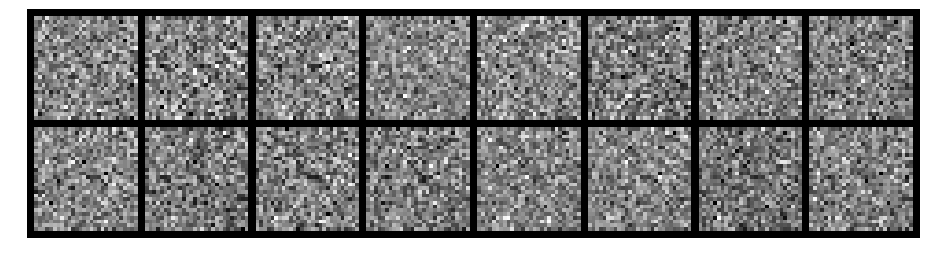

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3535, Generator Loss: 0.6996
D(x): 0.5138, D(G(z)): 0.4970


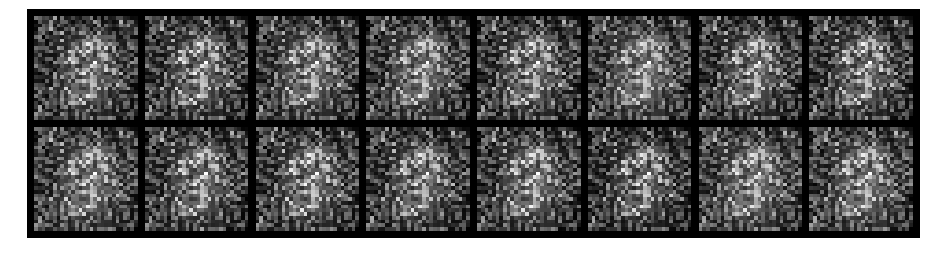

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.5794, Generator Loss: 1.5063
D(x): 0.6530, D(G(z)): 0.5699


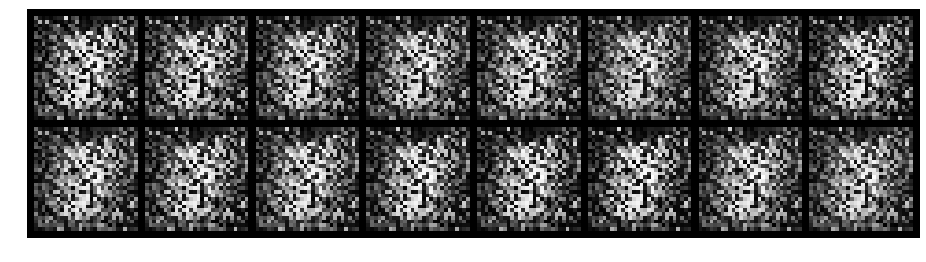

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.2740, Generator Loss: 3.5487
D(x): 0.9155, D(G(z)): 0.1417


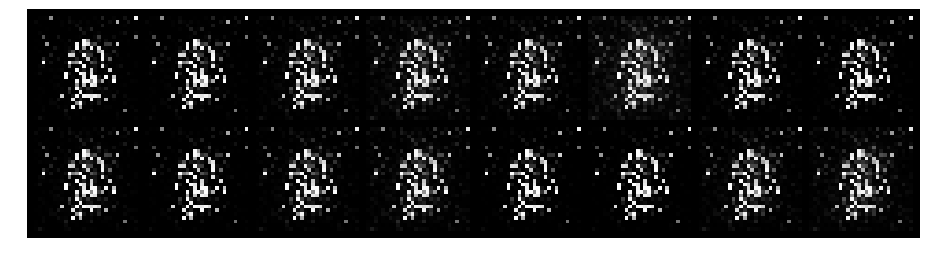

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.0378, Generator Loss: 6.1535
D(x): 0.9922, D(G(z)): 0.0285


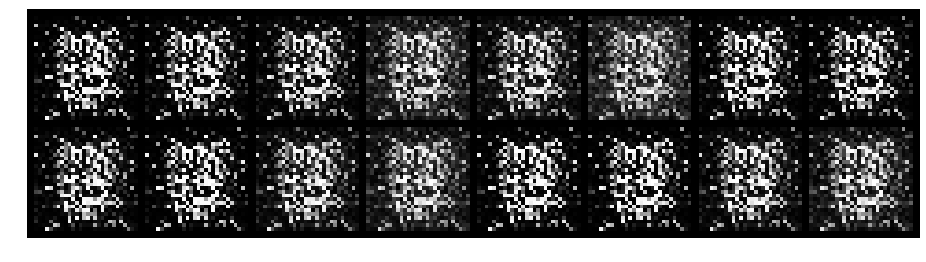

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.1697, Generator Loss: 6.7724
D(x): 0.9541, D(G(z)): 0.0824


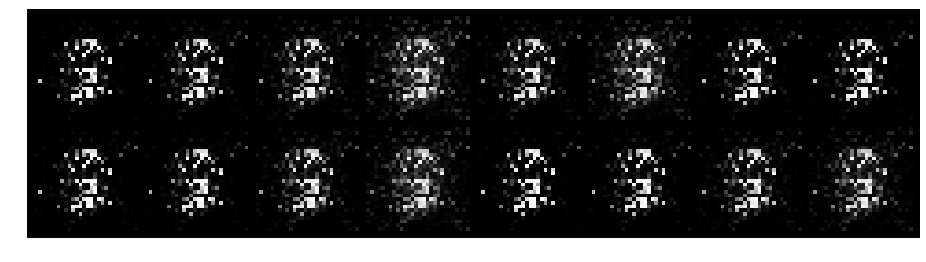

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.9603, Generator Loss: 1.6081
D(x): 0.7005, D(G(z)): 0.3816


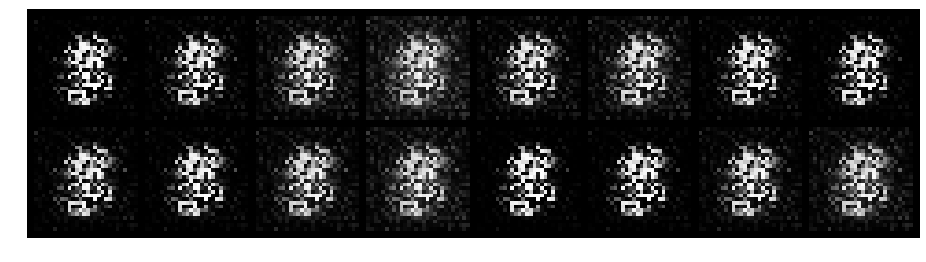

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.2834, Generator Loss: 7.7415
D(x): 0.9056, D(G(z)): 0.0588


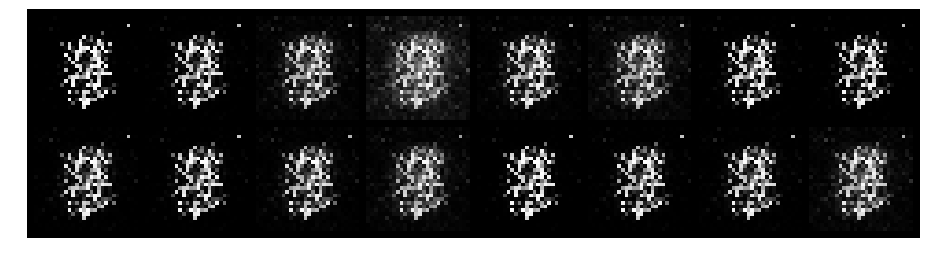

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.7118, Generator Loss: 2.9491
D(x): 0.7771, D(G(z)): 0.2426


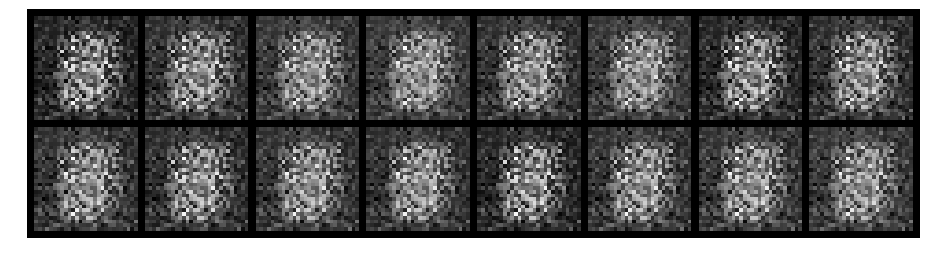

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.8452, Generator Loss: 3.4306
D(x): 0.7335, D(G(z)): 0.3458


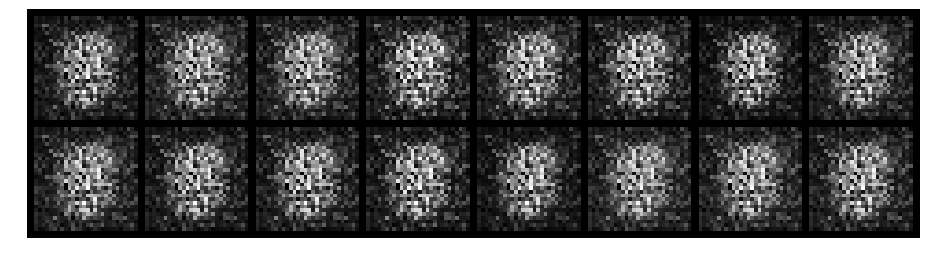

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.5021, Generator Loss: 3.6305
D(x): 0.8338, D(G(z)): 0.2024


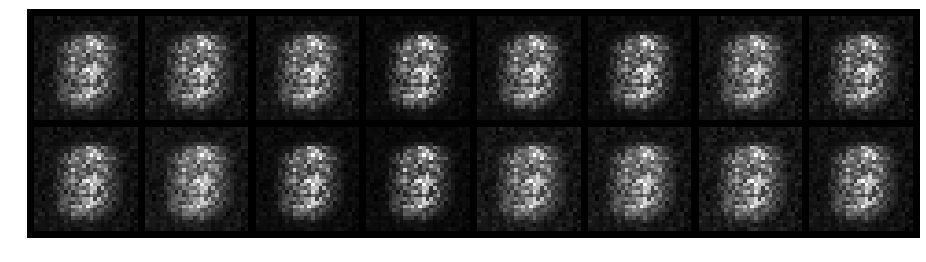

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.5350, Generator Loss: 2.1931
D(x): 0.8245, D(G(z)): 0.2530


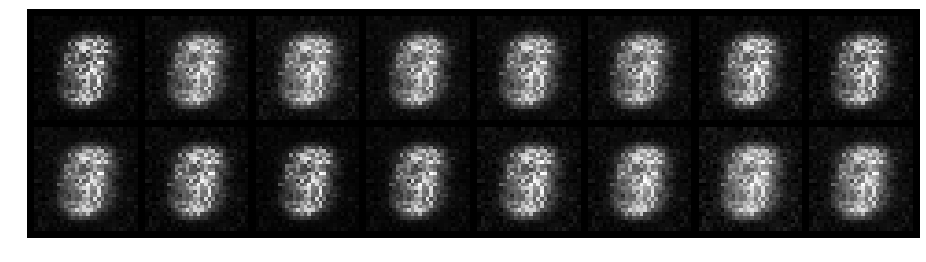

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.9619, Generator Loss: 1.9620
D(x): 0.6878, D(G(z)): 0.3177


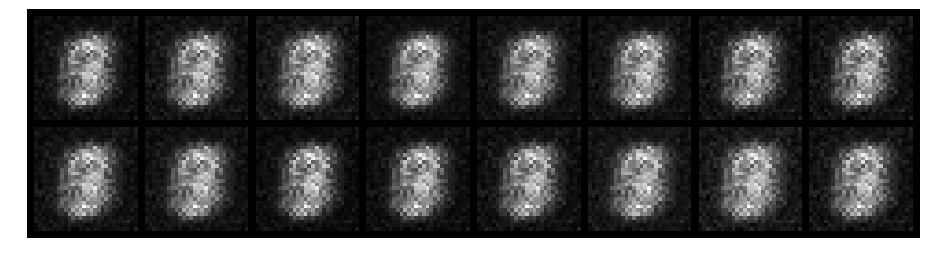

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 1.5993, Generator Loss: 0.7367
D(x): 0.6047, D(G(z)): 0.5808


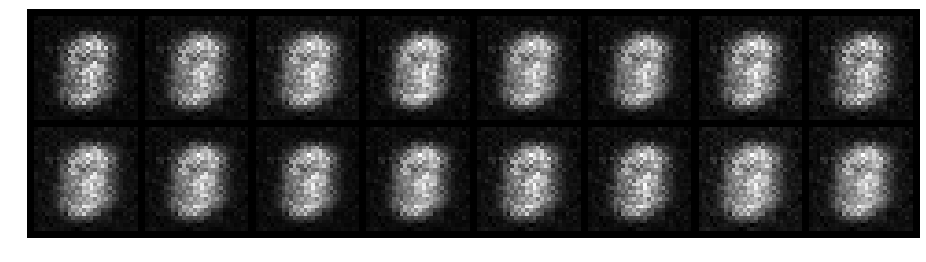

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.7561, Generator Loss: 2.4956
D(x): 0.7626, D(G(z)): 0.2735


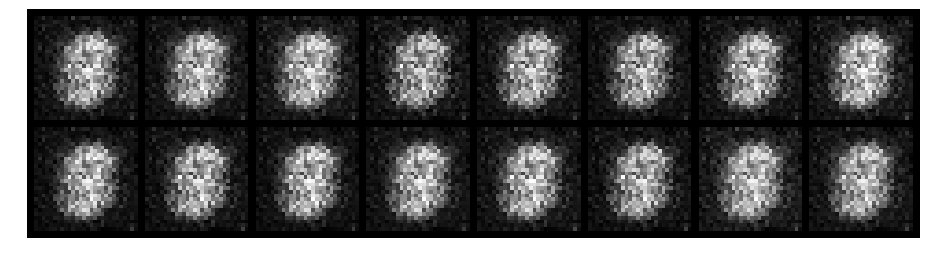

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 1.1821, Generator Loss: 1.2277
D(x): 0.6075, D(G(z)): 0.3884


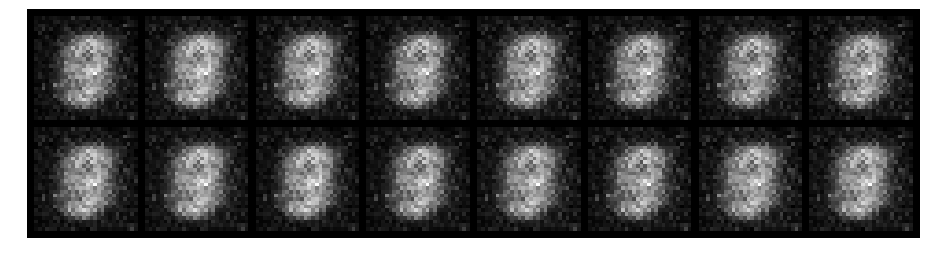

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.4076, Generator Loss: 3.0634
D(x): 0.8414, D(G(z)): 0.1185


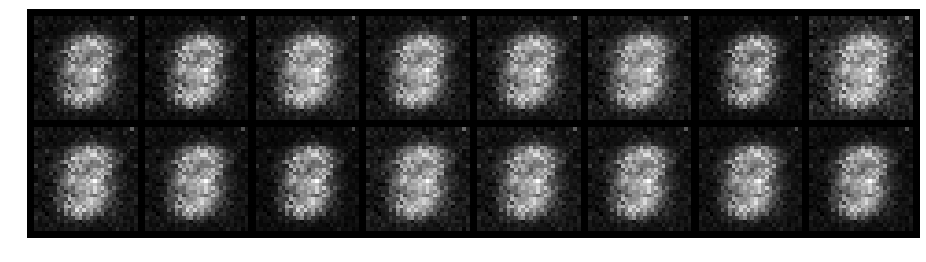

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.4751, Generator Loss: 3.6330
D(x): 0.8452, D(G(z)): 0.1369


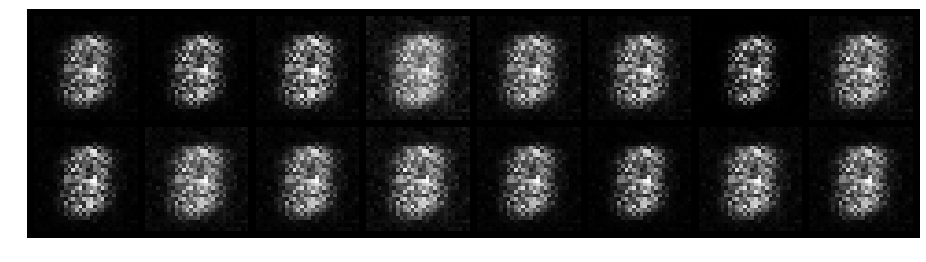

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.2961, Generator Loss: 3.9966
D(x): 0.8929, D(G(z)): 0.0778


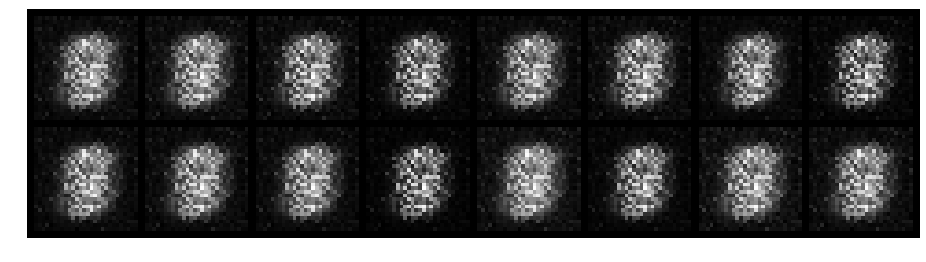

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 2.6456, Generator Loss: 1.9431
D(x): 0.4947, D(G(z)): 0.4643


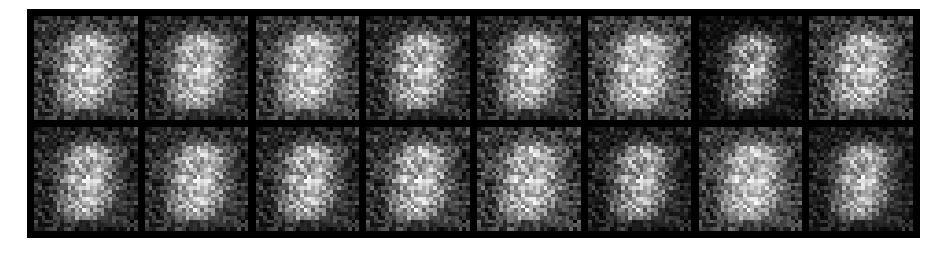

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.2605, Generator Loss: 2.4739
D(x): 0.9696, D(G(z)): 0.1656


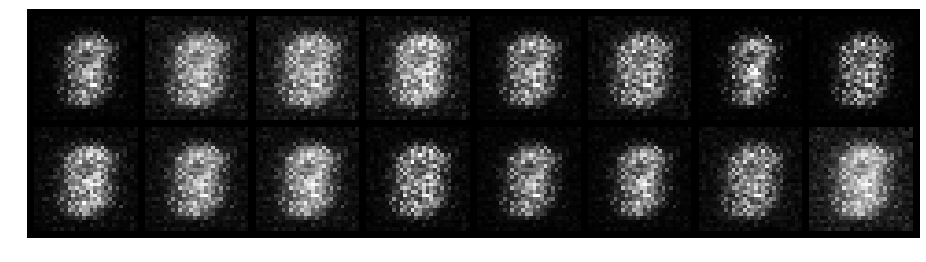

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.1803, Generator Loss: 4.8719
D(x): 0.9318, D(G(z)): 0.0509


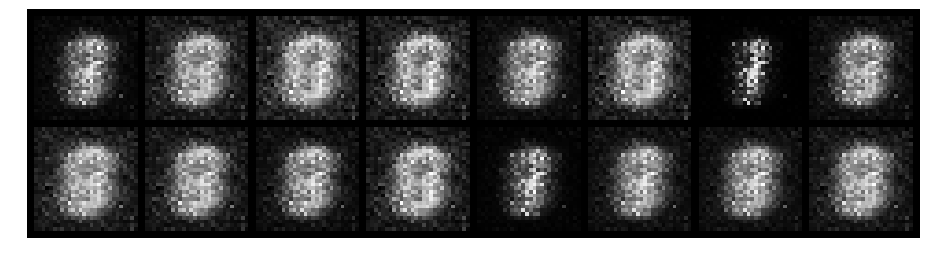

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.3890, Generator Loss: 3.4855
D(x): 0.9201, D(G(z)): 0.1401


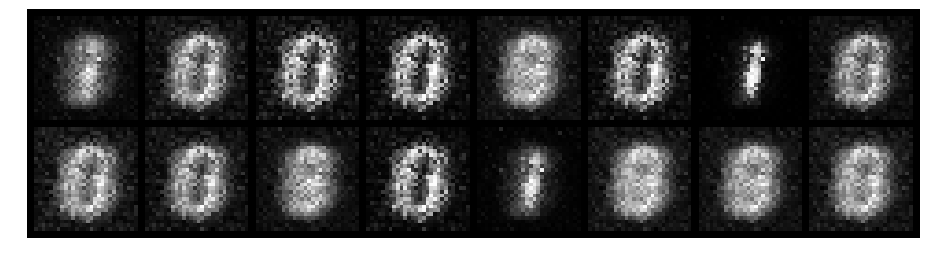

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.6467, Generator Loss: 4.0036
D(x): 0.7759, D(G(z)): 0.1620


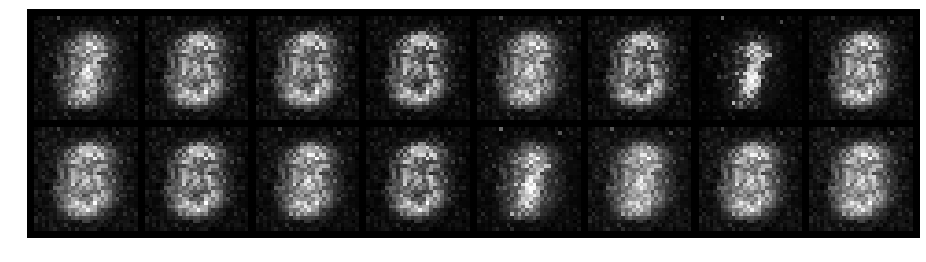

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.1462, Generator Loss: 3.5979
D(x): 0.9633, D(G(z)): 0.0587


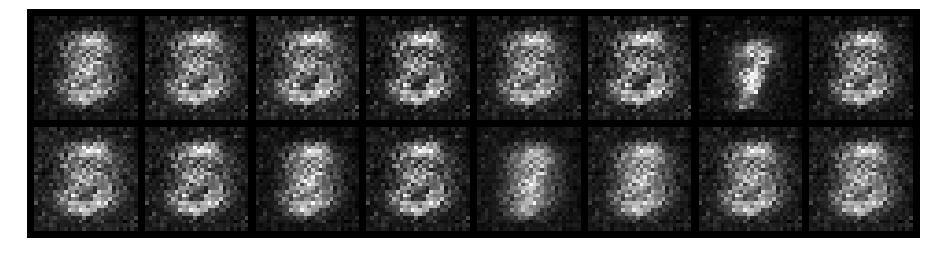

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.3189, Generator Loss: 3.7156
D(x): 0.8833, D(G(z)): 0.0896


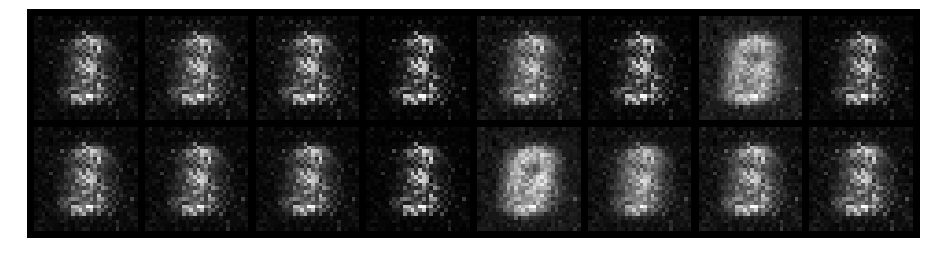

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.3246, Generator Loss: 3.6652
D(x): 0.9038, D(G(z)): 0.1237


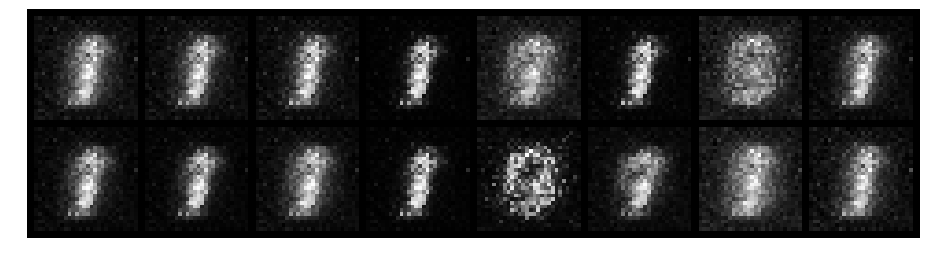

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.5433, Generator Loss: 3.4061
D(x): 0.8380, D(G(z)): 0.1304


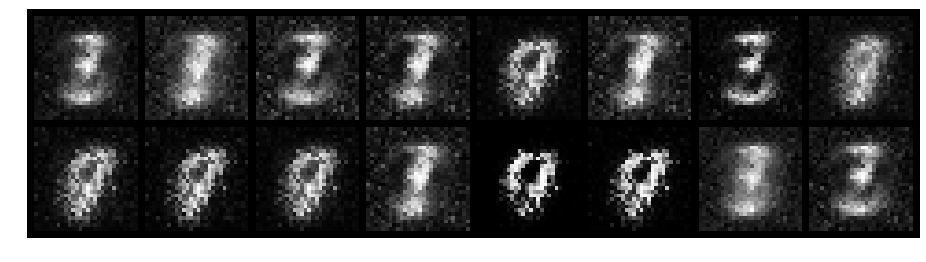

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.4221, Generator Loss: 2.9398
D(x): 0.8325, D(G(z)): 0.0715


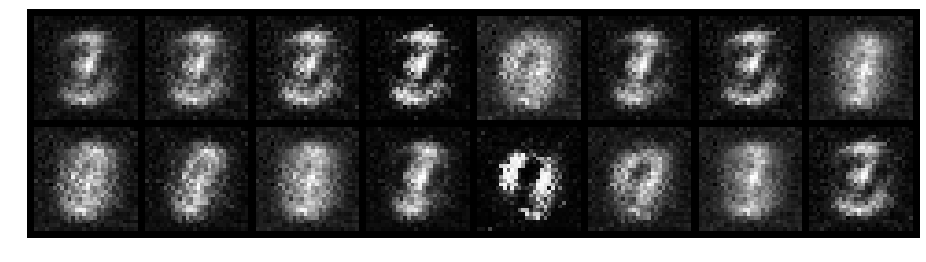

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.3971, Generator Loss: 4.4312
D(x): 0.8515, D(G(z)): 0.0824


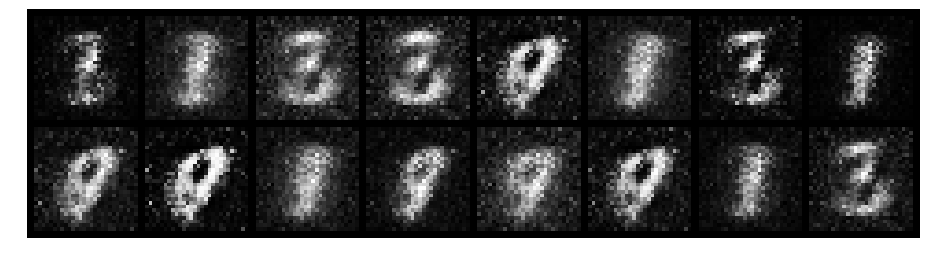

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.5073, Generator Loss: 4.6488
D(x): 0.8405, D(G(z)): 0.0816


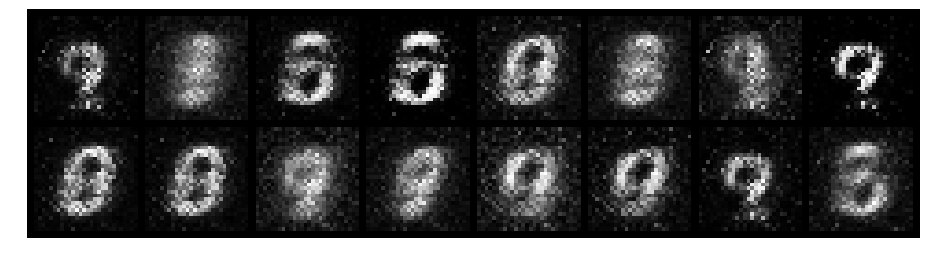

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.1906, Generator Loss: 3.7272
D(x): 0.9673, D(G(z)): 0.0899


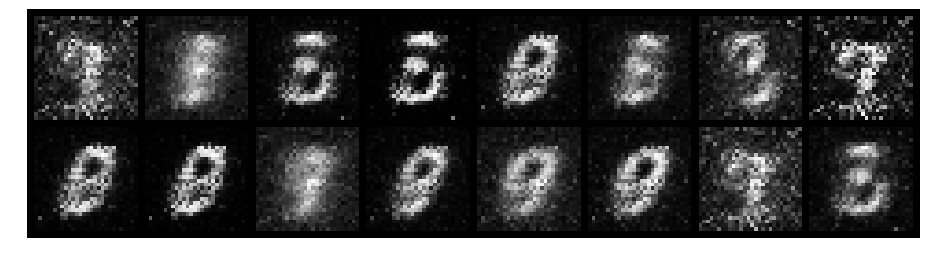

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.2887, Generator Loss: 2.5231
D(x): 0.9761, D(G(z)): 0.1843


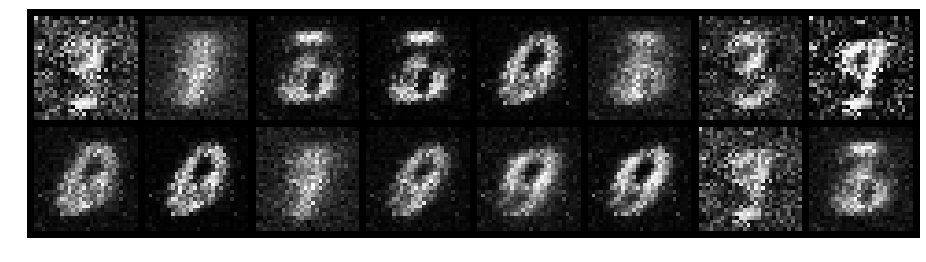

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.6074, Generator Loss: 2.9482
D(x): 0.9125, D(G(z)): 0.2524


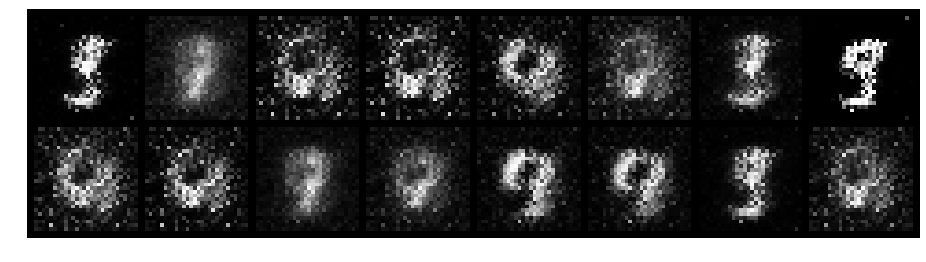

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.2963, Generator Loss: 3.6404
D(x): 0.8868, D(G(z)): 0.0864


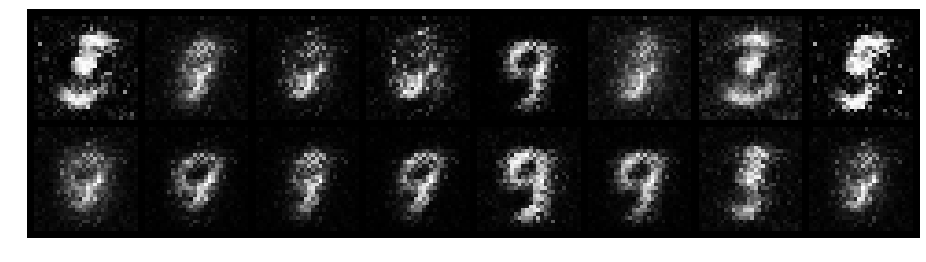

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.5411, Generator Loss: 2.7572
D(x): 0.8166, D(G(z)): 0.1140


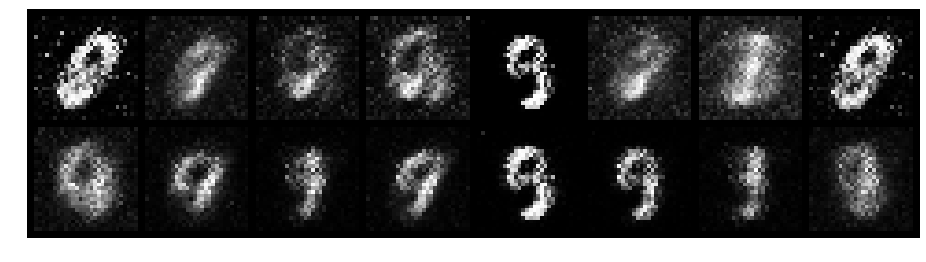

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.7784, Generator Loss: 2.4196
D(x): 0.9054, D(G(z)): 0.3584


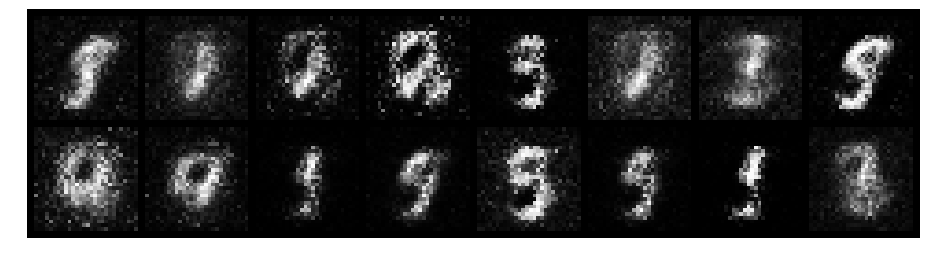

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.4541, Generator Loss: 2.9261
D(x): 0.8595, D(G(z)): 0.1298


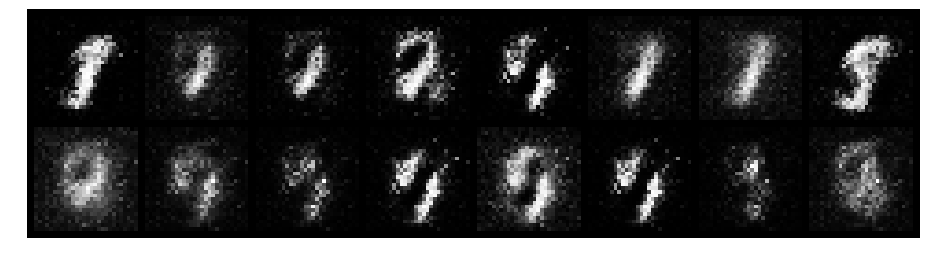

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.5420, Generator Loss: 2.8491
D(x): 0.7775, D(G(z)): 0.1032


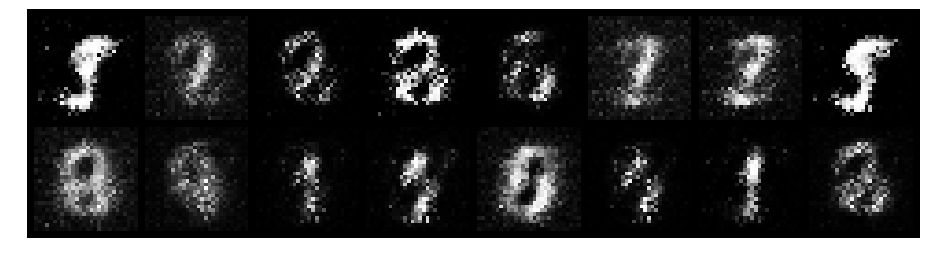

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.3449, Generator Loss: 3.6248
D(x): 0.8602, D(G(z)): 0.0871


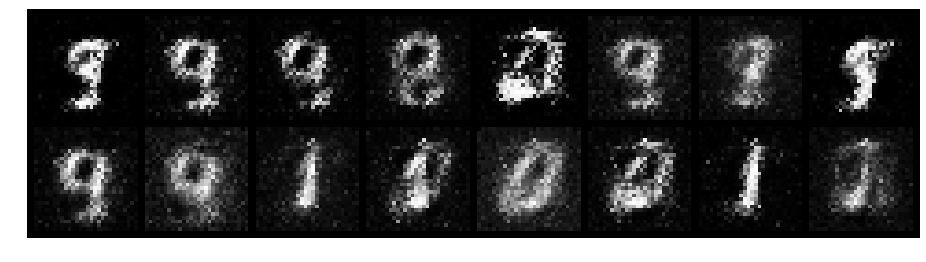

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.5583, Generator Loss: 2.3305
D(x): 0.8404, D(G(z)): 0.1891


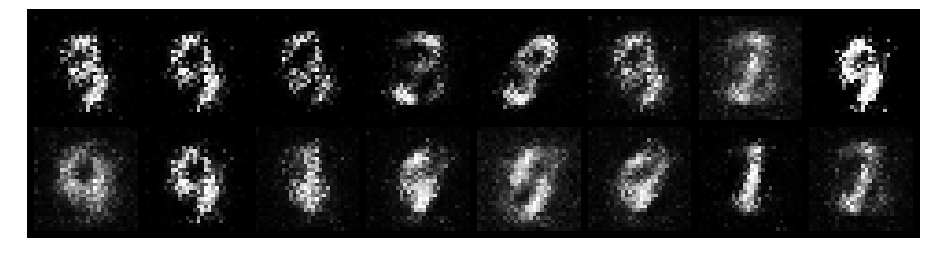

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 1.0087, Generator Loss: 1.2922
D(x): 0.6844, D(G(z)): 0.3197


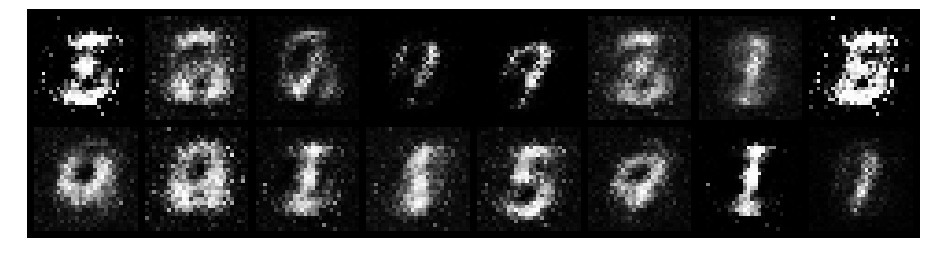

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.5257, Generator Loss: 2.8168
D(x): 0.8798, D(G(z)): 0.2172


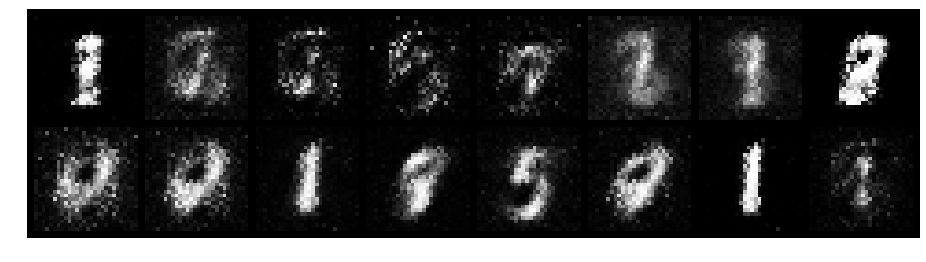

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.5392, Generator Loss: 2.4378
D(x): 0.8143, D(G(z)): 0.1658


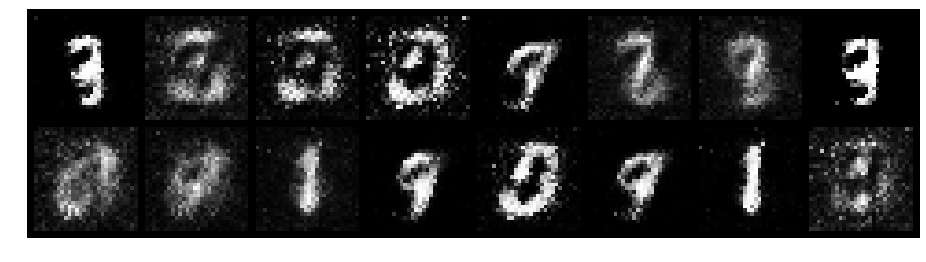

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.7241, Generator Loss: 2.1705
D(x): 0.7986, D(G(z)): 0.2346


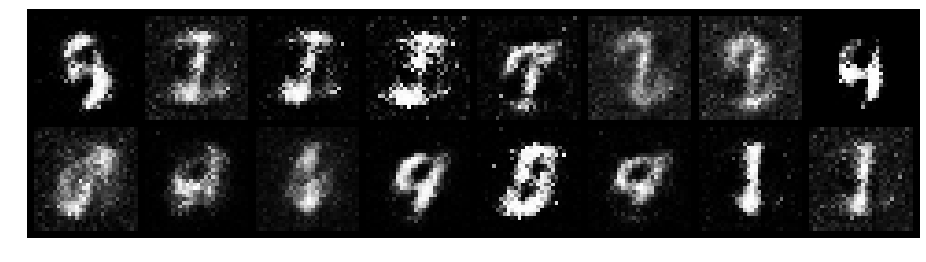

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.8046, Generator Loss: 2.7692
D(x): 0.7586, D(G(z)): 0.2602


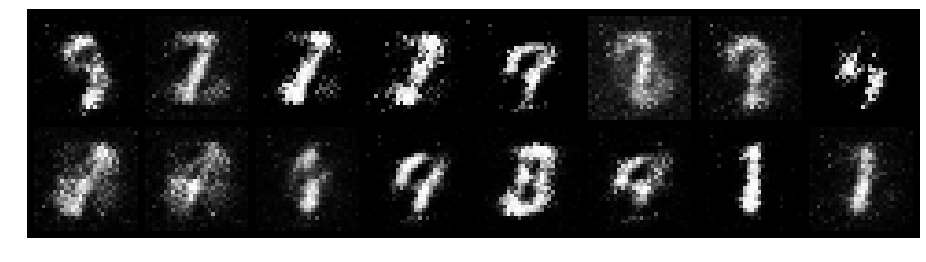

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.2388, Generator Loss: 3.4751
D(x): 0.9307, D(G(z)): 0.1225


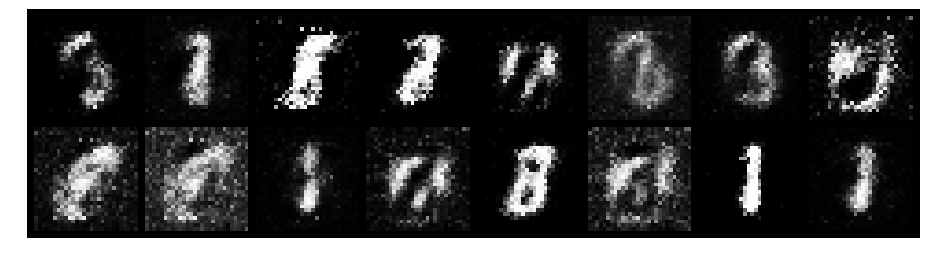

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.6154, Generator Loss: 2.5594
D(x): 0.7858, D(G(z)): 0.1437


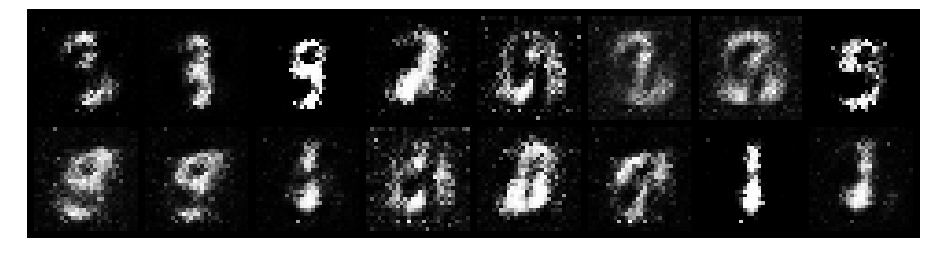

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.5903, Generator Loss: 2.6274
D(x): 0.7961, D(G(z)): 0.1281


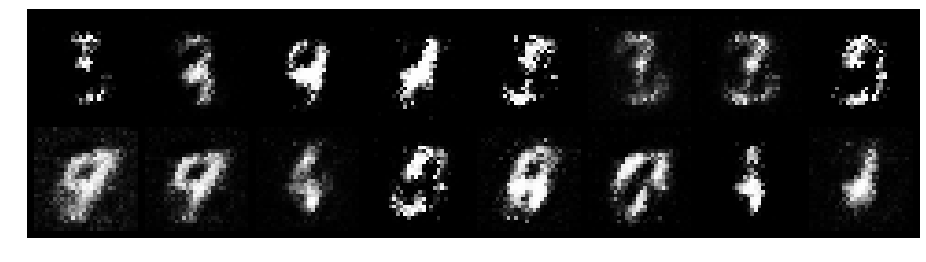

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.5725, Generator Loss: 2.2908
D(x): 0.8425, D(G(z)): 0.1511


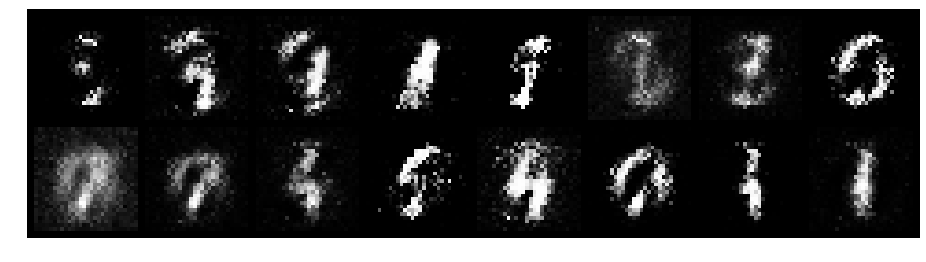

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.5060, Generator Loss: 2.4312
D(x): 0.8084, D(G(z)): 0.0955


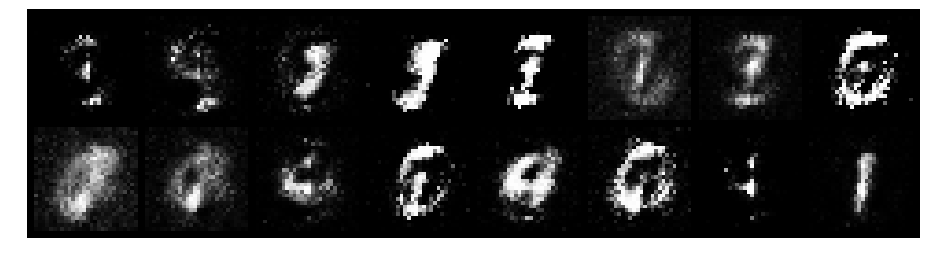

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 1.1104, Generator Loss: 2.5055
D(x): 0.7523, D(G(z)): 0.3276


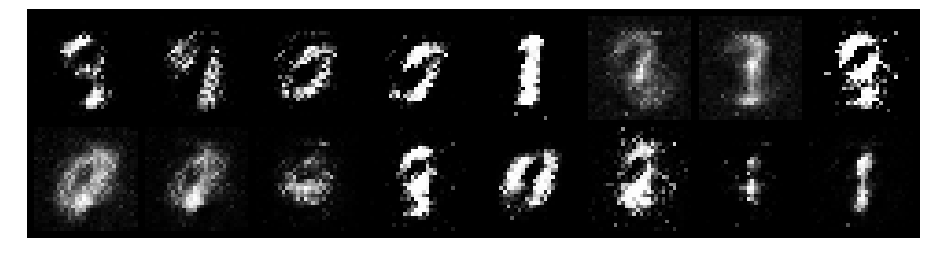

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.4533, Generator Loss: 2.6931
D(x): 0.8503, D(G(z)): 0.1524


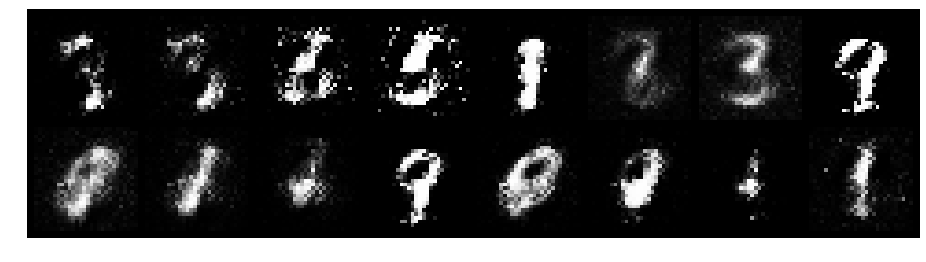

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.5523, Generator Loss: 2.3163
D(x): 0.8215, D(G(z)): 0.1748


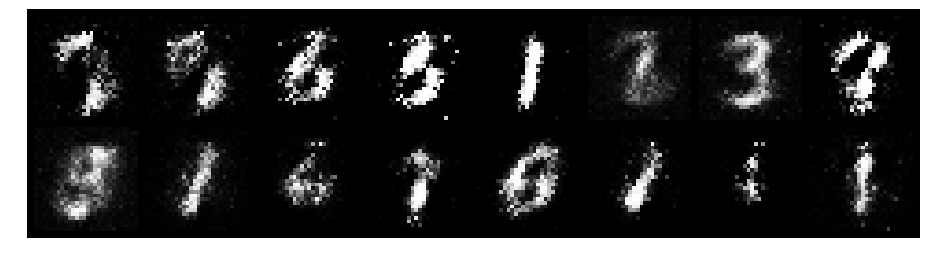

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.6802, Generator Loss: 2.7570
D(x): 0.7331, D(G(z)): 0.0714


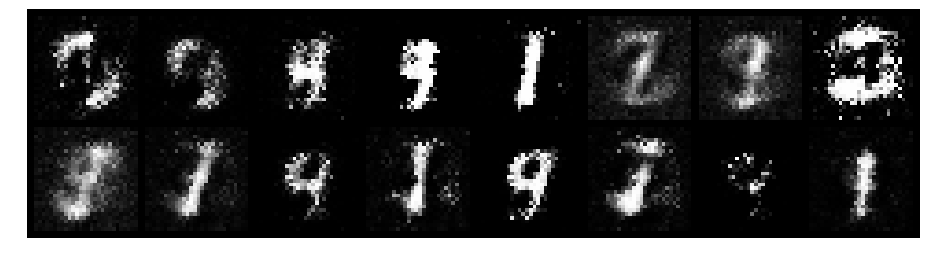

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.4484, Generator Loss: 3.1324
D(x): 0.9180, D(G(z)): 0.2047


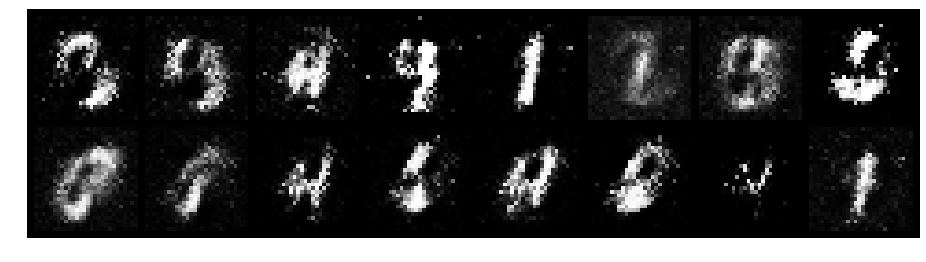

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.6020, Generator Loss: 2.3786
D(x): 0.8640, D(G(z)): 0.2423


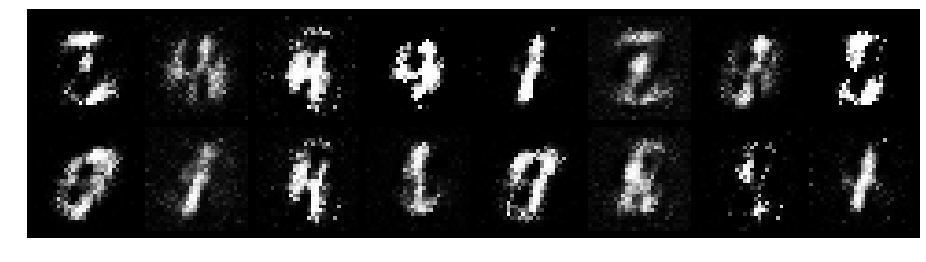

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.4013, Generator Loss: 2.6749
D(x): 0.8548, D(G(z)): 0.1259


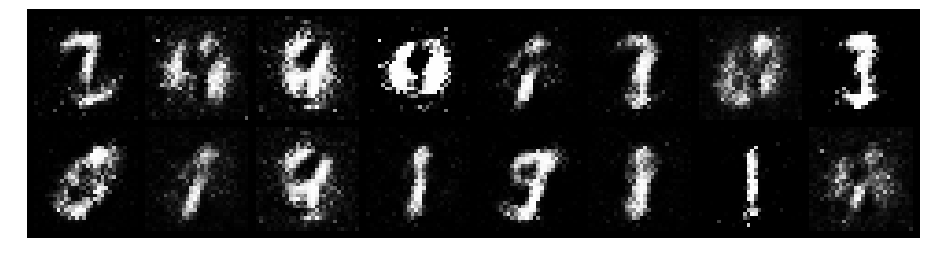

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.5403, Generator Loss: 3.0473
D(x): 0.8328, D(G(z)): 0.1899


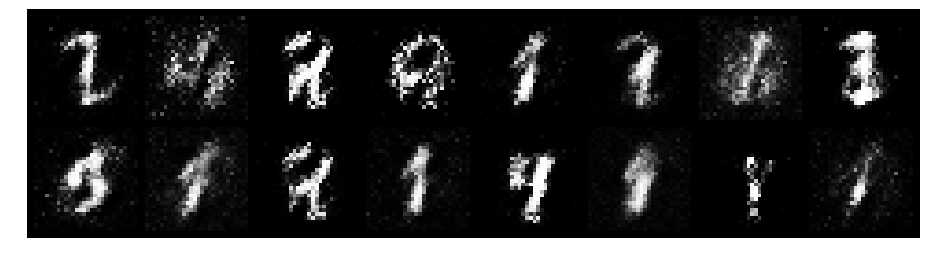

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.5655, Generator Loss: 2.3884
D(x): 0.7787, D(G(z)): 0.1267


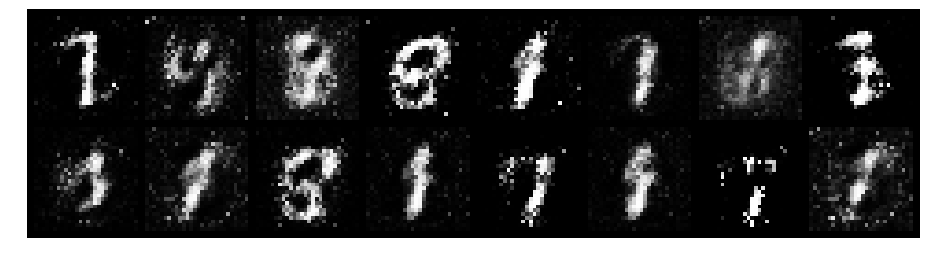

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.4632, Generator Loss: 2.8490
D(x): 0.8731, D(G(z)): 0.1692


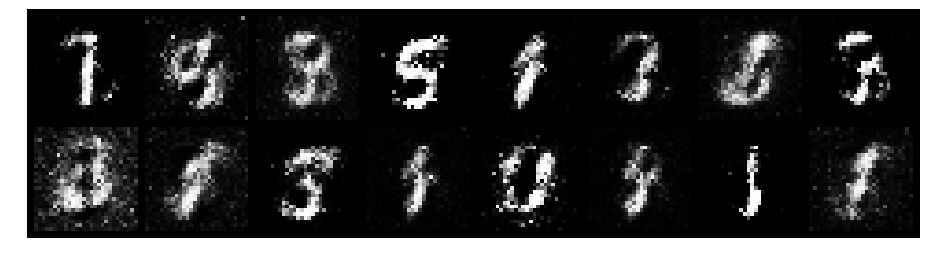

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.5515, Generator Loss: 2.0507
D(x): 0.8629, D(G(z)): 0.2326


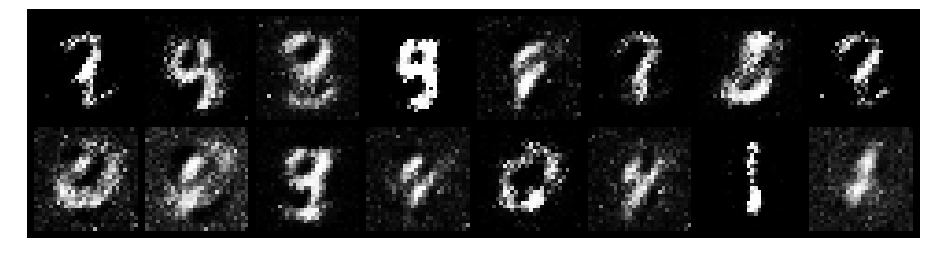

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.7908, Generator Loss: 1.6480
D(x): 0.8161, D(G(z)): 0.2982


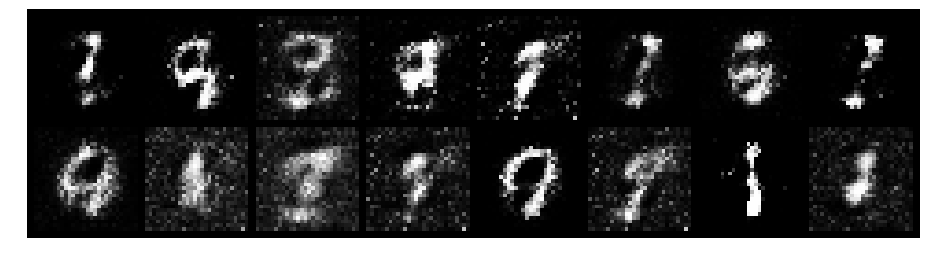

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.7367, Generator Loss: 2.6877
D(x): 0.7997, D(G(z)): 0.2315


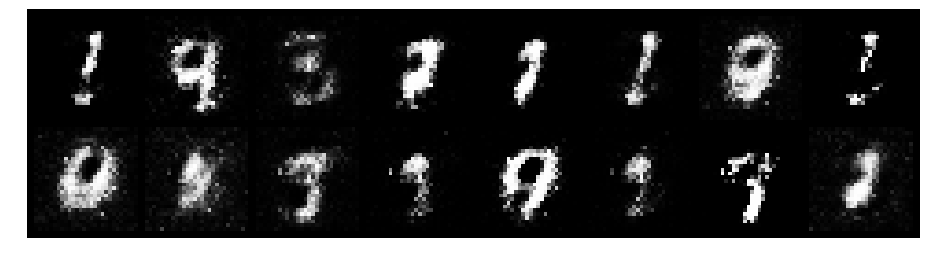

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.6930, Generator Loss: 2.0134
D(x): 0.8286, D(G(z)): 0.2799


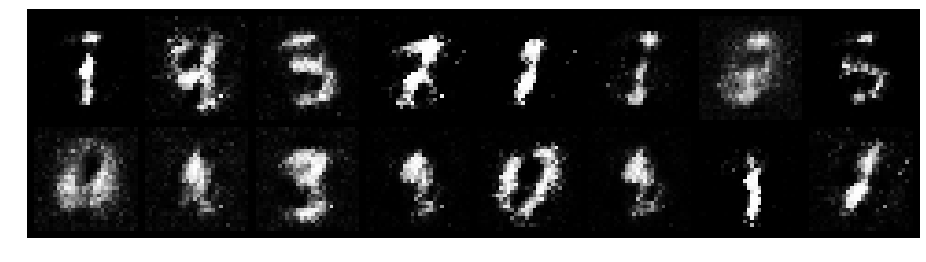

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.8702, Generator Loss: 2.8851
D(x): 0.7524, D(G(z)): 0.2370


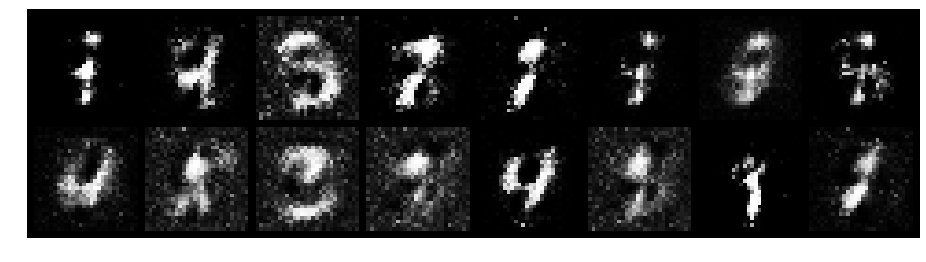

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.5824, Generator Loss: 2.6215
D(x): 0.8075, D(G(z)): 0.1518


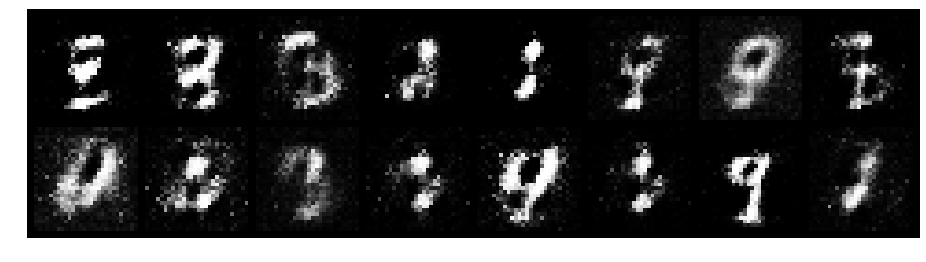

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.7804, Generator Loss: 2.1557
D(x): 0.7613, D(G(z)): 0.2314


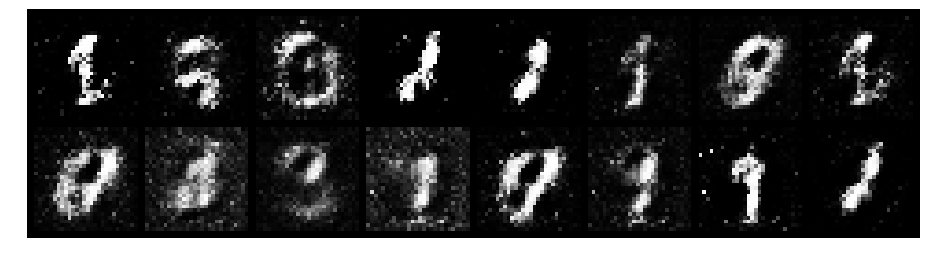

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.4258, Generator Loss: 2.3868
D(x): 0.8551, D(G(z)): 0.1577


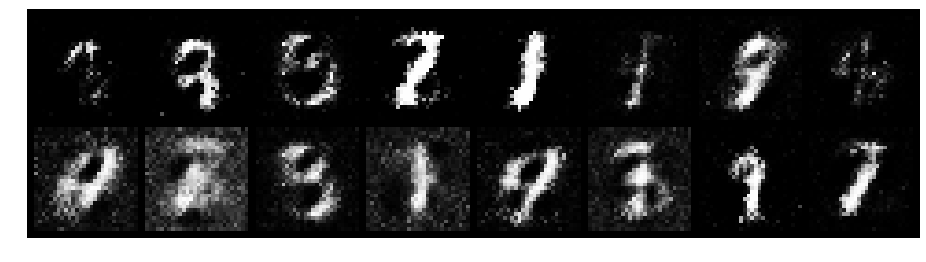

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.8443, Generator Loss: 1.5760
D(x): 0.8415, D(G(z)): 0.3748


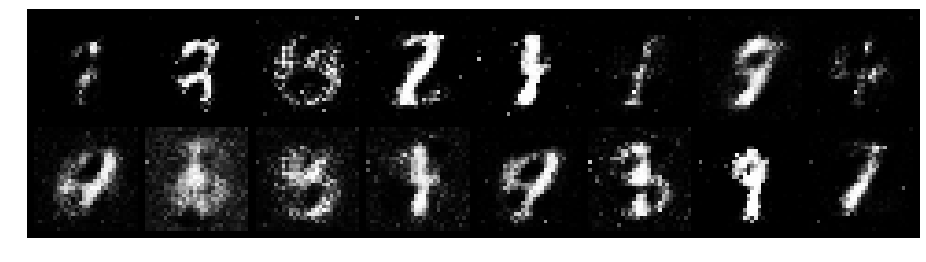

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.4352, Generator Loss: 2.8834
D(x): 0.8062, D(G(z)): 0.1089


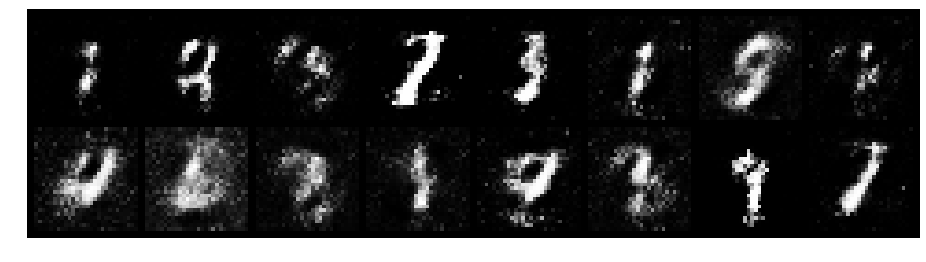

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.6424, Generator Loss: 2.0915
D(x): 0.8176, D(G(z)): 0.2494


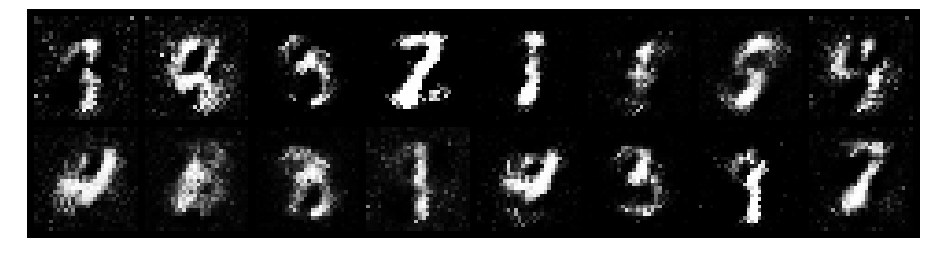

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 1.0877, Generator Loss: 1.7962
D(x): 0.7431, D(G(z)): 0.3094


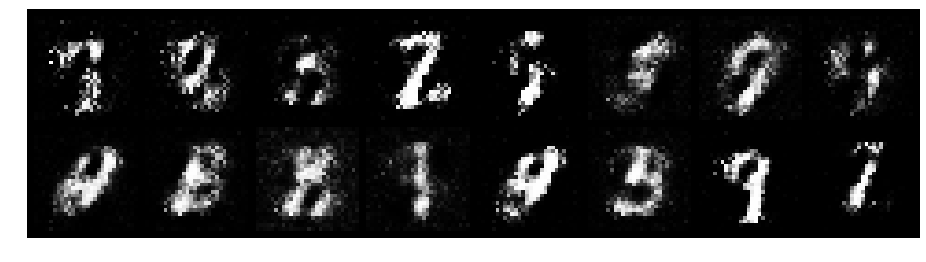

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.5978, Generator Loss: 2.1689
D(x): 0.8336, D(G(z)): 0.1936


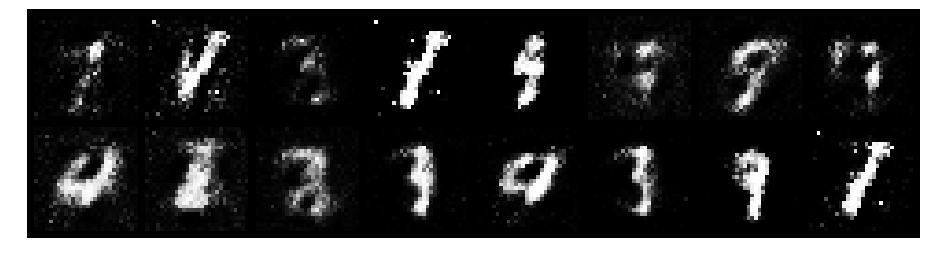

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.8592, Generator Loss: 1.2899
D(x): 0.7175, D(G(z)): 0.2969


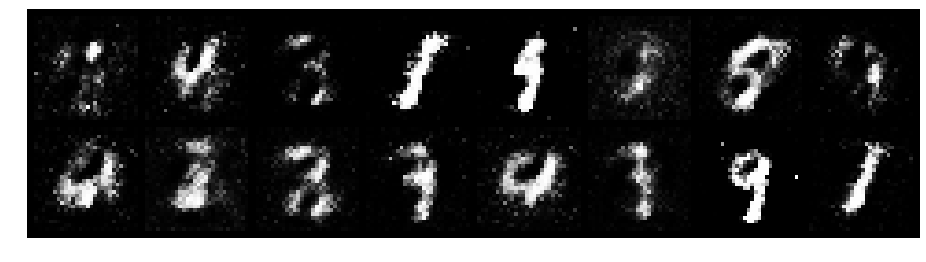

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.6324, Generator Loss: 2.6019
D(x): 0.7570, D(G(z)): 0.1895


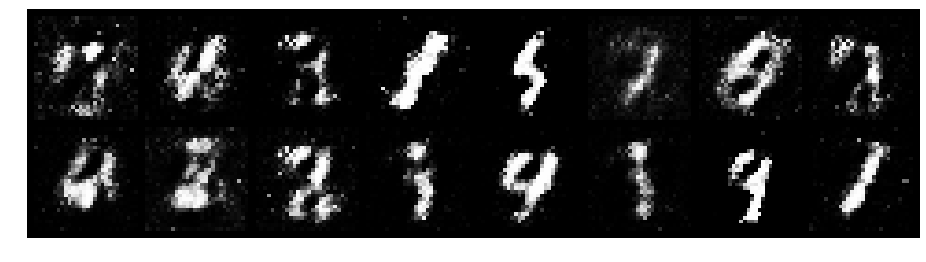

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.6125, Generator Loss: 1.9473
D(x): 0.8265, D(G(z)): 0.2425


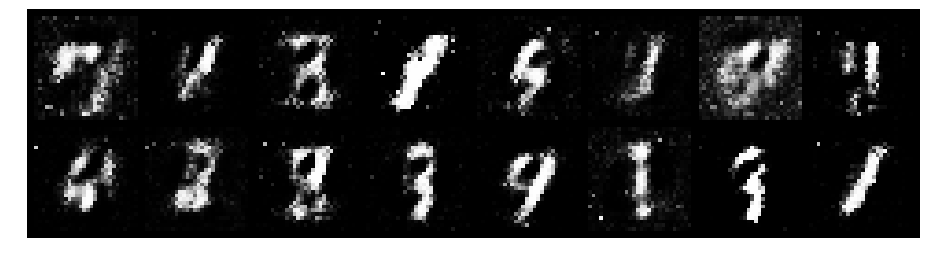

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.7516, Generator Loss: 2.1179
D(x): 0.7615, D(G(z)): 0.2493


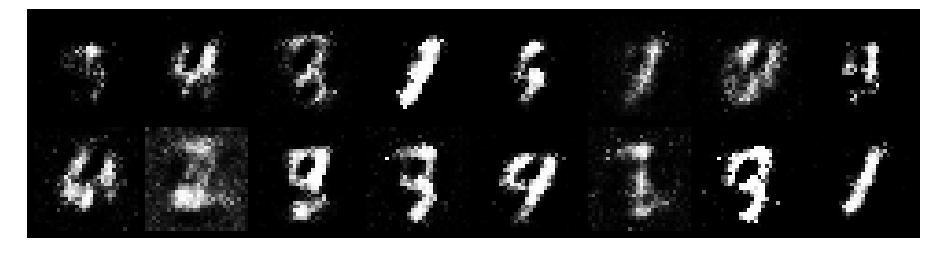

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.3453, Generator Loss: 3.0929
D(x): 0.8999, D(G(z)): 0.1481


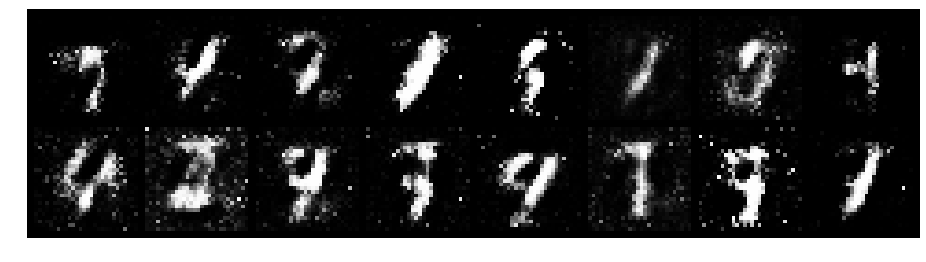

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.6909, Generator Loss: 1.9194
D(x): 0.7975, D(G(z)): 0.2808


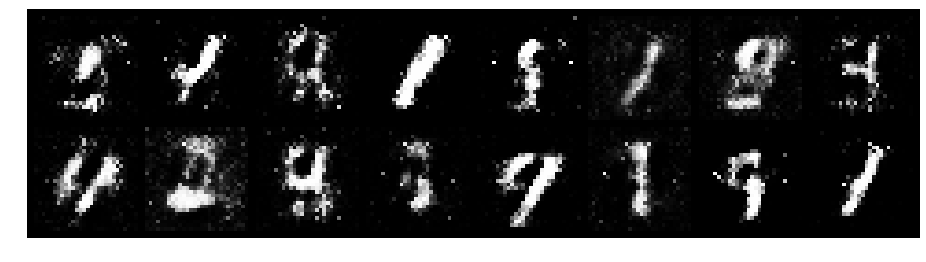

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.4237, Generator Loss: 2.8419
D(x): 0.8087, D(G(z)): 0.1219


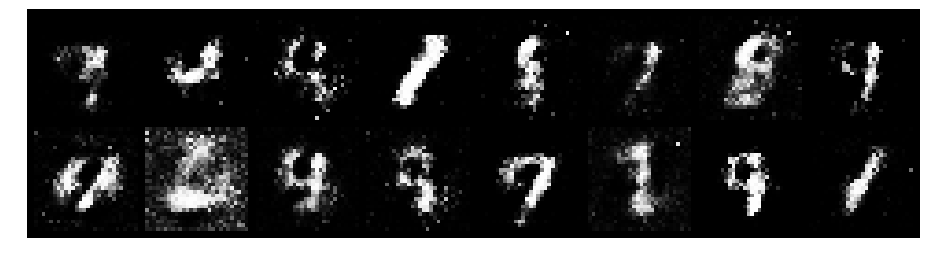

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.6023, Generator Loss: 2.0234
D(x): 0.7450, D(G(z)): 0.1881


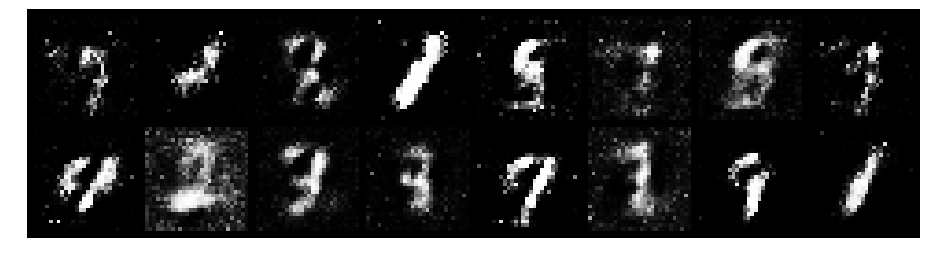

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.6672, Generator Loss: 1.9464
D(x): 0.7591, D(G(z)): 0.2031


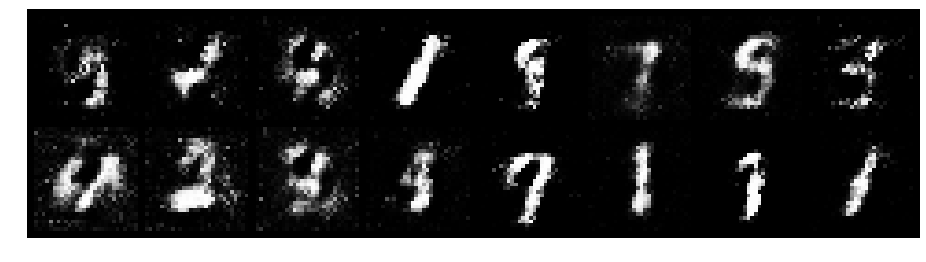

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 1.1686, Generator Loss: 1.3590
D(x): 0.7722, D(G(z)): 0.3477


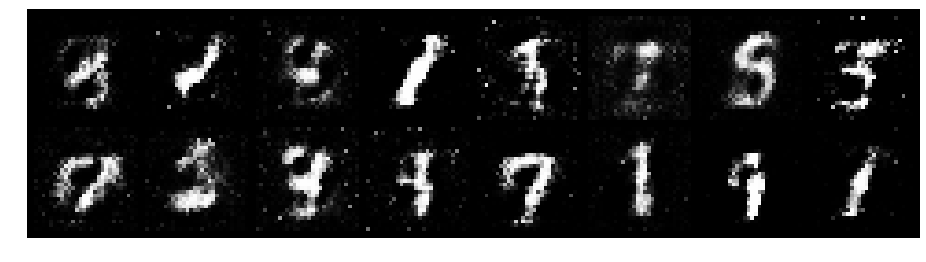

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.8477, Generator Loss: 2.3553
D(x): 0.7277, D(G(z)): 0.2078


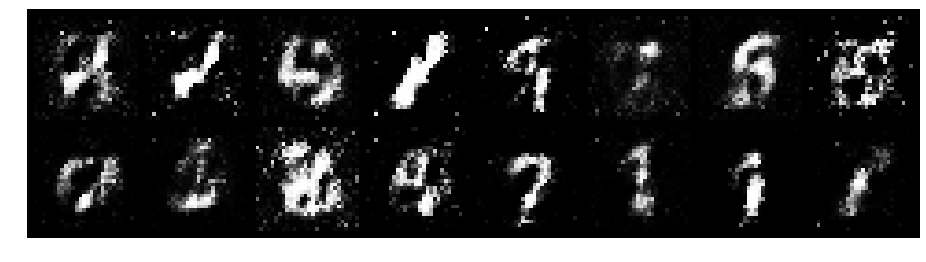

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 1.1468, Generator Loss: 1.7140
D(x): 0.6295, D(G(z)): 0.2474


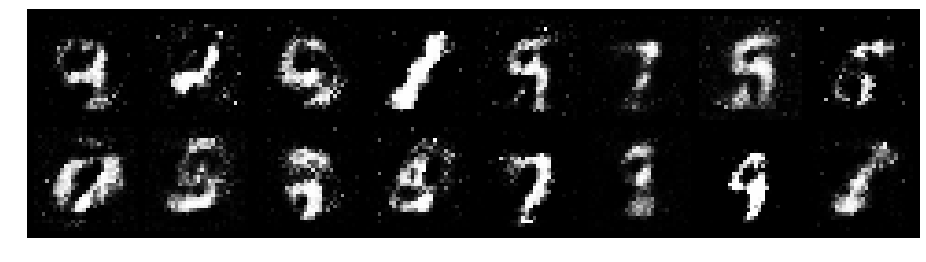

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.7840, Generator Loss: 2.0274
D(x): 0.7356, D(G(z)): 0.2442


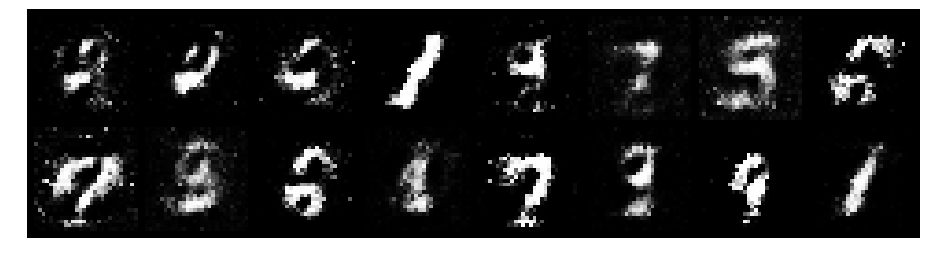

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 1.2445, Generator Loss: 1.6040
D(x): 0.7485, D(G(z)): 0.4293


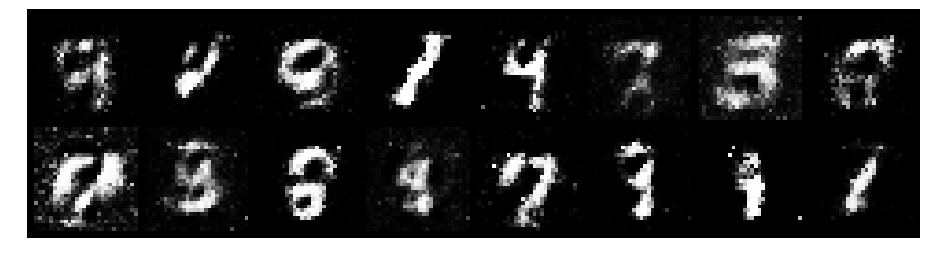

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 1.0087, Generator Loss: 1.8841
D(x): 0.6473, D(G(z)): 0.2207


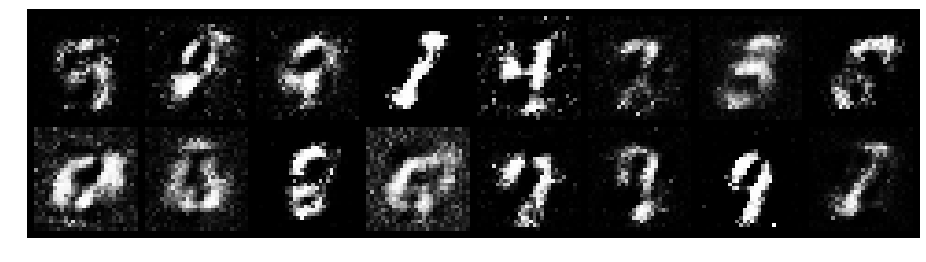

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.7516, Generator Loss: 1.9078
D(x): 0.7536, D(G(z)): 0.2718


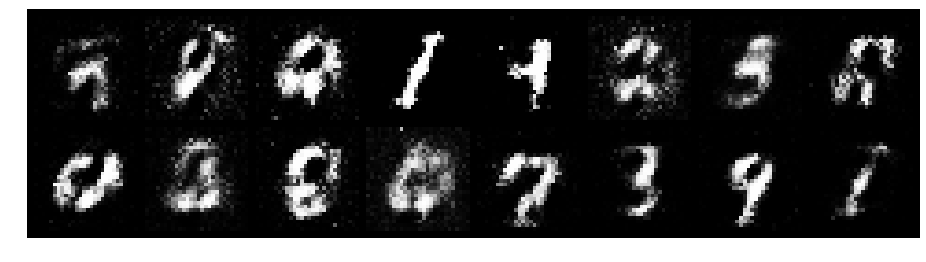

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.7602, Generator Loss: 1.8927
D(x): 0.7491, D(G(z)): 0.2230


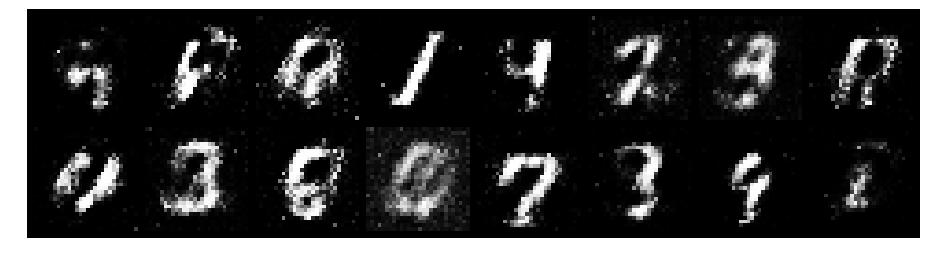

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.8275, Generator Loss: 1.8056
D(x): 0.7023, D(G(z)): 0.2253


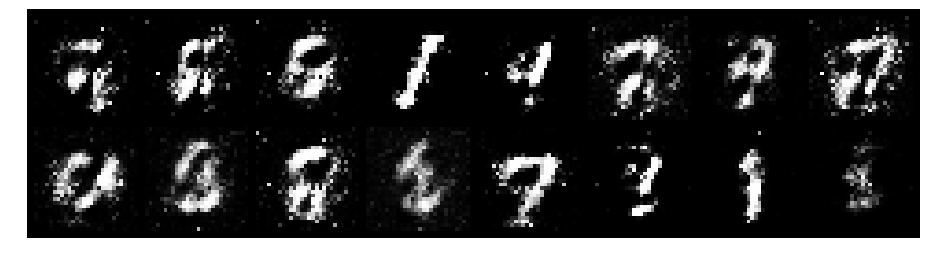

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.7947, Generator Loss: 1.7346
D(x): 0.7381, D(G(z)): 0.3005


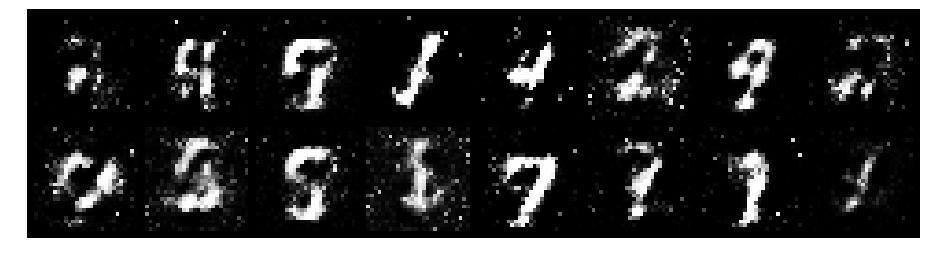

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.7835, Generator Loss: 2.1905
D(x): 0.7217, D(G(z)): 0.2108


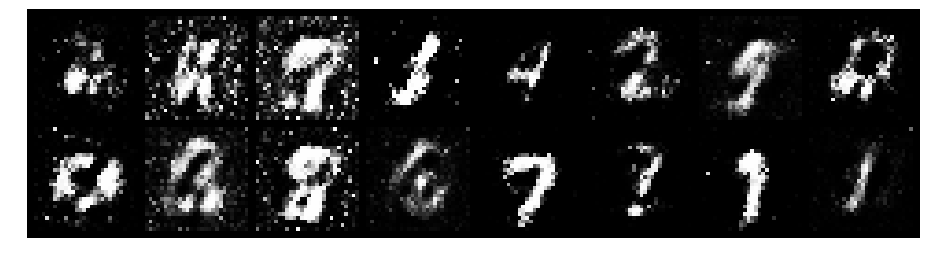

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.8361, Generator Loss: 1.5304
D(x): 0.7848, D(G(z)): 0.3056


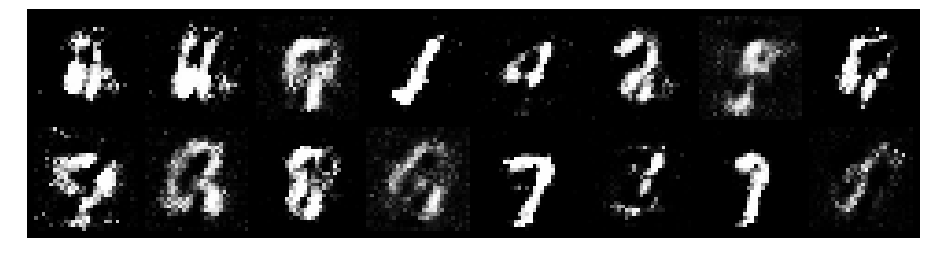

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.8863, Generator Loss: 1.1715
D(x): 0.6769, D(G(z)): 0.3044


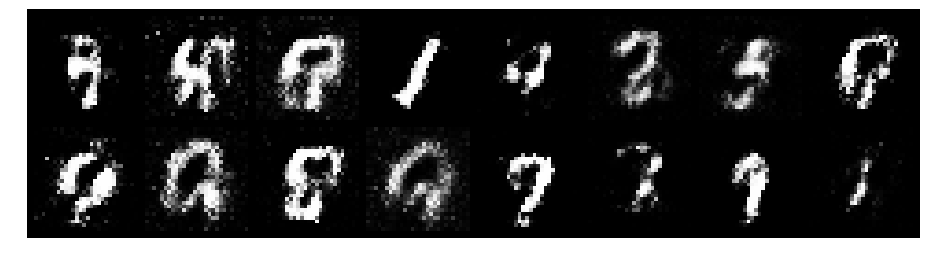

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.7870, Generator Loss: 1.5490
D(x): 0.7109, D(G(z)): 0.2717


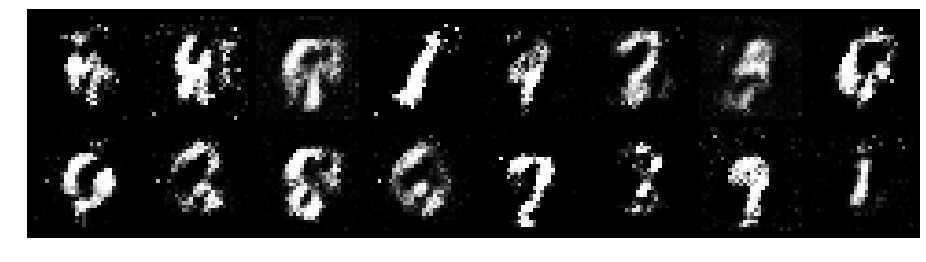

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.7675, Generator Loss: 1.4386
D(x): 0.7776, D(G(z)): 0.2889


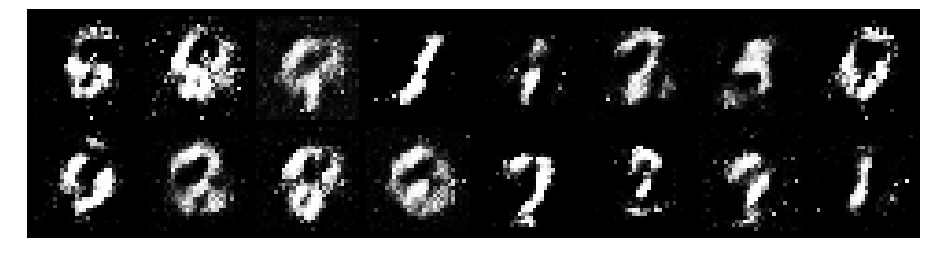

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.8012, Generator Loss: 1.4055
D(x): 0.7852, D(G(z)): 0.3288


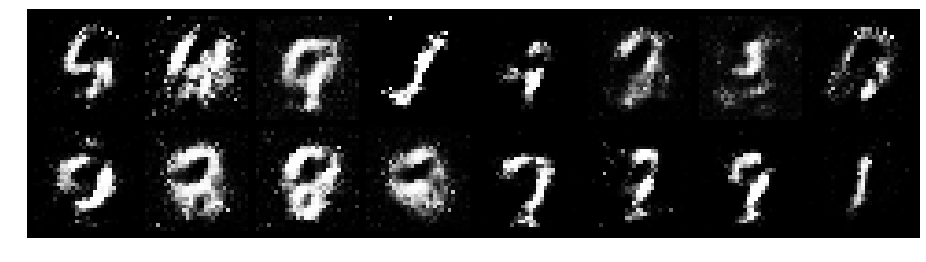

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.9750, Generator Loss: 1.6937
D(x): 0.6616, D(G(z)): 0.2751


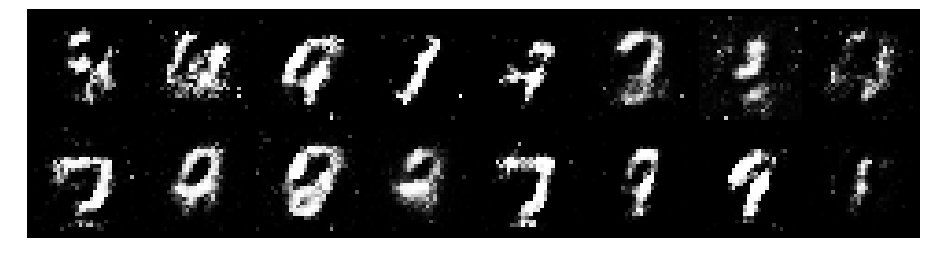

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.8279, Generator Loss: 1.7314
D(x): 0.7392, D(G(z)): 0.2717


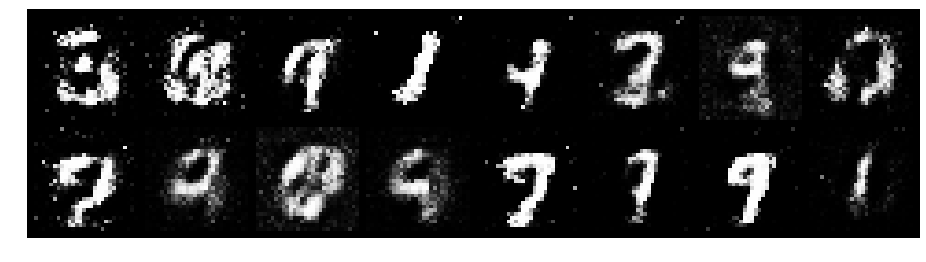

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.8678, Generator Loss: 1.5815
D(x): 0.6592, D(G(z)): 0.2475


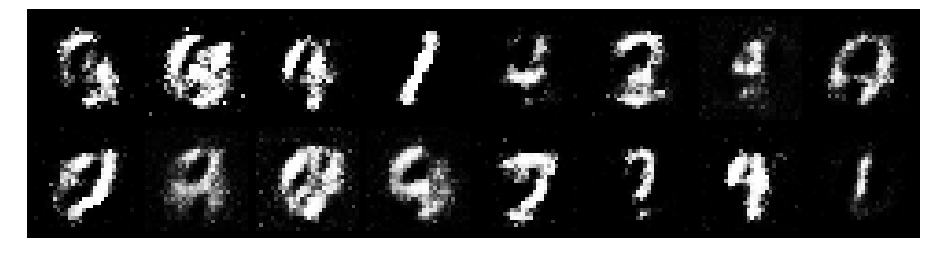

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.7360, Generator Loss: 1.4988
D(x): 0.7402, D(G(z)): 0.2617


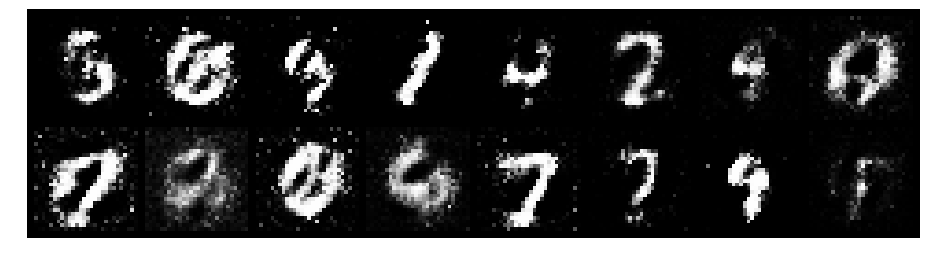

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.7409, Generator Loss: 2.1468
D(x): 0.7516, D(G(z)): 0.2594


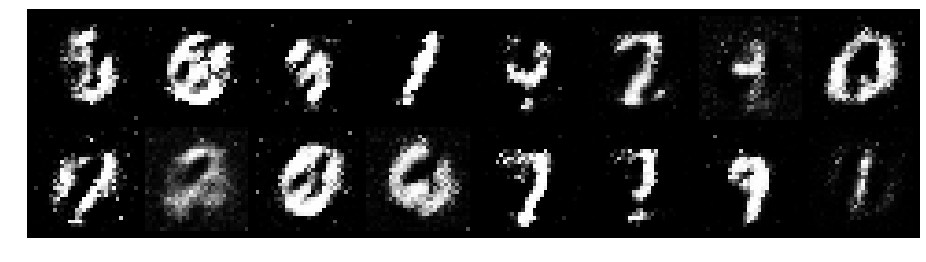

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.6612, Generator Loss: 2.0086
D(x): 0.7640, D(G(z)): 0.2018


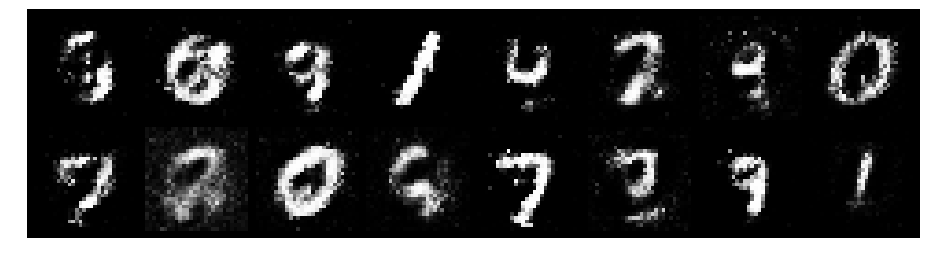

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.7246, Generator Loss: 2.0395
D(x): 0.7470, D(G(z)): 0.2518


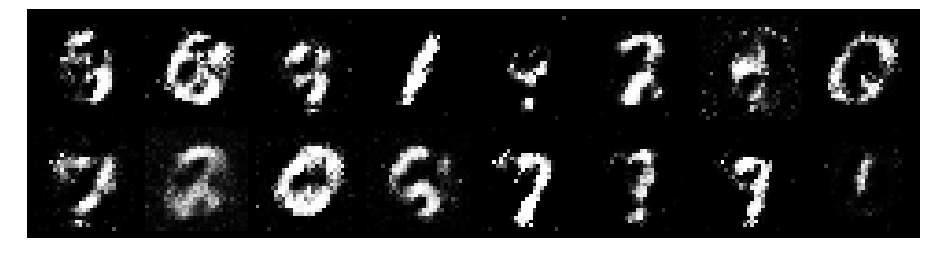

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.9188, Generator Loss: 1.5504
D(x): 0.6447, D(G(z)): 0.2577


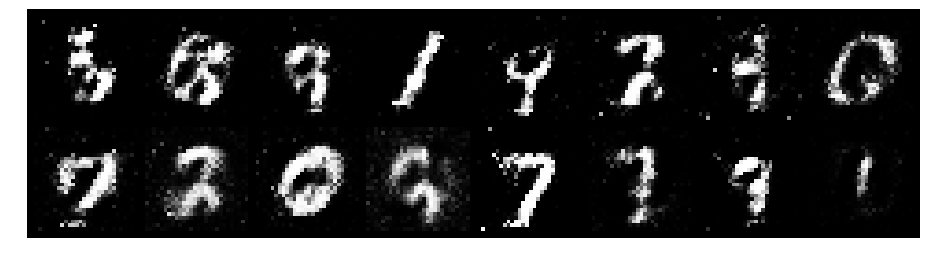

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.9197, Generator Loss: 1.6067
D(x): 0.7411, D(G(z)): 0.3376


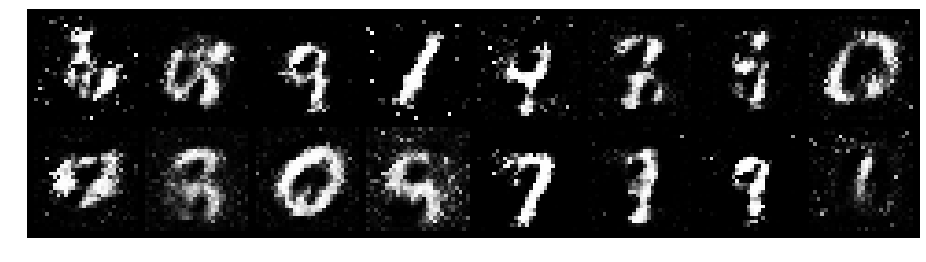

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.9419, Generator Loss: 2.3388
D(x): 0.6428, D(G(z)): 0.2357


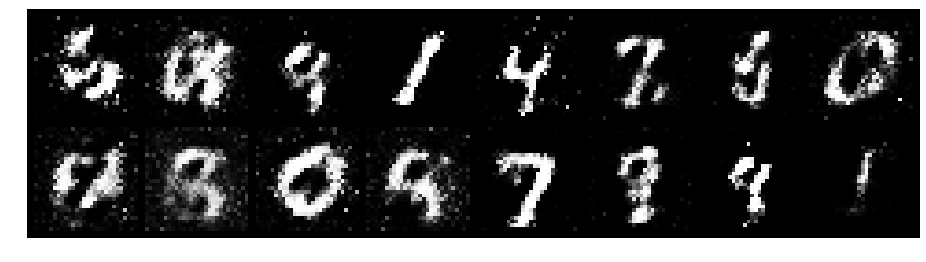

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 1.0442, Generator Loss: 1.7572
D(x): 0.6926, D(G(z)): 0.3219


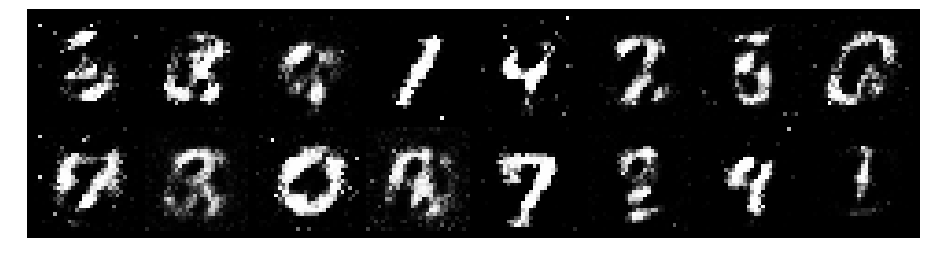

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.9824, Generator Loss: 1.8636
D(x): 0.6860, D(G(z)): 0.3061


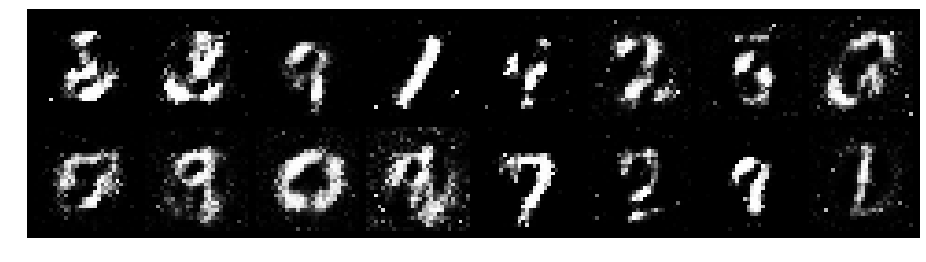

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 1.0738, Generator Loss: 1.7386
D(x): 0.6448, D(G(z)): 0.3009


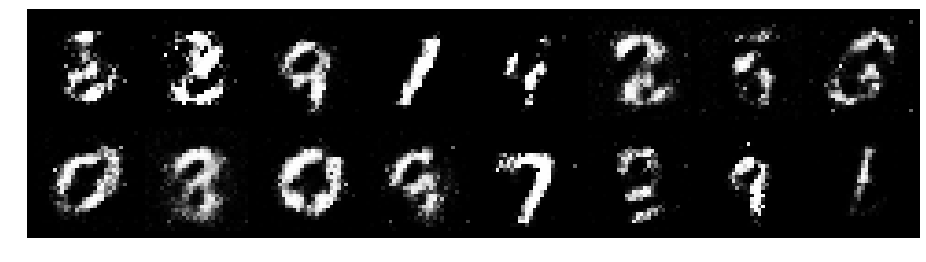

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.8372, Generator Loss: 1.7462
D(x): 0.7614, D(G(z)): 0.2740


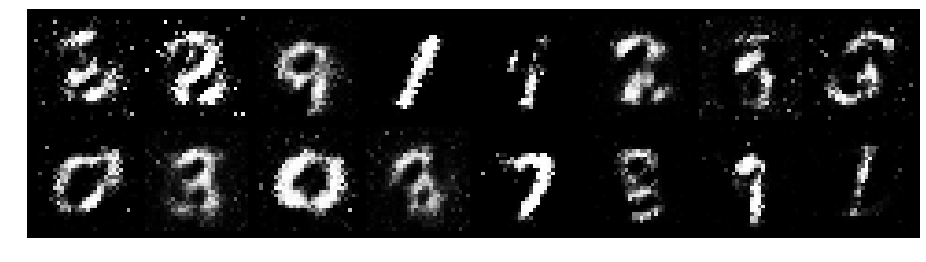

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.8261, Generator Loss: 2.0065
D(x): 0.6647, D(G(z)): 0.2214


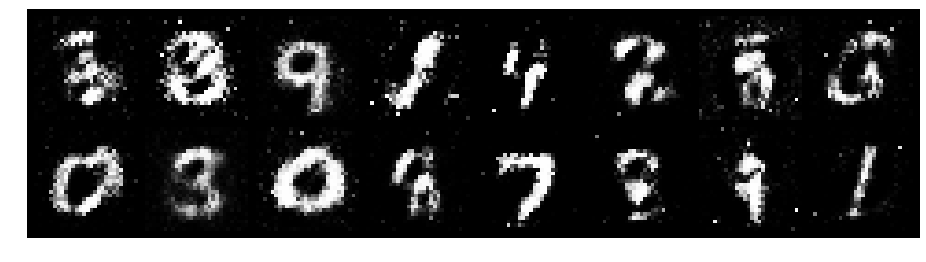

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.8569, Generator Loss: 1.4954
D(x): 0.7302, D(G(z)): 0.3157


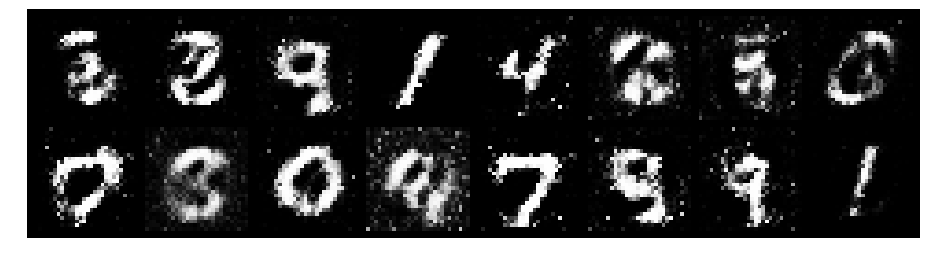

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.8801, Generator Loss: 1.5953
D(x): 0.6572, D(G(z)): 0.2702


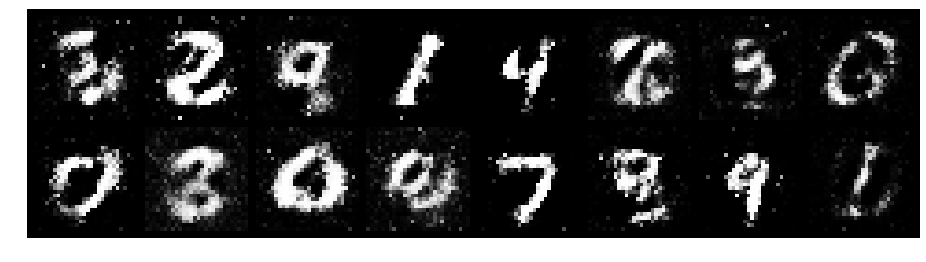

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.9673, Generator Loss: 1.5185
D(x): 0.6656, D(G(z)): 0.3263


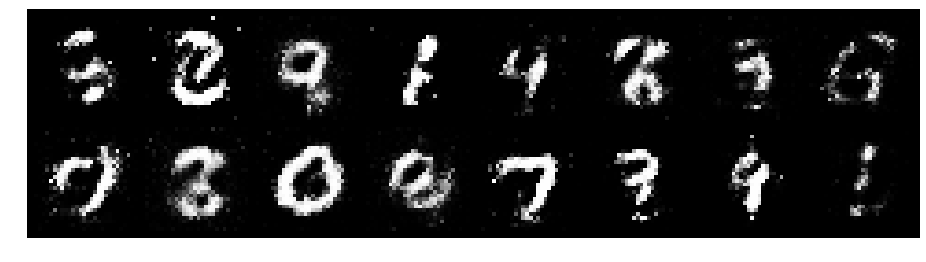

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.7453, Generator Loss: 1.5780
D(x): 0.8016, D(G(z)): 0.3180


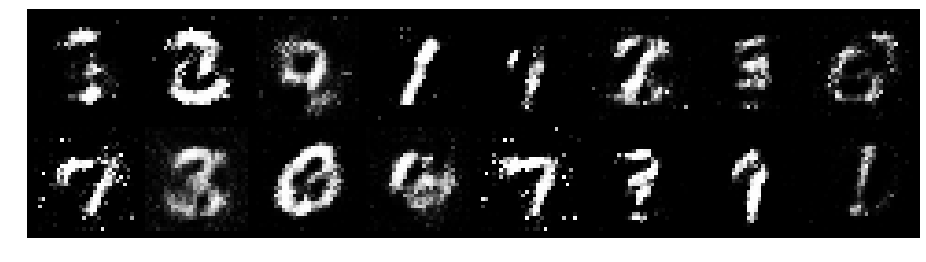

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.6859, Generator Loss: 2.1170
D(x): 0.7529, D(G(z)): 0.1946


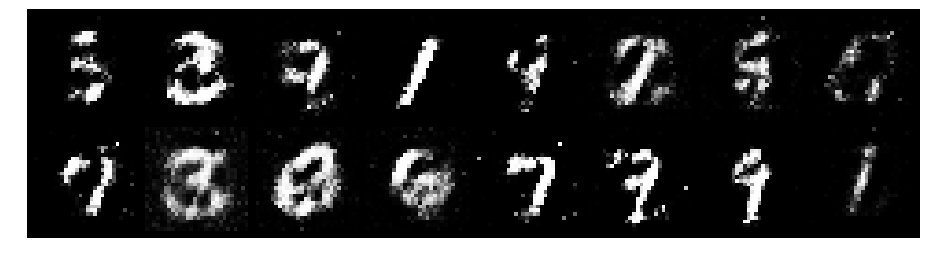

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 1.2489, Generator Loss: 1.3018
D(x): 0.6321, D(G(z)): 0.3775


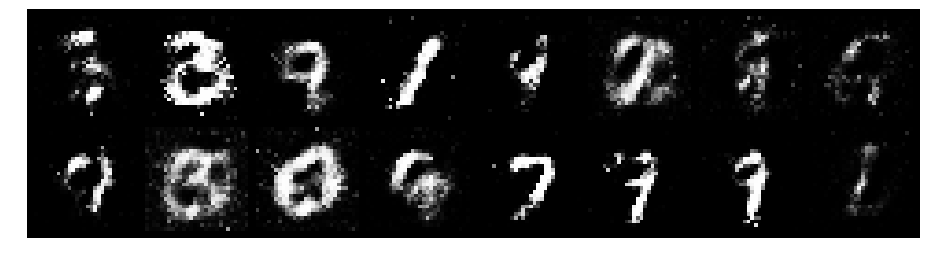

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 1.1359, Generator Loss: 1.0460
D(x): 0.6519, D(G(z)): 0.3787


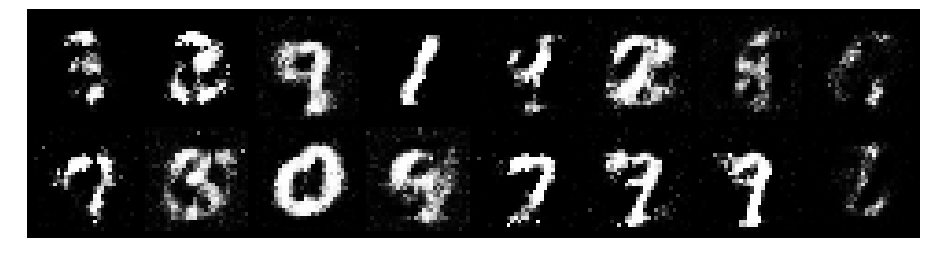

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.8822, Generator Loss: 2.2641
D(x): 0.7935, D(G(z)): 0.3132


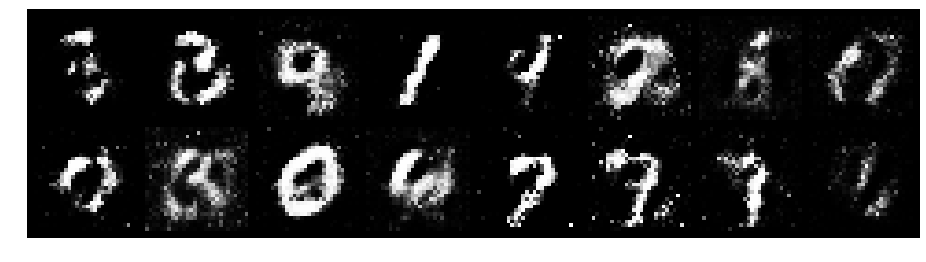

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.8056, Generator Loss: 2.4782
D(x): 0.7670, D(G(z)): 0.2366


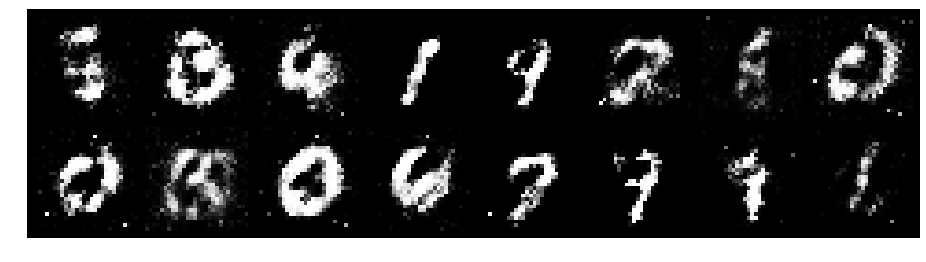

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.8743, Generator Loss: 1.3678
D(x): 0.7130, D(G(z)): 0.3151


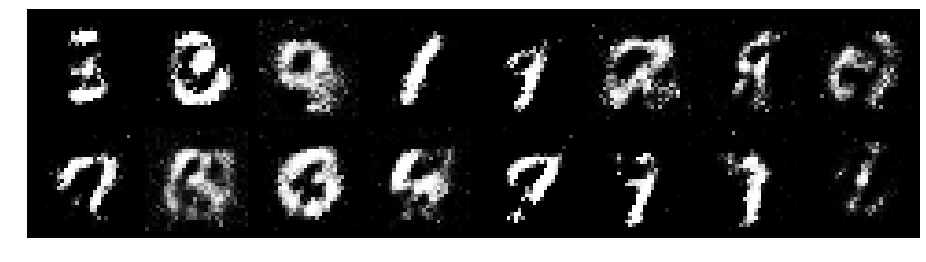

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.7087, Generator Loss: 2.1280
D(x): 0.7948, D(G(z)): 0.2619


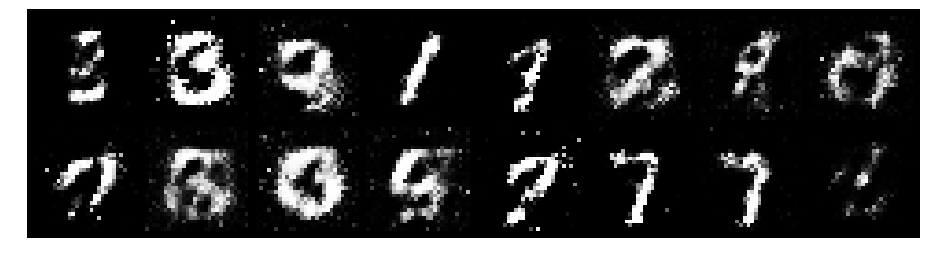

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.9142, Generator Loss: 1.5653
D(x): 0.6701, D(G(z)): 0.2914


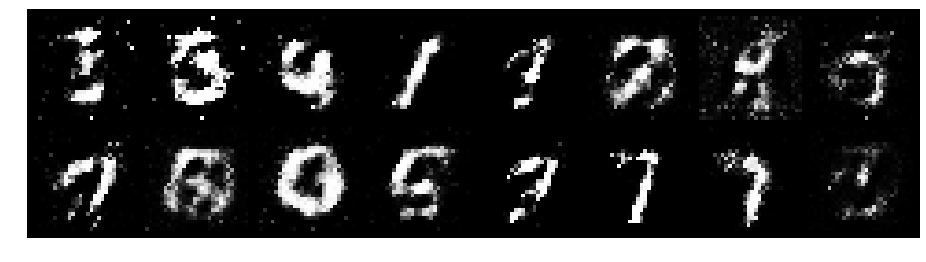

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.8800, Generator Loss: 1.6411
D(x): 0.7459, D(G(z)): 0.3461


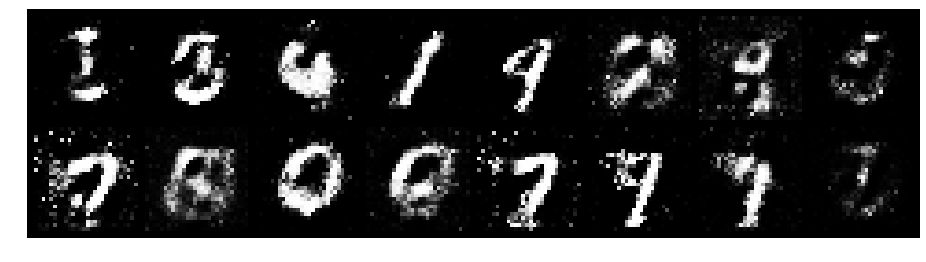

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.7077, Generator Loss: 1.9161
D(x): 0.7851, D(G(z)): 0.2715


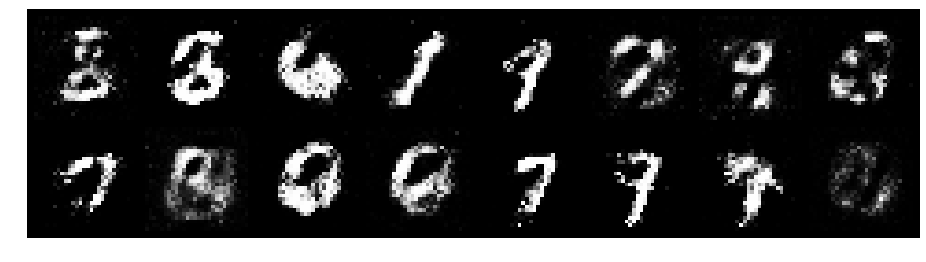

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.7332, Generator Loss: 1.7930
D(x): 0.7529, D(G(z)): 0.2467


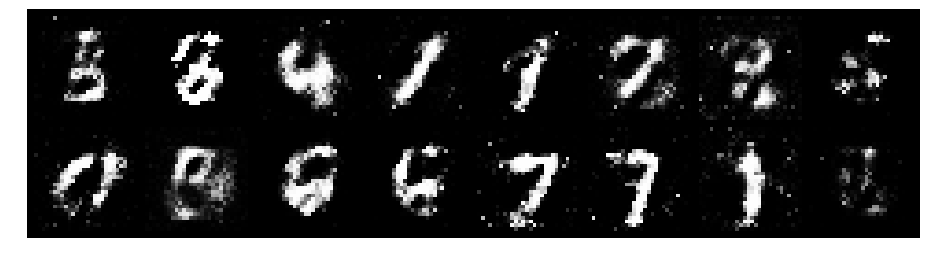

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.7616, Generator Loss: 1.5437
D(x): 0.7994, D(G(z)): 0.2968


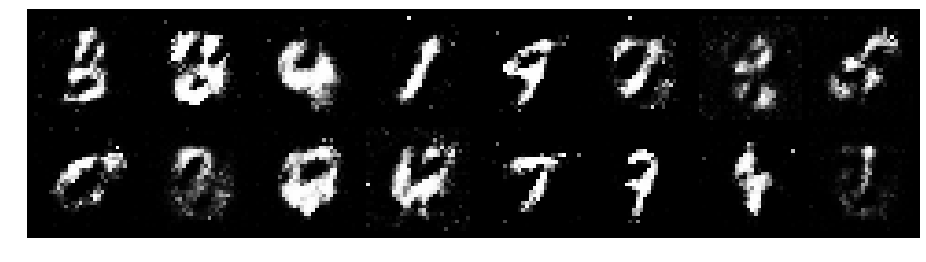

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8955, Generator Loss: 1.6282
D(x): 0.7541, D(G(z)): 0.3385


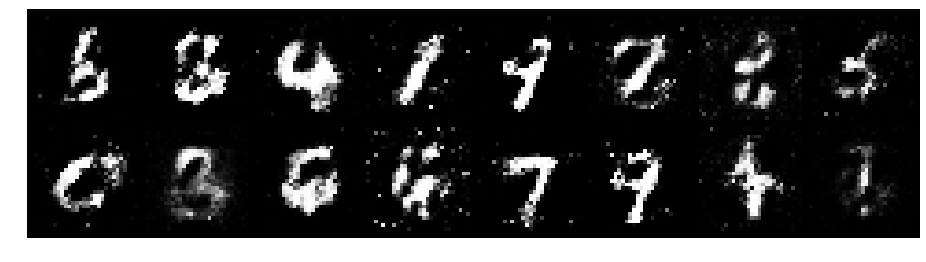

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.7091, Generator Loss: 1.6802
D(x): 0.7880, D(G(z)): 0.2897


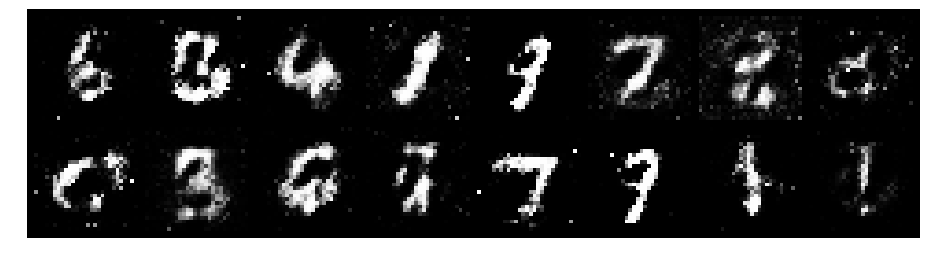

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 1.0778, Generator Loss: 1.3672
D(x): 0.7131, D(G(z)): 0.3745


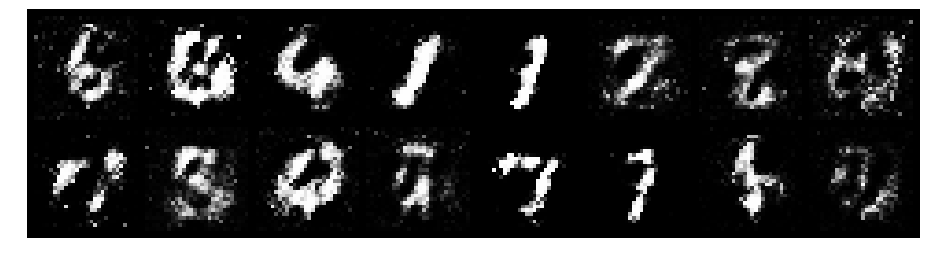

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.8965, Generator Loss: 1.7643
D(x): 0.6572, D(G(z)): 0.2705


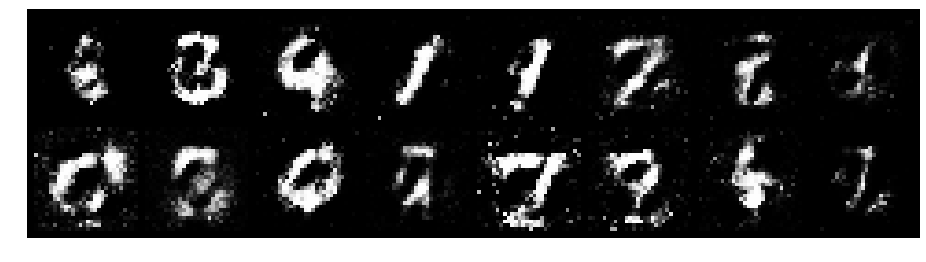

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.8230, Generator Loss: 1.6015
D(x): 0.7027, D(G(z)): 0.2491


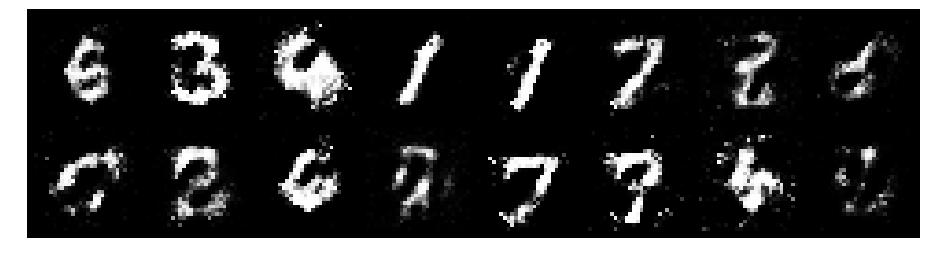

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.0461, Generator Loss: 1.4198
D(x): 0.7337, D(G(z)): 0.3947


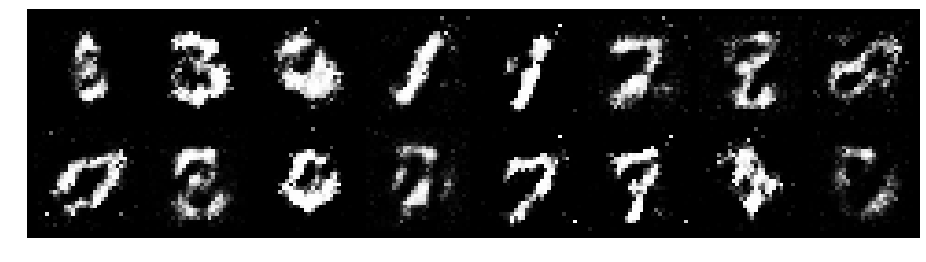

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.9154, Generator Loss: 1.4336
D(x): 0.7039, D(G(z)): 0.3055


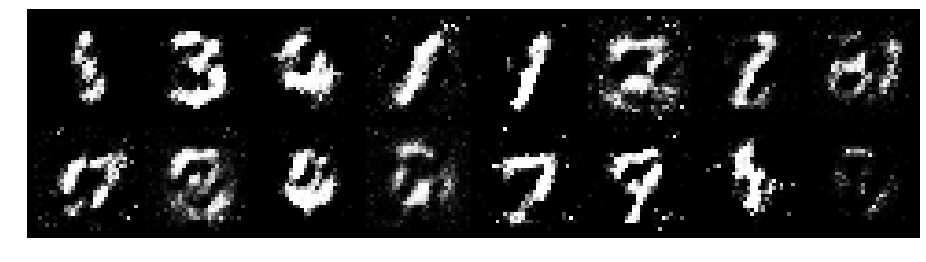

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.8218, Generator Loss: 1.9369
D(x): 0.7203, D(G(z)): 0.2747


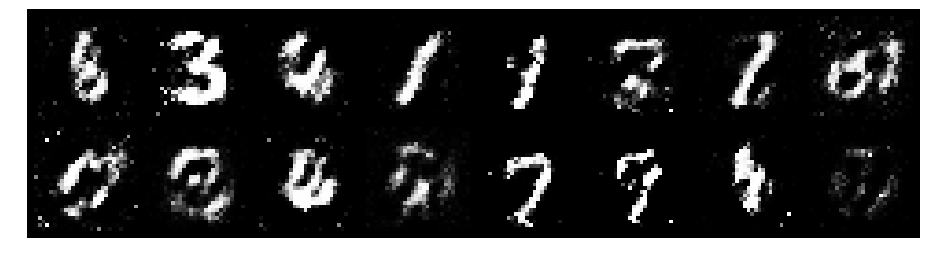

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.8874, Generator Loss: 1.4492
D(x): 0.7398, D(G(z)): 0.3450


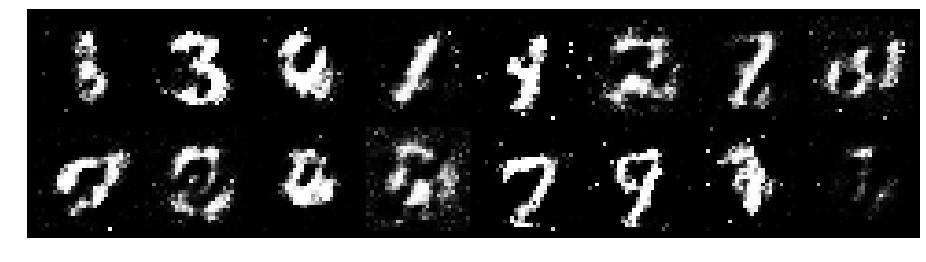

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8333, Generator Loss: 2.0116
D(x): 0.7709, D(G(z)): 0.3002


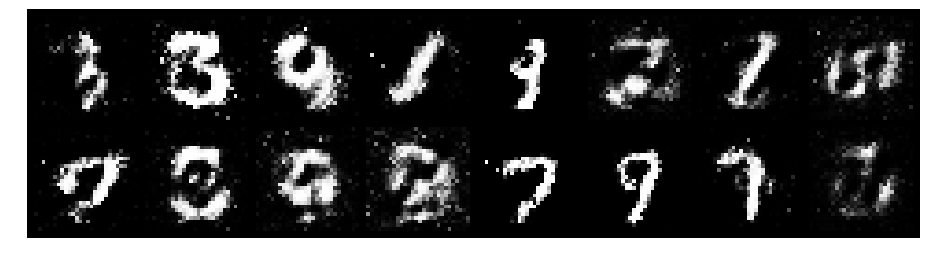

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.7592, Generator Loss: 1.7797
D(x): 0.7532, D(G(z)): 0.2695


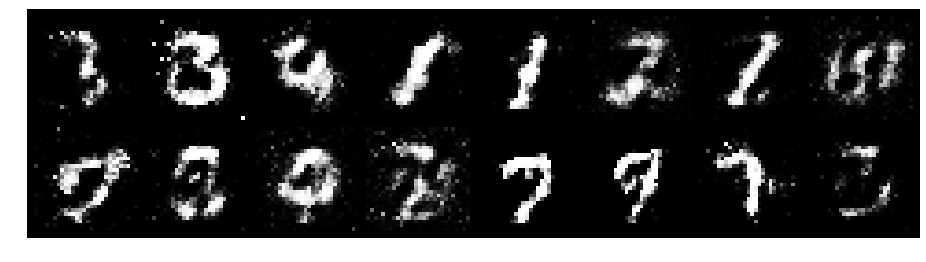

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.6572, Generator Loss: 1.7777
D(x): 0.7733, D(G(z)): 0.2396


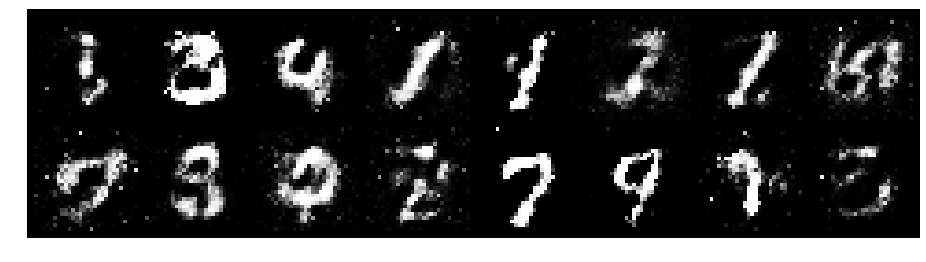

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9110, Generator Loss: 1.6867
D(x): 0.7307, D(G(z)): 0.3244


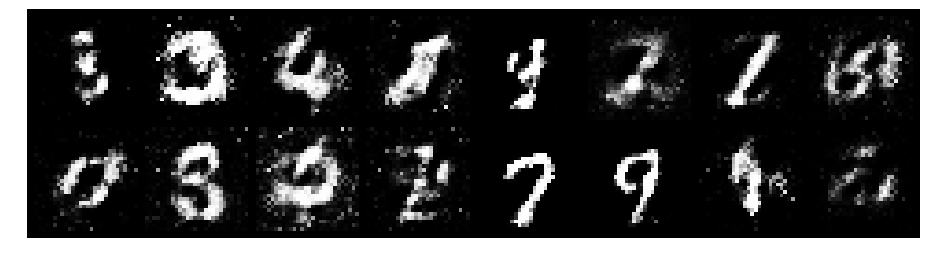

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.9016, Generator Loss: 1.7128
D(x): 0.7048, D(G(z)): 0.2882


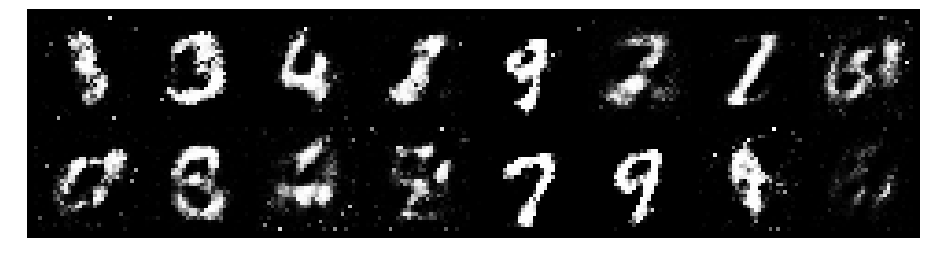

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 1.0050, Generator Loss: 1.6673
D(x): 0.6118, D(G(z)): 0.2475


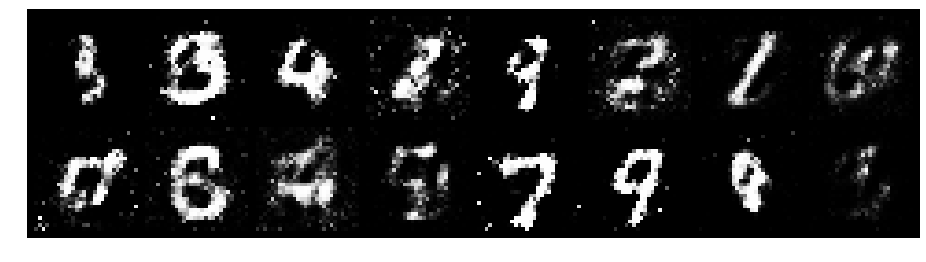

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.9166, Generator Loss: 1.3067
D(x): 0.7203, D(G(z)): 0.3575


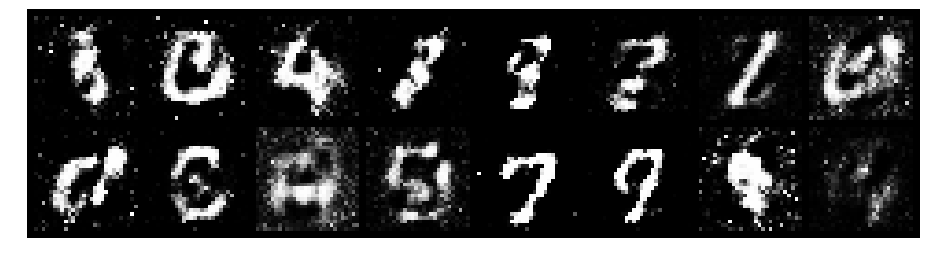

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 1.0831, Generator Loss: 1.4358
D(x): 0.6386, D(G(z)): 0.3316


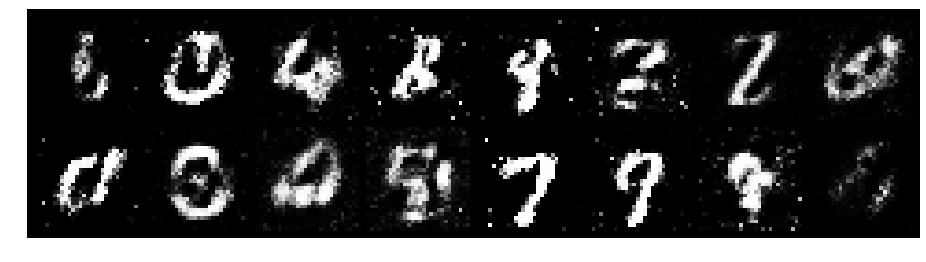

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.9680, Generator Loss: 1.3601
D(x): 0.7127, D(G(z)): 0.3614


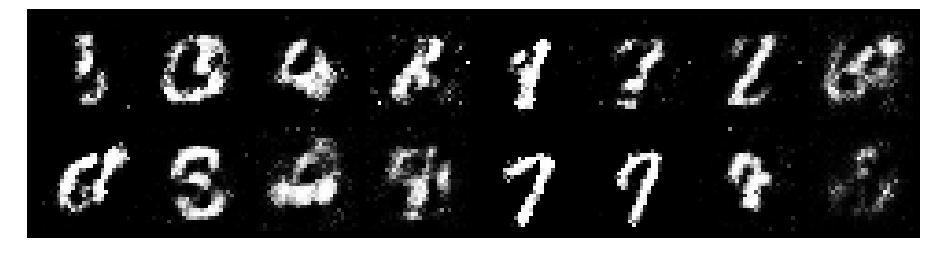

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.8632, Generator Loss: 1.3105
D(x): 0.7836, D(G(z)): 0.3914


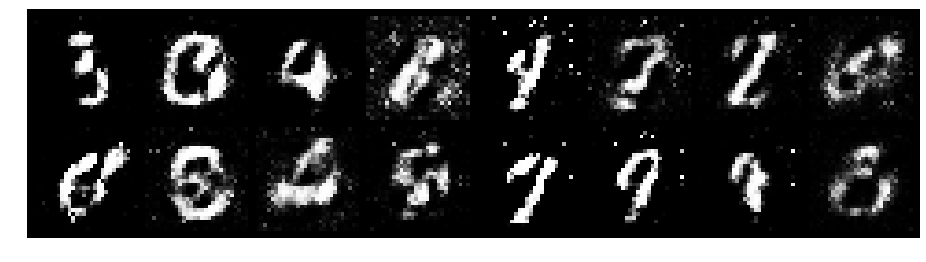

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.7998, Generator Loss: 1.4444
D(x): 0.7444, D(G(z)): 0.3143


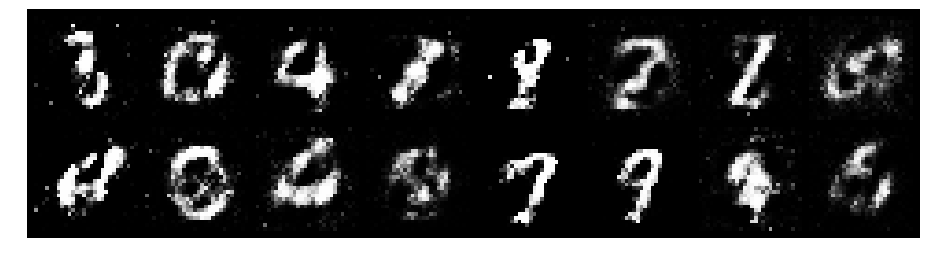

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.7306, Generator Loss: 1.7907
D(x): 0.7331, D(G(z)): 0.2301


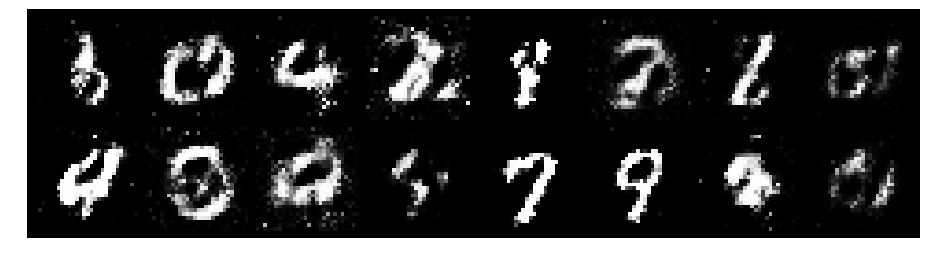

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.8254, Generator Loss: 1.9148
D(x): 0.7130, D(G(z)): 0.2622


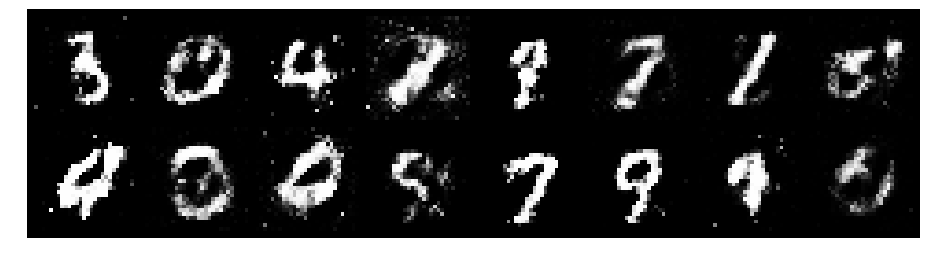

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 1.0527, Generator Loss: 1.1577
D(x): 0.6986, D(G(z)): 0.3742


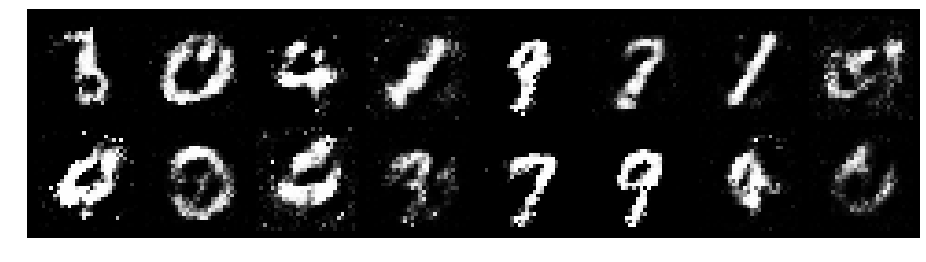

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 1.0898, Generator Loss: 1.4333
D(x): 0.6229, D(G(z)): 0.2585


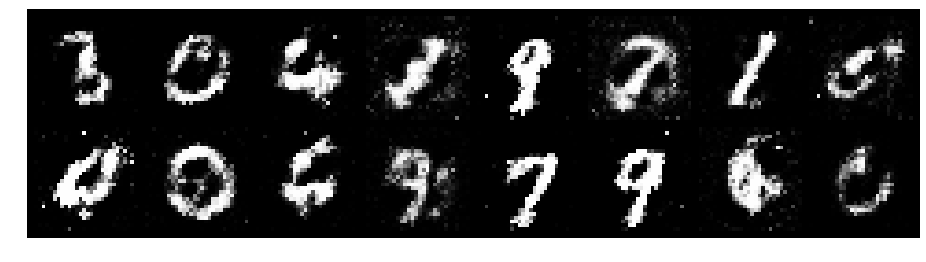

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.7522, Generator Loss: 1.5430
D(x): 0.7833, D(G(z)): 0.3136


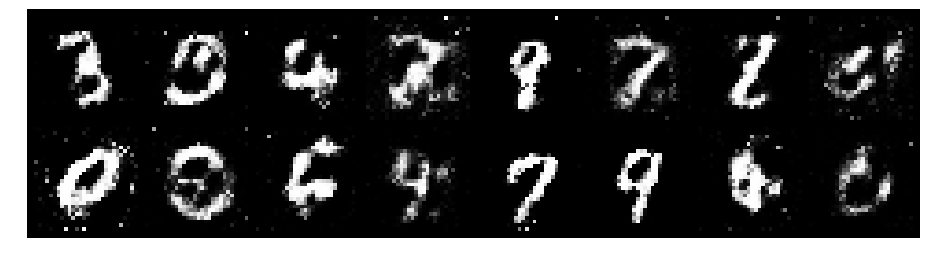

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.9985, Generator Loss: 1.4803
D(x): 0.6965, D(G(z)): 0.3573


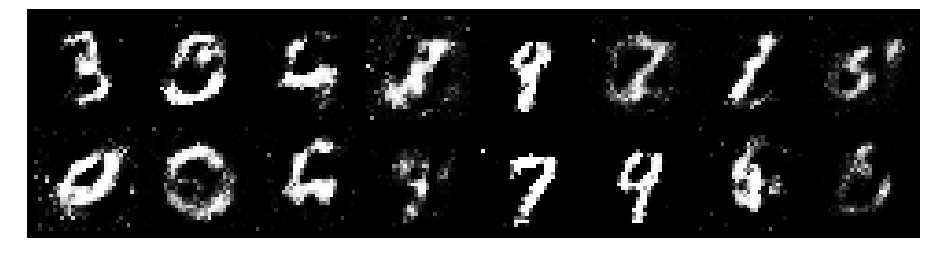

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.1196, Generator Loss: 1.2427
D(x): 0.7057, D(G(z)): 0.4143


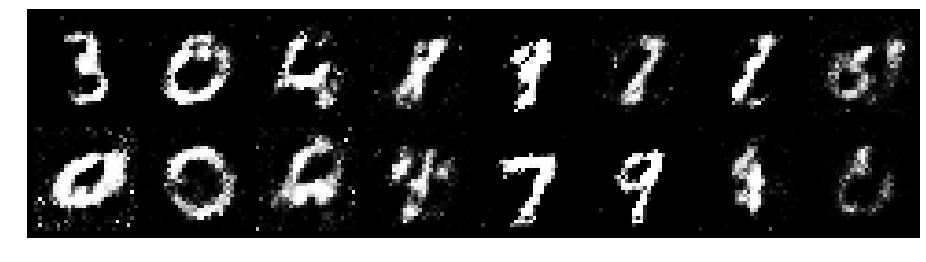

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.9674, Generator Loss: 1.2912
D(x): 0.6741, D(G(z)): 0.3429


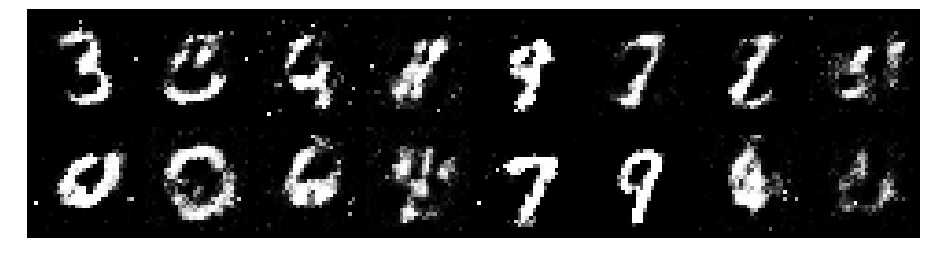

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.0036, Generator Loss: 1.2379
D(x): 0.6775, D(G(z)): 0.3463


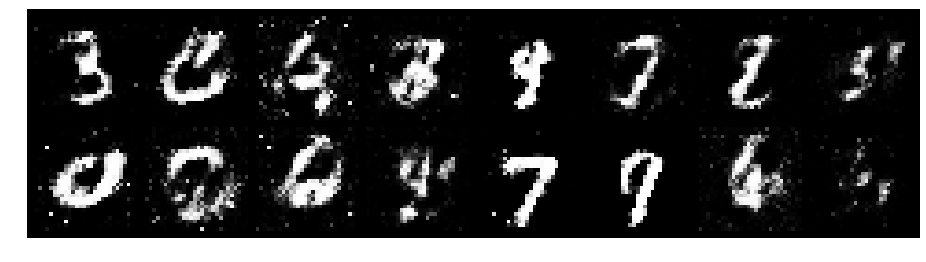

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.8574, Generator Loss: 1.5891
D(x): 0.7365, D(G(z)): 0.3237


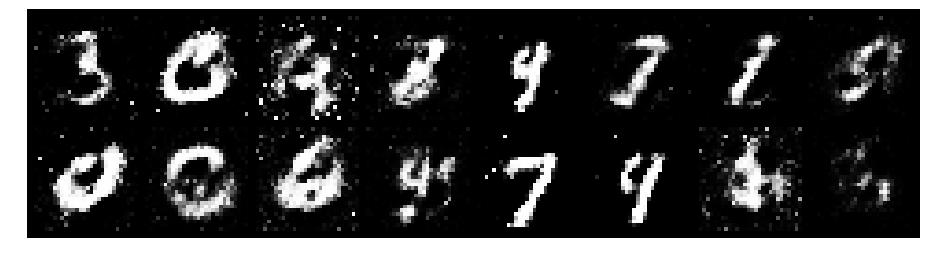

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.9875, Generator Loss: 1.4801
D(x): 0.6640, D(G(z)): 0.3285


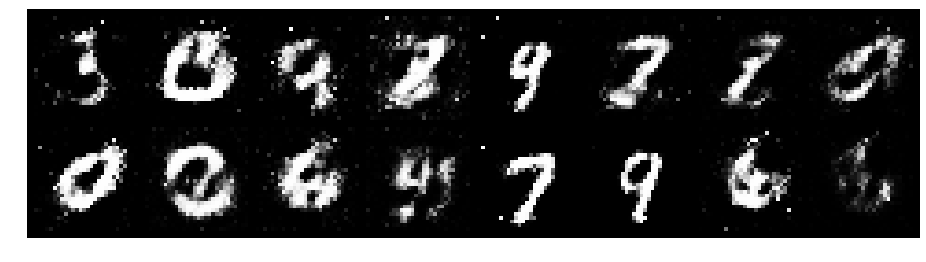

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.0136, Generator Loss: 1.2279
D(x): 0.6625, D(G(z)): 0.2998


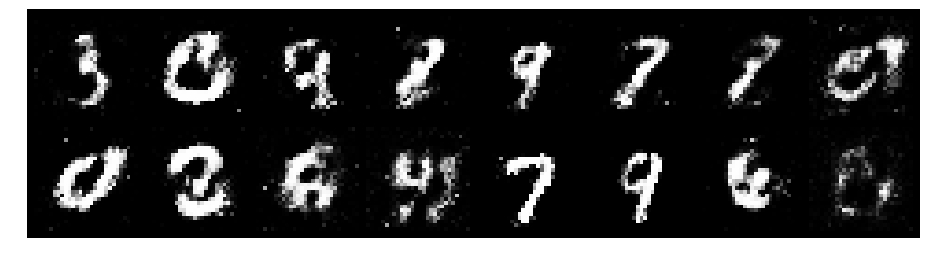

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 1.0347, Generator Loss: 1.5061
D(x): 0.6482, D(G(z)): 0.3018


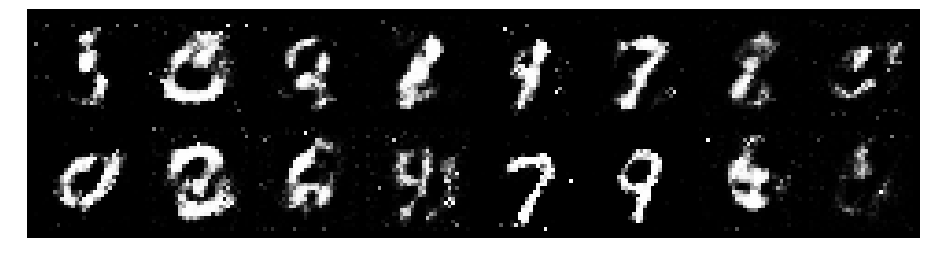

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 1.0205, Generator Loss: 1.1789
D(x): 0.6372, D(G(z)): 0.3229


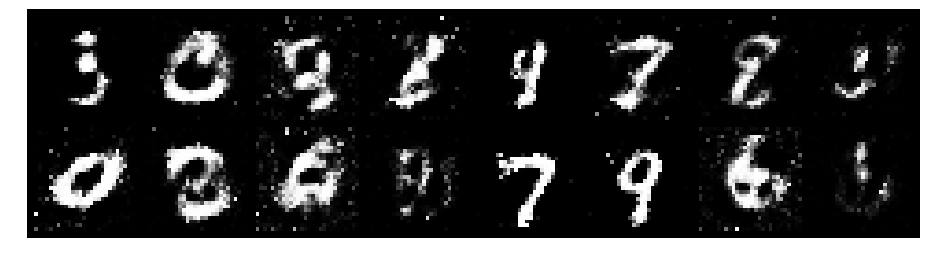

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 1.1445, Generator Loss: 1.3124
D(x): 0.7656, D(G(z)): 0.4415


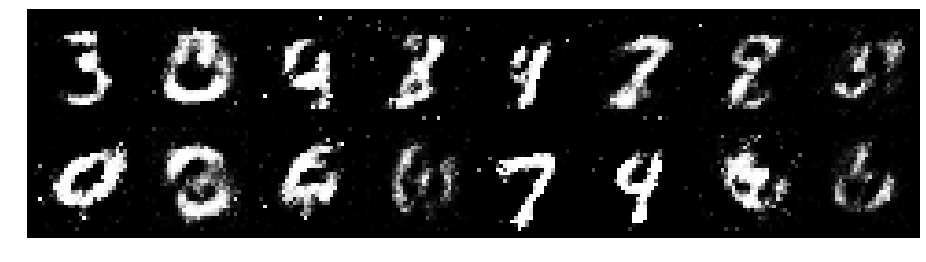

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.8109, Generator Loss: 1.5591
D(x): 0.7234, D(G(z)): 0.2842


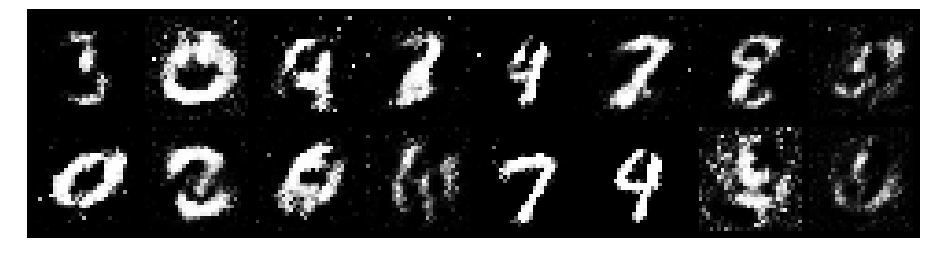

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.9389, Generator Loss: 2.0908
D(x): 0.6599, D(G(z)): 0.2553


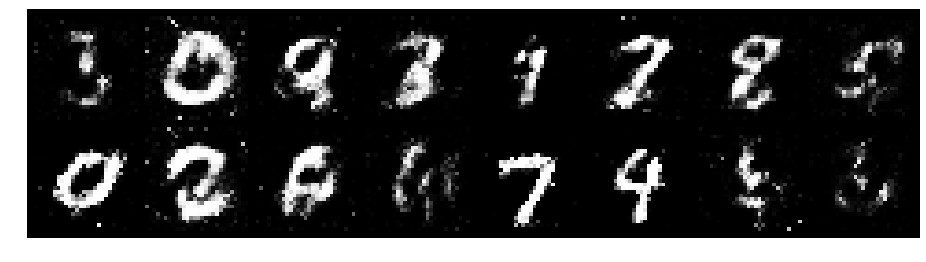

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 1.1347, Generator Loss: 2.0244
D(x): 0.5765, D(G(z)): 0.2231


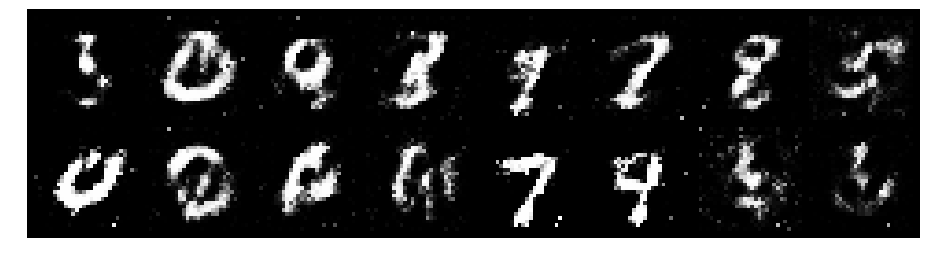

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.0592, Generator Loss: 1.5404
D(x): 0.6686, D(G(z)): 0.3419


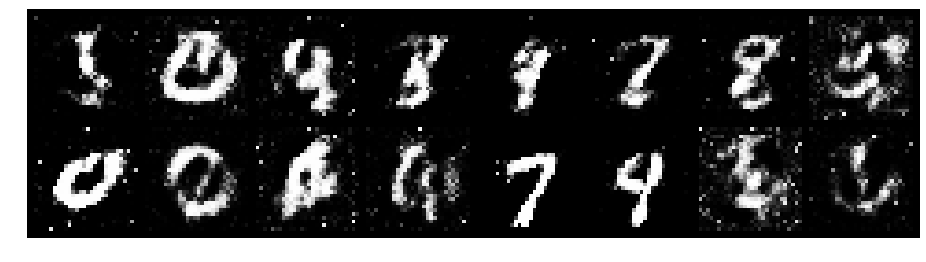

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.9963, Generator Loss: 1.4070
D(x): 0.6887, D(G(z)): 0.3072


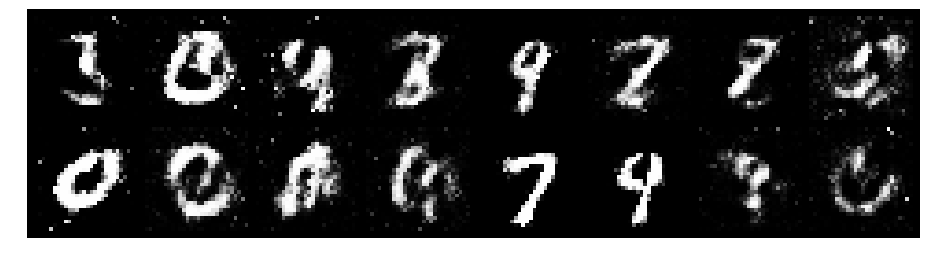

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.2078, Generator Loss: 1.2759
D(x): 0.6489, D(G(z)): 0.3992


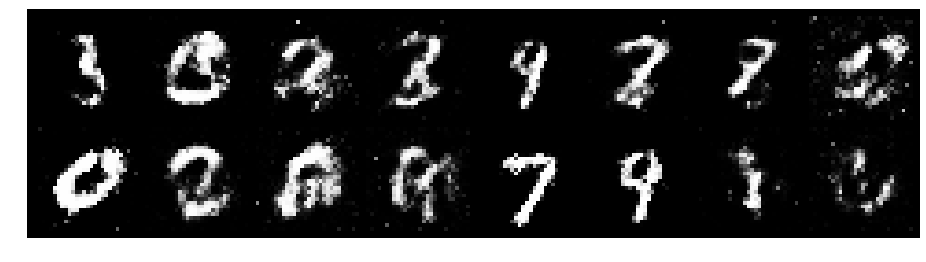

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.9395, Generator Loss: 1.3030
D(x): 0.6998, D(G(z)): 0.3632


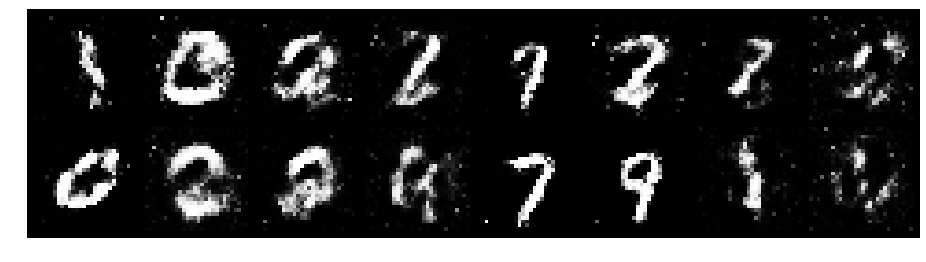

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9959, Generator Loss: 1.4206
D(x): 0.6524, D(G(z)): 0.3333


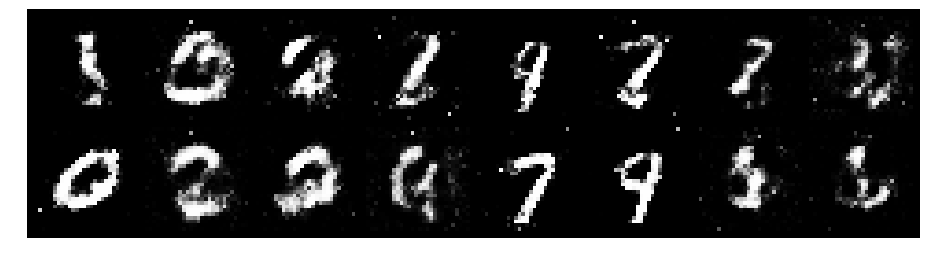

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.9574, Generator Loss: 1.3235
D(x): 0.6216, D(G(z)): 0.2428


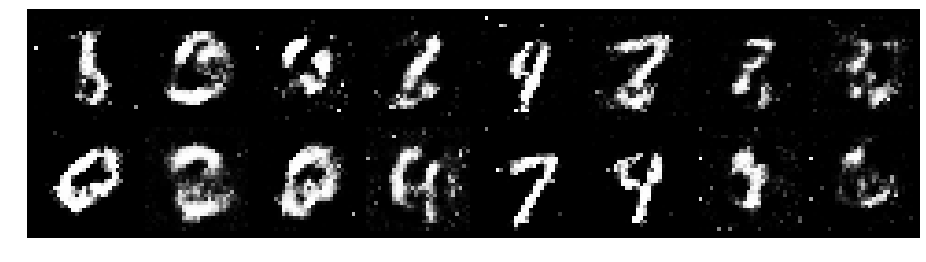

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.9319, Generator Loss: 1.6673
D(x): 0.5873, D(G(z)): 0.1889


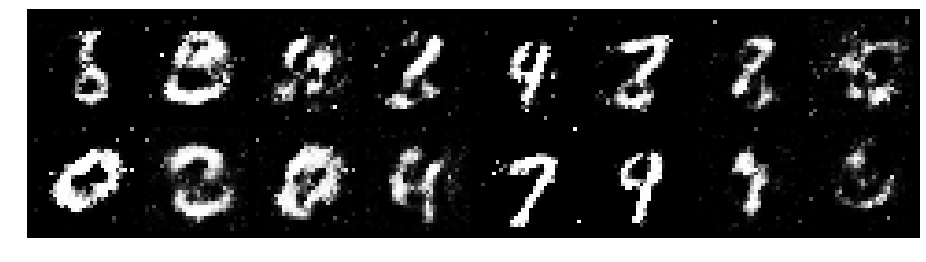

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.0293, Generator Loss: 1.1406
D(x): 0.7039, D(G(z)): 0.4003


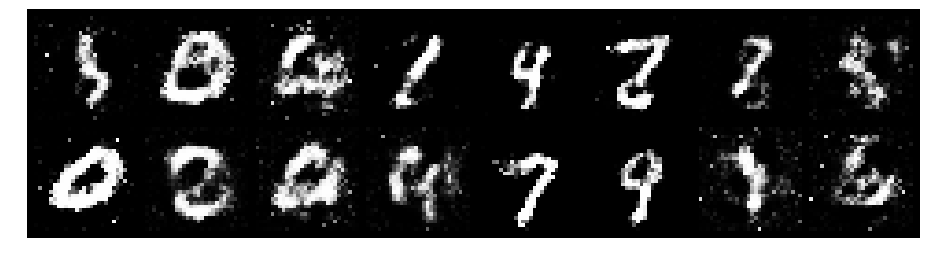

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.8931, Generator Loss: 1.5861
D(x): 0.6501, D(G(z)): 0.2584


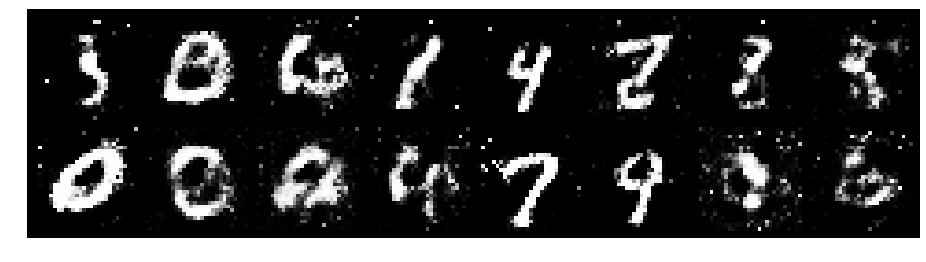

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.0134, Generator Loss: 1.2908
D(x): 0.6747, D(G(z)): 0.3434


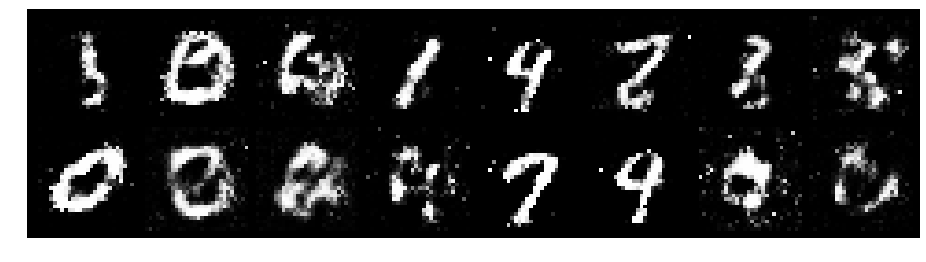

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.9513, Generator Loss: 1.1297
D(x): 0.6806, D(G(z)): 0.3692


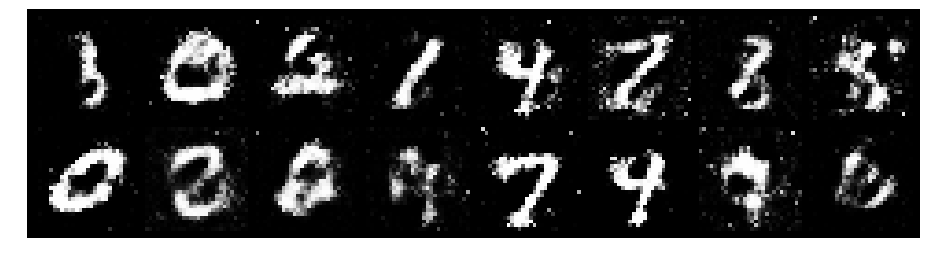

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 1.0624, Generator Loss: 0.9857
D(x): 0.6792, D(G(z)): 0.4273


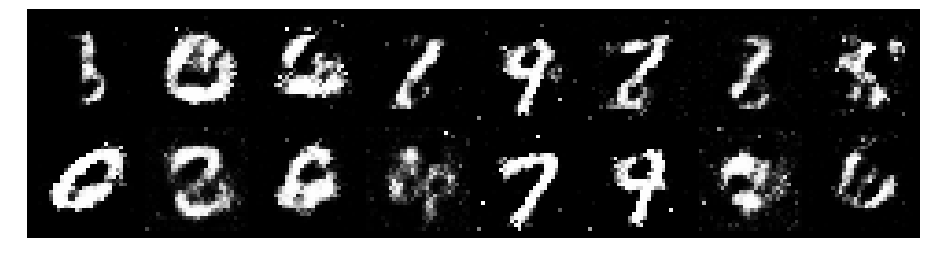

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.1901, Generator Loss: 1.0467
D(x): 0.6717, D(G(z)): 0.4240


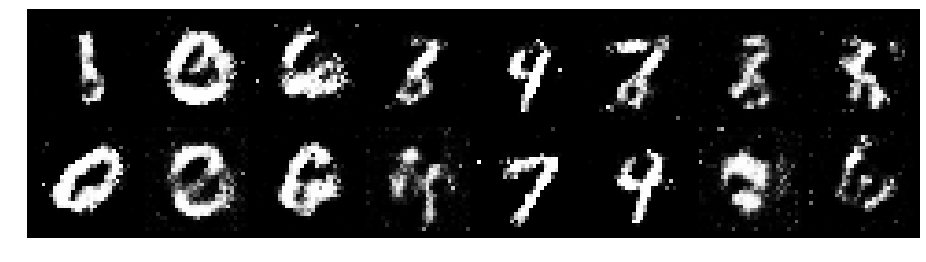

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.1305, Generator Loss: 1.3138
D(x): 0.6515, D(G(z)): 0.3793


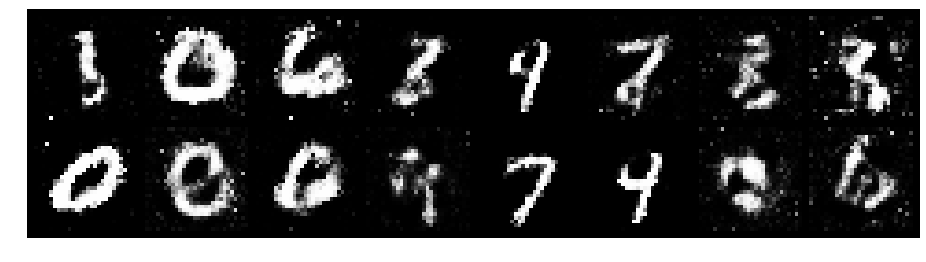

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 1.1348, Generator Loss: 1.1461
D(x): 0.6173, D(G(z)): 0.3490


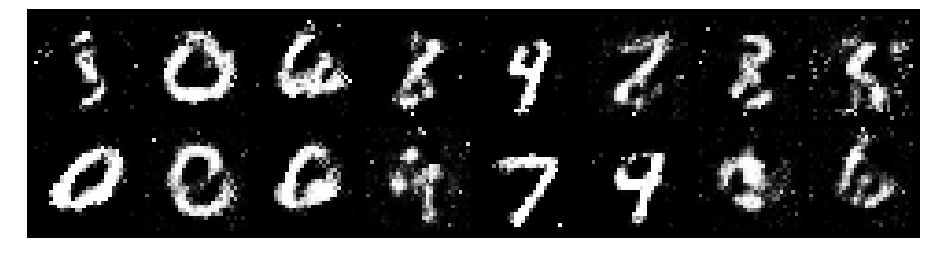

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 1.0454, Generator Loss: 1.3910
D(x): 0.6229, D(G(z)): 0.3070


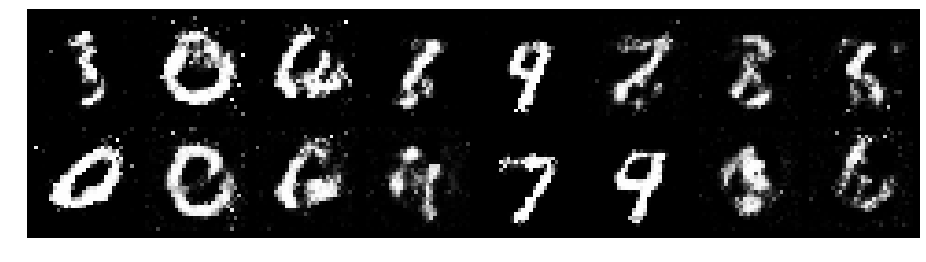

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.2243, Generator Loss: 1.0691
D(x): 0.6099, D(G(z)): 0.3901


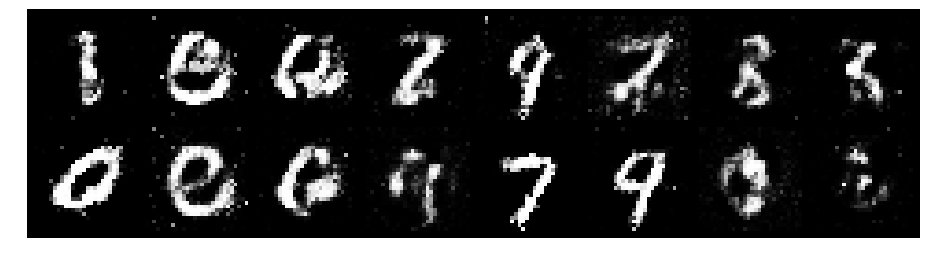

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.2563, Generator Loss: 1.5136
D(x): 0.6147, D(G(z)): 0.3749


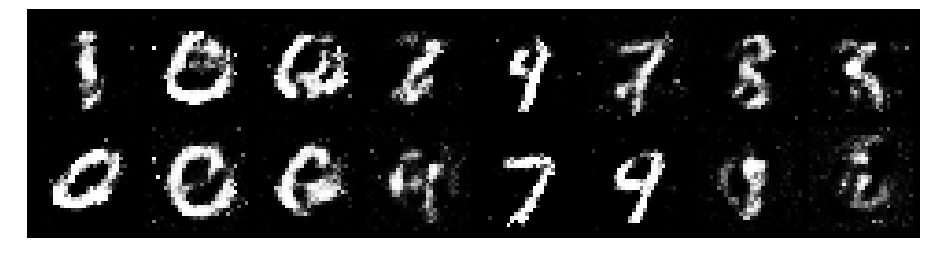

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.0531, Generator Loss: 1.3491
D(x): 0.6607, D(G(z)): 0.3602


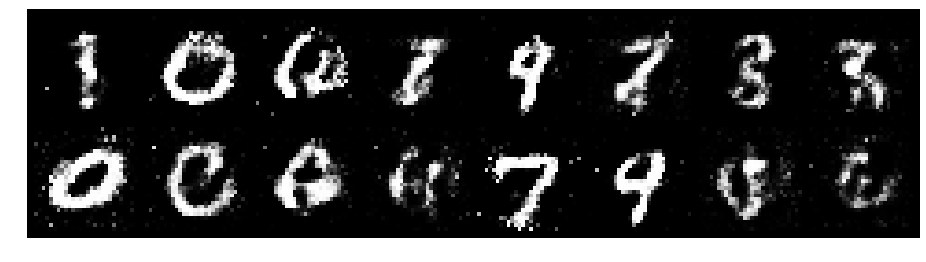

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.0983, Generator Loss: 1.2306
D(x): 0.6633, D(G(z)): 0.3797


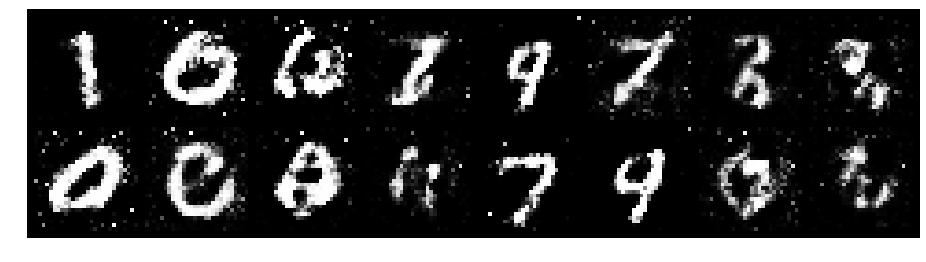

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.9900, Generator Loss: 1.3586
D(x): 0.6410, D(G(z)): 0.2939


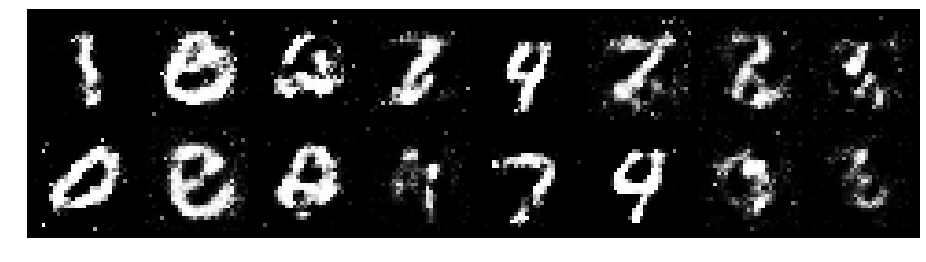

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 0.9851, Generator Loss: 1.3569
D(x): 0.6616, D(G(z)): 0.3502


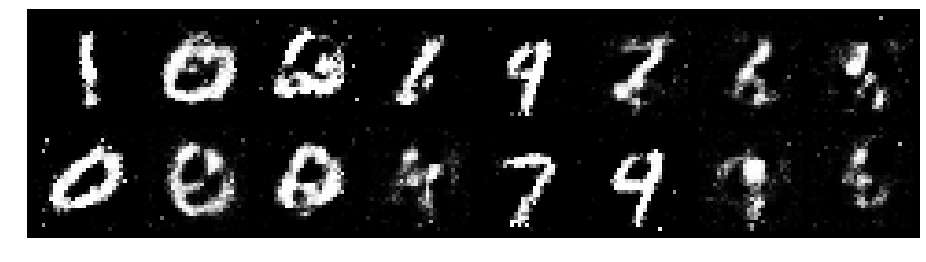

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 0.8949, Generator Loss: 1.4399
D(x): 0.7300, D(G(z)): 0.3492


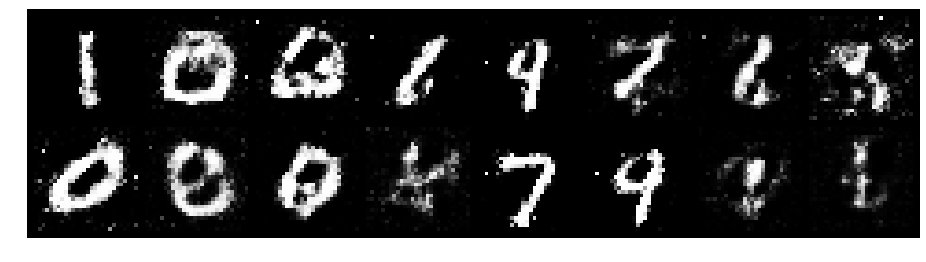

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.8818, Generator Loss: 1.3731
D(x): 0.7084, D(G(z)): 0.3447


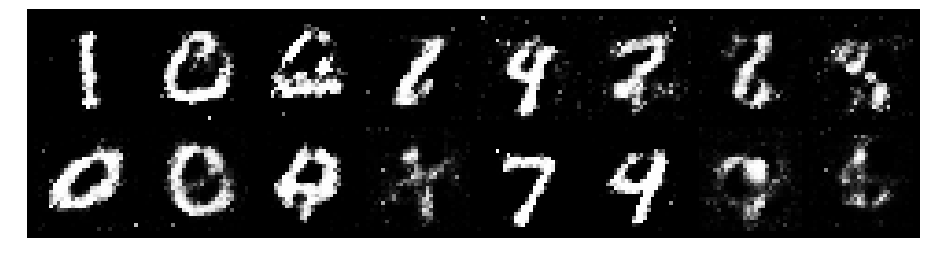

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.9446, Generator Loss: 1.2622
D(x): 0.6566, D(G(z)): 0.3244


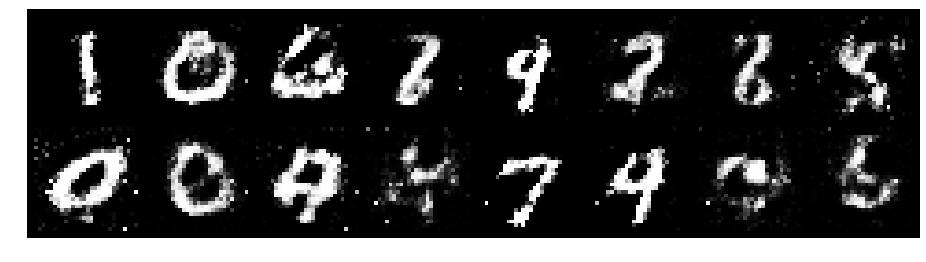

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.9408, Generator Loss: 1.2941
D(x): 0.6633, D(G(z)): 0.3097


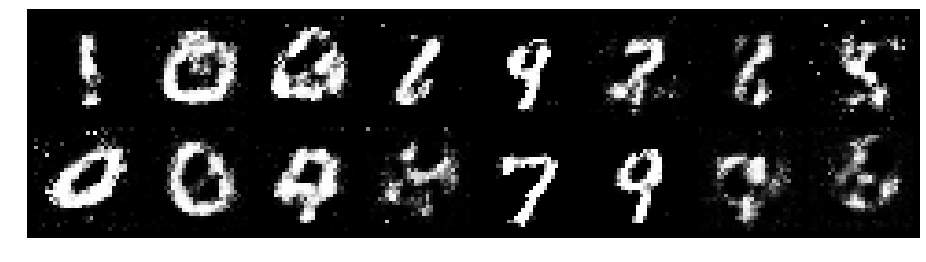

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.9319, Generator Loss: 1.3607
D(x): 0.7394, D(G(z)): 0.3719


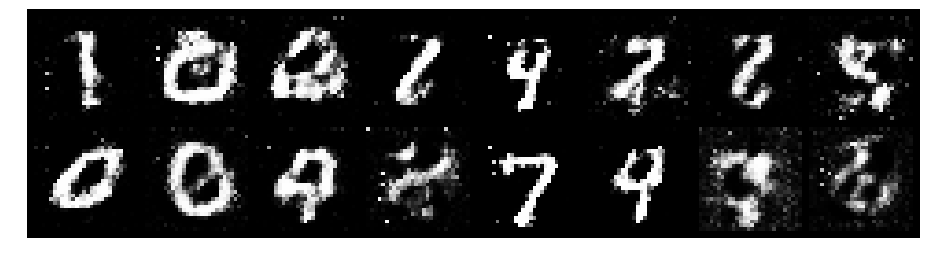

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.0863, Generator Loss: 1.2045
D(x): 0.6113, D(G(z)): 0.3307


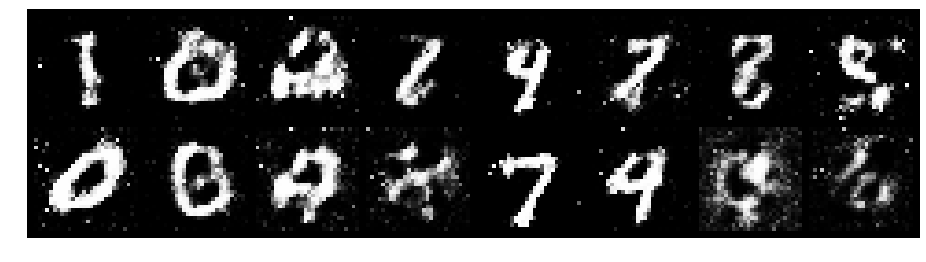

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.1797, Generator Loss: 1.3743
D(x): 0.5961, D(G(z)): 0.3303


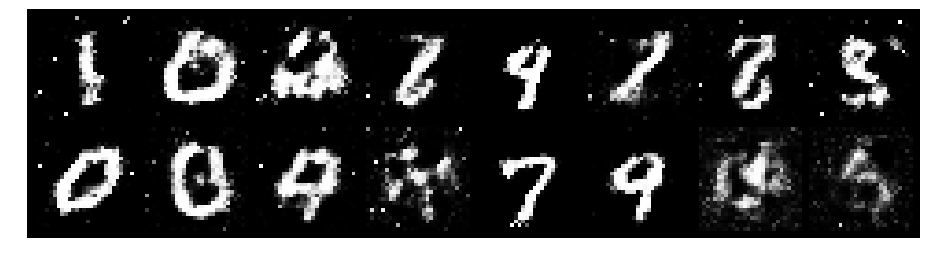

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.0802, Generator Loss: 1.1121
D(x): 0.6646, D(G(z)): 0.4064


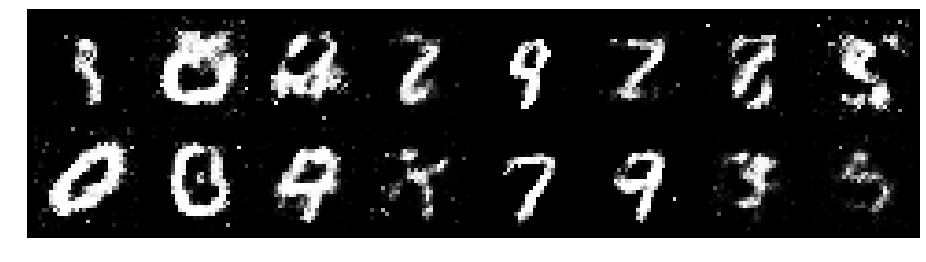

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.7681, Generator Loss: 1.3057
D(x): 0.7266, D(G(z)): 0.2668


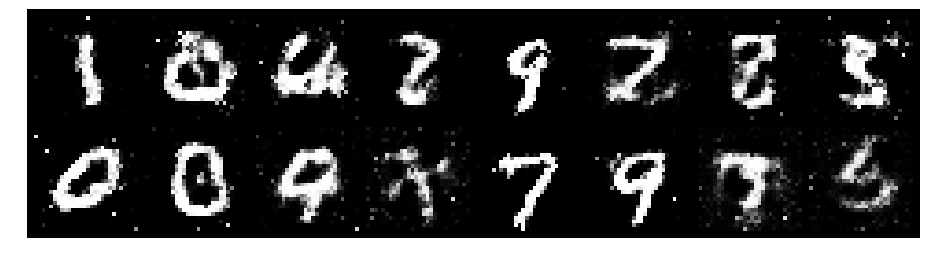

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 0.9643, Generator Loss: 1.4401
D(x): 0.6564, D(G(z)): 0.3281


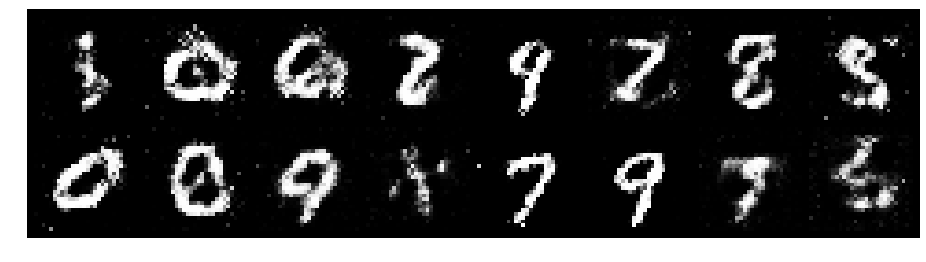

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.9968, Generator Loss: 1.4456
D(x): 0.6599, D(G(z)): 0.3102


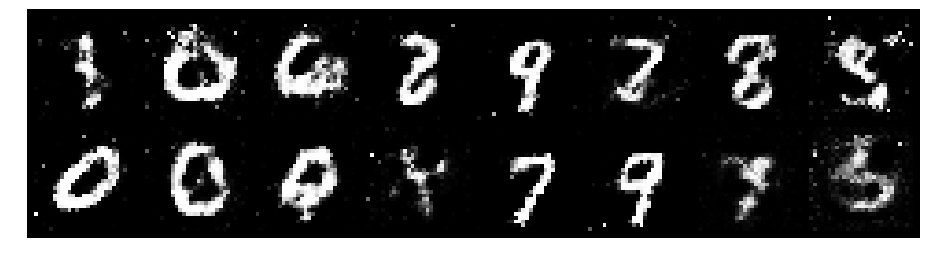

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.0895, Generator Loss: 1.2438
D(x): 0.5846, D(G(z)): 0.3070


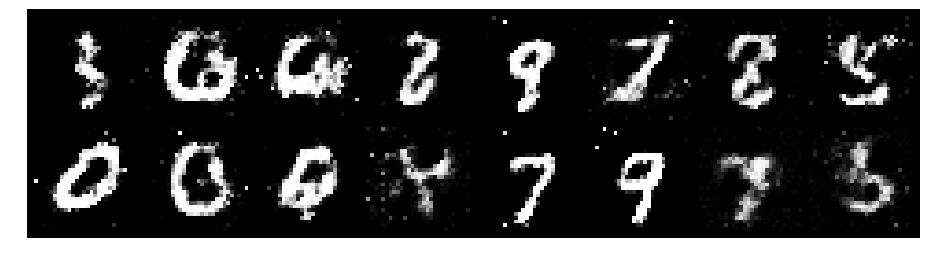

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.0937, Generator Loss: 1.6814
D(x): 0.6685, D(G(z)): 0.3576


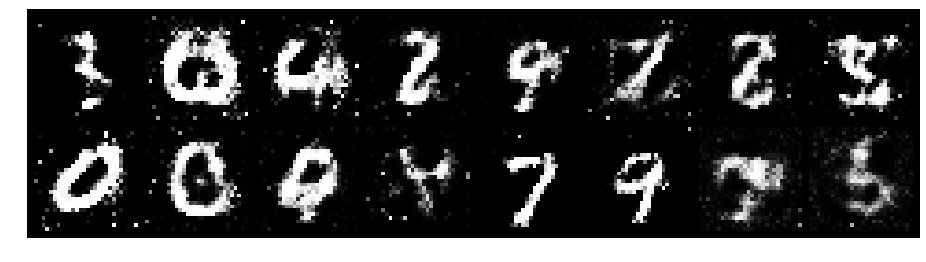

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.1895, Generator Loss: 1.2085
D(x): 0.6516, D(G(z)): 0.4376


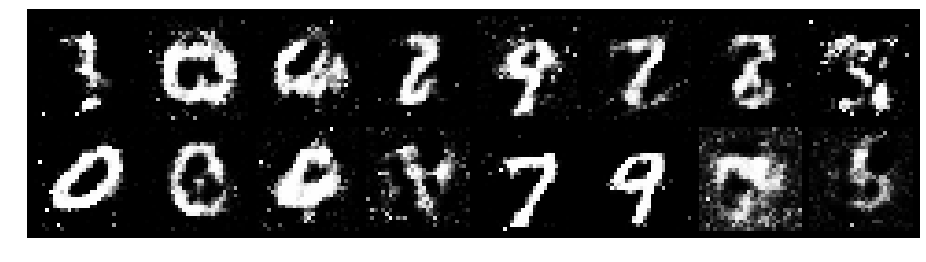

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.0371, Generator Loss: 0.9297
D(x): 0.7469, D(G(z)): 0.4388


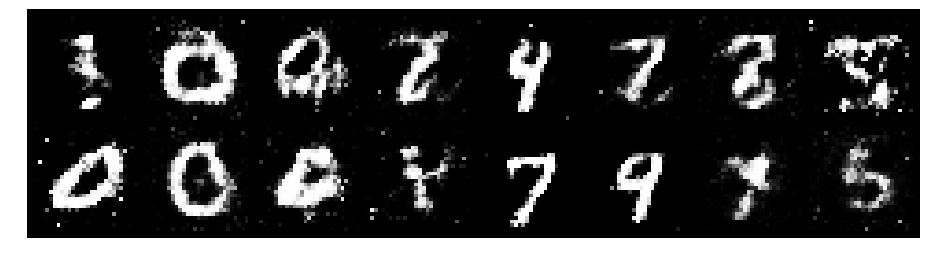

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.2608, Generator Loss: 1.0269
D(x): 0.6430, D(G(z)): 0.4076


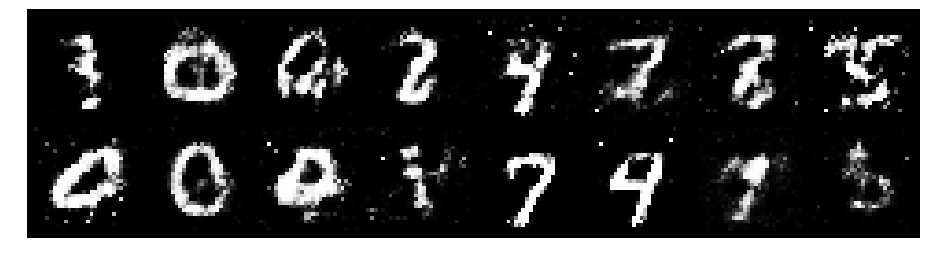

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.2770, Generator Loss: 0.9491
D(x): 0.5675, D(G(z)): 0.4234


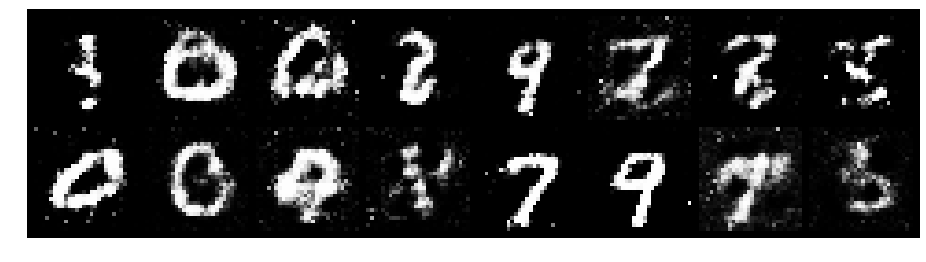

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.5884, Generator Loss: 1.2803
D(x): 0.5452, D(G(z)): 0.4595


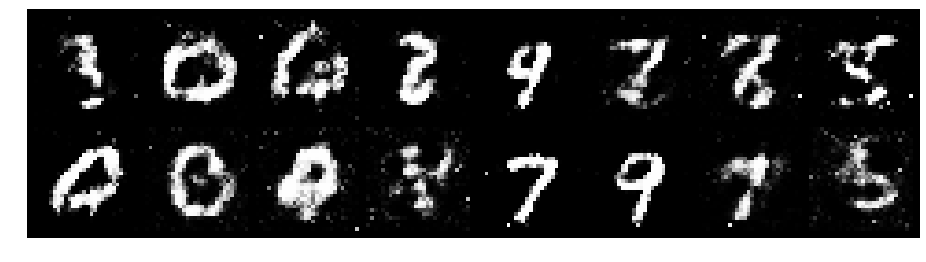

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.2222, Generator Loss: 0.9518
D(x): 0.6416, D(G(z)): 0.4521


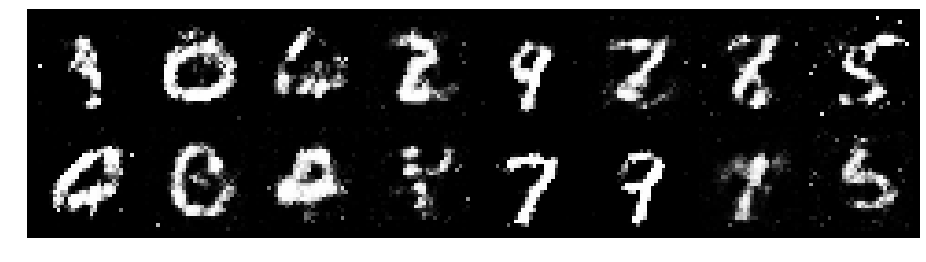

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.0637, Generator Loss: 1.2343
D(x): 0.6771, D(G(z)): 0.3869


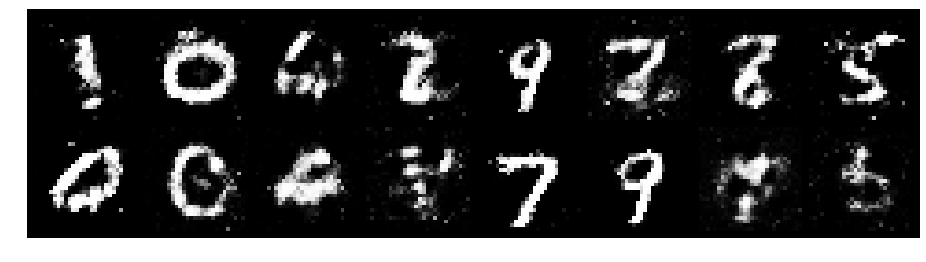

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9242, Generator Loss: 1.4396
D(x): 0.6726, D(G(z)): 0.3089


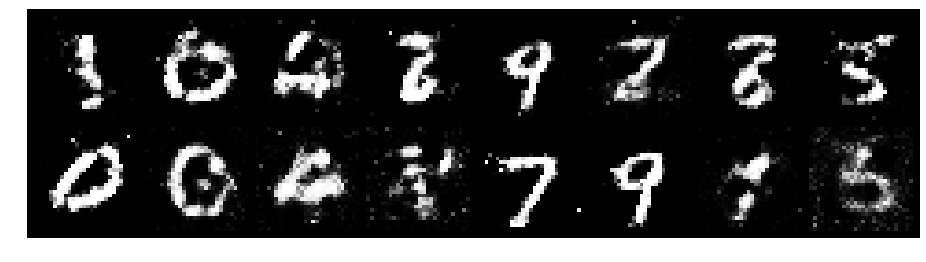

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.0625, Generator Loss: 1.1825
D(x): 0.5942, D(G(z)): 0.3215


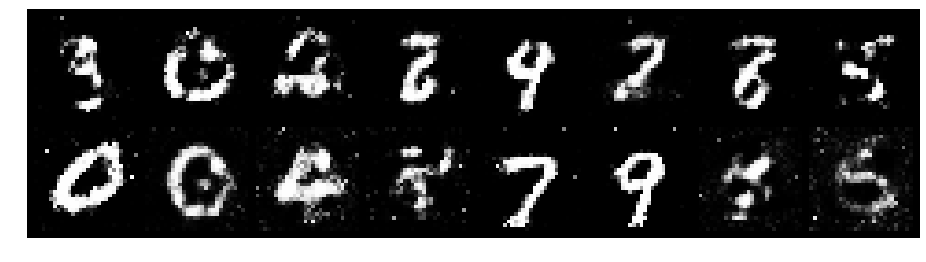

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.1058, Generator Loss: 1.0726
D(x): 0.7265, D(G(z)): 0.4576


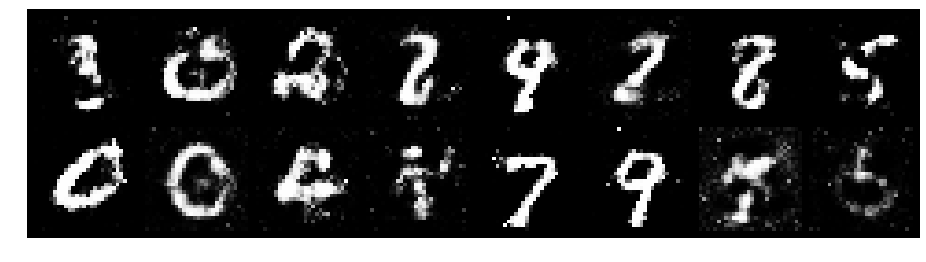

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.2347, Generator Loss: 0.9956
D(x): 0.5724, D(G(z)): 0.3681


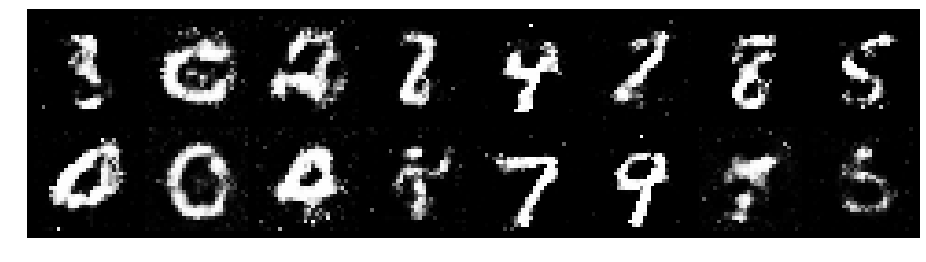

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.3503, Generator Loss: 1.1239
D(x): 0.5936, D(G(z)): 0.4253


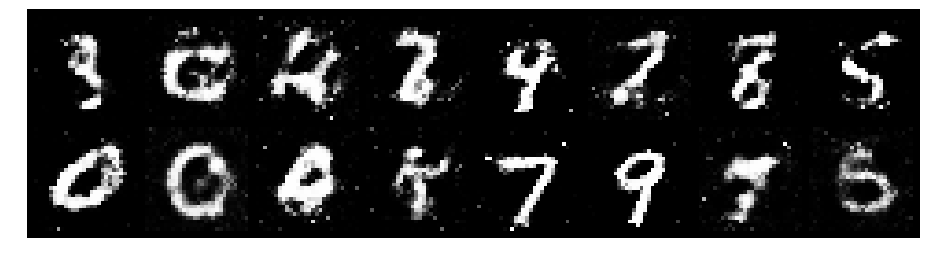

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.0143, Generator Loss: 1.2377
D(x): 0.6619, D(G(z)): 0.3297


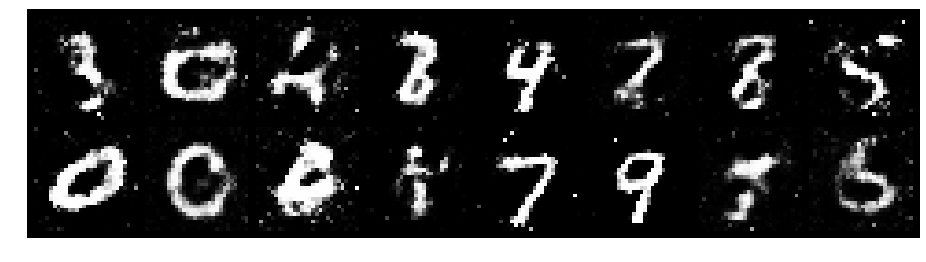

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.0772, Generator Loss: 1.4787
D(x): 0.6355, D(G(z)): 0.3408


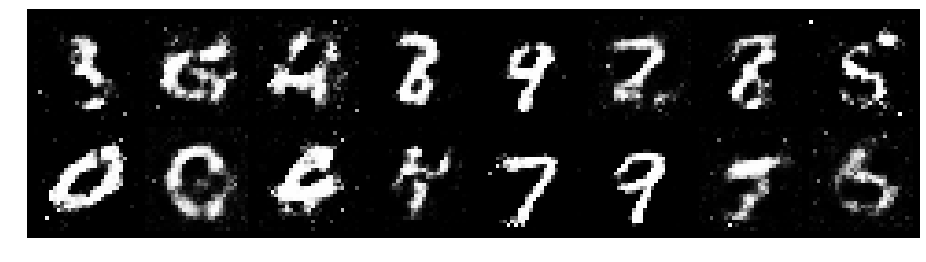

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1744, Generator Loss: 1.3654
D(x): 0.6457, D(G(z)): 0.3834


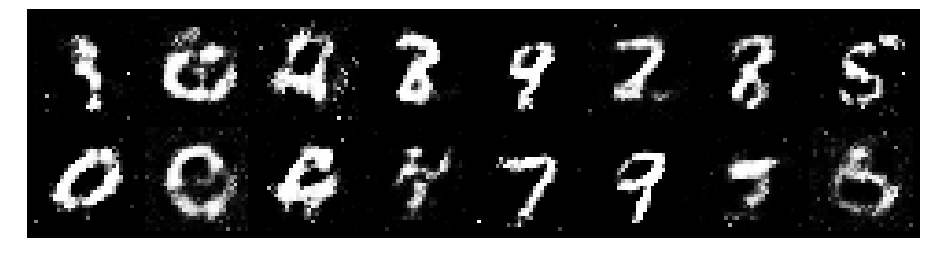

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.0685, Generator Loss: 1.0657
D(x): 0.6980, D(G(z)): 0.4135


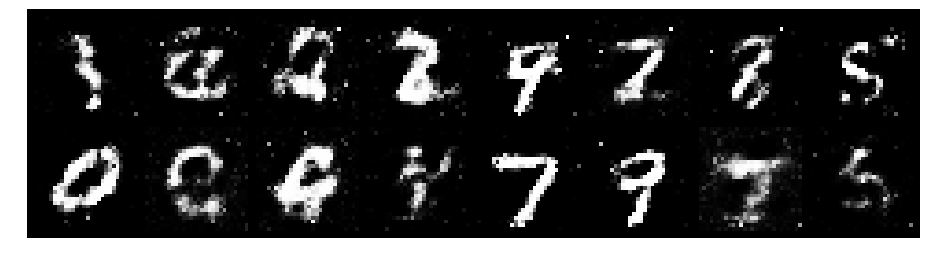

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.0617, Generator Loss: 1.2056
D(x): 0.6277, D(G(z)): 0.3684


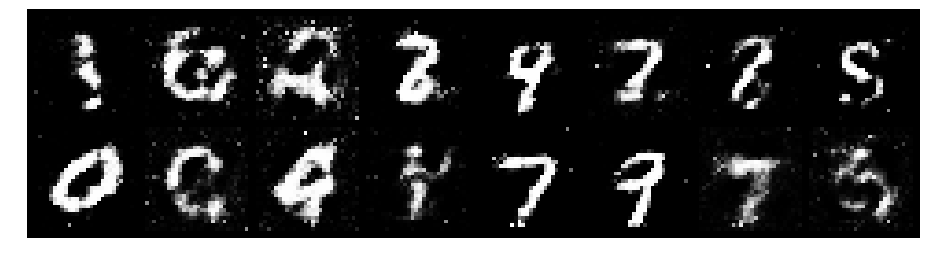

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.0775, Generator Loss: 1.2378
D(x): 0.6576, D(G(z)): 0.3868


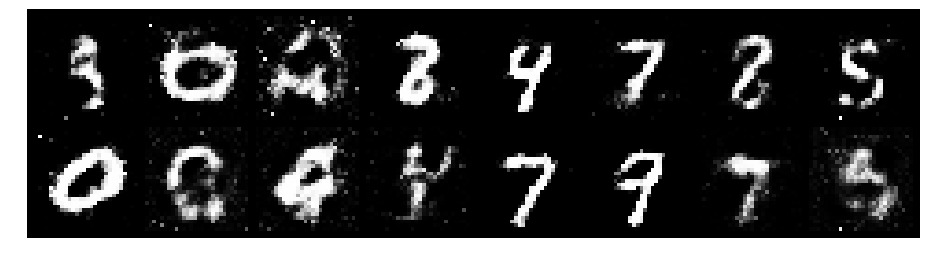

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.1796, Generator Loss: 1.0775
D(x): 0.6548, D(G(z)): 0.4221


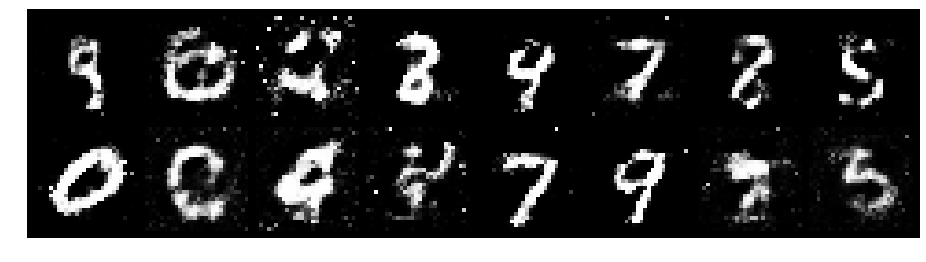

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.2941, Generator Loss: 0.8760
D(x): 0.5720, D(G(z)): 0.4550


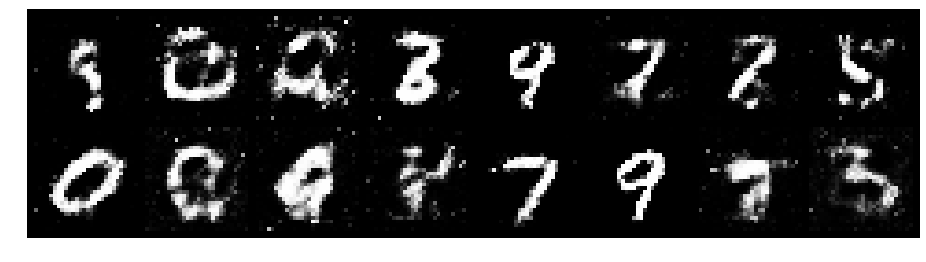

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.2061, Generator Loss: 1.2741
D(x): 0.6059, D(G(z)): 0.3844


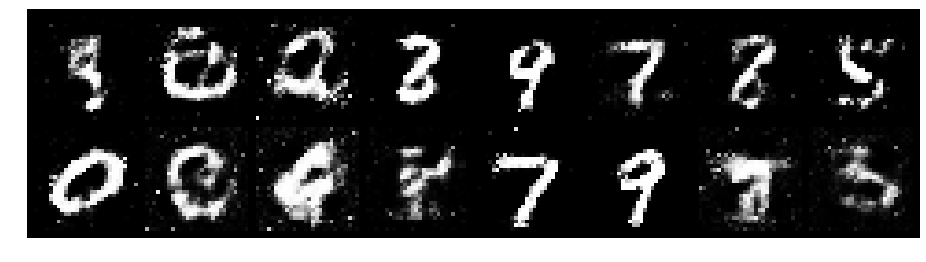

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.1179, Generator Loss: 1.0440
D(x): 0.6094, D(G(z)): 0.3678


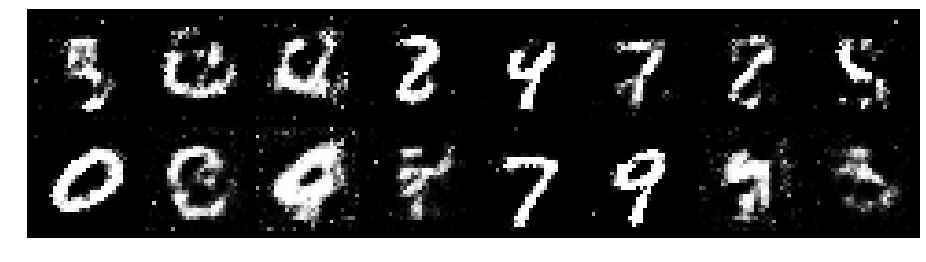

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0927, Generator Loss: 0.9573
D(x): 0.6774, D(G(z)): 0.4029


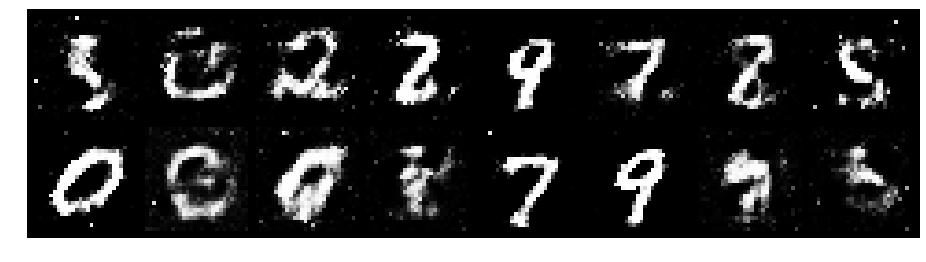

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.1017, Generator Loss: 1.3299
D(x): 0.6061, D(G(z)): 0.3417


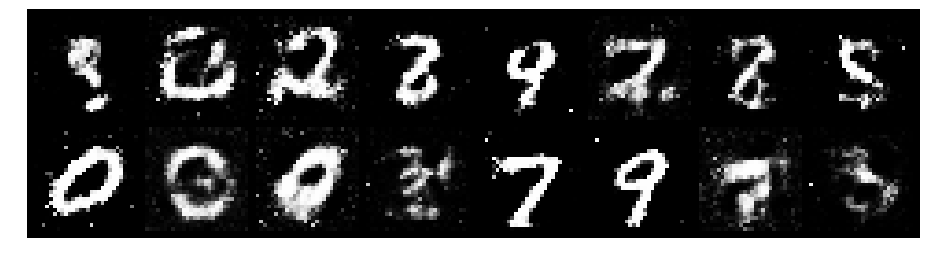

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 0.9900, Generator Loss: 1.4735
D(x): 0.6444, D(G(z)): 0.3067


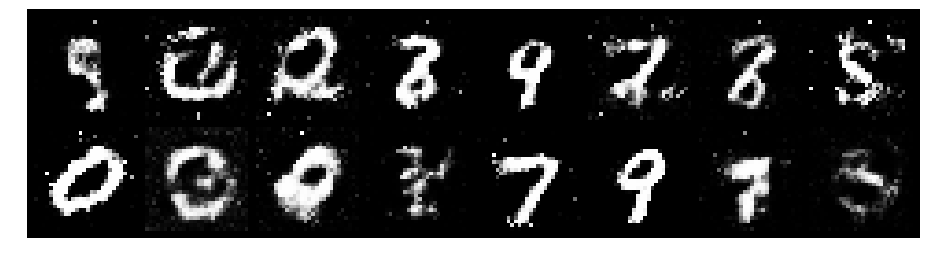

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.1396, Generator Loss: 1.4619
D(x): 0.5889, D(G(z)): 0.3379


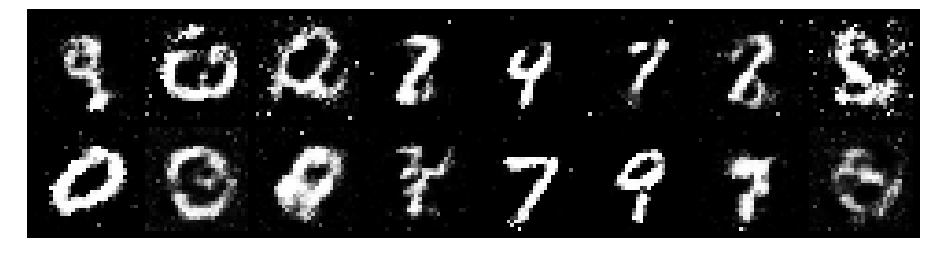

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1326, Generator Loss: 1.0386
D(x): 0.6278, D(G(z)): 0.4047


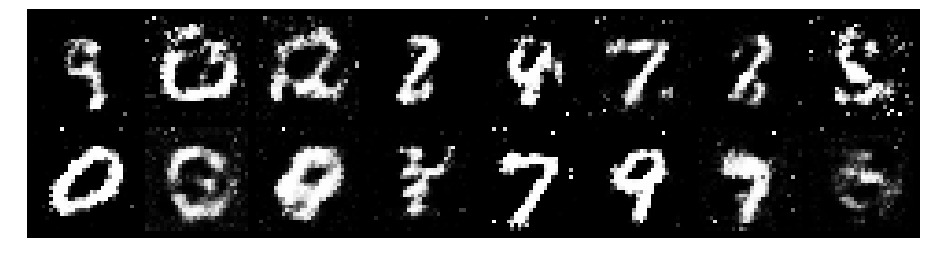

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 0.9323, Generator Loss: 1.1791
D(x): 0.7064, D(G(z)): 0.3709


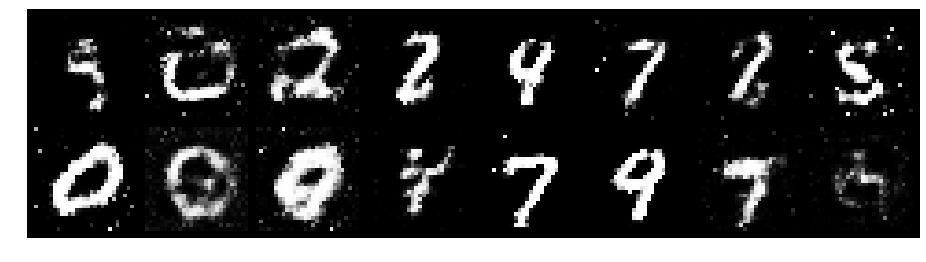

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 0.9021, Generator Loss: 1.7276
D(x): 0.6667, D(G(z)): 0.2835


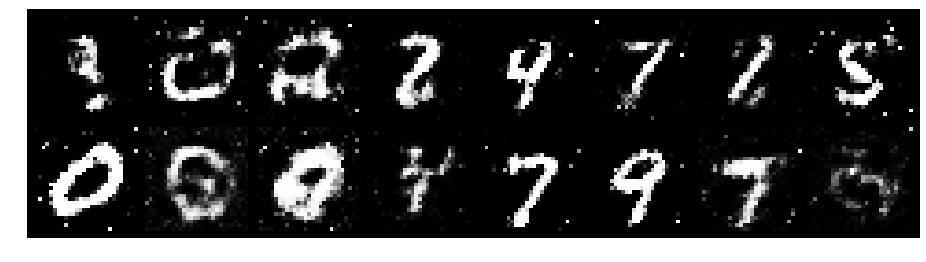

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 0.9969, Generator Loss: 1.3457
D(x): 0.6192, D(G(z)): 0.3209


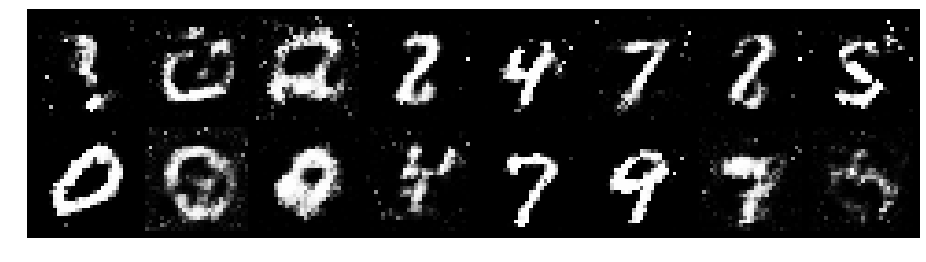

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.0424, Generator Loss: 1.5076
D(x): 0.6081, D(G(z)): 0.2850


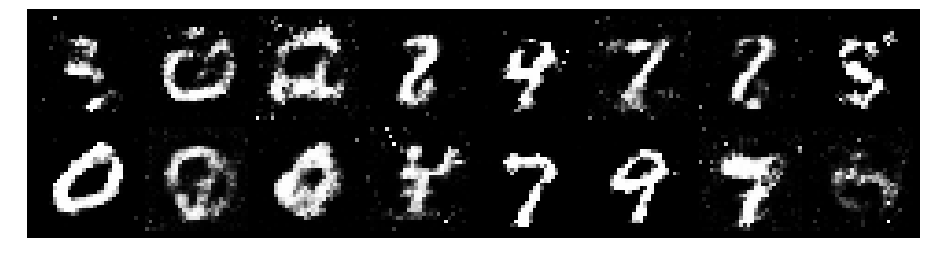

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.1986, Generator Loss: 1.4167
D(x): 0.6501, D(G(z)): 0.4195


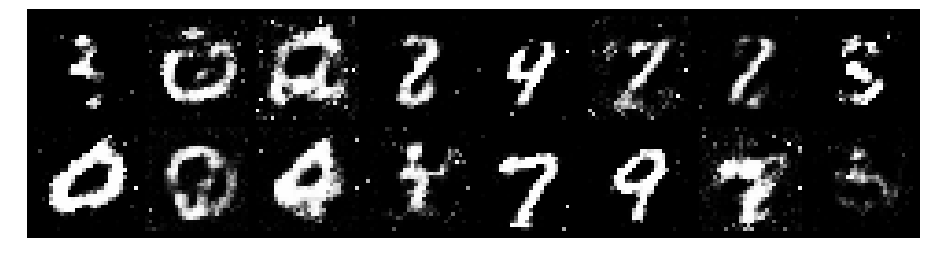

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.1198, Generator Loss: 0.9879
D(x): 0.6914, D(G(z)): 0.4419


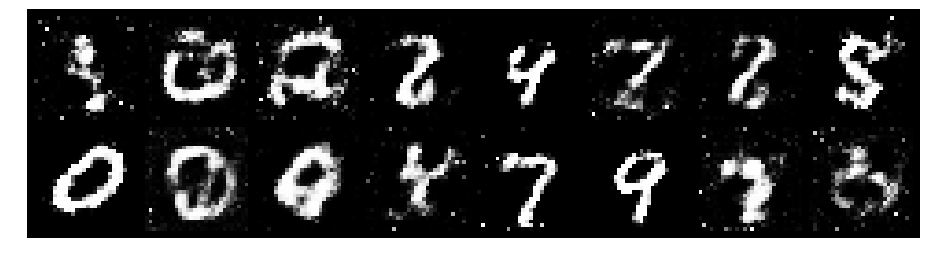

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.1498, Generator Loss: 0.8247
D(x): 0.6374, D(G(z)): 0.4103


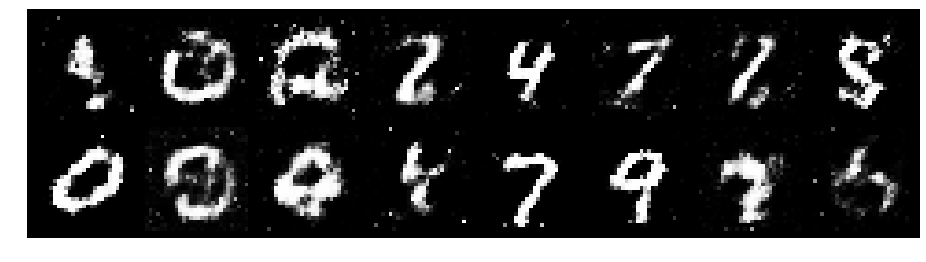

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.1196, Generator Loss: 1.1793
D(x): 0.5979, D(G(z)): 0.3814


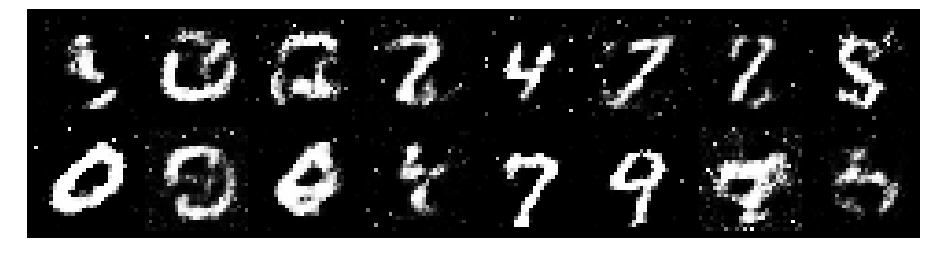

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.2519, Generator Loss: 1.1851
D(x): 0.5987, D(G(z)): 0.4186


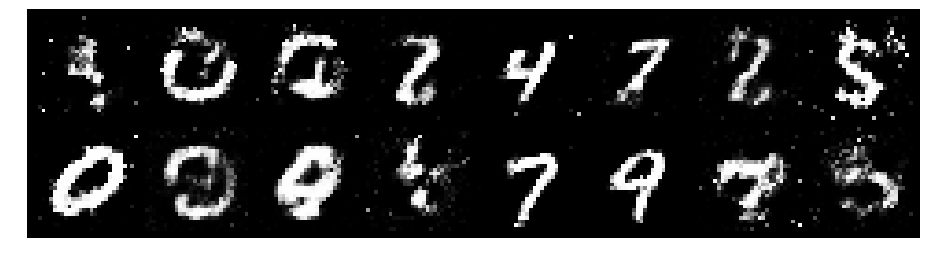

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.2444, Generator Loss: 0.9101
D(x): 0.6198, D(G(z)): 0.4565


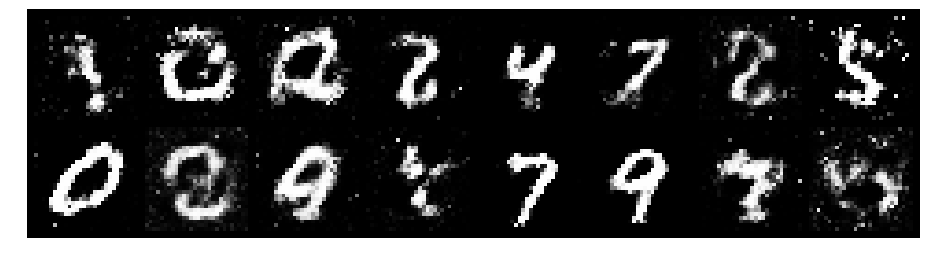

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.1200, Generator Loss: 1.2323
D(x): 0.5823, D(G(z)): 0.3532


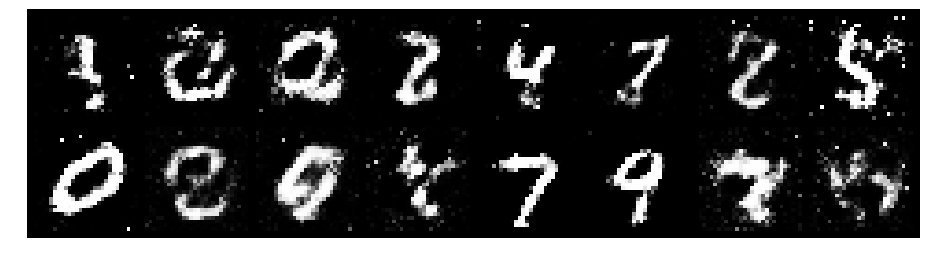

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.0869, Generator Loss: 1.5703
D(x): 0.6347, D(G(z)): 0.3474


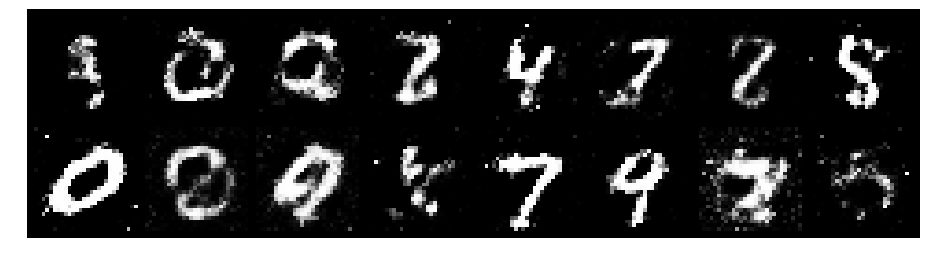

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 0.9904, Generator Loss: 1.1182
D(x): 0.6552, D(G(z)): 0.3545


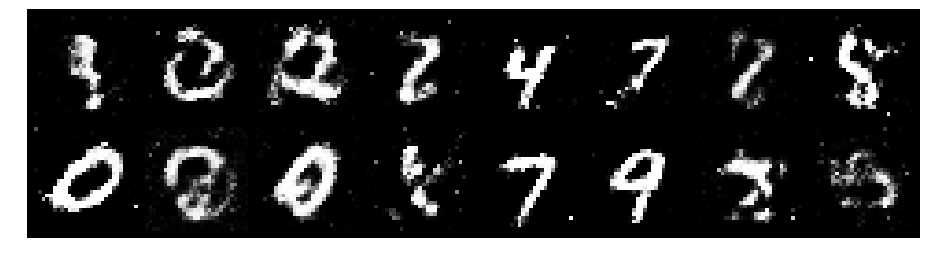

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.0139, Generator Loss: 1.2120
D(x): 0.6785, D(G(z)): 0.3642


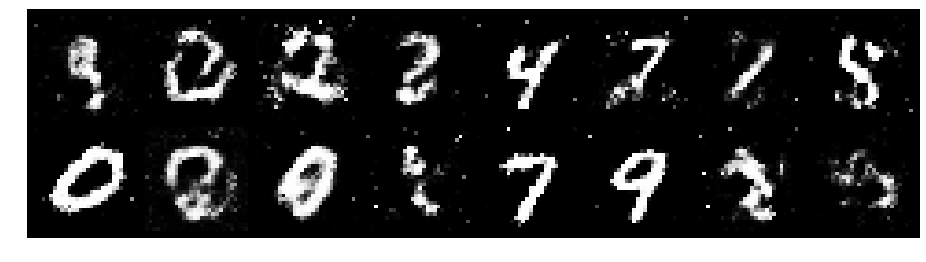

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 0.9526, Generator Loss: 1.1614
D(x): 0.6652, D(G(z)): 0.3495


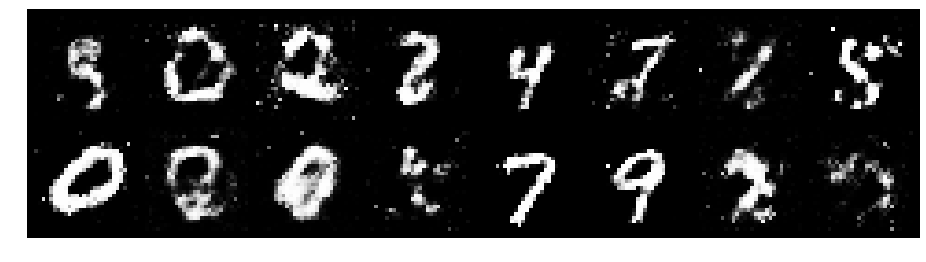

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 0.9298, Generator Loss: 1.4547
D(x): 0.6599, D(G(z)): 0.2960


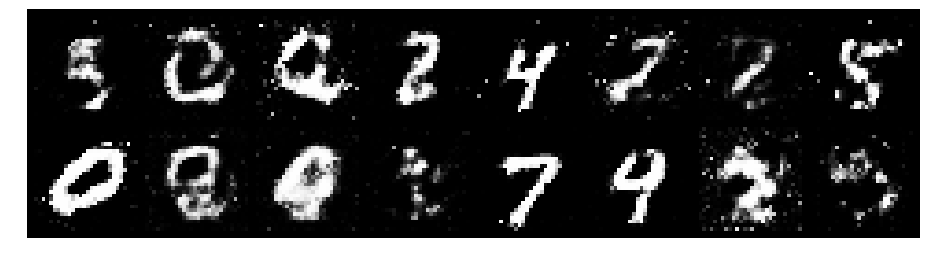

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 0.9126, Generator Loss: 1.4273
D(x): 0.7266, D(G(z)): 0.3506


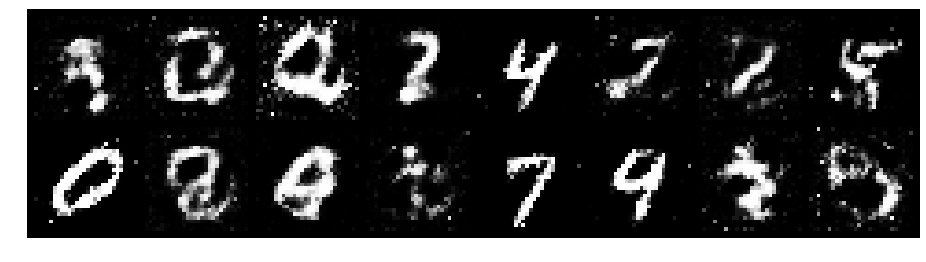

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.0650, Generator Loss: 1.0256
D(x): 0.6666, D(G(z)): 0.4149


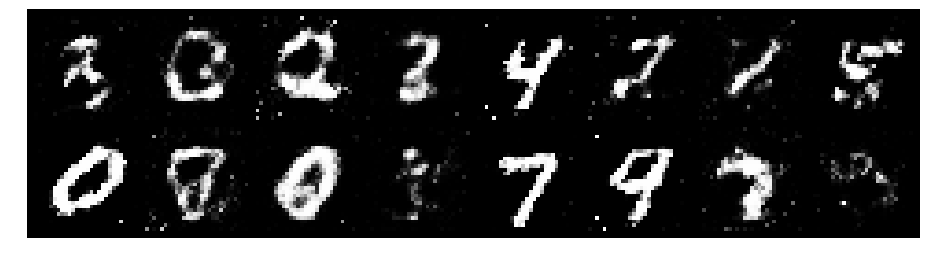

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.0960, Generator Loss: 1.1101
D(x): 0.5914, D(G(z)): 0.3570


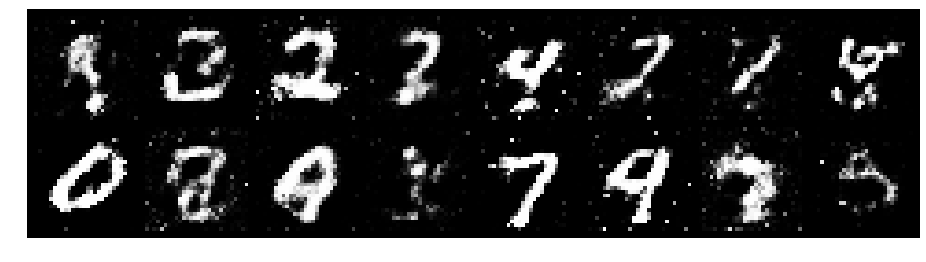

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1207, Generator Loss: 1.1499
D(x): 0.5900, D(G(z)): 0.3716


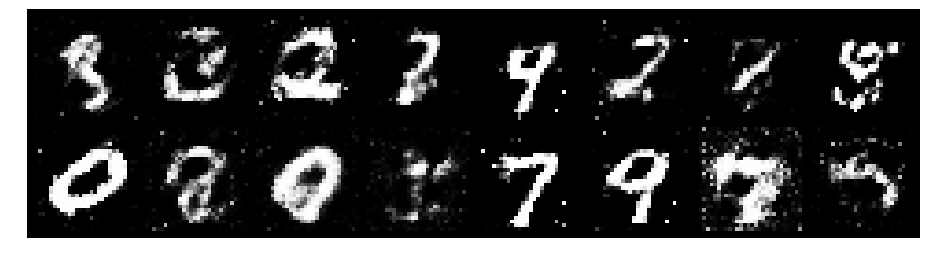

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.2037, Generator Loss: 1.0557
D(x): 0.6291, D(G(z)): 0.4314


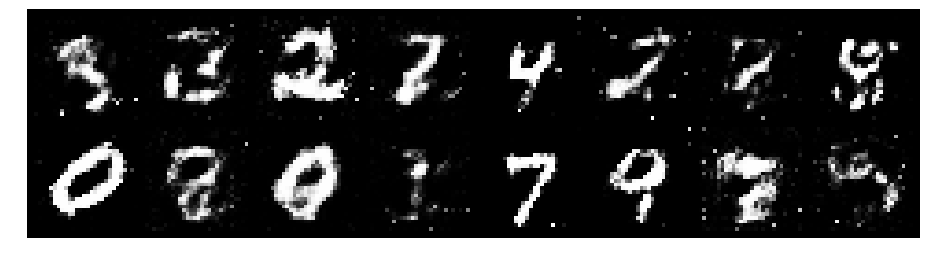

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 0.9290, Generator Loss: 1.2778
D(x): 0.6519, D(G(z)): 0.3238


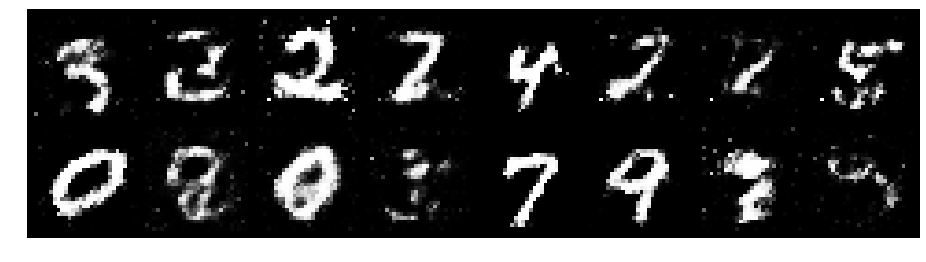

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.1702, Generator Loss: 1.1951
D(x): 0.7153, D(G(z)): 0.4754


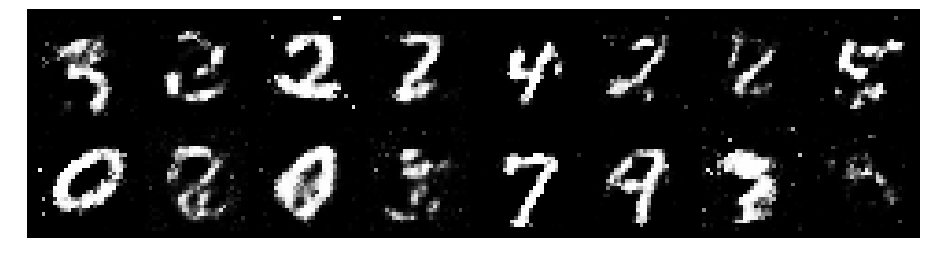

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.1324, Generator Loss: 1.1688
D(x): 0.6504, D(G(z)): 0.4034


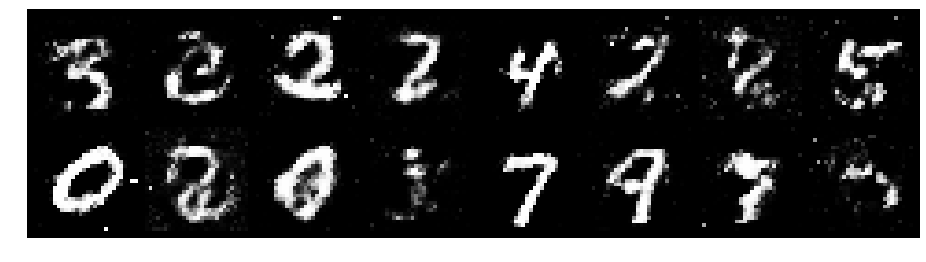

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.2810, Generator Loss: 1.0943
D(x): 0.5655, D(G(z)): 0.4170


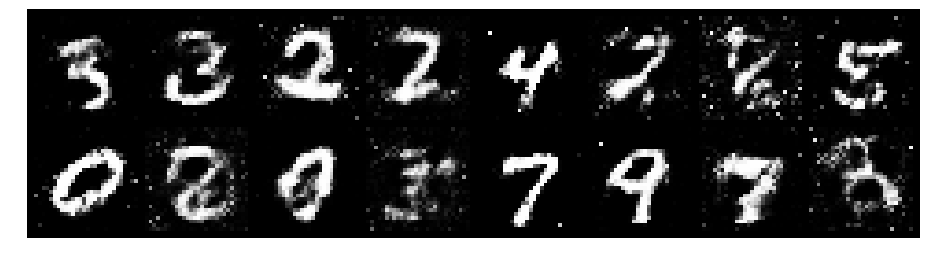

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 0.9945, Generator Loss: 1.2467
D(x): 0.6245, D(G(z)): 0.3108


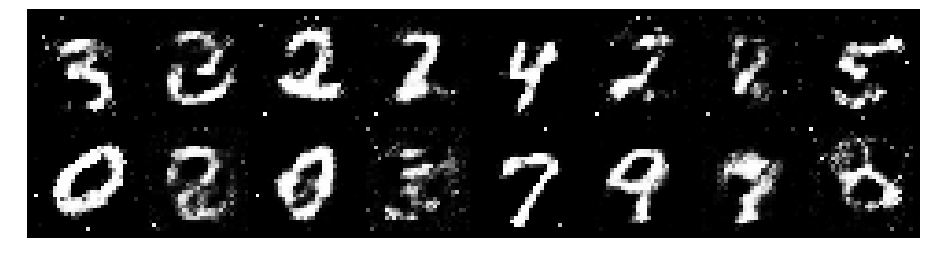

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 0.9480, Generator Loss: 1.4221
D(x): 0.6870, D(G(z)): 0.3474


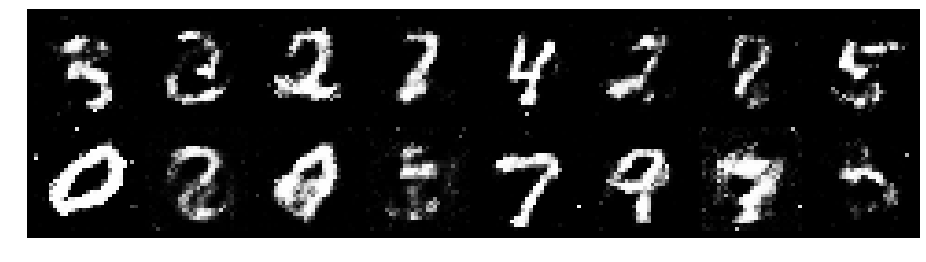

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0358, Generator Loss: 1.2407
D(x): 0.6309, D(G(z)): 0.3454


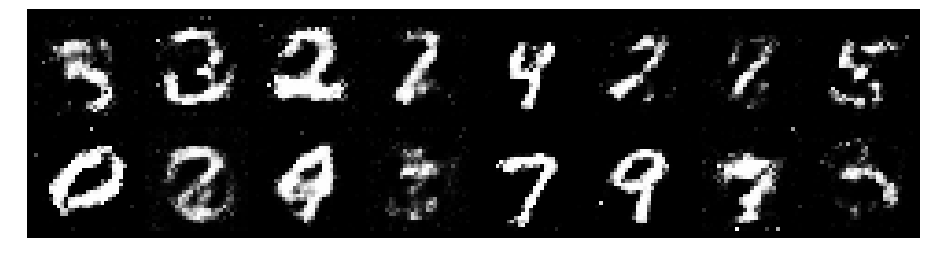

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.0914, Generator Loss: 0.9938
D(x): 0.6039, D(G(z)): 0.3940


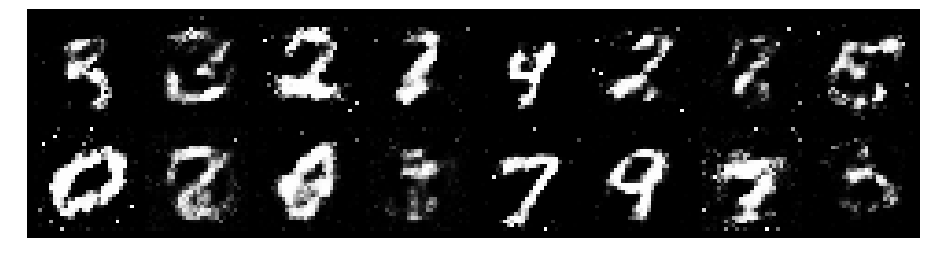

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1247, Generator Loss: 1.0065
D(x): 0.6149, D(G(z)): 0.4070


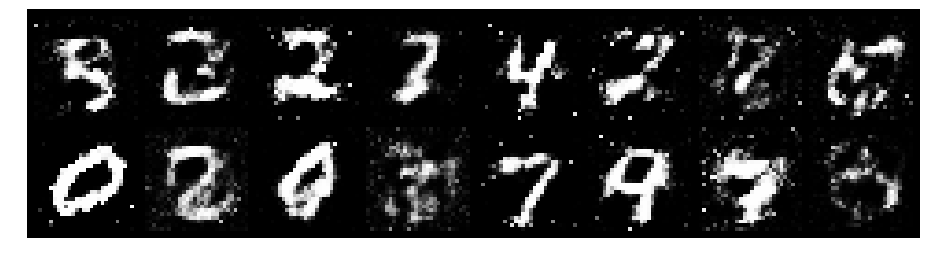

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.2207, Generator Loss: 1.1268
D(x): 0.5761, D(G(z)): 0.4203


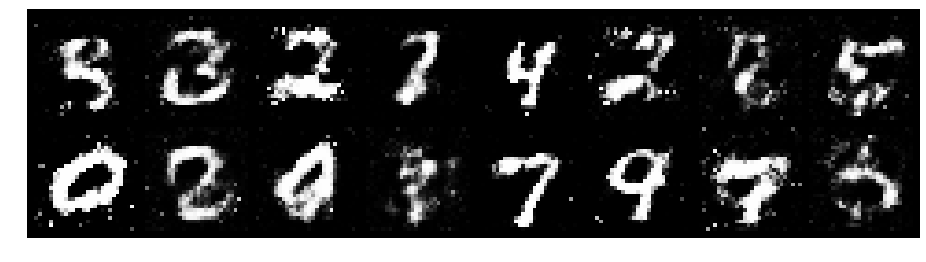

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.2939, Generator Loss: 0.9169
D(x): 0.5555, D(G(z)): 0.3985


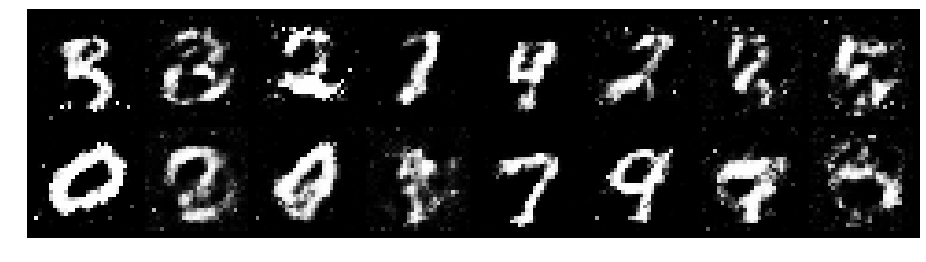

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.2216, Generator Loss: 1.2636
D(x): 0.6130, D(G(z)): 0.4012


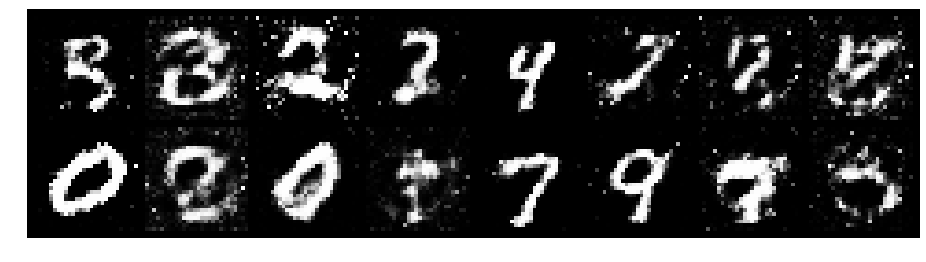

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.1901, Generator Loss: 1.1424
D(x): 0.6313, D(G(z)): 0.4270


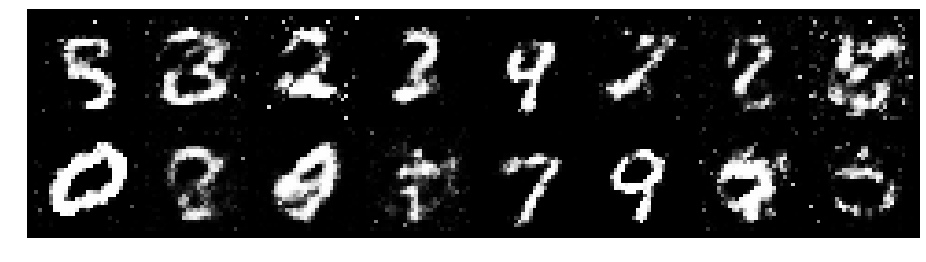

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 0.9748, Generator Loss: 1.5978
D(x): 0.6688, D(G(z)): 0.3142


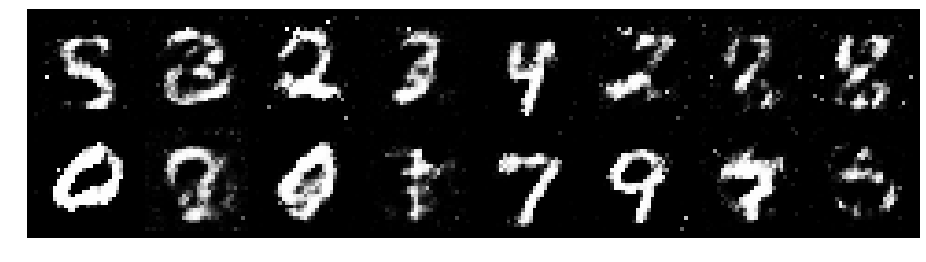

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 0.8434, Generator Loss: 1.3706
D(x): 0.7276, D(G(z)): 0.3170


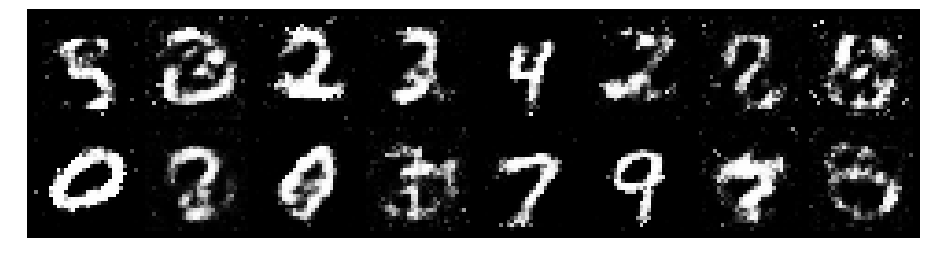

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.0204, Generator Loss: 1.2872
D(x): 0.6804, D(G(z)): 0.3781


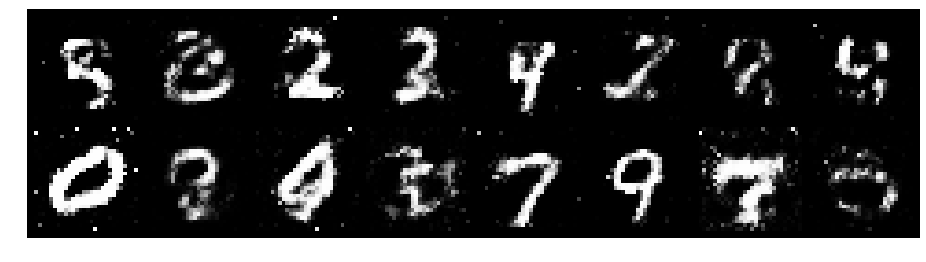

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.0314, Generator Loss: 1.2155
D(x): 0.6446, D(G(z)): 0.3431


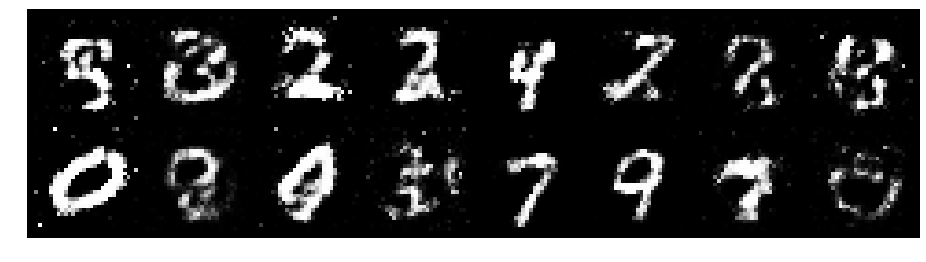

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.0275, Generator Loss: 1.2804
D(x): 0.6402, D(G(z)): 0.3278


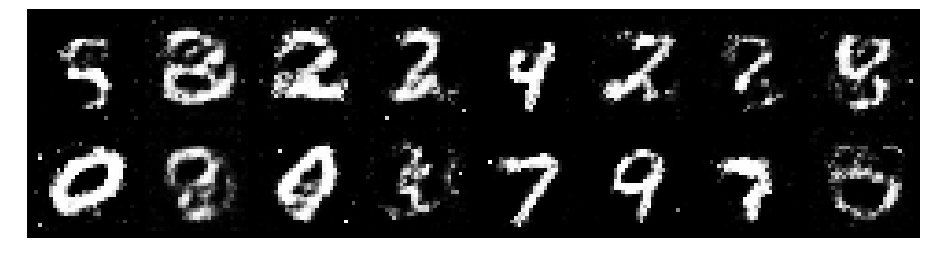

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.1852, Generator Loss: 0.9441
D(x): 0.6453, D(G(z)): 0.4310


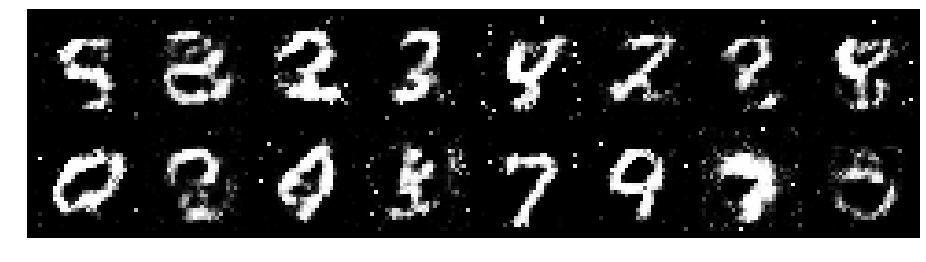

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.2009, Generator Loss: 1.0255
D(x): 0.6051, D(G(z)): 0.4194


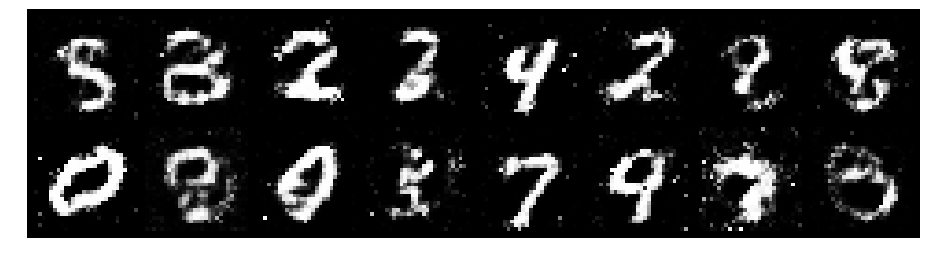

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.2701, Generator Loss: 1.1939
D(x): 0.6431, D(G(z)): 0.4422


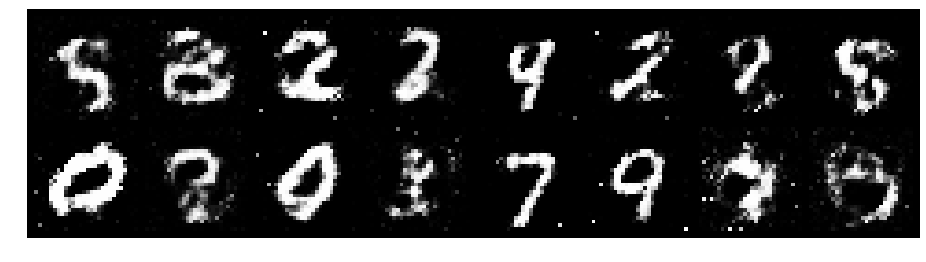

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.1159, Generator Loss: 1.1470
D(x): 0.6414, D(G(z)): 0.3864


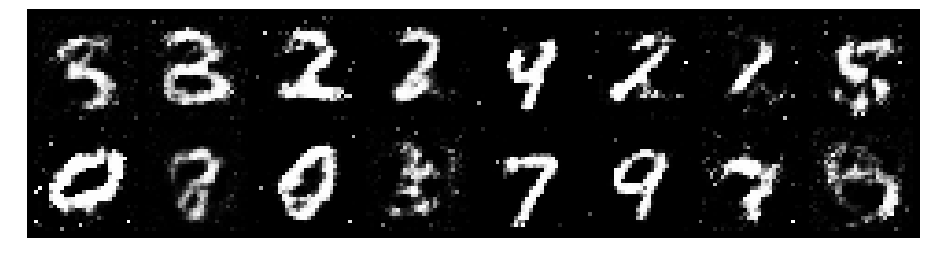

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1288, Generator Loss: 1.3268
D(x): 0.6783, D(G(z)): 0.4203


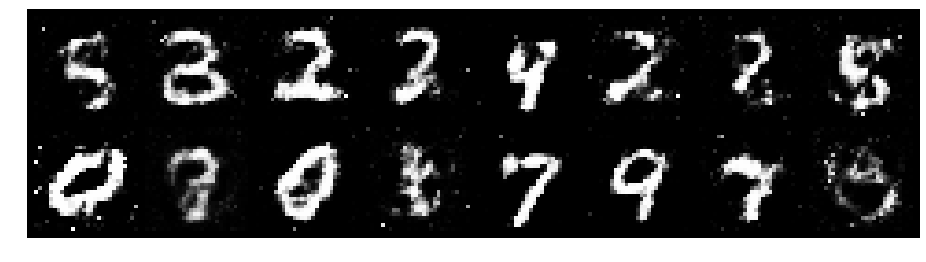

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.1882, Generator Loss: 1.1515
D(x): 0.6430, D(G(z)): 0.3916


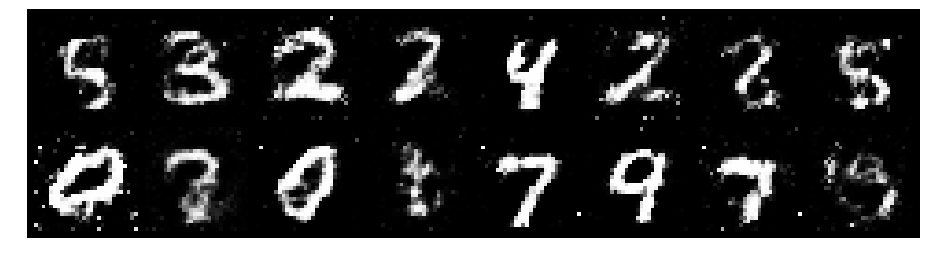

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1053, Generator Loss: 0.9663
D(x): 0.6293, D(G(z)): 0.3980


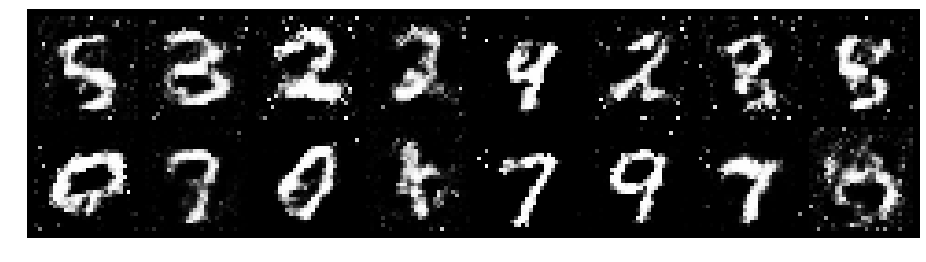

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.1478, Generator Loss: 1.1028
D(x): 0.6155, D(G(z)): 0.4061


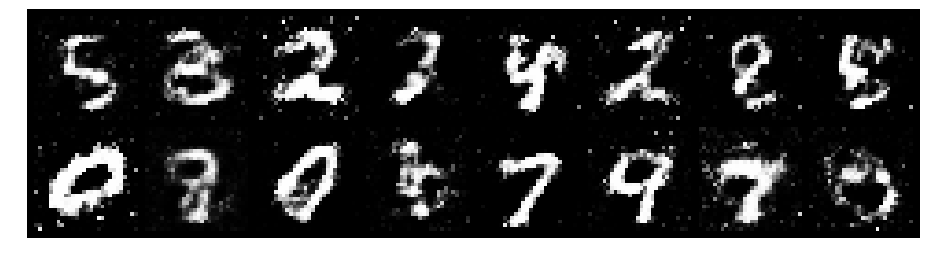

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.1333, Generator Loss: 1.0205
D(x): 0.5703, D(G(z)): 0.3777


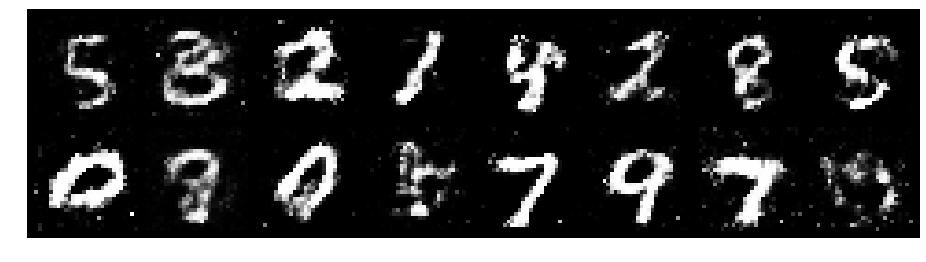

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.1779, Generator Loss: 0.8985
D(x): 0.6452, D(G(z)): 0.4437


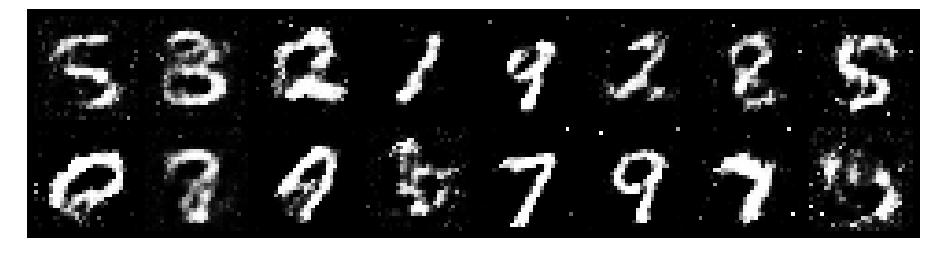

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.1723, Generator Loss: 1.0205
D(x): 0.6403, D(G(z)): 0.4053


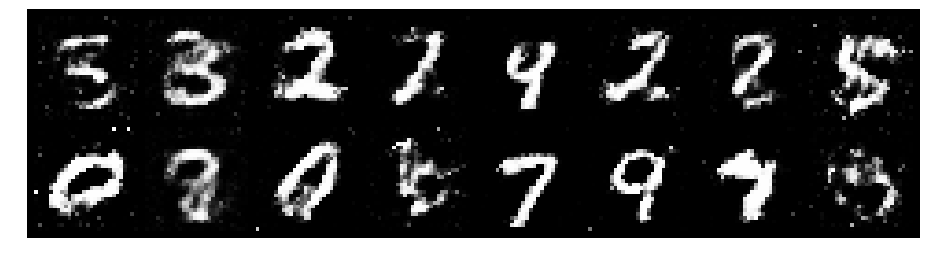

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.2255, Generator Loss: 1.3298
D(x): 0.6281, D(G(z)): 0.4179


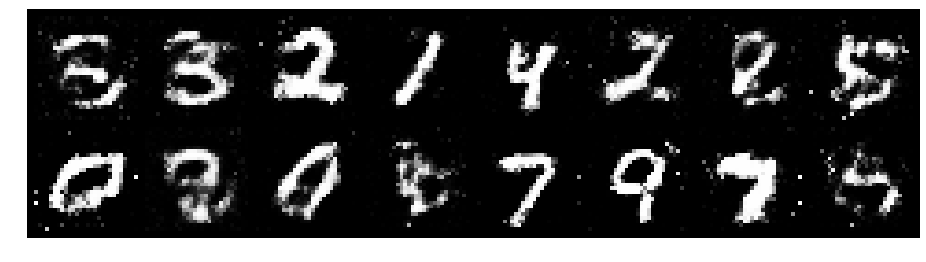

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.1517, Generator Loss: 1.0802
D(x): 0.5994, D(G(z)): 0.3918


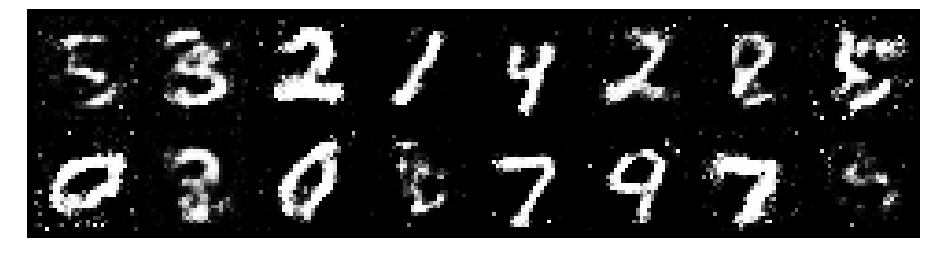

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1646, Generator Loss: 1.0343
D(x): 0.5652, D(G(z)): 0.3776


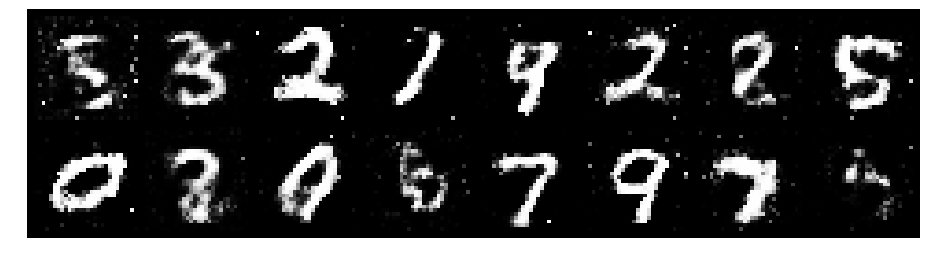

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1828, Generator Loss: 0.9969
D(x): 0.5841, D(G(z)): 0.3932


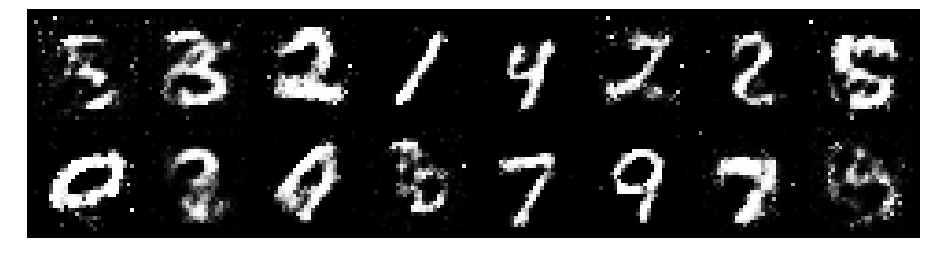

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.2339, Generator Loss: 0.9167
D(x): 0.5753, D(G(z)): 0.4230


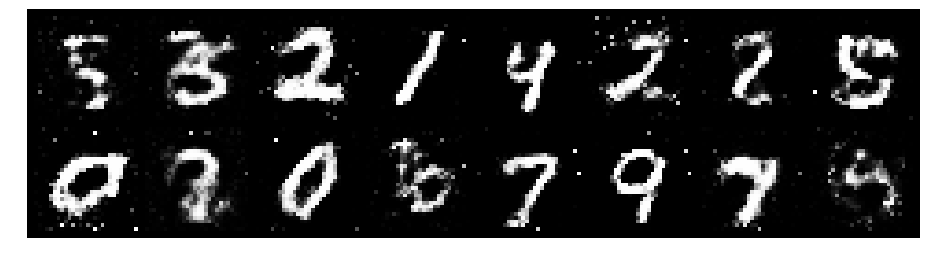

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1998, Generator Loss: 1.1572
D(x): 0.6419, D(G(z)): 0.4264


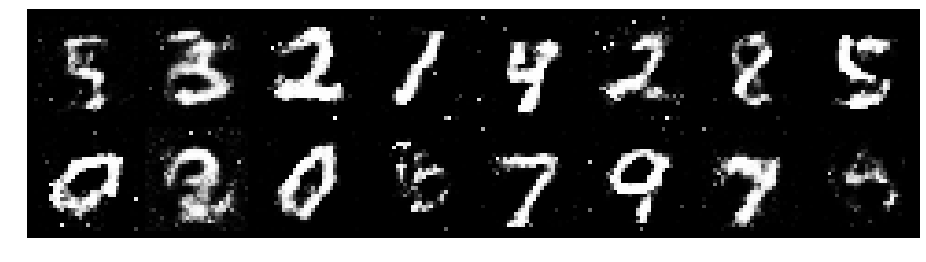

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 0.9512, Generator Loss: 1.0603
D(x): 0.6569, D(G(z)): 0.3611


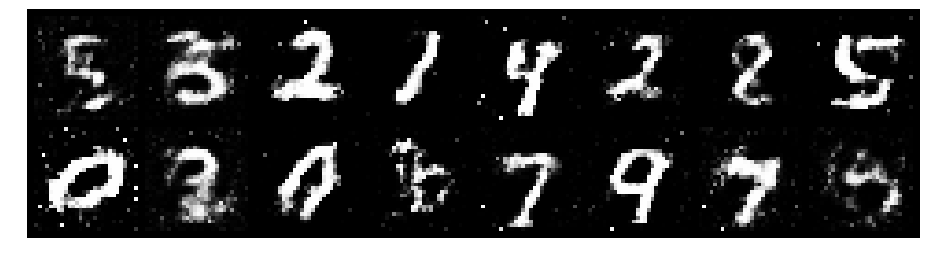

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 0.8942, Generator Loss: 1.2179
D(x): 0.7266, D(G(z)): 0.3620


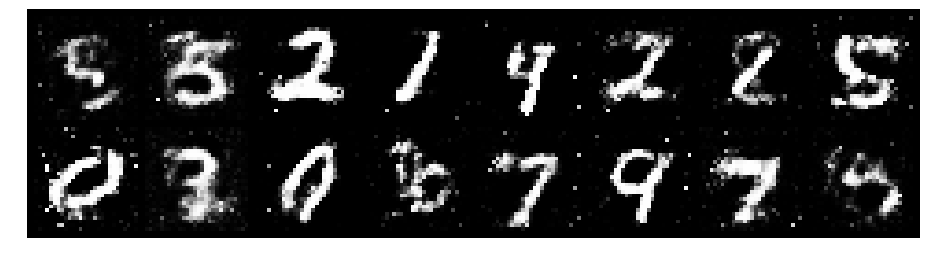

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.0218, Generator Loss: 1.5560
D(x): 0.6354, D(G(z)): 0.3183


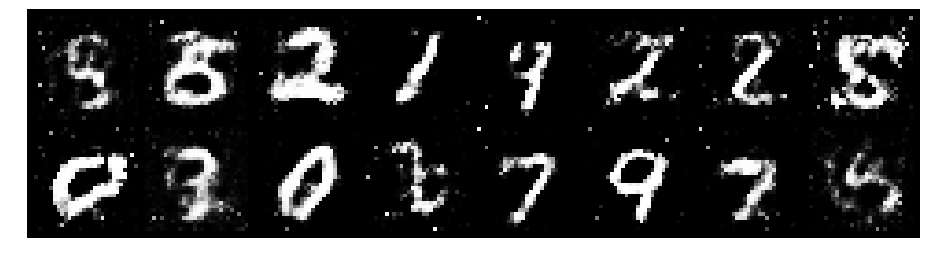

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1822, Generator Loss: 1.0729
D(x): 0.6265, D(G(z)): 0.4319


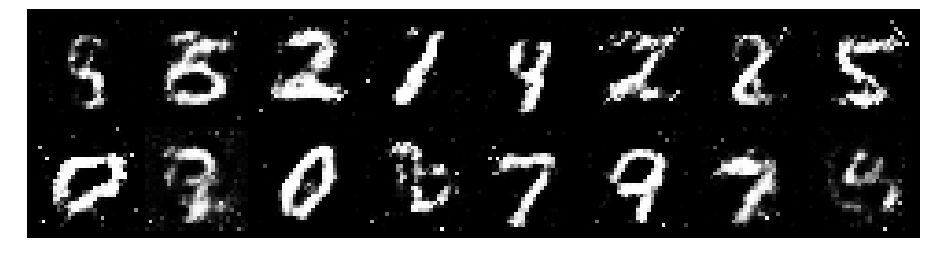

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0178, Generator Loss: 1.0545
D(x): 0.6373, D(G(z)): 0.3708


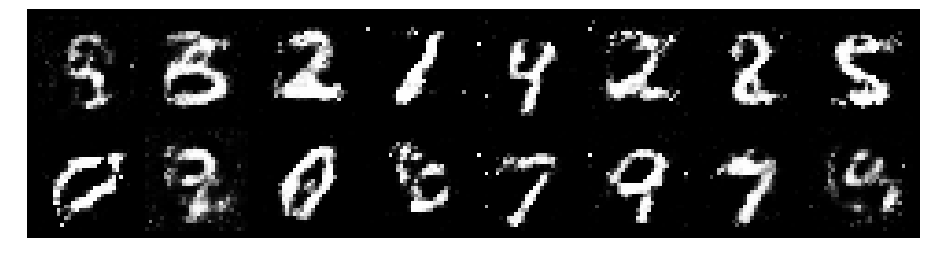

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1520, Generator Loss: 1.0336
D(x): 0.6341, D(G(z)): 0.4335


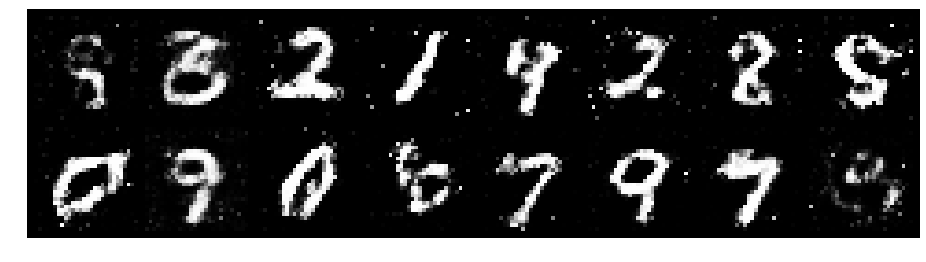

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.1716, Generator Loss: 1.0458
D(x): 0.6069, D(G(z)): 0.4408


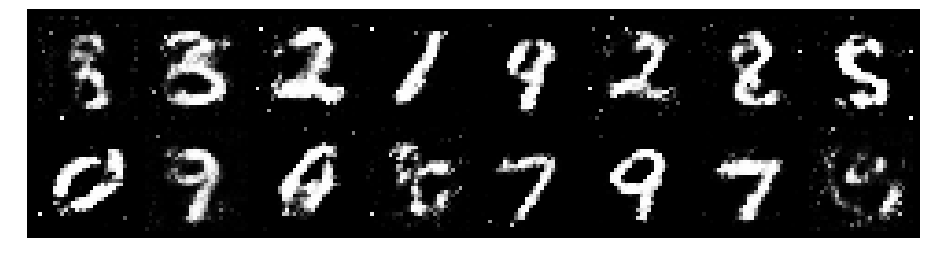

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.0896, Generator Loss: 1.2783
D(x): 0.6215, D(G(z)): 0.3553


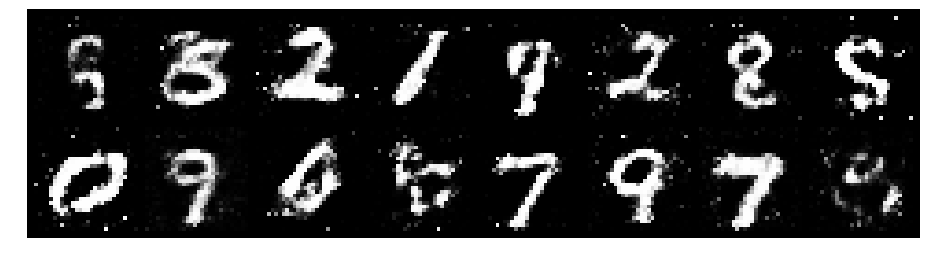

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.0461, Generator Loss: 1.1517
D(x): 0.6509, D(G(z)): 0.3802


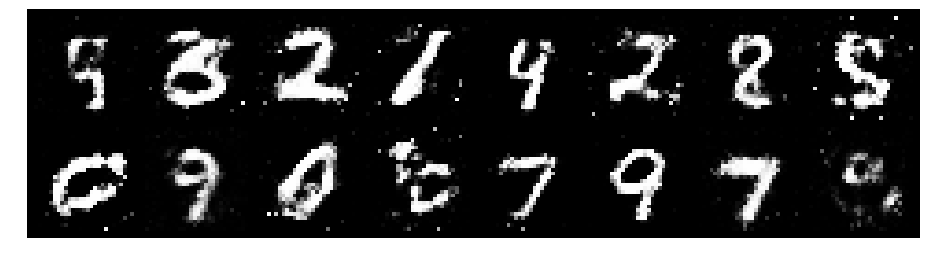

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.2016, Generator Loss: 1.2848
D(x): 0.5736, D(G(z)): 0.3654


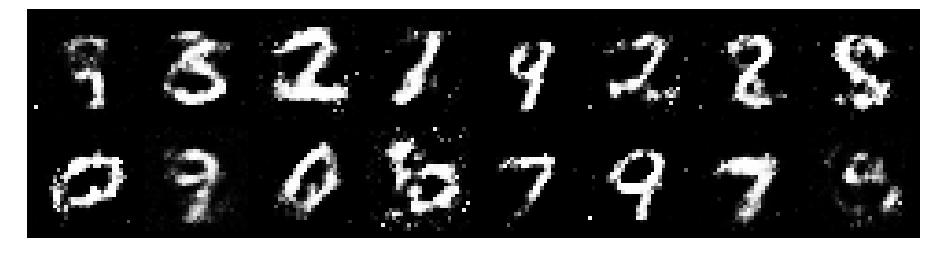

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.0710, Generator Loss: 1.1403
D(x): 0.5709, D(G(z)): 0.3399


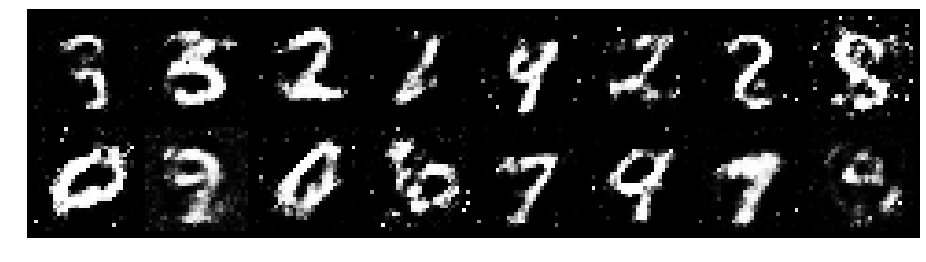

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1028, Generator Loss: 1.1966
D(x): 0.6223, D(G(z)): 0.3923


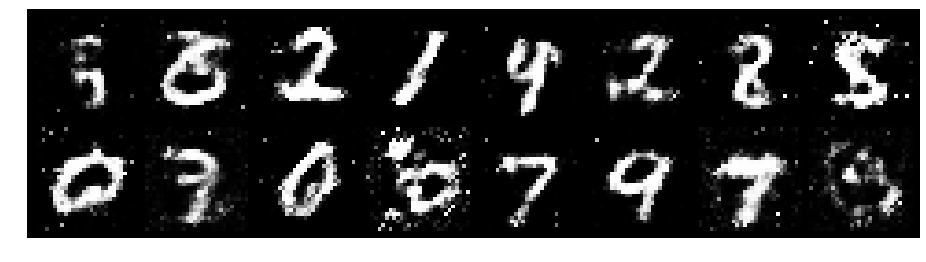

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.0031, Generator Loss: 1.0317
D(x): 0.6509, D(G(z)): 0.3664


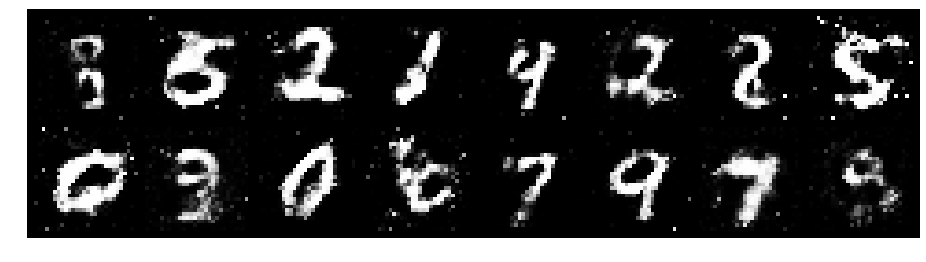

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1146, Generator Loss: 0.8745
D(x): 0.6138, D(G(z)): 0.4175


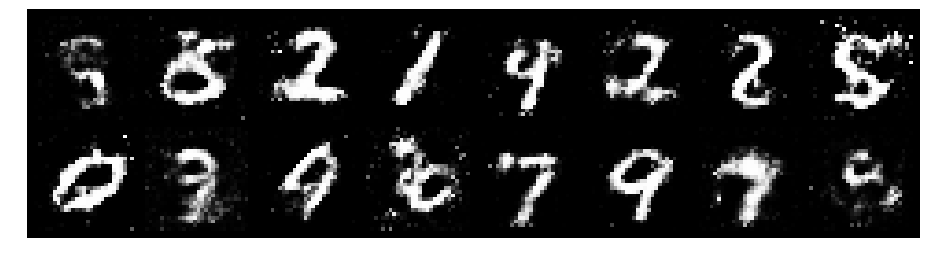

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.0814, Generator Loss: 1.0546
D(x): 0.6372, D(G(z)): 0.4212


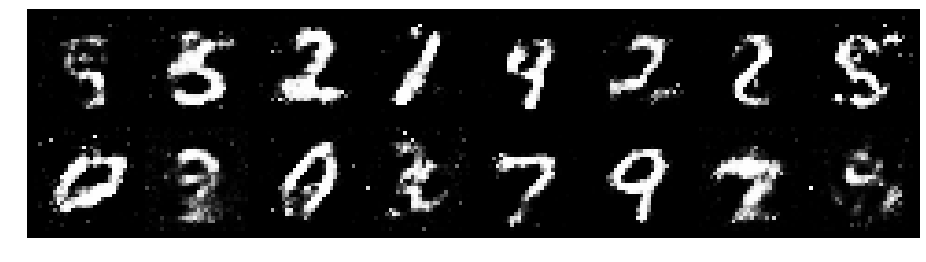

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1243, Generator Loss: 1.1798
D(x): 0.5782, D(G(z)): 0.3686


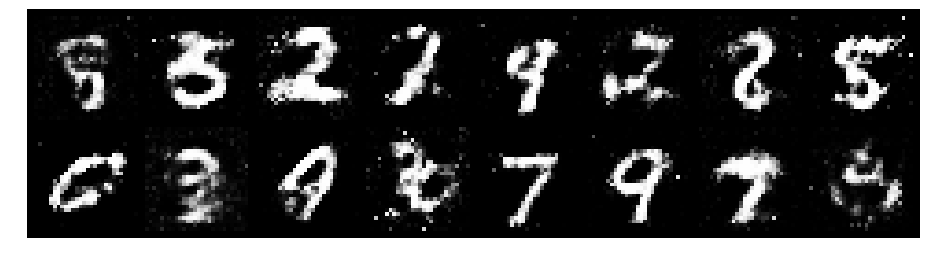

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.1141, Generator Loss: 1.1934
D(x): 0.5967, D(G(z)): 0.3422


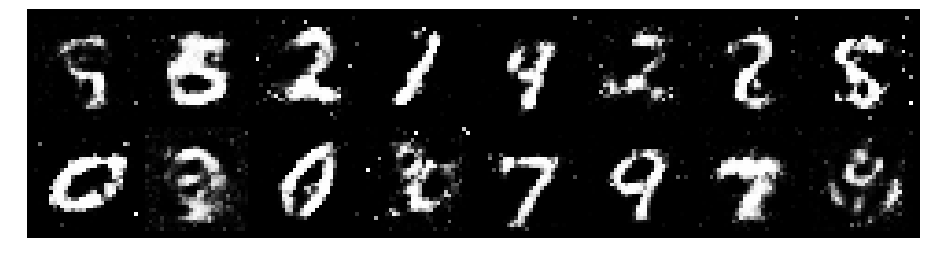

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.0365, Generator Loss: 1.1800
D(x): 0.6415, D(G(z)): 0.3593


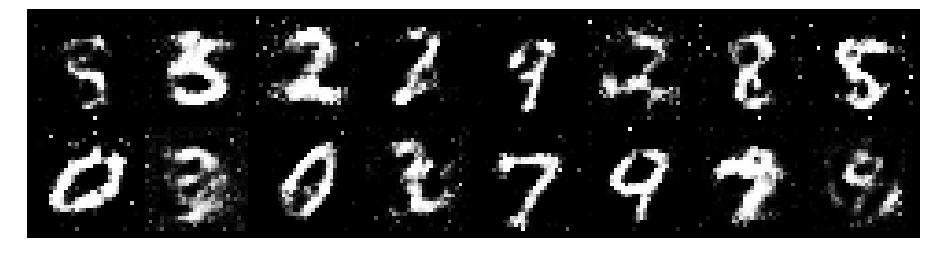

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.1348, Generator Loss: 1.1926
D(x): 0.6208, D(G(z)): 0.3928


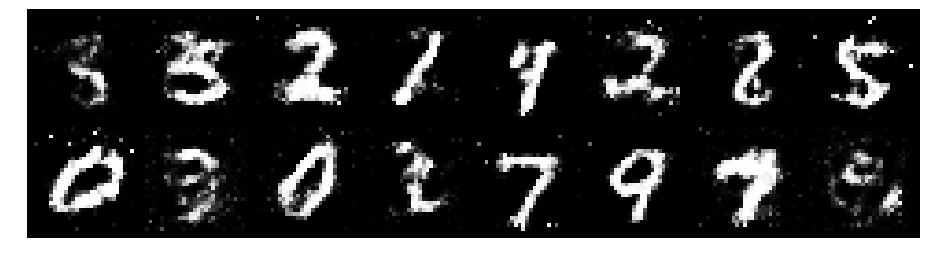

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.1731, Generator Loss: 1.0032
D(x): 0.6180, D(G(z)): 0.4235


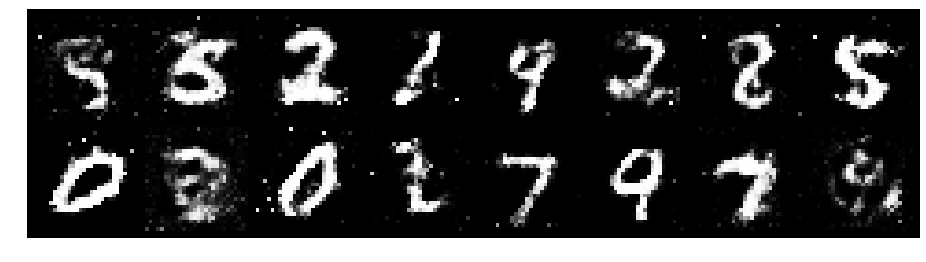

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.0583, Generator Loss: 1.0080
D(x): 0.6213, D(G(z)): 0.3809


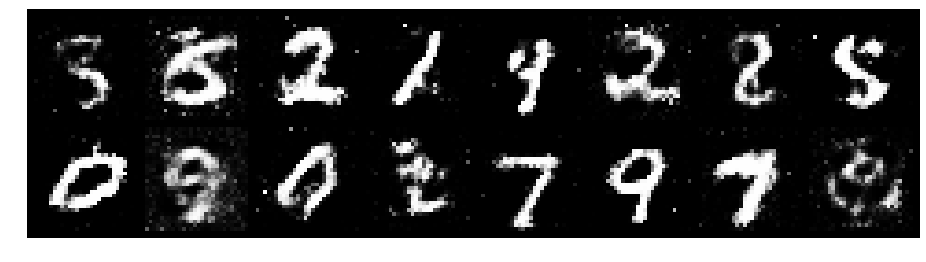

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1079, Generator Loss: 1.0489
D(x): 0.6051, D(G(z)): 0.3895


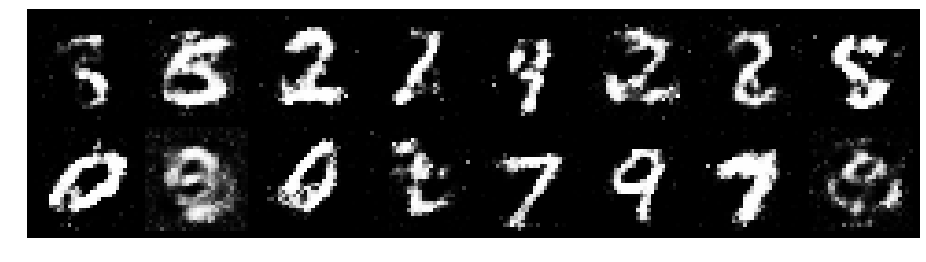

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.0316, Generator Loss: 1.0541
D(x): 0.6485, D(G(z)): 0.3744


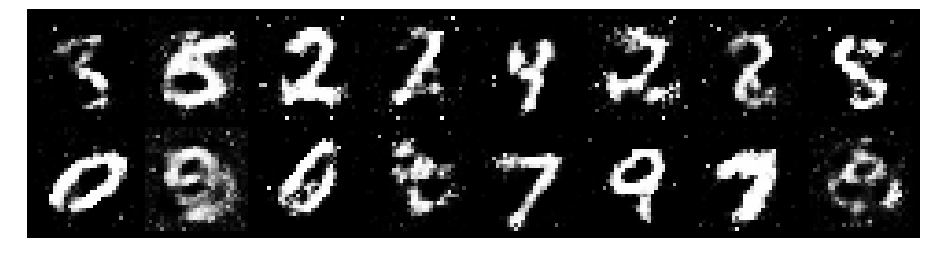

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1662, Generator Loss: 0.9942
D(x): 0.6372, D(G(z)): 0.4524


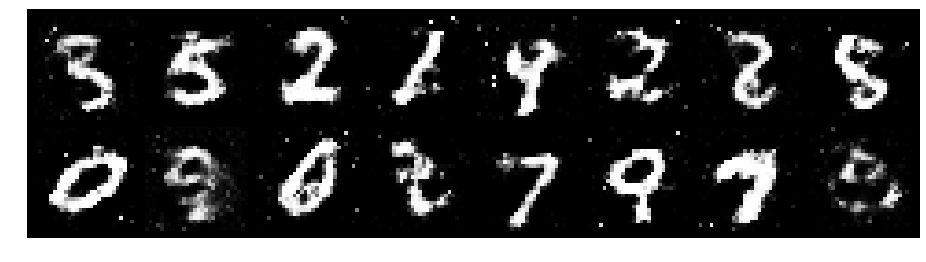

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1621, Generator Loss: 1.0536
D(x): 0.5835, D(G(z)): 0.4017


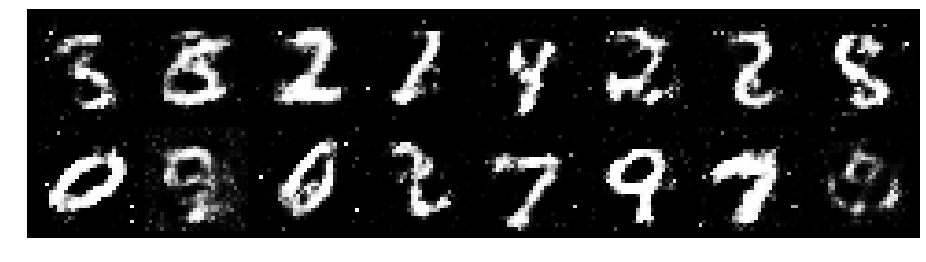

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.2221, Generator Loss: 0.8499
D(x): 0.6365, D(G(z)): 0.4713


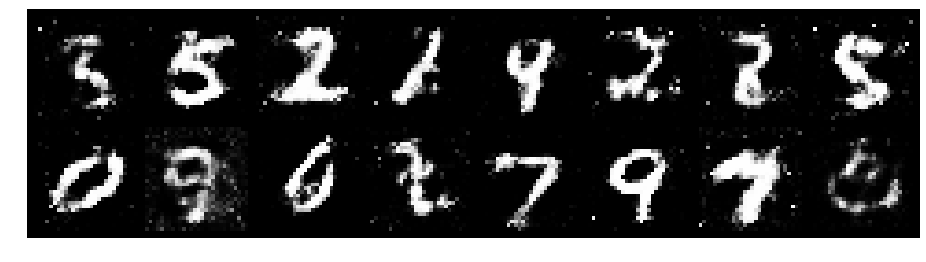

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.0986, Generator Loss: 0.8980
D(x): 0.6967, D(G(z)): 0.4631


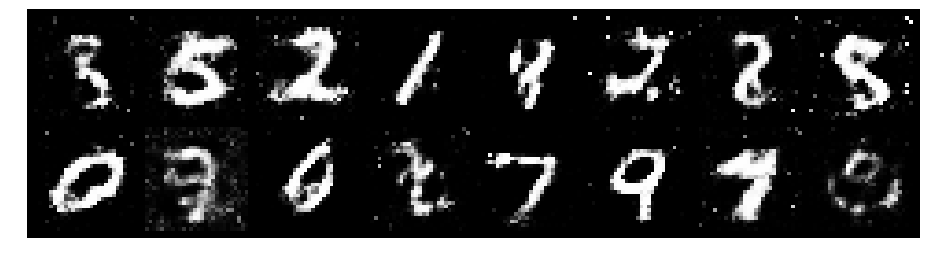

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.2017, Generator Loss: 1.0181
D(x): 0.6088, D(G(z)): 0.4388


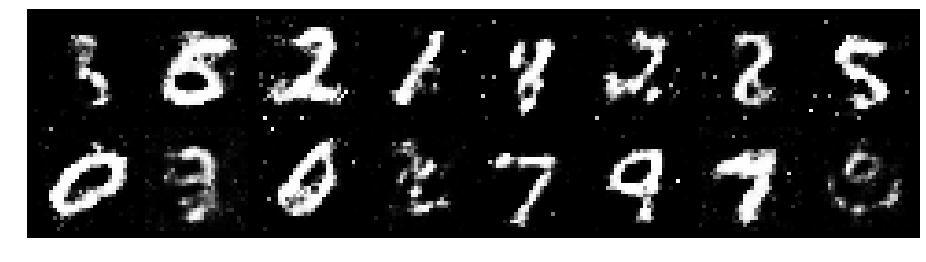

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1237, Generator Loss: 1.0770
D(x): 0.6419, D(G(z)): 0.4113


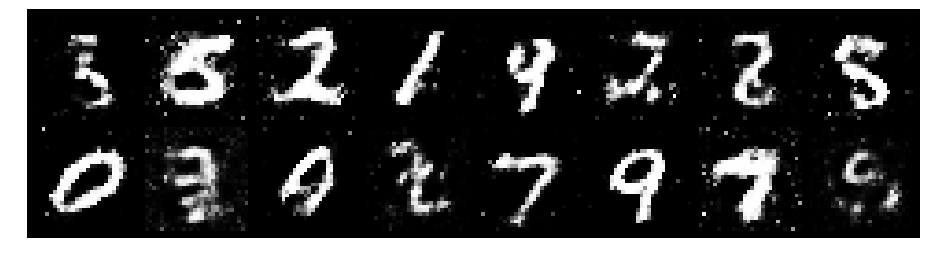

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.1670, Generator Loss: 1.1775
D(x): 0.6482, D(G(z)): 0.4172


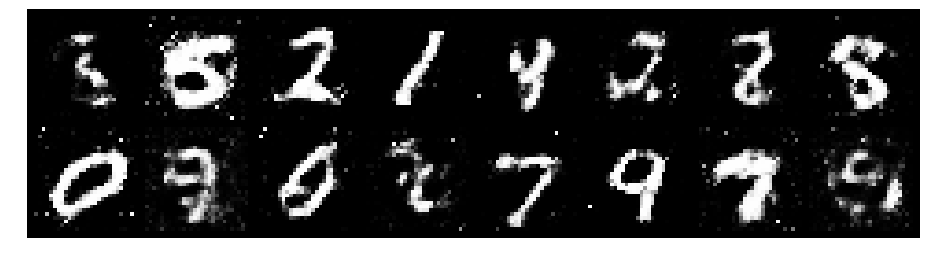

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1424, Generator Loss: 1.1184
D(x): 0.5762, D(G(z)): 0.3657


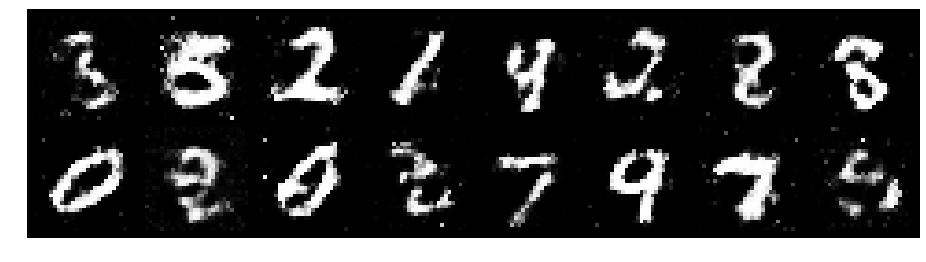

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2972, Generator Loss: 1.0503
D(x): 0.5277, D(G(z)): 0.3748


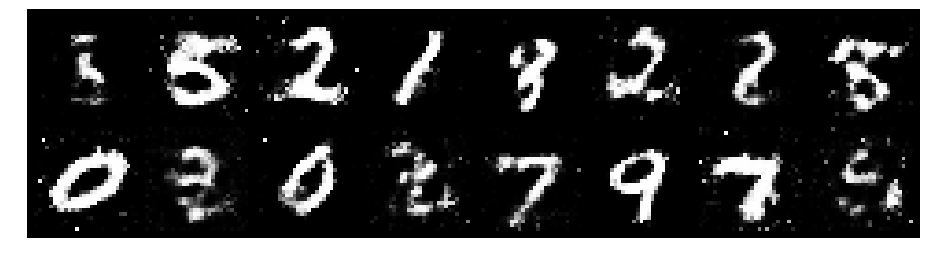

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.2920, Generator Loss: 1.0441
D(x): 0.5357, D(G(z)): 0.3929


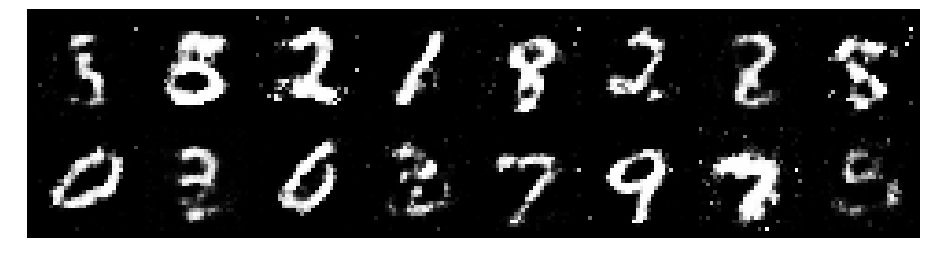

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.2429, Generator Loss: 1.0843
D(x): 0.5887, D(G(z)): 0.4009


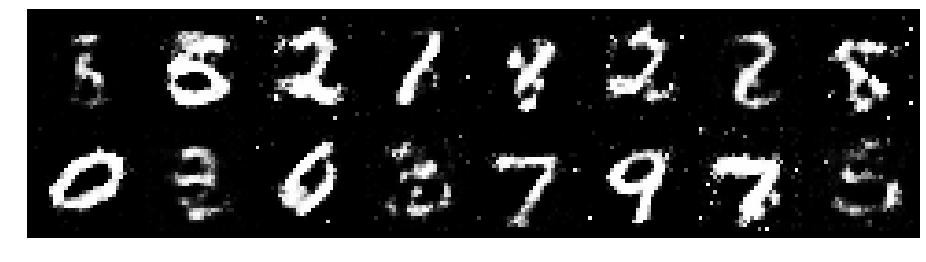

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.1176, Generator Loss: 1.0335
D(x): 0.6072, D(G(z)): 0.3729


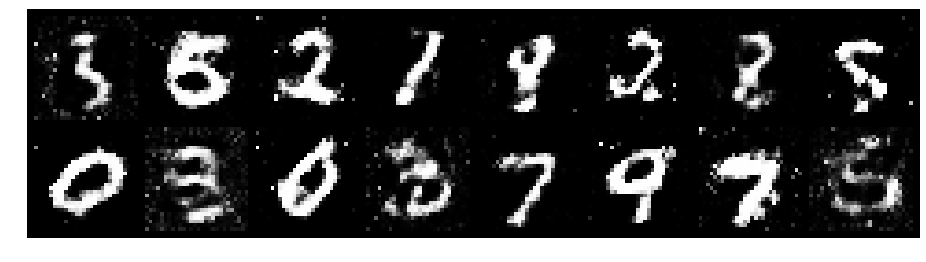

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.3429, Generator Loss: 1.0052
D(x): 0.5508, D(G(z)): 0.4346


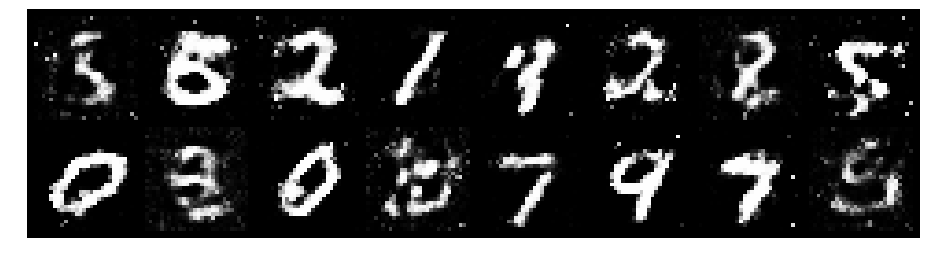

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.1925, Generator Loss: 1.2311
D(x): 0.6047, D(G(z)): 0.3747


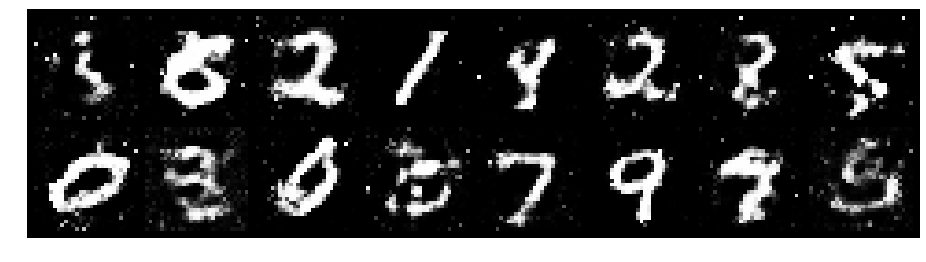

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.1823, Generator Loss: 1.1494
D(x): 0.6413, D(G(z)): 0.4452


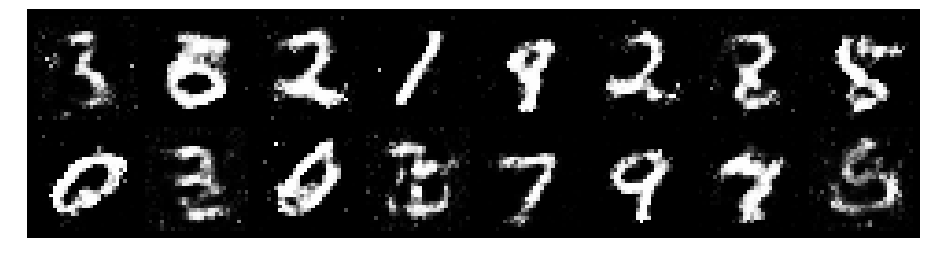

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.0757, Generator Loss: 1.3755
D(x): 0.6227, D(G(z)): 0.3715


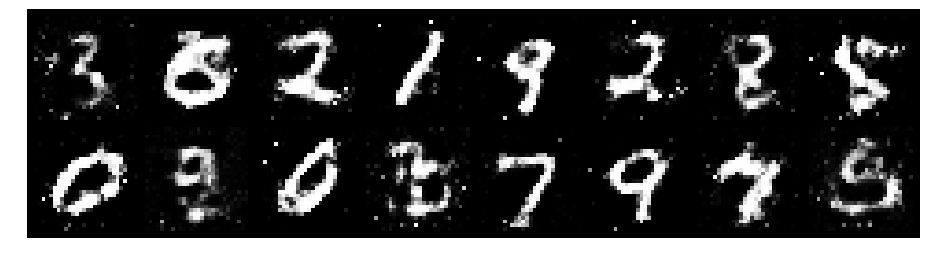

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.0306, Generator Loss: 1.1424
D(x): 0.6222, D(G(z)): 0.3320


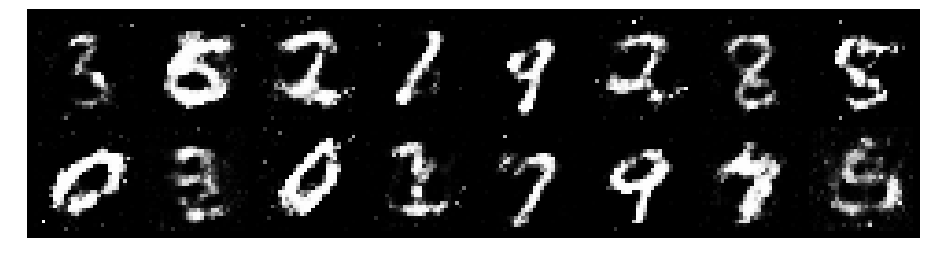

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.3075, Generator Loss: 1.3886
D(x): 0.5206, D(G(z)): 0.3080


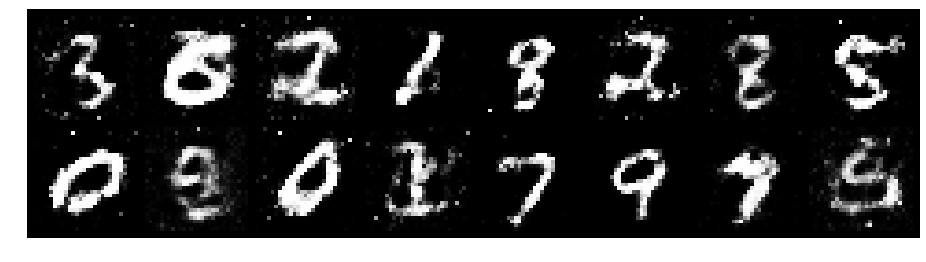

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.0775, Generator Loss: 1.0702
D(x): 0.6183, D(G(z)): 0.3625


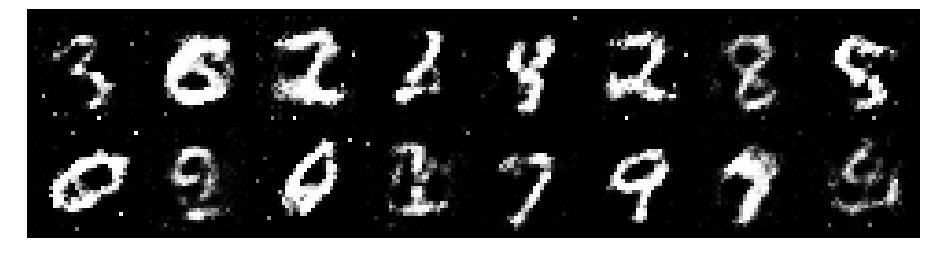

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.0722, Generator Loss: 1.1359
D(x): 0.6529, D(G(z)): 0.3858


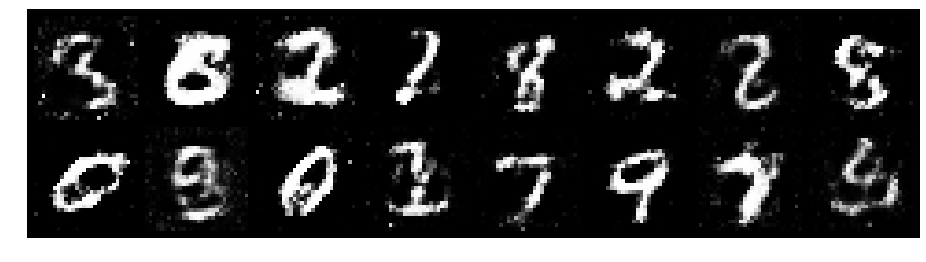

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.1773, Generator Loss: 0.9510
D(x): 0.6302, D(G(z)): 0.4499


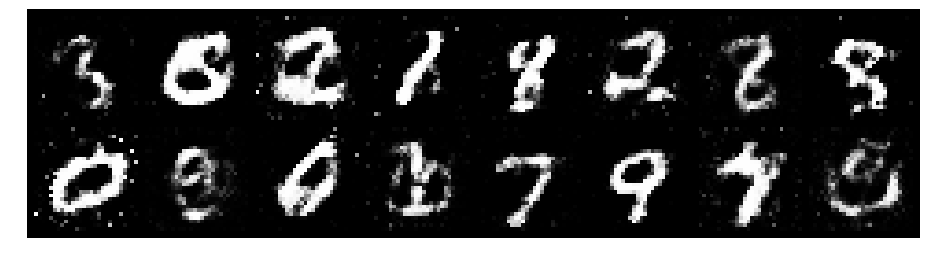

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.0726, Generator Loss: 1.0134
D(x): 0.6086, D(G(z)): 0.3891


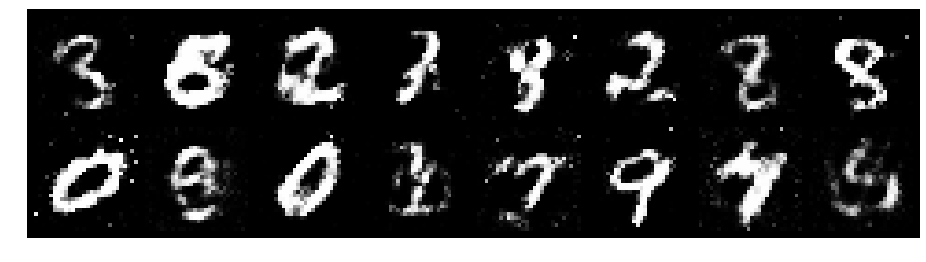

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.1772, Generator Loss: 0.9812
D(x): 0.6008, D(G(z)): 0.3806


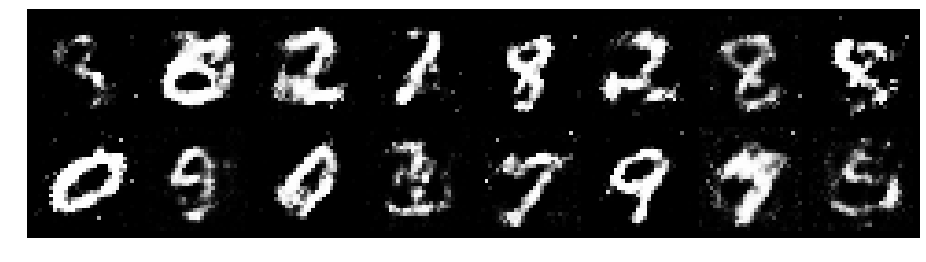

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.1170, Generator Loss: 1.0047
D(x): 0.5957, D(G(z)): 0.3937


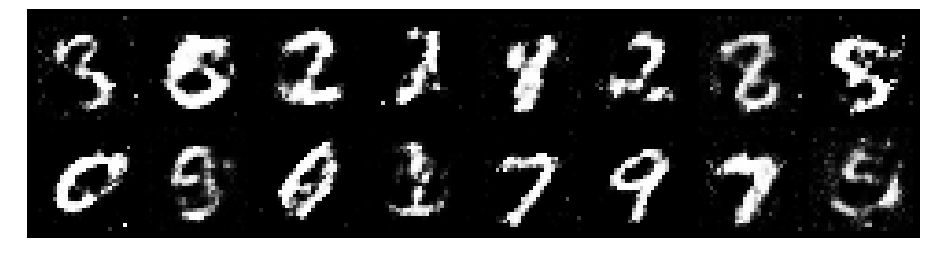

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.0537, Generator Loss: 1.1152
D(x): 0.6523, D(G(z)): 0.3793


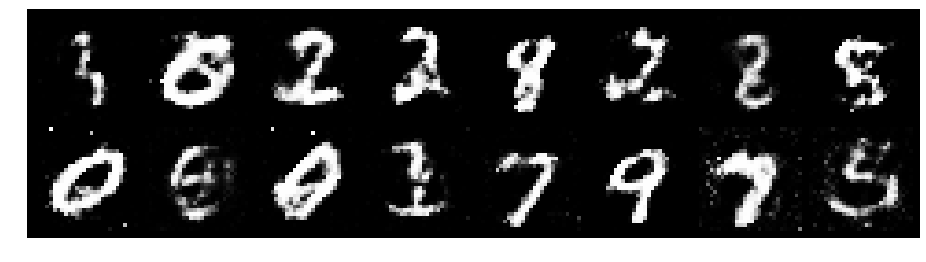

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1385, Generator Loss: 1.0369
D(x): 0.6415, D(G(z)): 0.4162


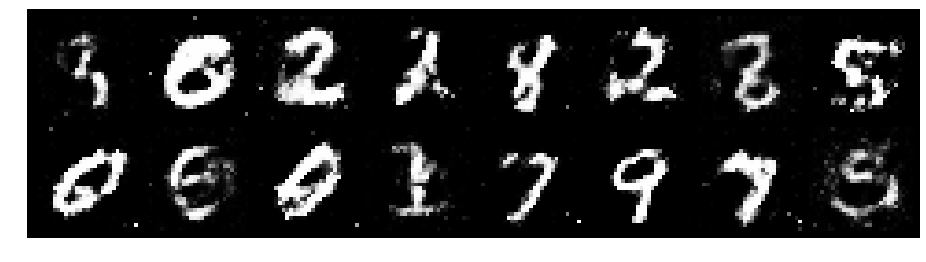

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.1209, Generator Loss: 1.0278
D(x): 0.6086, D(G(z)): 0.3701


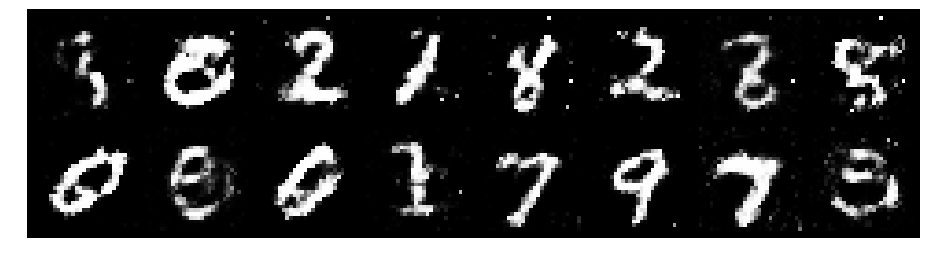

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.1481, Generator Loss: 1.1120
D(x): 0.5731, D(G(z)): 0.3658


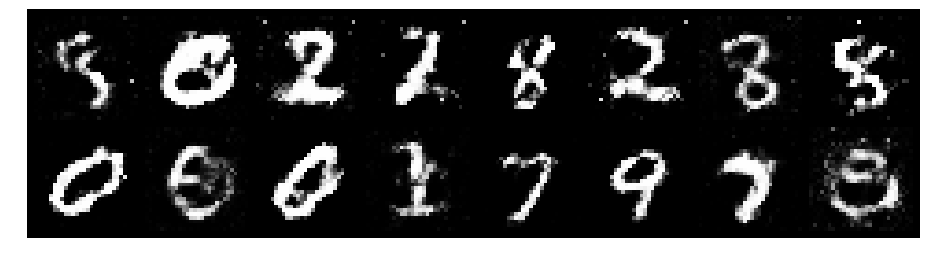

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.0880, Generator Loss: 1.1706
D(x): 0.5782, D(G(z)): 0.3538


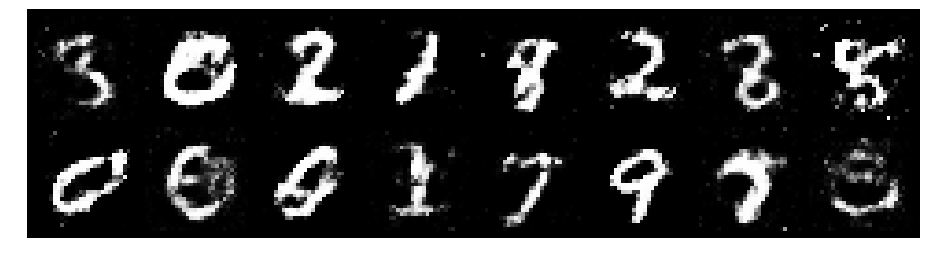

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.1458, Generator Loss: 1.0291
D(x): 0.6162, D(G(z)): 0.4048


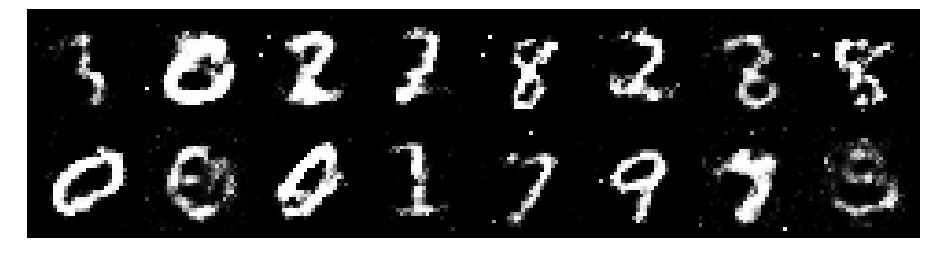

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.1270, Generator Loss: 1.1799
D(x): 0.6394, D(G(z)): 0.4114


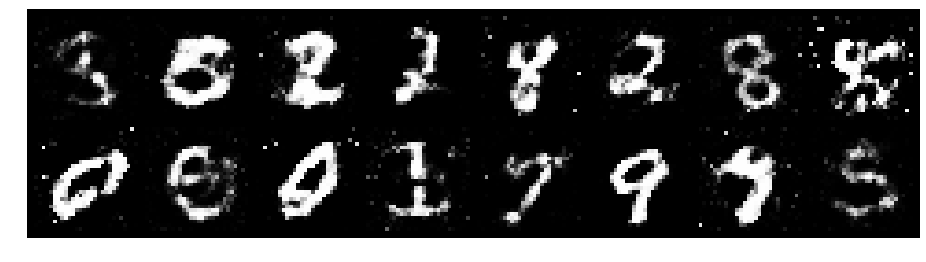

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.2489, Generator Loss: 1.3010
D(x): 0.5793, D(G(z)): 0.3681


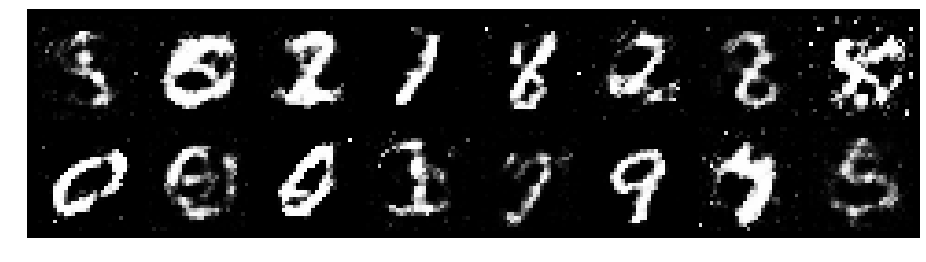

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.0929, Generator Loss: 0.9800
D(x): 0.5871, D(G(z)): 0.3843


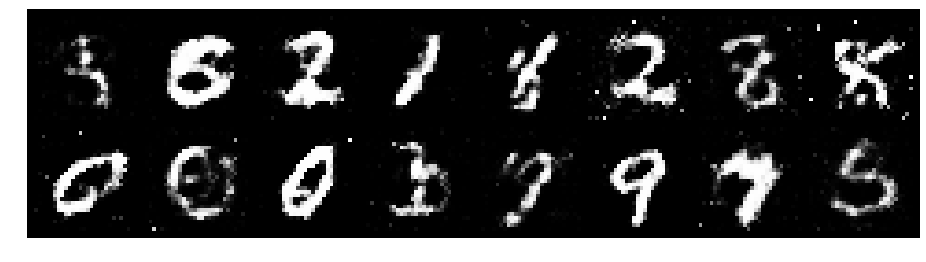

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.0603, Generator Loss: 1.2082
D(x): 0.6407, D(G(z)): 0.3686


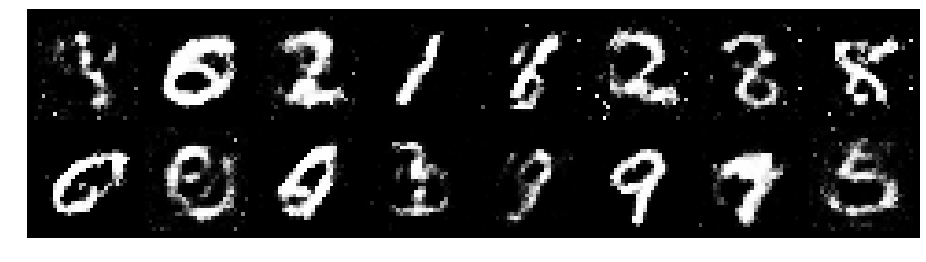

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.2248, Generator Loss: 1.2777
D(x): 0.6414, D(G(z)): 0.4040


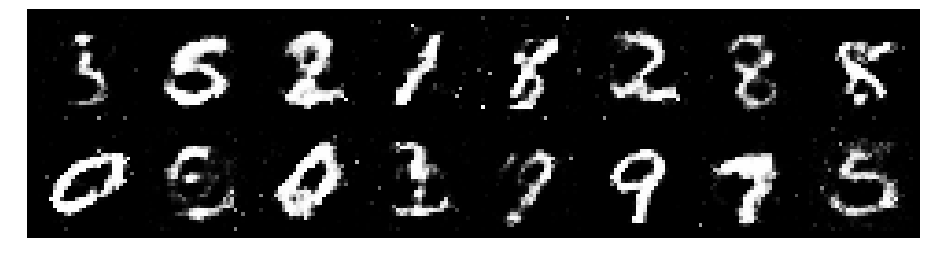

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.1016, Generator Loss: 1.2100
D(x): 0.6918, D(G(z)): 0.4212


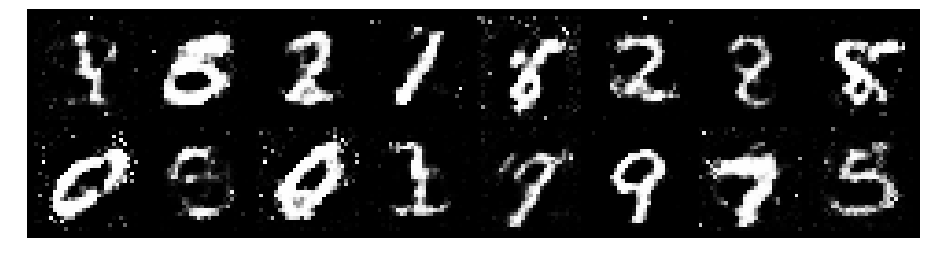

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.3231, Generator Loss: 0.8787
D(x): 0.6144, D(G(z)): 0.4821


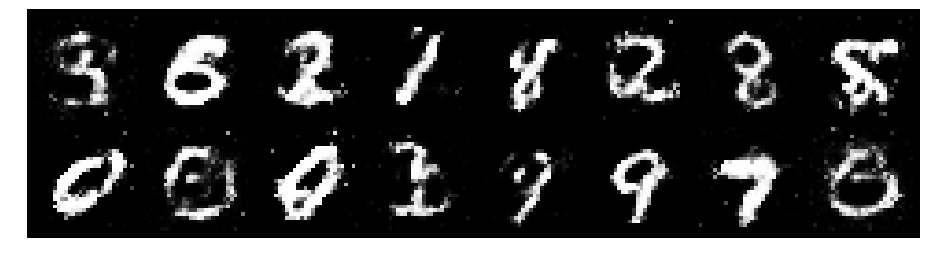

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.4472, Generator Loss: 0.9893
D(x): 0.5278, D(G(z)): 0.4434


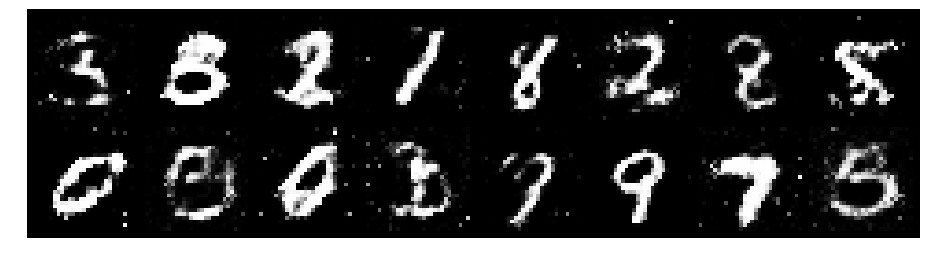

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1025, Generator Loss: 1.0758
D(x): 0.6333, D(G(z)): 0.3883


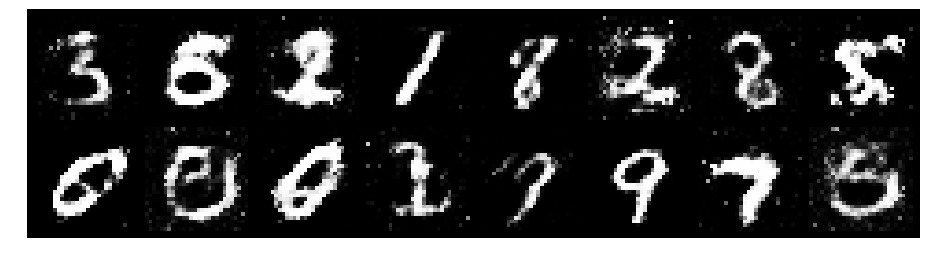

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.0945, Generator Loss: 1.1651
D(x): 0.6305, D(G(z)): 0.3659


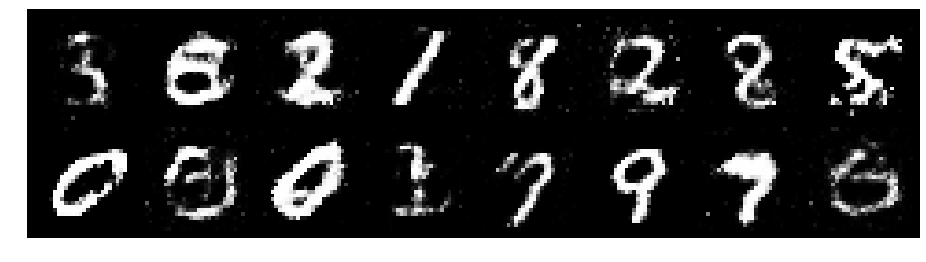

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.1149, Generator Loss: 1.0730
D(x): 0.6246, D(G(z)): 0.4007


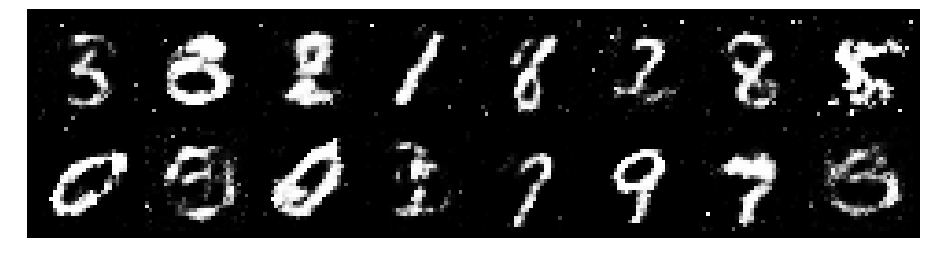

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.2084, Generator Loss: 0.8881
D(x): 0.6061, D(G(z)): 0.4535


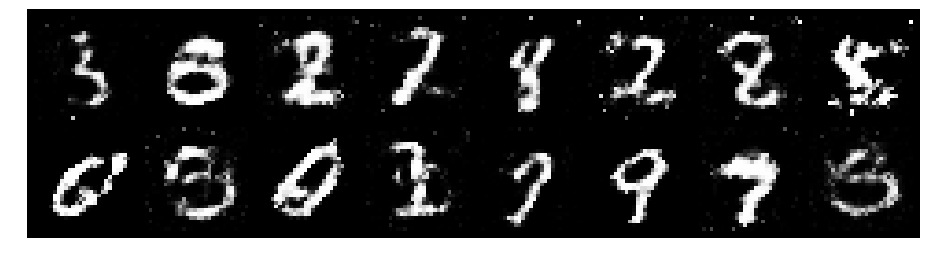

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.2364, Generator Loss: 0.7972
D(x): 0.5853, D(G(z)): 0.4402


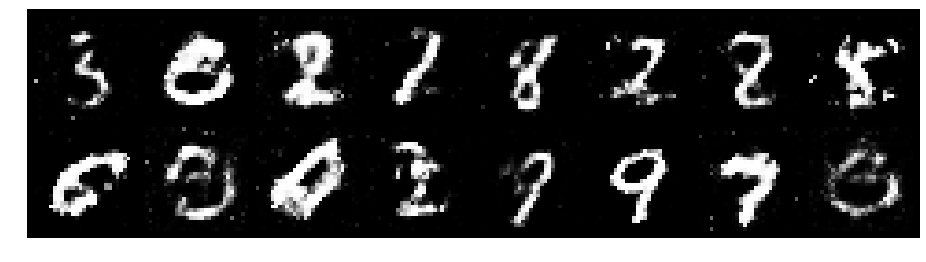

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.3065, Generator Loss: 0.9153
D(x): 0.5289, D(G(z)): 0.4179


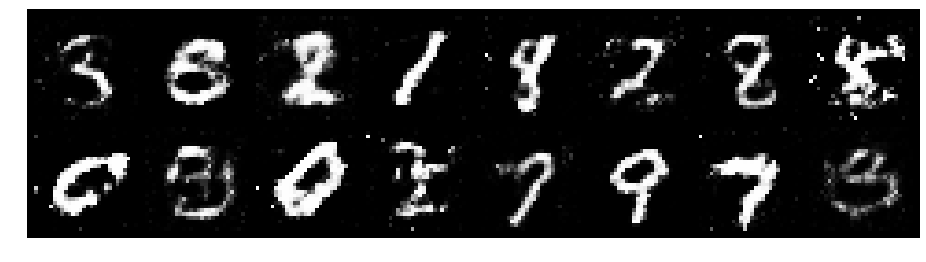

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.2177, Generator Loss: 0.8654
D(x): 0.5928, D(G(z)): 0.4427


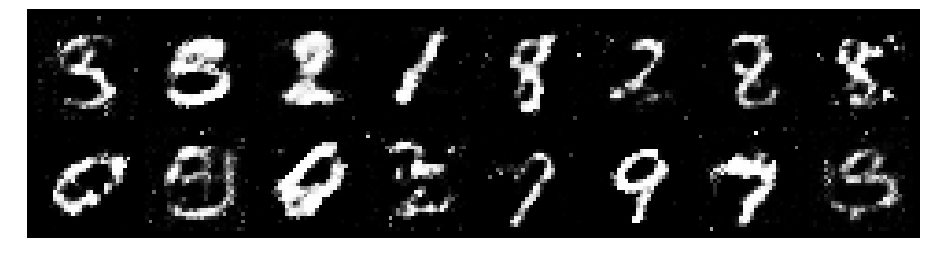

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.2352, Generator Loss: 0.8111
D(x): 0.5991, D(G(z)): 0.4609


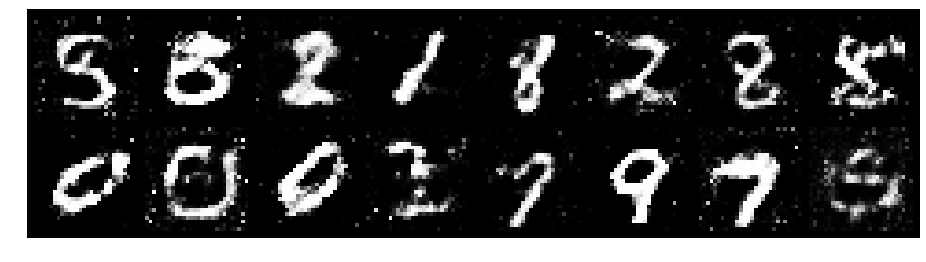

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.0852, Generator Loss: 1.0307
D(x): 0.6240, D(G(z)): 0.3736


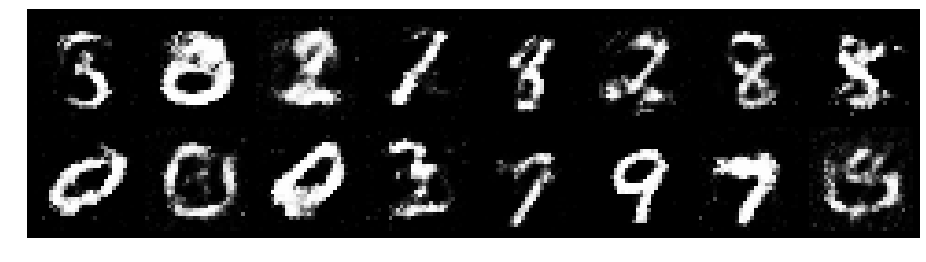

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.0929, Generator Loss: 1.1217
D(x): 0.5983, D(G(z)): 0.3865


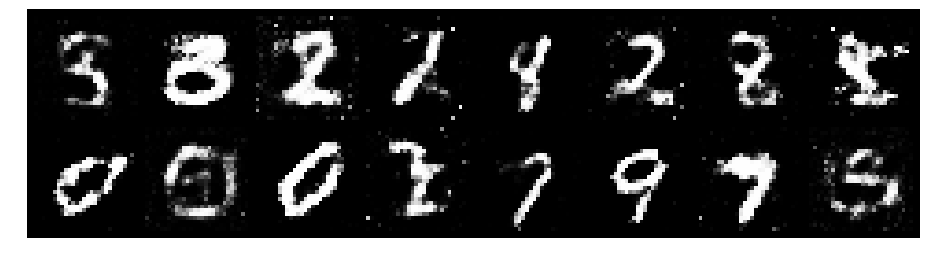

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.1694, Generator Loss: 1.1040
D(x): 0.5701, D(G(z)): 0.3891


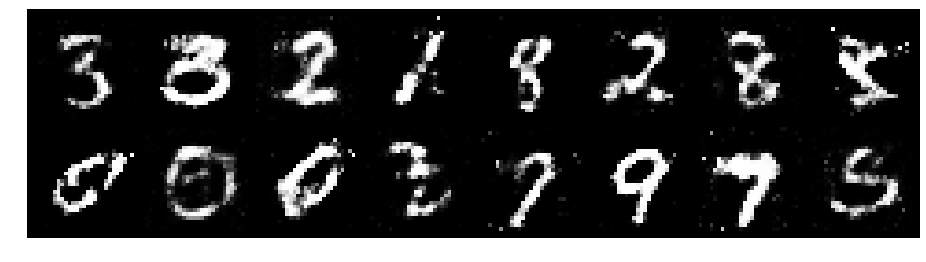

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2355, Generator Loss: 0.9689
D(x): 0.5842, D(G(z)): 0.4380


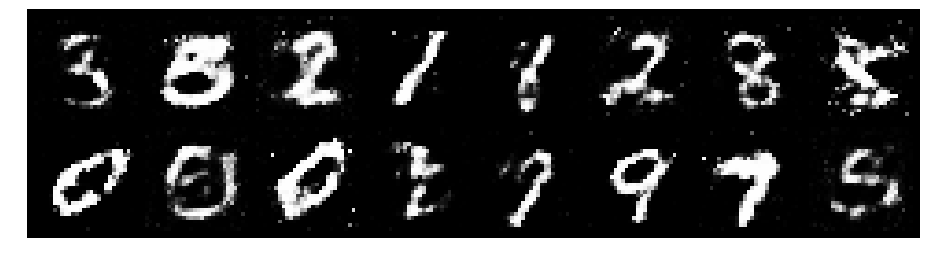

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.1562, Generator Loss: 1.0661
D(x): 0.5659, D(G(z)): 0.3616


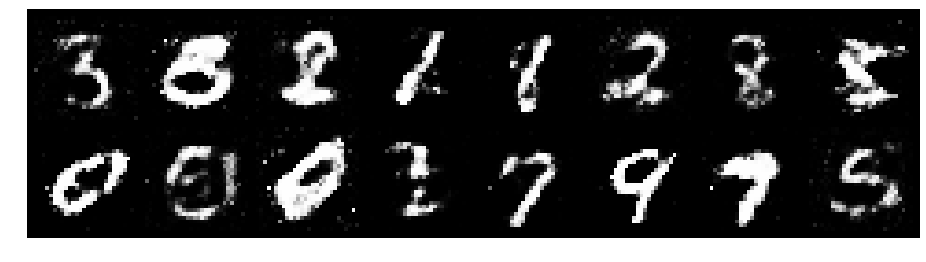

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.2680, Generator Loss: 0.9343
D(x): 0.5953, D(G(z)): 0.4431


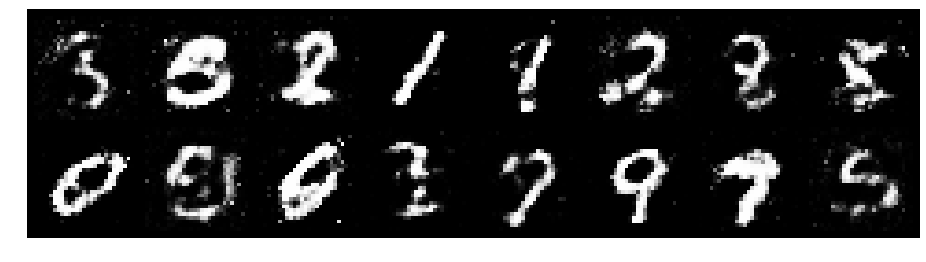

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.1212, Generator Loss: 1.1511
D(x): 0.6125, D(G(z)): 0.3715


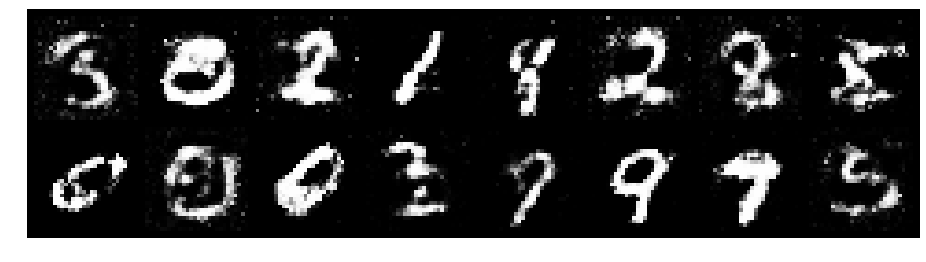

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.2835, Generator Loss: 1.1677
D(x): 0.6370, D(G(z)): 0.4346


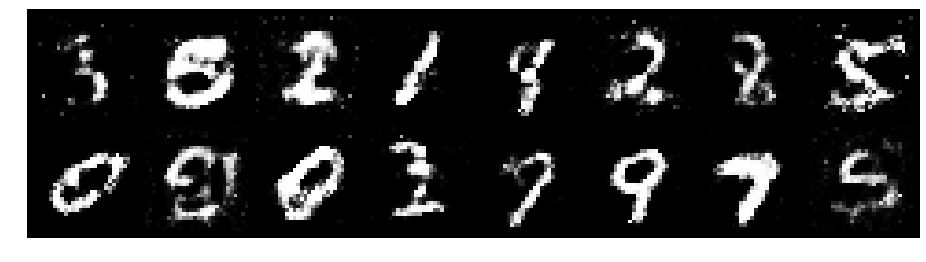

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.3888, Generator Loss: 0.8350
D(x): 0.5007, D(G(z)): 0.4323


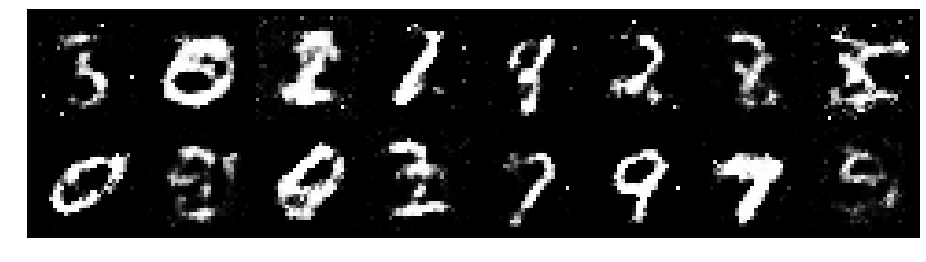

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.3267, Generator Loss: 0.9669
D(x): 0.5058, D(G(z)): 0.3828


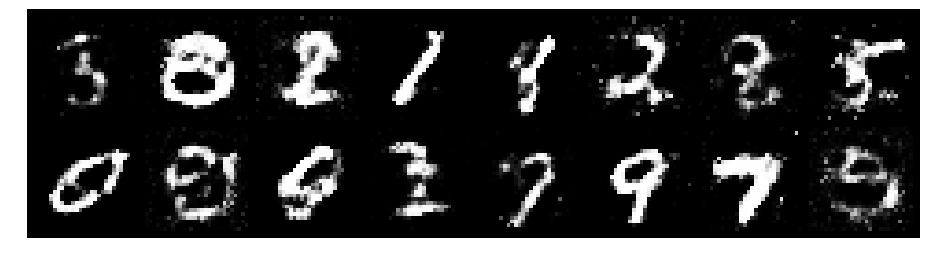

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.3107, Generator Loss: 1.0848
D(x): 0.5964, D(G(z)): 0.4216


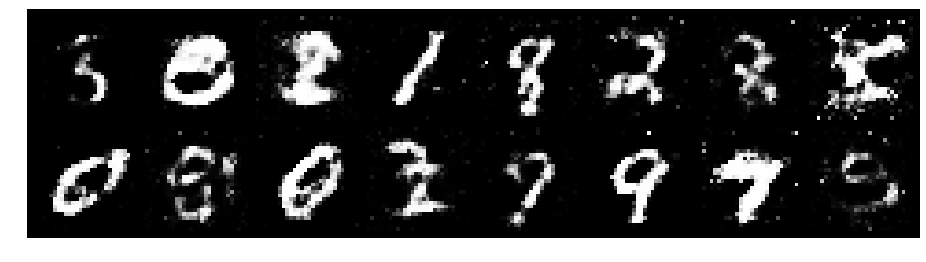

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.1143, Generator Loss: 1.2187
D(x): 0.6181, D(G(z)): 0.3893


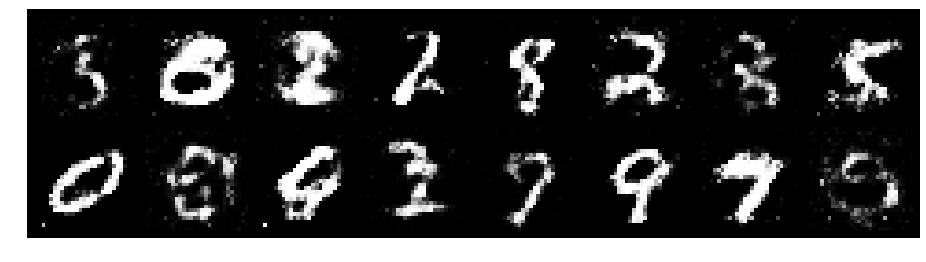

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.2099, Generator Loss: 1.0789
D(x): 0.5913, D(G(z)): 0.4342


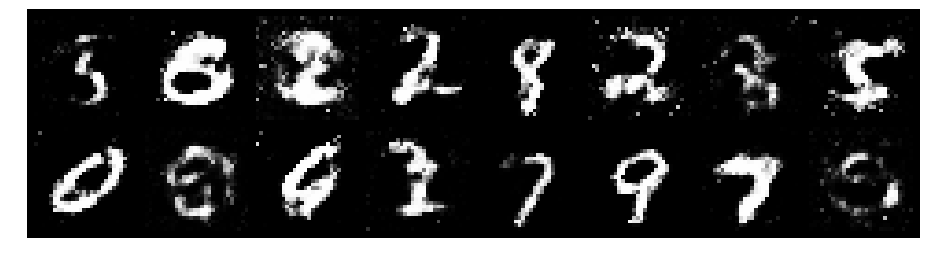

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.2581, Generator Loss: 0.9946
D(x): 0.5872, D(G(z)): 0.4440


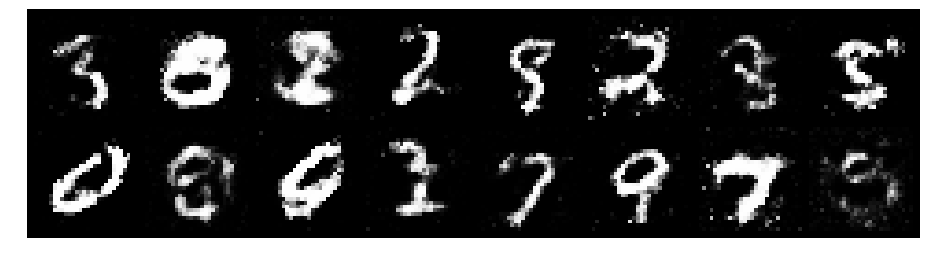

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.2476, Generator Loss: 0.9115
D(x): 0.5498, D(G(z)): 0.4137


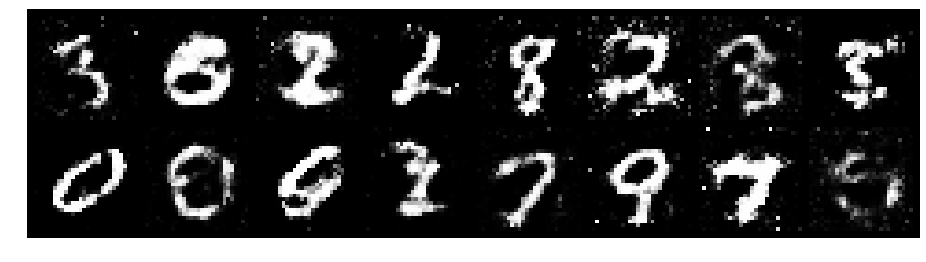

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.2502, Generator Loss: 0.9196
D(x): 0.5465, D(G(z)): 0.4285


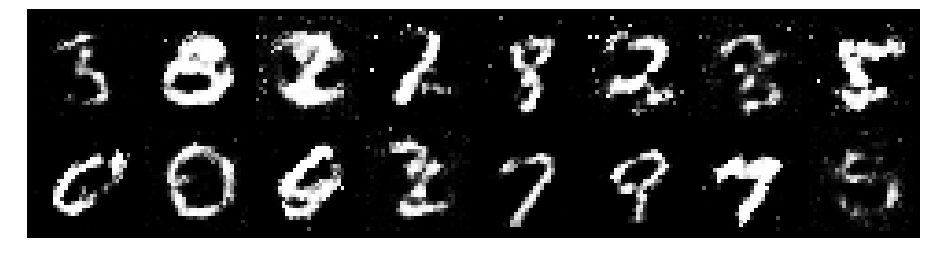

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.2844, Generator Loss: 0.8112
D(x): 0.6077, D(G(z)): 0.4848


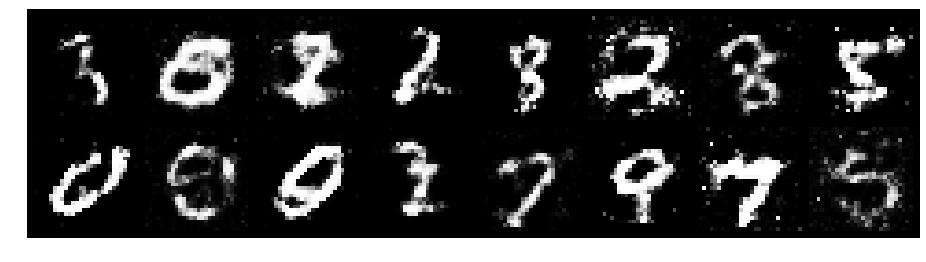

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.1714, Generator Loss: 0.8926
D(x): 0.5799, D(G(z)): 0.4315


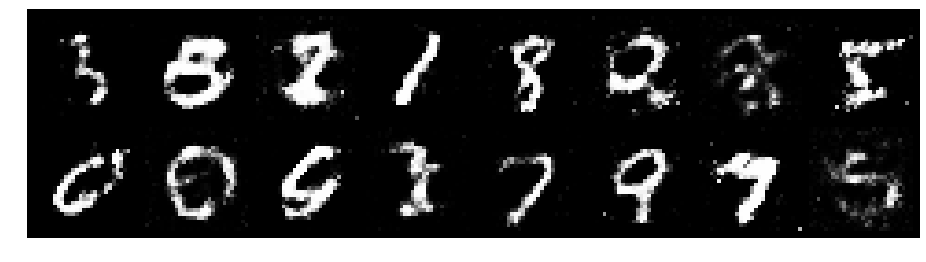

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.2460, Generator Loss: 1.0216
D(x): 0.5777, D(G(z)): 0.4547


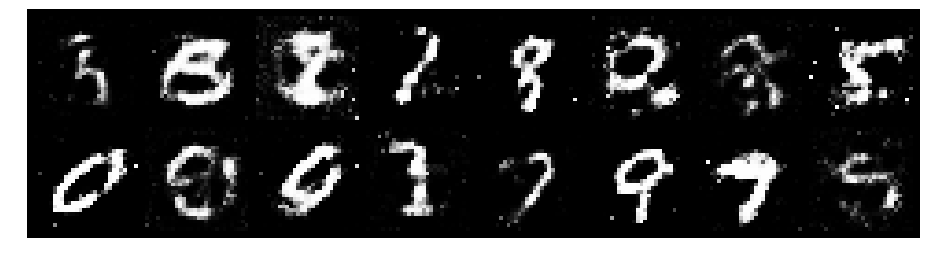

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1997, Generator Loss: 0.8641
D(x): 0.5532, D(G(z)): 0.4090


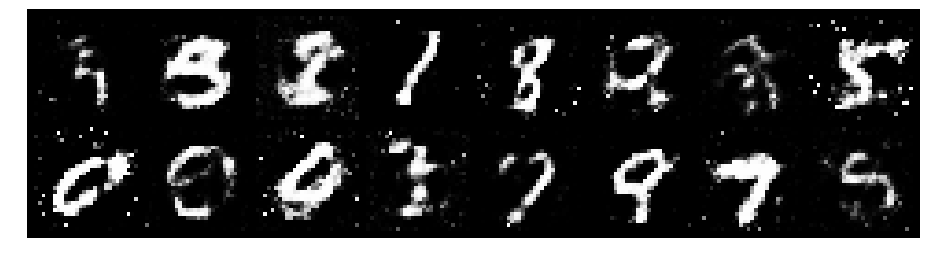

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.2521, Generator Loss: 0.9519
D(x): 0.5745, D(G(z)): 0.4618


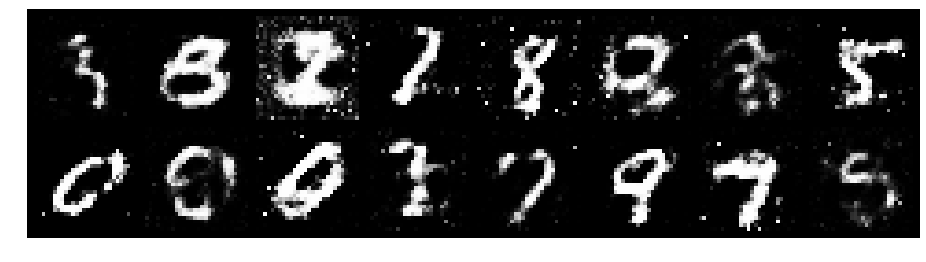

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.3044, Generator Loss: 0.8380
D(x): 0.6287, D(G(z)): 0.4832


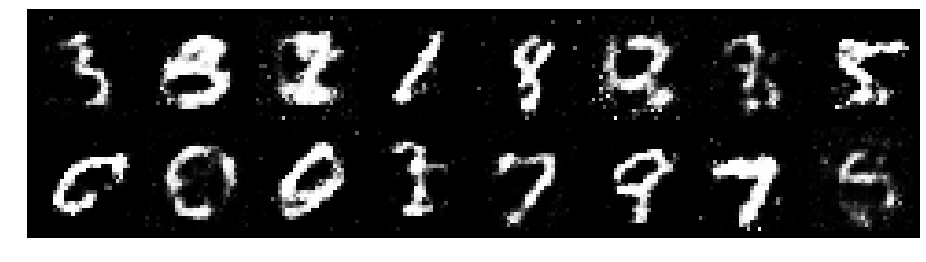

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.3235, Generator Loss: 0.9899
D(x): 0.5624, D(G(z)): 0.4204


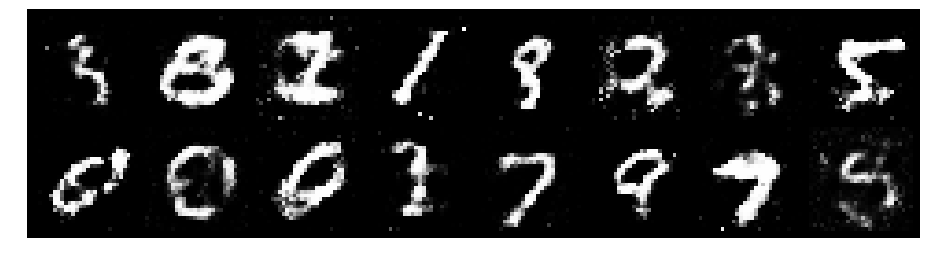

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.1237, Generator Loss: 1.0895
D(x): 0.6154, D(G(z)): 0.3944


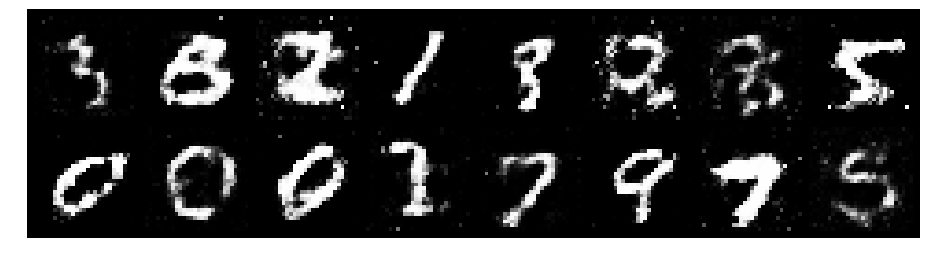

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2237, Generator Loss: 1.2158
D(x): 0.6189, D(G(z)): 0.4308


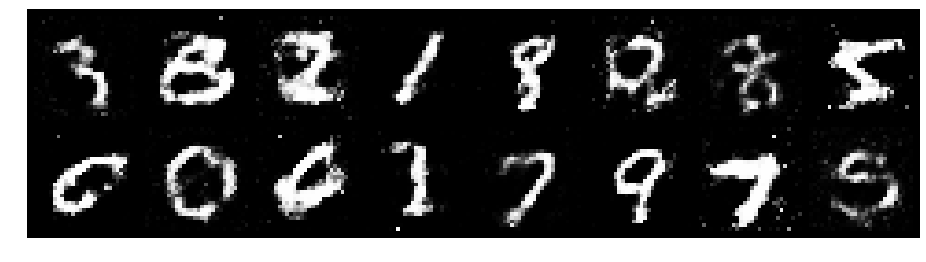

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.3021, Generator Loss: 1.0379
D(x): 0.5425, D(G(z)): 0.4067


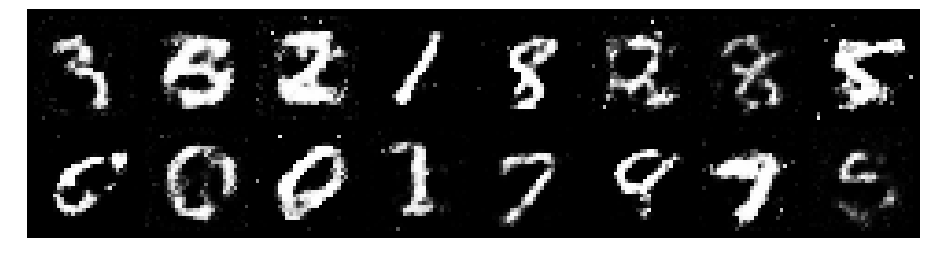

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2717, Generator Loss: 0.9587
D(x): 0.6548, D(G(z)): 0.5005


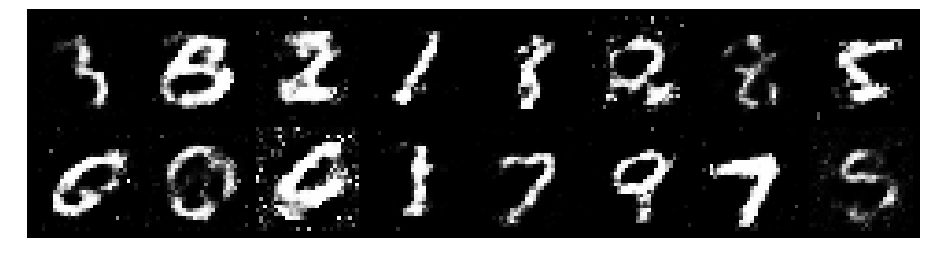

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.2299, Generator Loss: 0.9459
D(x): 0.6014, D(G(z)): 0.4413


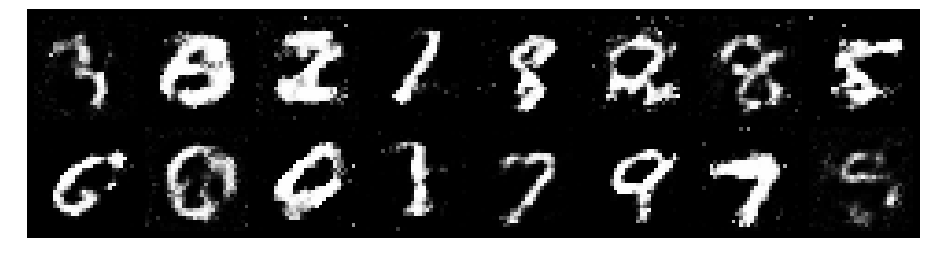

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1958, Generator Loss: 0.9330
D(x): 0.6396, D(G(z)): 0.4408


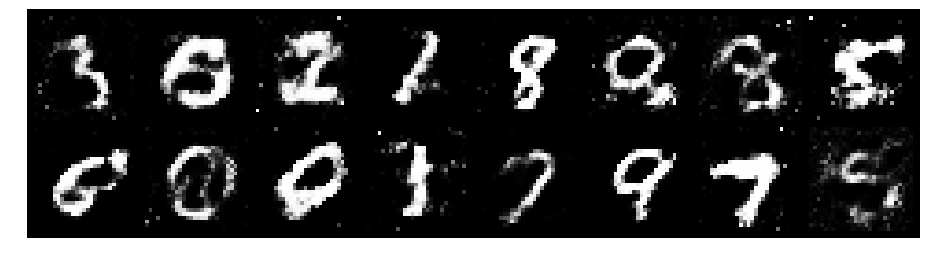

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.0734, Generator Loss: 1.1131
D(x): 0.6371, D(G(z)): 0.3984


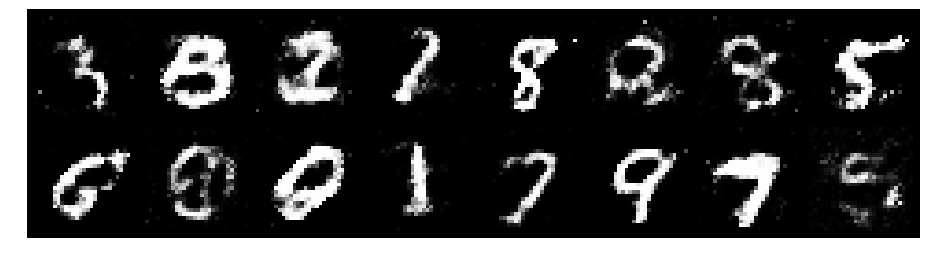

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.1378, Generator Loss: 0.9506
D(x): 0.5996, D(G(z)): 0.3953


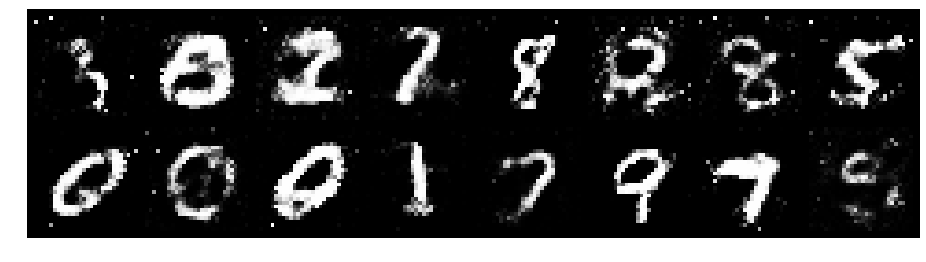

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.2214, Generator Loss: 1.0779
D(x): 0.5414, D(G(z)): 0.3870


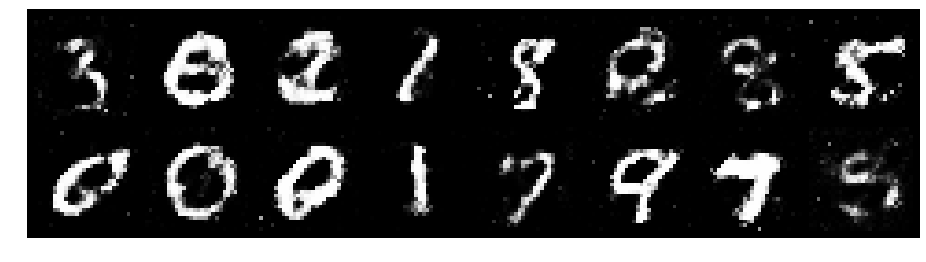

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.2657, Generator Loss: 0.9590
D(x): 0.5580, D(G(z)): 0.4385


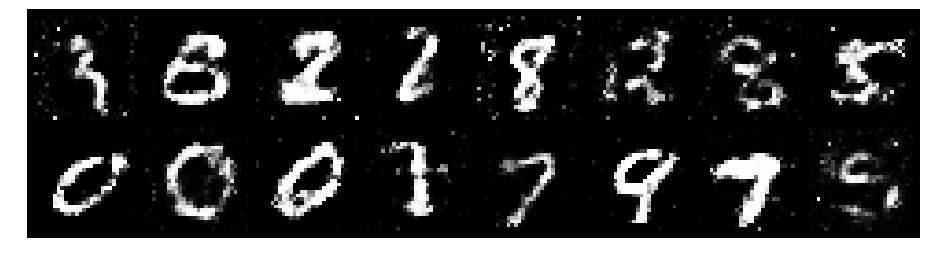

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.1119, Generator Loss: 1.1268
D(x): 0.5861, D(G(z)): 0.3612


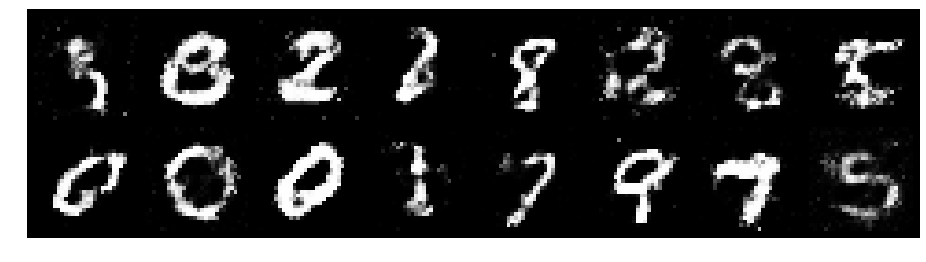

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2228, Generator Loss: 0.9377
D(x): 0.5725, D(G(z)): 0.3950


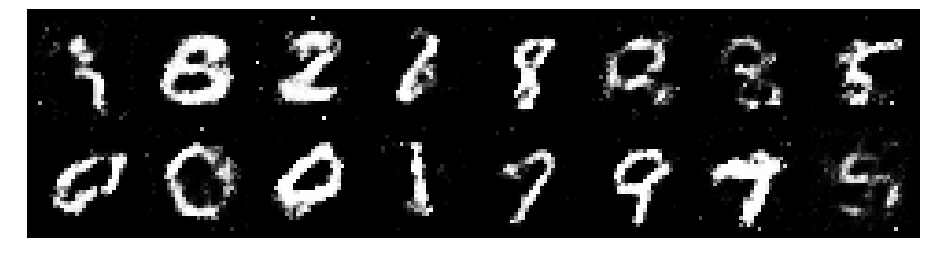

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.1318, Generator Loss: 1.1238
D(x): 0.6121, D(G(z)): 0.3692


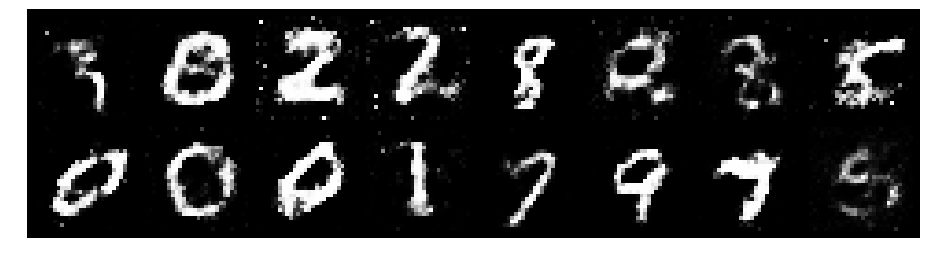

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2027, Generator Loss: 1.0018
D(x): 0.5780, D(G(z)): 0.4132


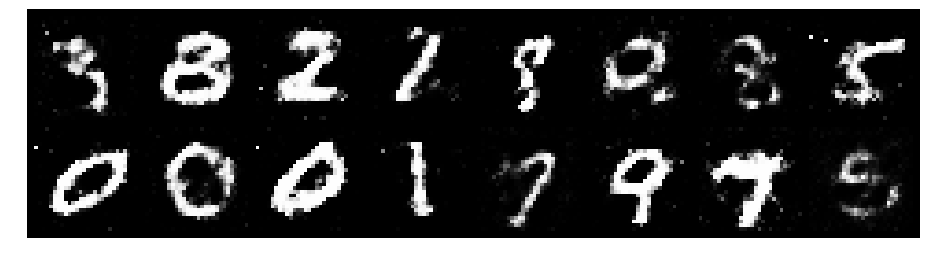

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.2214, Generator Loss: 0.8247
D(x): 0.5356, D(G(z)): 0.4021


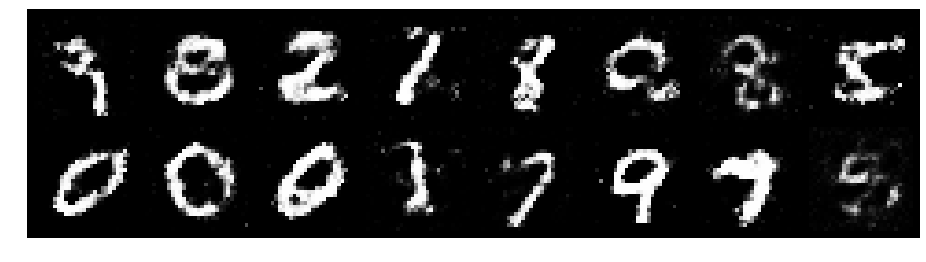

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2004, Generator Loss: 0.9778
D(x): 0.5685, D(G(z)): 0.4194


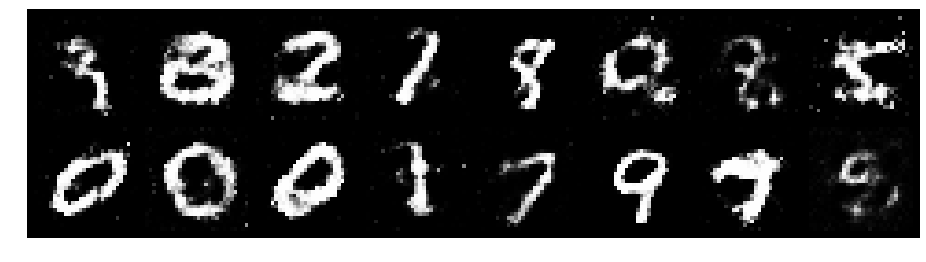

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.2408, Generator Loss: 1.1906
D(x): 0.5289, D(G(z)): 0.4026


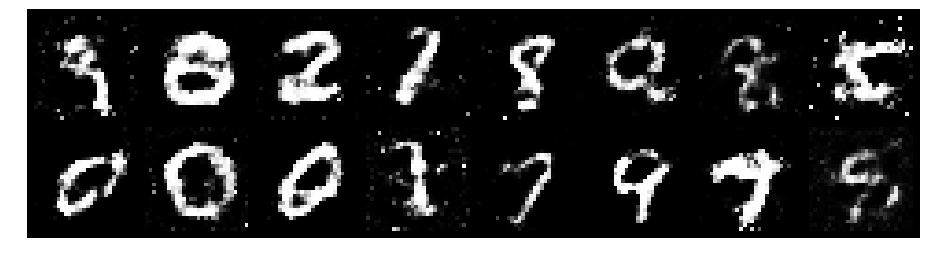

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.1886, Generator Loss: 0.9633
D(x): 0.5348, D(G(z)): 0.3688


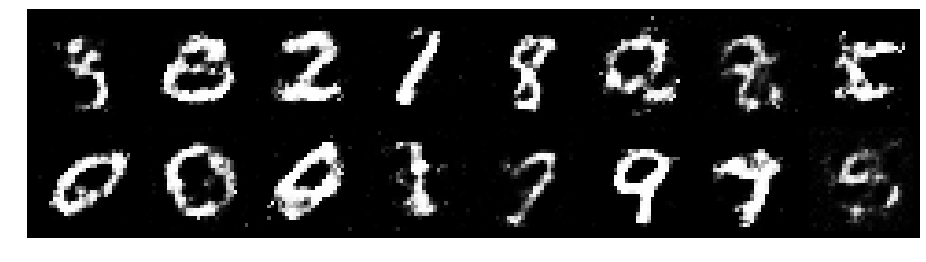

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.0368, Generator Loss: 1.1132
D(x): 0.6221, D(G(z)): 0.3693


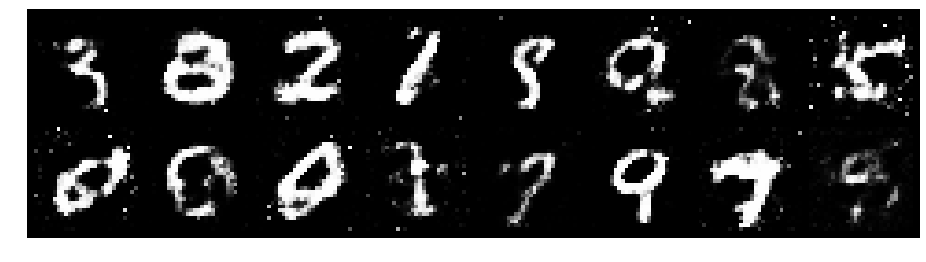

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.1843, Generator Loss: 0.9180
D(x): 0.5890, D(G(z)): 0.4138


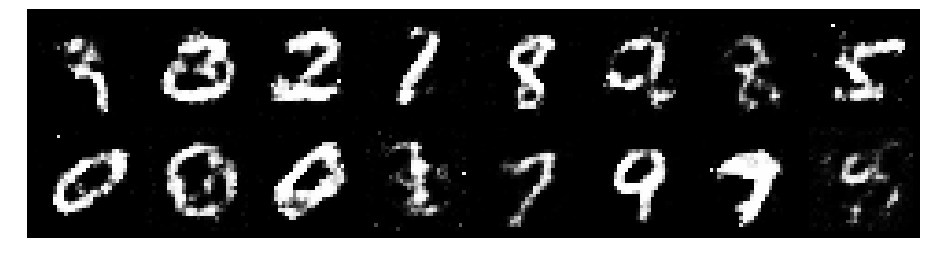

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.1597, Generator Loss: 0.9220
D(x): 0.6264, D(G(z)): 0.4477


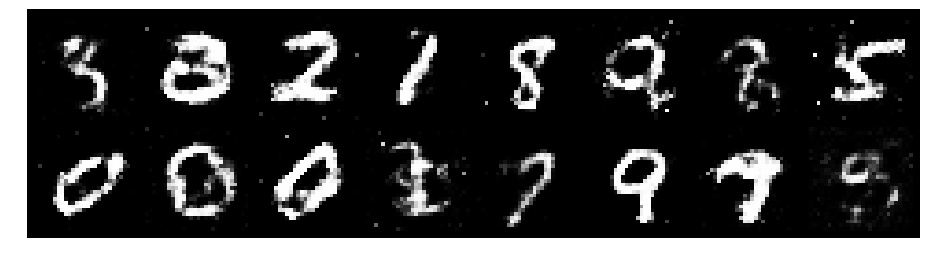

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.2388, Generator Loss: 1.0567
D(x): 0.5718, D(G(z)): 0.4285


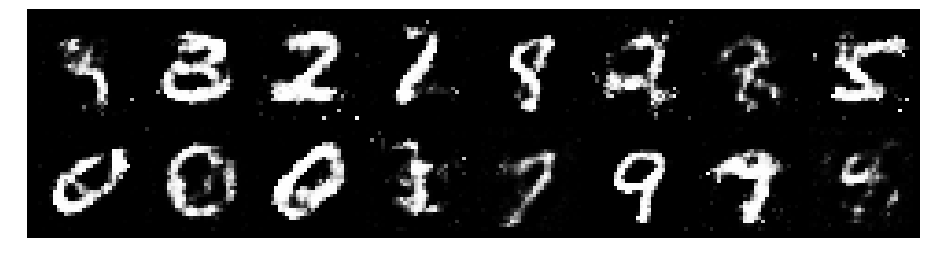

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.4005, Generator Loss: 1.0298
D(x): 0.5340, D(G(z)): 0.4307


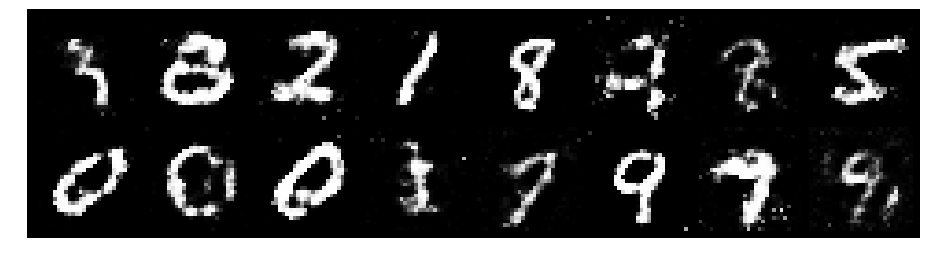

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2377, Generator Loss: 1.0591
D(x): 0.5384, D(G(z)): 0.4003


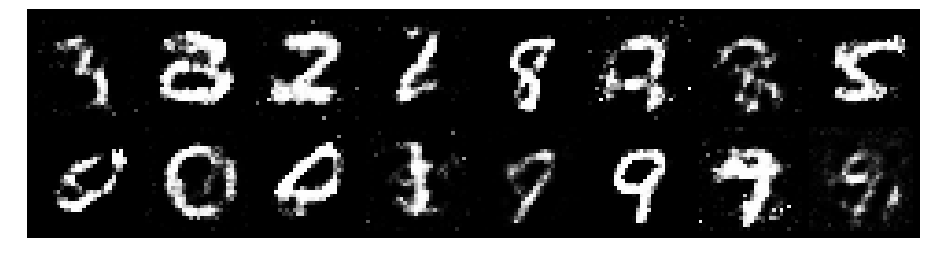

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.1181, Generator Loss: 1.2018
D(x): 0.6181, D(G(z)): 0.3755


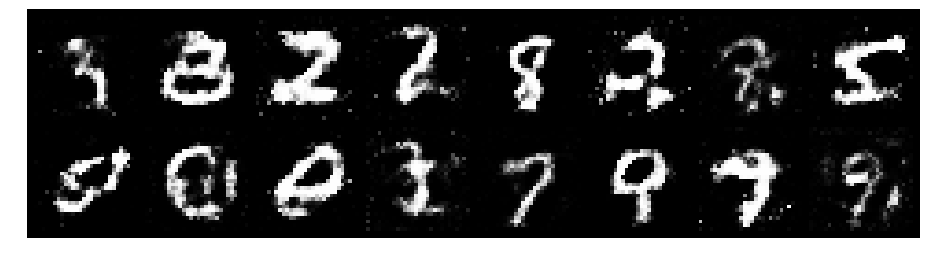

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.2486, Generator Loss: 0.8302
D(x): 0.5702, D(G(z)): 0.4633


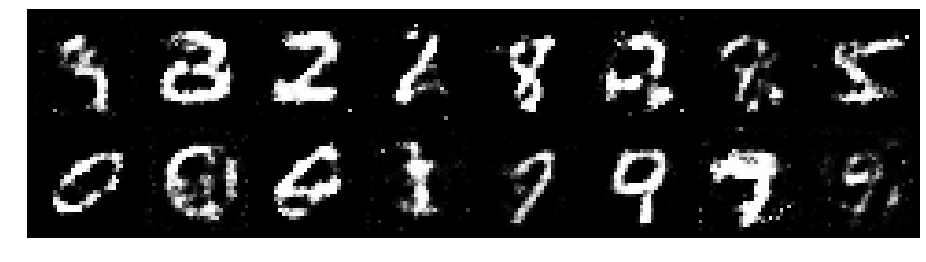

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.3860, Generator Loss: 0.9241
D(x): 0.5537, D(G(z)): 0.4686


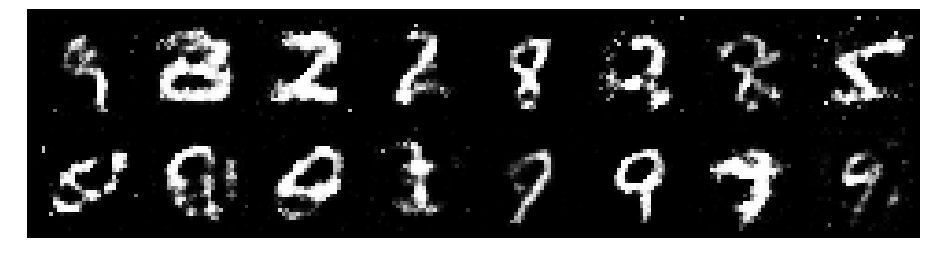

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1085, Generator Loss: 1.0320
D(x): 0.6233, D(G(z)): 0.3908


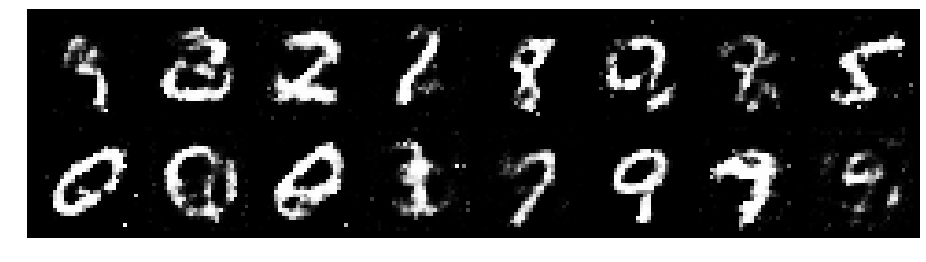

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.2504, Generator Loss: 0.9572
D(x): 0.6851, D(G(z)): 0.5051


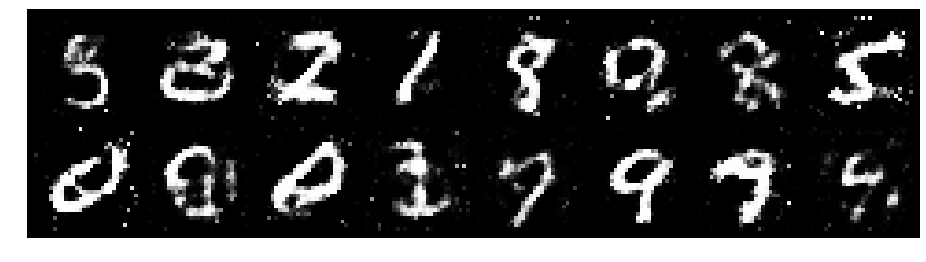

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.3604, Generator Loss: 0.9066
D(x): 0.5122, D(G(z)): 0.4486


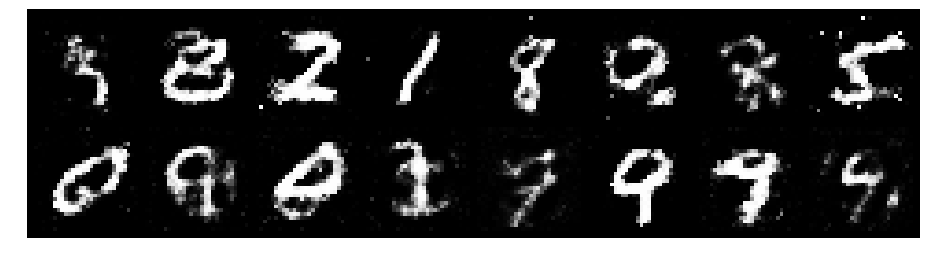

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.3612, Generator Loss: 0.8388
D(x): 0.5191, D(G(z)): 0.4602


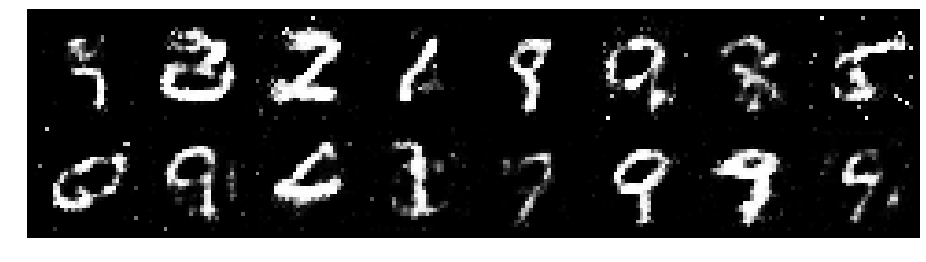

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.2637, Generator Loss: 1.1299
D(x): 0.6337, D(G(z)): 0.4555


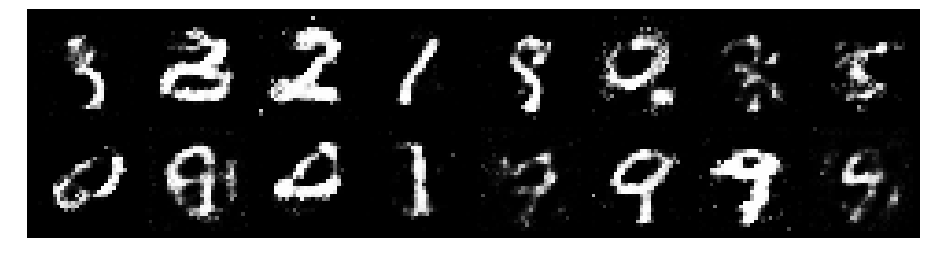

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.1516, Generator Loss: 1.2043
D(x): 0.5465, D(G(z)): 0.3559


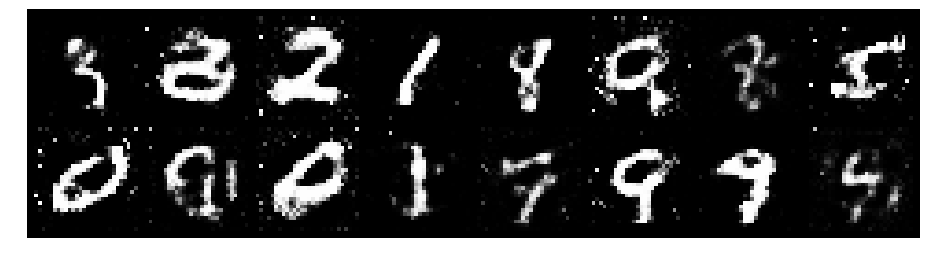

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.1440, Generator Loss: 1.0227
D(x): 0.6194, D(G(z)): 0.4184


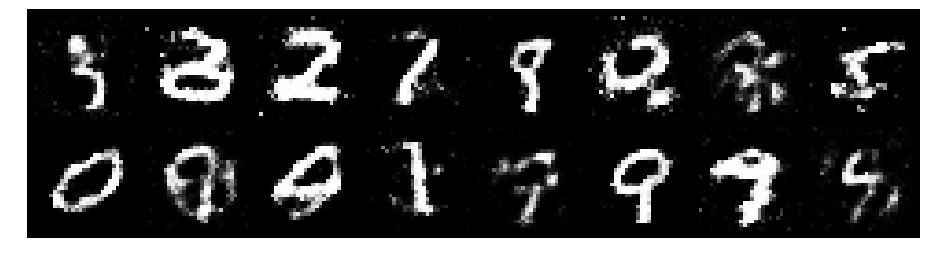

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.0970, Generator Loss: 1.1677
D(x): 0.6116, D(G(z)): 0.3500


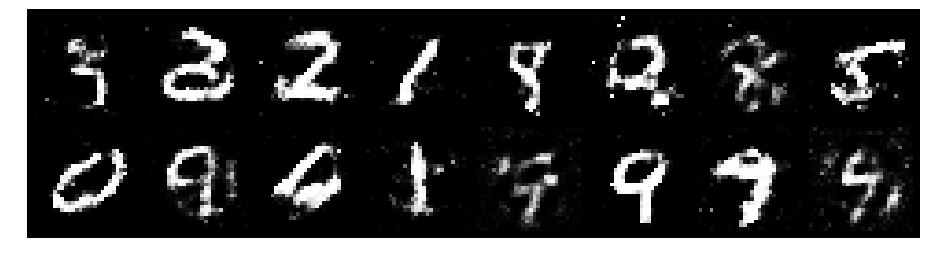

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2393, Generator Loss: 0.9971
D(x): 0.5871, D(G(z)): 0.4618


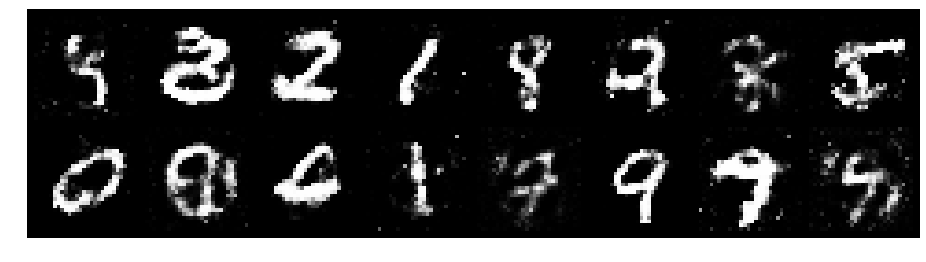

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.0881, Generator Loss: 1.1027
D(x): 0.6223, D(G(z)): 0.3890


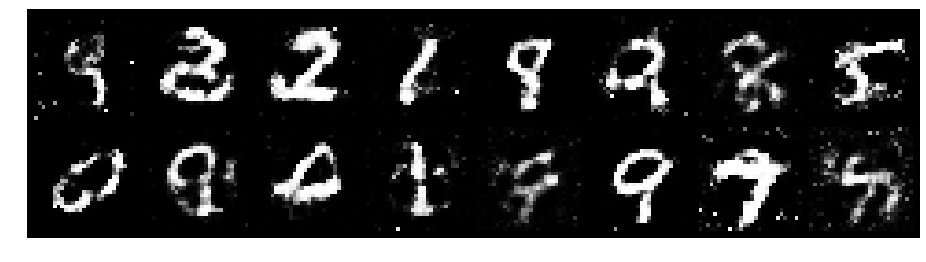

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.1407, Generator Loss: 1.0707
D(x): 0.6198, D(G(z)): 0.4093


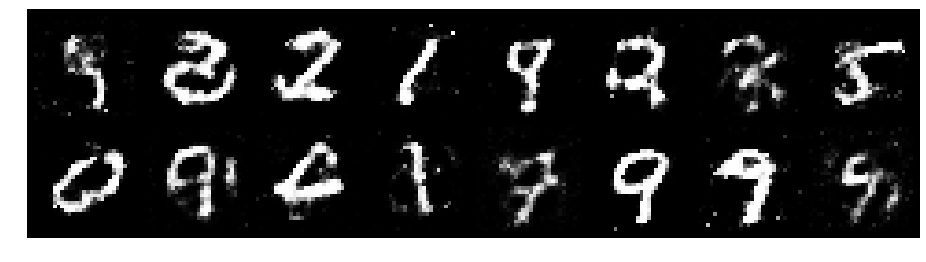

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1571, Generator Loss: 1.1848
D(x): 0.6035, D(G(z)): 0.3902


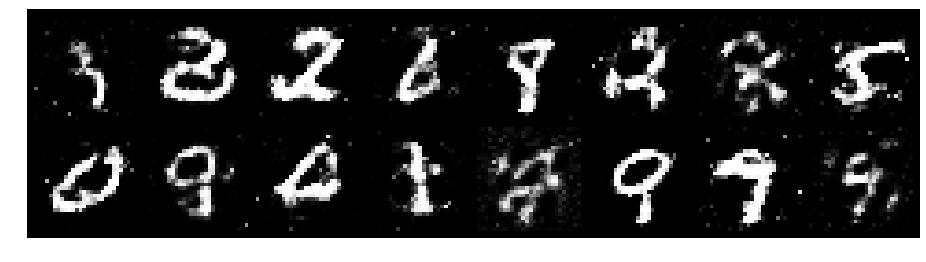

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2740, Generator Loss: 1.0921
D(x): 0.6008, D(G(z)): 0.4438


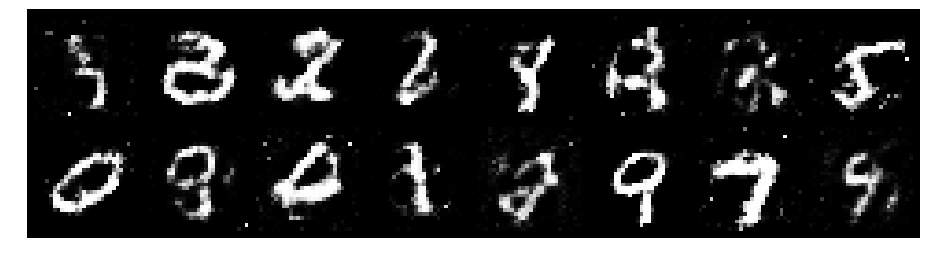

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1092, Generator Loss: 1.1121
D(x): 0.6321, D(G(z)): 0.4275


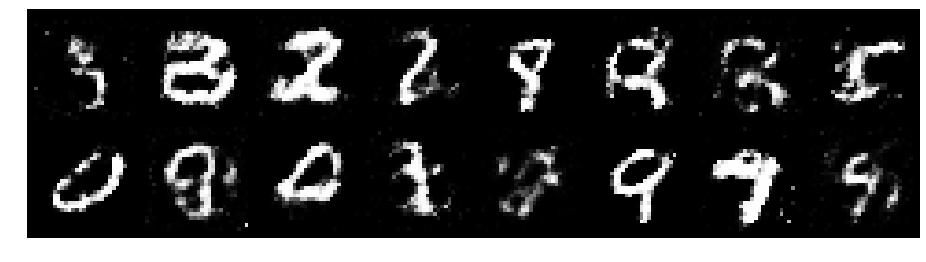

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.3101, Generator Loss: 1.0473
D(x): 0.5436, D(G(z)): 0.4122


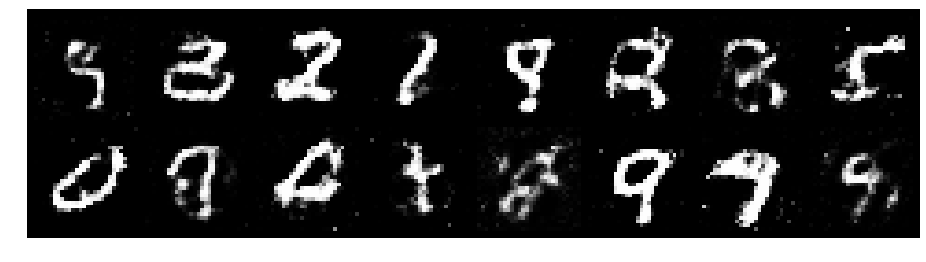

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2185, Generator Loss: 1.1389
D(x): 0.5708, D(G(z)): 0.4121


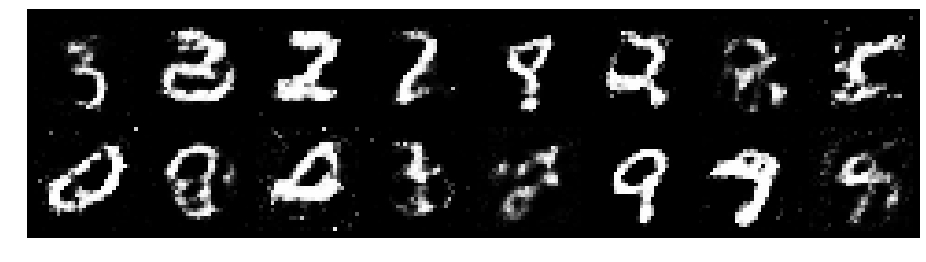

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.1648, Generator Loss: 1.1648
D(x): 0.5767, D(G(z)): 0.3913


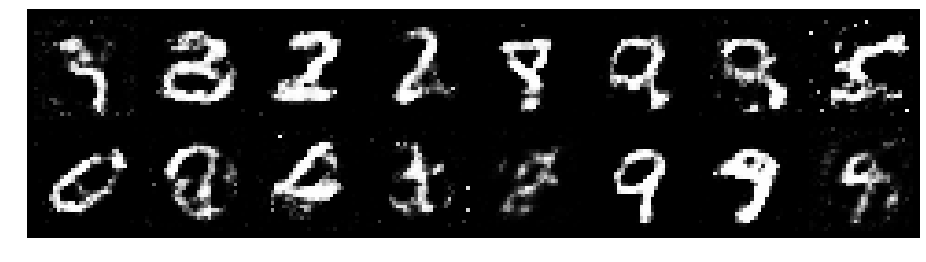

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.1134, Generator Loss: 1.0524
D(x): 0.6763, D(G(z)): 0.4342


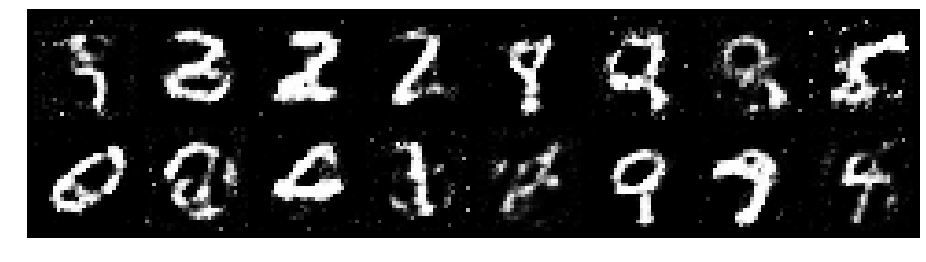

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.2001, Generator Loss: 1.0787
D(x): 0.5524, D(G(z)): 0.3712


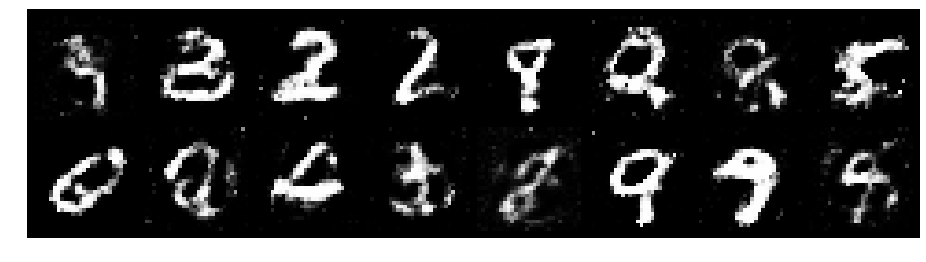

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.3921, Generator Loss: 0.9575
D(x): 0.5243, D(G(z)): 0.4530


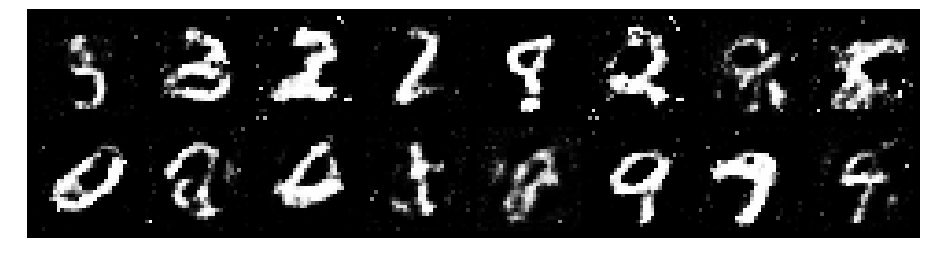

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.1904, Generator Loss: 0.8621
D(x): 0.5435, D(G(z)): 0.3653


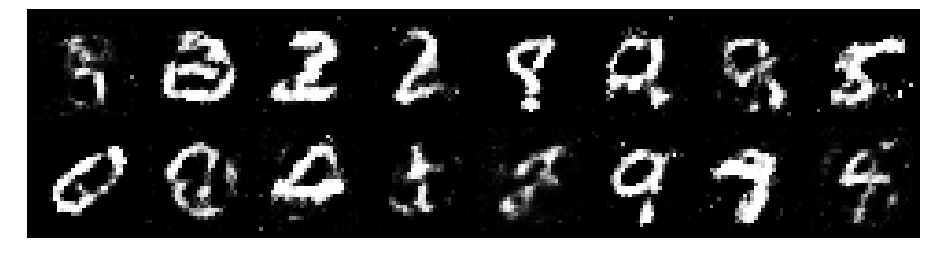

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.2814, Generator Loss: 1.1486
D(x): 0.5659, D(G(z)): 0.3840


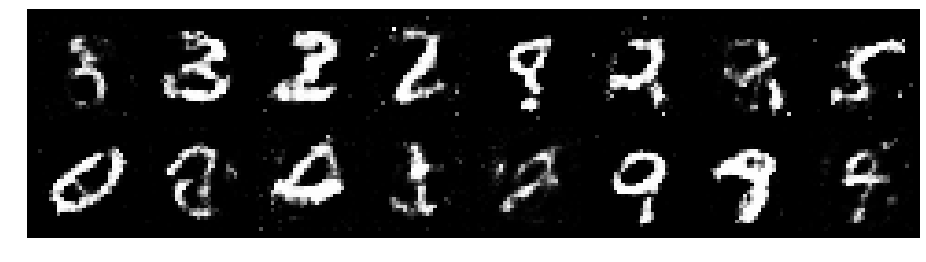

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.2128, Generator Loss: 1.1092
D(x): 0.6212, D(G(z)): 0.4321


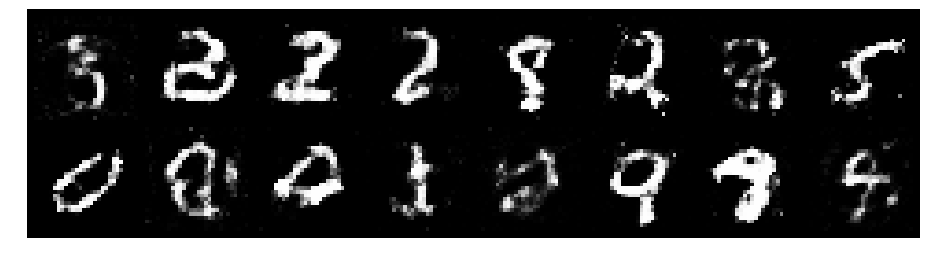

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.1186, Generator Loss: 1.0642
D(x): 0.6135, D(G(z)): 0.4144


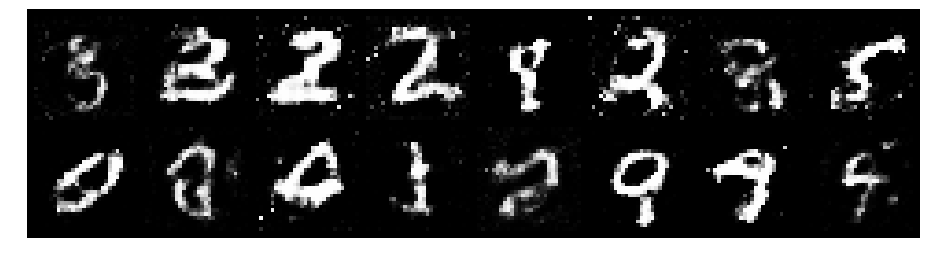

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.1965, Generator Loss: 1.1024
D(x): 0.6083, D(G(z)): 0.3937


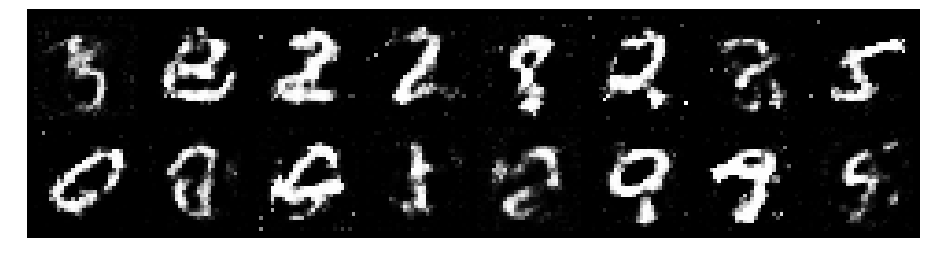

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.3043, Generator Loss: 1.1454
D(x): 0.6272, D(G(z)): 0.4630


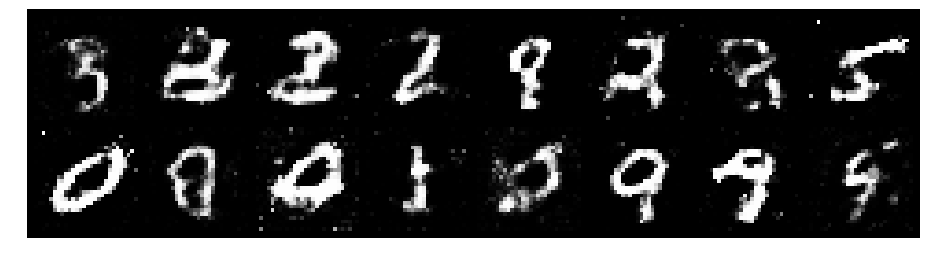

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.2504, Generator Loss: 1.1775
D(x): 0.5745, D(G(z)): 0.4117


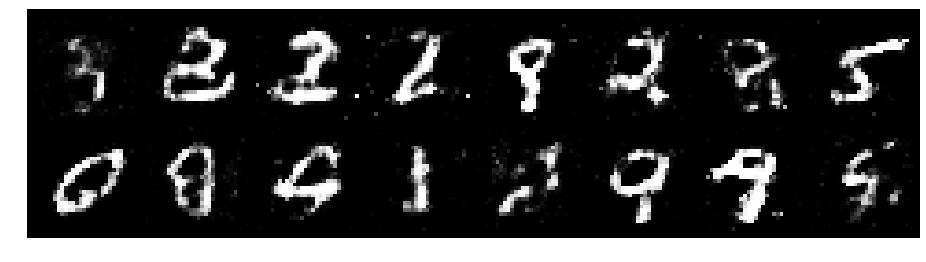

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.1480, Generator Loss: 1.0117
D(x): 0.5984, D(G(z)): 0.4191


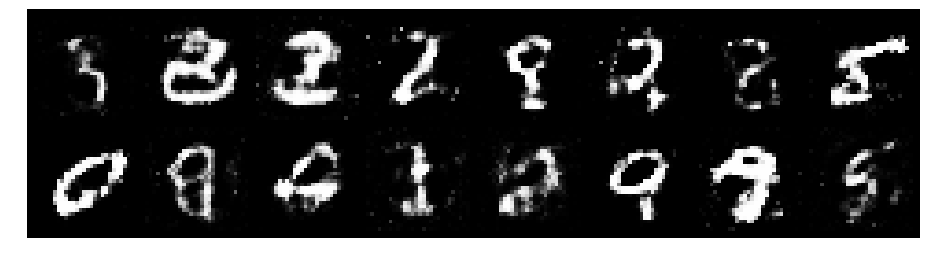

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1747, Generator Loss: 0.9663
D(x): 0.5954, D(G(z)): 0.4323


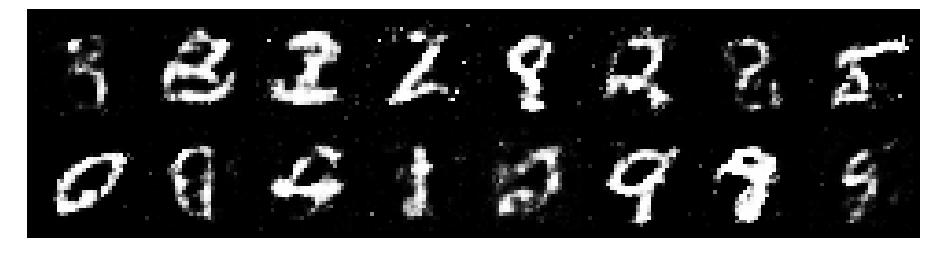

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.3256, Generator Loss: 0.8438
D(x): 0.5804, D(G(z)): 0.4775


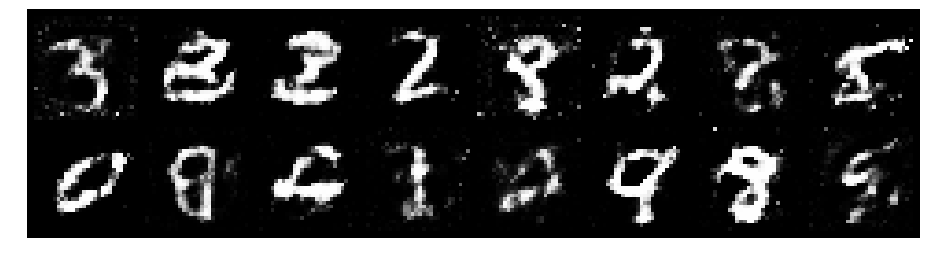

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.2577, Generator Loss: 0.8147
D(x): 0.5528, D(G(z)): 0.4363


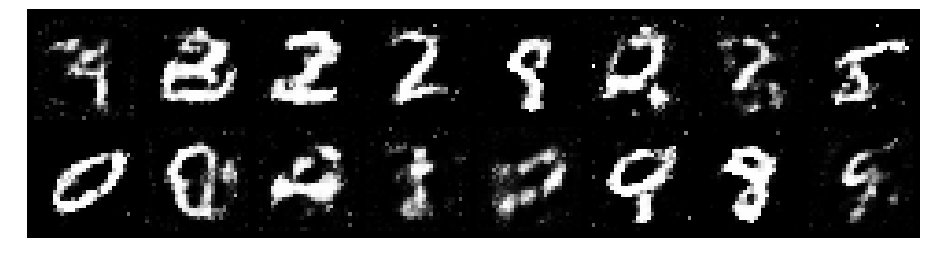

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2654, Generator Loss: 0.7756
D(x): 0.6112, D(G(z)): 0.4612


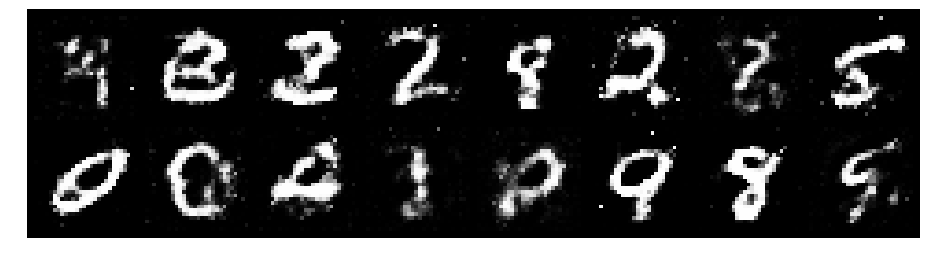

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2631, Generator Loss: 0.9585
D(x): 0.5857, D(G(z)): 0.4173


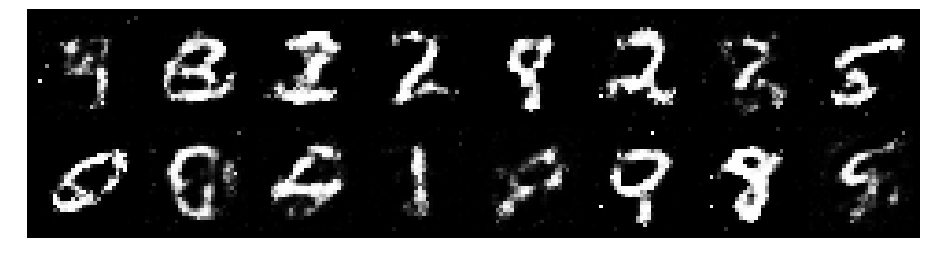

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1794, Generator Loss: 1.0521
D(x): 0.5807, D(G(z)): 0.4188


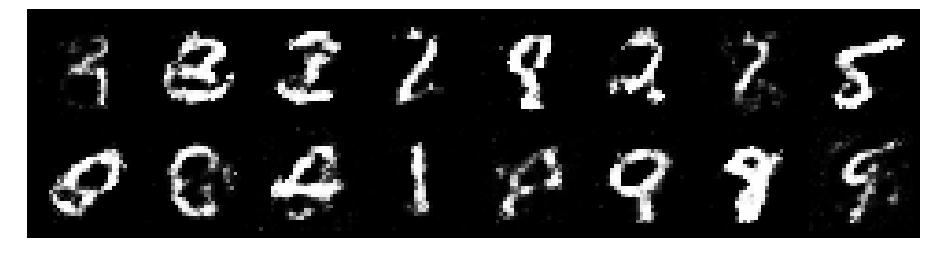

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.2061, Generator Loss: 0.9152
D(x): 0.5548, D(G(z)): 0.4165


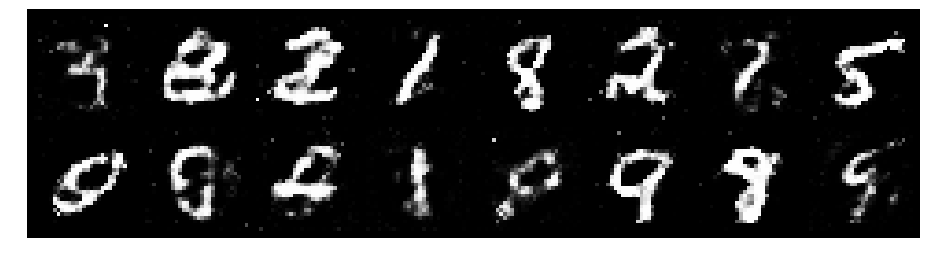

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.1808, Generator Loss: 1.1365
D(x): 0.5525, D(G(z)): 0.3768


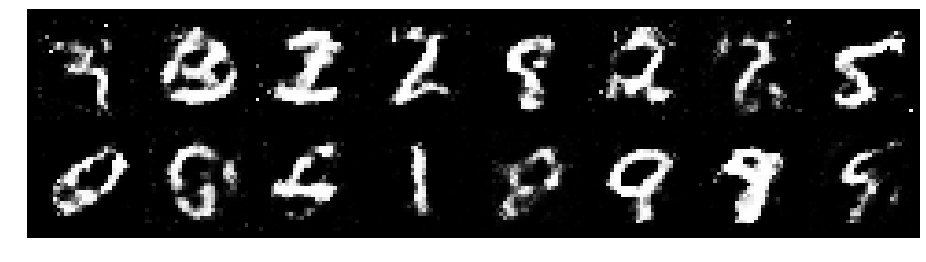

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.0822, Generator Loss: 1.1663
D(x): 0.6294, D(G(z)): 0.4047


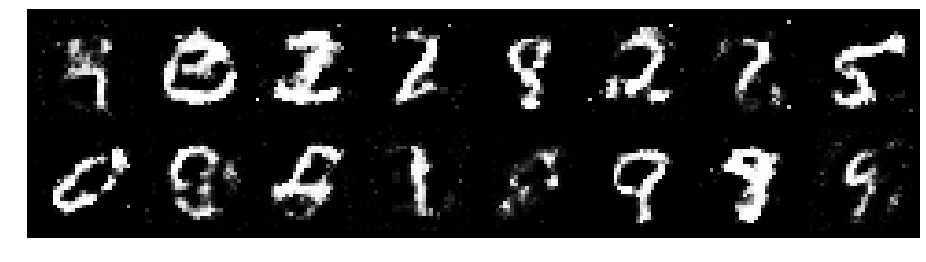

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.1498, Generator Loss: 0.9753
D(x): 0.6081, D(G(z)): 0.4280


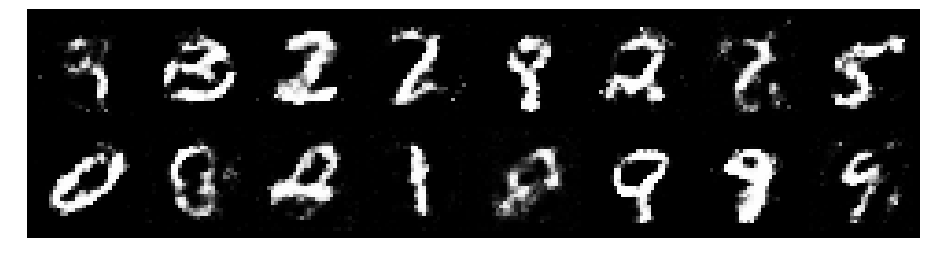

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.2654, Generator Loss: 1.0258
D(x): 0.5718, D(G(z)): 0.4507


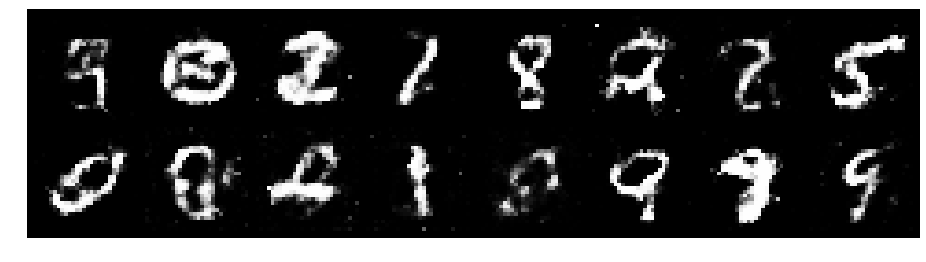

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2039, Generator Loss: 1.1389
D(x): 0.5987, D(G(z)): 0.4076


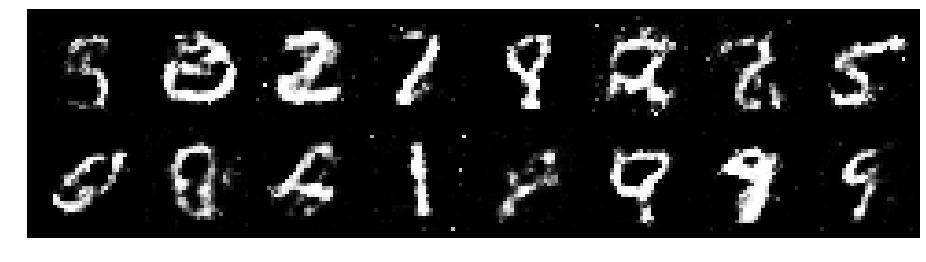

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.0727, Generator Loss: 1.1149
D(x): 0.5764, D(G(z)): 0.3531


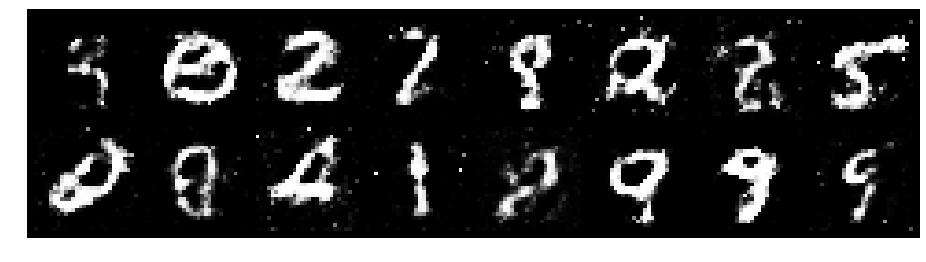

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.3483, Generator Loss: 0.8773
D(x): 0.5759, D(G(z)): 0.4680


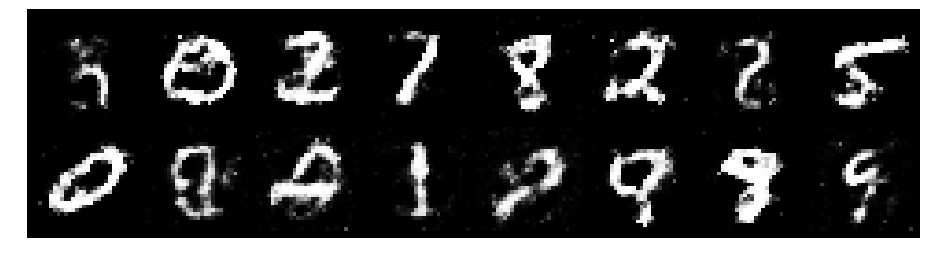

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.3063, Generator Loss: 0.9153
D(x): 0.5523, D(G(z)): 0.4422


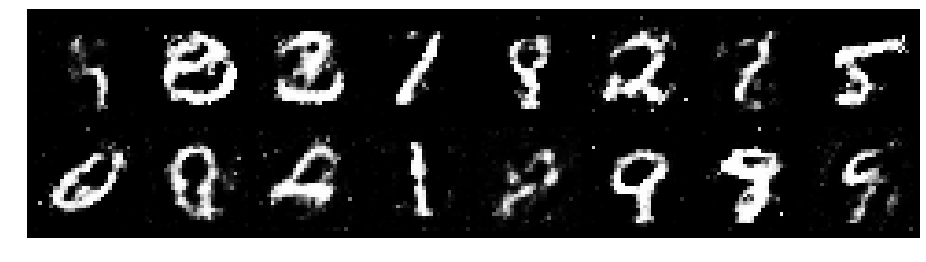

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.0947, Generator Loss: 1.1194
D(x): 0.5977, D(G(z)): 0.3554


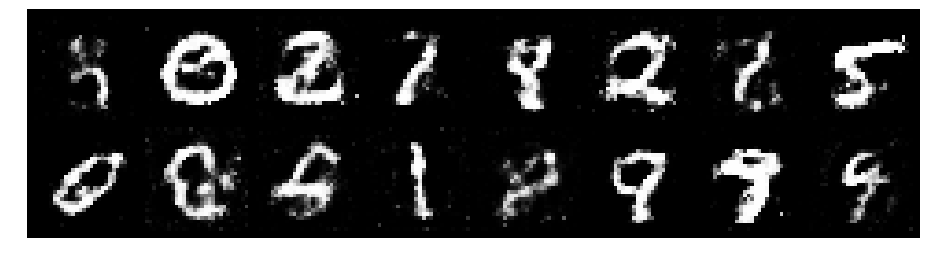

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.1603, Generator Loss: 1.1525
D(x): 0.5828, D(G(z)): 0.3962


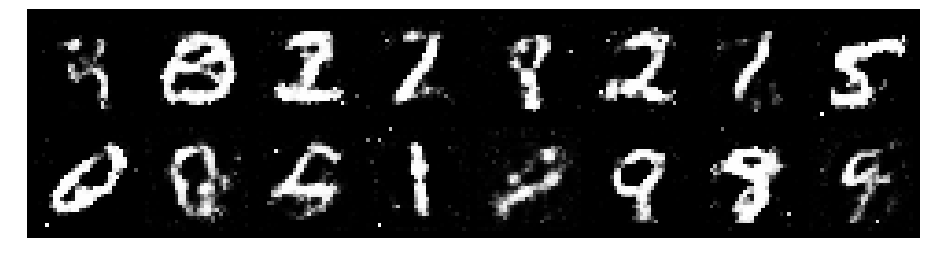

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2535, Generator Loss: 1.0148
D(x): 0.5892, D(G(z)): 0.4197


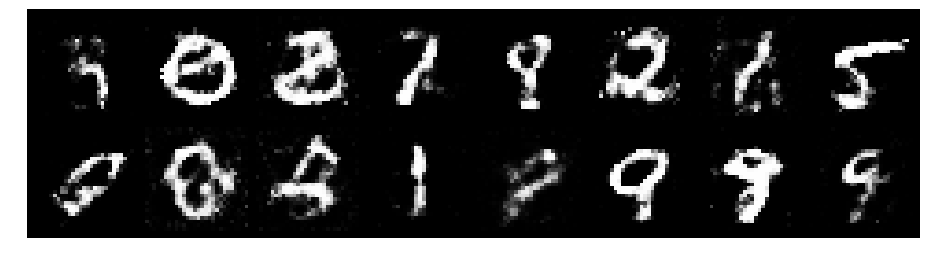

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2189, Generator Loss: 1.2466
D(x): 0.5804, D(G(z)): 0.4224


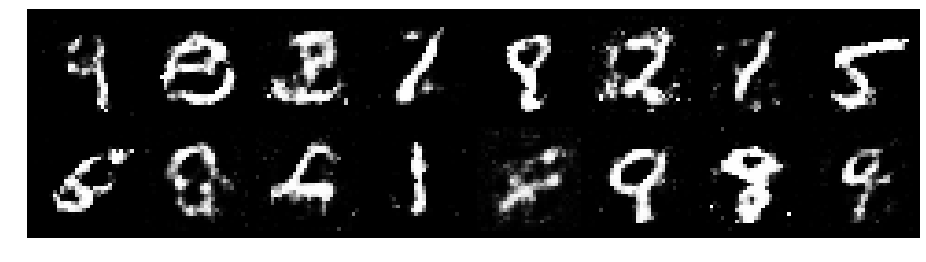

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1824, Generator Loss: 0.9532
D(x): 0.6000, D(G(z)): 0.4479


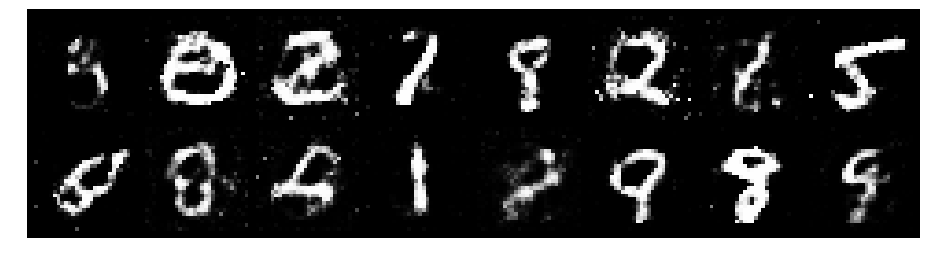

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2130, Generator Loss: 1.1387
D(x): 0.6053, D(G(z)): 0.4143


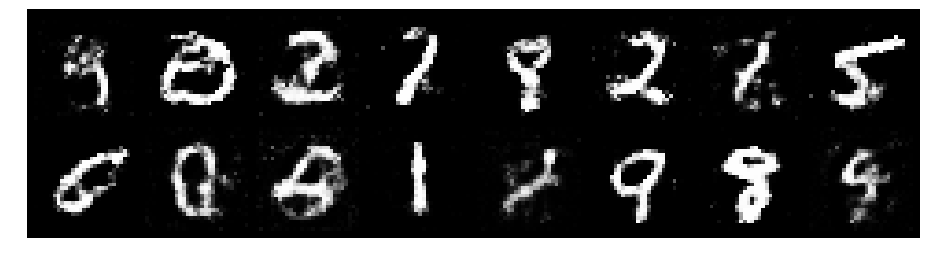

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.3901, Generator Loss: 0.9309
D(x): 0.6221, D(G(z)): 0.4818


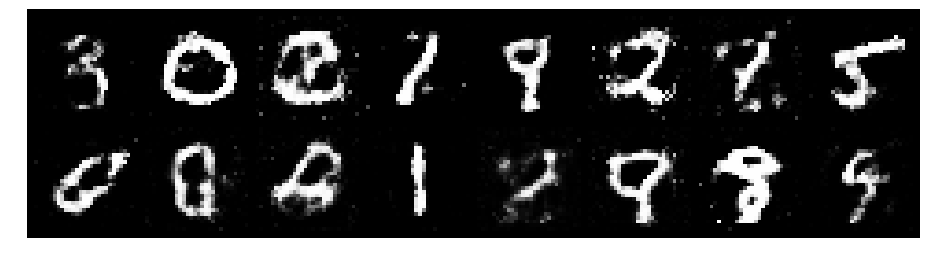

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.1517, Generator Loss: 1.0938
D(x): 0.6153, D(G(z)): 0.4079


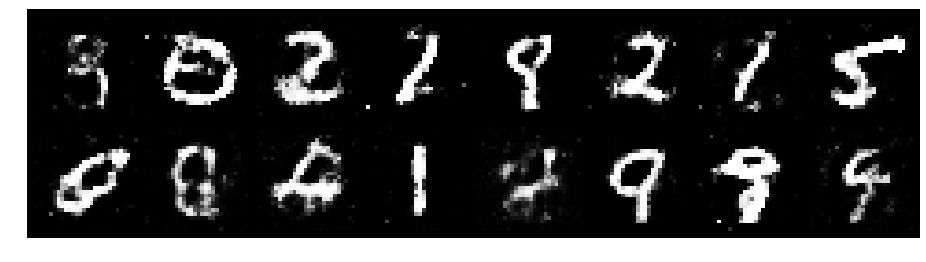

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2196, Generator Loss: 1.0051
D(x): 0.6007, D(G(z)): 0.4436


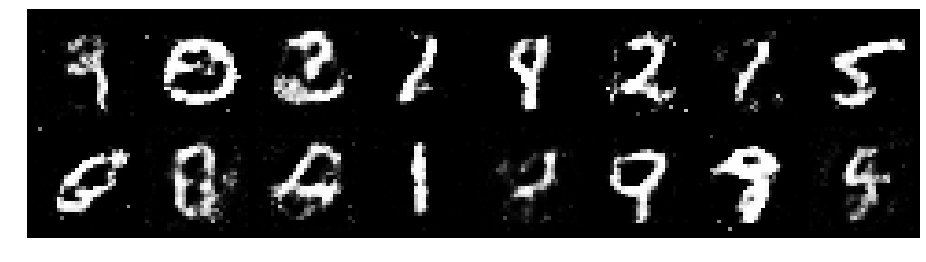

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.2905, Generator Loss: 0.9938
D(x): 0.6064, D(G(z)): 0.4848


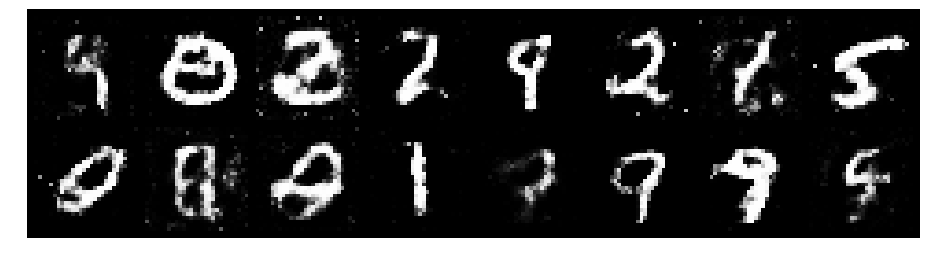

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2991, Generator Loss: 0.8462
D(x): 0.6007, D(G(z)): 0.4973


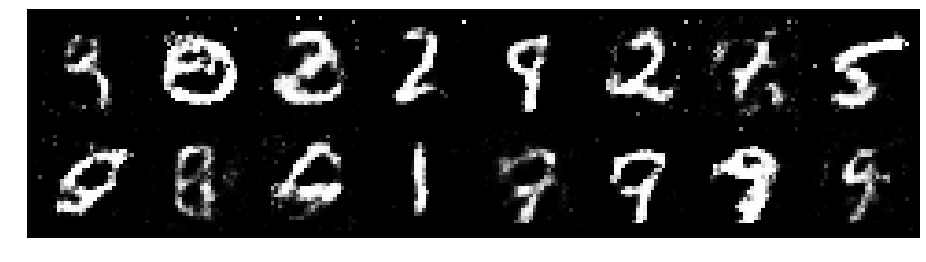

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.1712, Generator Loss: 0.8807
D(x): 0.6111, D(G(z)): 0.4212


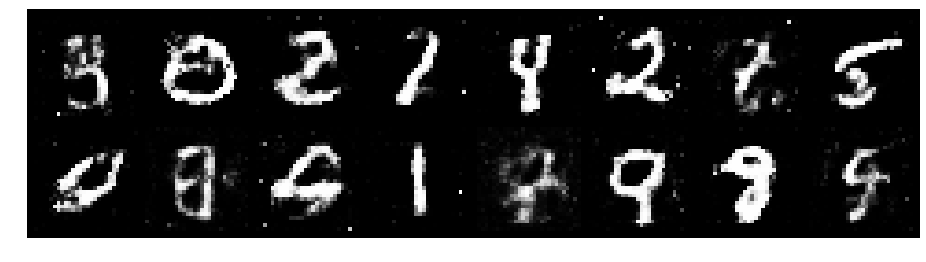

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.2012, Generator Loss: 1.0833
D(x): 0.5989, D(G(z)): 0.4219


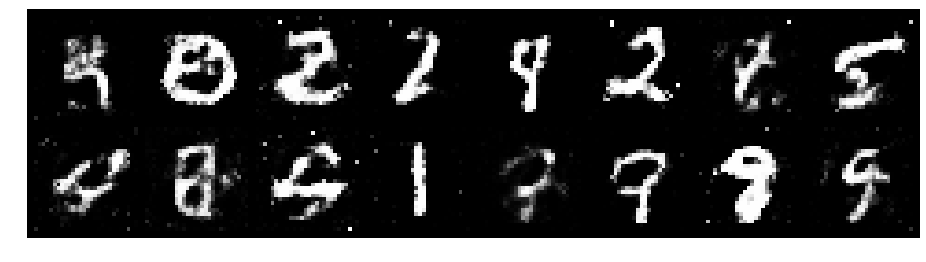

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2983, Generator Loss: 0.9098
D(x): 0.6045, D(G(z)): 0.4785


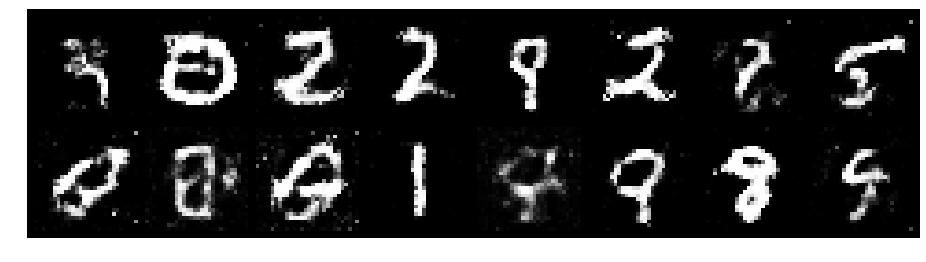

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.3642, Generator Loss: 0.8832
D(x): 0.5390, D(G(z)): 0.4549


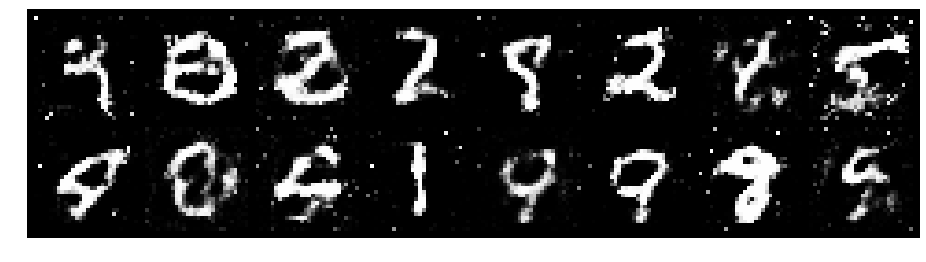

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.4601, Generator Loss: 0.8390
D(x): 0.5106, D(G(z)): 0.4498


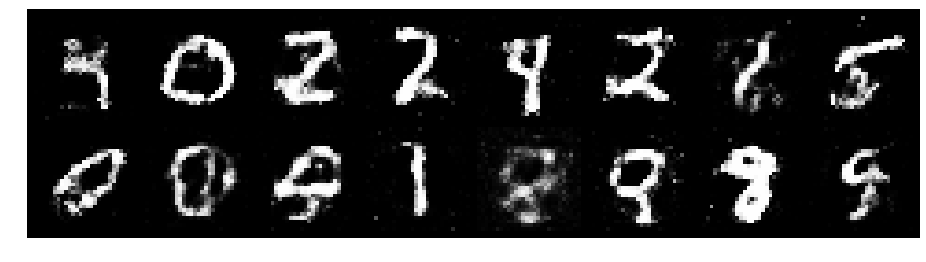

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2415, Generator Loss: 0.9637
D(x): 0.5286, D(G(z)): 0.4018


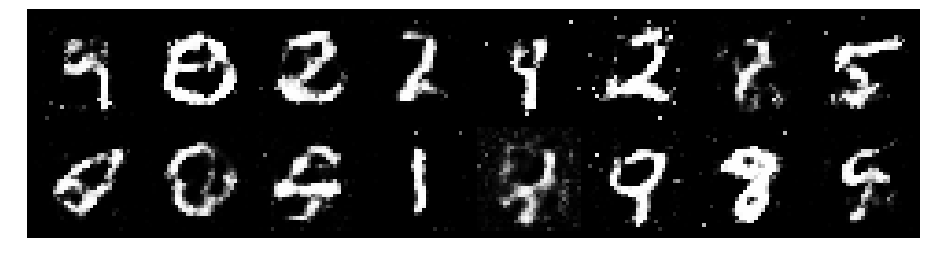

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2338, Generator Loss: 0.8885
D(x): 0.5670, D(G(z)): 0.4312


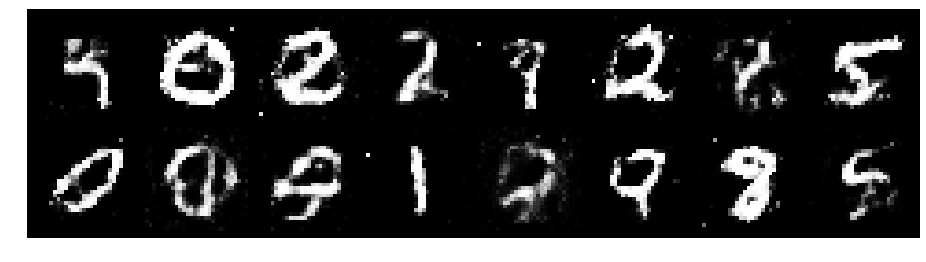

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2394, Generator Loss: 0.8852
D(x): 0.5832, D(G(z)): 0.4274


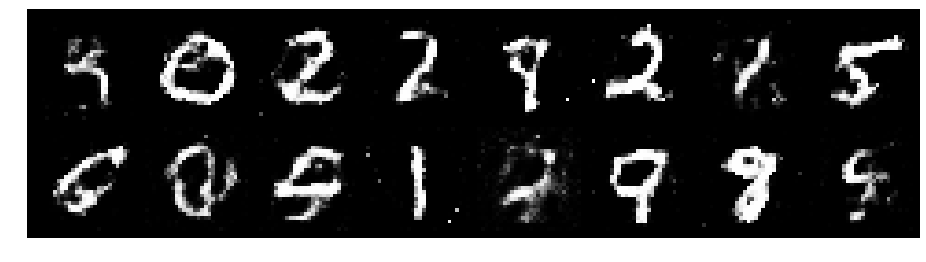

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.3220, Generator Loss: 1.0473
D(x): 0.5757, D(G(z)): 0.4540


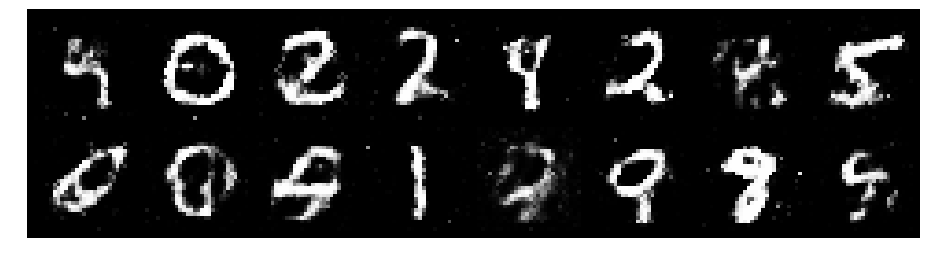

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.3933, Generator Loss: 1.0250
D(x): 0.5525, D(G(z)): 0.4496


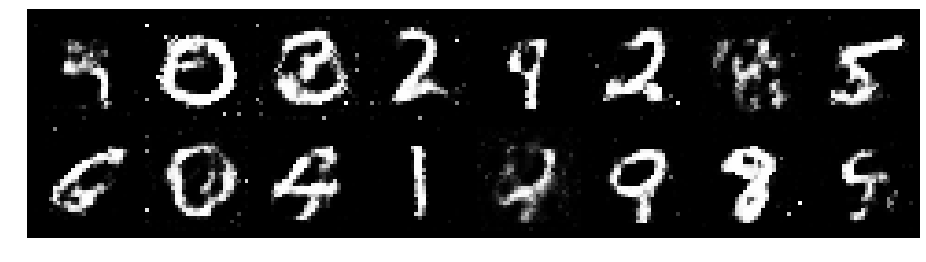

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.1471, Generator Loss: 1.1030
D(x): 0.5943, D(G(z)): 0.4004


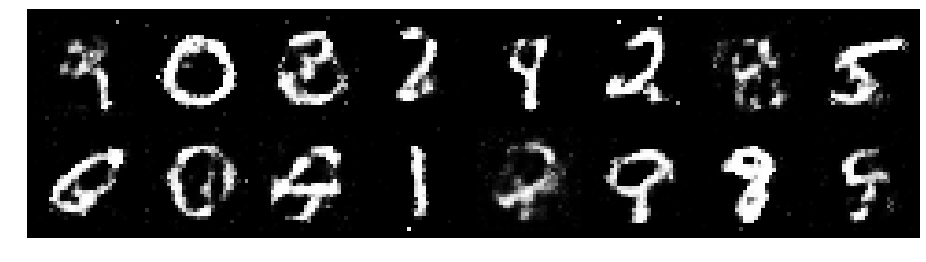

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.1654, Generator Loss: 0.9769
D(x): 0.5794, D(G(z)): 0.4164


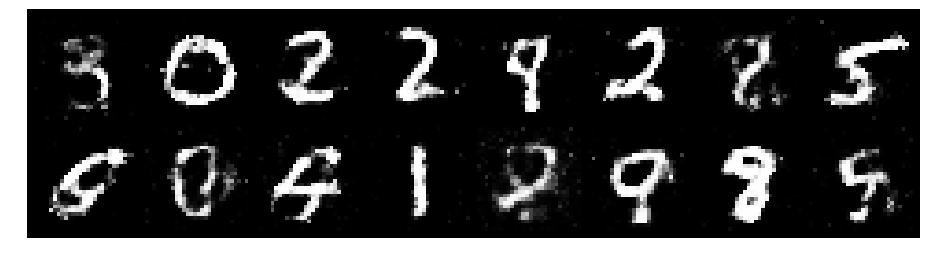

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2749, Generator Loss: 1.0442
D(x): 0.5743, D(G(z)): 0.4438


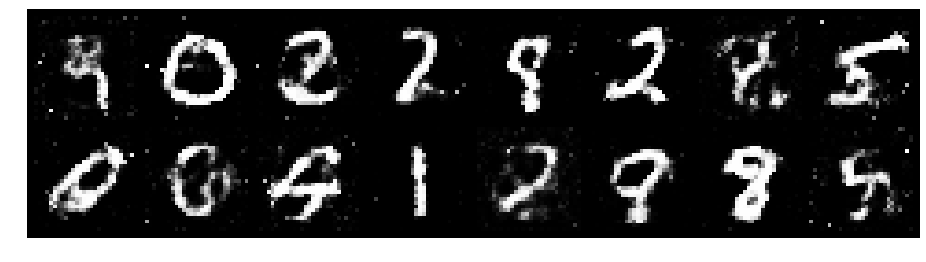

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2836, Generator Loss: 1.0356
D(x): 0.6077, D(G(z)): 0.4651


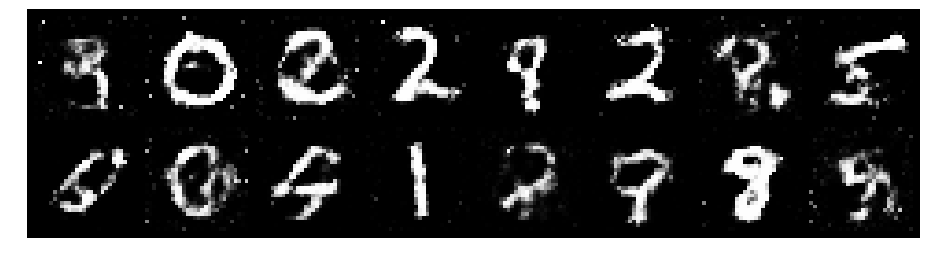

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.3273, Generator Loss: 0.9490
D(x): 0.5626, D(G(z)): 0.4597


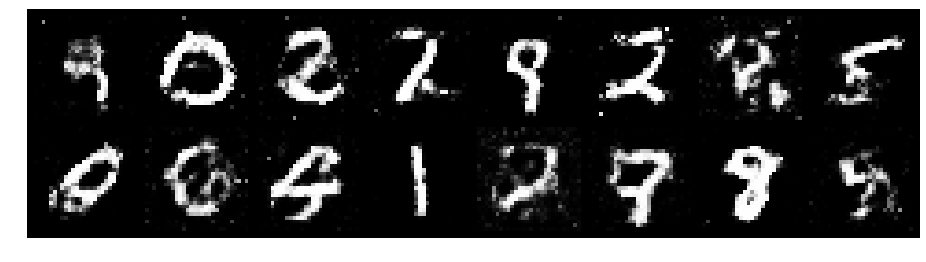

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.3085, Generator Loss: 0.8627
D(x): 0.5837, D(G(z)): 0.4423


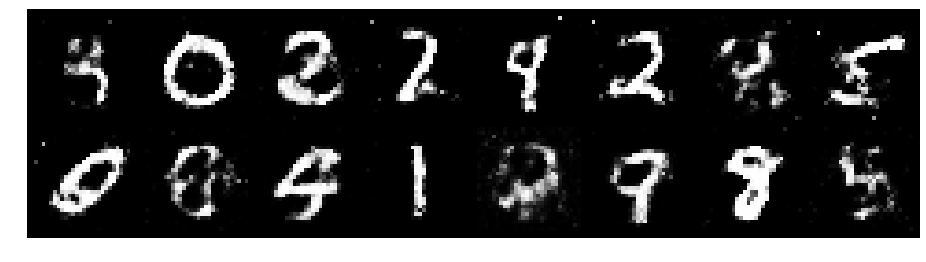

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2197, Generator Loss: 0.8780
D(x): 0.6123, D(G(z)): 0.4262


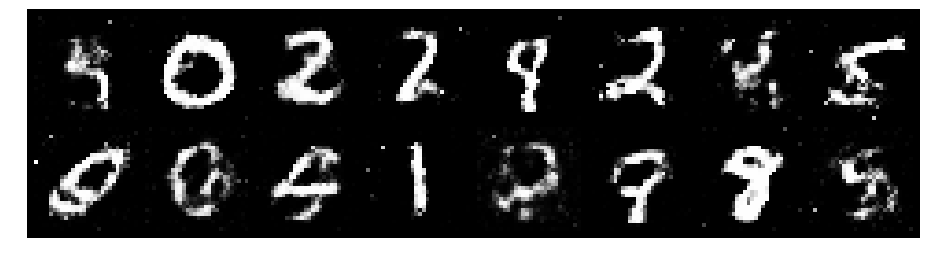

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.2605, Generator Loss: 0.7970
D(x): 0.5993, D(G(z)): 0.4649


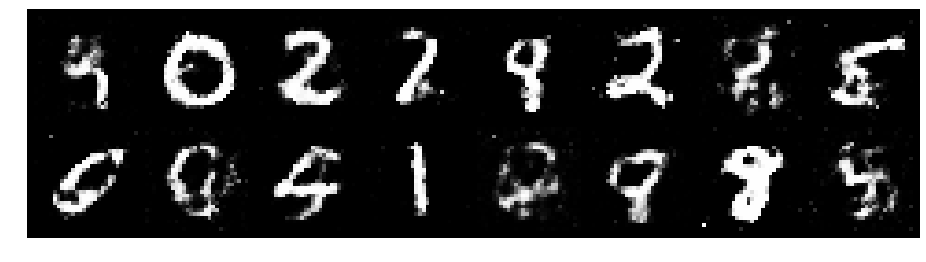

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.1644, Generator Loss: 1.0820
D(x): 0.5995, D(G(z)): 0.4188


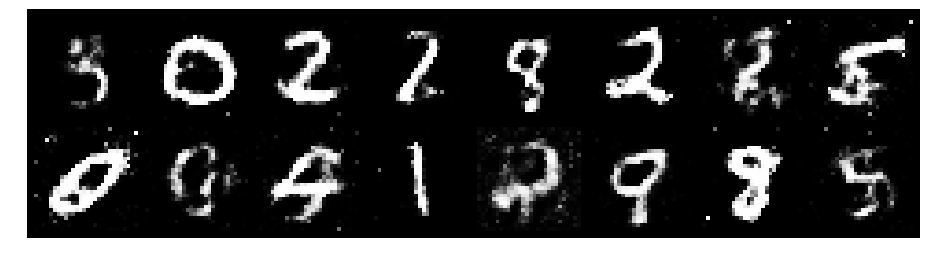

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.2085, Generator Loss: 1.0841
D(x): 0.5858, D(G(z)): 0.4065


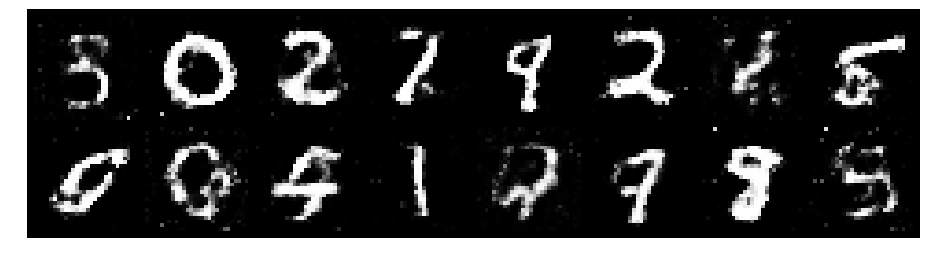

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2638, Generator Loss: 1.0881
D(x): 0.5715, D(G(z)): 0.4037


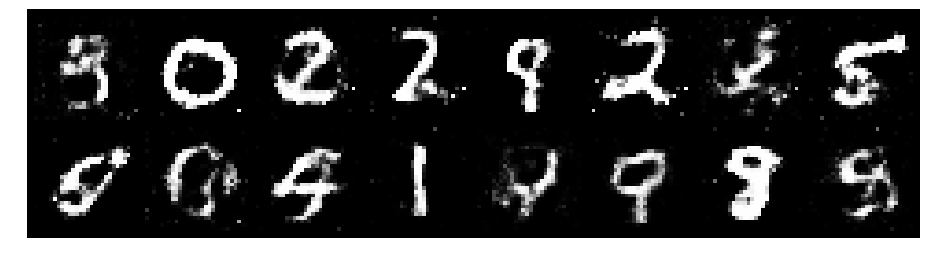

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2578, Generator Loss: 0.9917
D(x): 0.5592, D(G(z)): 0.4330


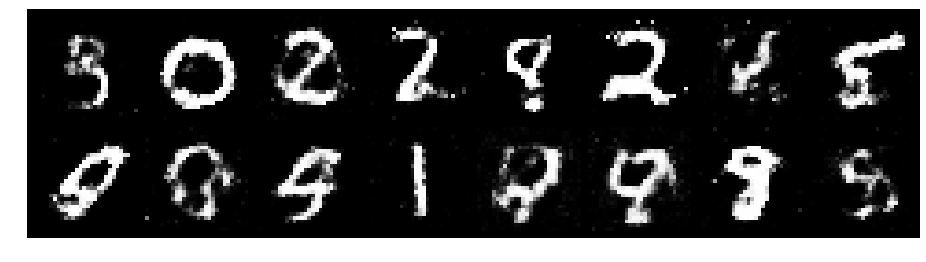

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.1794, Generator Loss: 0.9202
D(x): 0.5820, D(G(z)): 0.4312


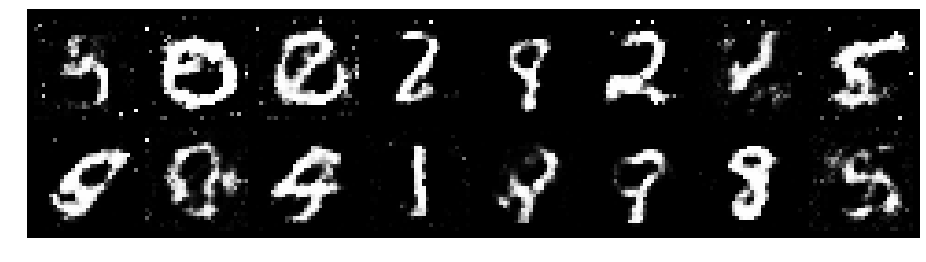

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2562, Generator Loss: 0.7696
D(x): 0.5750, D(G(z)): 0.4685


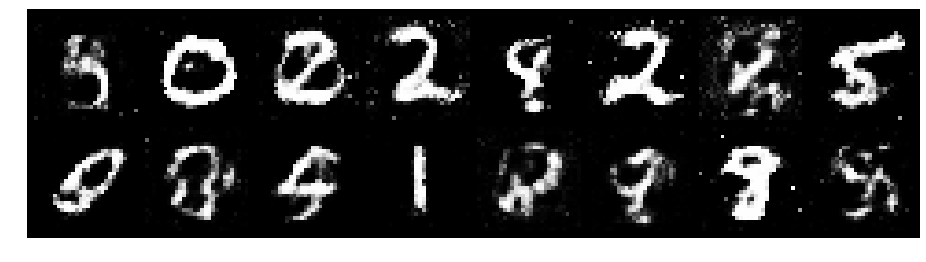

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.1288, Generator Loss: 0.9324
D(x): 0.5979, D(G(z)): 0.4155


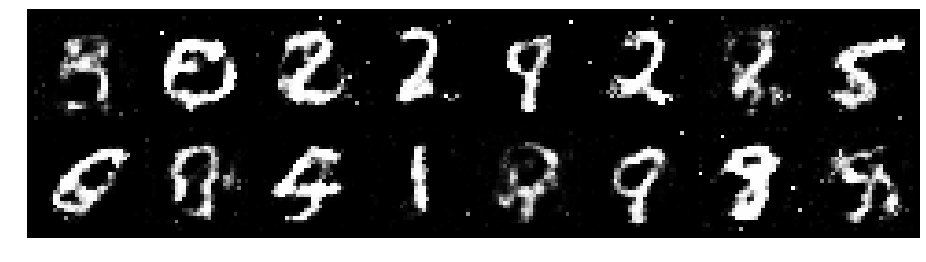

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2605, Generator Loss: 0.9728
D(x): 0.5644, D(G(z)): 0.4499


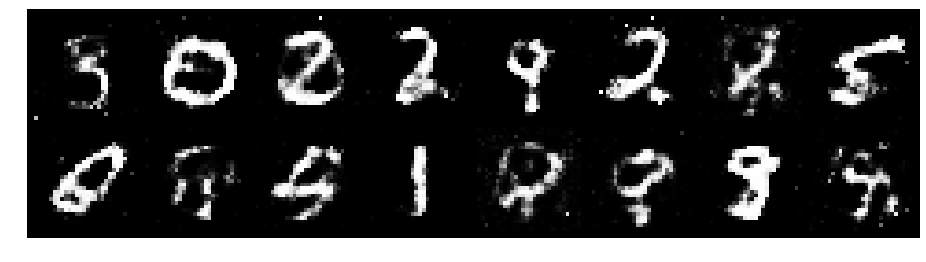

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.3329, Generator Loss: 0.9059
D(x): 0.5520, D(G(z)): 0.4653


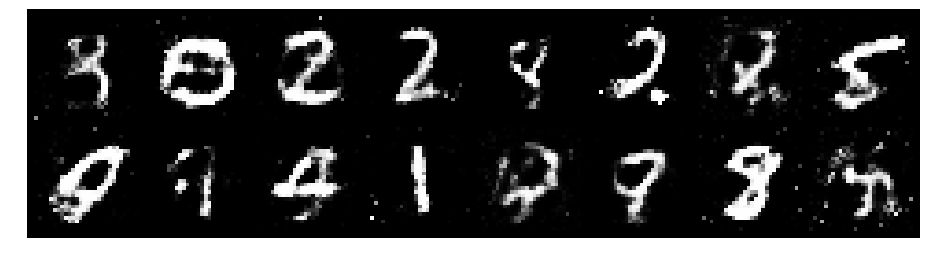

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2080, Generator Loss: 0.9187
D(x): 0.5795, D(G(z)): 0.4056


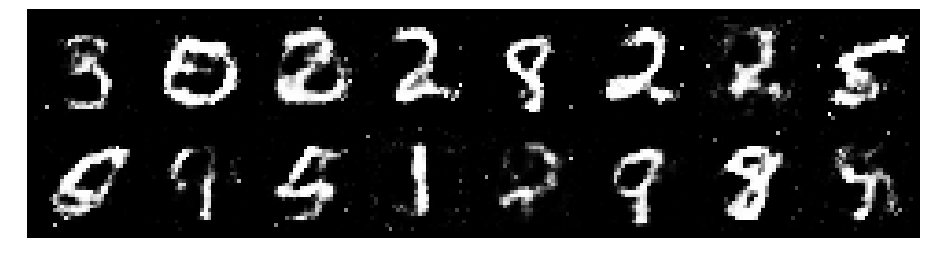

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2002, Generator Loss: 0.8910
D(x): 0.6072, D(G(z)): 0.4339


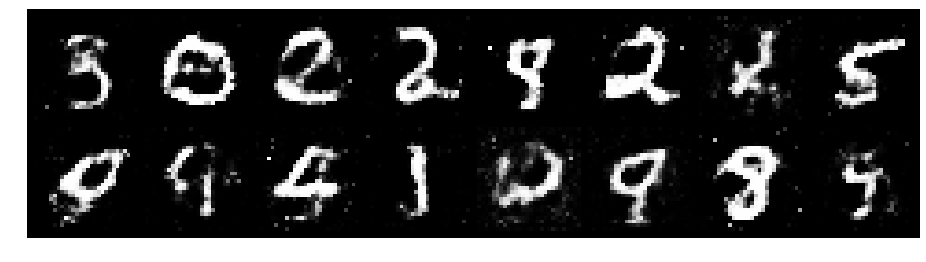

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.2612, Generator Loss: 1.1186
D(x): 0.5963, D(G(z)): 0.4423


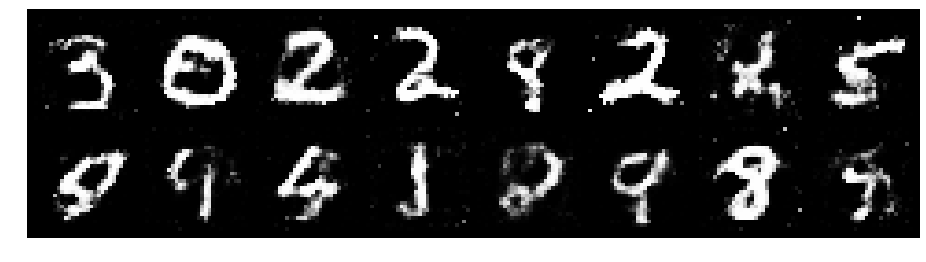

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.0295, Generator Loss: 1.1999
D(x): 0.6363, D(G(z)): 0.3664


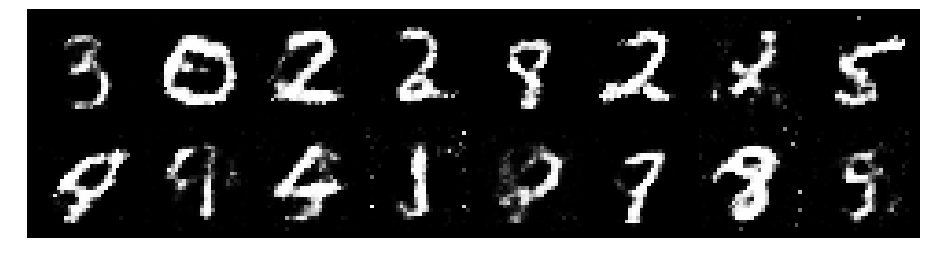

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2700, Generator Loss: 0.8759
D(x): 0.5620, D(G(z)): 0.4351


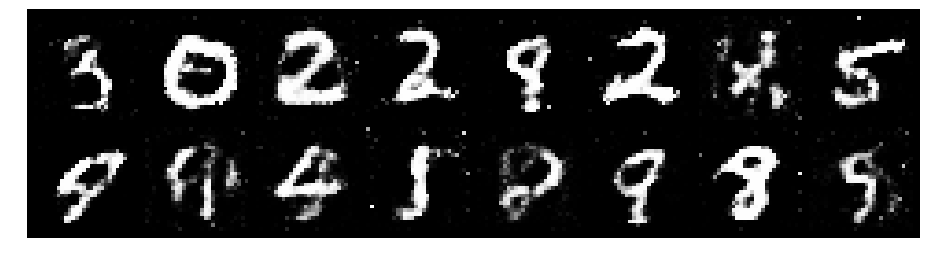

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.4138, Generator Loss: 0.7381
D(x): 0.5638, D(G(z)): 0.5054


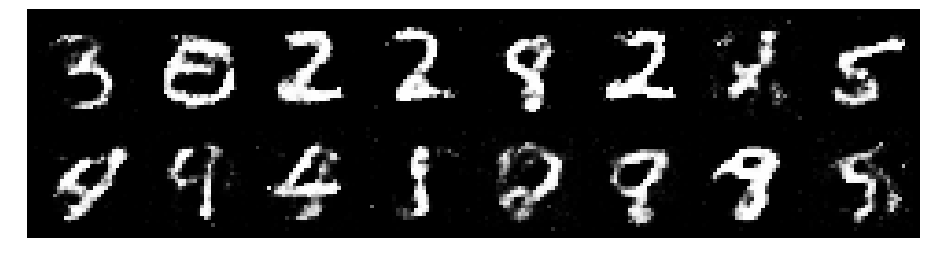

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.1628, Generator Loss: 1.1776
D(x): 0.5349, D(G(z)): 0.3296


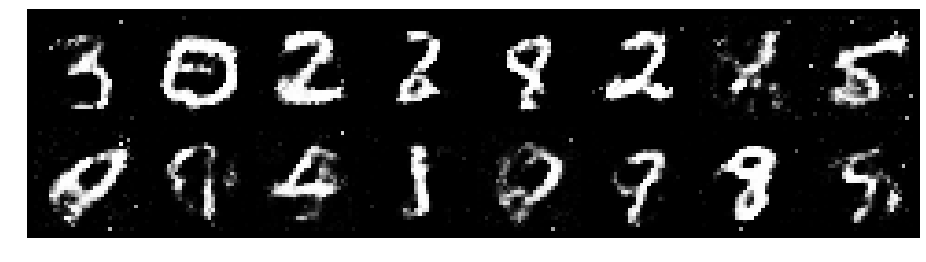

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2527, Generator Loss: 0.8381
D(x): 0.5573, D(G(z)): 0.4476


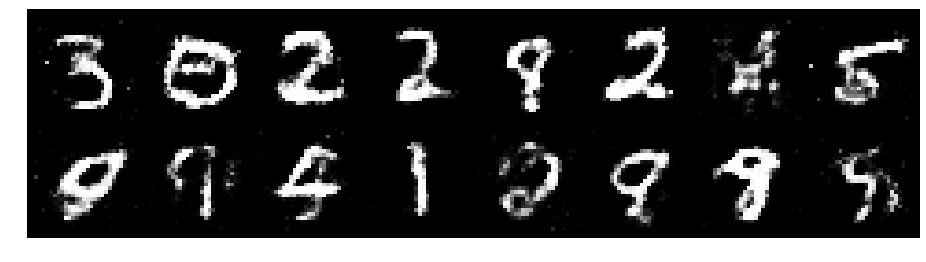

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.1788, Generator Loss: 1.1664
D(x): 0.5333, D(G(z)): 0.3597


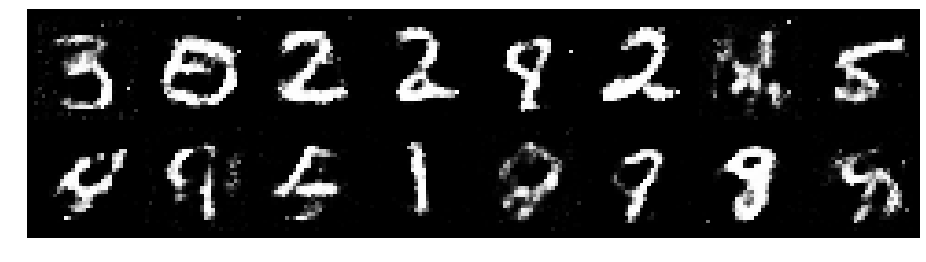

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.0882, Generator Loss: 0.8853
D(x): 0.6227, D(G(z)): 0.4137


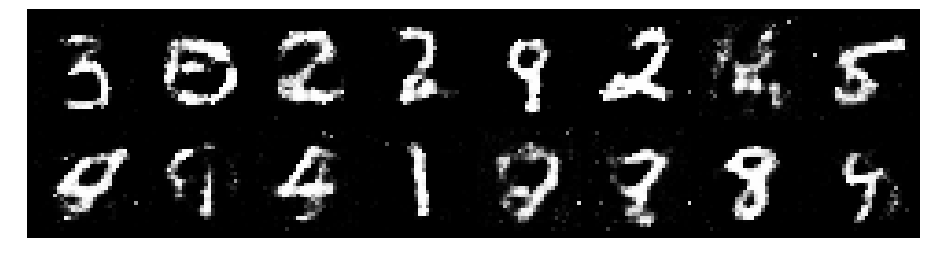

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2228, Generator Loss: 0.8889
D(x): 0.6088, D(G(z)): 0.4656


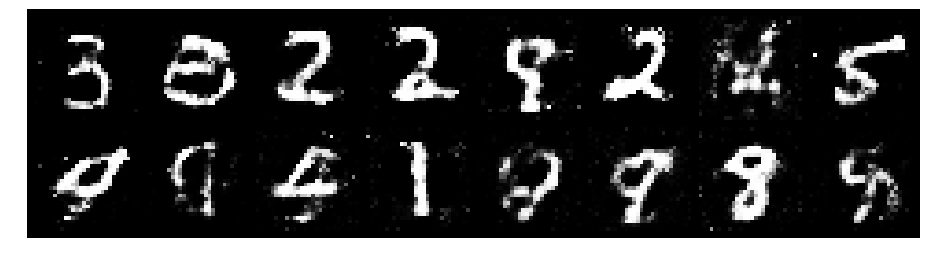

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.1391, Generator Loss: 0.9486
D(x): 0.5785, D(G(z)): 0.3829


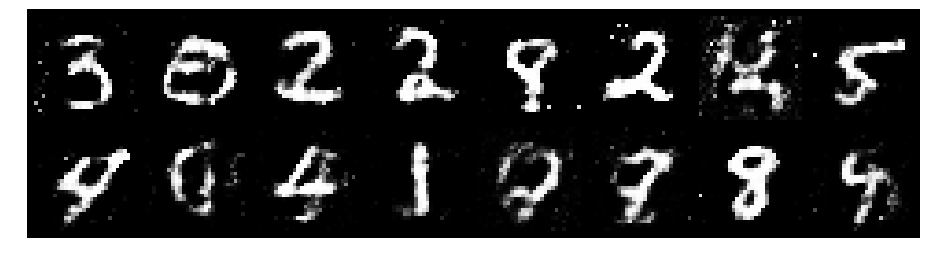

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2407, Generator Loss: 0.9388
D(x): 0.5693, D(G(z)): 0.4406


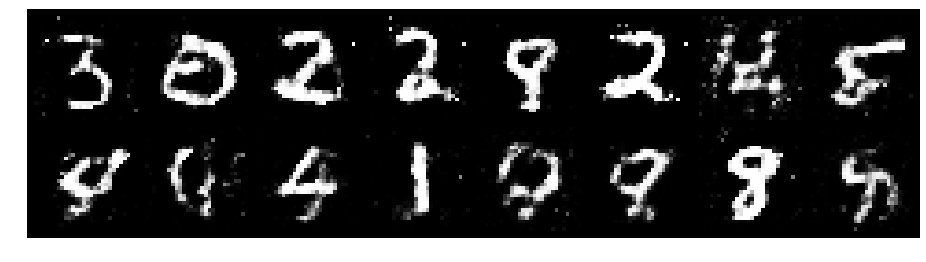

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.2988, Generator Loss: 0.9137
D(x): 0.5495, D(G(z)): 0.4277


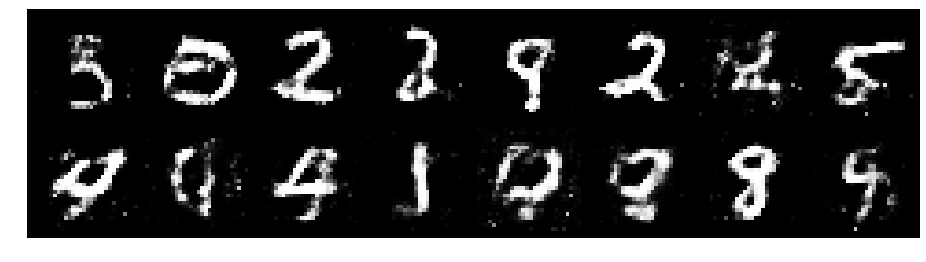

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2412, Generator Loss: 0.9434
D(x): 0.5628, D(G(z)): 0.4142


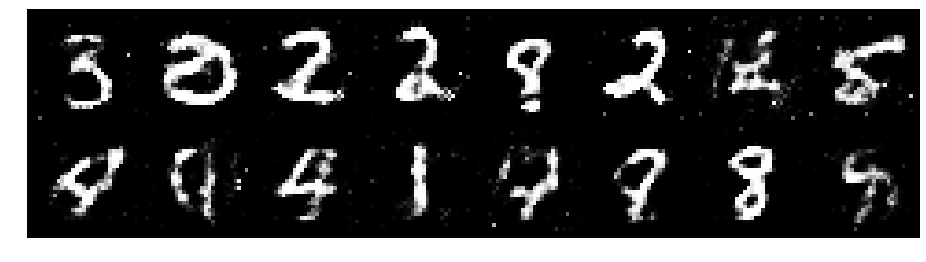

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.3531, Generator Loss: 0.9537
D(x): 0.5276, D(G(z)): 0.4358


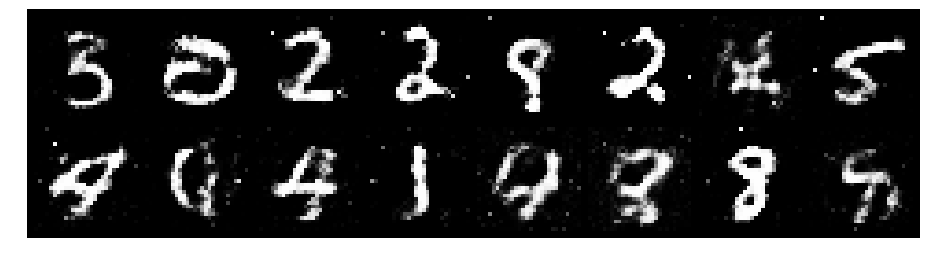

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.1806, Generator Loss: 1.1853
D(x): 0.5702, D(G(z)): 0.3651


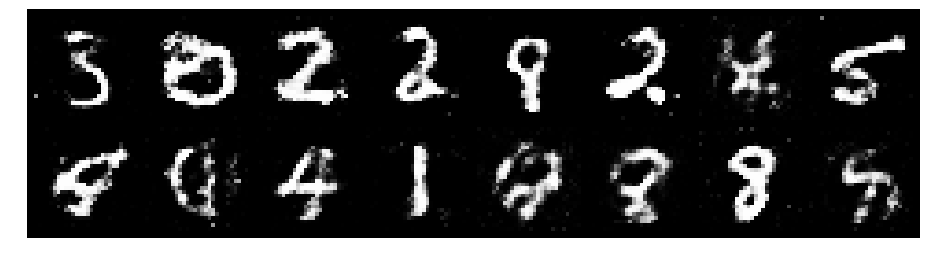

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2153, Generator Loss: 1.0129
D(x): 0.5340, D(G(z)): 0.3988


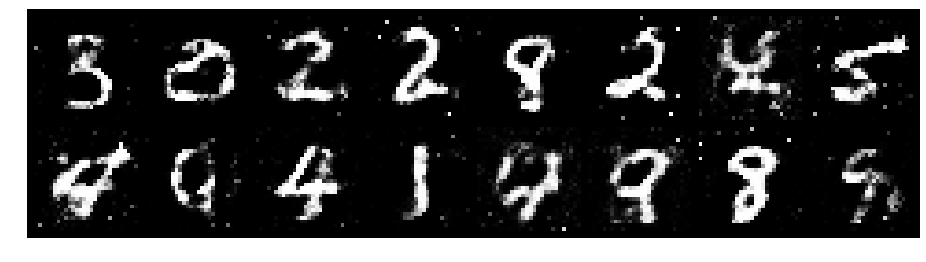

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2200, Generator Loss: 0.9712
D(x): 0.5560, D(G(z)): 0.4308


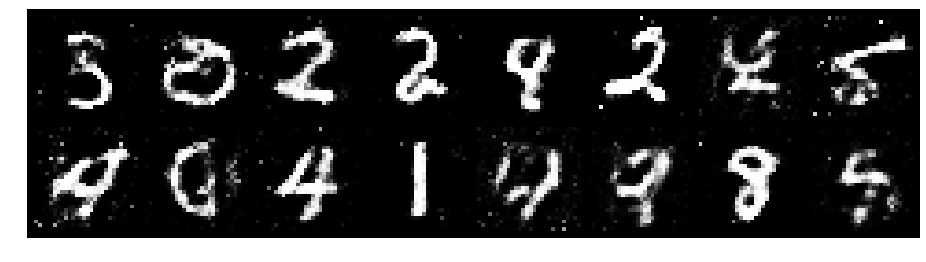

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2793, Generator Loss: 1.0120
D(x): 0.5894, D(G(z)): 0.4472


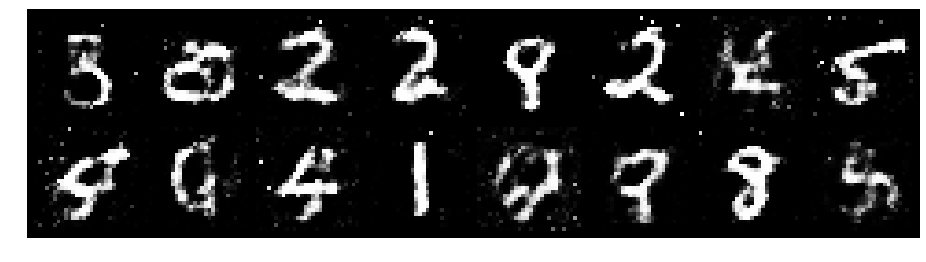

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.0703, Generator Loss: 1.3584
D(x): 0.6026, D(G(z)): 0.3507


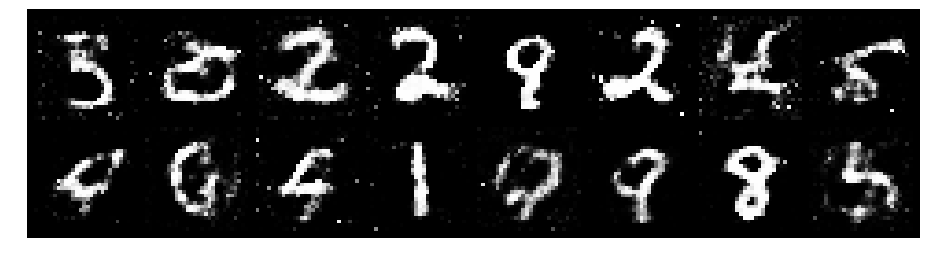

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.1646, Generator Loss: 1.0827
D(x): 0.6148, D(G(z)): 0.4354


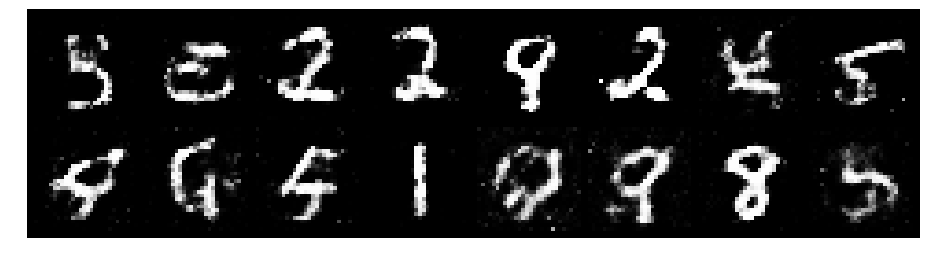

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.1620, Generator Loss: 1.2565
D(x): 0.5877, D(G(z)): 0.3877


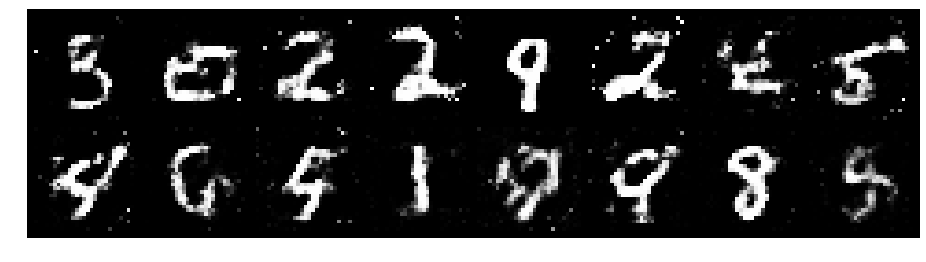

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.1486, Generator Loss: 1.1882
D(x): 0.5962, D(G(z)): 0.3973


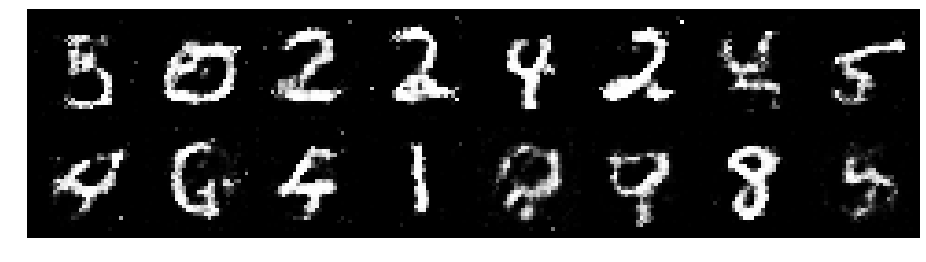

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.1325, Generator Loss: 0.9066
D(x): 0.5893, D(G(z)): 0.4077


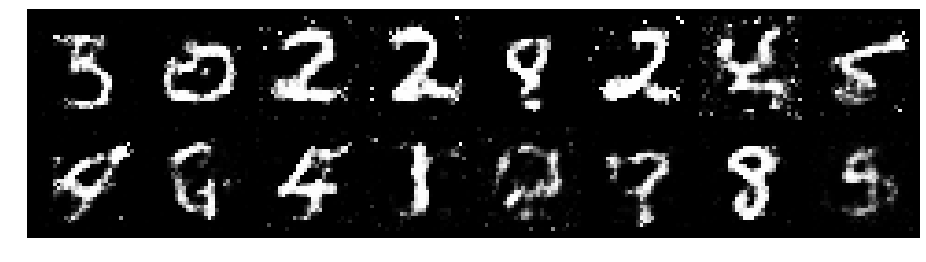

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.3545, Generator Loss: 0.8838
D(x): 0.5646, D(G(z)): 0.4765


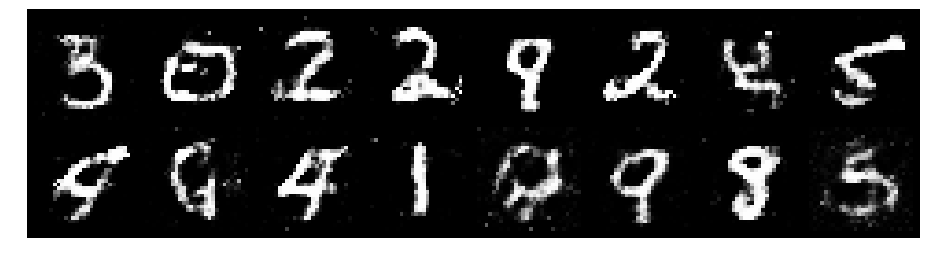

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.4104, Generator Loss: 0.9134
D(x): 0.5203, D(G(z)): 0.4519


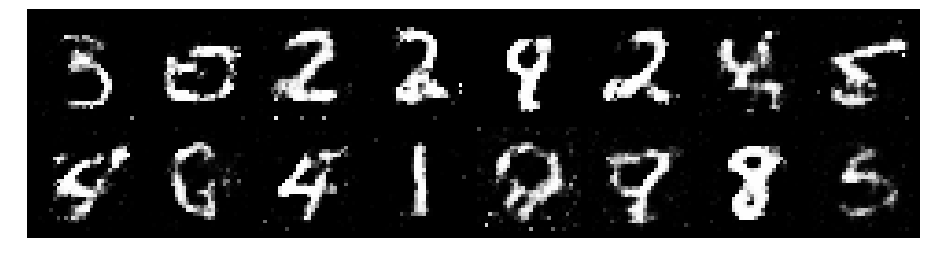

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.3423, Generator Loss: 1.1336
D(x): 0.5446, D(G(z)): 0.4044


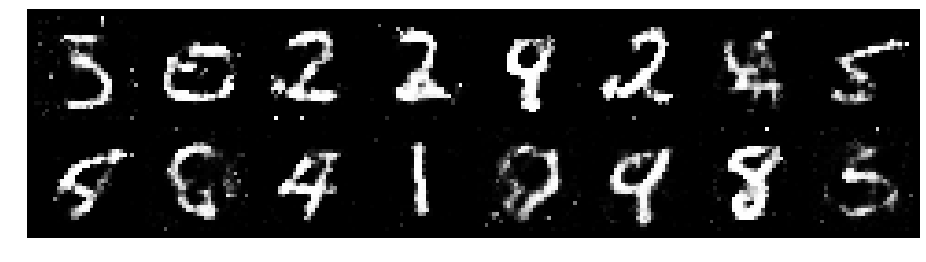

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2550, Generator Loss: 1.2383
D(x): 0.5702, D(G(z)): 0.3770


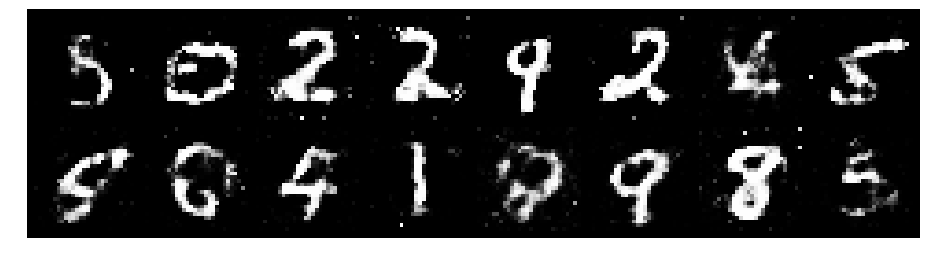

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.1218, Generator Loss: 0.9863
D(x): 0.5692, D(G(z)): 0.3656


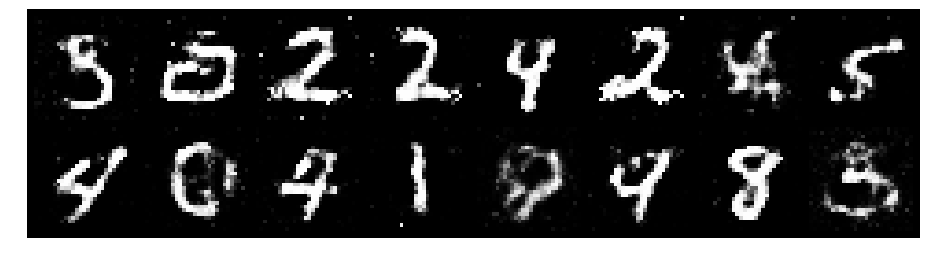

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.1572, Generator Loss: 1.0441
D(x): 0.5874, D(G(z)): 0.3801


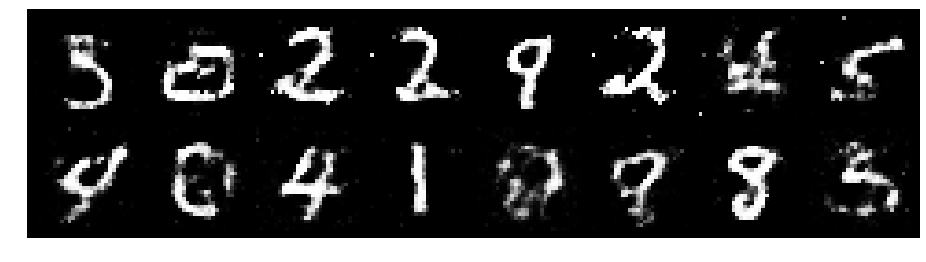

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2102, Generator Loss: 0.9908
D(x): 0.5690, D(G(z)): 0.4086


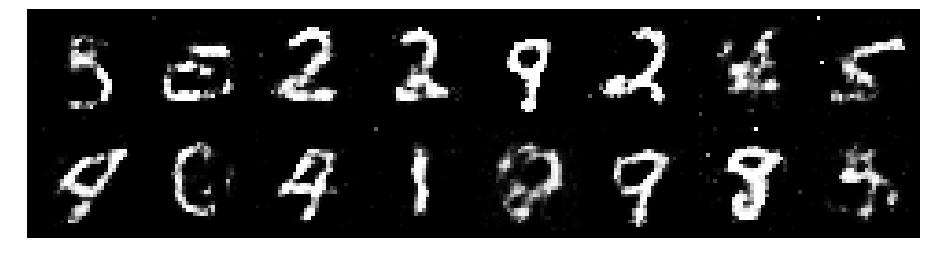

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2861, Generator Loss: 0.9074
D(x): 0.5514, D(G(z)): 0.4476


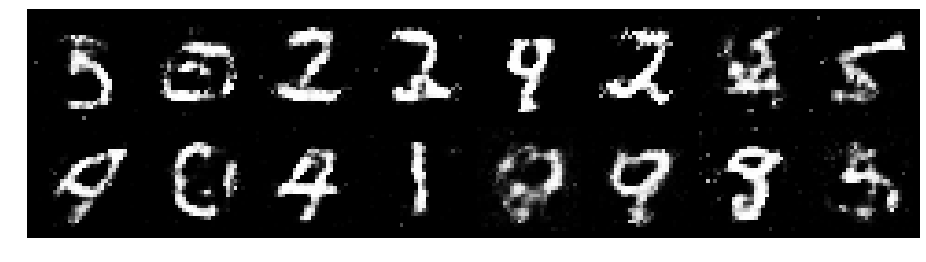

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2633, Generator Loss: 0.9772
D(x): 0.5177, D(G(z)): 0.4015


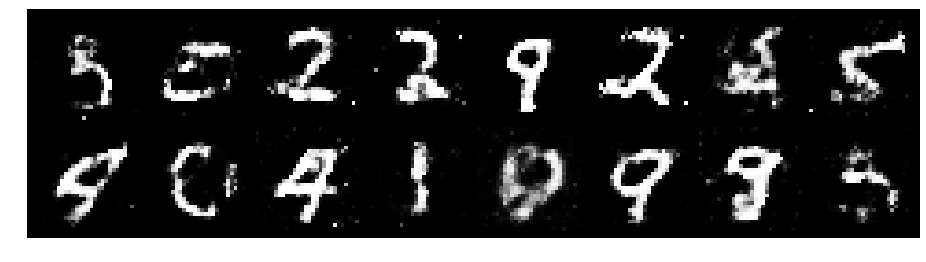

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.1972, Generator Loss: 0.8547
D(x): 0.5836, D(G(z)): 0.4358


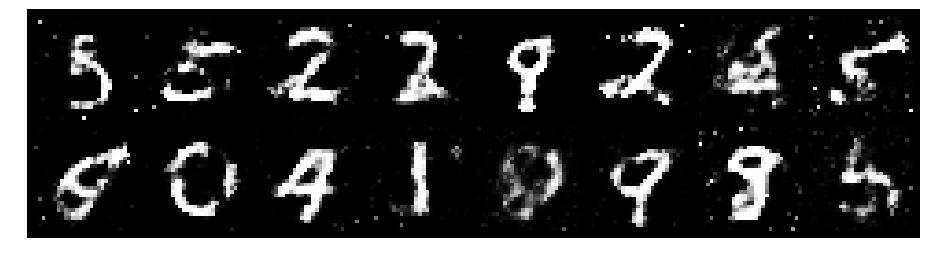

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2622, Generator Loss: 0.9473
D(x): 0.5562, D(G(z)): 0.4326


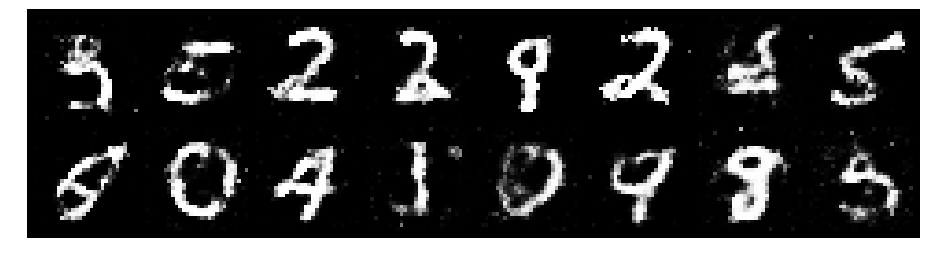

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.3297, Generator Loss: 0.7982
D(x): 0.5463, D(G(z)): 0.4721


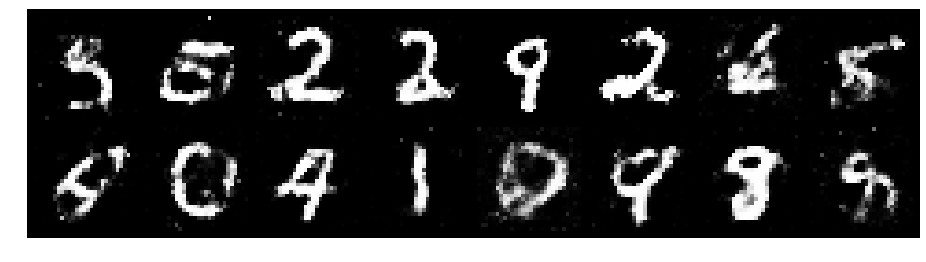

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.3577, Generator Loss: 0.7282
D(x): 0.5718, D(G(z)): 0.4889


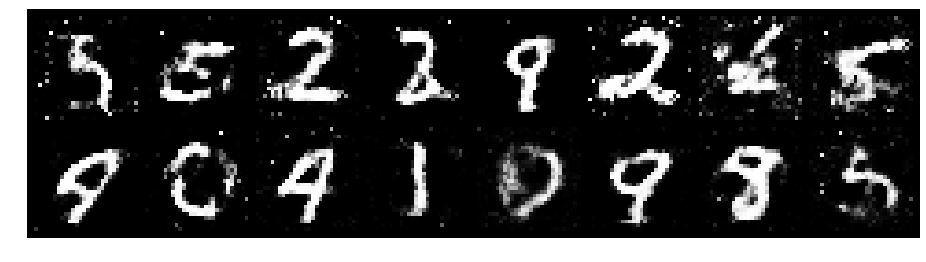

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.1971, Generator Loss: 0.9677
D(x): 0.5701, D(G(z)): 0.4105


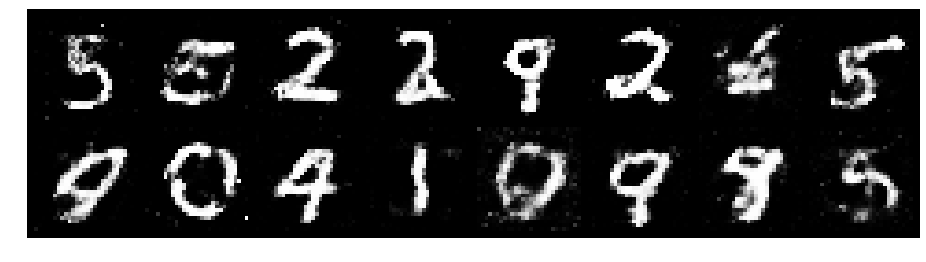

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.3028, Generator Loss: 0.8745
D(x): 0.5575, D(G(z)): 0.4558


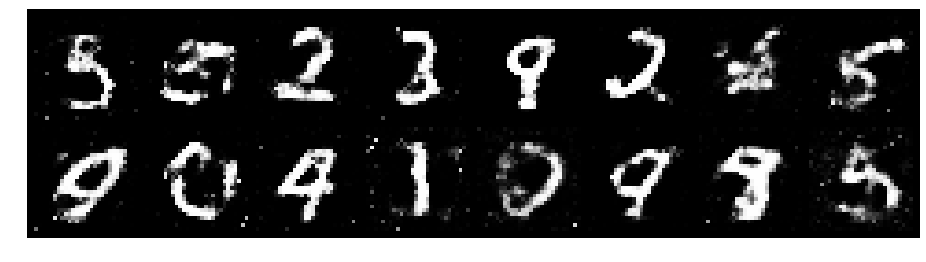

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.3353, Generator Loss: 0.8982
D(x): 0.5570, D(G(z)): 0.4692


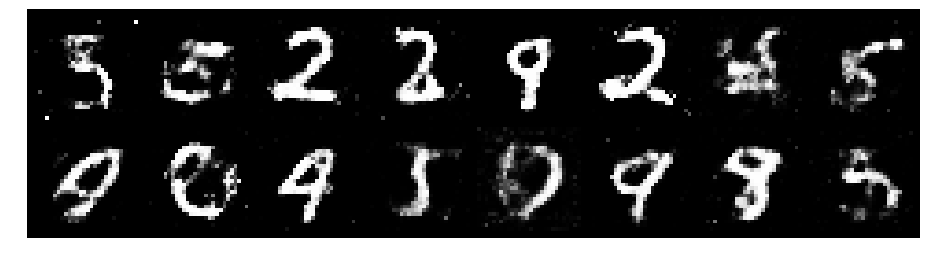

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.2842, Generator Loss: 0.8766
D(x): 0.5462, D(G(z)): 0.4389


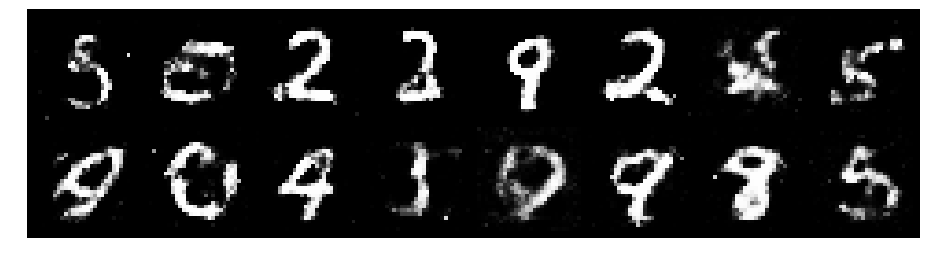

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2301, Generator Loss: 0.9862
D(x): 0.5797, D(G(z)): 0.4277


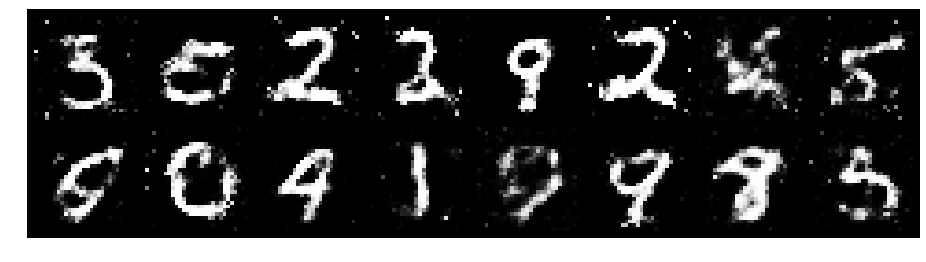

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2062, Generator Loss: 0.9848
D(x): 0.5994, D(G(z)): 0.4523


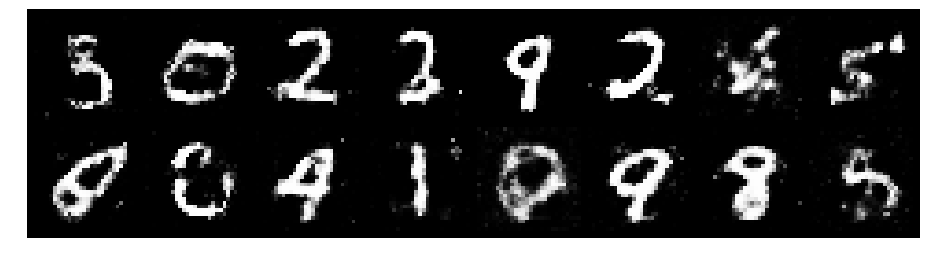

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2388, Generator Loss: 1.0108
D(x): 0.5511, D(G(z)): 0.4097


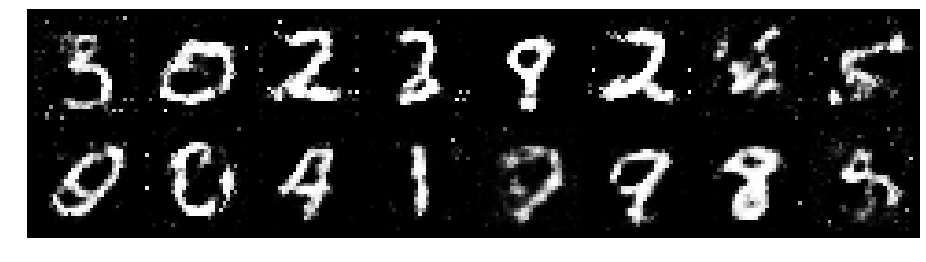

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2955, Generator Loss: 0.7457
D(x): 0.5757, D(G(z)): 0.4775


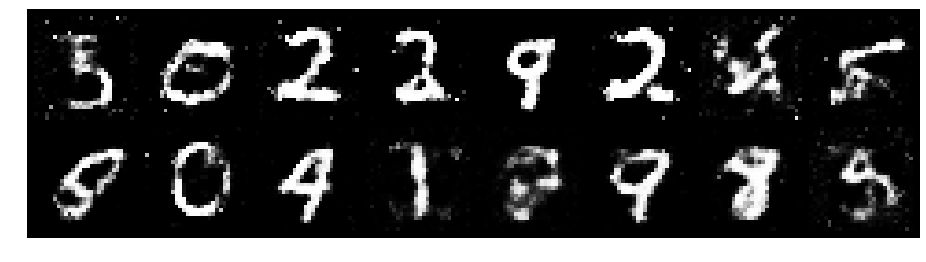

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.3053, Generator Loss: 0.9498
D(x): 0.5467, D(G(z)): 0.4670


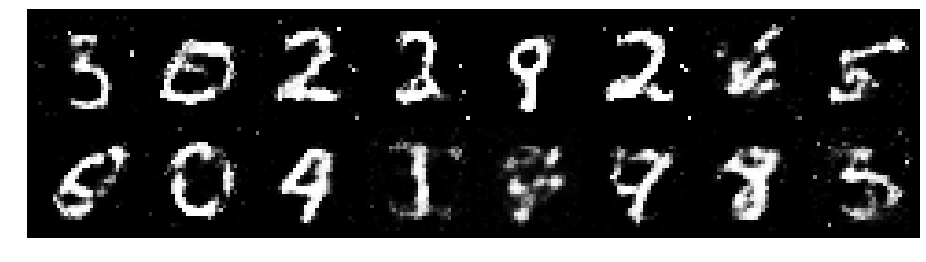

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.1931, Generator Loss: 0.9420
D(x): 0.5793, D(G(z)): 0.4297


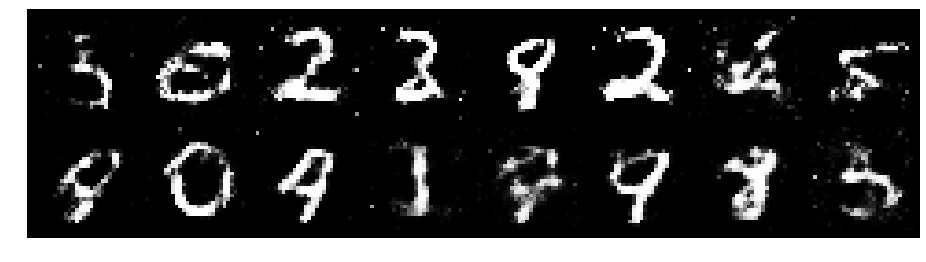

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2079, Generator Loss: 0.8558
D(x): 0.5775, D(G(z)): 0.4368


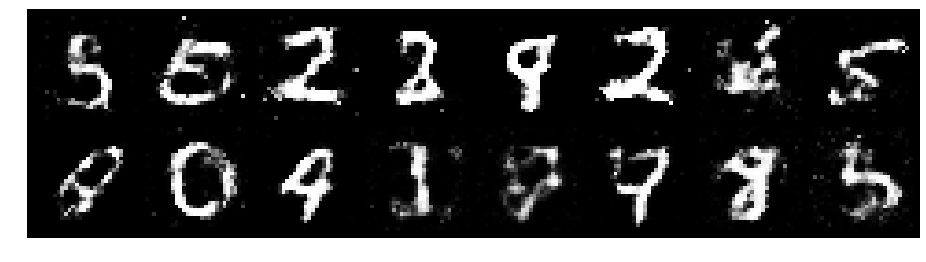

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.3651, Generator Loss: 0.7904
D(x): 0.5279, D(G(z)): 0.4741


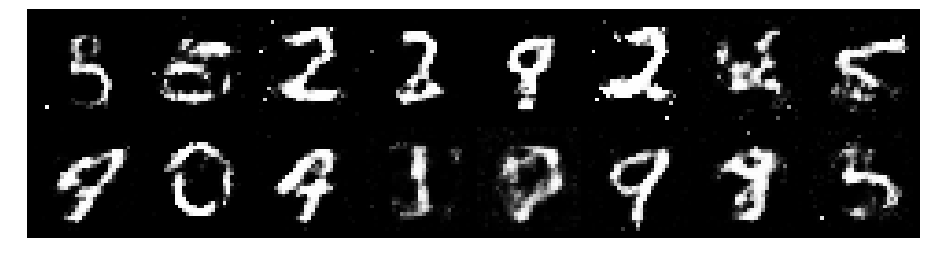

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.3308, Generator Loss: 1.1028
D(x): 0.5364, D(G(z)): 0.4137


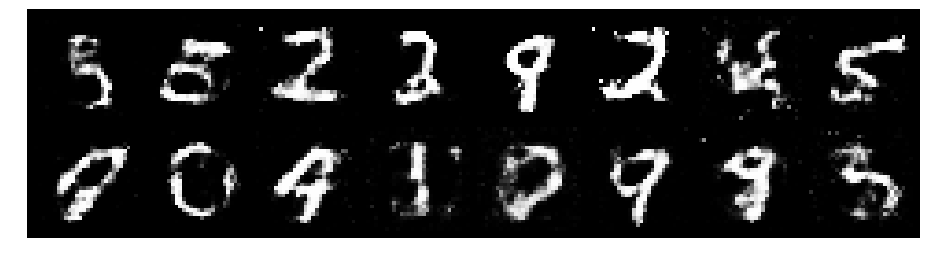

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.2276, Generator Loss: 0.9254
D(x): 0.6163, D(G(z)): 0.4472


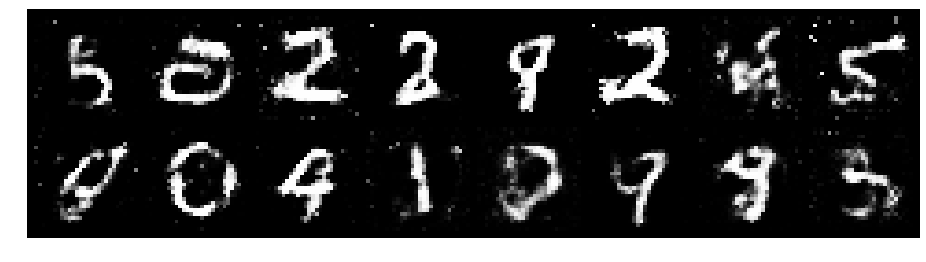

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.1881, Generator Loss: 1.0607
D(x): 0.5916, D(G(z)): 0.4036


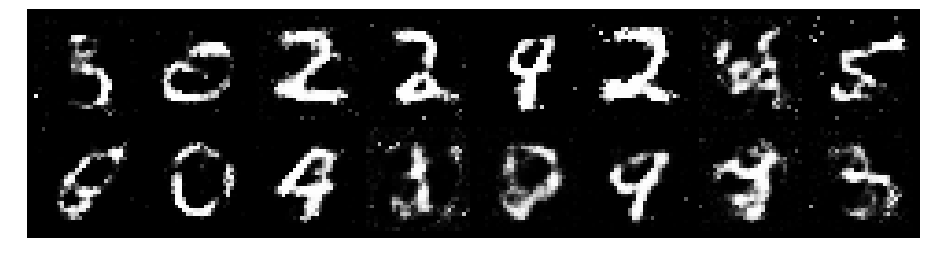

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2181, Generator Loss: 0.9210
D(x): 0.5727, D(G(z)): 0.4155


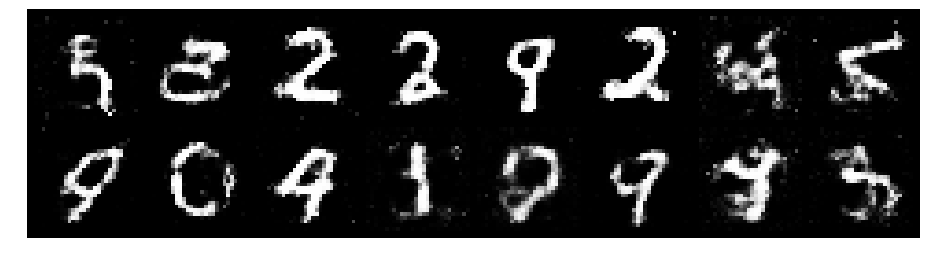

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1542, Generator Loss: 1.0747
D(x): 0.6420, D(G(z)): 0.4415


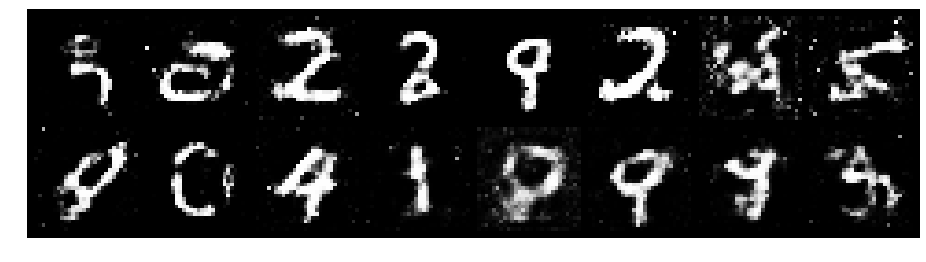

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.3224, Generator Loss: 0.8605
D(x): 0.5785, D(G(z)): 0.4826


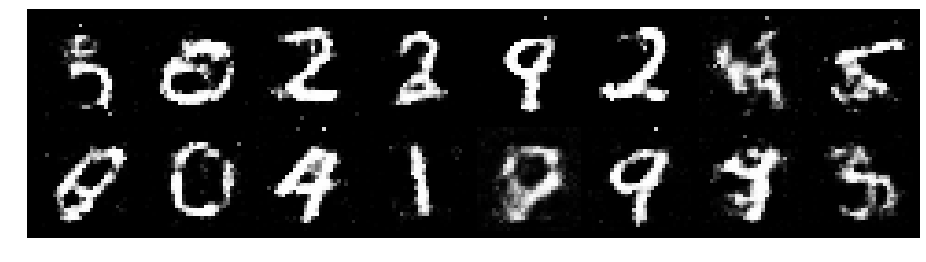

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.1903, Generator Loss: 0.9258
D(x): 0.5613, D(G(z)): 0.3983


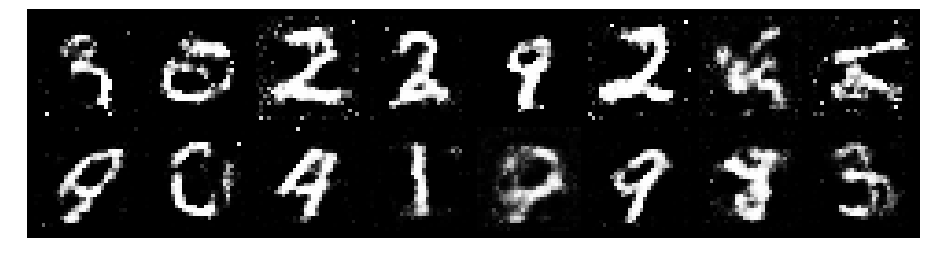

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.2126, Generator Loss: 0.9535
D(x): 0.5523, D(G(z)): 0.4260


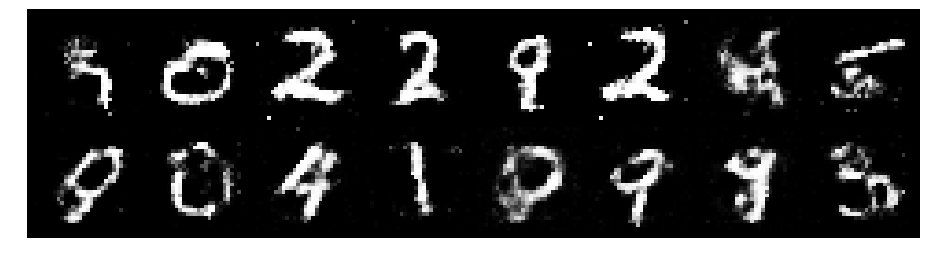

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2398, Generator Loss: 0.8436
D(x): 0.5938, D(G(z)): 0.4723


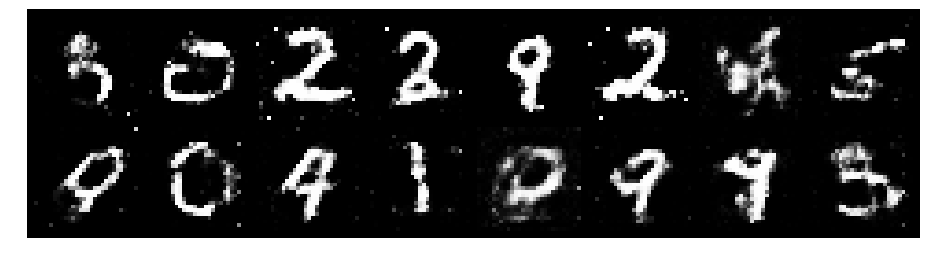

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2599, Generator Loss: 1.0049
D(x): 0.5485, D(G(z)): 0.4300


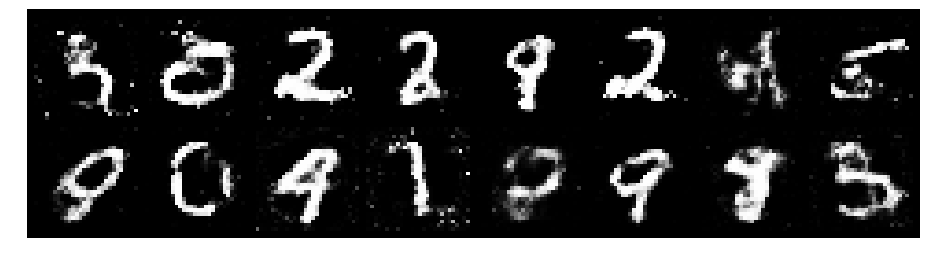

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2234, Generator Loss: 0.9523
D(x): 0.5437, D(G(z)): 0.4075


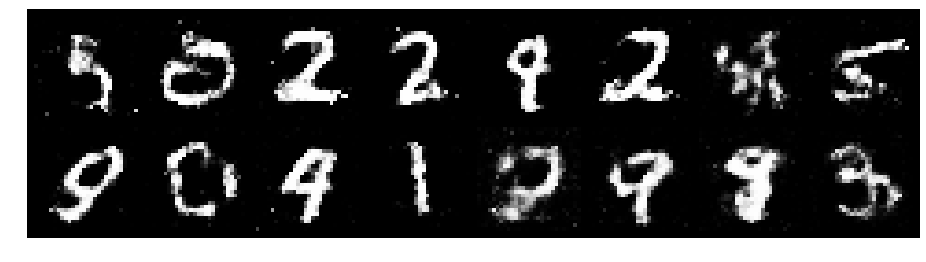

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.1804, Generator Loss: 0.9731
D(x): 0.6272, D(G(z)): 0.4535


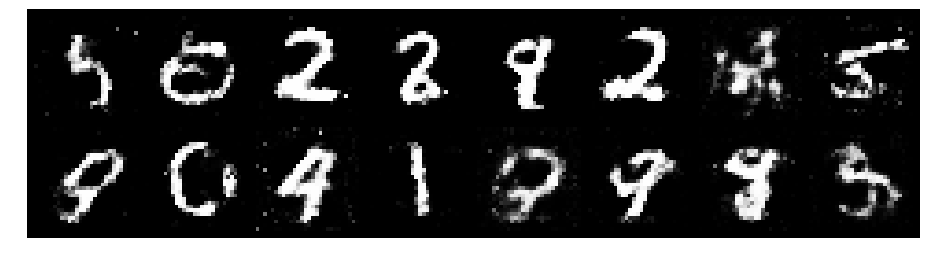

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2771, Generator Loss: 0.9457
D(x): 0.5264, D(G(z)): 0.3978


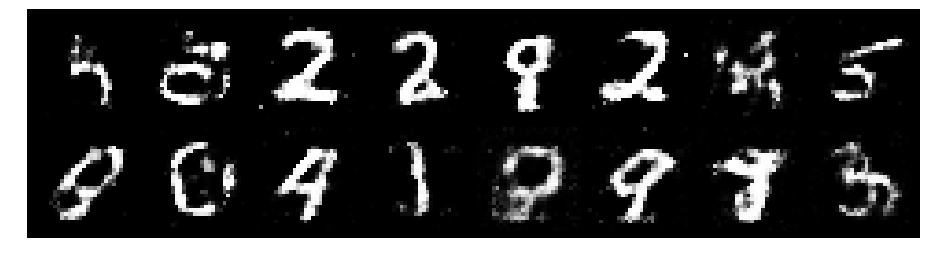

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.1964, Generator Loss: 0.8443
D(x): 0.5827, D(G(z)): 0.4435


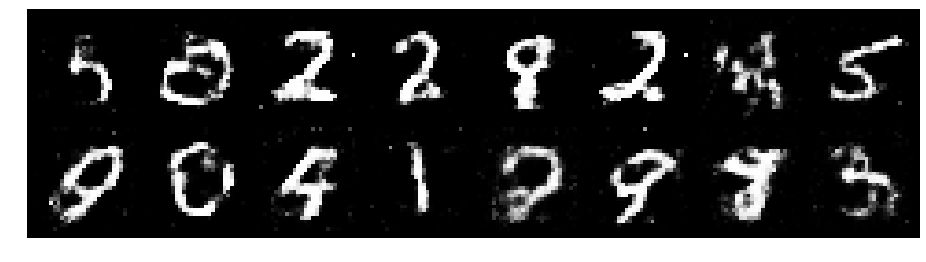

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2822, Generator Loss: 0.8623
D(x): 0.5765, D(G(z)): 0.4566


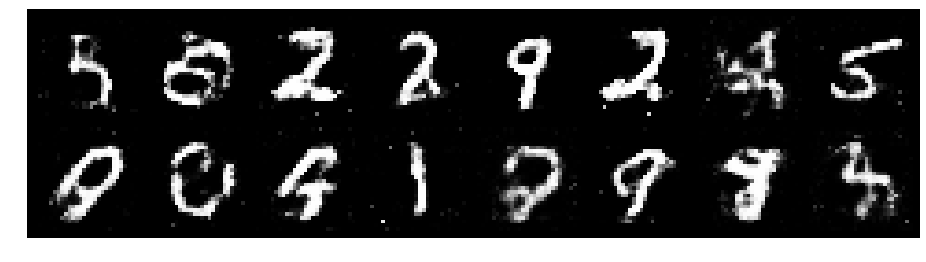

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2502, Generator Loss: 1.1063
D(x): 0.5681, D(G(z)): 0.4218


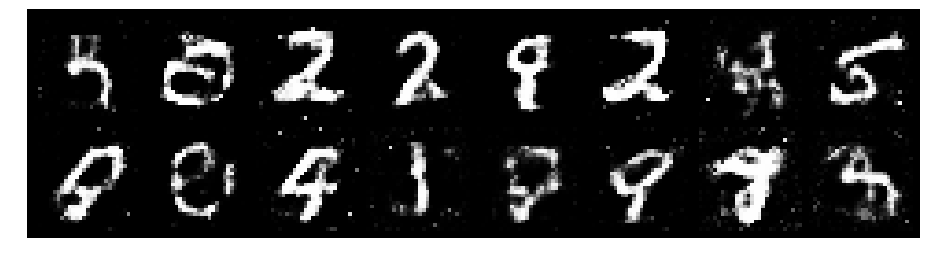

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2224, Generator Loss: 1.0291
D(x): 0.5623, D(G(z)): 0.3958


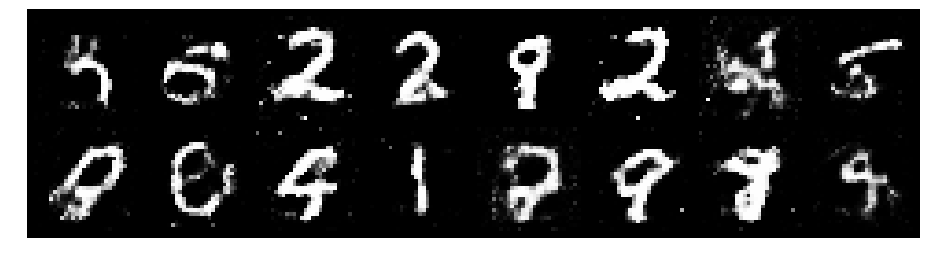

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.2472, Generator Loss: 0.8096
D(x): 0.5610, D(G(z)): 0.4517


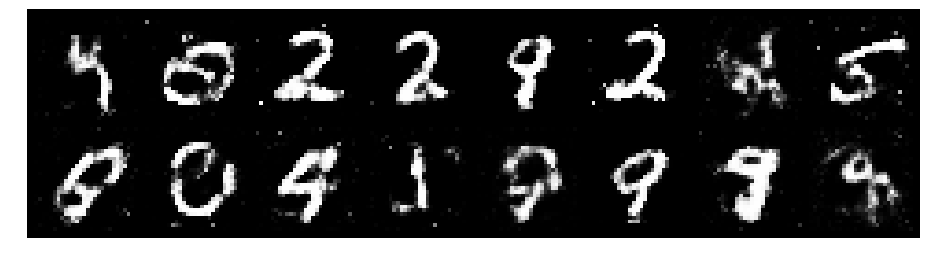

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.2010, Generator Loss: 0.8513
D(x): 0.5781, D(G(z)): 0.4288


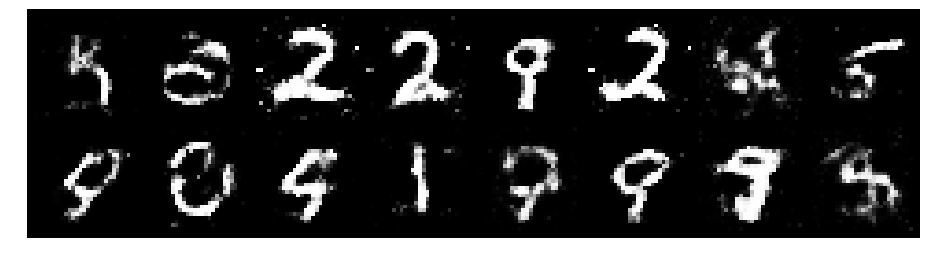

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2138, Generator Loss: 1.0121
D(x): 0.5509, D(G(z)): 0.4097


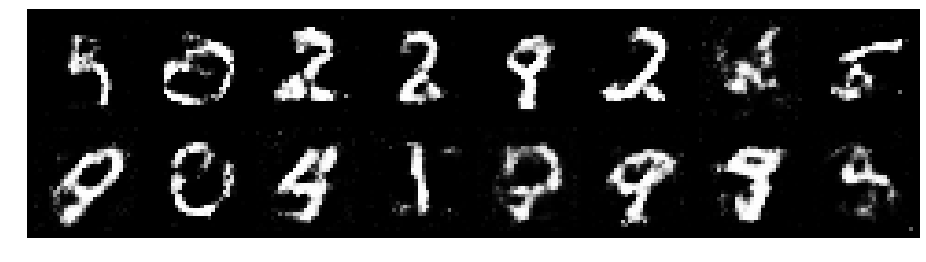

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.1457, Generator Loss: 0.9956
D(x): 0.6401, D(G(z)): 0.4394


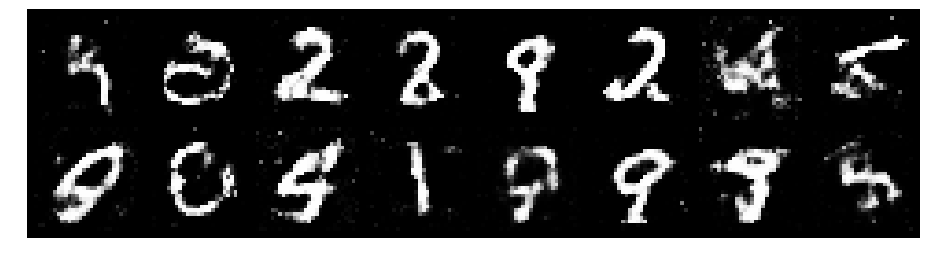

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2458, Generator Loss: 0.8770
D(x): 0.6058, D(G(z)): 0.4530


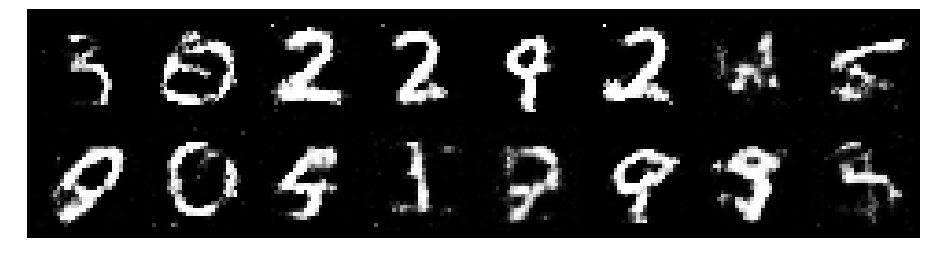

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2594, Generator Loss: 1.0004
D(x): 0.6121, D(G(z)): 0.4548


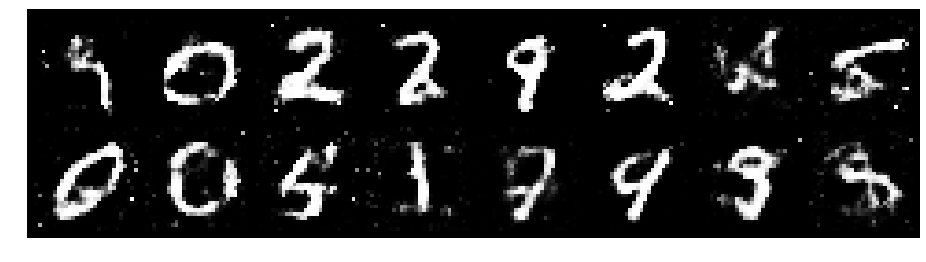

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.2410, Generator Loss: 1.0862
D(x): 0.5557, D(G(z)): 0.3941


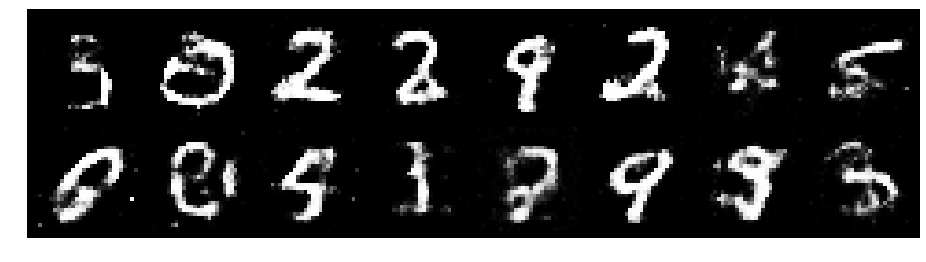

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.1821, Generator Loss: 0.9292
D(x): 0.5632, D(G(z)): 0.4048


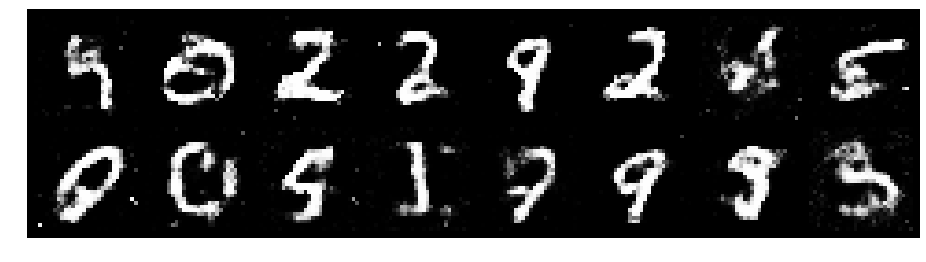

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2613, Generator Loss: 0.8214
D(x): 0.5483, D(G(z)): 0.4378


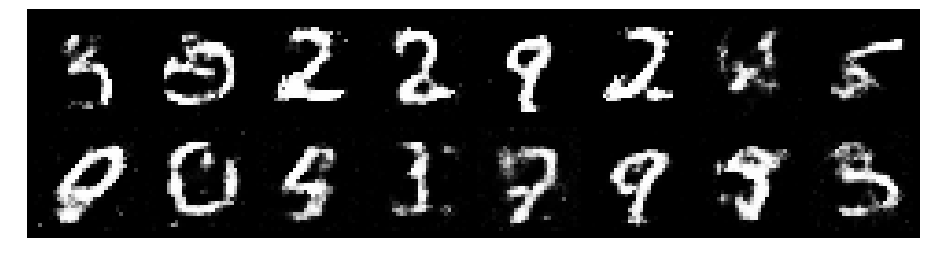

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2239, Generator Loss: 0.8470
D(x): 0.5432, D(G(z)): 0.4206


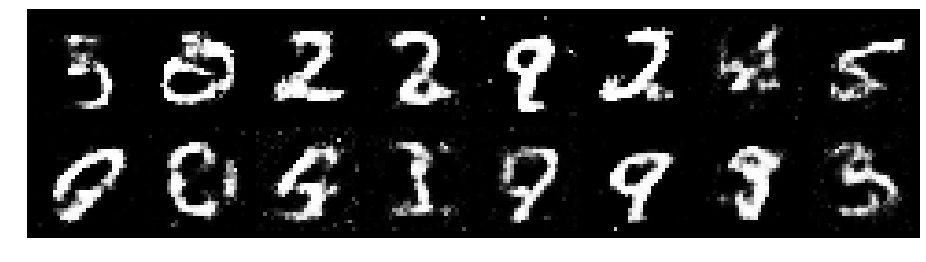

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.1845, Generator Loss: 1.0060
D(x): 0.5840, D(G(z)): 0.4011


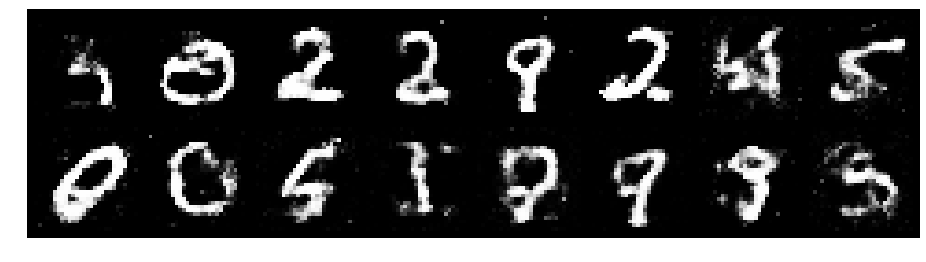

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2230, Generator Loss: 0.8975
D(x): 0.5655, D(G(z)): 0.4273


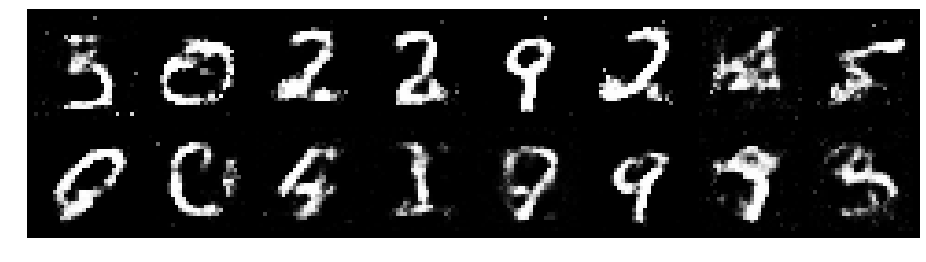

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2480, Generator Loss: 0.9145
D(x): 0.5502, D(G(z)): 0.4297


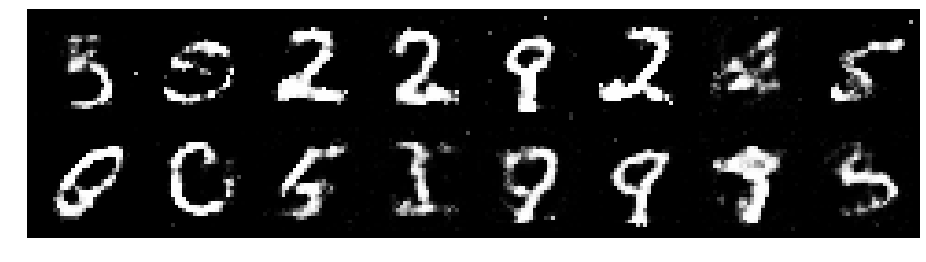

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.1979, Generator Loss: 0.8495
D(x): 0.6057, D(G(z)): 0.4514


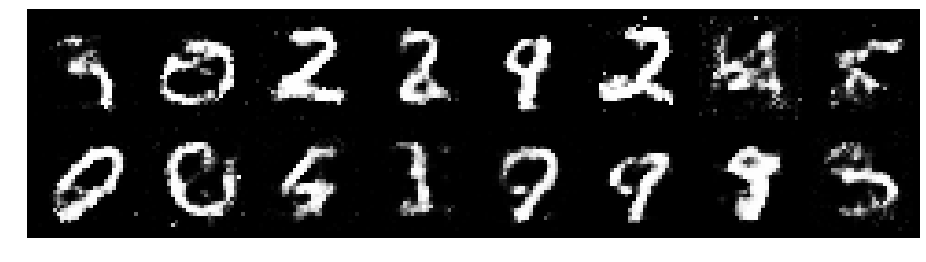

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.1988, Generator Loss: 1.0291
D(x): 0.5740, D(G(z)): 0.4106


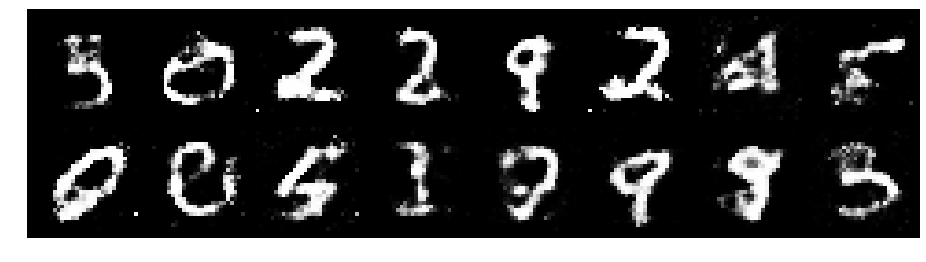

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.1583, Generator Loss: 1.0467
D(x): 0.5990, D(G(z)): 0.4165


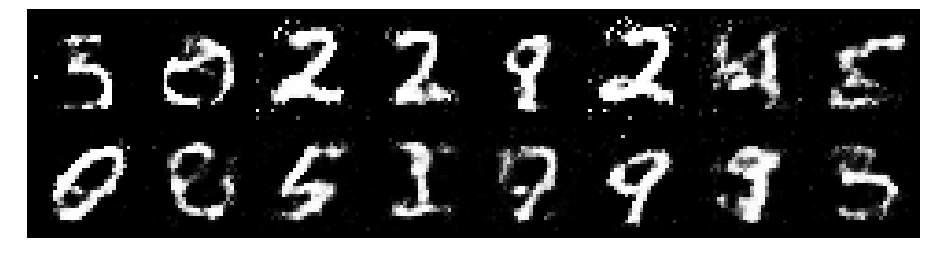

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.3270, Generator Loss: 0.7531
D(x): 0.5187, D(G(z)): 0.4680


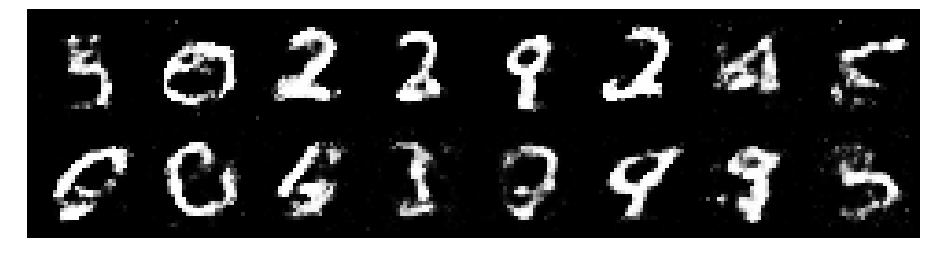

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.1881, Generator Loss: 1.0554
D(x): 0.5813, D(G(z)): 0.4077


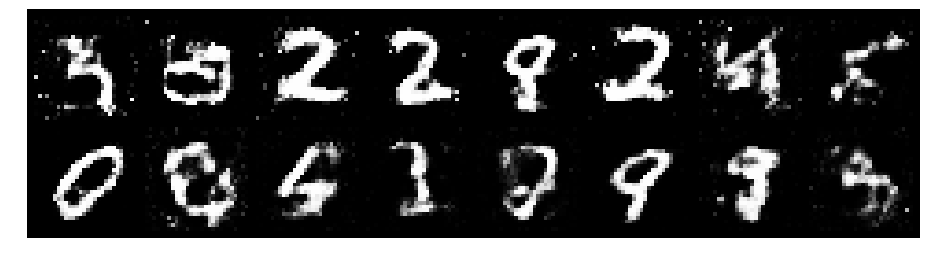

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.2671, Generator Loss: 0.8312
D(x): 0.5698, D(G(z)): 0.4729


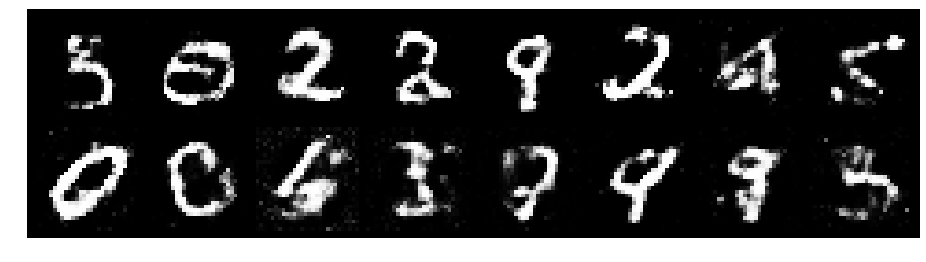

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2089, Generator Loss: 1.1220
D(x): 0.5634, D(G(z)): 0.3951


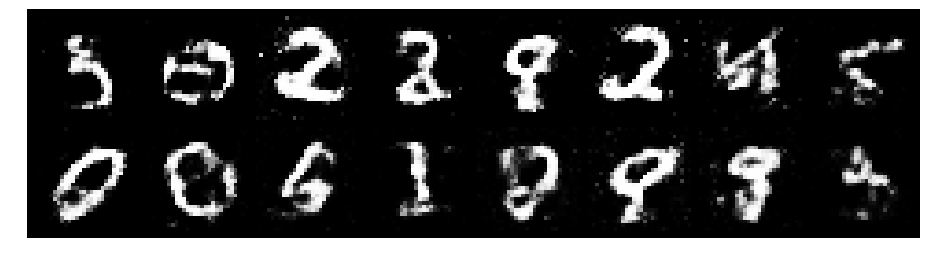

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.1796, Generator Loss: 0.9174
D(x): 0.5998, D(G(z)): 0.4091


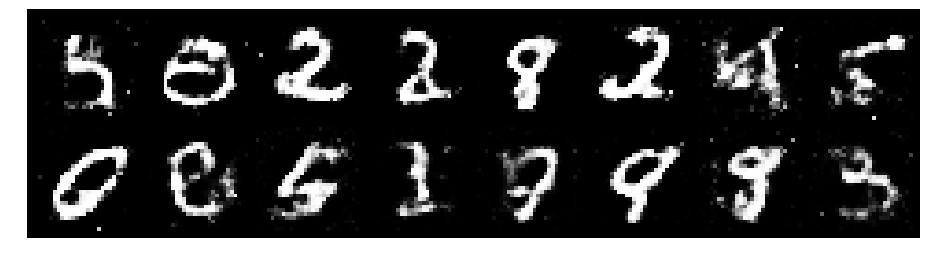

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.3061, Generator Loss: 1.0491
D(x): 0.5842, D(G(z)): 0.4259


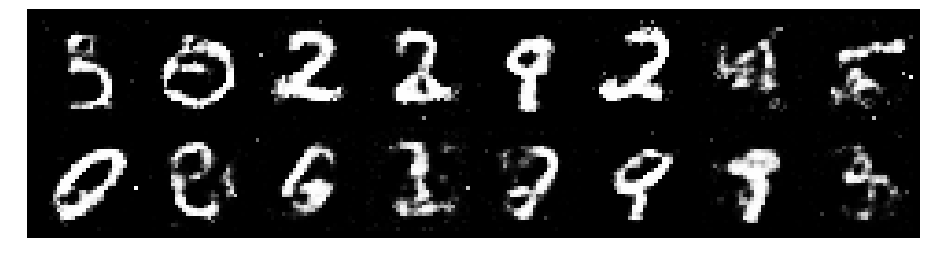

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.1125, Generator Loss: 1.0146
D(x): 0.5802, D(G(z)): 0.3816


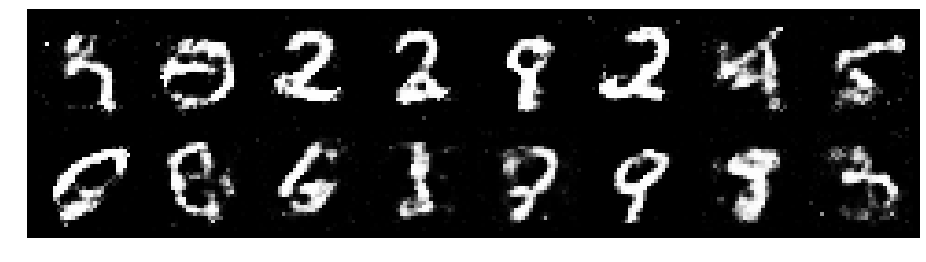

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2964, Generator Loss: 0.9814
D(x): 0.5699, D(G(z)): 0.4419


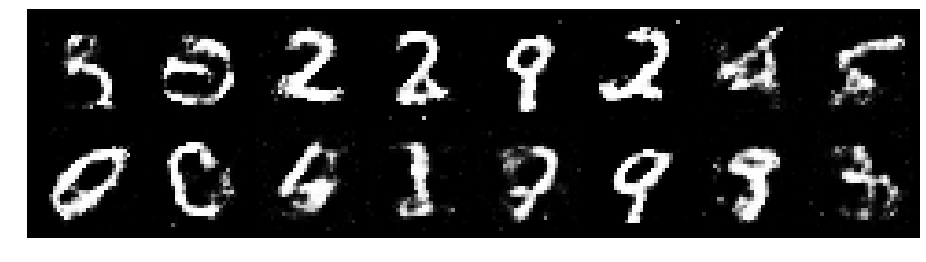

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.3819, Generator Loss: 0.9642
D(x): 0.5714, D(G(z)): 0.4648


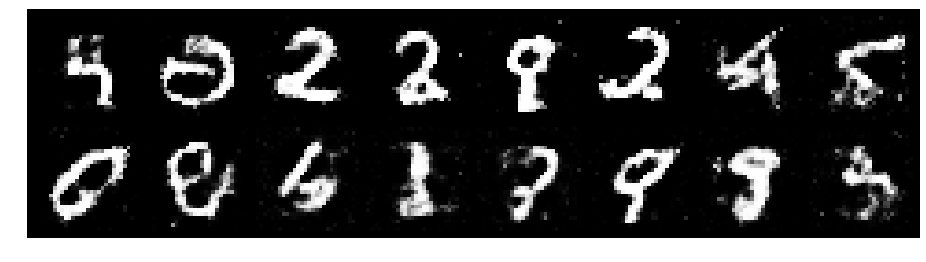

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2488, Generator Loss: 0.8174
D(x): 0.6032, D(G(z)): 0.4764


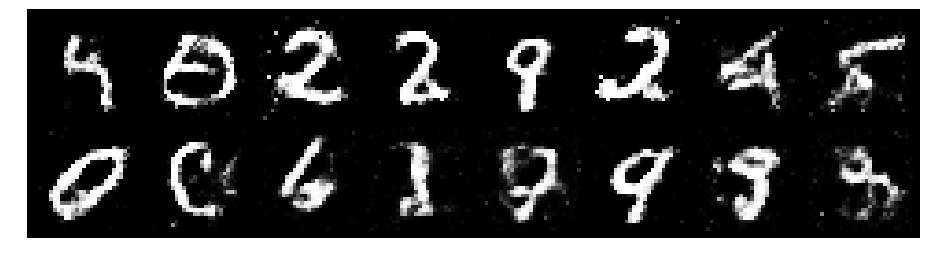

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.1596, Generator Loss: 0.9077
D(x): 0.5696, D(G(z)): 0.4100


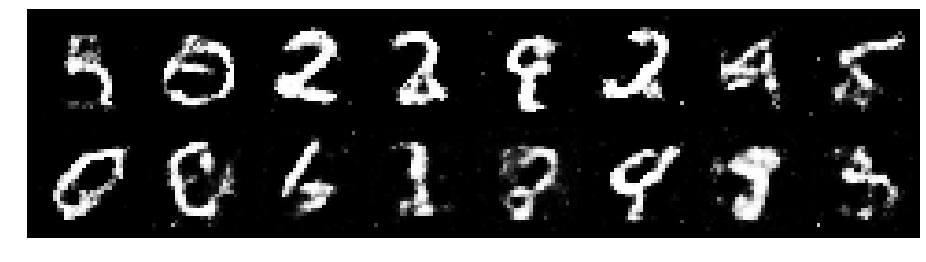

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2389, Generator Loss: 0.9224
D(x): 0.5626, D(G(z)): 0.4421


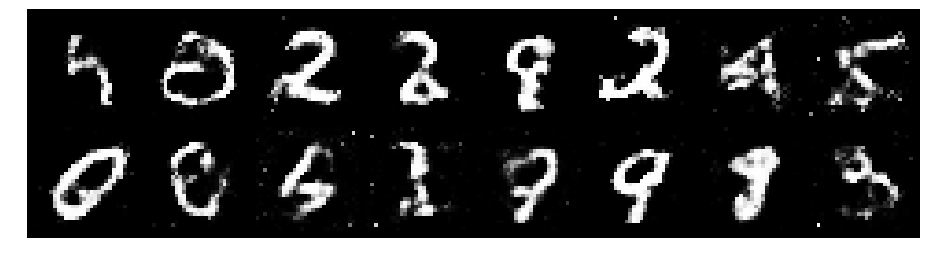

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.3009, Generator Loss: 0.8447
D(x): 0.5735, D(G(z)): 0.4767


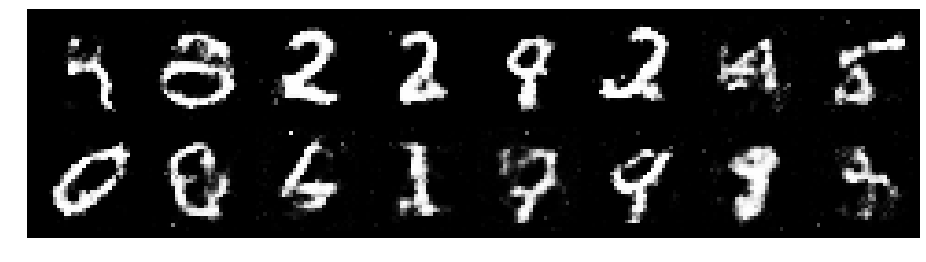

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.2242, Generator Loss: 0.8747
D(x): 0.5819, D(G(z)): 0.4401


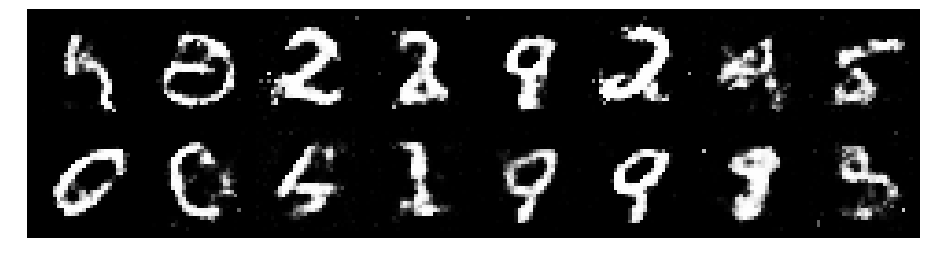

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.1392, Generator Loss: 1.0484
D(x): 0.6133, D(G(z)): 0.4082


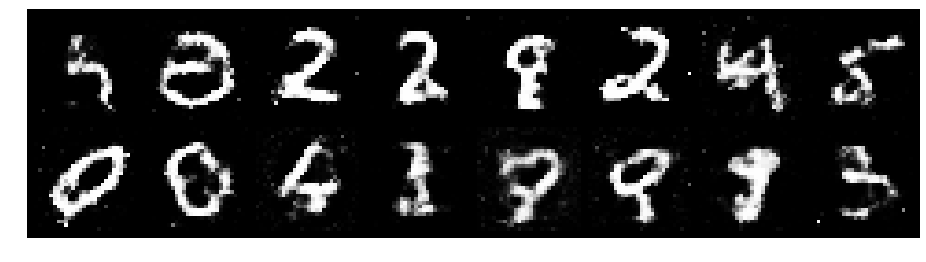

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.1857, Generator Loss: 1.0907
D(x): 0.5633, D(G(z)): 0.3577


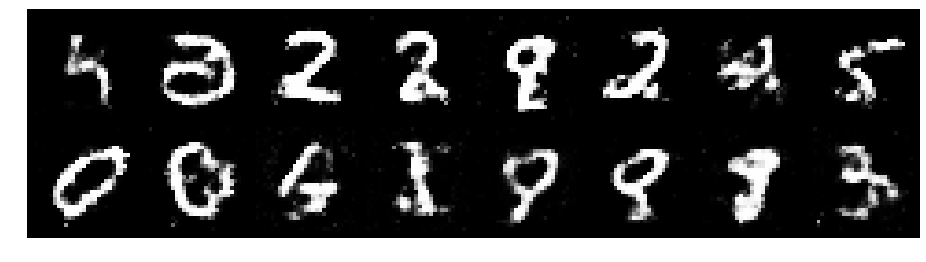

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.0893, Generator Loss: 1.0486
D(x): 0.6200, D(G(z)): 0.4002


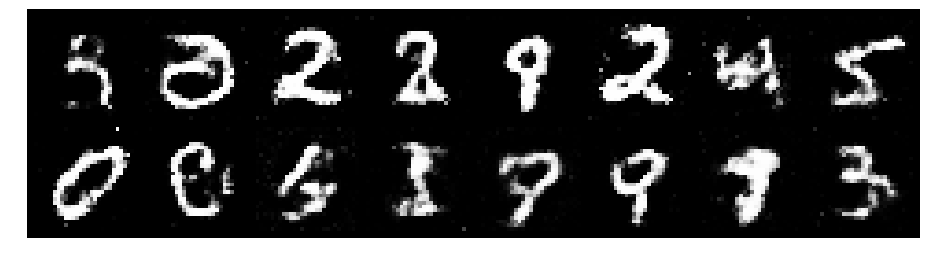

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2615, Generator Loss: 0.8237
D(x): 0.5704, D(G(z)): 0.4527


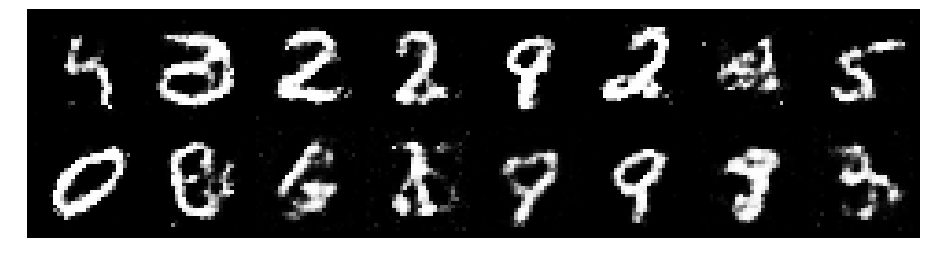

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2893, Generator Loss: 0.8241
D(x): 0.5396, D(G(z)): 0.4449


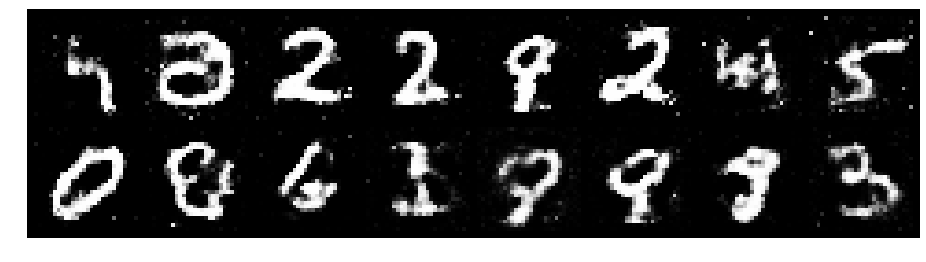

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.3549, Generator Loss: 0.8426
D(x): 0.5682, D(G(z)): 0.4635


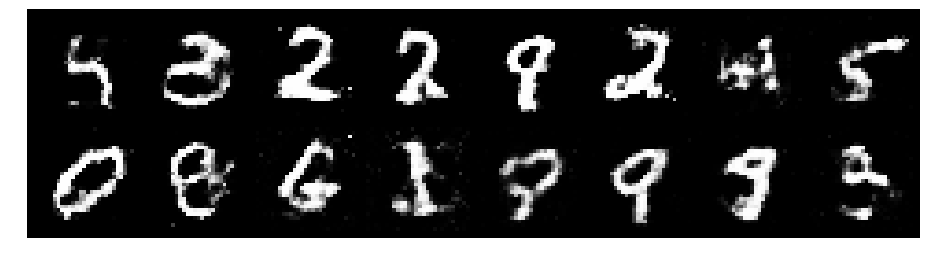

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2014, Generator Loss: 0.9080
D(x): 0.6024, D(G(z)): 0.4271


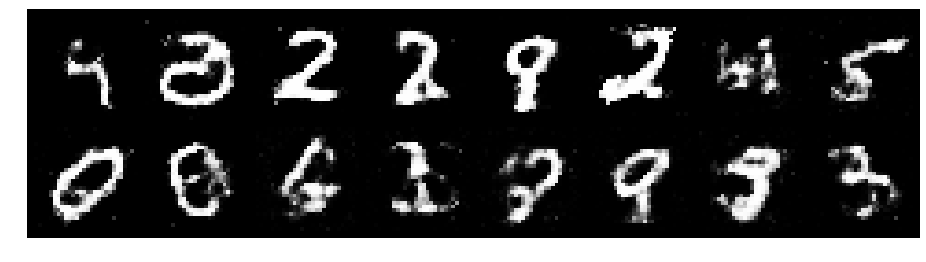

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2212, Generator Loss: 0.9621
D(x): 0.5565, D(G(z)): 0.4133


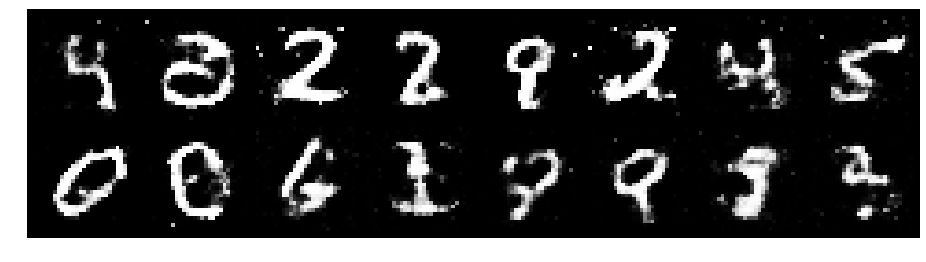

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.3576, Generator Loss: 0.8988
D(x): 0.5504, D(G(z)): 0.4603


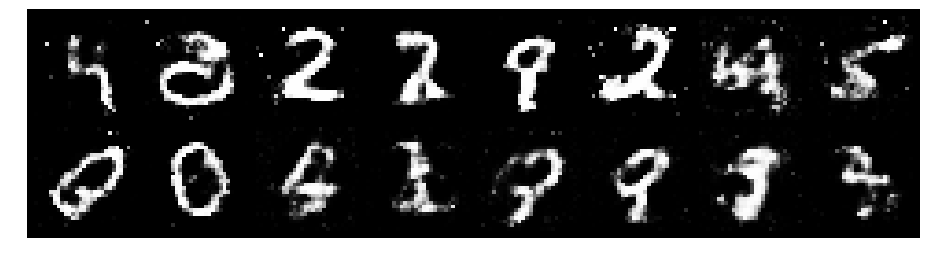

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.1534, Generator Loss: 0.9595
D(x): 0.6047, D(G(z)): 0.3991


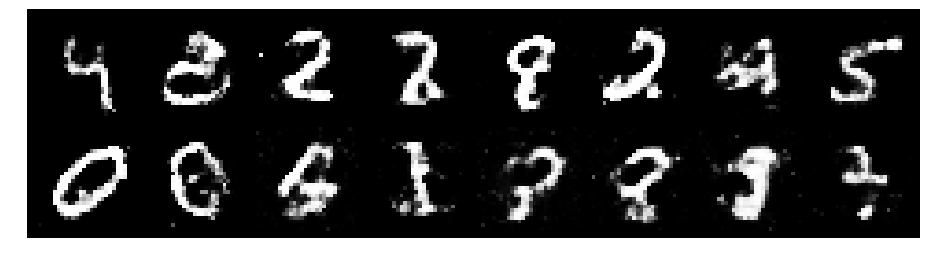

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.3485, Generator Loss: 0.9812
D(x): 0.5767, D(G(z)): 0.4636


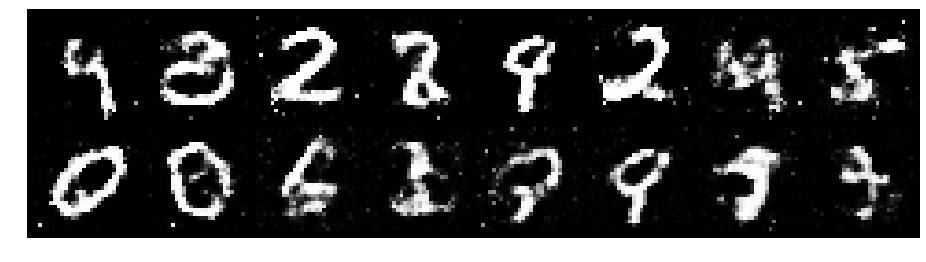

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2463, Generator Loss: 0.9863
D(x): 0.5804, D(G(z)): 0.4428


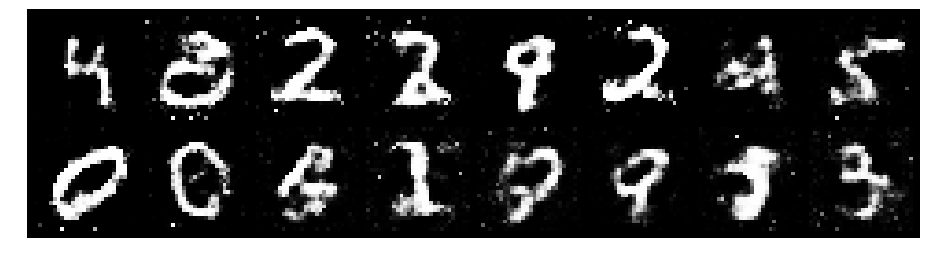

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2476, Generator Loss: 1.0045
D(x): 0.6063, D(G(z)): 0.4539


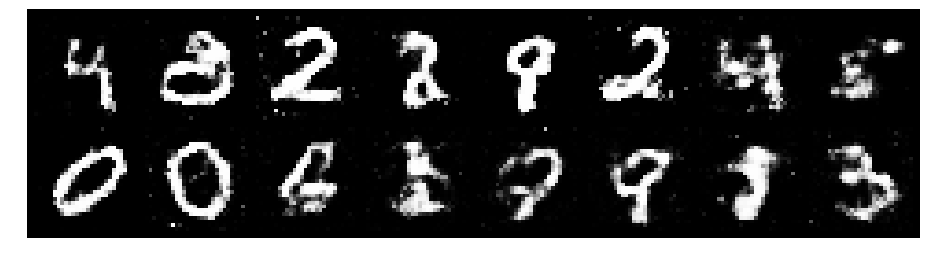

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.3221, Generator Loss: 0.7558
D(x): 0.5735, D(G(z)): 0.5016


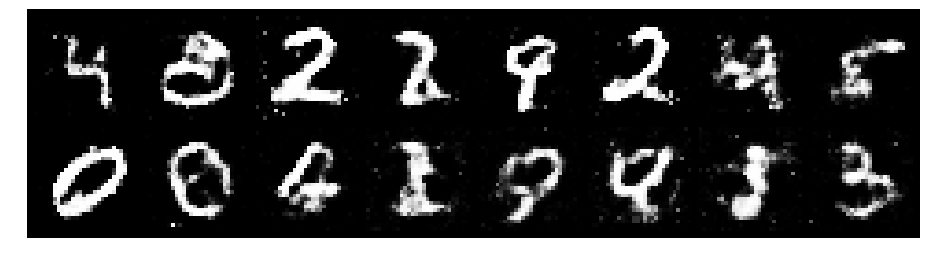

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2787, Generator Loss: 0.8028
D(x): 0.5319, D(G(z)): 0.4436


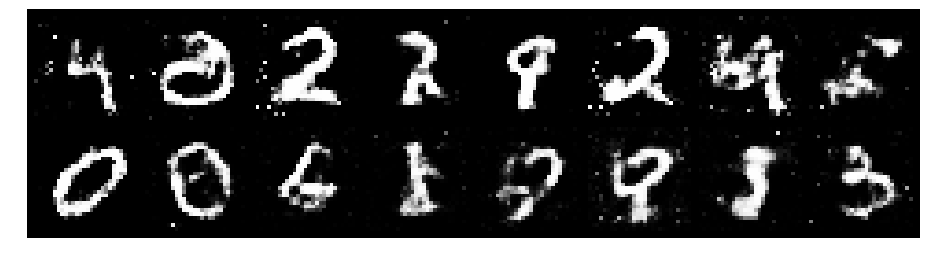

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.3098, Generator Loss: 0.8957
D(x): 0.5372, D(G(z)): 0.4576


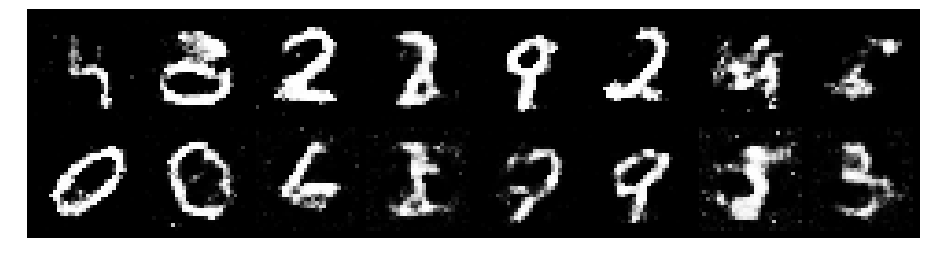

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2413, Generator Loss: 0.9730
D(x): 0.5533, D(G(z)): 0.4407


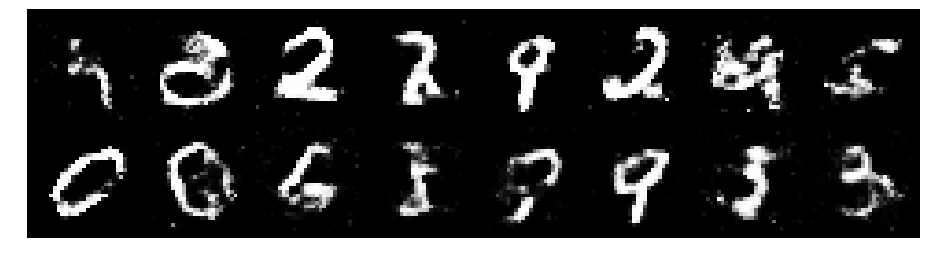

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.3569, Generator Loss: 1.0363
D(x): 0.5665, D(G(z)): 0.4365


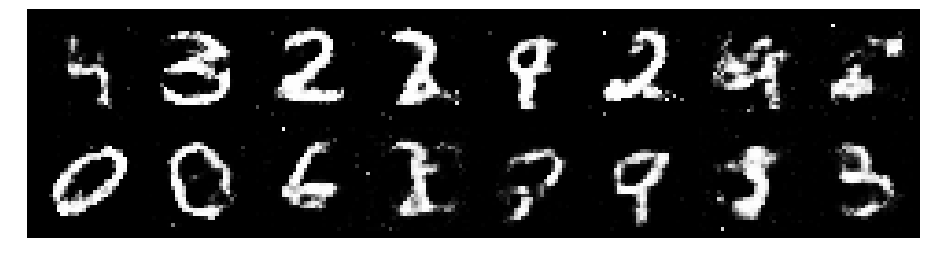

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.3231, Generator Loss: 0.8259
D(x): 0.5541, D(G(z)): 0.4808


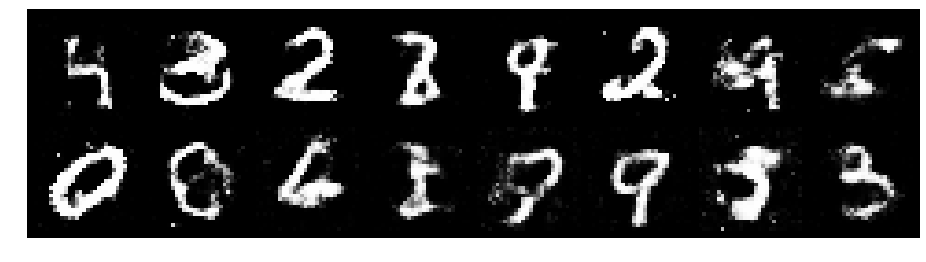

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.3159, Generator Loss: 0.8682
D(x): 0.5174, D(G(z)): 0.4432


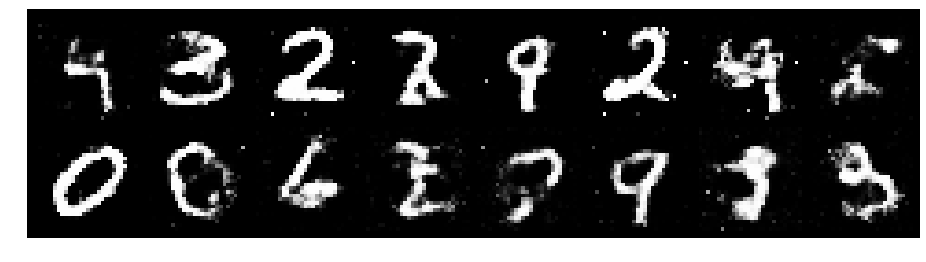

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2327, Generator Loss: 0.9693
D(x): 0.5404, D(G(z)): 0.4054


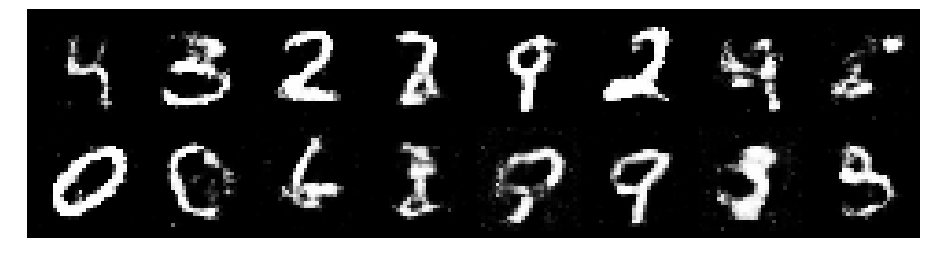

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.1692, Generator Loss: 1.1132
D(x): 0.5810, D(G(z)): 0.3828


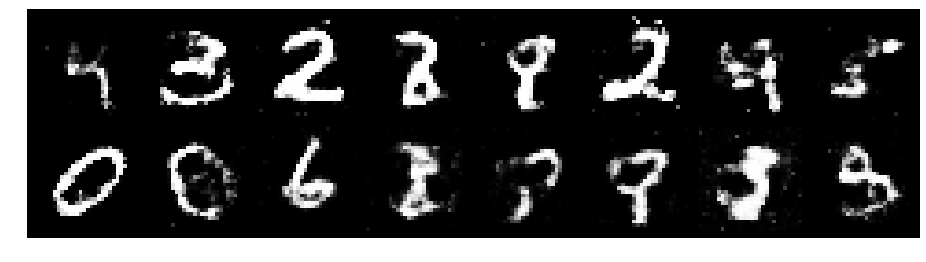

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.3105, Generator Loss: 0.8947
D(x): 0.5237, D(G(z)): 0.4223


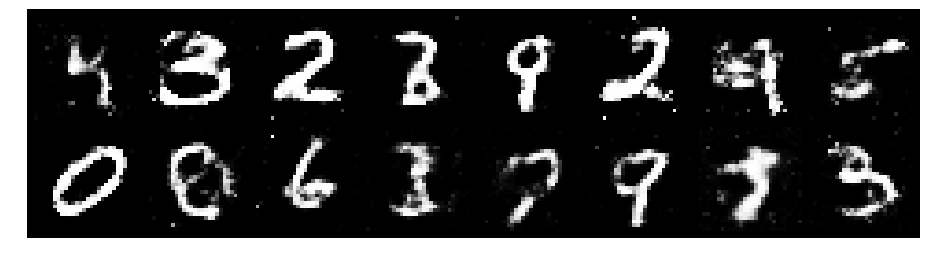

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.3708, Generator Loss: 1.0001
D(x): 0.5368, D(G(z)): 0.4239


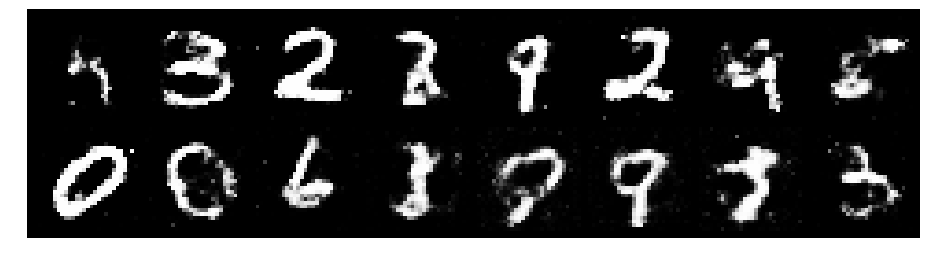

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.1728, Generator Loss: 1.2194
D(x): 0.6214, D(G(z)): 0.3998


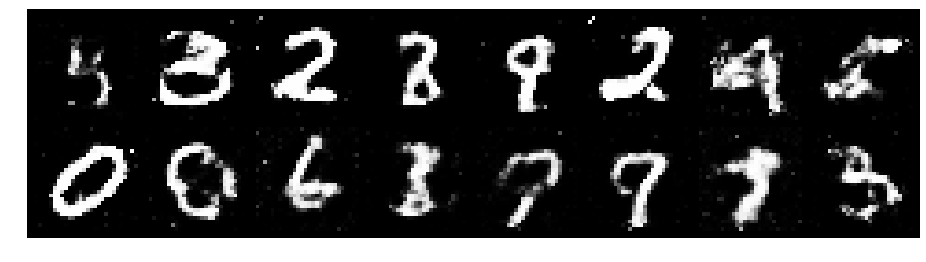

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2702, Generator Loss: 0.8856
D(x): 0.5539, D(G(z)): 0.4301


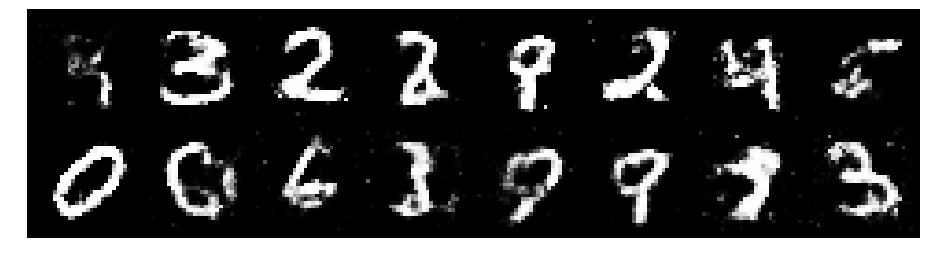

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2885, Generator Loss: 0.8407
D(x): 0.5579, D(G(z)): 0.4632


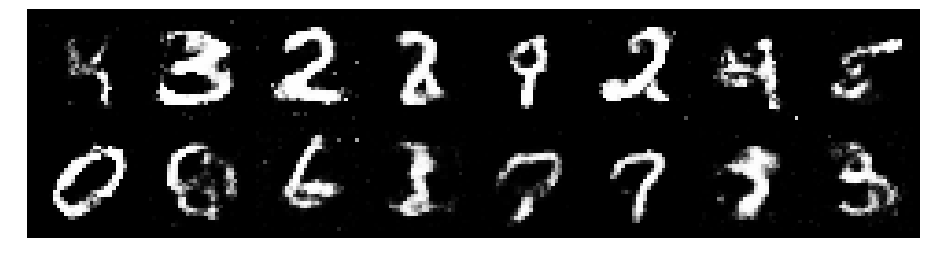

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.3725, Generator Loss: 0.8955
D(x): 0.5462, D(G(z)): 0.4634


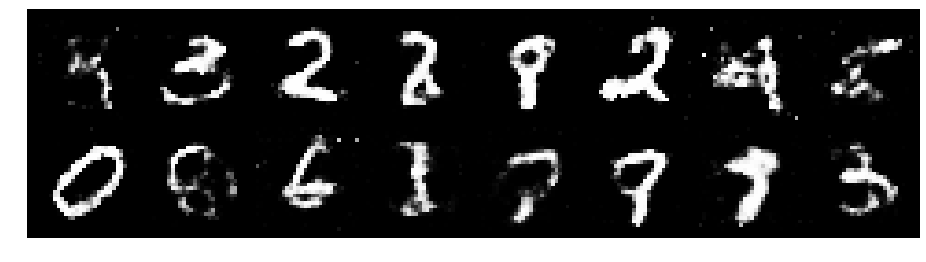

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.2044, Generator Loss: 1.1839
D(x): 0.6325, D(G(z)): 0.4351


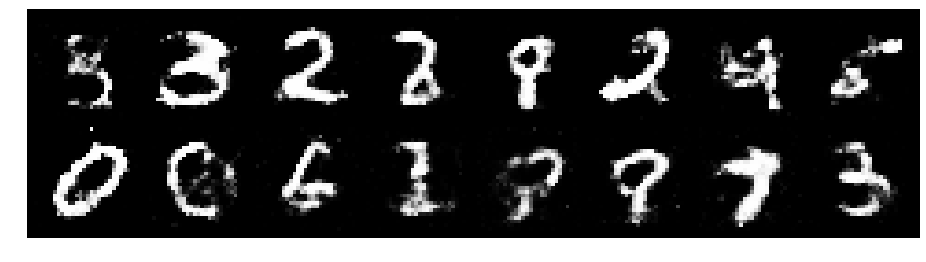

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2085, Generator Loss: 0.8582
D(x): 0.5603, D(G(z)): 0.4101


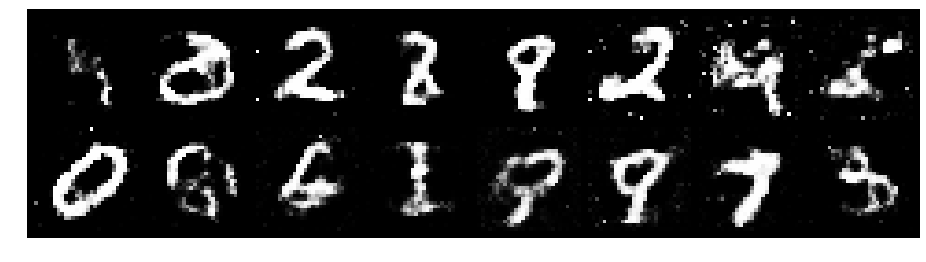

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.2332, Generator Loss: 0.8250
D(x): 0.5499, D(G(z)): 0.4343


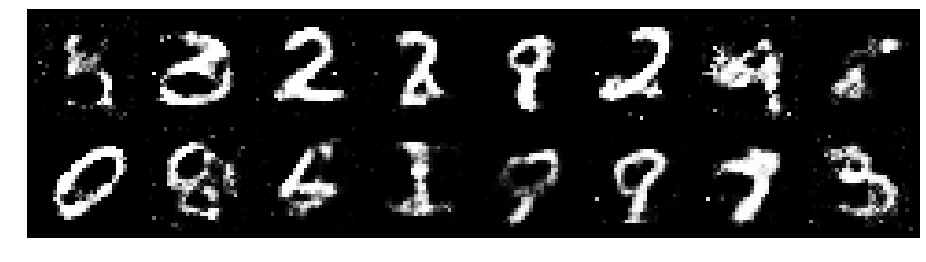

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2793, Generator Loss: 0.8780
D(x): 0.5690, D(G(z)): 0.4598


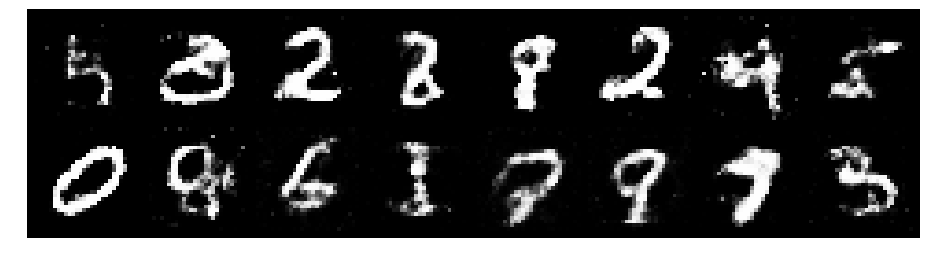

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.3092, Generator Loss: 0.8762
D(x): 0.5497, D(G(z)): 0.4274


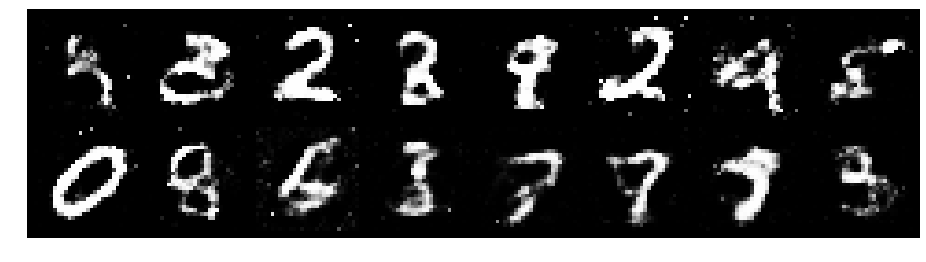

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2500, Generator Loss: 1.0482
D(x): 0.5561, D(G(z)): 0.4053


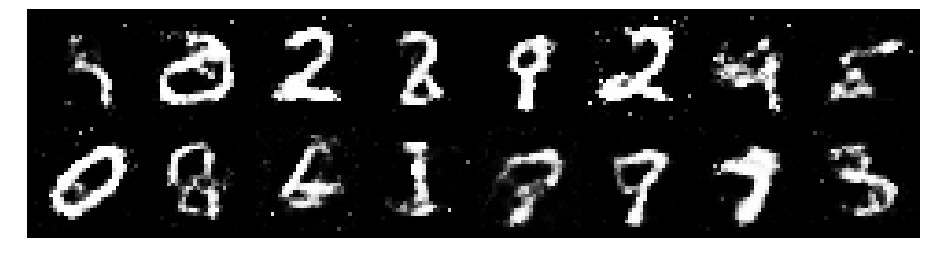

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.1186, Generator Loss: 1.0542
D(x): 0.5667, D(G(z)): 0.3454


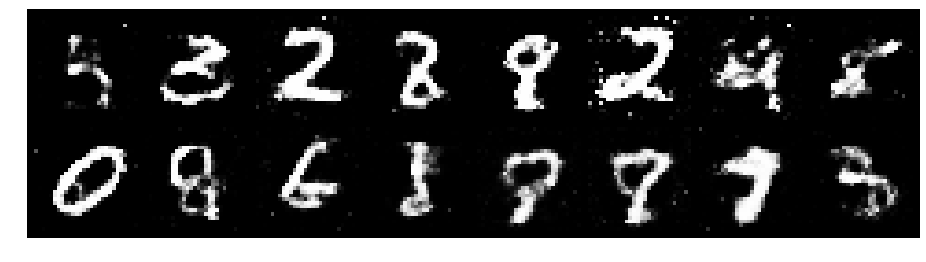

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2553, Generator Loss: 0.9556
D(x): 0.5638, D(G(z)): 0.4316


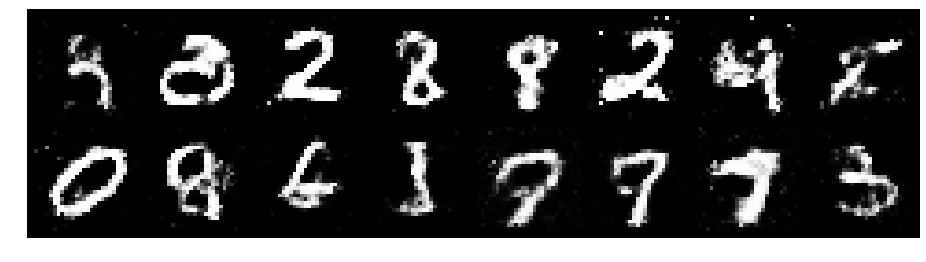

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2303, Generator Loss: 0.9794
D(x): 0.5614, D(G(z)): 0.4130


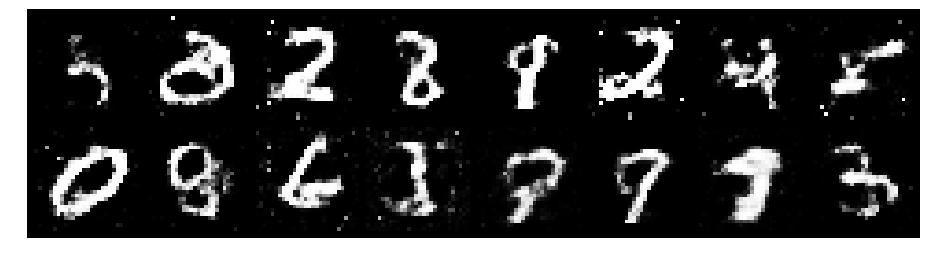

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.1229, Generator Loss: 1.0062
D(x): 0.5737, D(G(z)): 0.3937


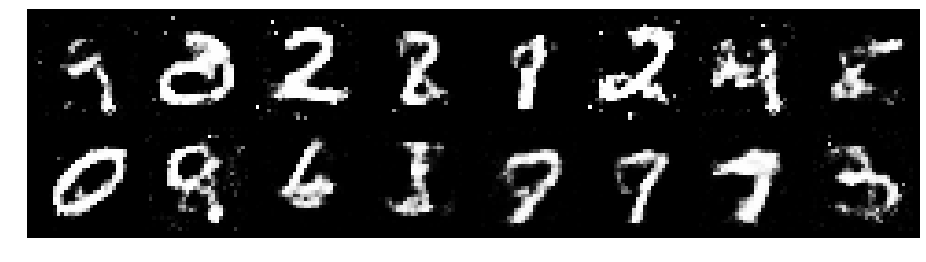

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.3394, Generator Loss: 0.8186
D(x): 0.5849, D(G(z)): 0.4993


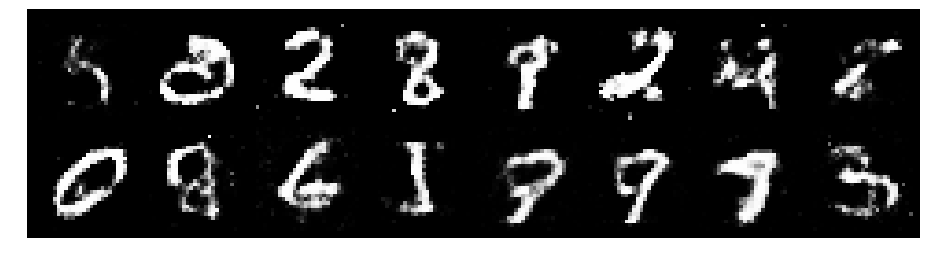

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2484, Generator Loss: 0.9096
D(x): 0.5565, D(G(z)): 0.4478


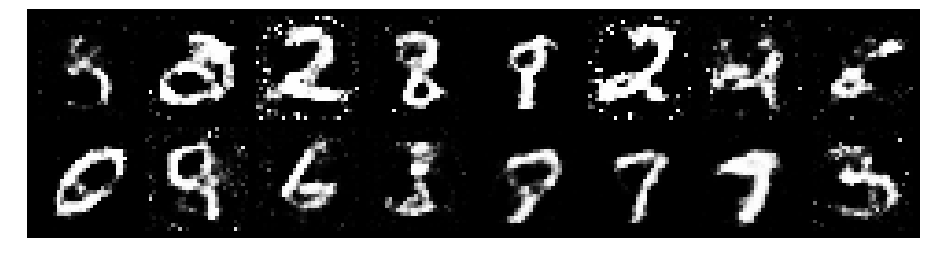

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2400, Generator Loss: 0.8298
D(x): 0.5736, D(G(z)): 0.4529


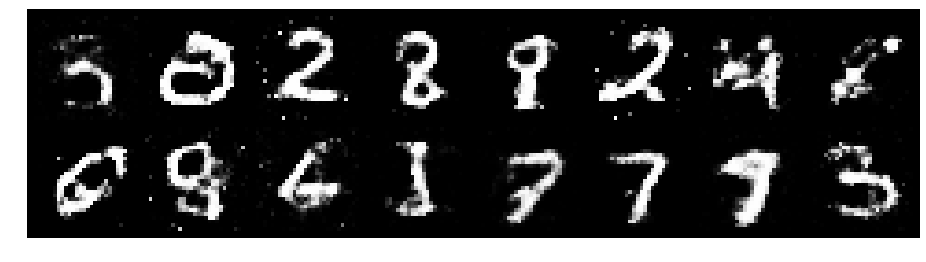

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.3380, Generator Loss: 0.8013
D(x): 0.5334, D(G(z)): 0.4731


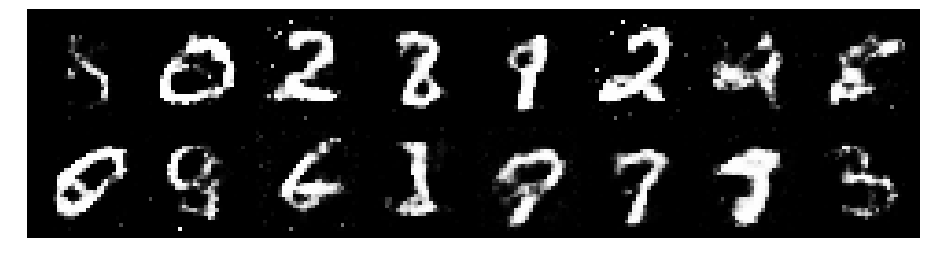

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.3485, Generator Loss: 0.8253
D(x): 0.5472, D(G(z)): 0.4865


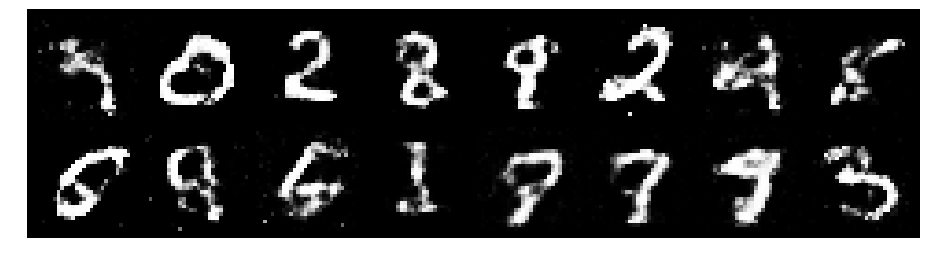

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.3771, Generator Loss: 0.9428
D(x): 0.5022, D(G(z)): 0.4322


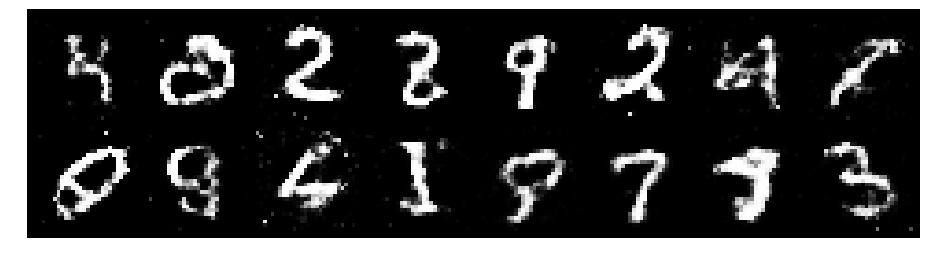

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2530, Generator Loss: 0.8952
D(x): 0.5741, D(G(z)): 0.4462


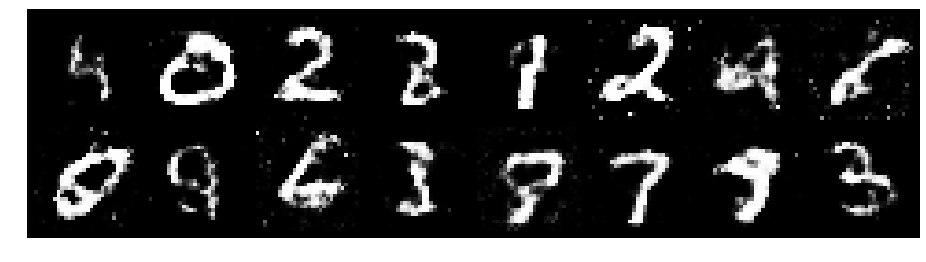

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.3735, Generator Loss: 0.8623
D(x): 0.5406, D(G(z)): 0.4643


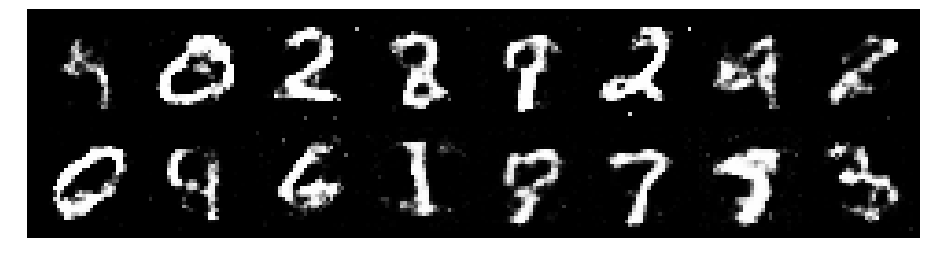

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.3264, Generator Loss: 1.1137
D(x): 0.5368, D(G(z)): 0.4214


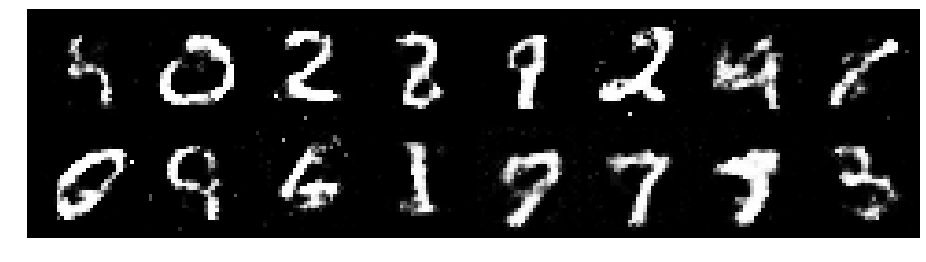

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2100, Generator Loss: 1.0651
D(x): 0.6148, D(G(z)): 0.4353


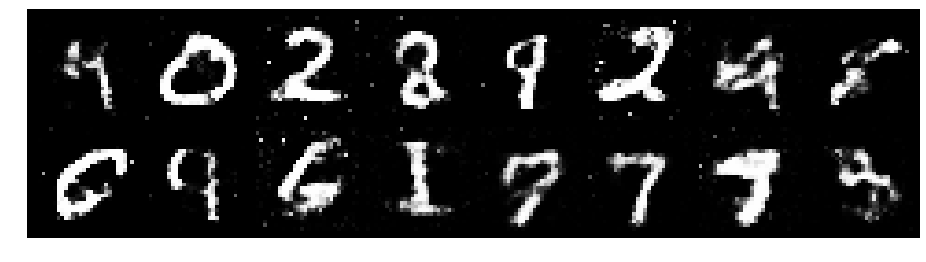

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.2125, Generator Loss: 0.9381
D(x): 0.5893, D(G(z)): 0.4326


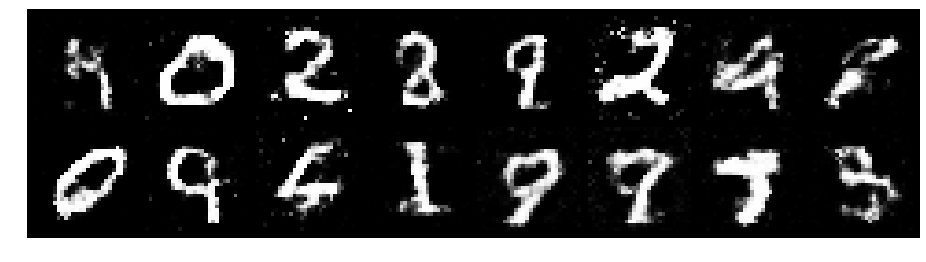

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.3504, Generator Loss: 0.7714
D(x): 0.5790, D(G(z)): 0.4790


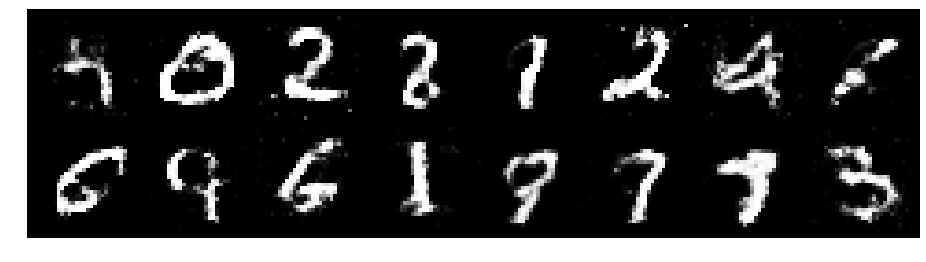

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.3472, Generator Loss: 0.9434
D(x): 0.5625, D(G(z)): 0.4603


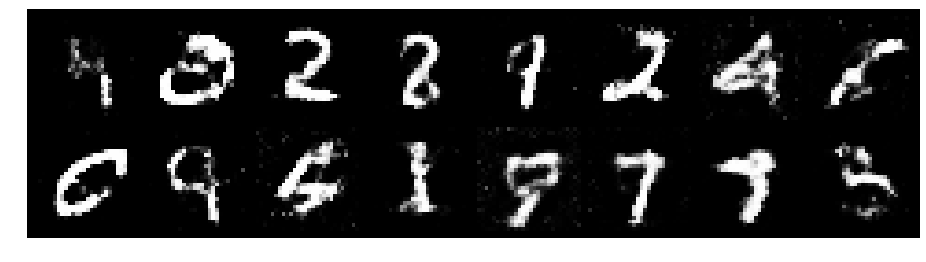

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.1213, Generator Loss: 1.1887
D(x): 0.5935, D(G(z)): 0.3526


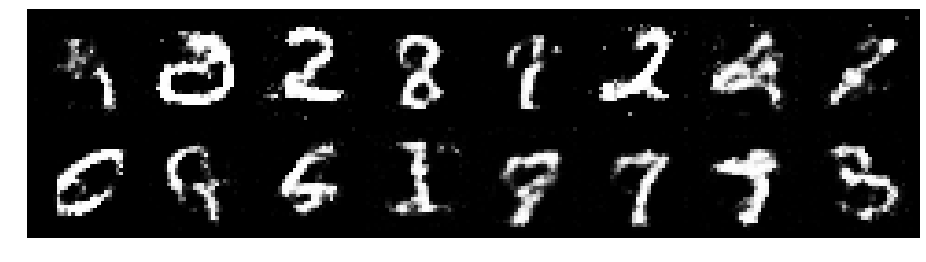

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.1706, Generator Loss: 1.0029
D(x): 0.5884, D(G(z)): 0.4225


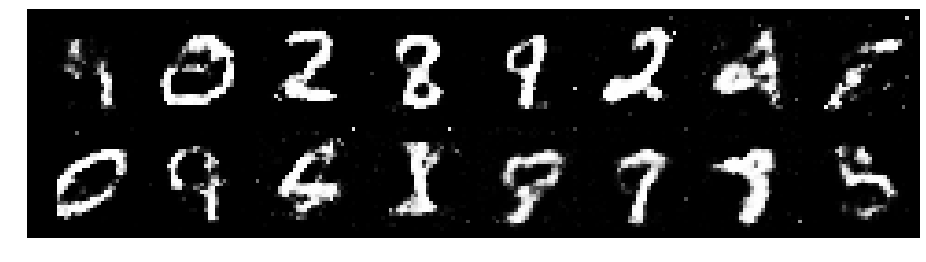

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.1273, Generator Loss: 1.0672
D(x): 0.5653, D(G(z)): 0.3823


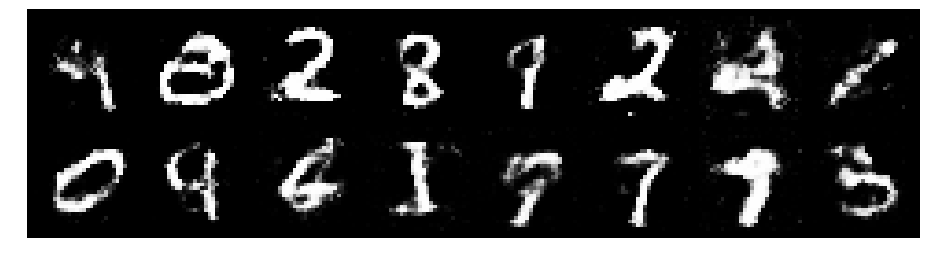

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2920, Generator Loss: 0.8930
D(x): 0.5248, D(G(z)): 0.4016


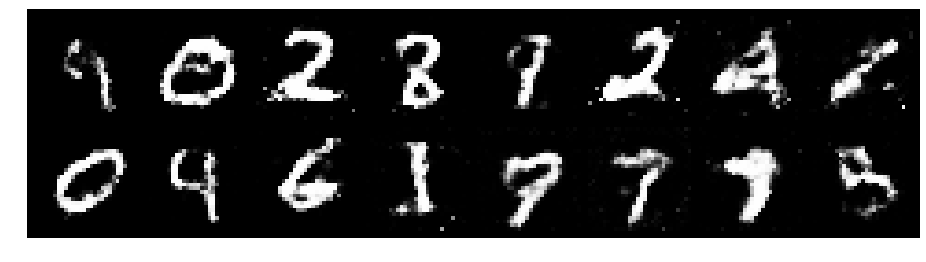

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2880, Generator Loss: 0.9828
D(x): 0.5631, D(G(z)): 0.4490


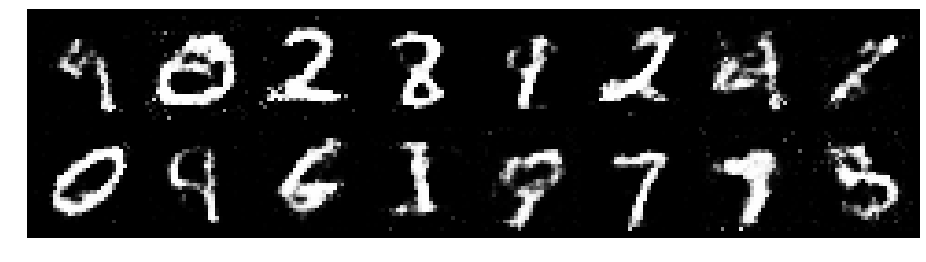

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.1151, Generator Loss: 0.9524
D(x): 0.6169, D(G(z)): 0.4025


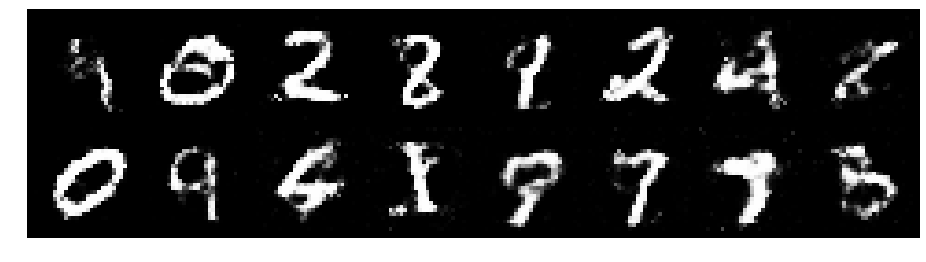

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2347, Generator Loss: 0.8878
D(x): 0.5510, D(G(z)): 0.4239


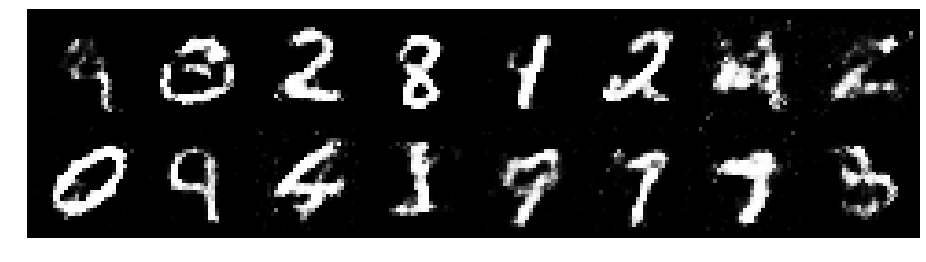

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2957, Generator Loss: 0.7953
D(x): 0.5682, D(G(z)): 0.4626


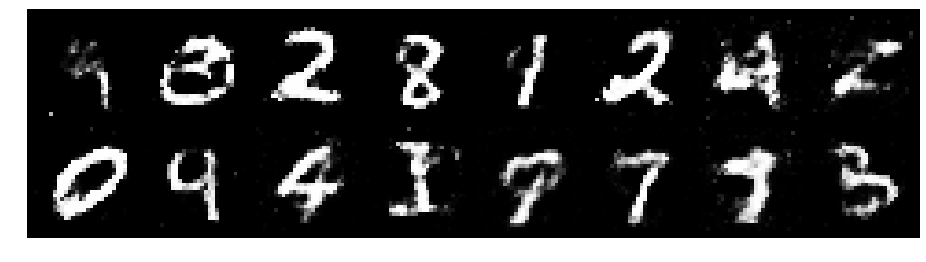

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.4511, Generator Loss: 0.8283
D(x): 0.5642, D(G(z)): 0.5005


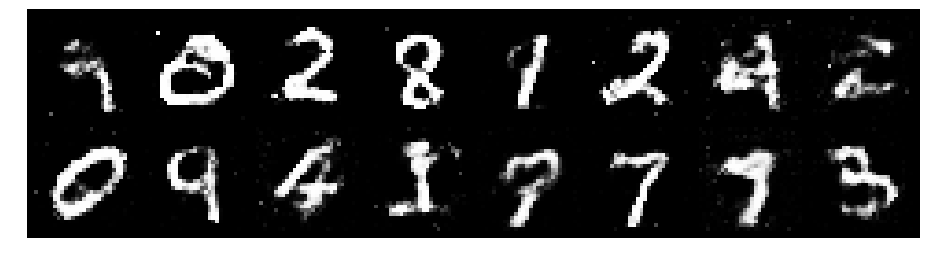

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.3092, Generator Loss: 0.8040
D(x): 0.5266, D(G(z)): 0.4498


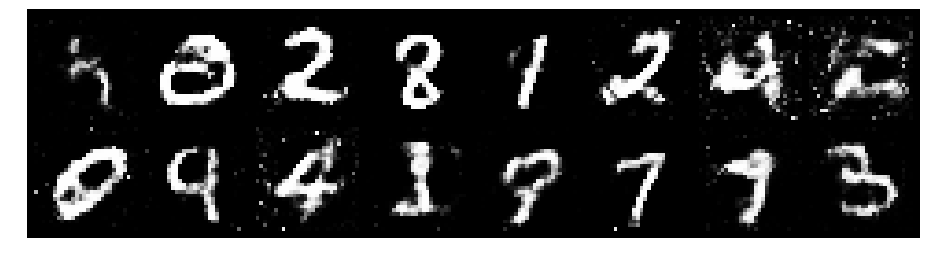

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2684, Generator Loss: 1.0322
D(x): 0.5554, D(G(z)): 0.4236


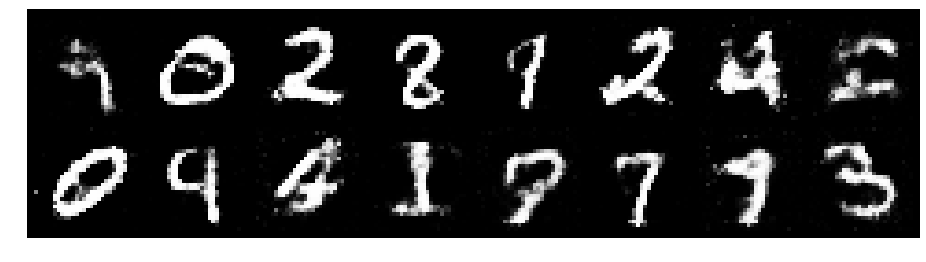

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.3590, Generator Loss: 0.9249
D(x): 0.5126, D(G(z)): 0.4220


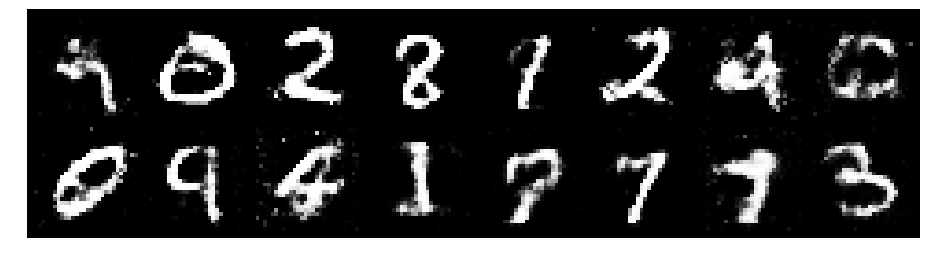

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2852, Generator Loss: 0.9094
D(x): 0.6073, D(G(z)): 0.4803


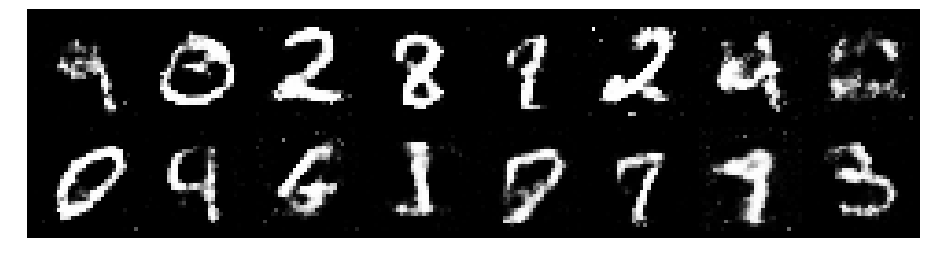

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2142, Generator Loss: 0.8710
D(x): 0.5734, D(G(z)): 0.4388


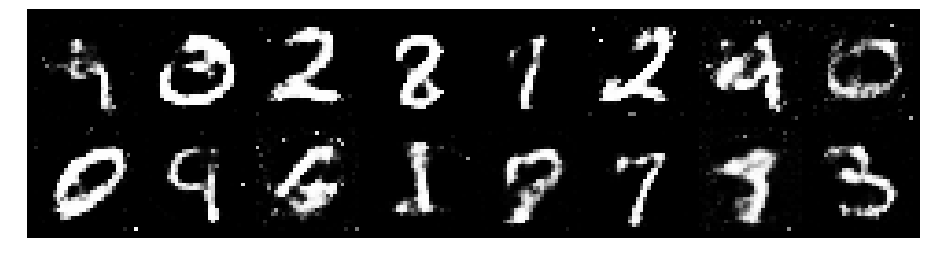

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.3023, Generator Loss: 0.9677
D(x): 0.5727, D(G(z)): 0.4635


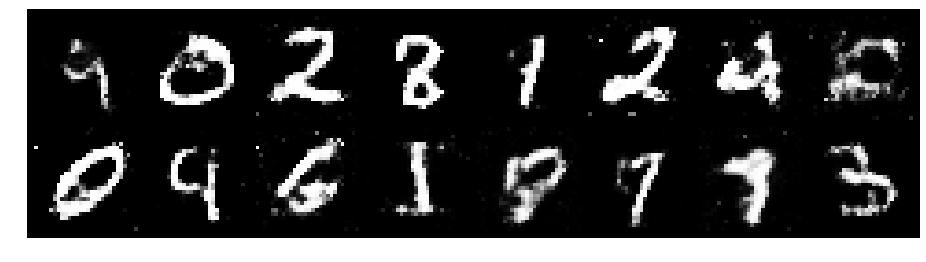

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.1961, Generator Loss: 0.9203
D(x): 0.5616, D(G(z)): 0.4294


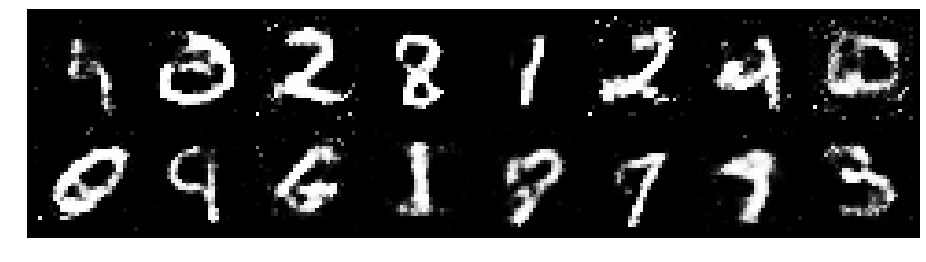

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2932, Generator Loss: 1.0042
D(x): 0.4953, D(G(z)): 0.3816


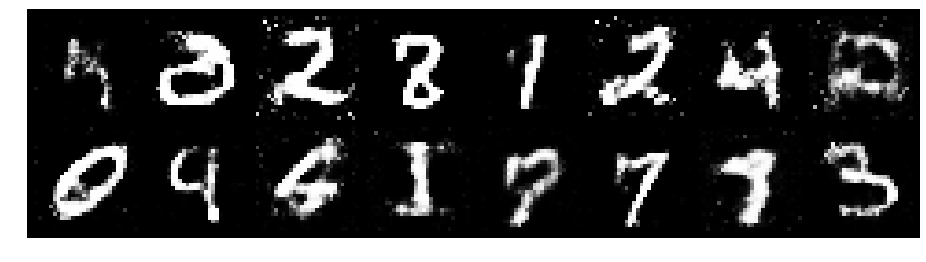

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.1609, Generator Loss: 1.0295
D(x): 0.5649, D(G(z)): 0.3892


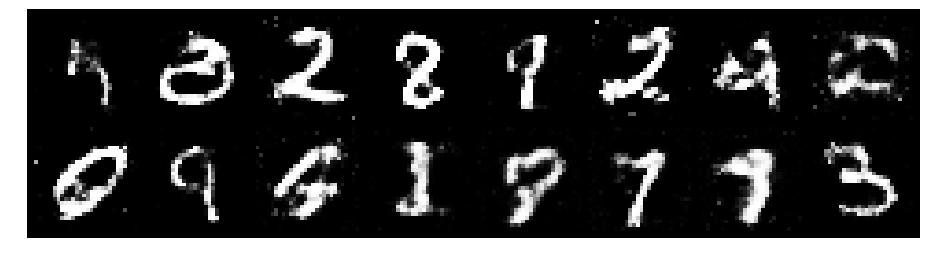

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.2061, Generator Loss: 0.9097
D(x): 0.5632, D(G(z)): 0.4281


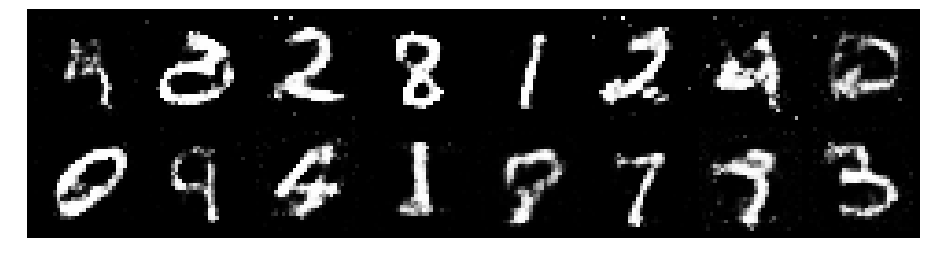

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2588, Generator Loss: 0.8210
D(x): 0.5362, D(G(z)): 0.4482


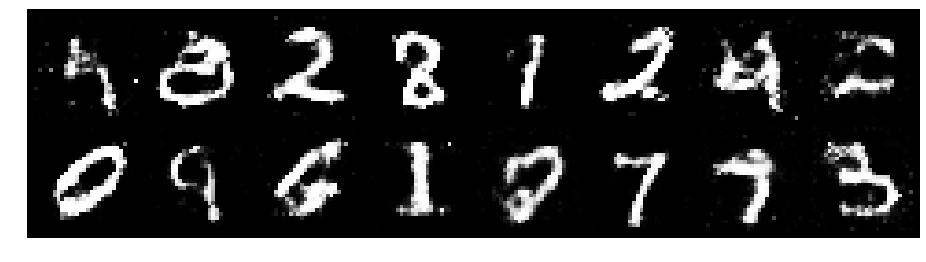

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.1609, Generator Loss: 0.9817
D(x): 0.5730, D(G(z)): 0.4185


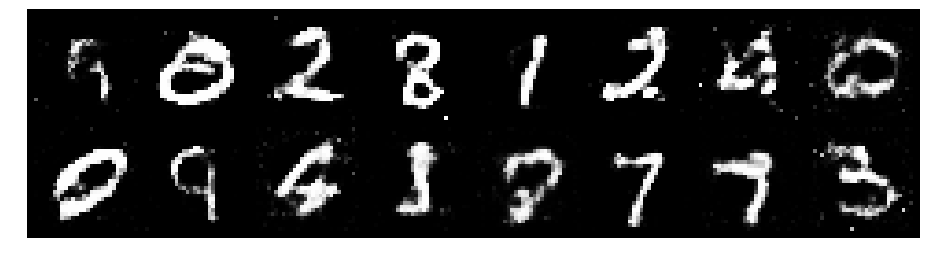

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.1563, Generator Loss: 0.8549
D(x): 0.5735, D(G(z)): 0.4067


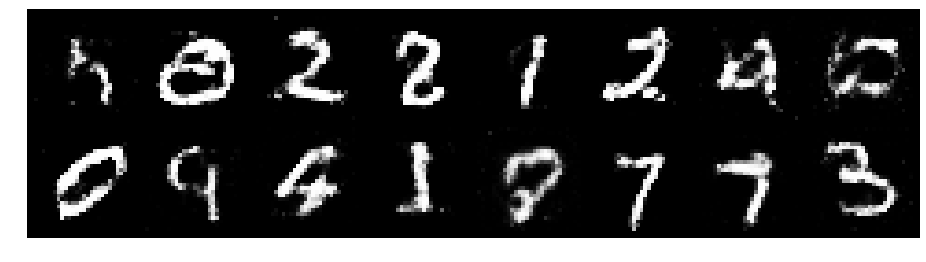

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.3460, Generator Loss: 0.8275
D(x): 0.5107, D(G(z)): 0.4490


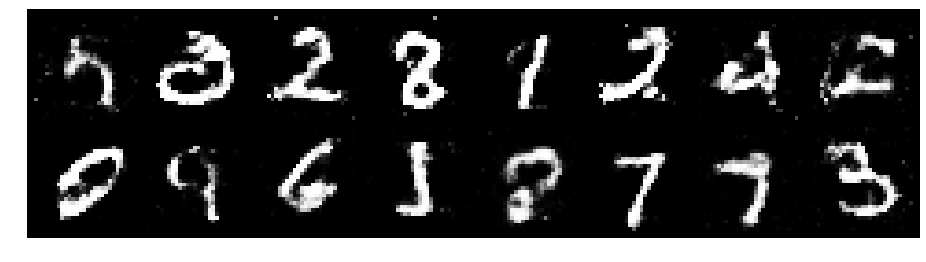

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2198, Generator Loss: 0.9647
D(x): 0.5854, D(G(z)): 0.4264


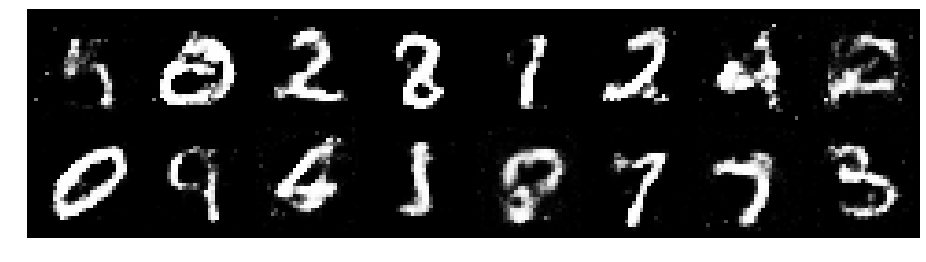

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2939, Generator Loss: 0.9573
D(x): 0.5883, D(G(z)): 0.4431


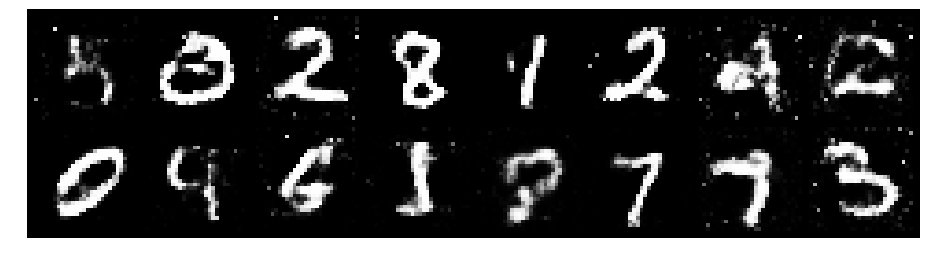

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.3067, Generator Loss: 1.1434
D(x): 0.5576, D(G(z)): 0.4264


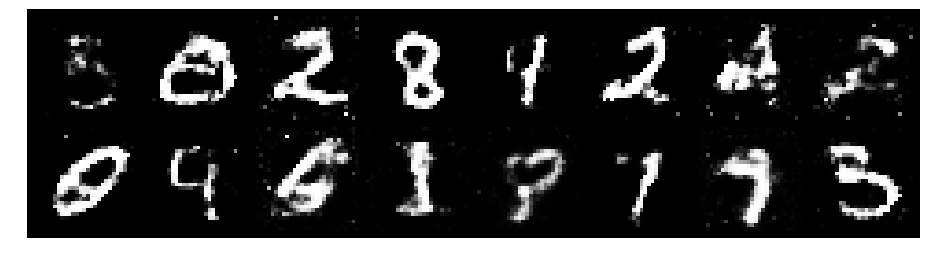

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.4832, Generator Loss: 0.8047
D(x): 0.5287, D(G(z)): 0.5118


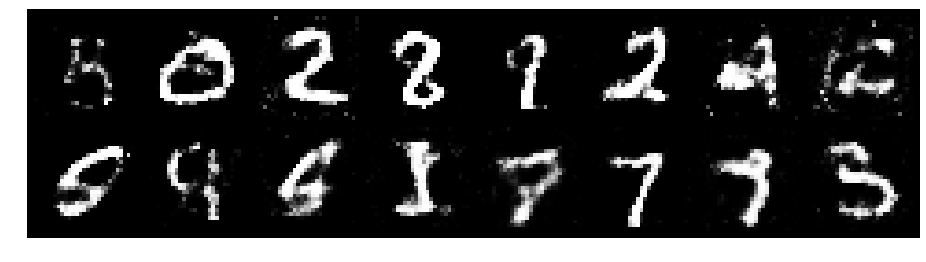

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.3282, Generator Loss: 0.8591
D(x): 0.5516, D(G(z)): 0.4450


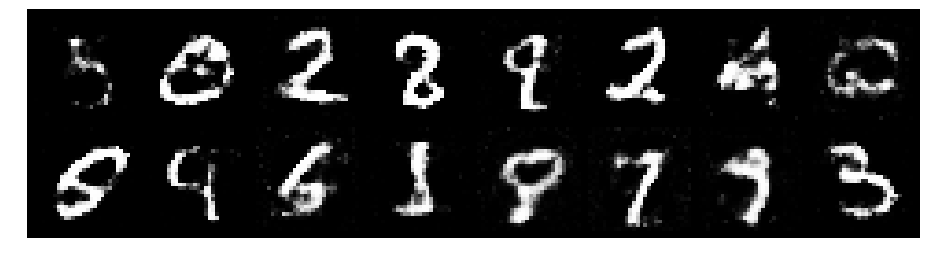

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.4124, Generator Loss: 1.1021
D(x): 0.5395, D(G(z)): 0.4285


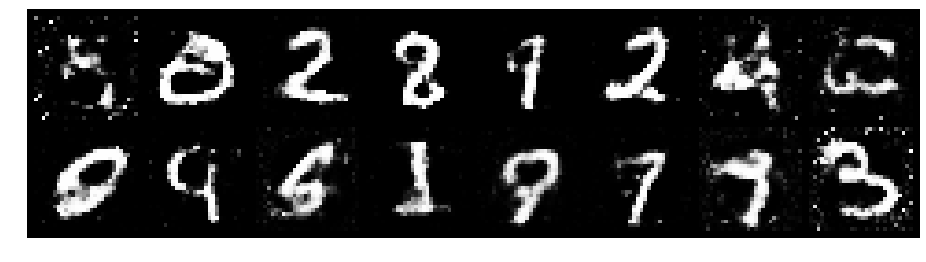

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.3847, Generator Loss: 0.8685
D(x): 0.4966, D(G(z)): 0.4275


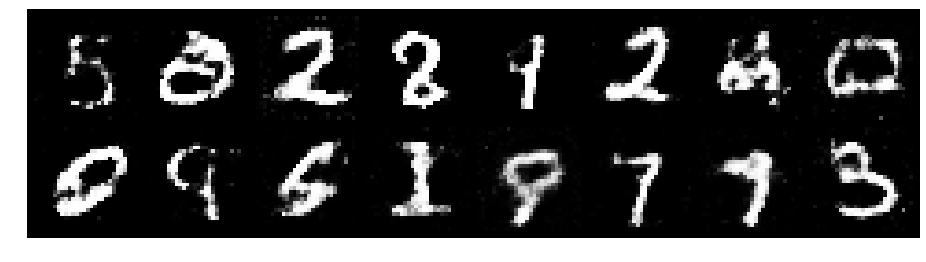

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2293, Generator Loss: 0.7402
D(x): 0.5758, D(G(z)): 0.4451


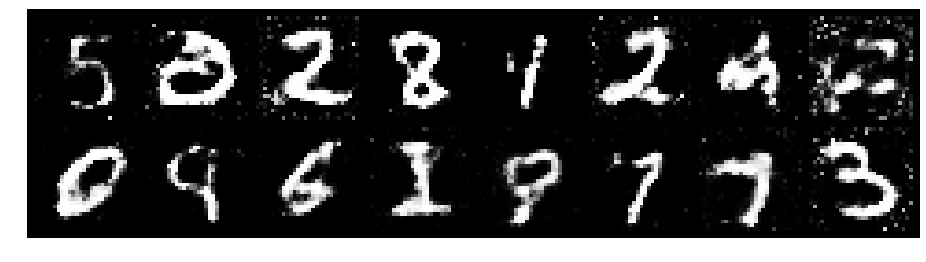

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2268, Generator Loss: 0.7938
D(x): 0.5765, D(G(z)): 0.4588


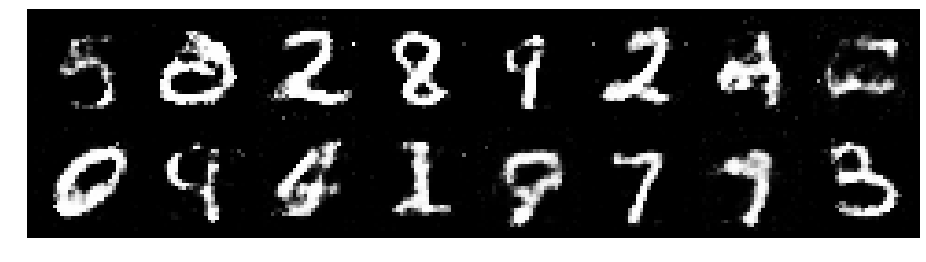

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.2612, Generator Loss: 0.8344
D(x): 0.5910, D(G(z)): 0.4816


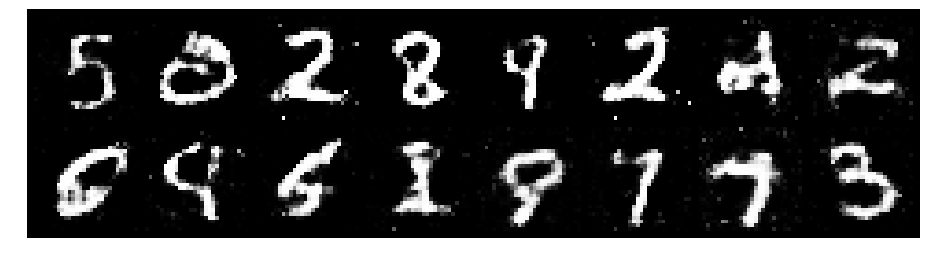

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2349, Generator Loss: 0.9080
D(x): 0.5701, D(G(z)): 0.4327


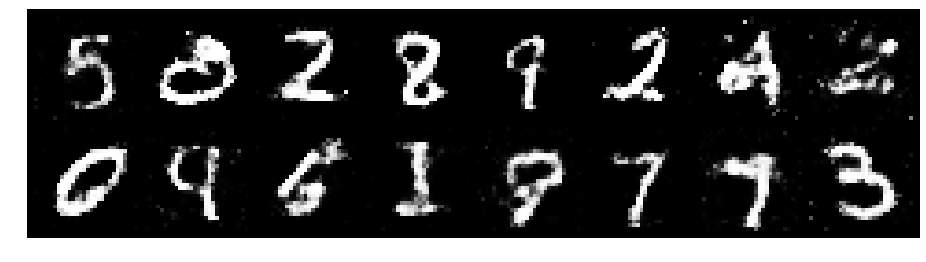

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2616, Generator Loss: 0.9227
D(x): 0.5430, D(G(z)): 0.4094


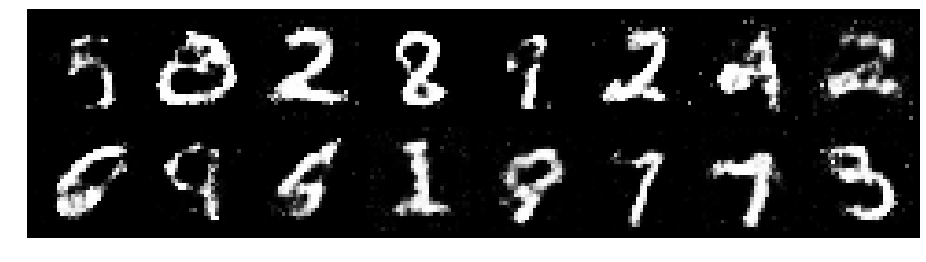

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.3193, Generator Loss: 0.9132
D(x): 0.5926, D(G(z)): 0.4821


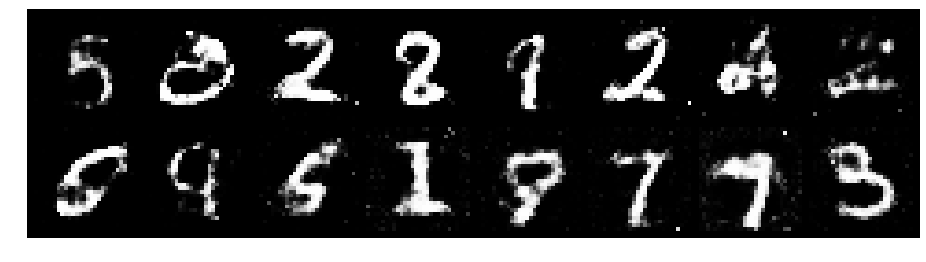

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2460, Generator Loss: 1.0619
D(x): 0.5310, D(G(z)): 0.3882


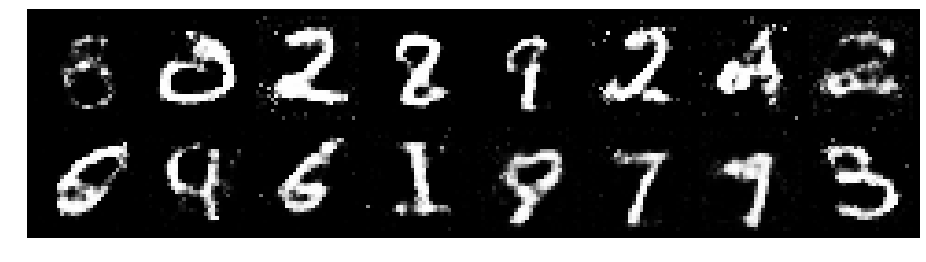

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2798, Generator Loss: 0.8870
D(x): 0.5403, D(G(z)): 0.4369


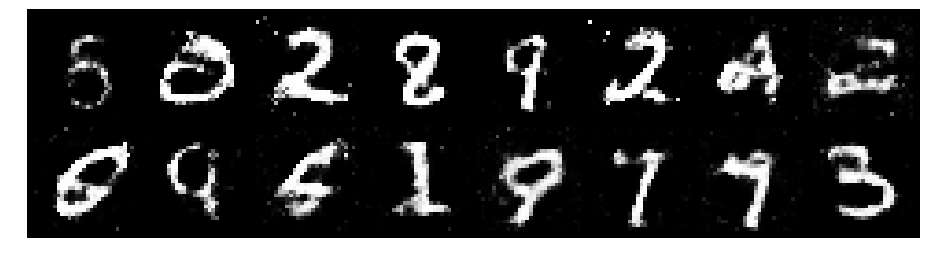

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2411, Generator Loss: 0.8829
D(x): 0.5477, D(G(z)): 0.4303


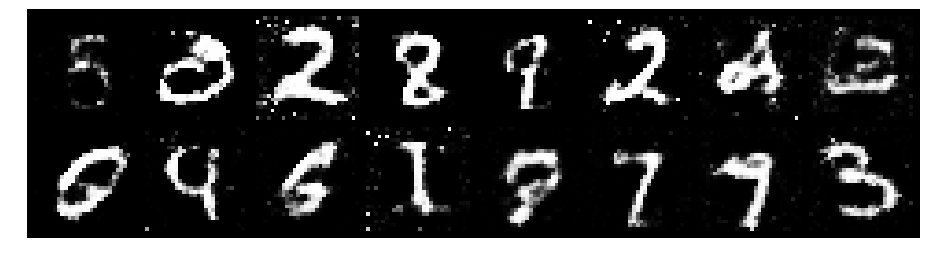

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.1693, Generator Loss: 0.8790
D(x): 0.6041, D(G(z)): 0.4280


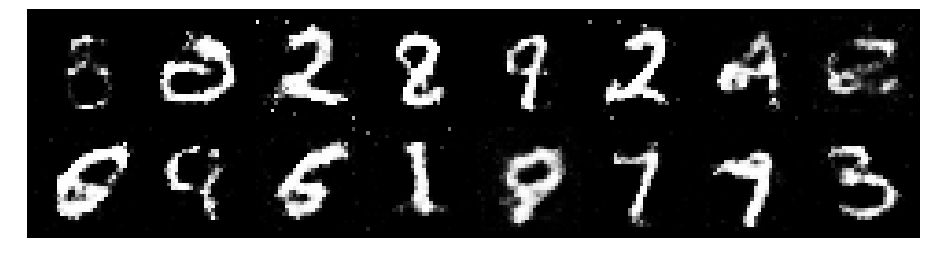

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.1921, Generator Loss: 0.8840
D(x): 0.5578, D(G(z)): 0.4220


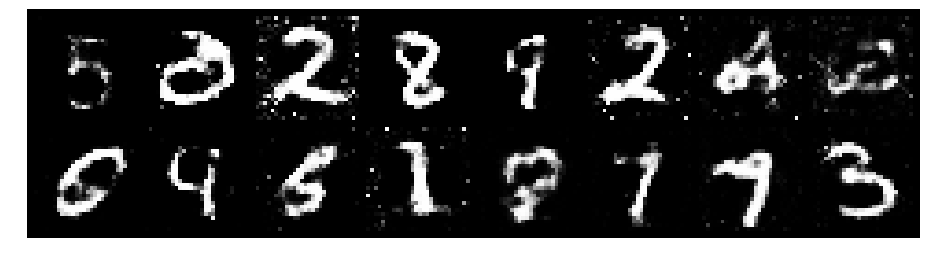

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.1029, Generator Loss: 0.8742
D(x): 0.6350, D(G(z)): 0.4195


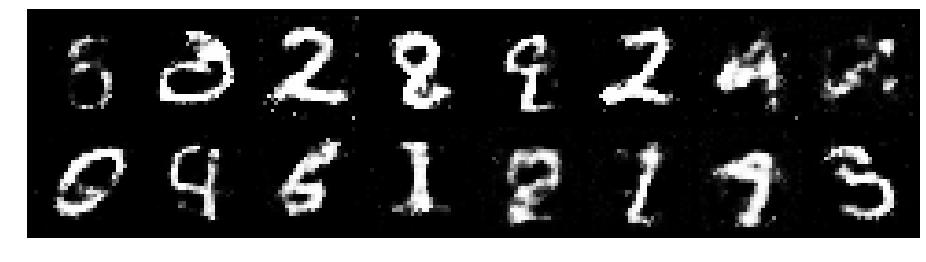

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2578, Generator Loss: 0.9674
D(x): 0.5964, D(G(z)): 0.4553


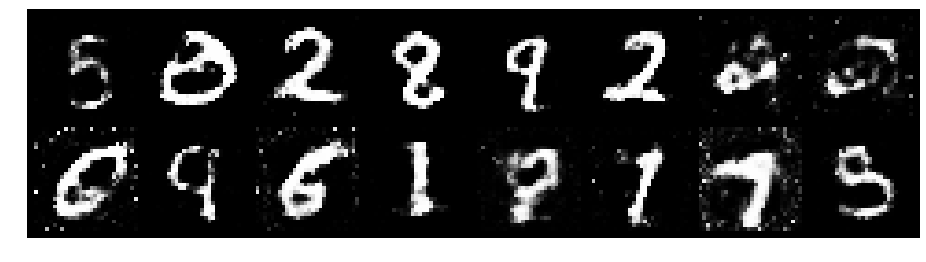

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2630, Generator Loss: 0.7357
D(x): 0.5671, D(G(z)): 0.4685


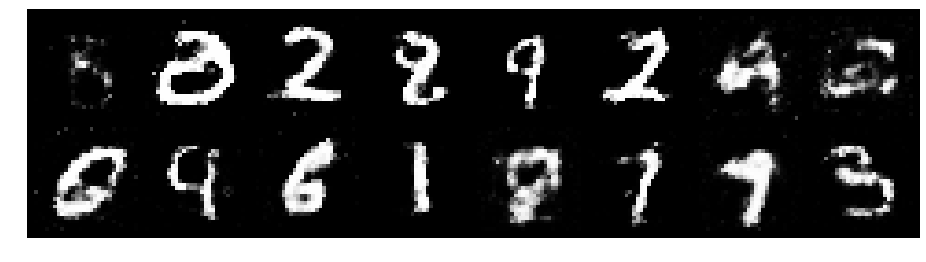

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2700, Generator Loss: 0.8744
D(x): 0.5294, D(G(z)): 0.4365


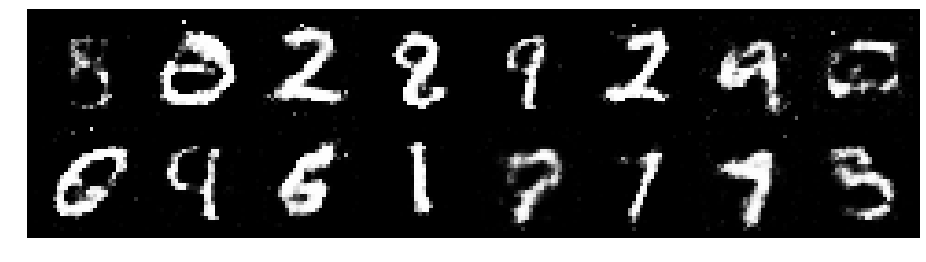

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.3020, Generator Loss: 0.8388
D(x): 0.5722, D(G(z)): 0.4603


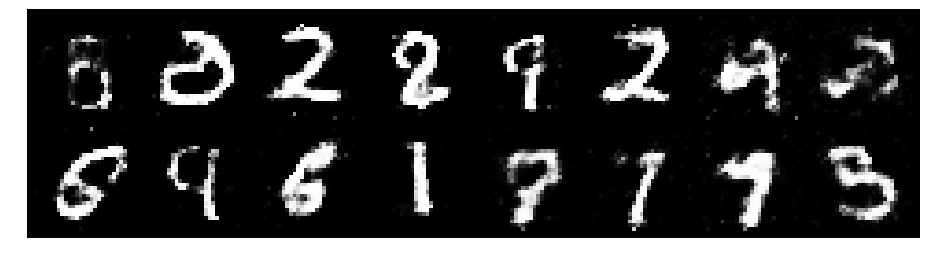

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3134, Generator Loss: 0.9242
D(x): 0.5430, D(G(z)): 0.4350


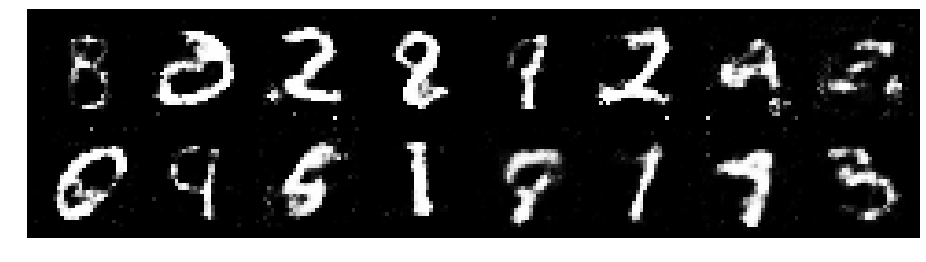

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2798, Generator Loss: 0.9693
D(x): 0.5622, D(G(z)): 0.4382


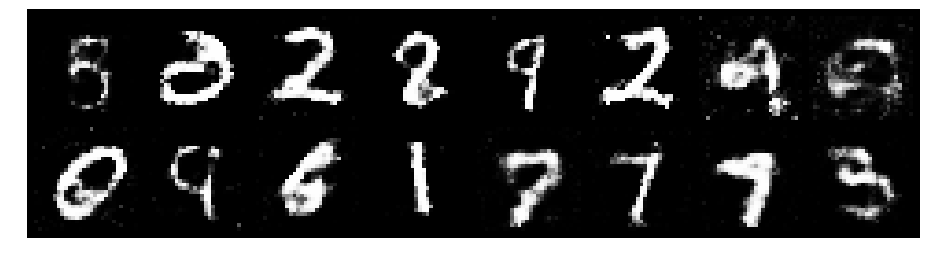

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.1728, Generator Loss: 0.9333
D(x): 0.5987, D(G(z)): 0.4181


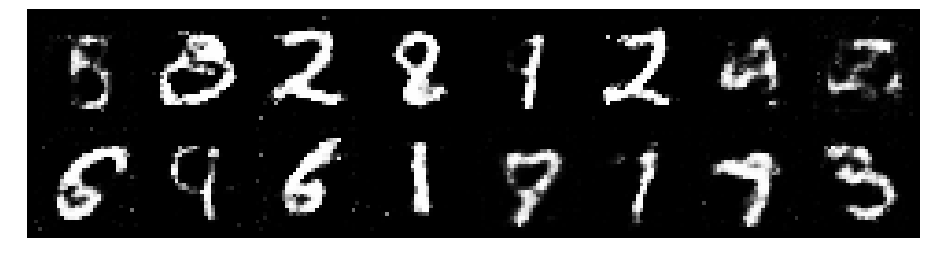

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.3797, Generator Loss: 0.9808
D(x): 0.6056, D(G(z)): 0.5117


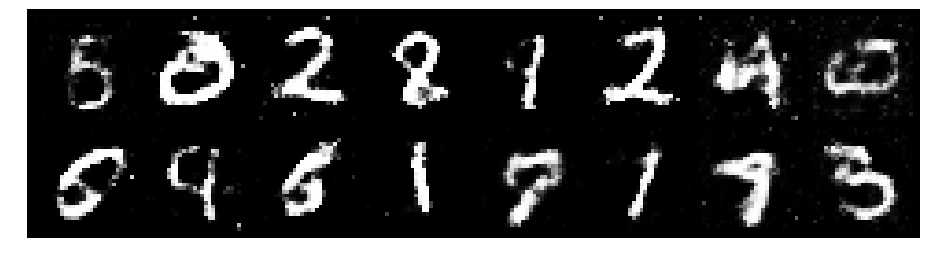

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2211, Generator Loss: 0.9672
D(x): 0.5815, D(G(z)): 0.4238


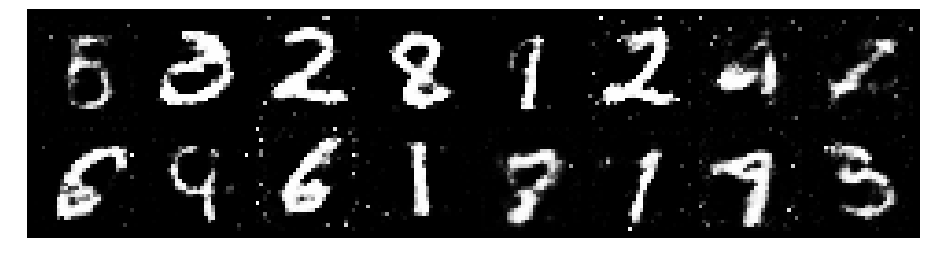

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.3126, Generator Loss: 0.7658
D(x): 0.5576, D(G(z)): 0.4867


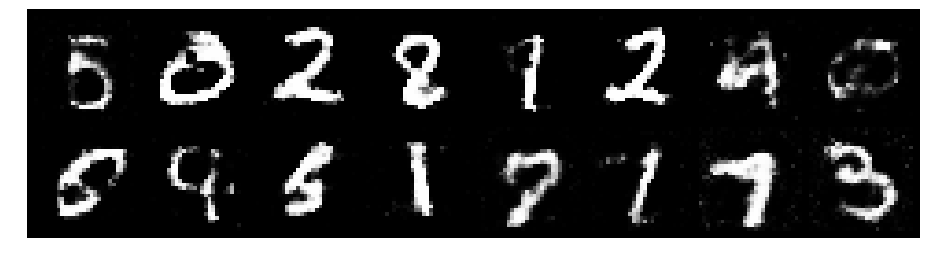

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2080, Generator Loss: 0.9047
D(x): 0.5795, D(G(z)): 0.4342


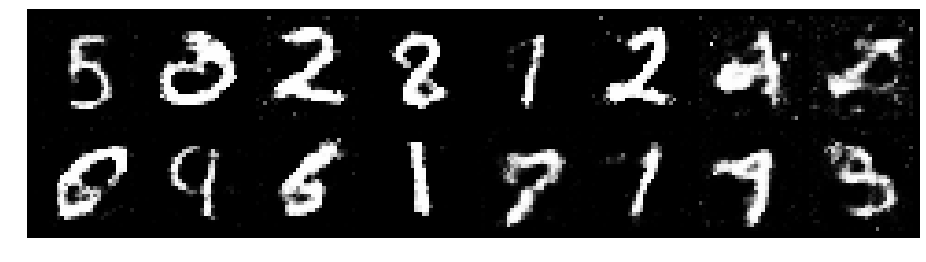

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.2607, Generator Loss: 0.8996
D(x): 0.5569, D(G(z)): 0.4388


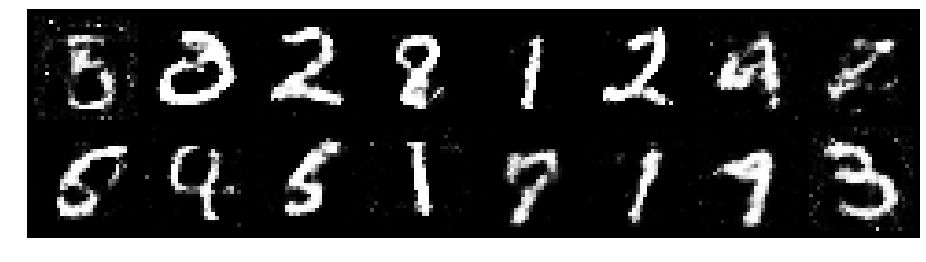

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.1378, Generator Loss: 0.9878
D(x): 0.5654, D(G(z)): 0.3843


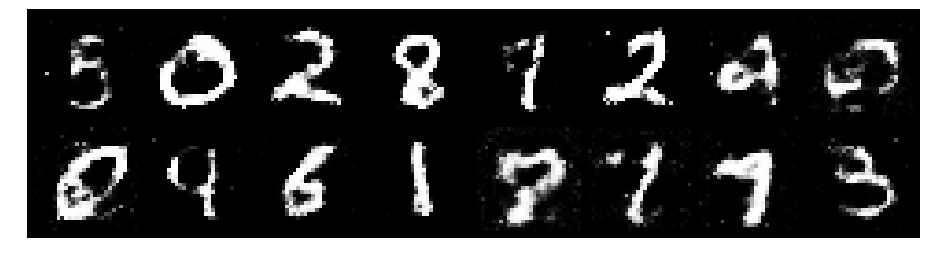

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2153, Generator Loss: 0.9434
D(x): 0.5557, D(G(z)): 0.4383


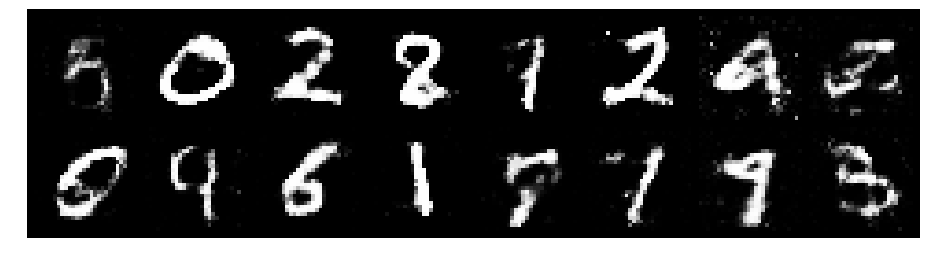

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2717, Generator Loss: 0.9052
D(x): 0.5476, D(G(z)): 0.4465


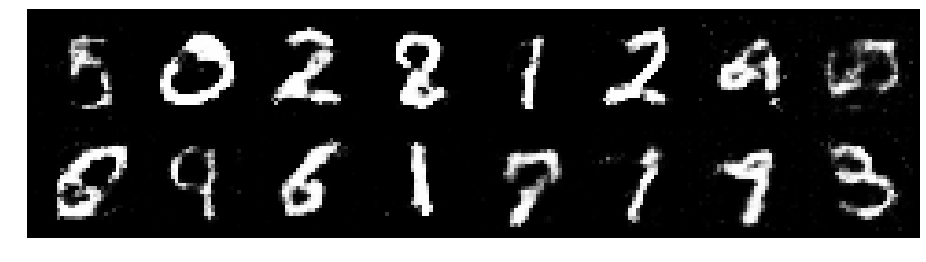

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3240, Generator Loss: 0.7237
D(x): 0.6326, D(G(z)): 0.5191


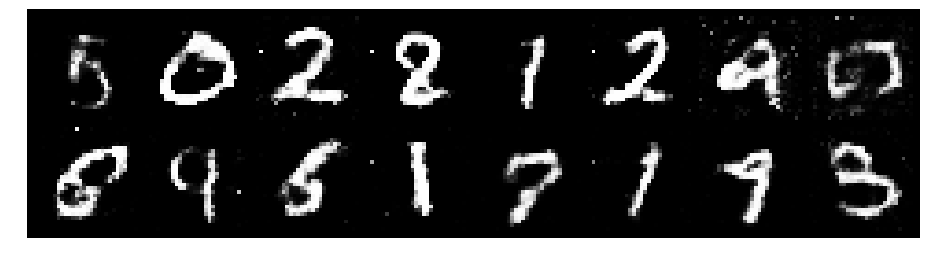

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2487, Generator Loss: 0.9556
D(x): 0.5682, D(G(z)): 0.4236


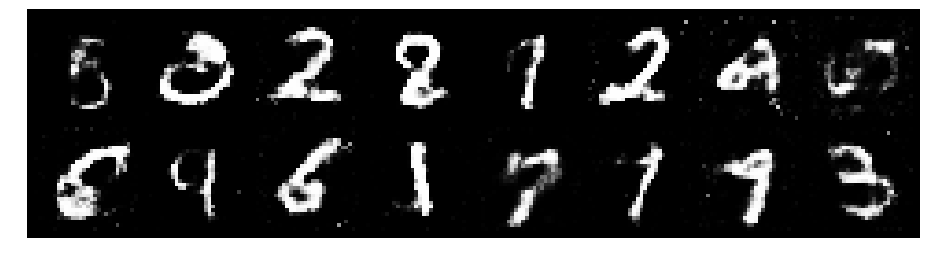

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2878, Generator Loss: 0.8565
D(x): 0.5522, D(G(z)): 0.4414


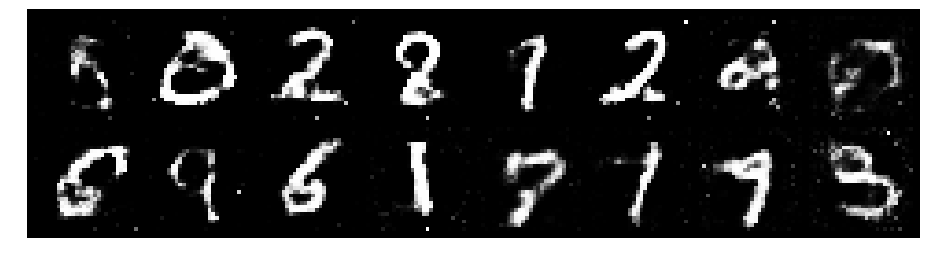

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.1860, Generator Loss: 0.9023
D(x): 0.5843, D(G(z)): 0.4280


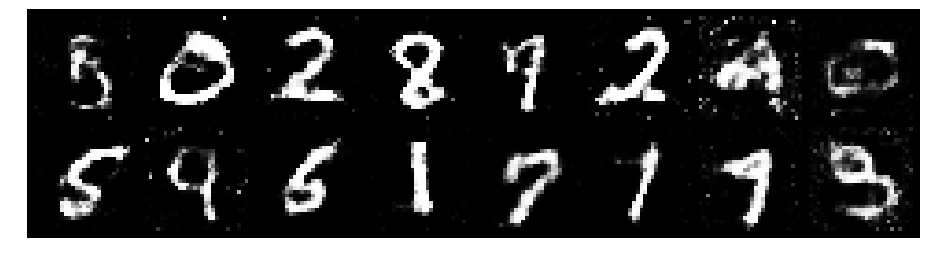

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.3492, Generator Loss: 0.9074
D(x): 0.4984, D(G(z)): 0.4219


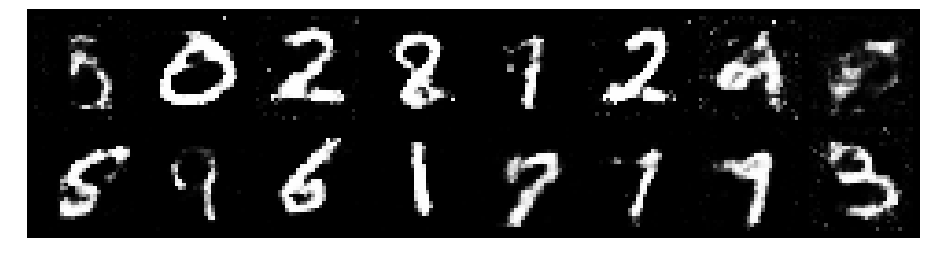

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.1945, Generator Loss: 0.9266
D(x): 0.6111, D(G(z)): 0.4474


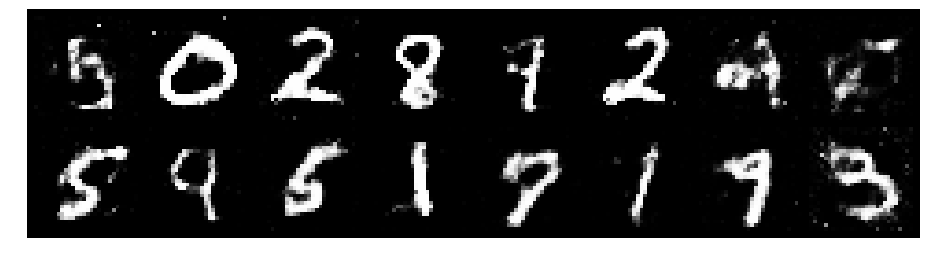

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.3096, Generator Loss: 0.7775
D(x): 0.5324, D(G(z)): 0.4653


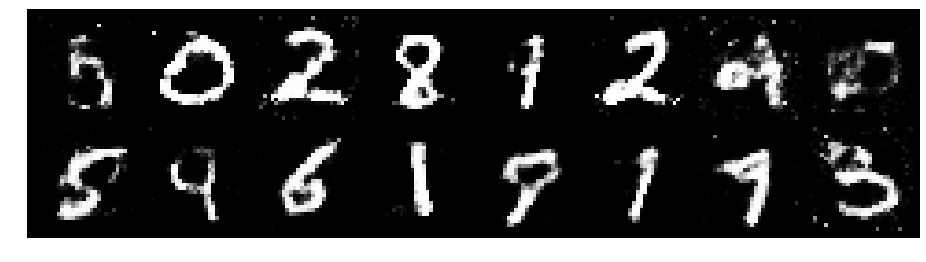

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3045, Generator Loss: 0.7912
D(x): 0.5860, D(G(z)): 0.4943


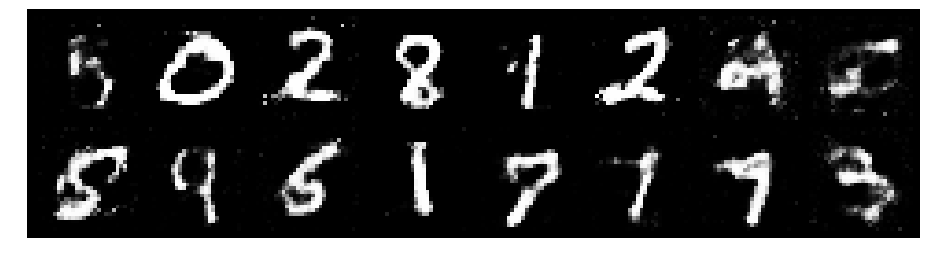

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3363, Generator Loss: 0.8180
D(x): 0.5356, D(G(z)): 0.4322


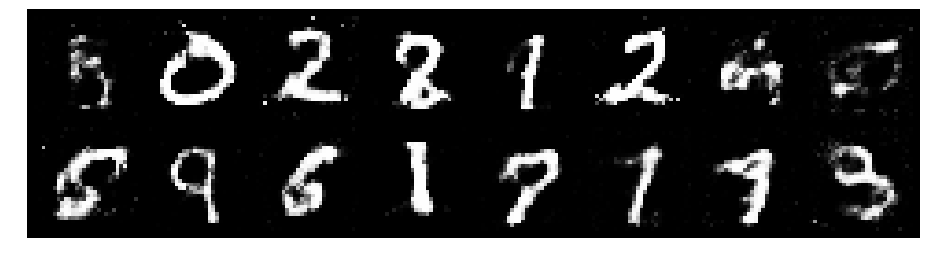

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2445, Generator Loss: 0.7940
D(x): 0.5706, D(G(z)): 0.4539


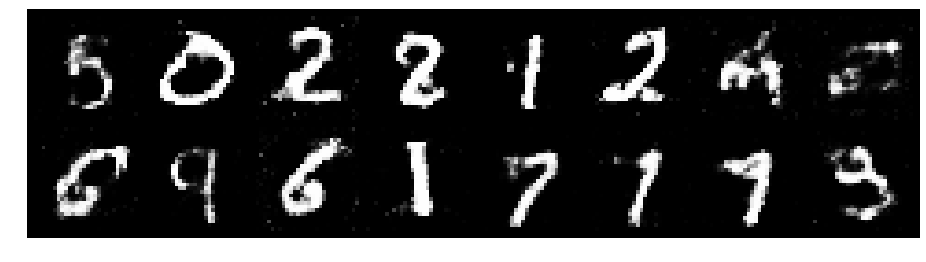

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3040, Generator Loss: 0.9794
D(x): 0.5966, D(G(z)): 0.4790


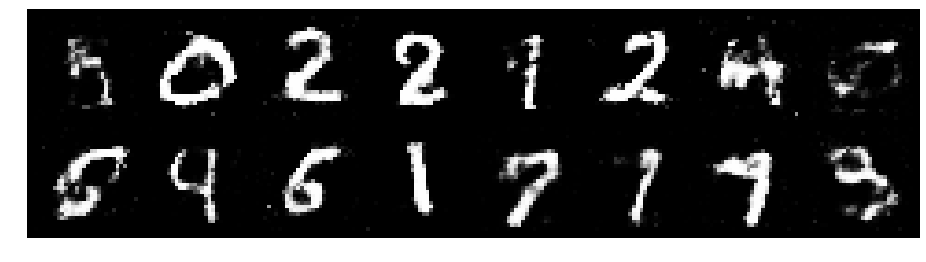

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.1692, Generator Loss: 1.0411
D(x): 0.5586, D(G(z)): 0.4028


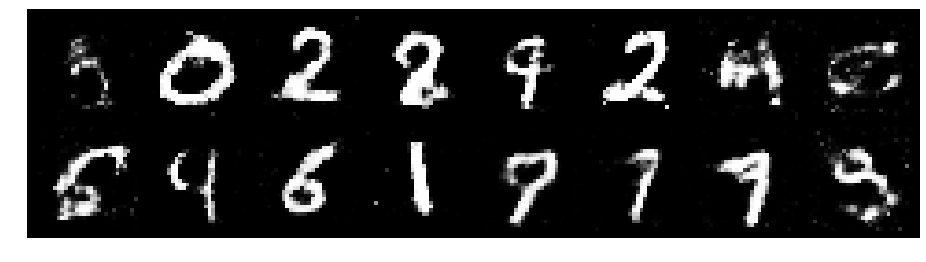

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.1826, Generator Loss: 1.0284
D(x): 0.6249, D(G(z)): 0.4119


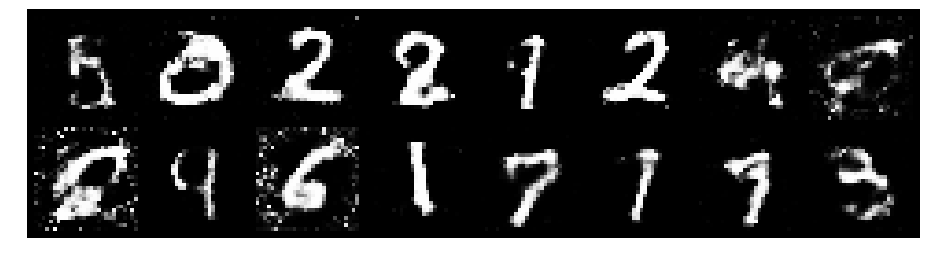

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.3592, Generator Loss: 0.8595
D(x): 0.5421, D(G(z)): 0.4817


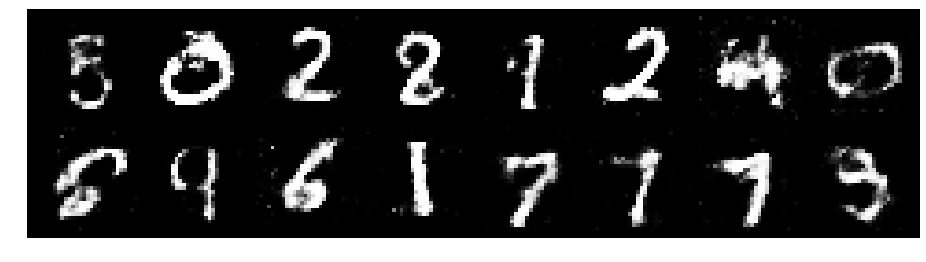

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.3828, Generator Loss: 1.0090
D(x): 0.5943, D(G(z)): 0.4604


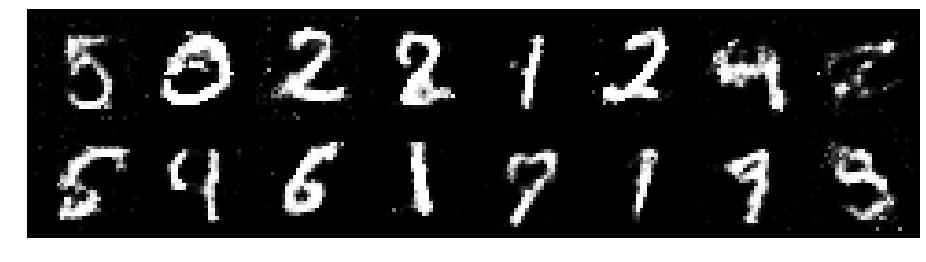

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.1394, Generator Loss: 1.0829
D(x): 0.5867, D(G(z)): 0.3766


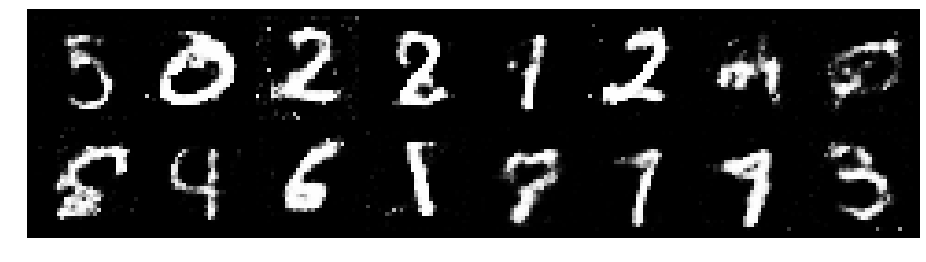

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2172, Generator Loss: 0.9463
D(x): 0.5429, D(G(z)): 0.4081


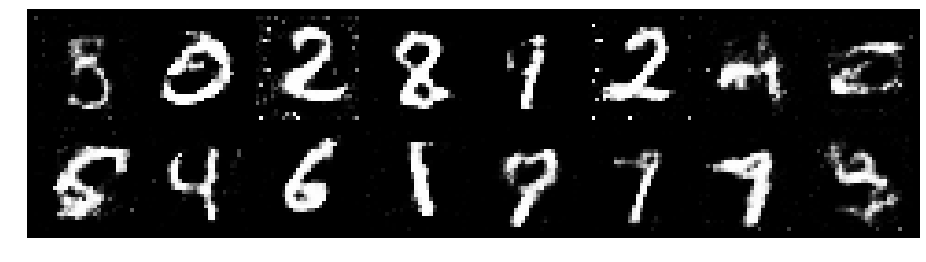

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2937, Generator Loss: 0.8515
D(x): 0.5834, D(G(z)): 0.4624


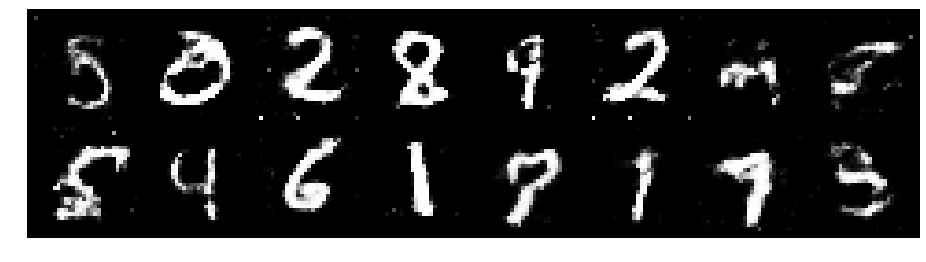

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.1620, Generator Loss: 1.1604
D(x): 0.5934, D(G(z)): 0.3914


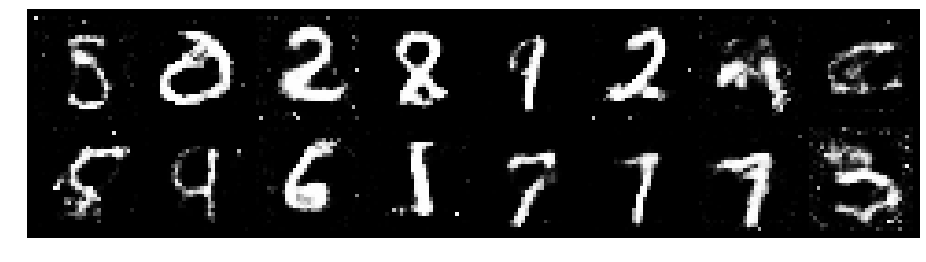

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2002, Generator Loss: 0.8611
D(x): 0.5658, D(G(z)): 0.4363


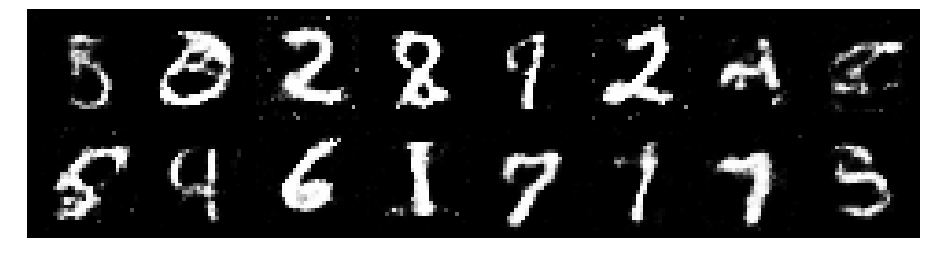

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.2606, Generator Loss: 0.9685
D(x): 0.5232, D(G(z)): 0.3833


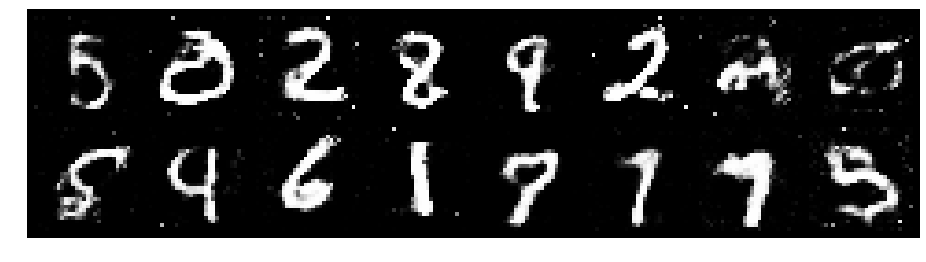

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2698, Generator Loss: 0.9499
D(x): 0.5728, D(G(z)): 0.4305


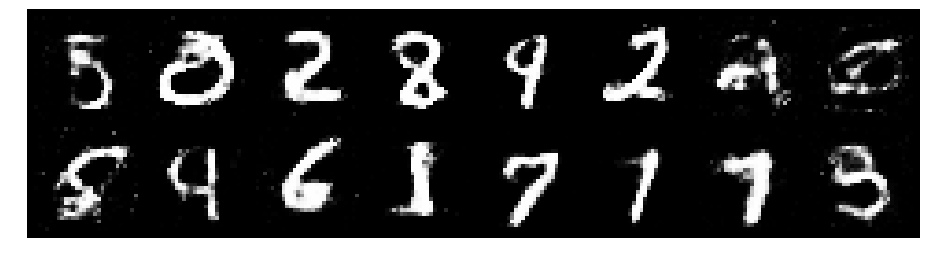

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2416, Generator Loss: 1.0150
D(x): 0.5693, D(G(z)): 0.4302


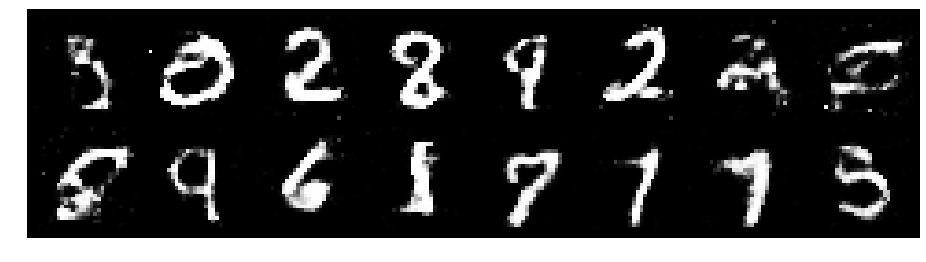

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.2056, Generator Loss: 1.0241
D(x): 0.5804, D(G(z)): 0.4128


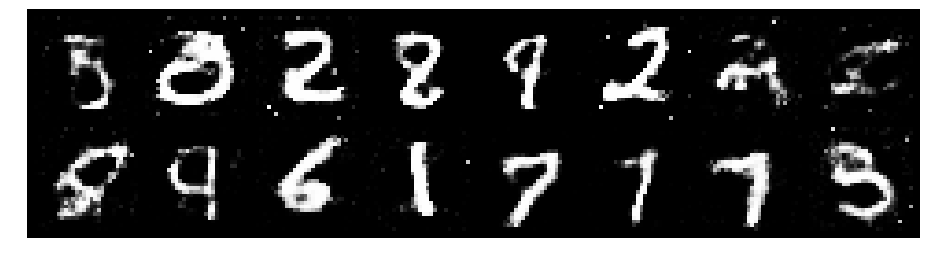

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.4098, Generator Loss: 0.9976
D(x): 0.5202, D(G(z)): 0.4614


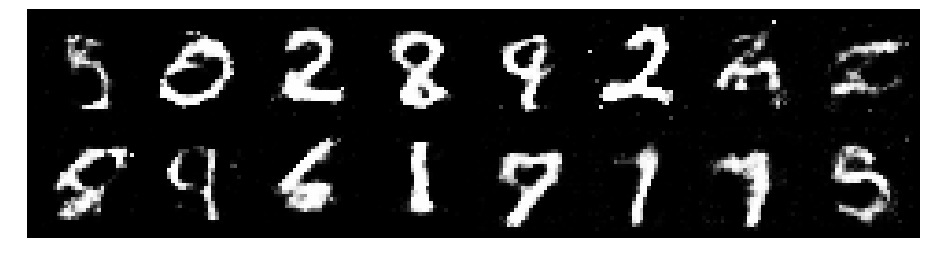

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.3846, Generator Loss: 0.8571
D(x): 0.5567, D(G(z)): 0.4932


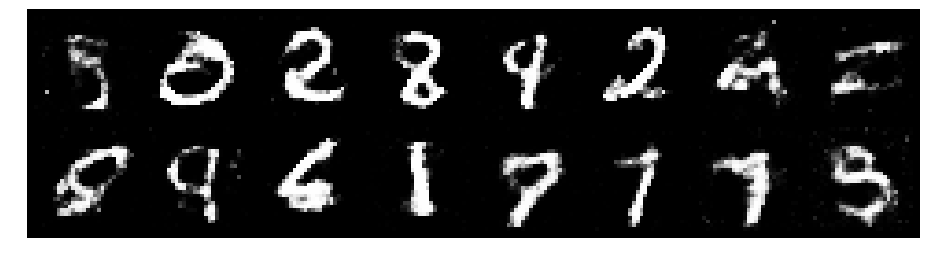

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2750, Generator Loss: 0.8209
D(x): 0.5281, D(G(z)): 0.4515


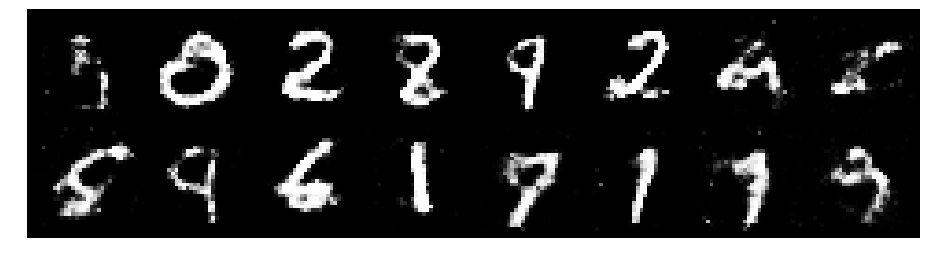

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.3048, Generator Loss: 0.7626
D(x): 0.5518, D(G(z)): 0.4829


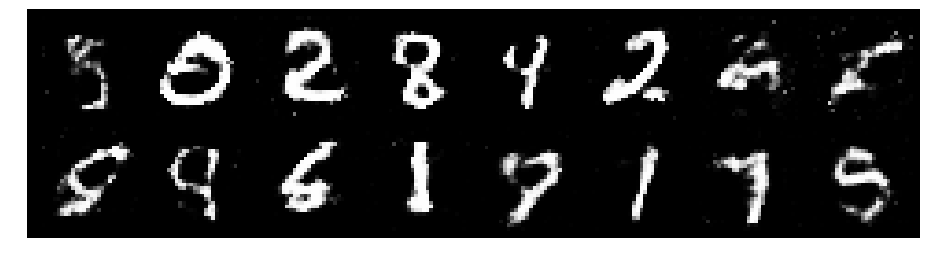

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3473, Generator Loss: 0.8983
D(x): 0.5104, D(G(z)): 0.4242


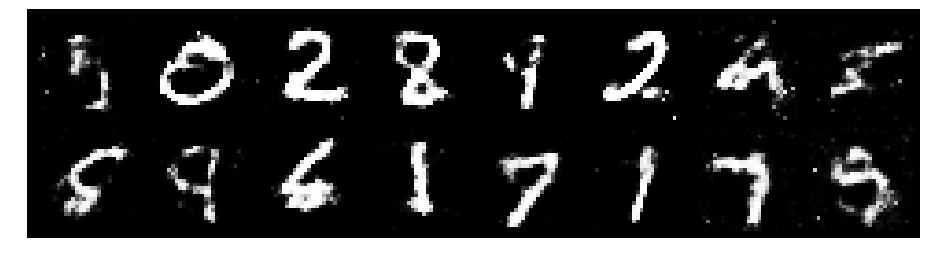

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.2692, Generator Loss: 0.8868
D(x): 0.5378, D(G(z)): 0.4185


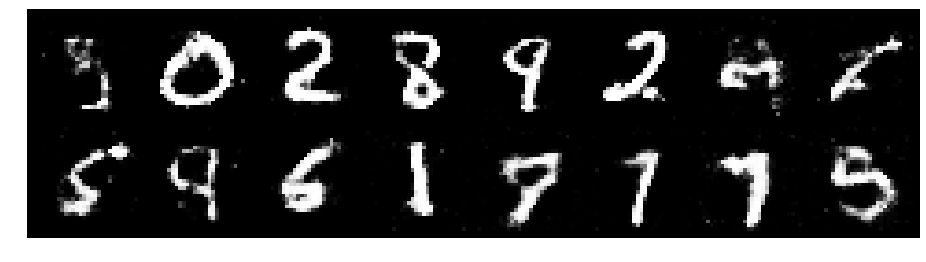

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.3223, Generator Loss: 0.7836
D(x): 0.5264, D(G(z)): 0.4577


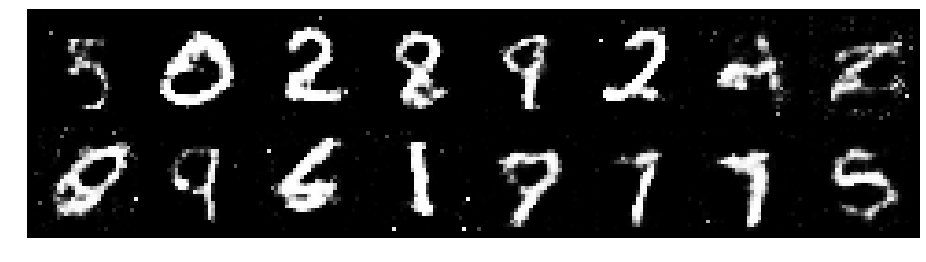

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2787, Generator Loss: 0.8356
D(x): 0.5600, D(G(z)): 0.4556


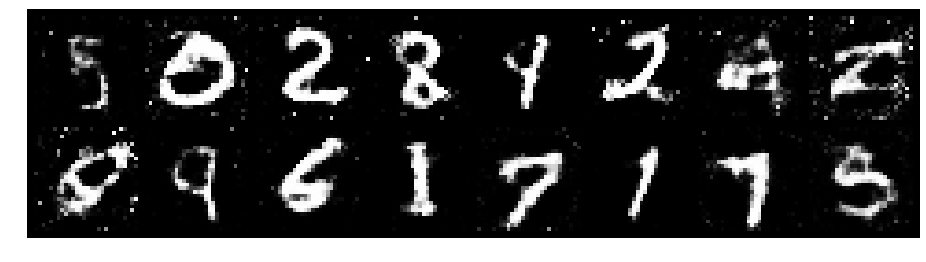

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2782, Generator Loss: 0.8239
D(x): 0.5534, D(G(z)): 0.4616


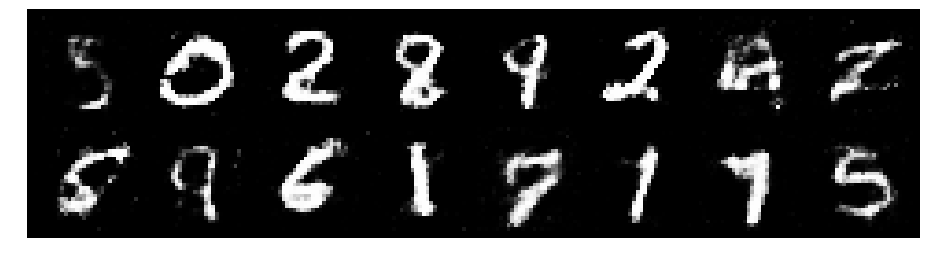

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.3398, Generator Loss: 0.7617
D(x): 0.5267, D(G(z)): 0.4680


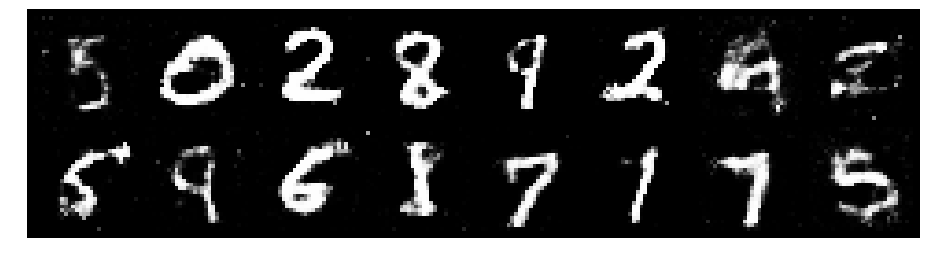

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.3984, Generator Loss: 0.7677
D(x): 0.5876, D(G(z)): 0.4859


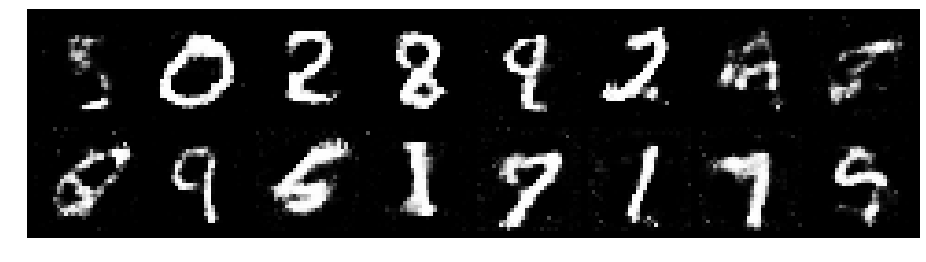

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.3181, Generator Loss: 0.8998
D(x): 0.5397, D(G(z)): 0.4458


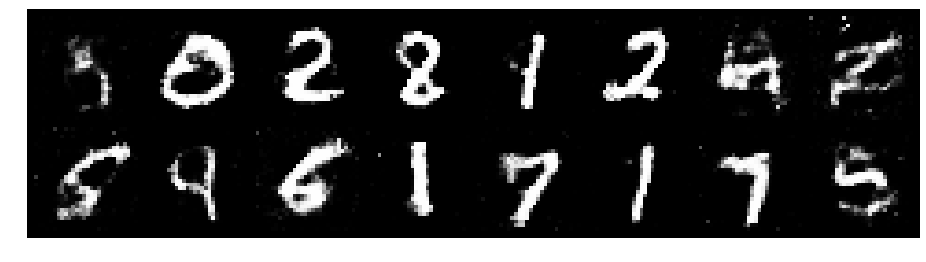

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.3104, Generator Loss: 0.8752
D(x): 0.5187, D(G(z)): 0.4402


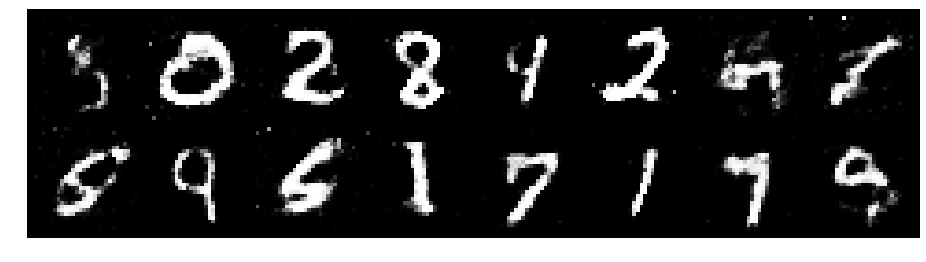

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.3226, Generator Loss: 0.8694
D(x): 0.5194, D(G(z)): 0.4504


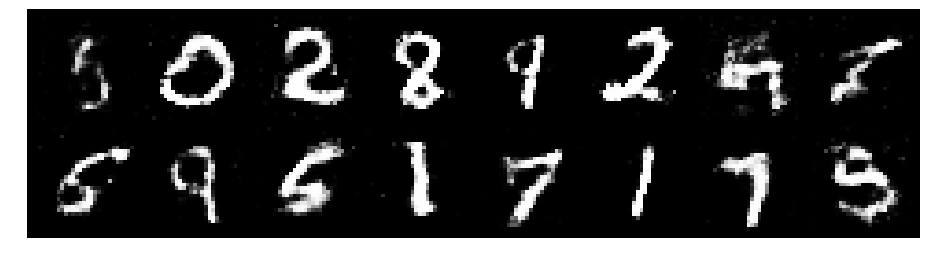

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.3075, Generator Loss: 0.8168
D(x): 0.5378, D(G(z)): 0.4503


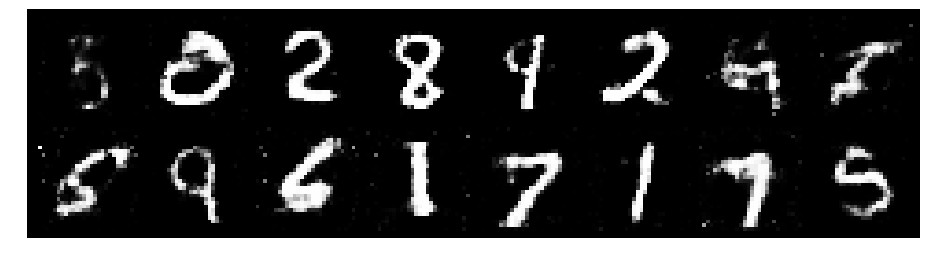

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2809, Generator Loss: 0.8492
D(x): 0.5592, D(G(z)): 0.4579


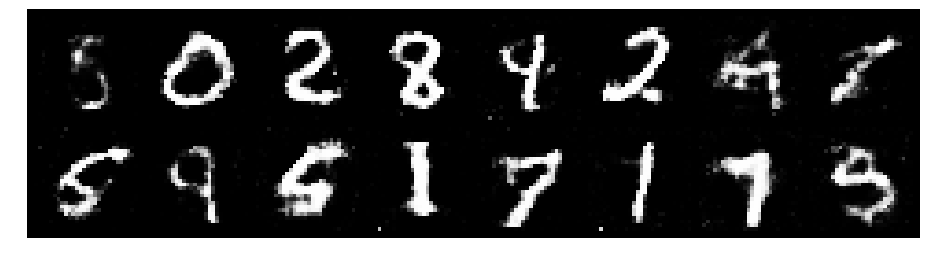

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2702, Generator Loss: 0.8411
D(x): 0.5304, D(G(z)): 0.4250


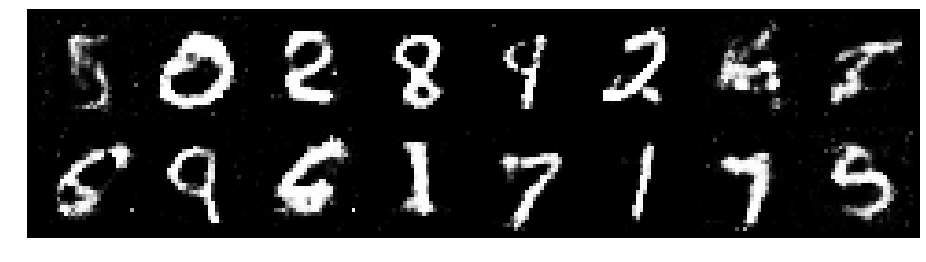

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2393, Generator Loss: 0.9027
D(x): 0.5622, D(G(z)): 0.4402


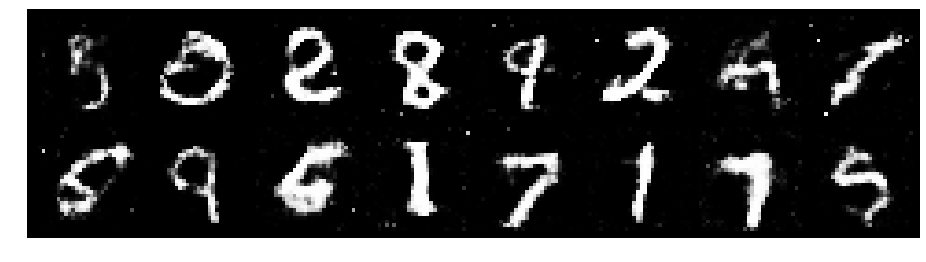

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2605, Generator Loss: 0.8432
D(x): 0.5948, D(G(z)): 0.4681


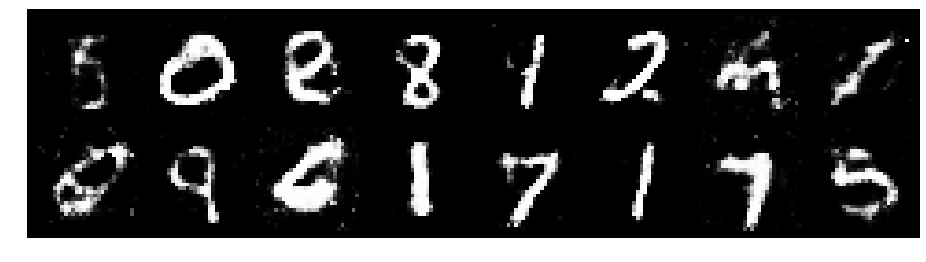

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2475, Generator Loss: 1.0278
D(x): 0.5308, D(G(z)): 0.4014


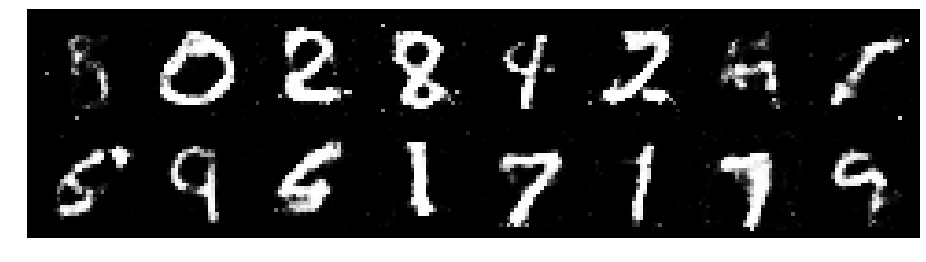

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.1749, Generator Loss: 0.9651
D(x): 0.5522, D(G(z)): 0.3852


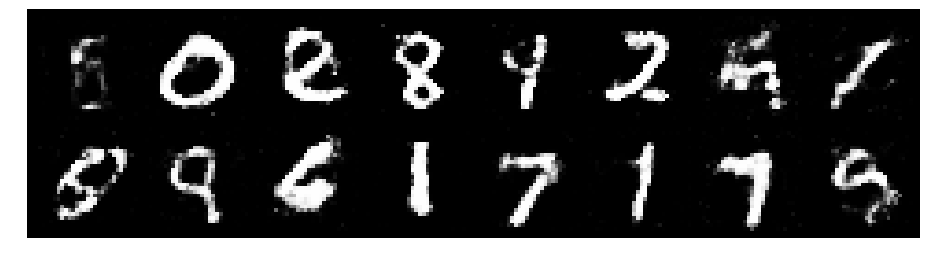

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2161, Generator Loss: 1.0185
D(x): 0.5387, D(G(z)): 0.3981


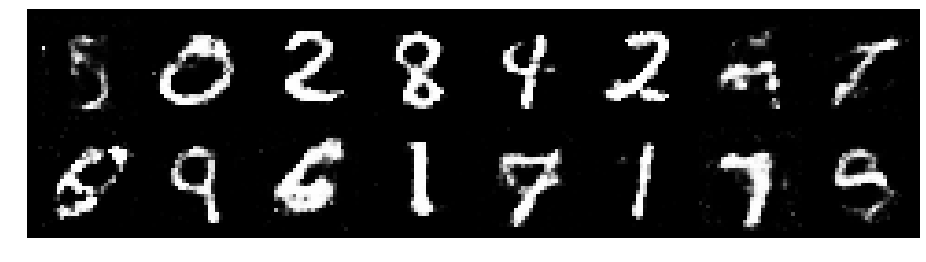

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.1843, Generator Loss: 0.9436
D(x): 0.5775, D(G(z)): 0.4158


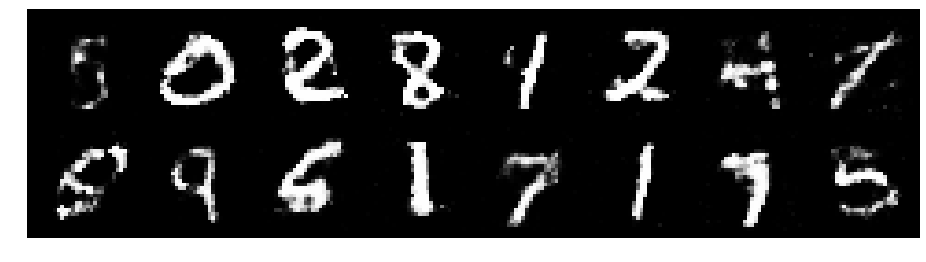

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.2260, Generator Loss: 0.9344
D(x): 0.5380, D(G(z)): 0.4225


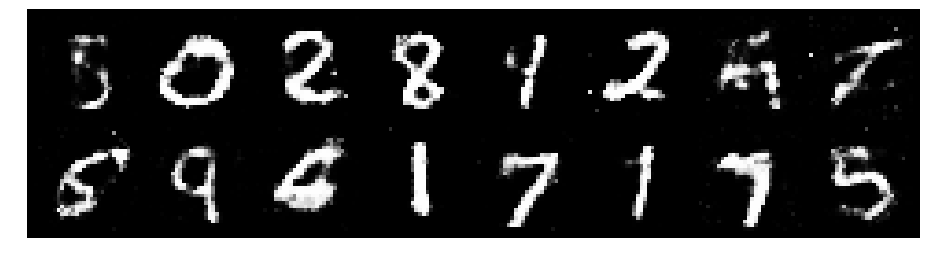

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2609, Generator Loss: 0.7748
D(x): 0.5533, D(G(z)): 0.4506


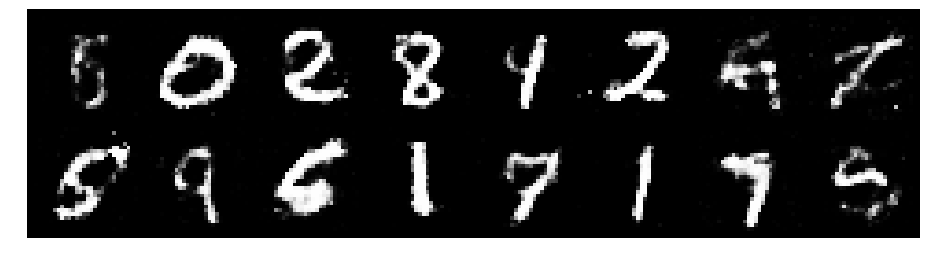

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2744, Generator Loss: 0.8687
D(x): 0.5417, D(G(z)): 0.4447


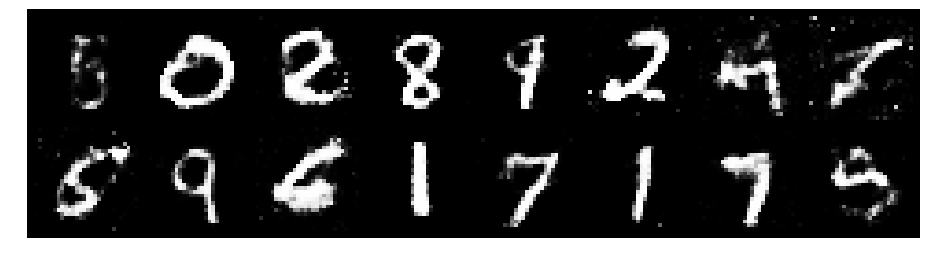

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.3062, Generator Loss: 0.8963
D(x): 0.5436, D(G(z)): 0.4519


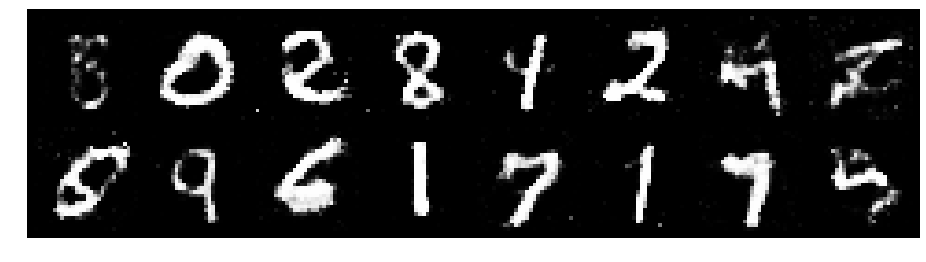

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.1462, Generator Loss: 0.9838
D(x): 0.6144, D(G(z)): 0.4063


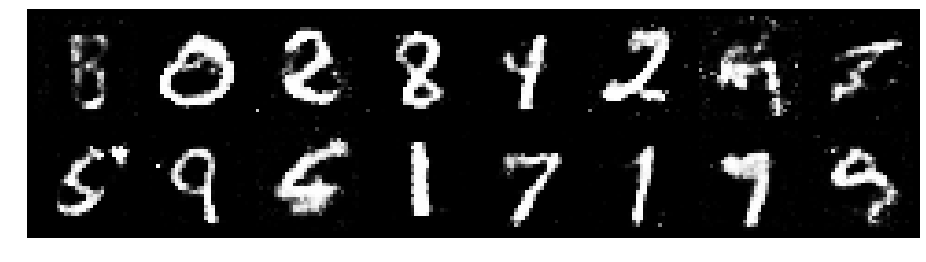

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.2388, Generator Loss: 0.8808
D(x): 0.5451, D(G(z)): 0.4178


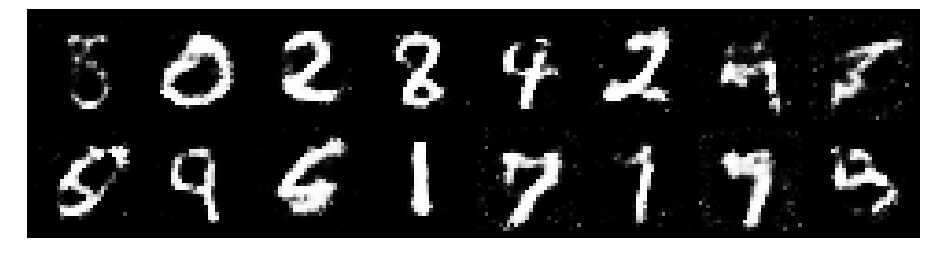

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3401, Generator Loss: 0.8668
D(x): 0.5202, D(G(z)): 0.4478


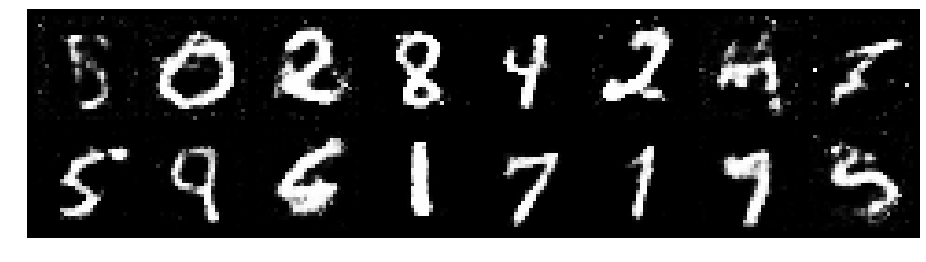

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2538, Generator Loss: 0.8300
D(x): 0.6212, D(G(z)): 0.4452


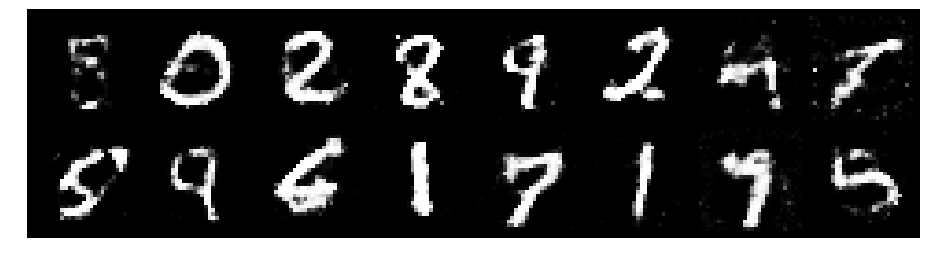

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.1281, Generator Loss: 0.9253
D(x): 0.6096, D(G(z)): 0.3964


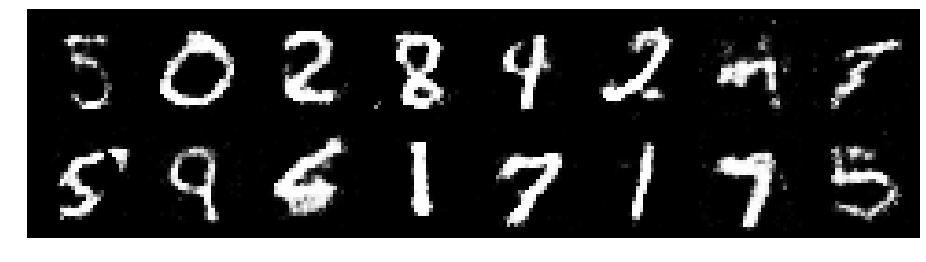

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.2653, Generator Loss: 1.0236
D(x): 0.5369, D(G(z)): 0.3978


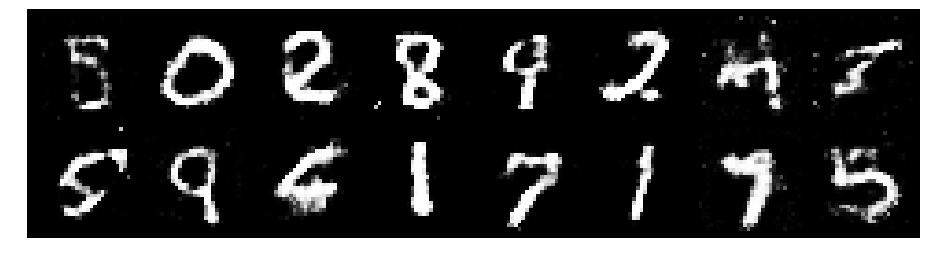

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2205, Generator Loss: 0.9680
D(x): 0.5446, D(G(z)): 0.4020


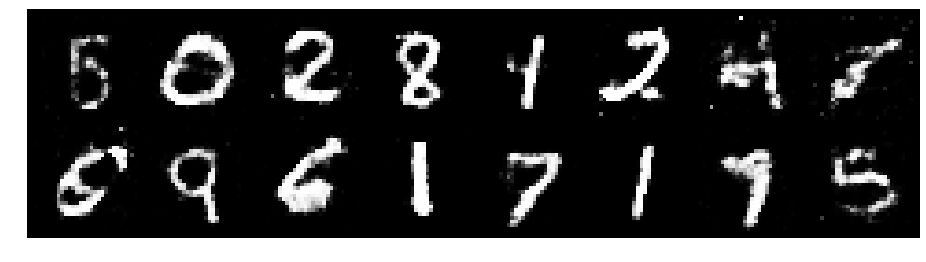

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.3296, Generator Loss: 0.8731
D(x): 0.5443, D(G(z)): 0.4584


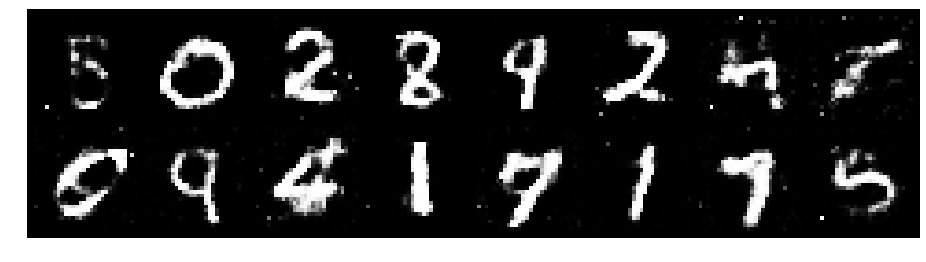

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2732, Generator Loss: 0.8750
D(x): 0.5494, D(G(z)): 0.4522


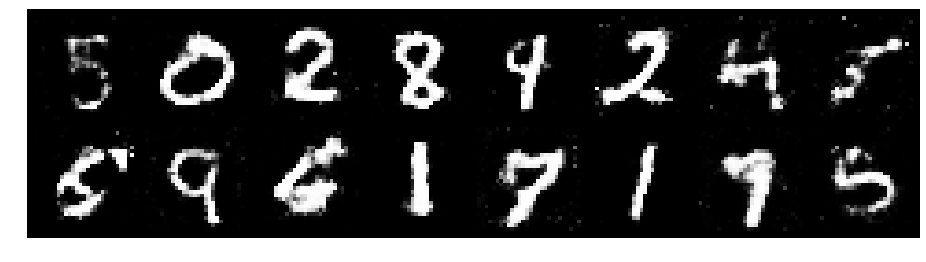

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.2859, Generator Loss: 0.9020
D(x): 0.5387, D(G(z)): 0.4258


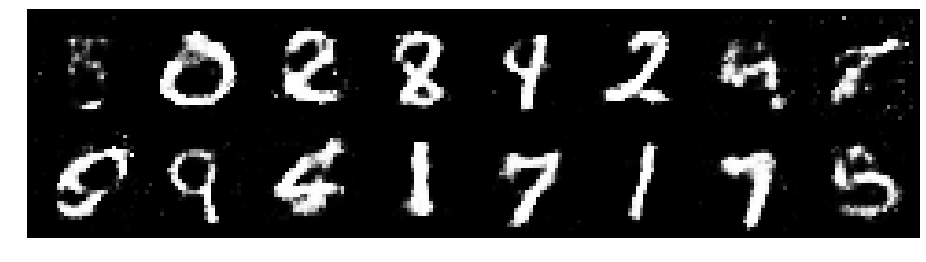

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.1210, Generator Loss: 1.2587
D(x): 0.5947, D(G(z)): 0.3819


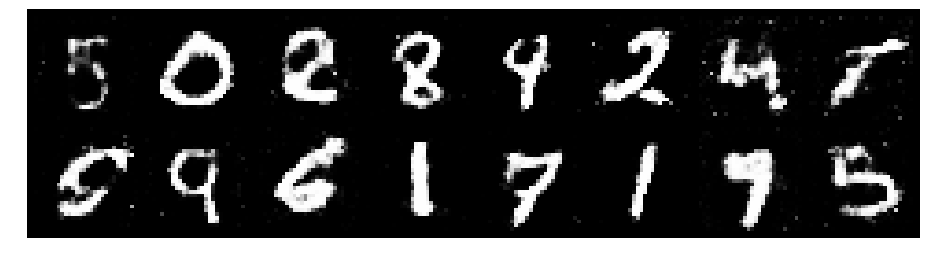

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.2849, Generator Loss: 1.0883
D(x): 0.5705, D(G(z)): 0.4393


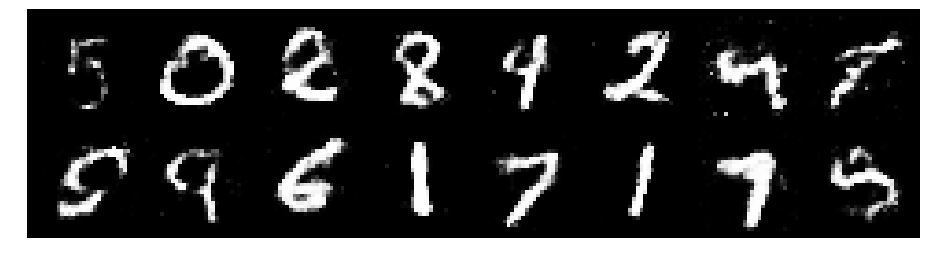

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2332, Generator Loss: 0.8749
D(x): 0.5510, D(G(z)): 0.4084


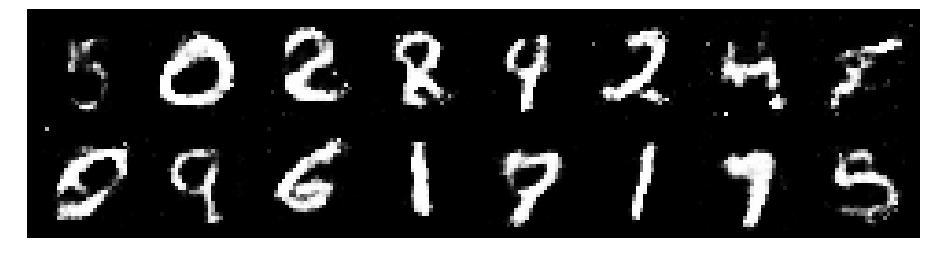

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3145, Generator Loss: 0.7680
D(x): 0.6074, D(G(z)): 0.4898


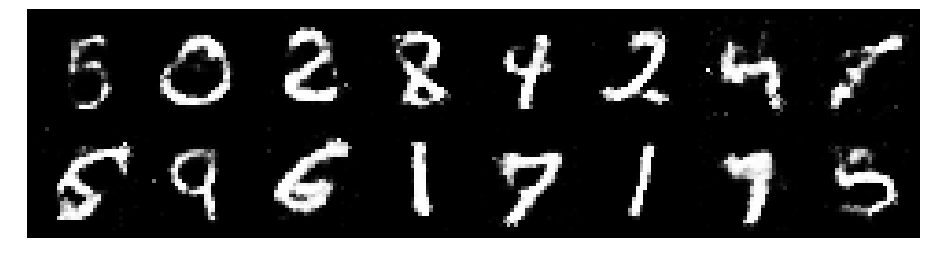

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2799, Generator Loss: 1.2033
D(x): 0.5939, D(G(z)): 0.4526


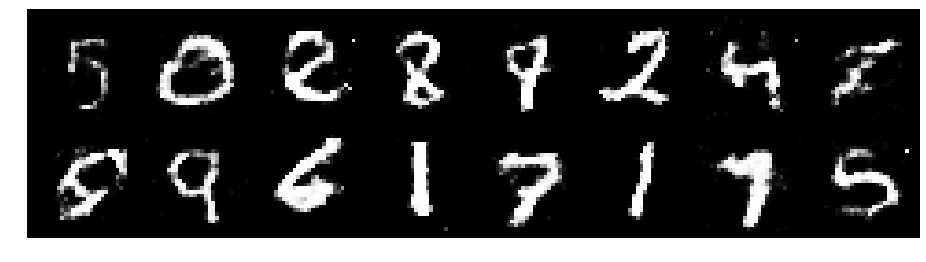

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.1494, Generator Loss: 0.9254
D(x): 0.5987, D(G(z)): 0.4276


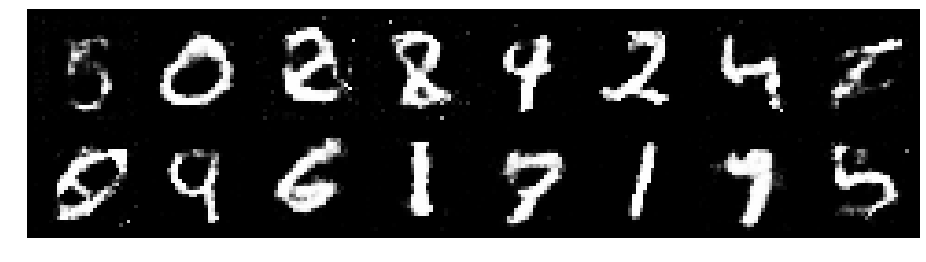

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.3361, Generator Loss: 0.8941
D(x): 0.5565, D(G(z)): 0.4685


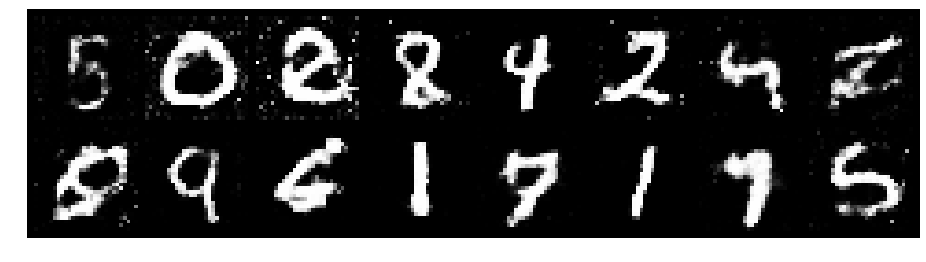

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.3639, Generator Loss: 0.7799
D(x): 0.5463, D(G(z)): 0.4616


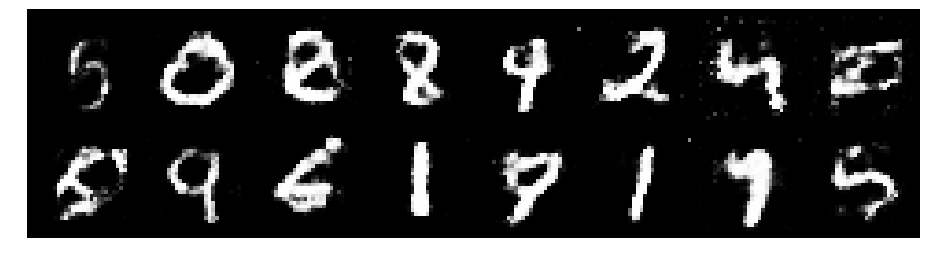

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2693, Generator Loss: 0.8964
D(x): 0.5709, D(G(z)): 0.4567


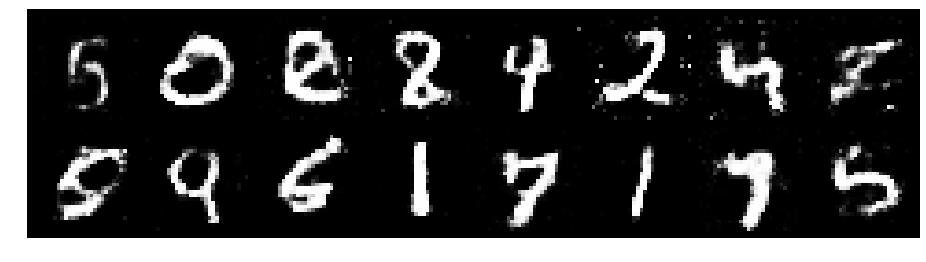

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2617, Generator Loss: 0.9365
D(x): 0.5364, D(G(z)): 0.4250


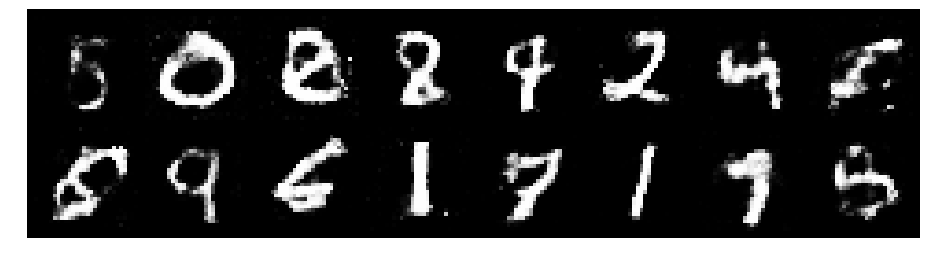

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.3718, Generator Loss: 0.7824
D(x): 0.5307, D(G(z)): 0.4745


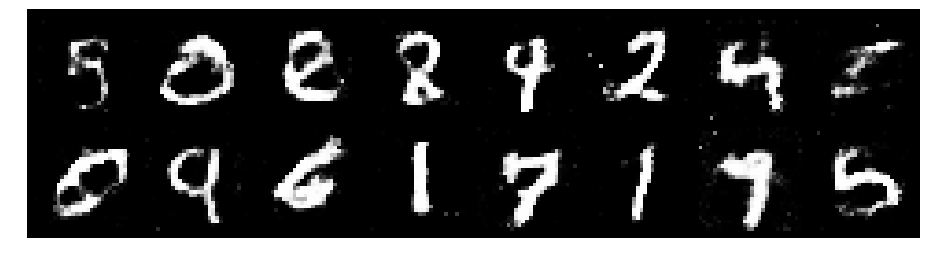

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.2310, Generator Loss: 0.8933
D(x): 0.5673, D(G(z)): 0.4176


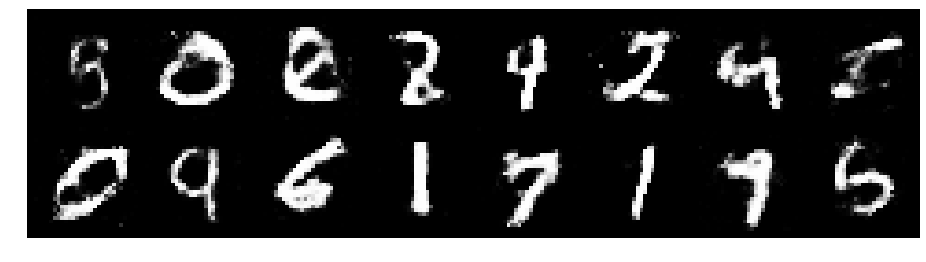

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2189, Generator Loss: 0.9189
D(x): 0.5796, D(G(z)): 0.4432


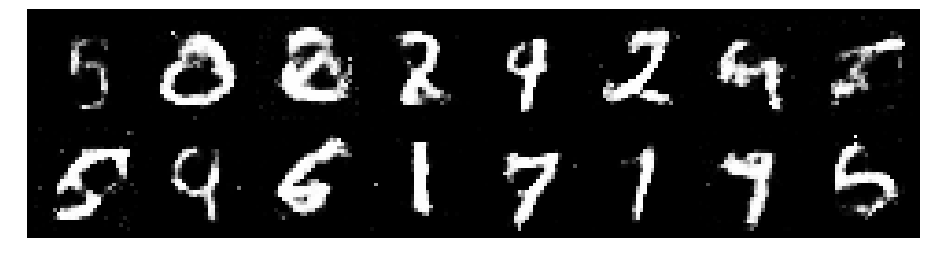

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.1933, Generator Loss: 0.9277
D(x): 0.5408, D(G(z)): 0.3995


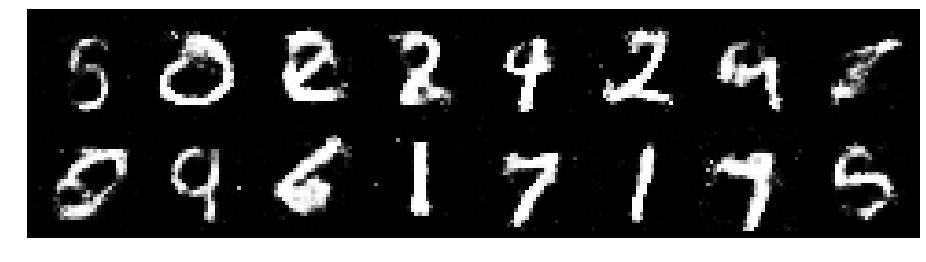

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2296, Generator Loss: 1.1952
D(x): 0.5873, D(G(z)): 0.3937


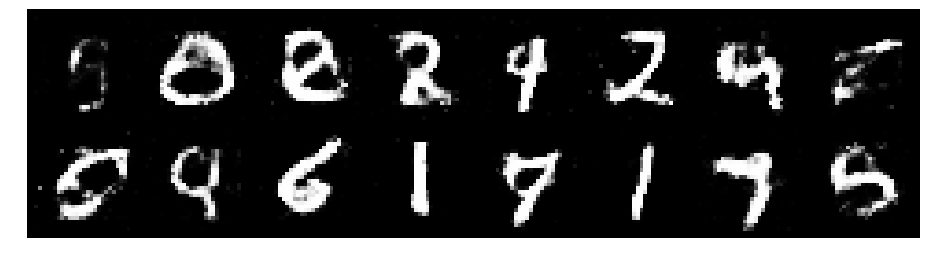

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.3101, Generator Loss: 0.8531
D(x): 0.5119, D(G(z)): 0.4233


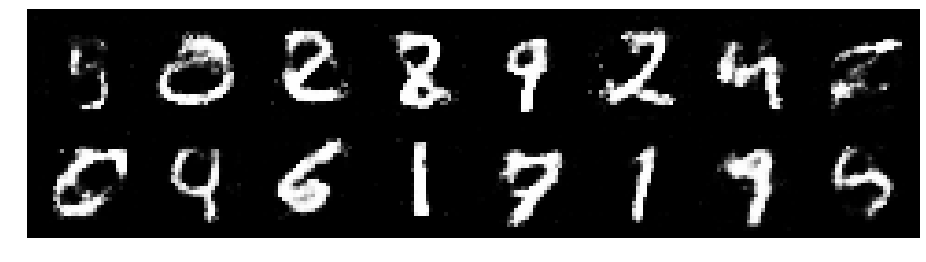

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.4155, Generator Loss: 1.1203
D(x): 0.5025, D(G(z)): 0.4276


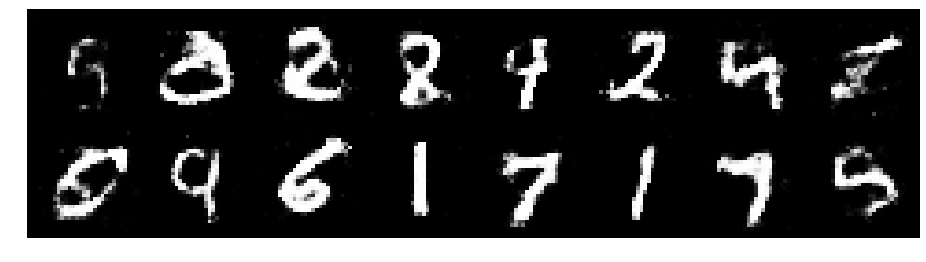

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.1197, Generator Loss: 1.0857
D(x): 0.5673, D(G(z)): 0.3867


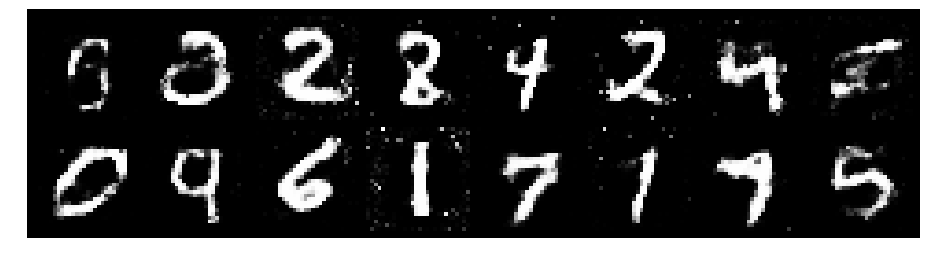

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2975, Generator Loss: 0.8539
D(x): 0.5561, D(G(z)): 0.4626


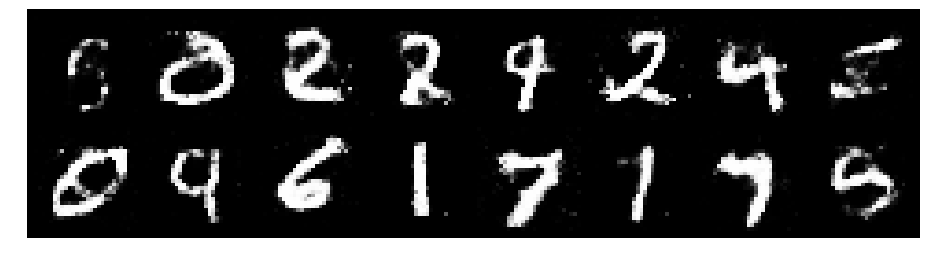

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.1697, Generator Loss: 1.0320
D(x): 0.5825, D(G(z)): 0.4149


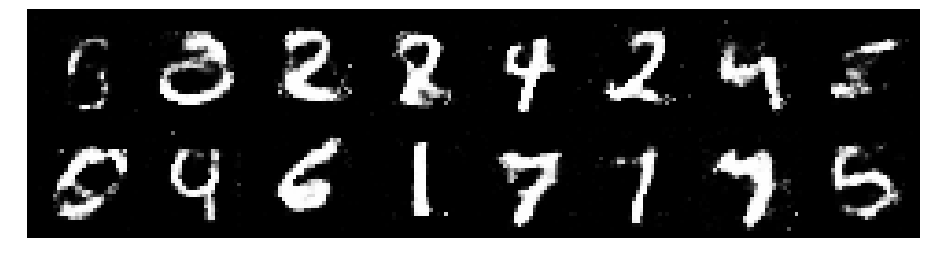

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2602, Generator Loss: 1.0104
D(x): 0.5385, D(G(z)): 0.4185


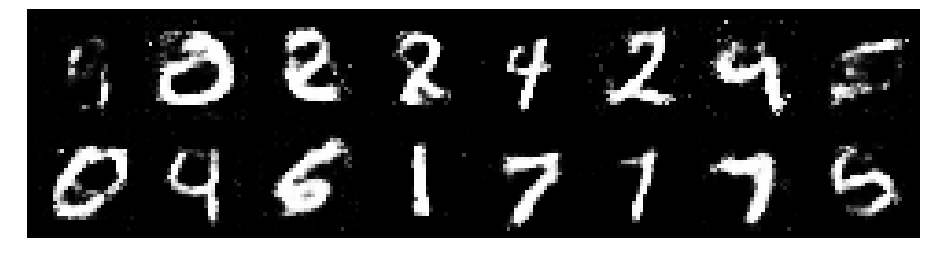

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.2874, Generator Loss: 1.0456
D(x): 0.5485, D(G(z)): 0.4281


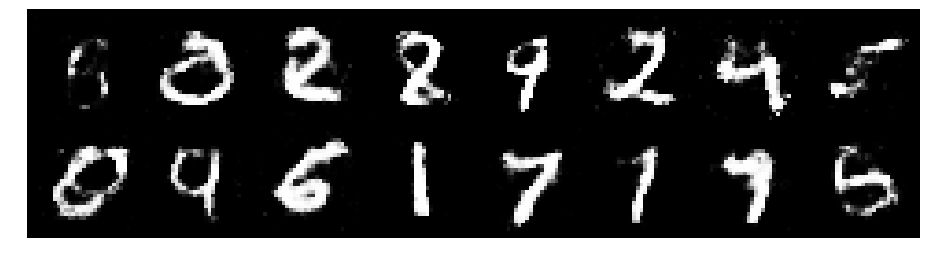

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.2199, Generator Loss: 0.9319
D(x): 0.5400, D(G(z)): 0.4274


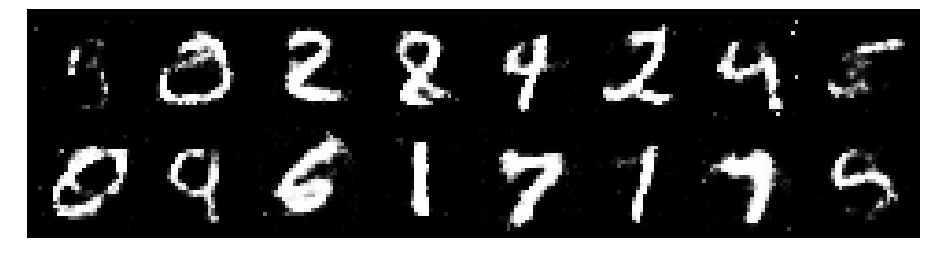

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.1066, Generator Loss: 0.8371
D(x): 0.6356, D(G(z)): 0.4453


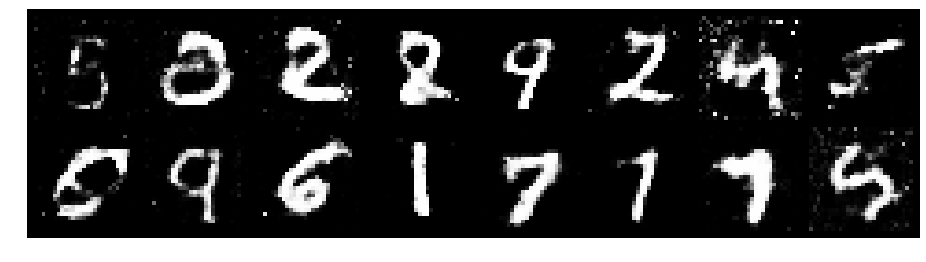

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.3212, Generator Loss: 0.8471
D(x): 0.5345, D(G(z)): 0.4609


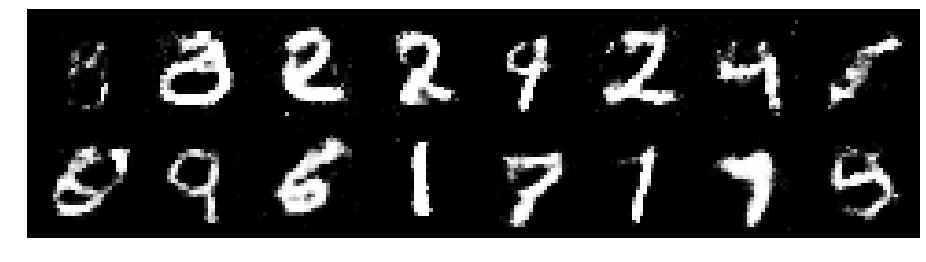

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.3273, Generator Loss: 0.7836
D(x): 0.5574, D(G(z)): 0.4916


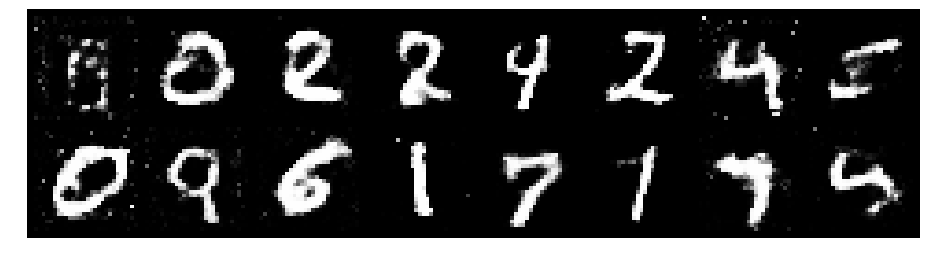

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.3214, Generator Loss: 0.8446
D(x): 0.5537, D(G(z)): 0.4751


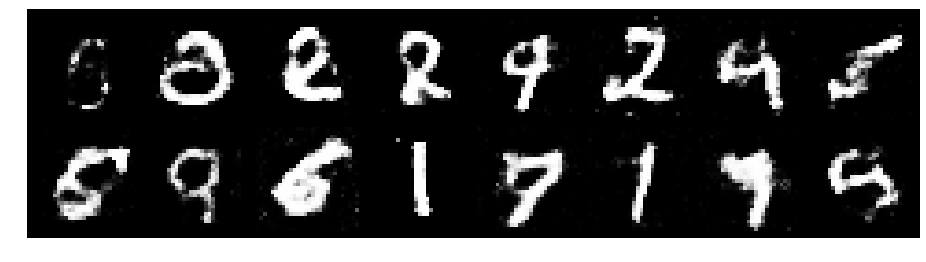

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.3780, Generator Loss: 0.8437
D(x): 0.5353, D(G(z)): 0.4711


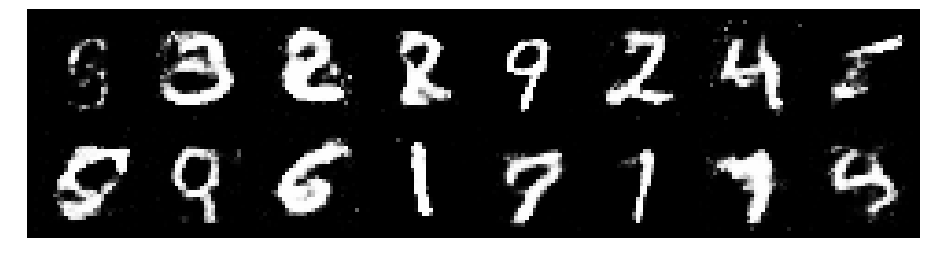

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.3358, Generator Loss: 0.8005
D(x): 0.5431, D(G(z)): 0.4706


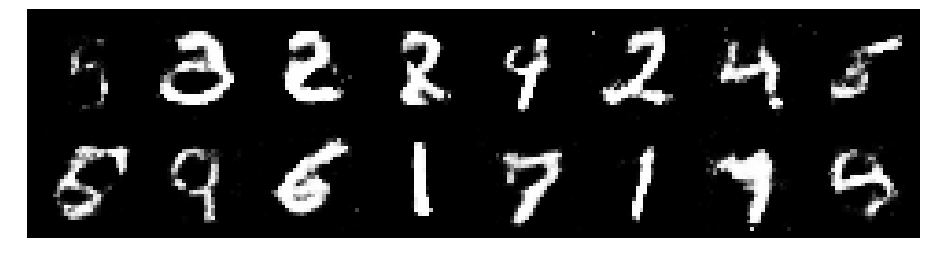

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2870, Generator Loss: 0.7506
D(x): 0.5701, D(G(z)): 0.4768


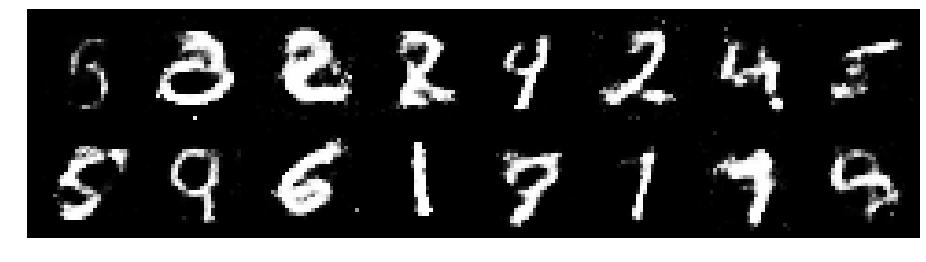

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3000, Generator Loss: 0.8372
D(x): 0.5741, D(G(z)): 0.4728


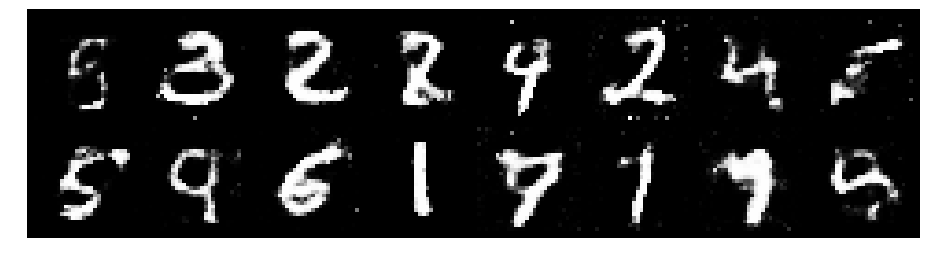

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.2488, Generator Loss: 0.9124
D(x): 0.5826, D(G(z)): 0.4559


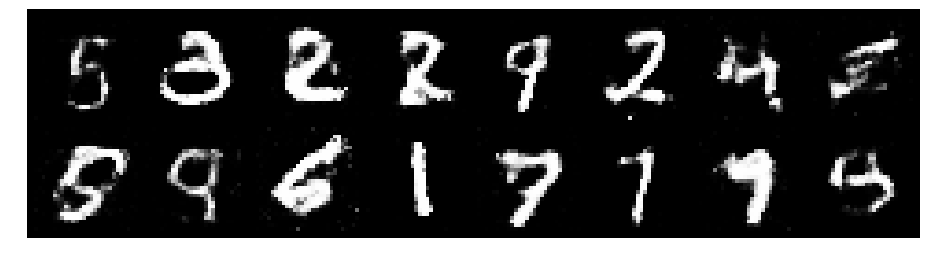

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2809, Generator Loss: 0.9500
D(x): 0.5526, D(G(z)): 0.4110


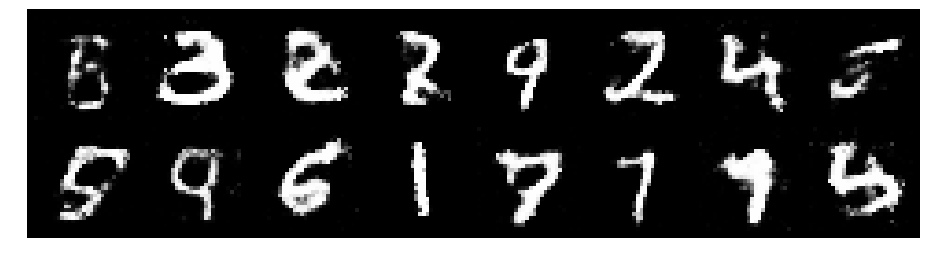

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.3576, Generator Loss: 0.7562
D(x): 0.5406, D(G(z)): 0.5009


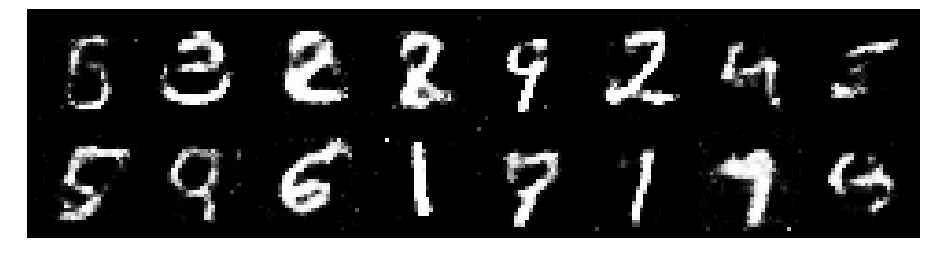

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.3854, Generator Loss: 0.8168
D(x): 0.5338, D(G(z)): 0.4951


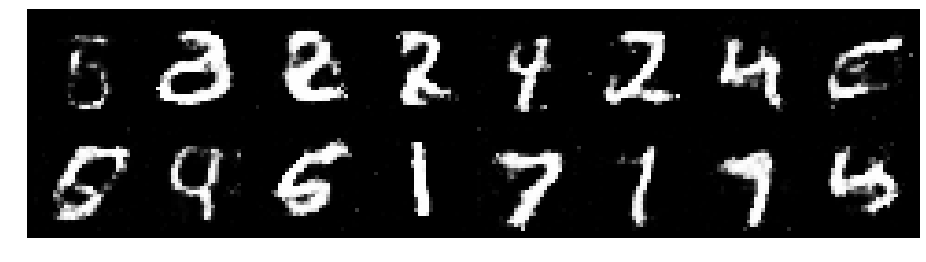

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.3063, Generator Loss: 1.0620
D(x): 0.6161, D(G(z)): 0.4835


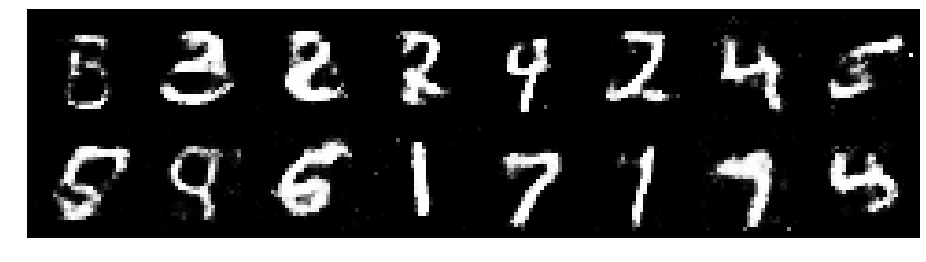

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.1375, Generator Loss: 0.9274
D(x): 0.5713, D(G(z)): 0.4019


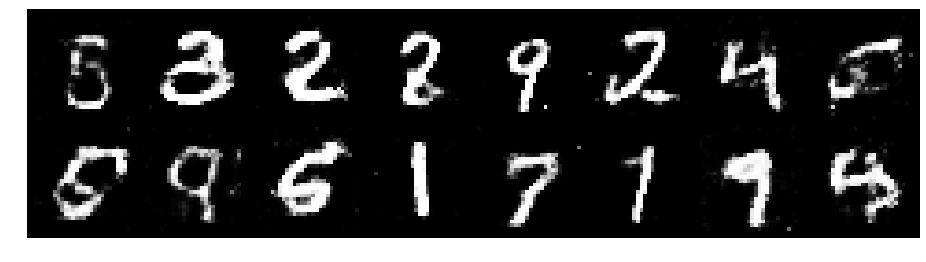

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2727, Generator Loss: 0.8422
D(x): 0.5502, D(G(z)): 0.4452


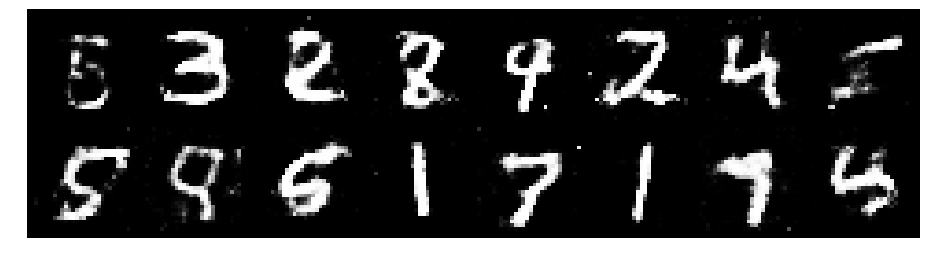

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2569, Generator Loss: 0.8047
D(x): 0.5712, D(G(z)): 0.4551


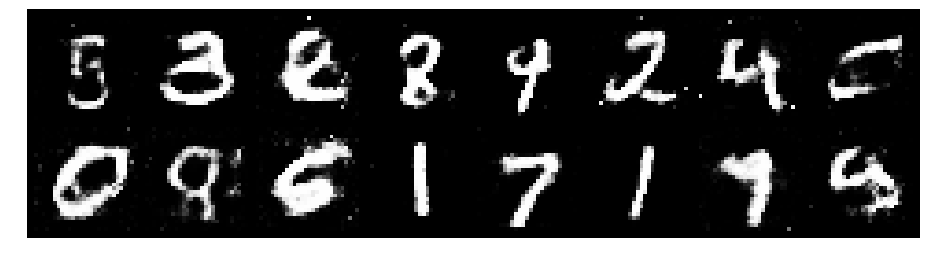

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.3763, Generator Loss: 0.9851
D(x): 0.5222, D(G(z)): 0.4502


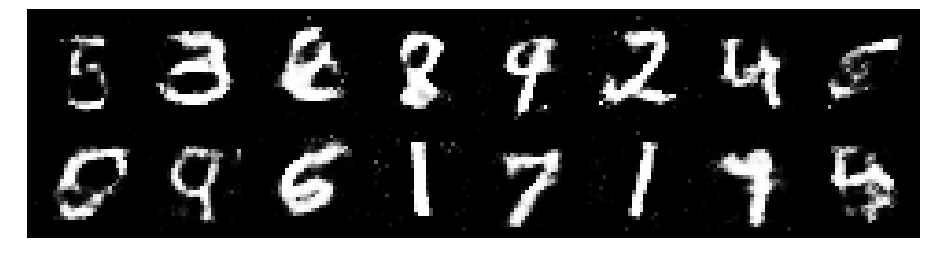

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.3777, Generator Loss: 0.7843
D(x): 0.5447, D(G(z)): 0.4953


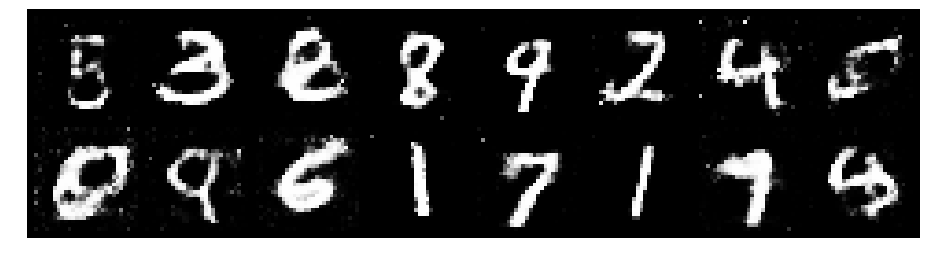

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2962, Generator Loss: 0.7759
D(x): 0.6076, D(G(z)): 0.4876


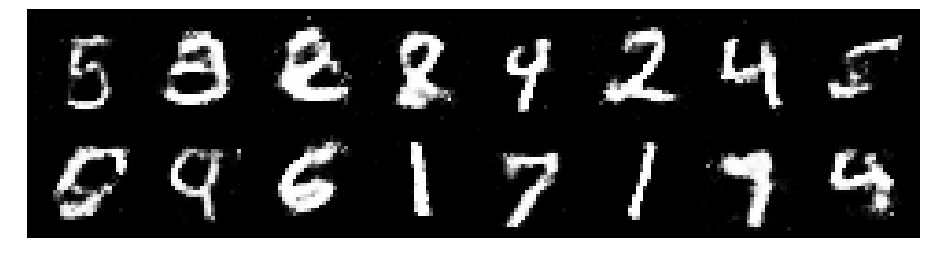

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2962, Generator Loss: 0.8774
D(x): 0.5394, D(G(z)): 0.4436


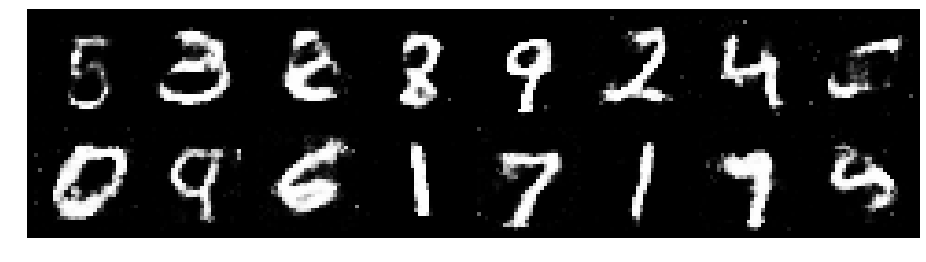

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.1914, Generator Loss: 1.1528
D(x): 0.5747, D(G(z)): 0.3993


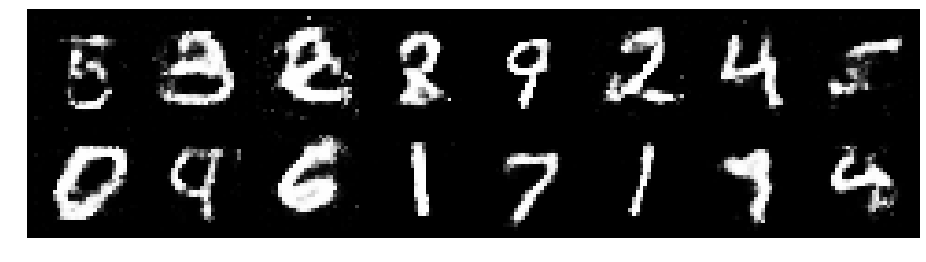

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.1679, Generator Loss: 1.1071
D(x): 0.5288, D(G(z)): 0.3502


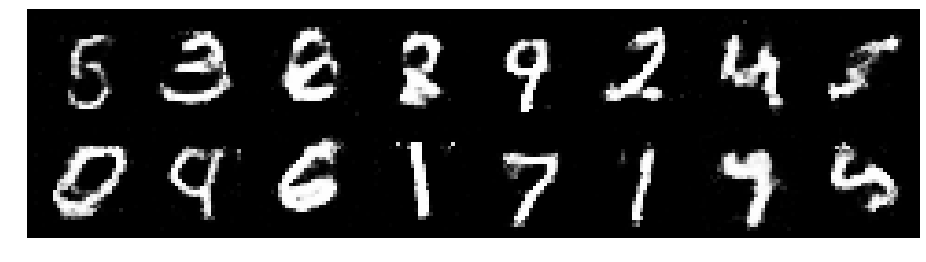

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.3472, Generator Loss: 0.9363
D(x): 0.5667, D(G(z)): 0.4498


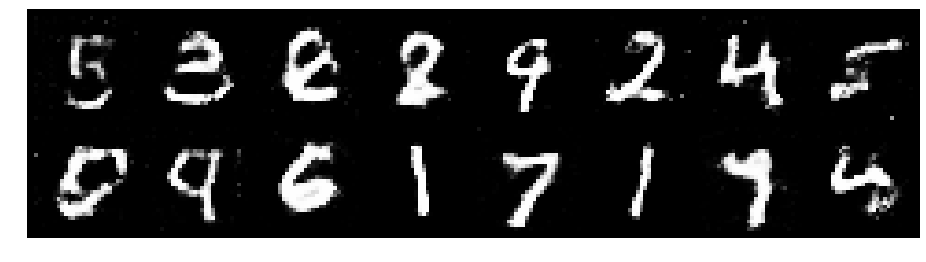

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.3040, Generator Loss: 0.9385
D(x): 0.5397, D(G(z)): 0.4328


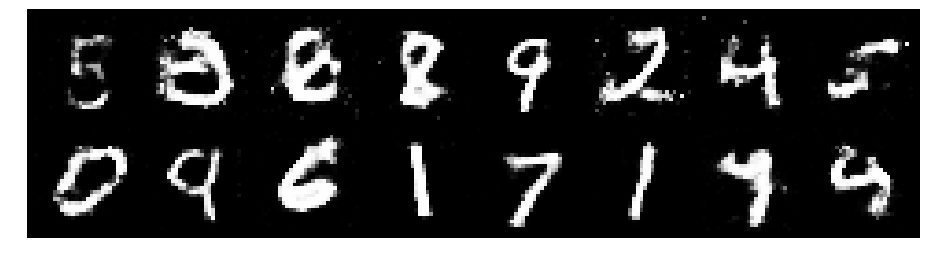

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.2202, Generator Loss: 0.9721
D(x): 0.5408, D(G(z)): 0.3859


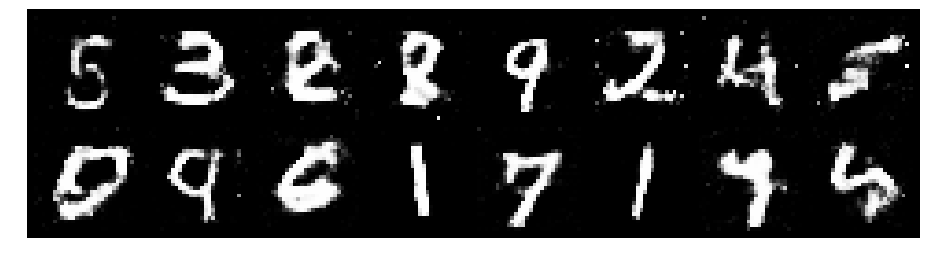

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2865, Generator Loss: 0.9611
D(x): 0.5417, D(G(z)): 0.4484


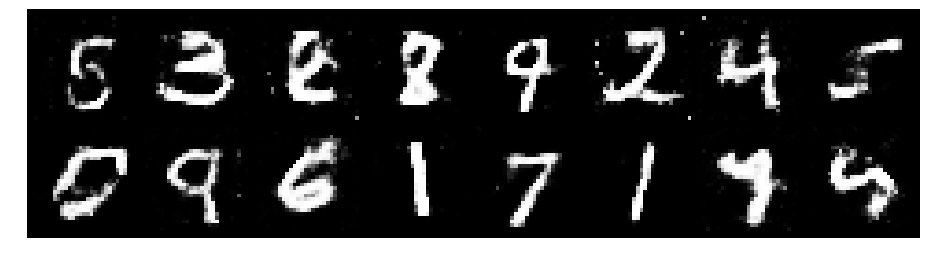

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.1874, Generator Loss: 1.0947
D(x): 0.5896, D(G(z)): 0.4127


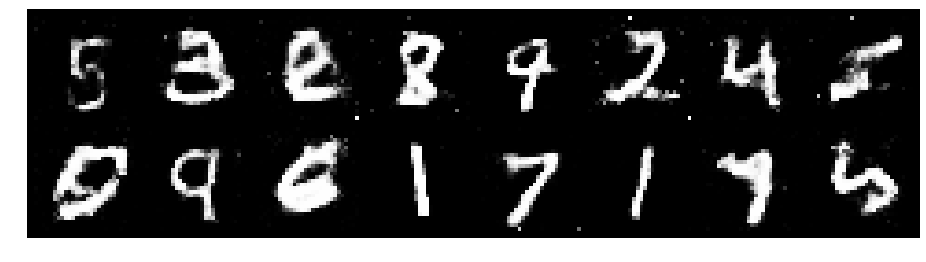

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2047, Generator Loss: 0.8938
D(x): 0.6022, D(G(z)): 0.4336


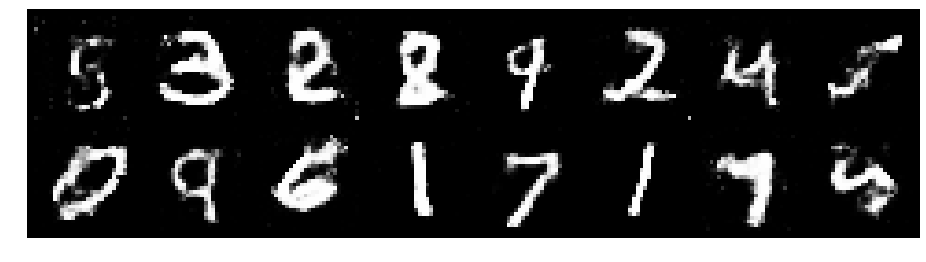

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2323, Generator Loss: 0.9929
D(x): 0.5745, D(G(z)): 0.4121


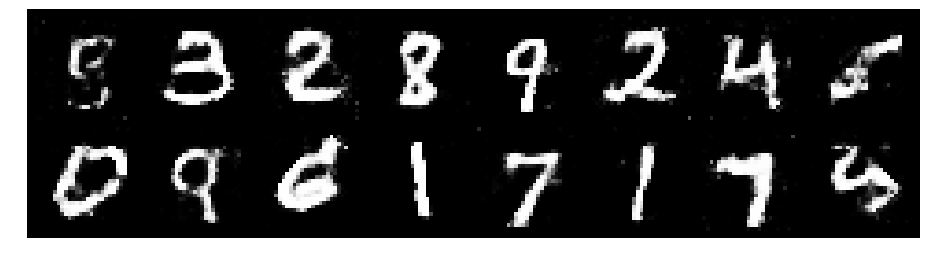

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.2503, Generator Loss: 0.8168
D(x): 0.6045, D(G(z)): 0.4663


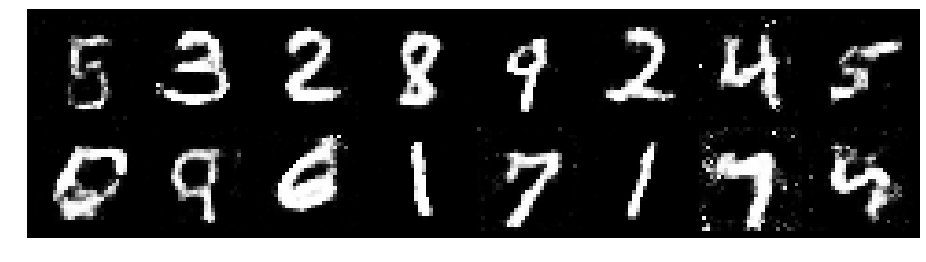

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.3470, Generator Loss: 0.8575
D(x): 0.5564, D(G(z)): 0.4816


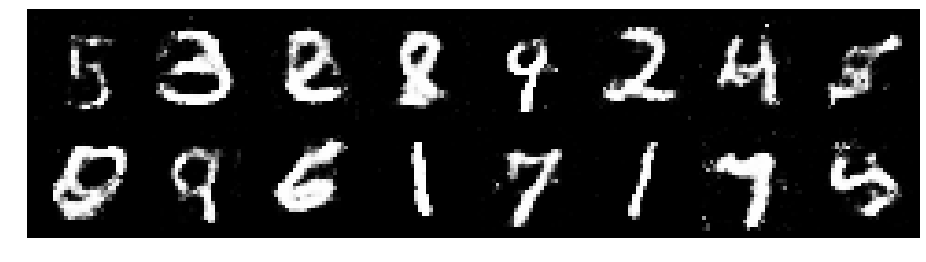

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2437, Generator Loss: 0.9505
D(x): 0.5945, D(G(z)): 0.4720


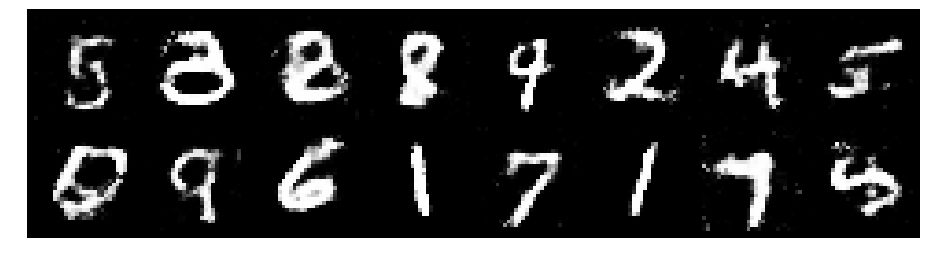

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.3514, Generator Loss: 0.7411
D(x): 0.5757, D(G(z)): 0.5141


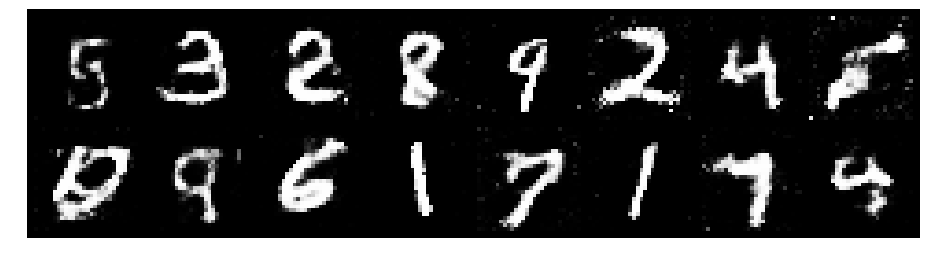

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.2470, Generator Loss: 0.8243
D(x): 0.5740, D(G(z)): 0.4437


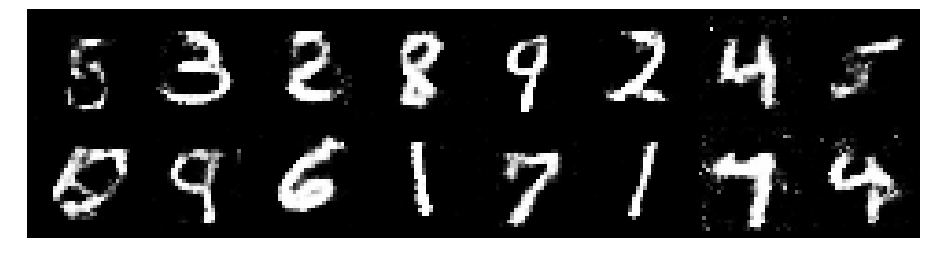

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.1924, Generator Loss: 1.0084
D(x): 0.5472, D(G(z)): 0.3906


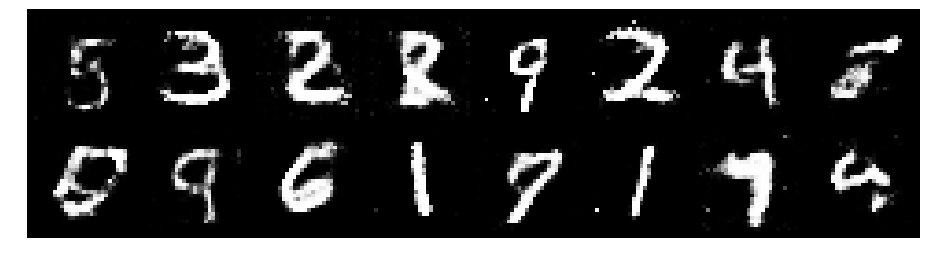

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2284, Generator Loss: 0.9110
D(x): 0.5547, D(G(z)): 0.4357


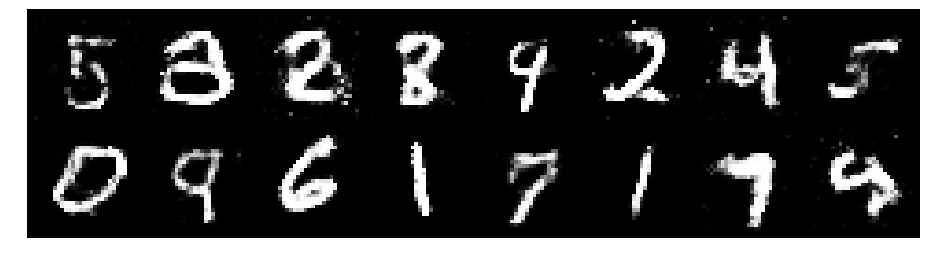

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2138, Generator Loss: 0.8957
D(x): 0.5589, D(G(z)): 0.4212


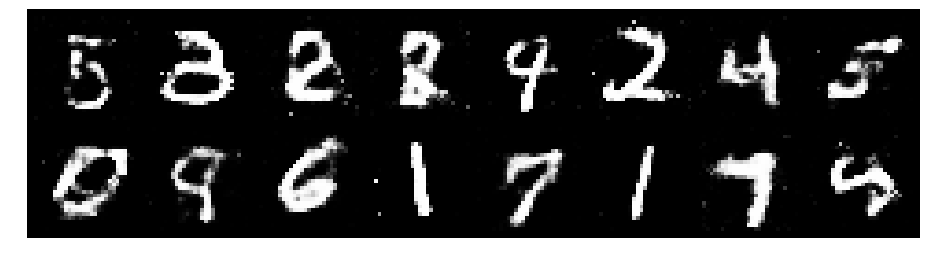

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2088, Generator Loss: 1.0083
D(x): 0.5794, D(G(z)): 0.4086


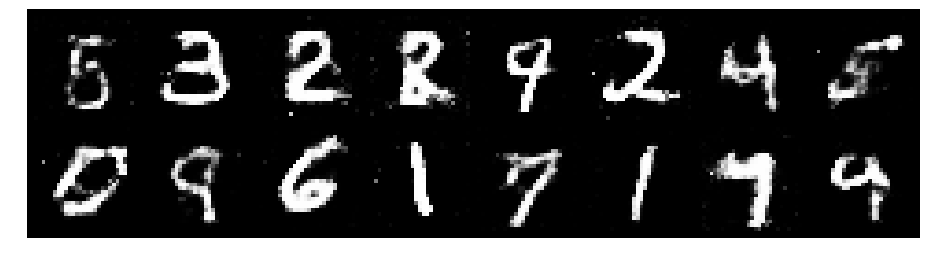

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.1705, Generator Loss: 1.0656
D(x): 0.6073, D(G(z)): 0.4075


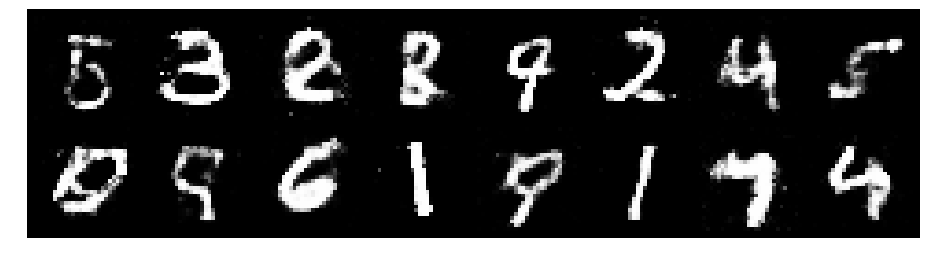

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.3370, Generator Loss: 0.8187
D(x): 0.5614, D(G(z)): 0.4865


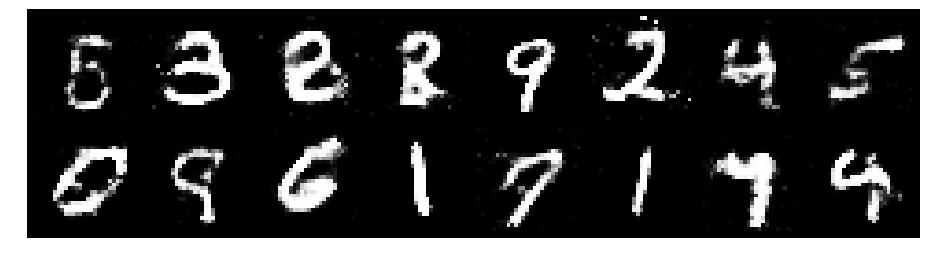

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2303, Generator Loss: 1.0048
D(x): 0.5532, D(G(z)): 0.4107


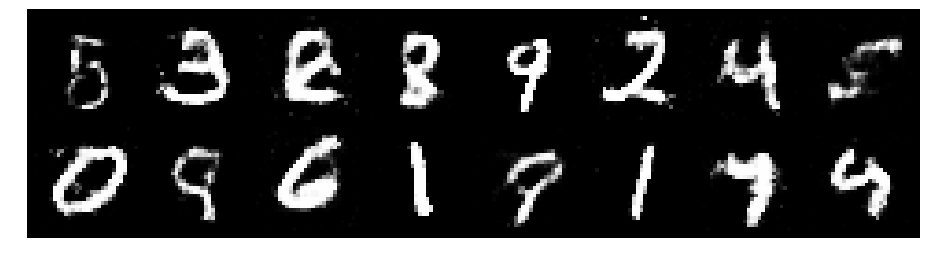

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.3602, Generator Loss: 0.8323
D(x): 0.5331, D(G(z)): 0.4757


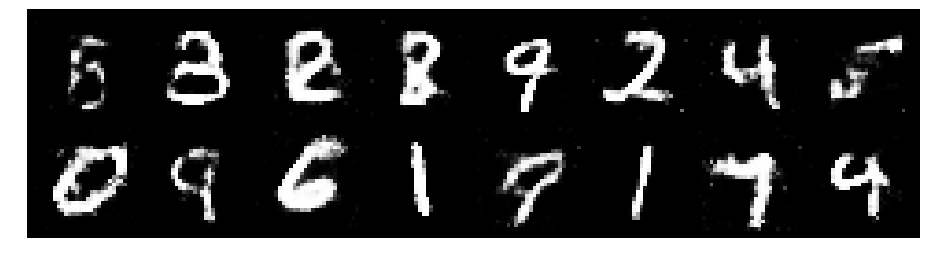

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.3039, Generator Loss: 0.8120
D(x): 0.5372, D(G(z)): 0.4261


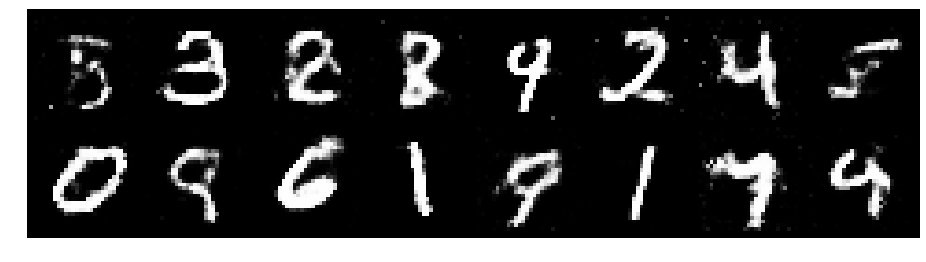

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.3568, Generator Loss: 0.9148
D(x): 0.5167, D(G(z)): 0.4262


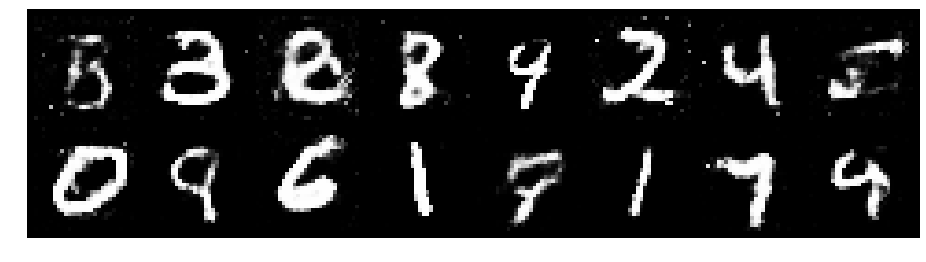

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2842, Generator Loss: 0.8837
D(x): 0.5565, D(G(z)): 0.4448


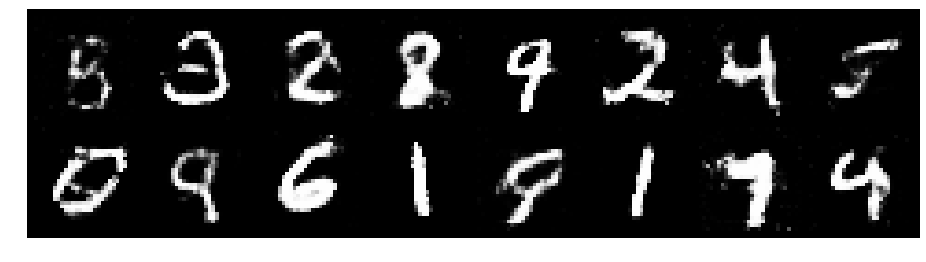

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.3958, Generator Loss: 0.8553
D(x): 0.5040, D(G(z)): 0.4539


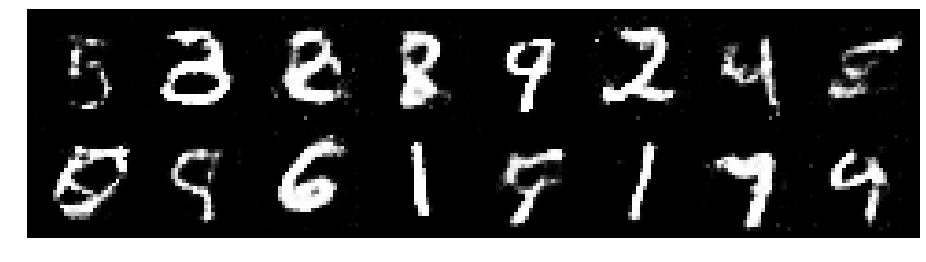

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.3244, Generator Loss: 0.9174
D(x): 0.5417, D(G(z)): 0.4311


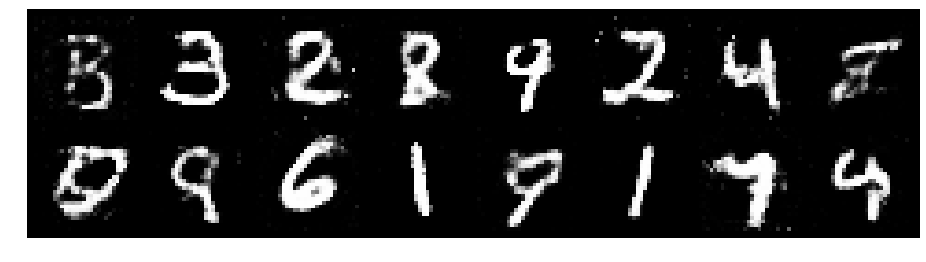

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.1611, Generator Loss: 0.9693
D(x): 0.6122, D(G(z)): 0.4260


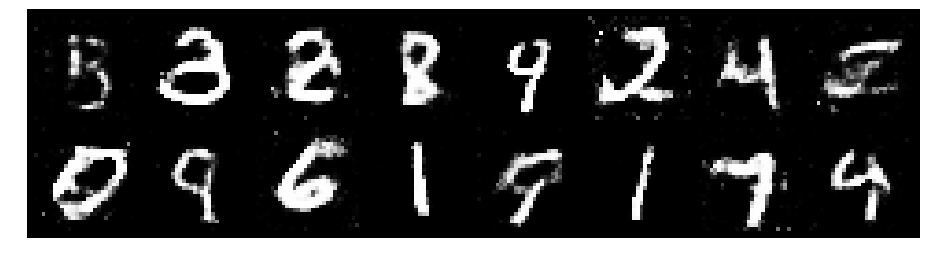

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.3315, Generator Loss: 0.9324
D(x): 0.5198, D(G(z)): 0.4370


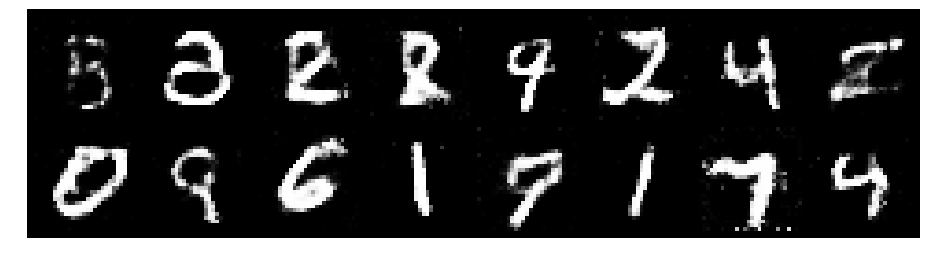

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2782, Generator Loss: 0.9910
D(x): 0.5706, D(G(z)): 0.4215


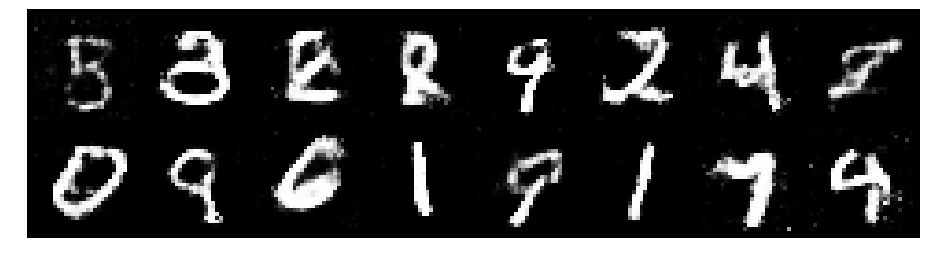

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.3907, Generator Loss: 0.7686
D(x): 0.5221, D(G(z)): 0.4826


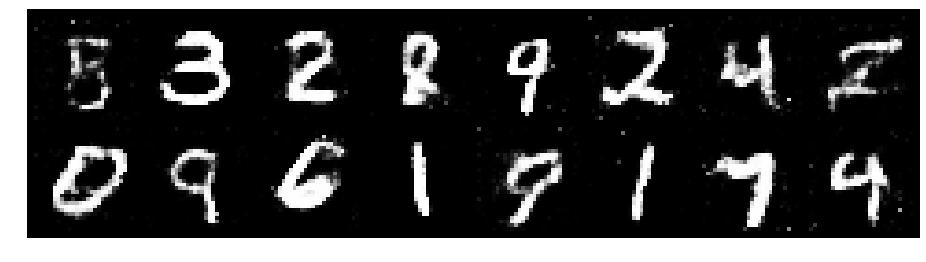

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2976, Generator Loss: 0.9856
D(x): 0.5739, D(G(z)): 0.4452


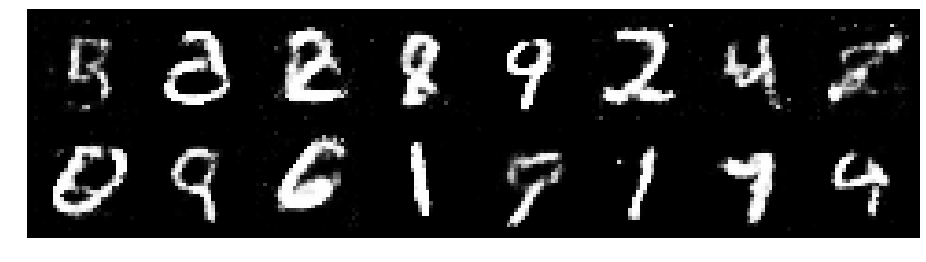

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.3755, Generator Loss: 0.9565
D(x): 0.5073, D(G(z)): 0.4299


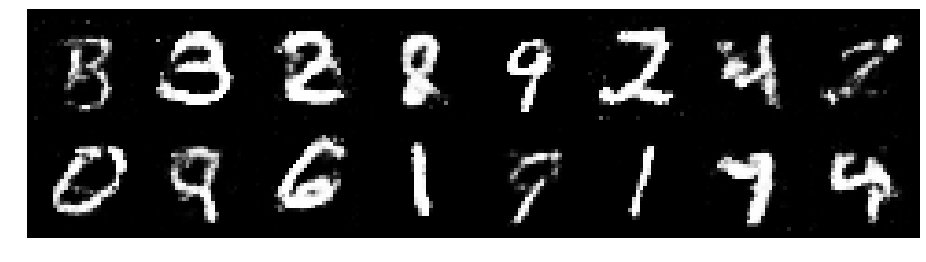

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.3245, Generator Loss: 0.9565
D(x): 0.5086, D(G(z)): 0.4097


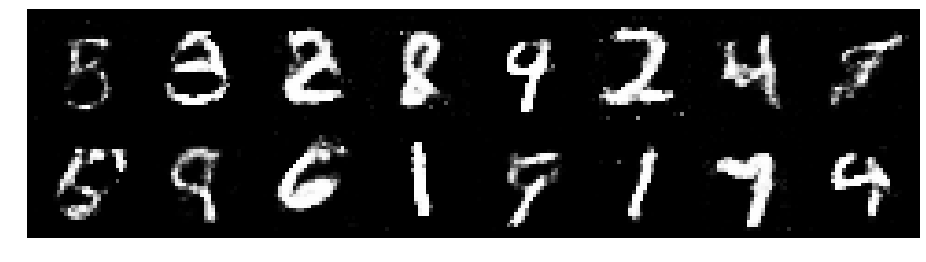

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2903, Generator Loss: 0.8992
D(x): 0.5466, D(G(z)): 0.4527


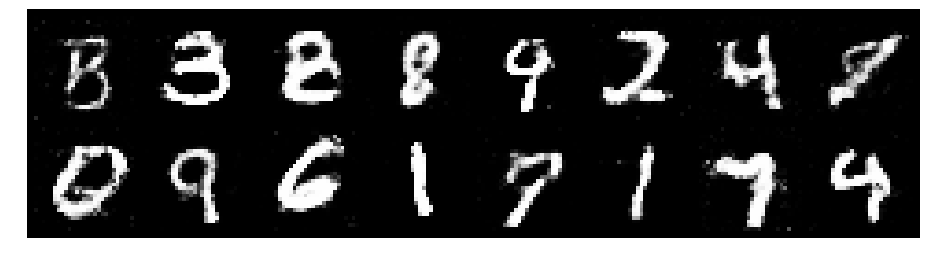

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.2999, Generator Loss: 0.9512
D(x): 0.5347, D(G(z)): 0.4368


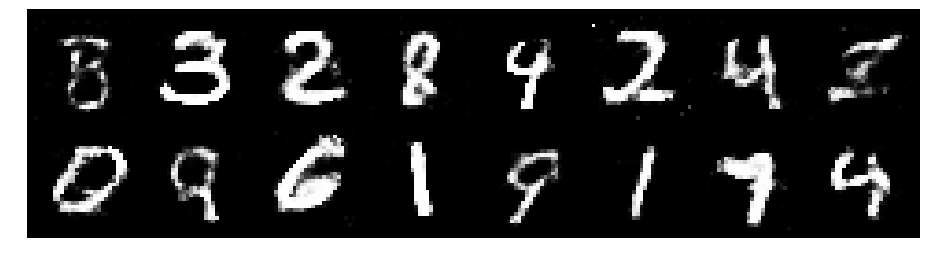

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.1770, Generator Loss: 1.0017
D(x): 0.5906, D(G(z)): 0.4151


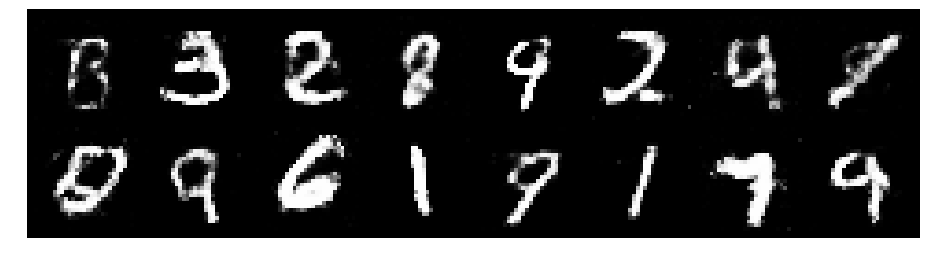

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8383
D(x): 0.5575, D(G(z)): 0.4682


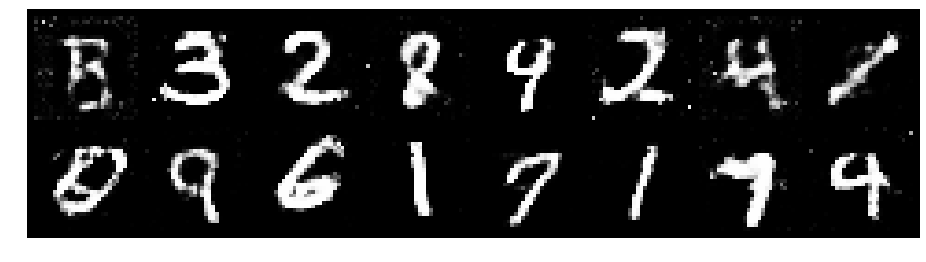

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2429, Generator Loss: 0.9296
D(x): 0.5238, D(G(z)): 0.4013


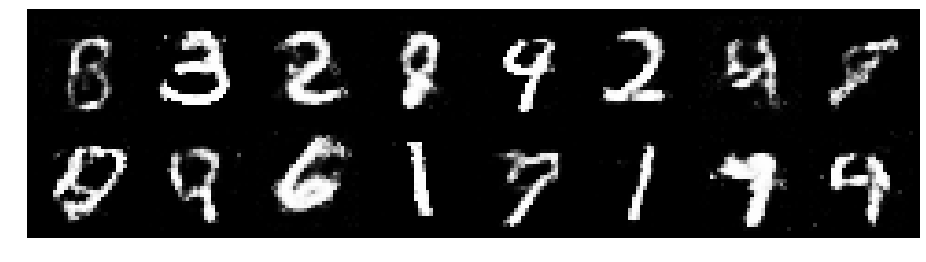

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.2571, Generator Loss: 0.8611
D(x): 0.5827, D(G(z)): 0.4698


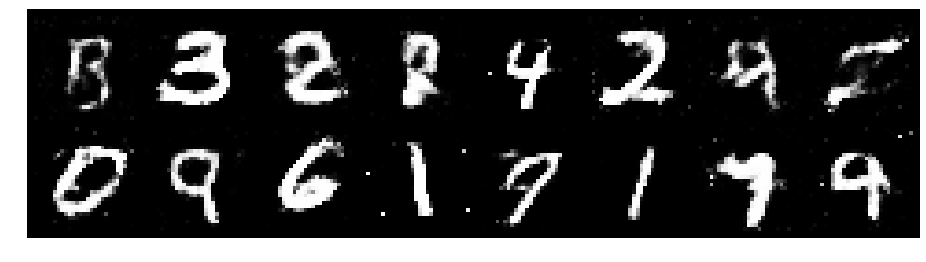

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2652, Generator Loss: 0.8250
D(x): 0.5444, D(G(z)): 0.4500


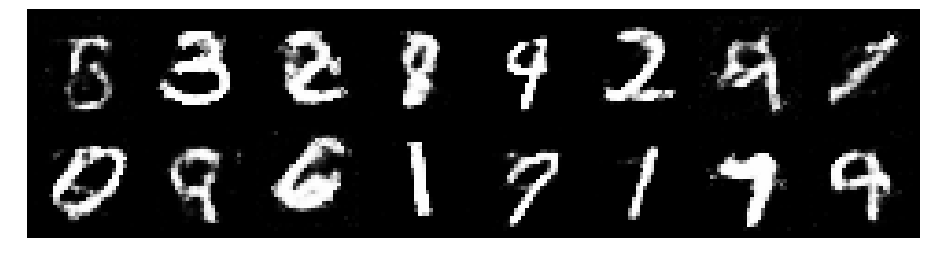

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.2663, Generator Loss: 0.8767
D(x): 0.5384, D(G(z)): 0.4342


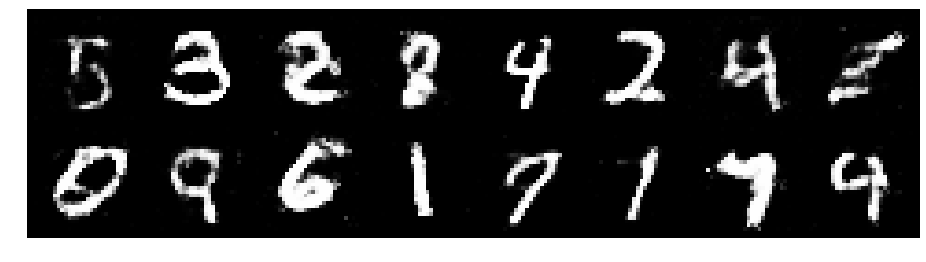

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.2740, Generator Loss: 1.0468
D(x): 0.5314, D(G(z)): 0.3976


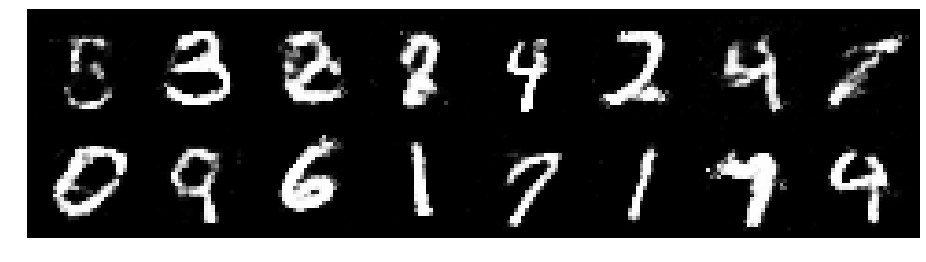

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.2829, Generator Loss: 0.9616
D(x): 0.5335, D(G(z)): 0.4280


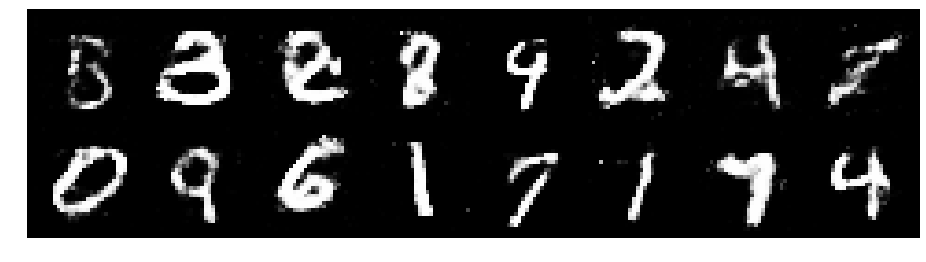

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3414, Generator Loss: 0.8510
D(x): 0.5260, D(G(z)): 0.4627


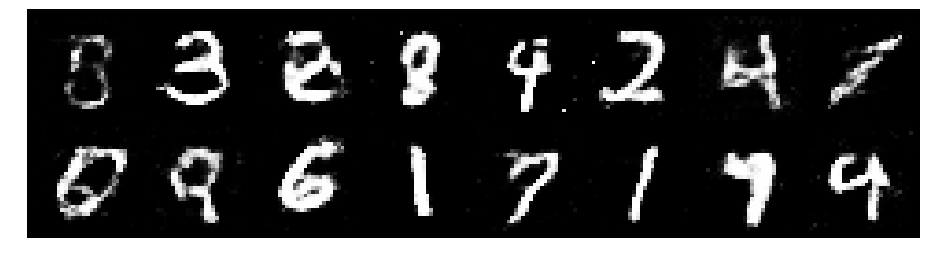

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2179, Generator Loss: 0.8528
D(x): 0.5531, D(G(z)): 0.4253


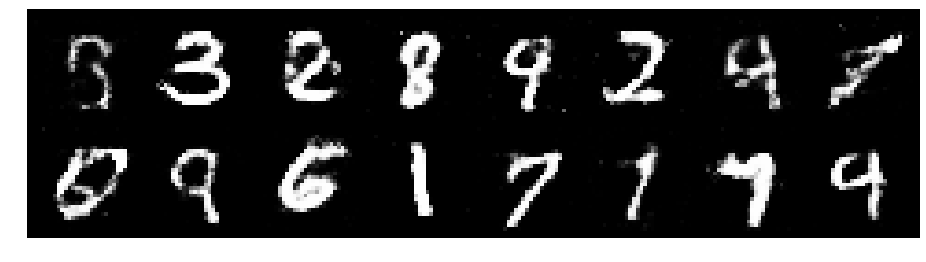

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.2548, Generator Loss: 0.7356
D(x): 0.6117, D(G(z)): 0.4925


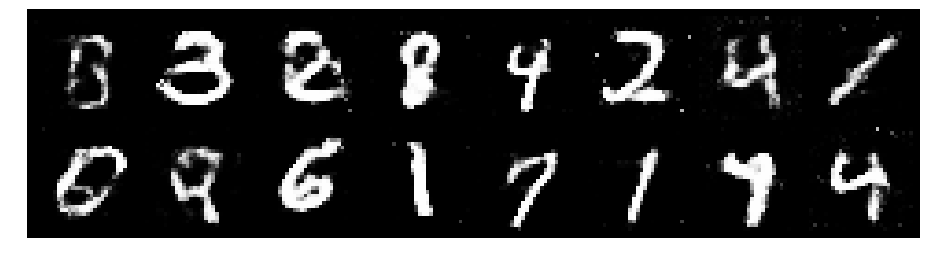

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.3046, Generator Loss: 0.9730
D(x): 0.5536, D(G(z)): 0.4395


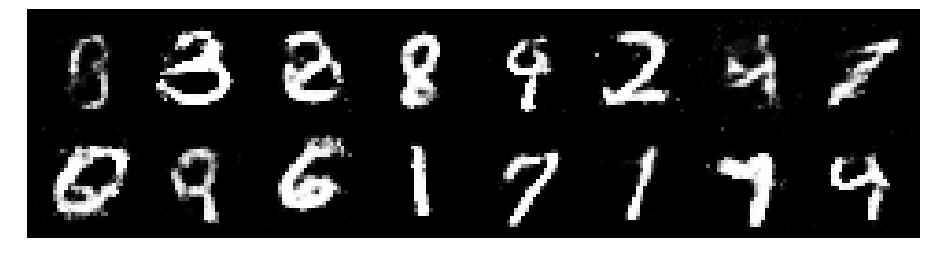

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.1862, Generator Loss: 0.8462
D(x): 0.5548, D(G(z)): 0.4035


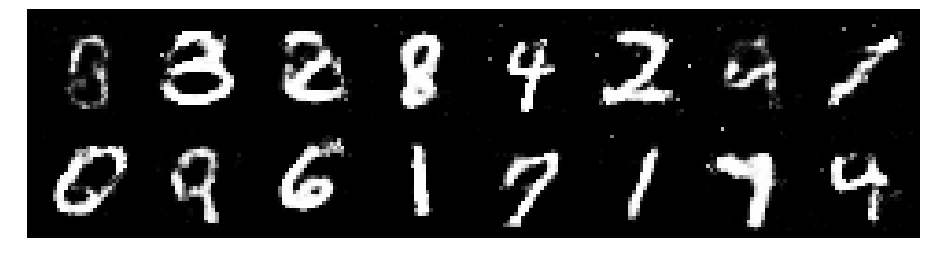

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.1502, Generator Loss: 1.0438
D(x): 0.5906, D(G(z)): 0.4164


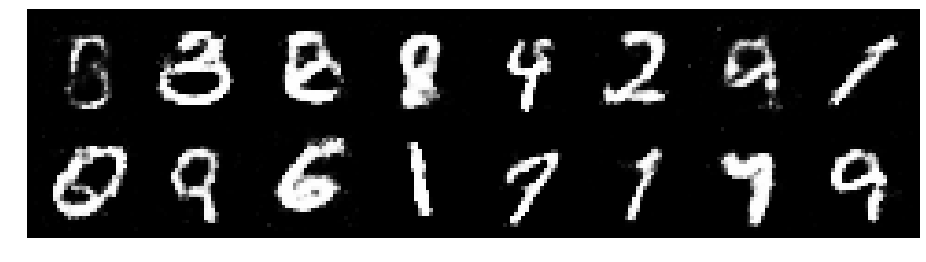

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.4822, Generator Loss: 0.7493
D(x): 0.4793, D(G(z)): 0.4677


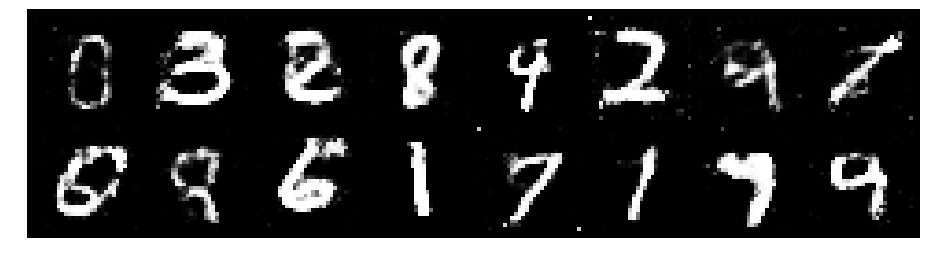

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.2868, Generator Loss: 0.8233
D(x): 0.5764, D(G(z)): 0.4465


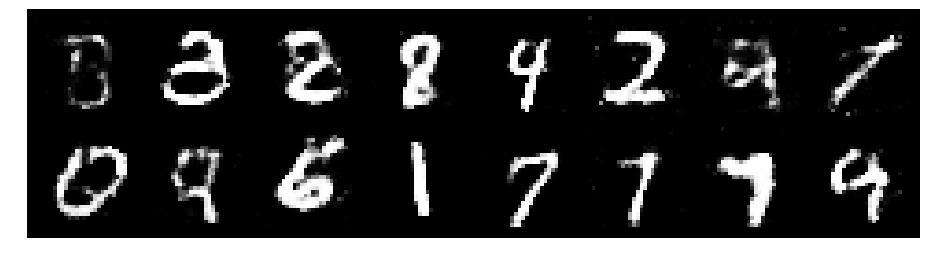

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.3815, Generator Loss: 1.0111
D(x): 0.5053, D(G(z)): 0.4490


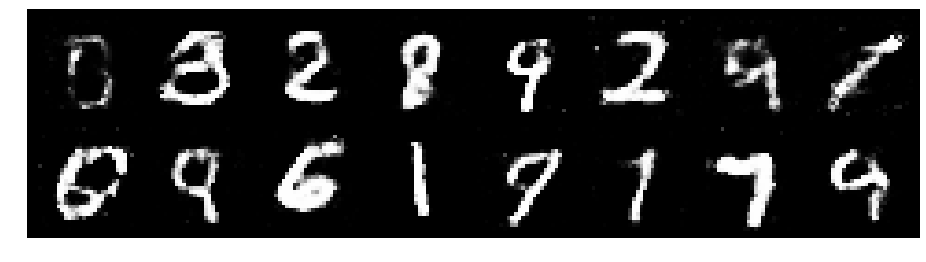

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.4167, Generator Loss: 0.8327
D(x): 0.4976, D(G(z)): 0.4412


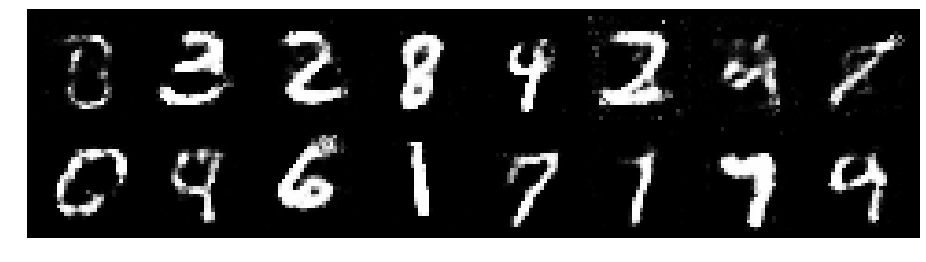

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.3857, Generator Loss: 0.7773
D(x): 0.5193, D(G(z)): 0.4718


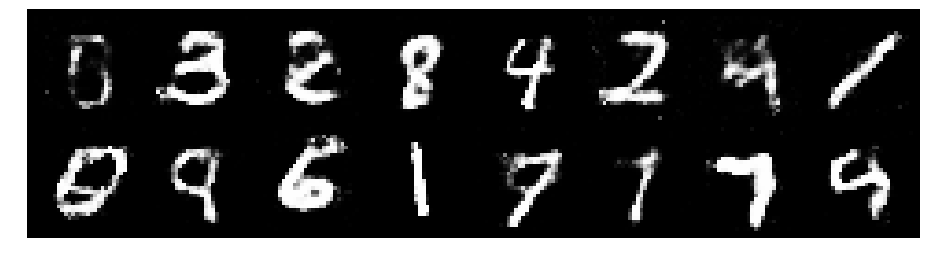

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.3289, Generator Loss: 0.8031
D(x): 0.5259, D(G(z)): 0.4638


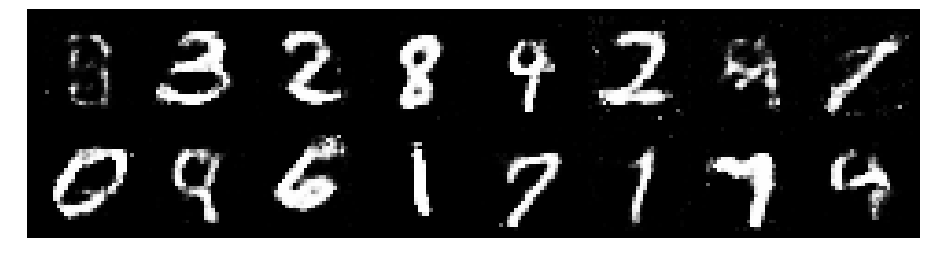

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2681, Generator Loss: 0.8769
D(x): 0.5505, D(G(z)): 0.4275


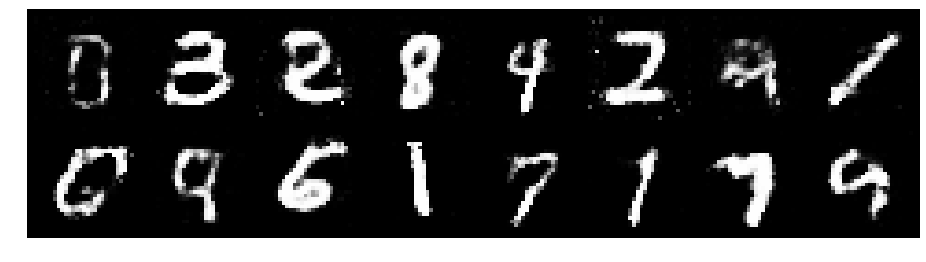

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2349, Generator Loss: 0.9587
D(x): 0.5372, D(G(z)): 0.4151


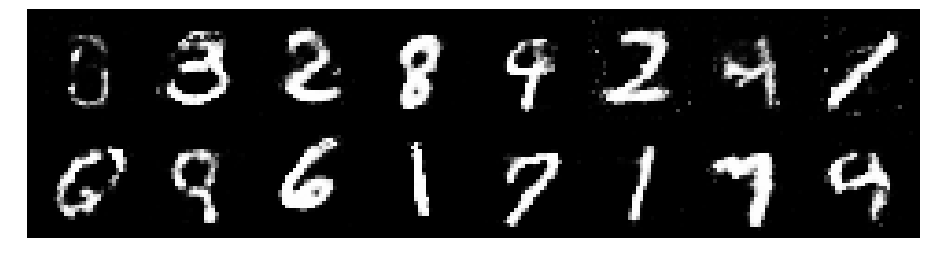

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2303, Generator Loss: 0.9321
D(x): 0.5510, D(G(z)): 0.4333


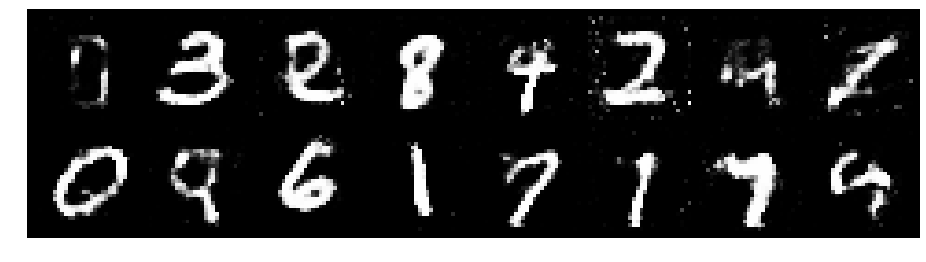

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3234, Generator Loss: 0.8989
D(x): 0.5309, D(G(z)): 0.4449


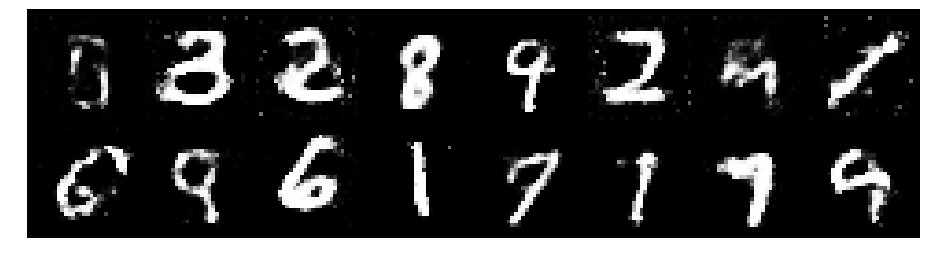

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.1953, Generator Loss: 0.8871
D(x): 0.5904, D(G(z)): 0.4525


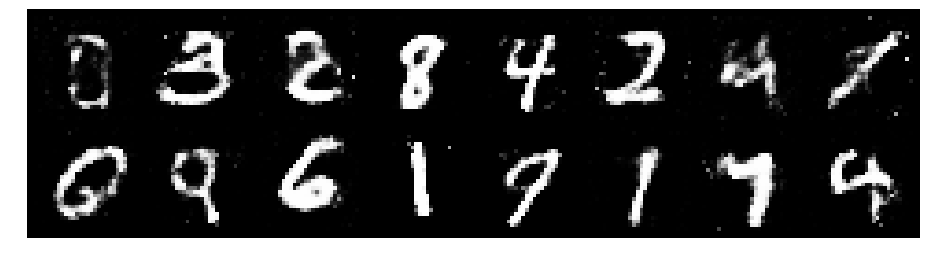

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.3147, Generator Loss: 0.9094
D(x): 0.5335, D(G(z)): 0.4531


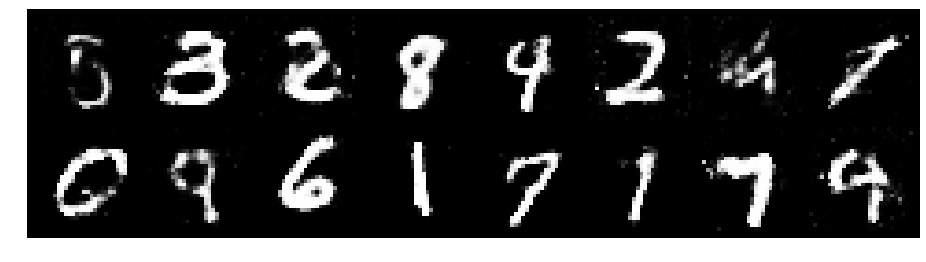

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2738, Generator Loss: 1.0062
D(x): 0.5734, D(G(z)): 0.4315


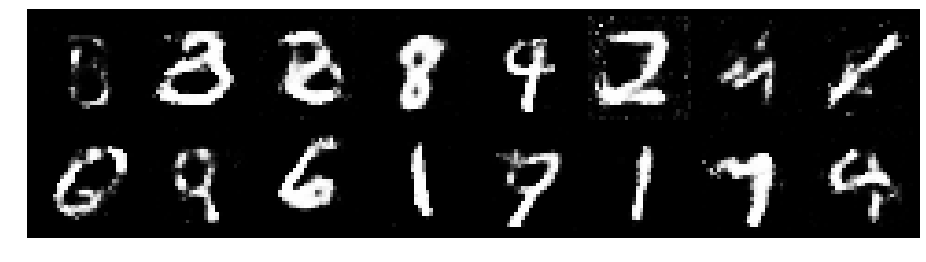

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2132, Generator Loss: 0.9444
D(x): 0.5789, D(G(z)): 0.4422


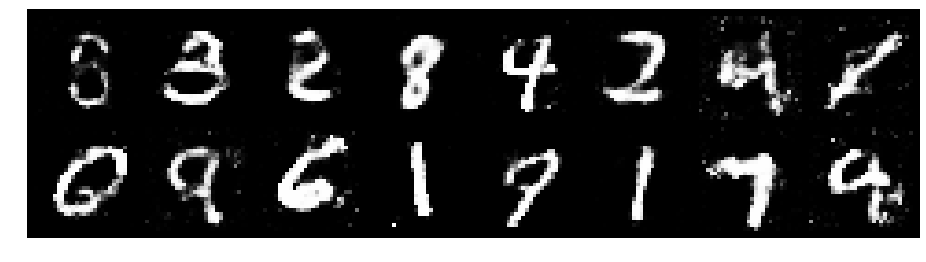

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.3473, Generator Loss: 0.7971
D(x): 0.5321, D(G(z)): 0.4838


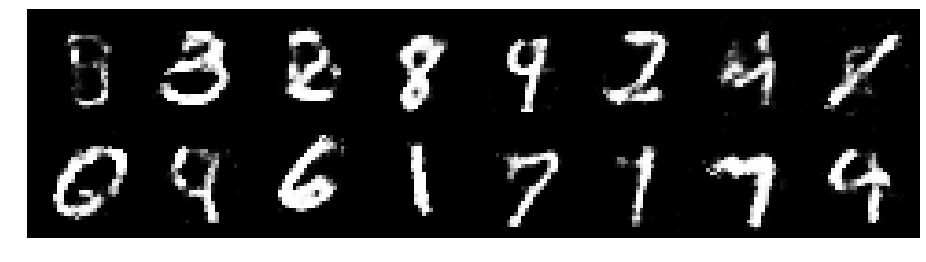

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.3081, Generator Loss: 0.9057
D(x): 0.5318, D(G(z)): 0.4536


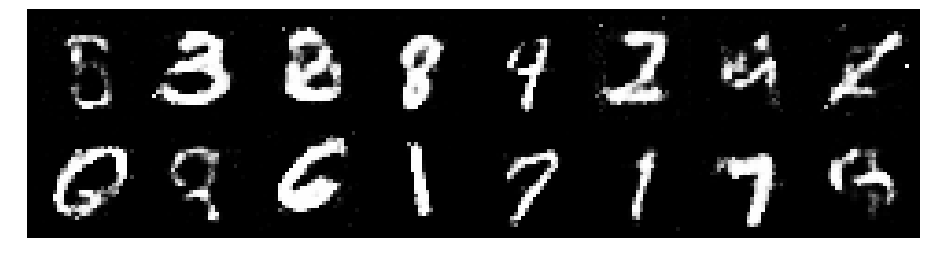

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.3373, Generator Loss: 0.9156
D(x): 0.5320, D(G(z)): 0.4462


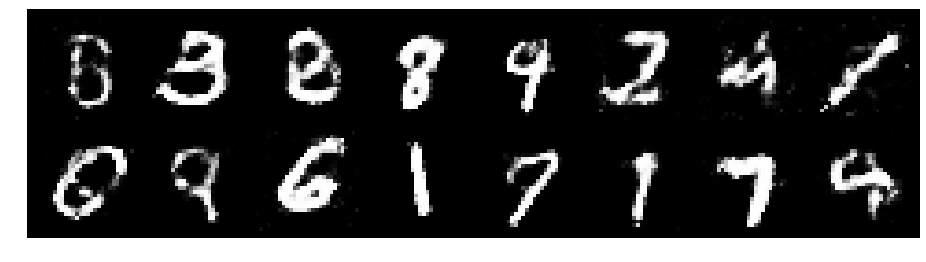

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2913, Generator Loss: 0.8915
D(x): 0.5123, D(G(z)): 0.4071


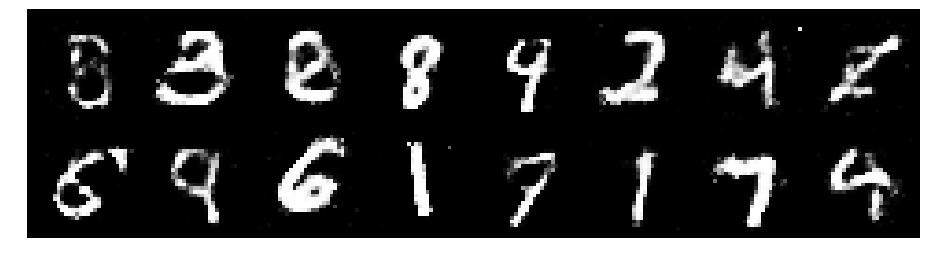

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.3055, Generator Loss: 0.9737
D(x): 0.5460, D(G(z)): 0.4276


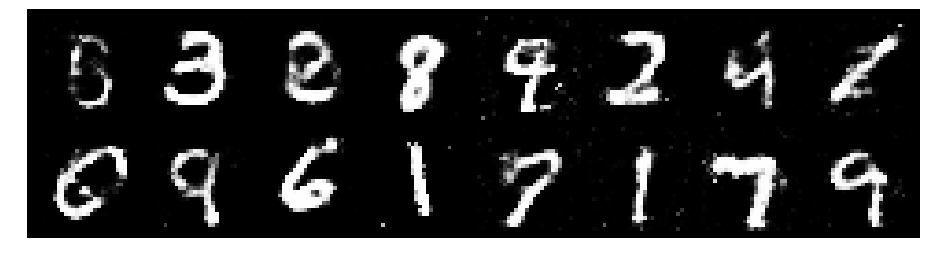

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.3230, Generator Loss: 0.9256
D(x): 0.5293, D(G(z)): 0.4202


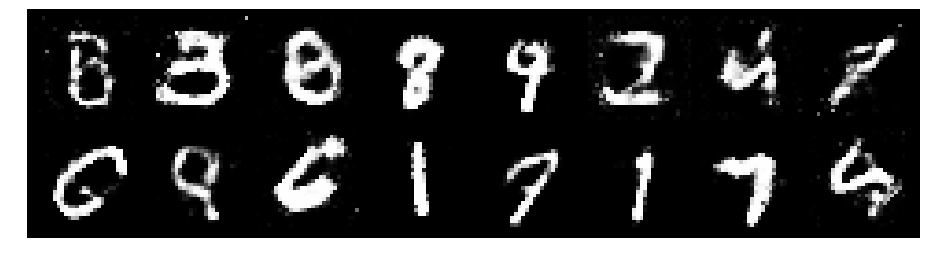

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.4444, Generator Loss: 0.7916
D(x): 0.5880, D(G(z)): 0.5270


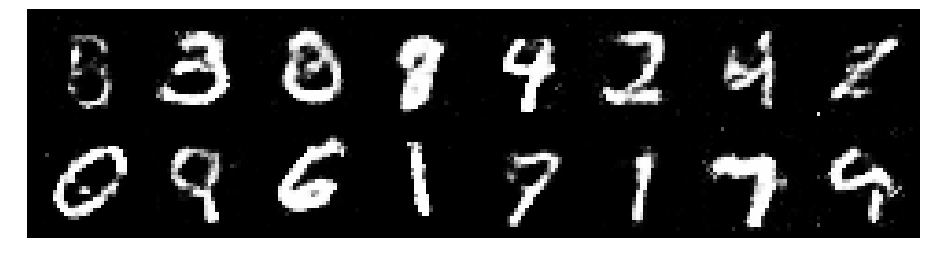

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.3502, Generator Loss: 0.7464
D(x): 0.5435, D(G(z)): 0.4818


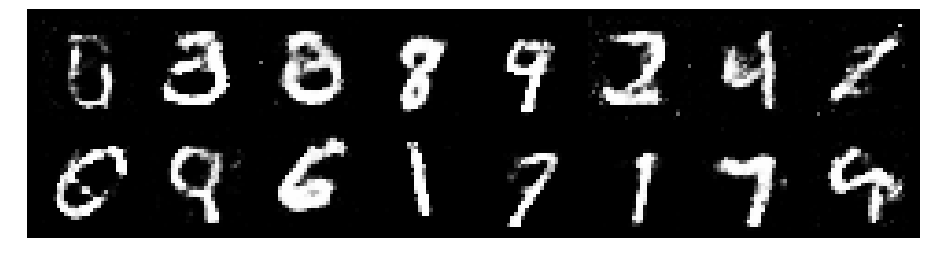

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.3654, Generator Loss: 0.7624
D(x): 0.5680, D(G(z)): 0.5008


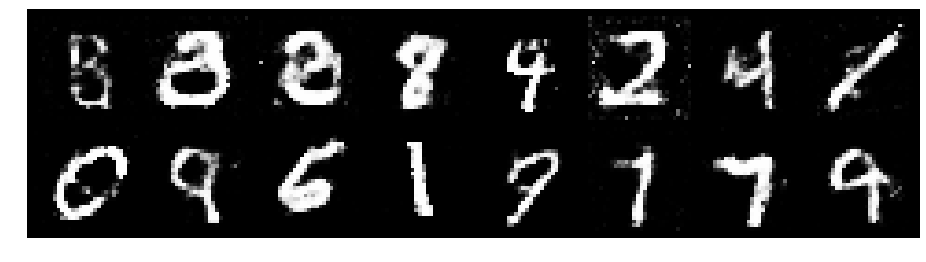

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.4325, Generator Loss: 0.7797
D(x): 0.5302, D(G(z)): 0.4933


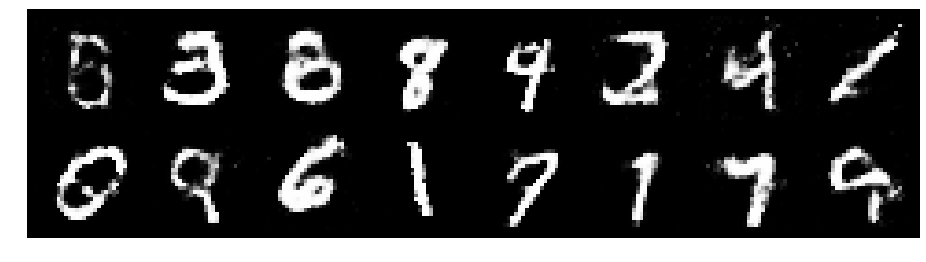

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.3476, Generator Loss: 0.8788
D(x): 0.5343, D(G(z)): 0.4486


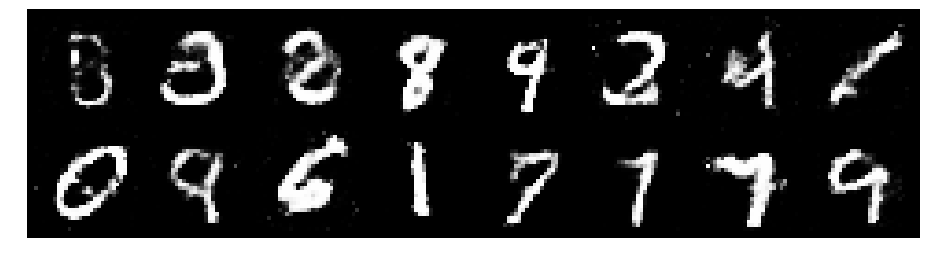

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.3400, Generator Loss: 0.8884
D(x): 0.5763, D(G(z)): 0.4887


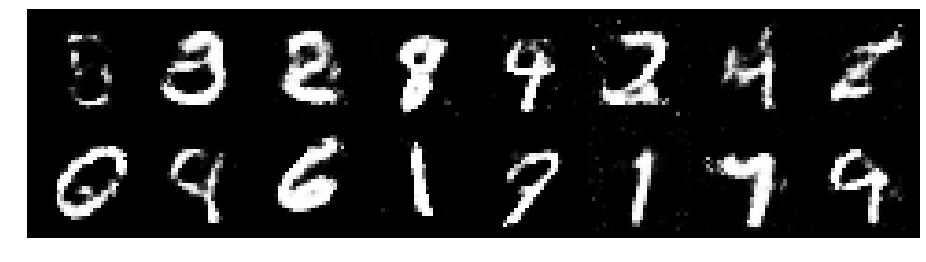

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.3931, Generator Loss: 0.8567
D(x): 0.5251, D(G(z)): 0.4695


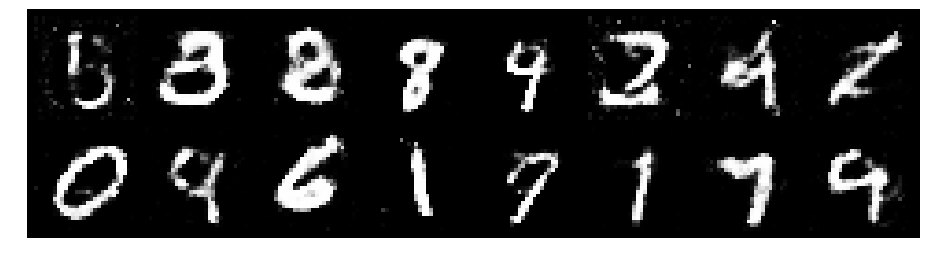

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.3442, Generator Loss: 0.7679
D(x): 0.5100, D(G(z)): 0.4522


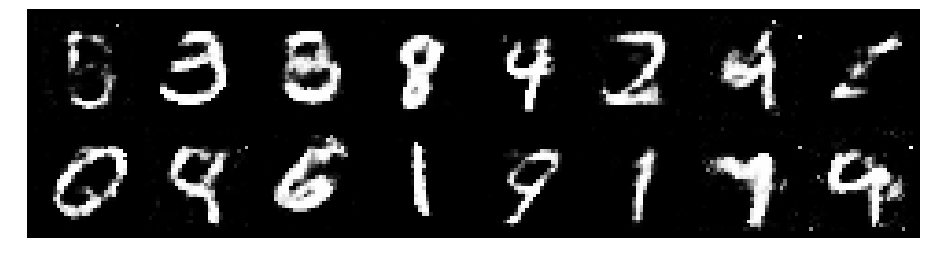

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.2137, Generator Loss: 0.7738
D(x): 0.5798, D(G(z)): 0.4471


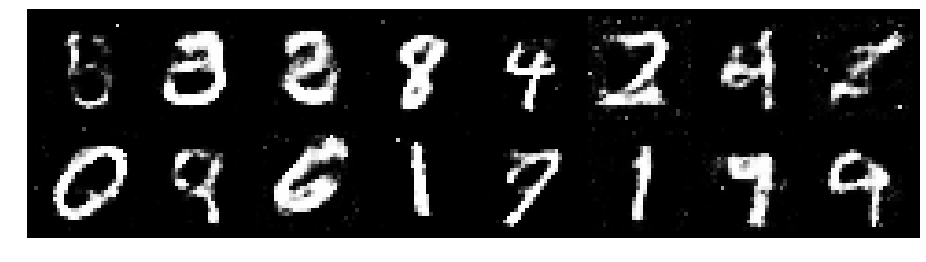

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.1469, Generator Loss: 0.9246
D(x): 0.6083, D(G(z)): 0.4154


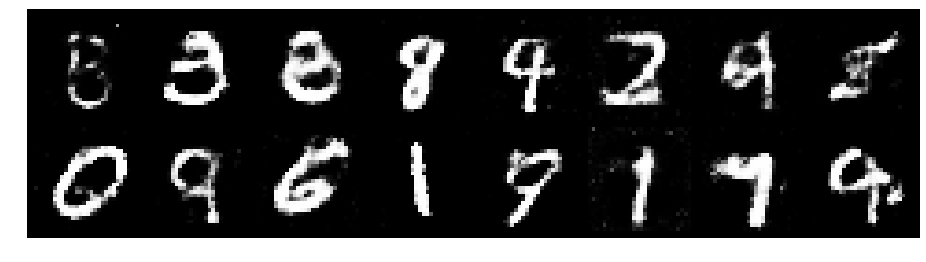

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.1859, Generator Loss: 0.9907
D(x): 0.5991, D(G(z)): 0.4441


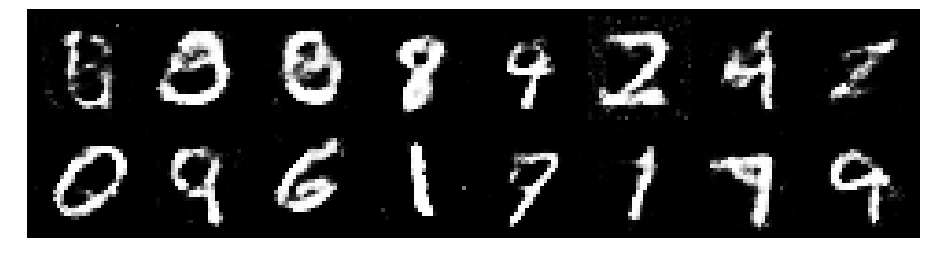

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.1804, Generator Loss: 1.1845
D(x): 0.6172, D(G(z)): 0.4371


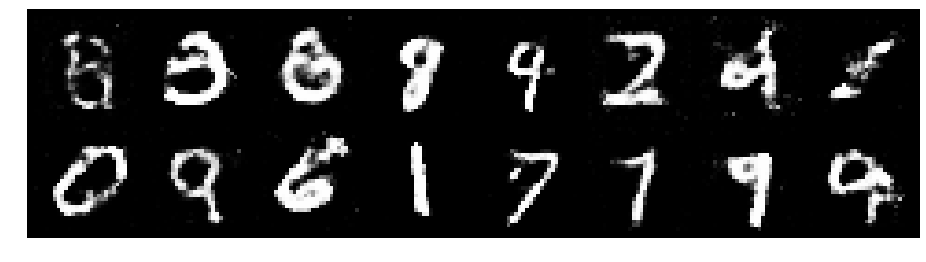

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.1672, Generator Loss: 1.1868
D(x): 0.5400, D(G(z)): 0.3505


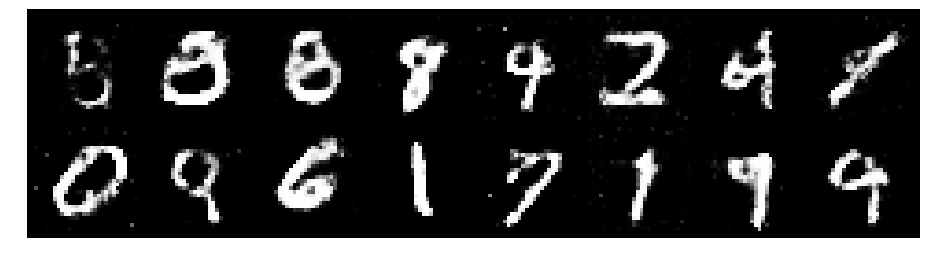

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2717, Generator Loss: 0.8230
D(x): 0.5626, D(G(z)): 0.4549


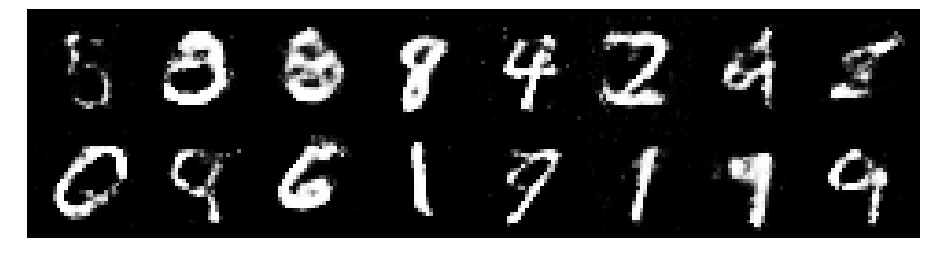

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2934, Generator Loss: 0.9516
D(x): 0.5132, D(G(z)): 0.4199


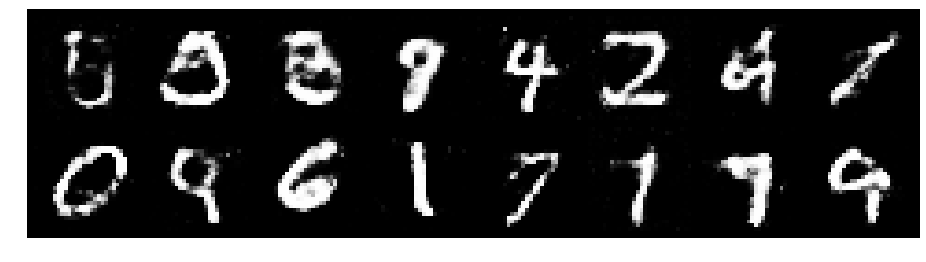

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.3226, Generator Loss: 0.8369
D(x): 0.5620, D(G(z)): 0.4769


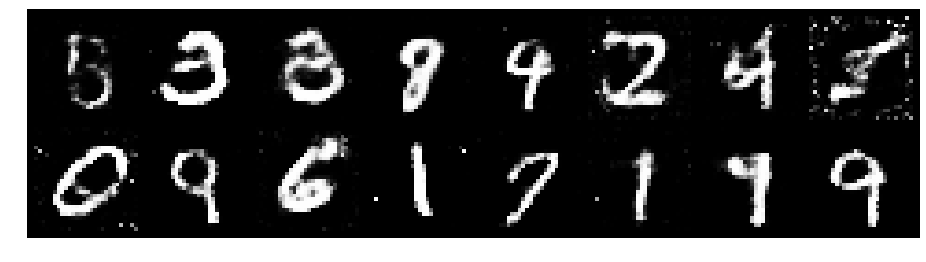

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.2790, Generator Loss: 1.0129
D(x): 0.5780, D(G(z)): 0.4521


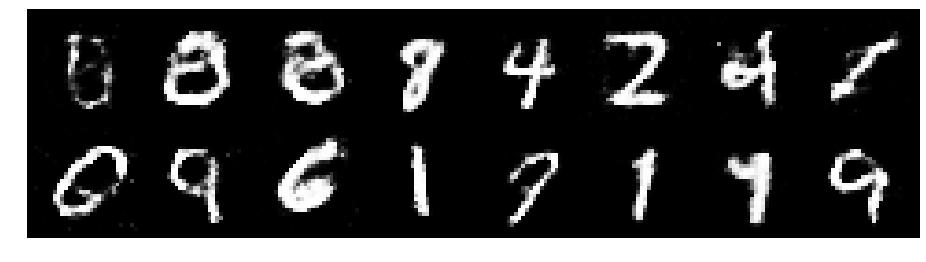

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.1259, Generator Loss: 0.8628
D(x): 0.6254, D(G(z)): 0.4249


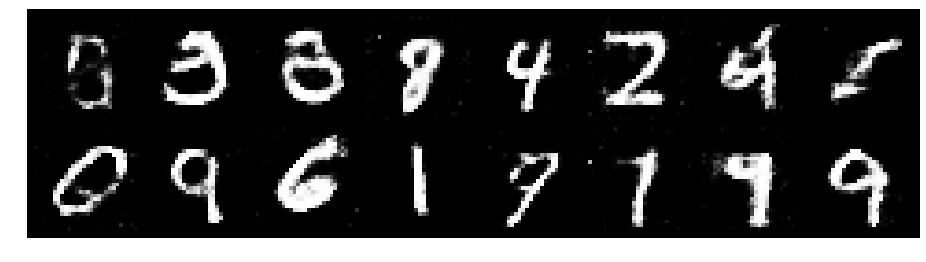

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.1940, Generator Loss: 0.9493
D(x): 0.5541, D(G(z)): 0.3889


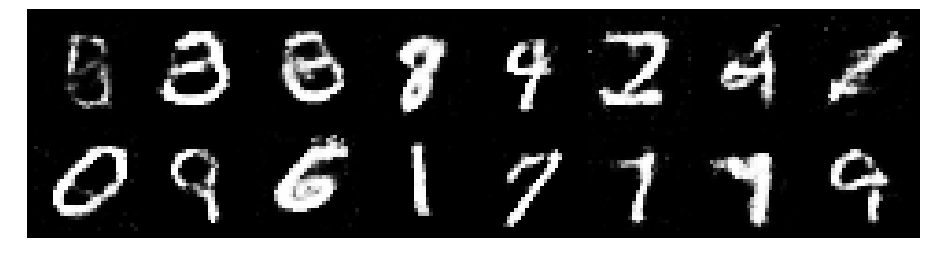

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.3822, Generator Loss: 0.8509
D(x): 0.5585, D(G(z)): 0.4926


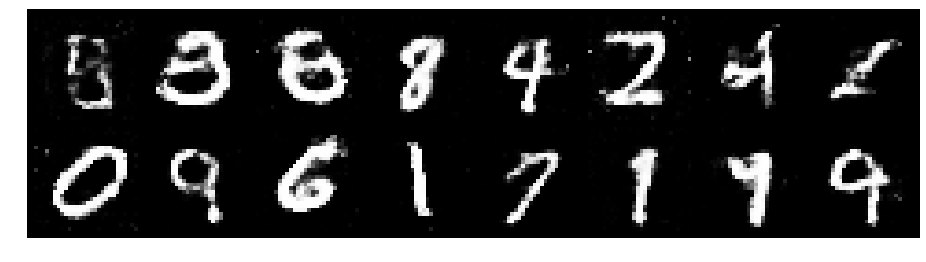

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2810, Generator Loss: 0.8905
D(x): 0.5479, D(G(z)): 0.4537


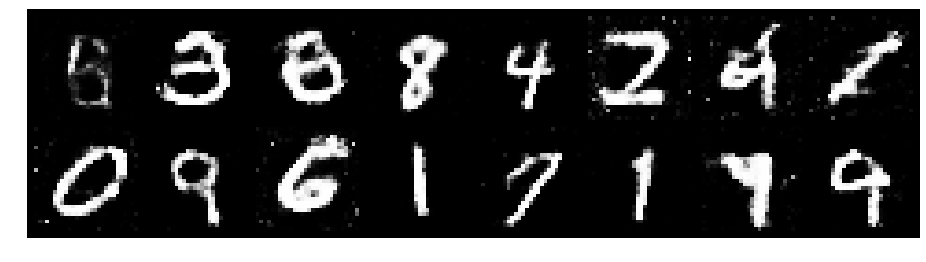

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.3747, Generator Loss: 0.8445
D(x): 0.5197, D(G(z)): 0.4640


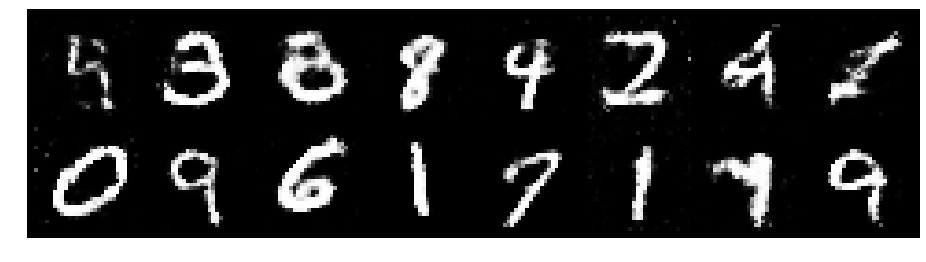

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2869, Generator Loss: 0.8687
D(x): 0.5564, D(G(z)): 0.4687


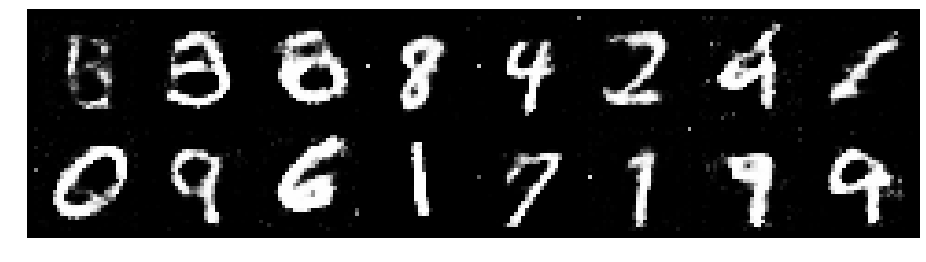

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.3764, Generator Loss: 0.8131
D(x): 0.5243, D(G(z)): 0.4844


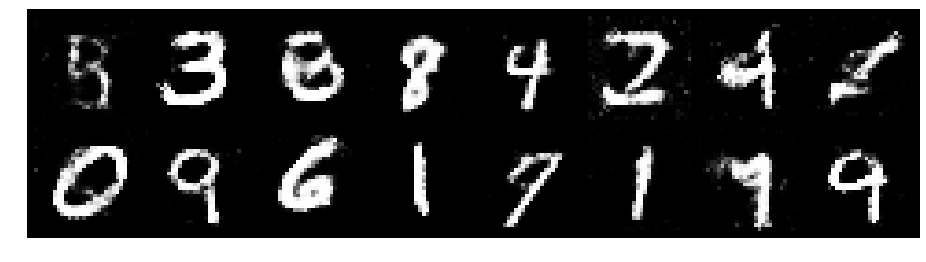

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2518, Generator Loss: 0.8649
D(x): 0.5331, D(G(z)): 0.4302


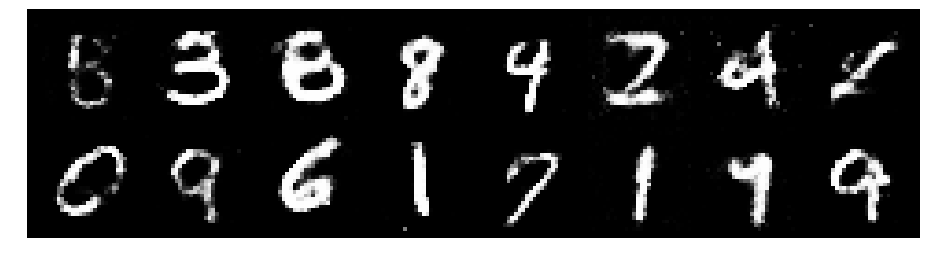

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.3044, Generator Loss: 0.9585
D(x): 0.5241, D(G(z)): 0.4473


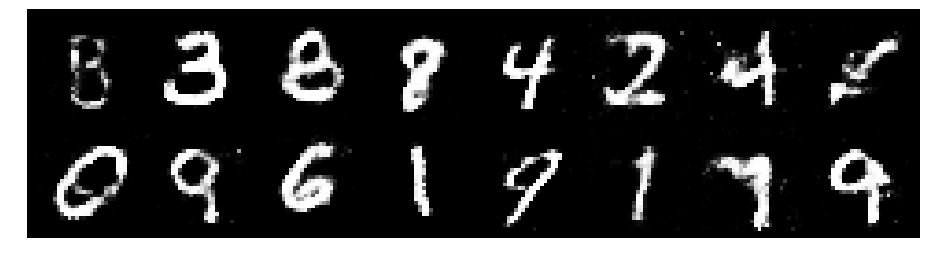

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.1867, Generator Loss: 1.0256
D(x): 0.5374, D(G(z)): 0.4000


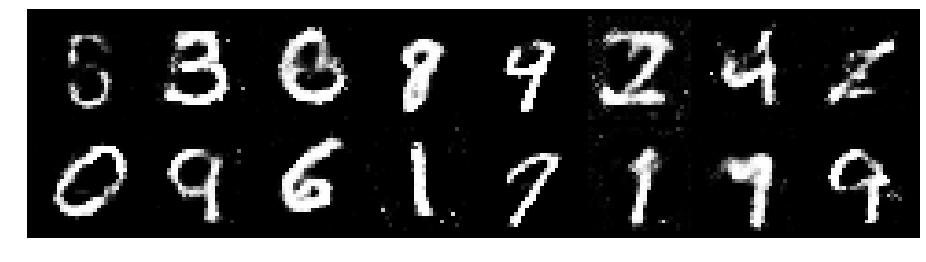

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2663, Generator Loss: 0.8895
D(x): 0.5458, D(G(z)): 0.4504


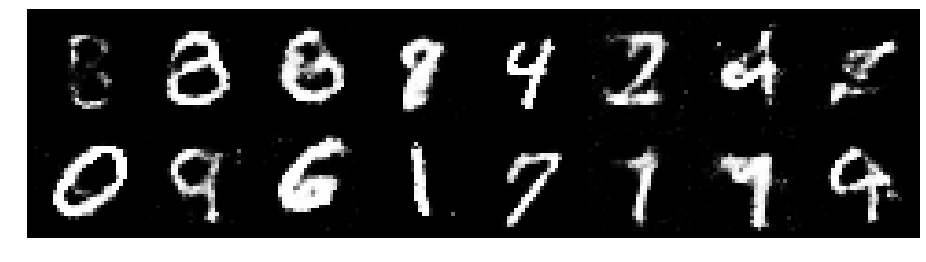

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.3403, Generator Loss: 0.9352
D(x): 0.4938, D(G(z)): 0.4190


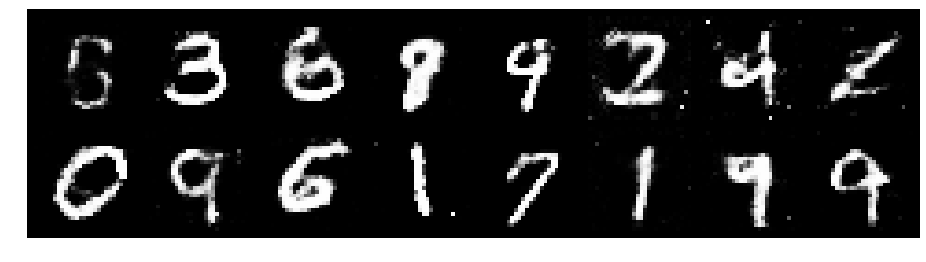

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.2677, Generator Loss: 0.8234
D(x): 0.5646, D(G(z)): 0.4608


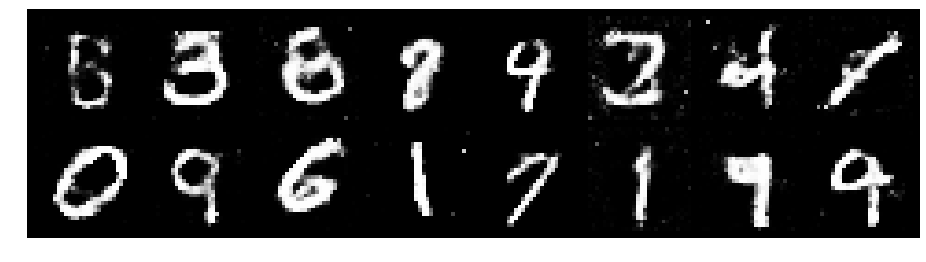

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2109, Generator Loss: 0.9675
D(x): 0.6074, D(G(z)): 0.4620


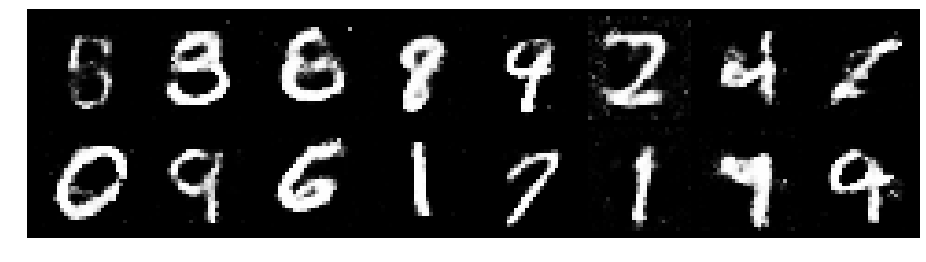

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3165, Generator Loss: 0.9061
D(x): 0.5549, D(G(z)): 0.4431


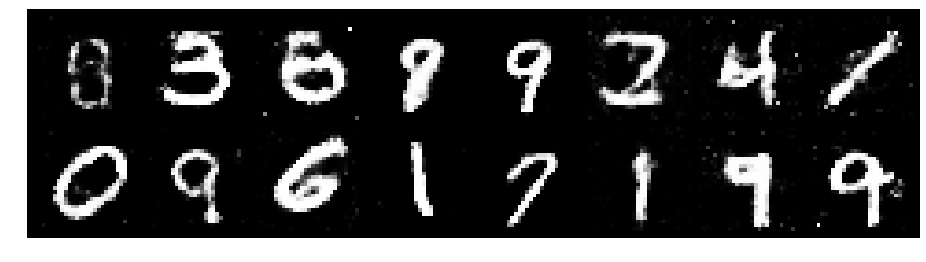

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.3201, Generator Loss: 0.8011
D(x): 0.5445, D(G(z)): 0.4693


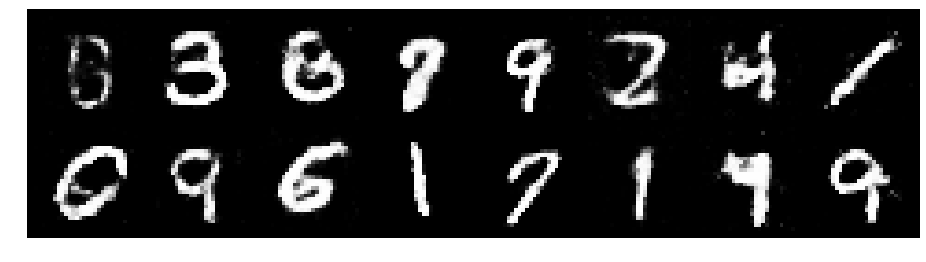

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.3569, Generator Loss: 0.8550
D(x): 0.5258, D(G(z)): 0.4640


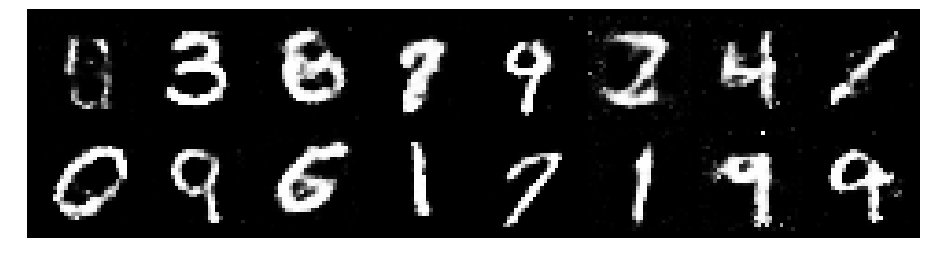

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.2335, Generator Loss: 0.8693
D(x): 0.5861, D(G(z)): 0.4439


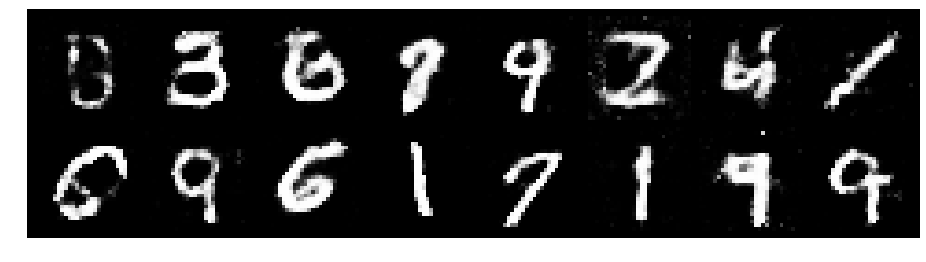

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.3478, Generator Loss: 0.8093
D(x): 0.5718, D(G(z)): 0.4881


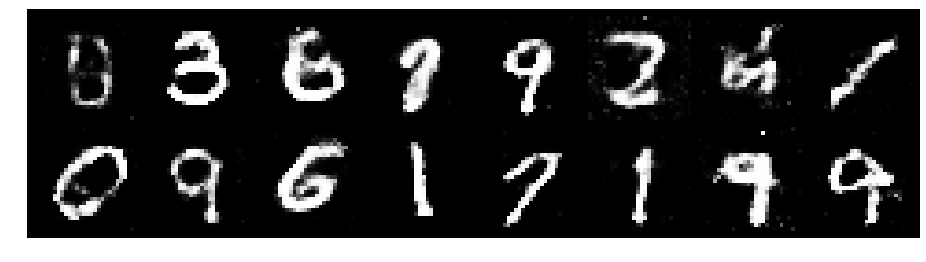

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.3541, Generator Loss: 0.8941
D(x): 0.4887, D(G(z)): 0.4268


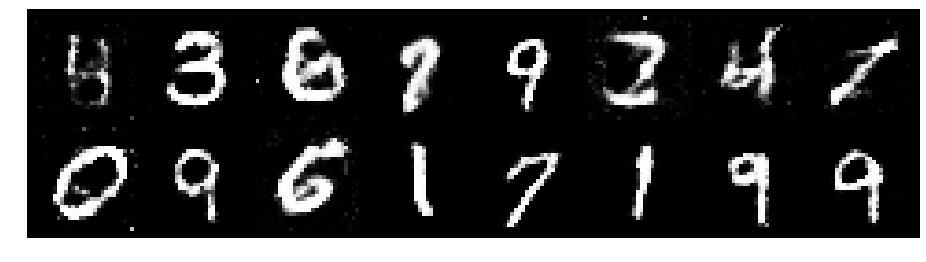

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2165, Generator Loss: 0.8959
D(x): 0.5508, D(G(z)): 0.4292


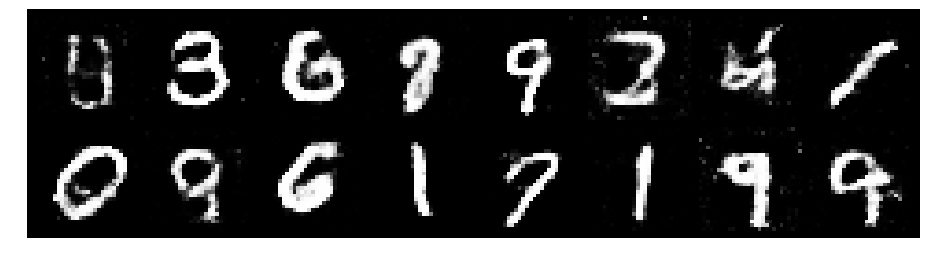

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.3072, Generator Loss: 0.7921
D(x): 0.5786, D(G(z)): 0.4776


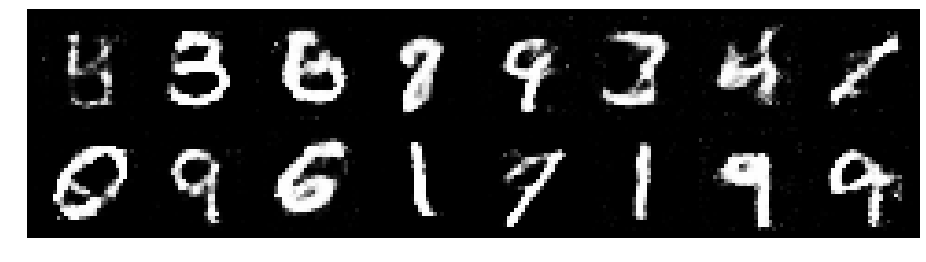

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2995, Generator Loss: 0.8659
D(x): 0.5244, D(G(z)): 0.4462


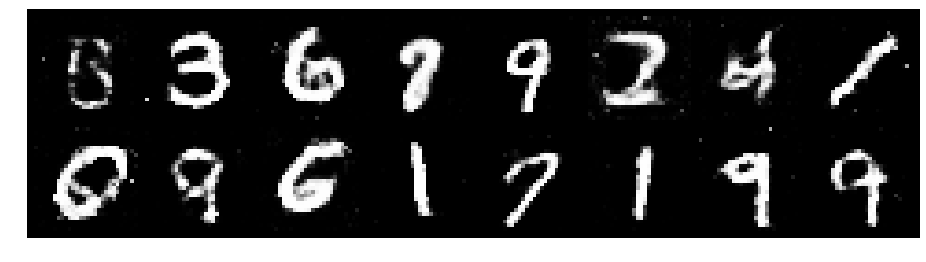

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2625, Generator Loss: 0.9483
D(x): 0.5754, D(G(z)): 0.4363


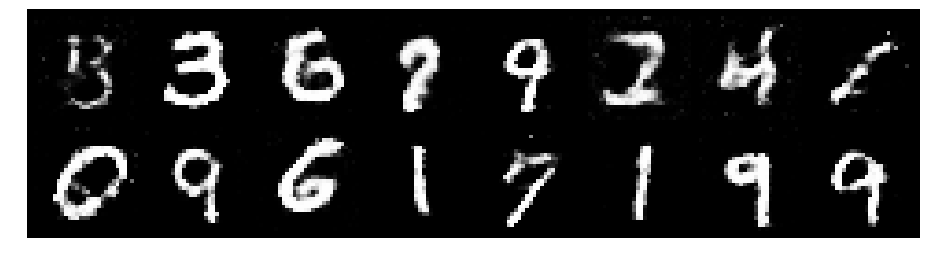

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2052, Generator Loss: 0.8518
D(x): 0.6017, D(G(z)): 0.4752


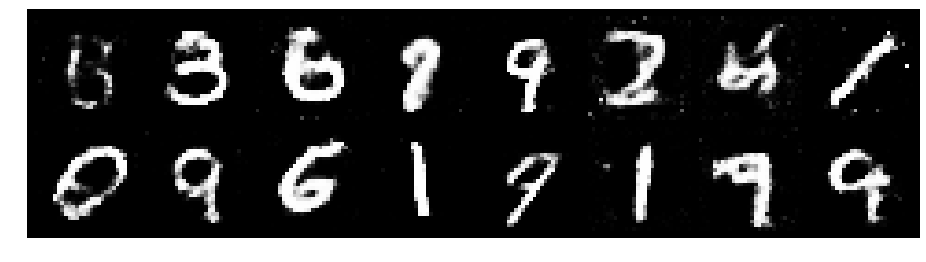

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.1825, Generator Loss: 0.8938
D(x): 0.5668, D(G(z)): 0.4268


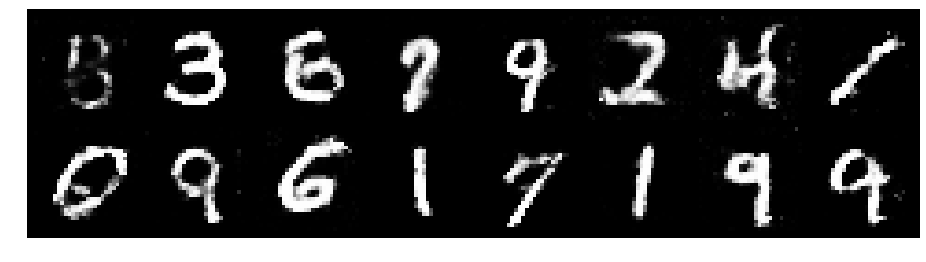

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2548, Generator Loss: 0.8996
D(x): 0.5350, D(G(z)): 0.4192


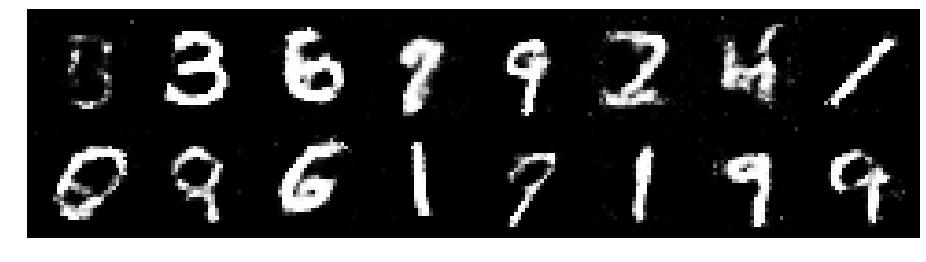

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3987, Generator Loss: 0.7732
D(x): 0.5575, D(G(z)): 0.4950


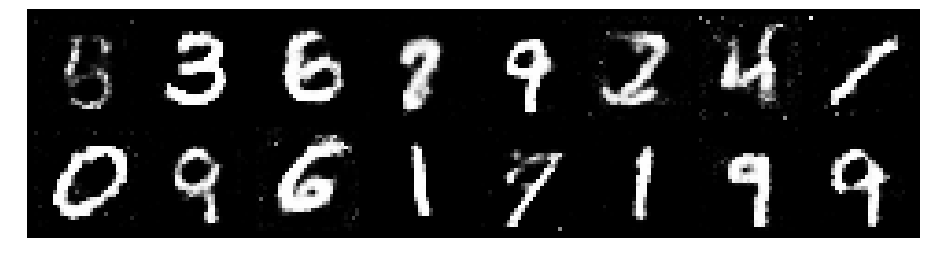

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.3750, Generator Loss: 0.9362
D(x): 0.5504, D(G(z)): 0.4624


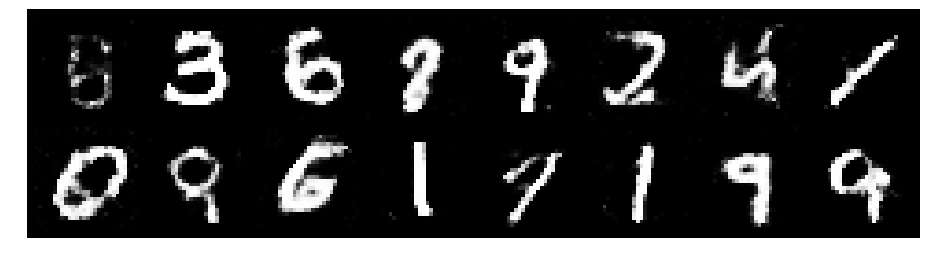

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2472, Generator Loss: 0.9349
D(x): 0.5418, D(G(z)): 0.4175


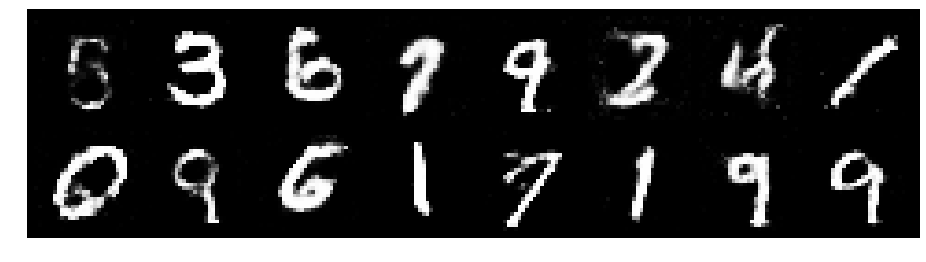

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2598, Generator Loss: 0.8661
D(x): 0.5413, D(G(z)): 0.4379


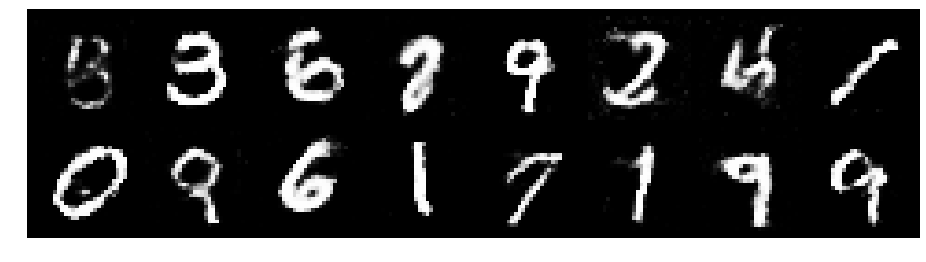

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.3318, Generator Loss: 0.8441
D(x): 0.5488, D(G(z)): 0.4543


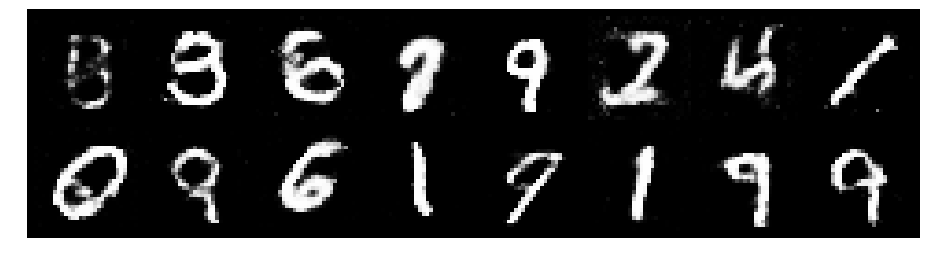

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.3333, Generator Loss: 0.8709
D(x): 0.5162, D(G(z)): 0.4195


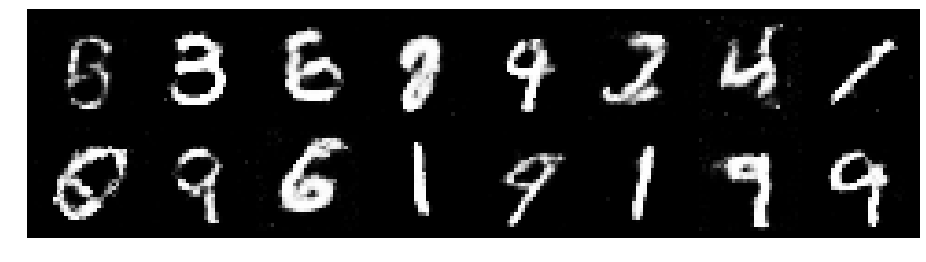

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.4206, Generator Loss: 0.9007
D(x): 0.5544, D(G(z)): 0.4931


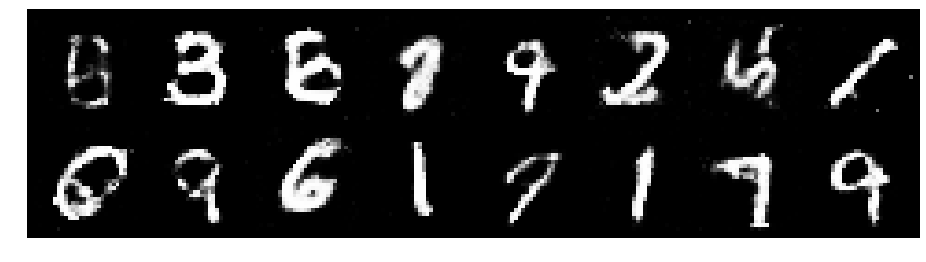

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.3049, Generator Loss: 0.8750
D(x): 0.5014, D(G(z)): 0.4236


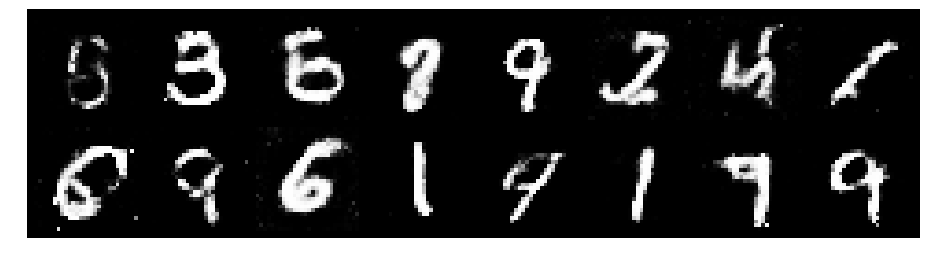

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.2437, Generator Loss: 0.8281
D(x): 0.5640, D(G(z)): 0.4643


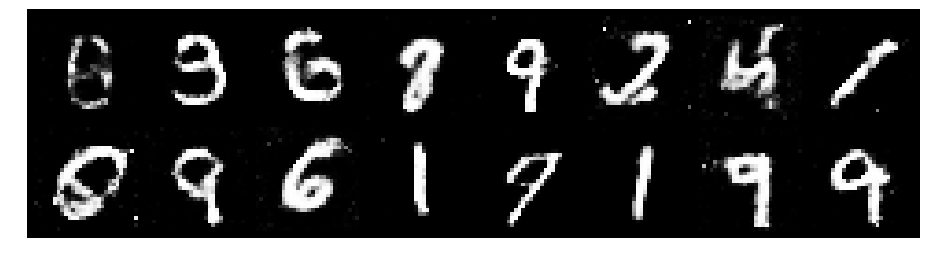

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.2599, Generator Loss: 0.8578
D(x): 0.5587, D(G(z)): 0.4619


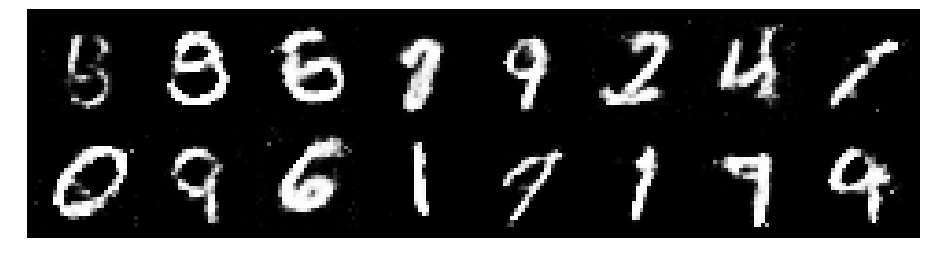

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.3250, Generator Loss: 0.8917
D(x): 0.5058, D(G(z)): 0.4236


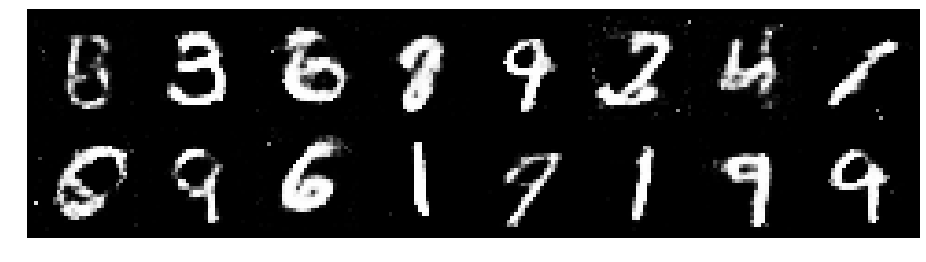

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.2100, Generator Loss: 1.0935
D(x): 0.5727, D(G(z)): 0.4038


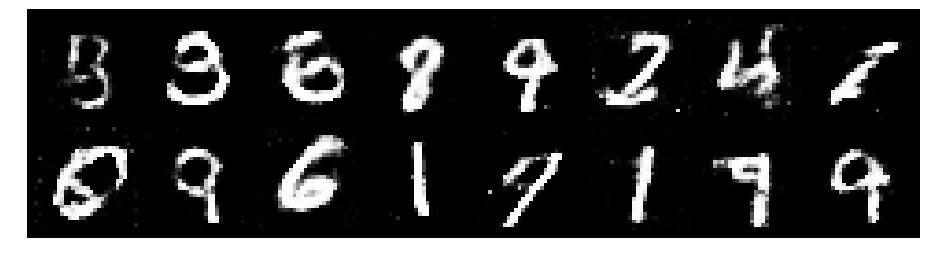

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2711, Generator Loss: 0.8620
D(x): 0.5913, D(G(z)): 0.4623


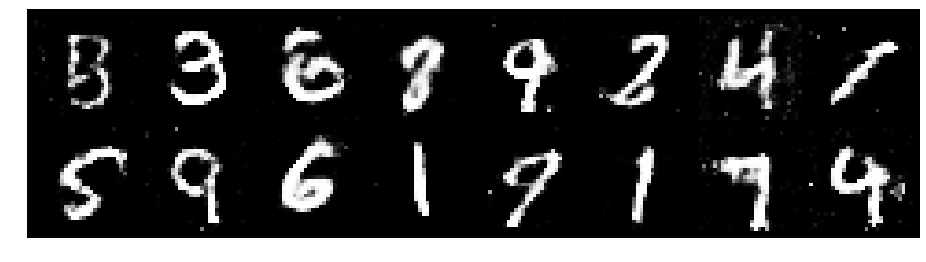

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.3077, Generator Loss: 0.7944
D(x): 0.5440, D(G(z)): 0.4579


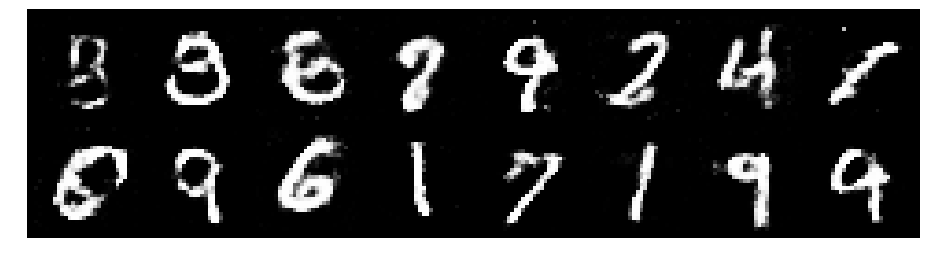

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2924, Generator Loss: 0.8377
D(x): 0.5453, D(G(z)): 0.4643


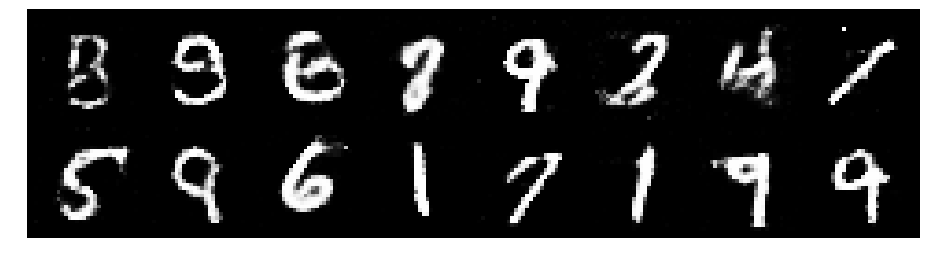

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.3508, Generator Loss: 0.6934
D(x): 0.5378, D(G(z)): 0.4885


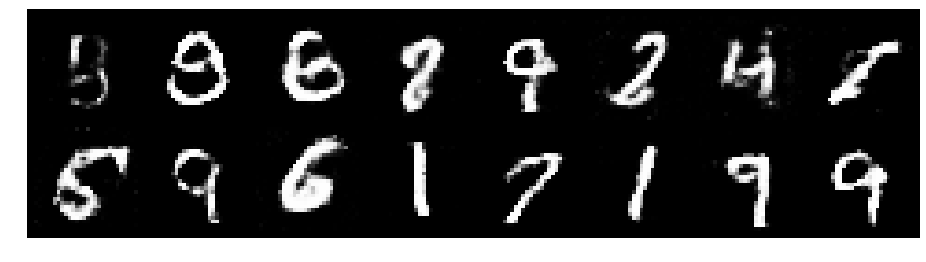

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.3257, Generator Loss: 0.7934
D(x): 0.5761, D(G(z)): 0.4824


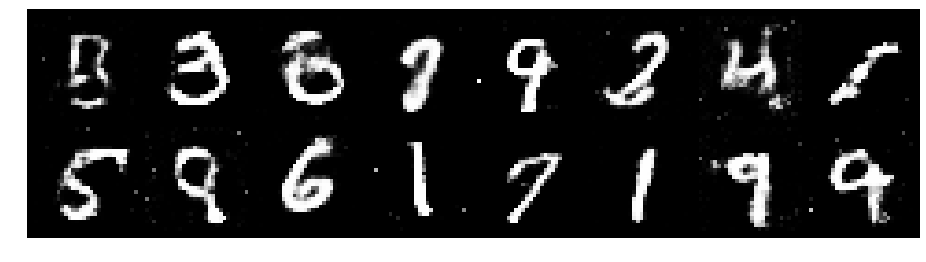

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3637, Generator Loss: 0.8153
D(x): 0.5310, D(G(z)): 0.4543


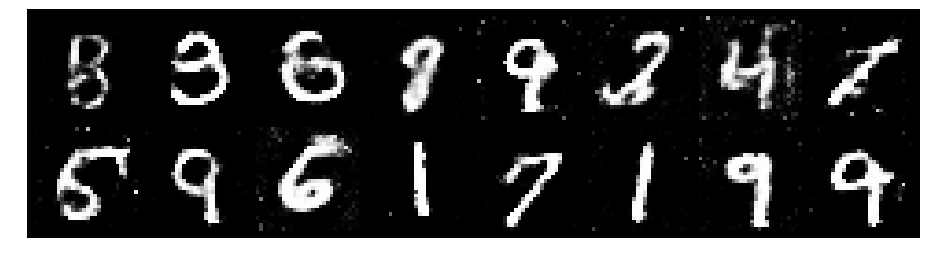

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2676, Generator Loss: 0.9580
D(x): 0.5184, D(G(z)): 0.4130


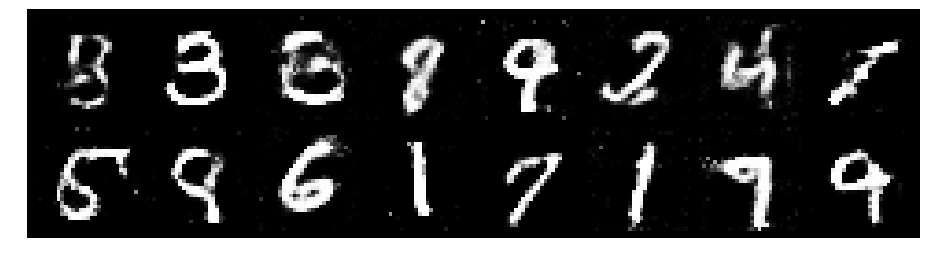

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2859, Generator Loss: 0.8754
D(x): 0.5627, D(G(z)): 0.4685


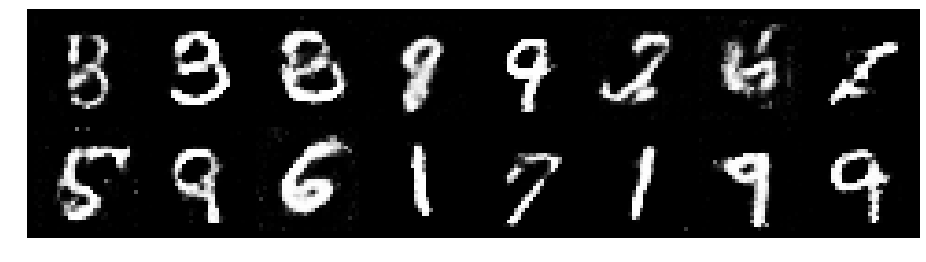

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.1823, Generator Loss: 0.8012
D(x): 0.5920, D(G(z)): 0.4503


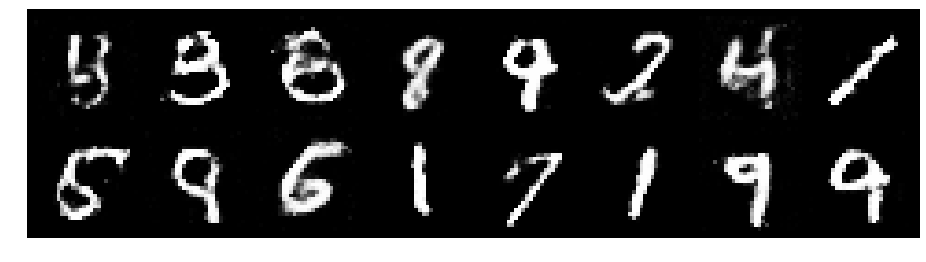

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2523, Generator Loss: 0.8520
D(x): 0.5509, D(G(z)): 0.4465


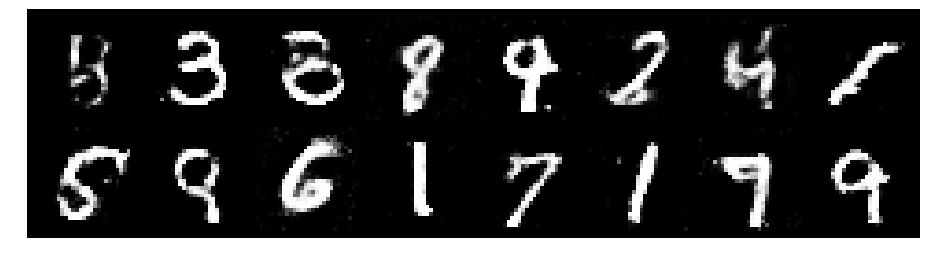

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2686, Generator Loss: 0.8303
D(x): 0.5259, D(G(z)): 0.4289


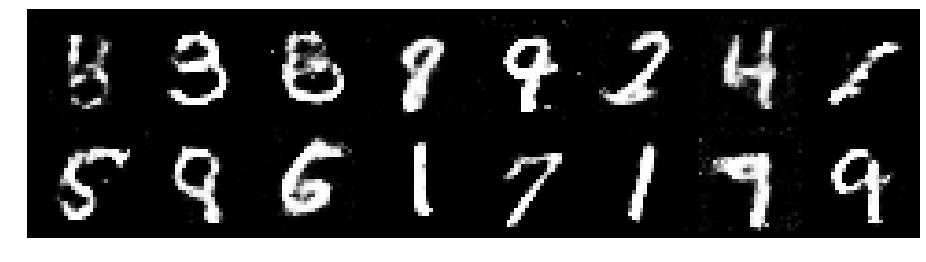

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.1853, Generator Loss: 0.9395
D(x): 0.5726, D(G(z)): 0.4234


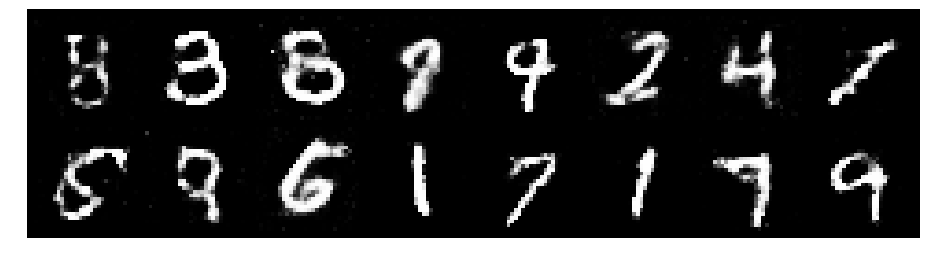

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2149, Generator Loss: 1.0012
D(x): 0.5456, D(G(z)): 0.4213


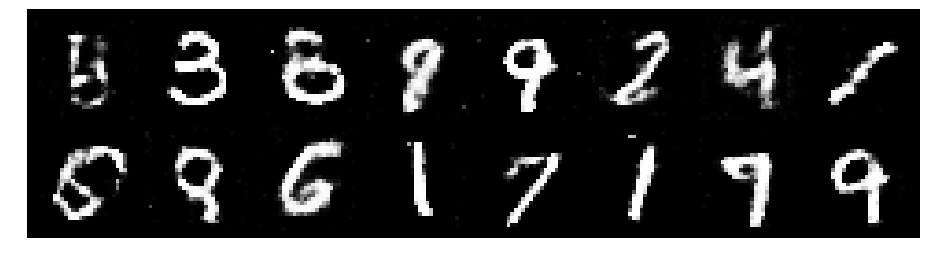

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.2172, Generator Loss: 0.9984
D(x): 0.5535, D(G(z)): 0.4131


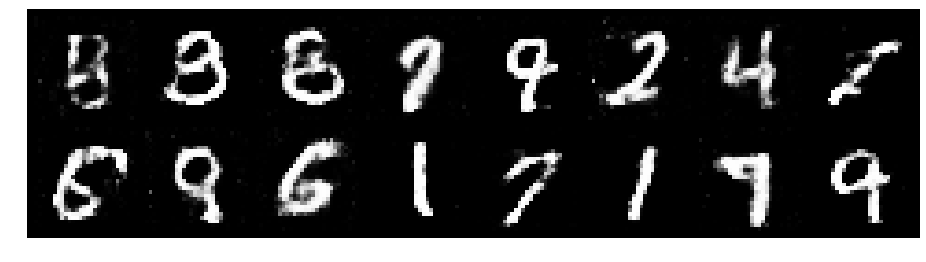

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.3105, Generator Loss: 1.0136
D(x): 0.5492, D(G(z)): 0.4393


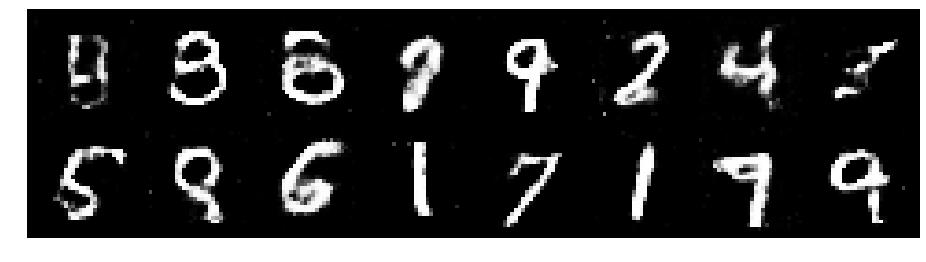

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2856, Generator Loss: 0.7891
D(x): 0.5384, D(G(z)): 0.4402


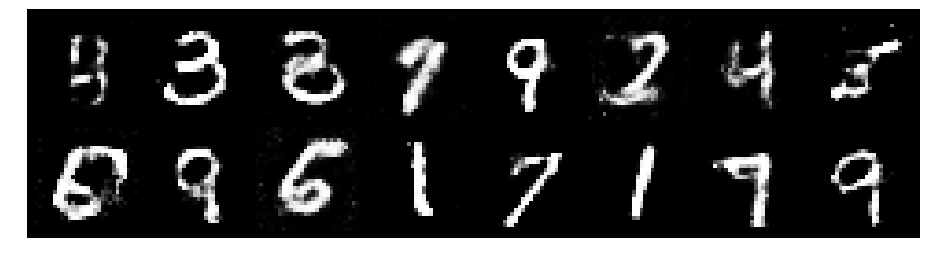

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2954, Generator Loss: 0.8980
D(x): 0.5325, D(G(z)): 0.4230


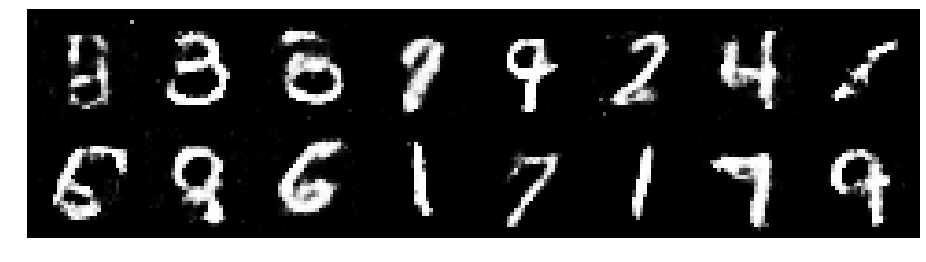

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.3192, Generator Loss: 0.7512
D(x): 0.5595, D(G(z)): 0.4847


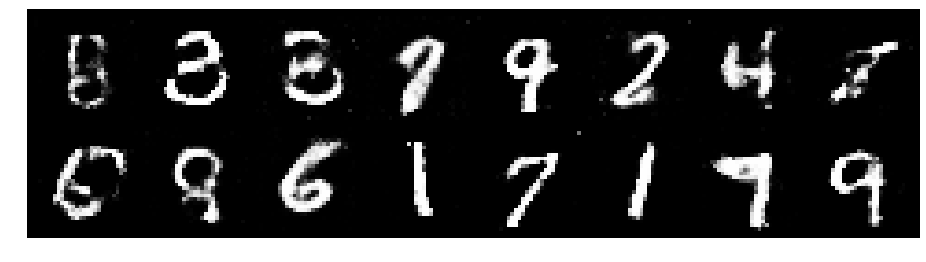

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.2867, Generator Loss: 0.7720
D(x): 0.5770, D(G(z)): 0.4892


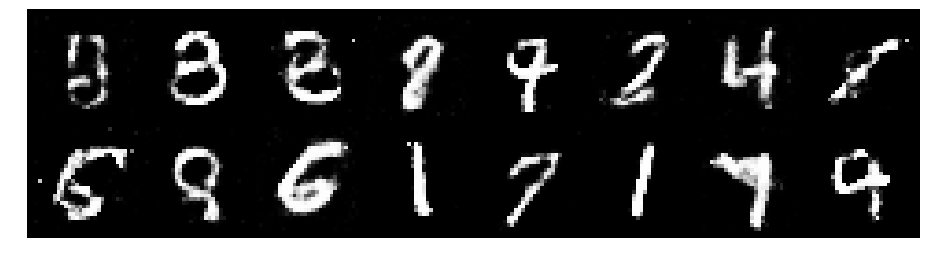

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.2536, Generator Loss: 0.7451
D(x): 0.5499, D(G(z)): 0.4546


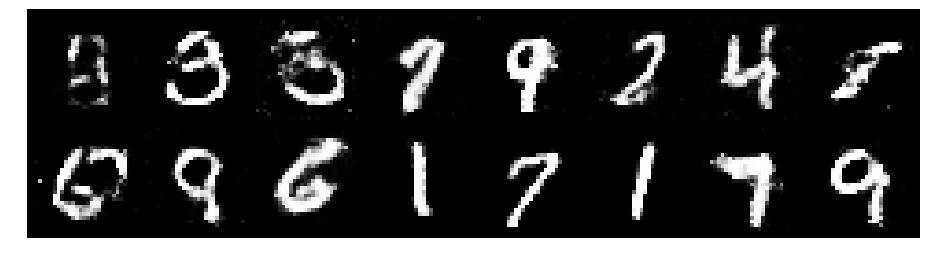

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2912, Generator Loss: 0.7726
D(x): 0.5733, D(G(z)): 0.4808


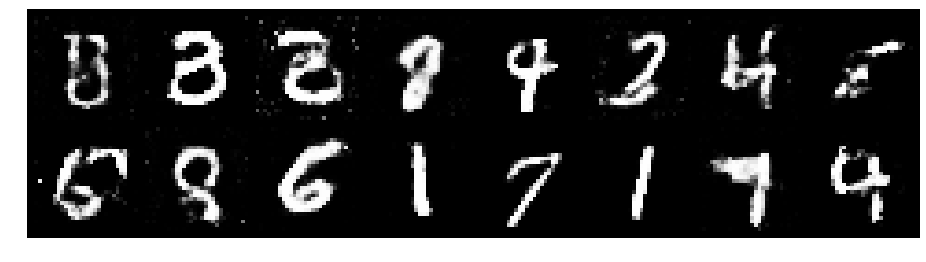

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.2956, Generator Loss: 0.8823
D(x): 0.5559, D(G(z)): 0.4611


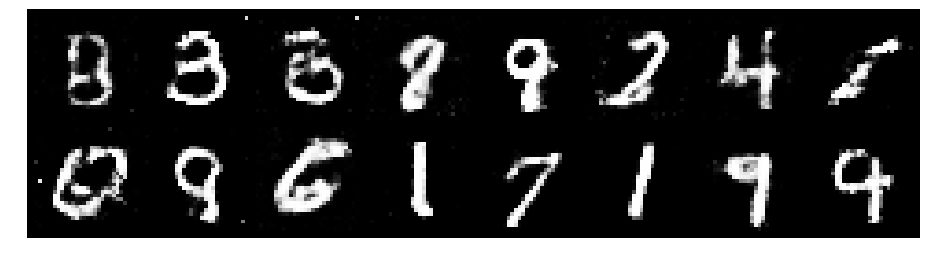

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.1592, Generator Loss: 1.0173
D(x): 0.5780, D(G(z)): 0.4218


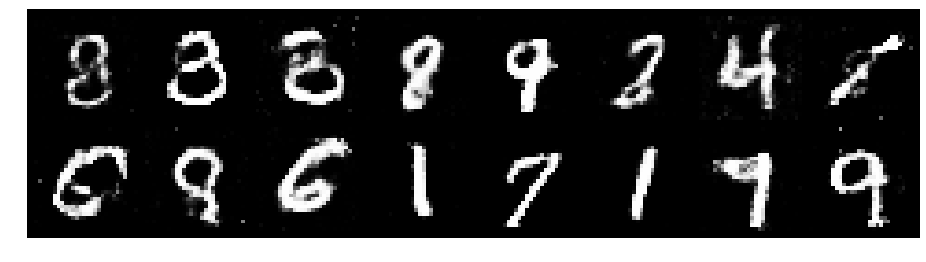

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.1964, Generator Loss: 0.9876
D(x): 0.5723, D(G(z)): 0.4148


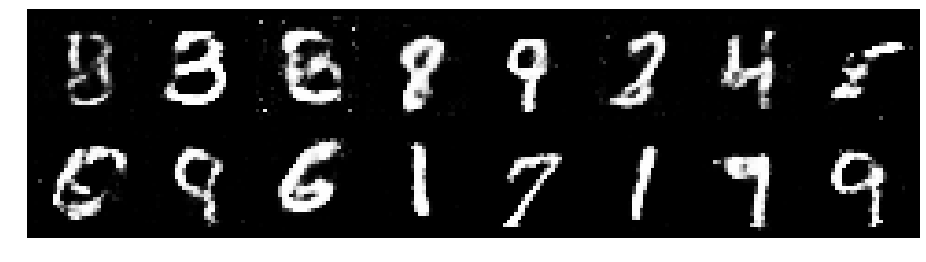

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.2431, Generator Loss: 1.0400
D(x): 0.5877, D(G(z)): 0.4504


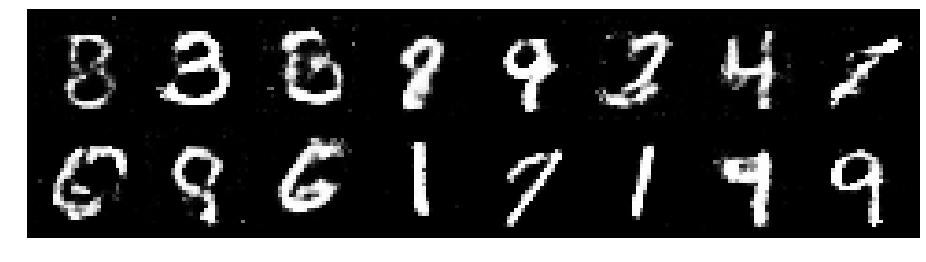

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.3085, Generator Loss: 1.0561
D(x): 0.5806, D(G(z)): 0.4517


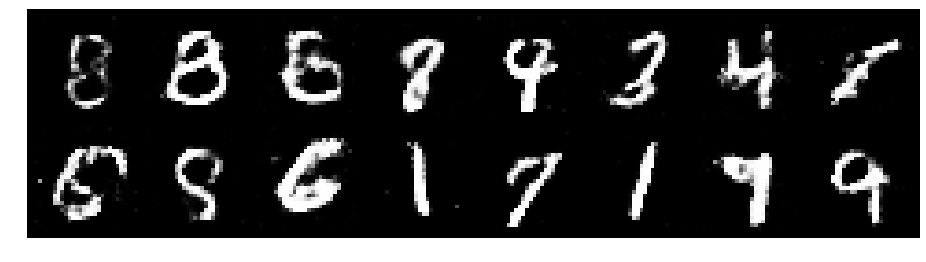

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.3285, Generator Loss: 0.8672
D(x): 0.5350, D(G(z)): 0.4687


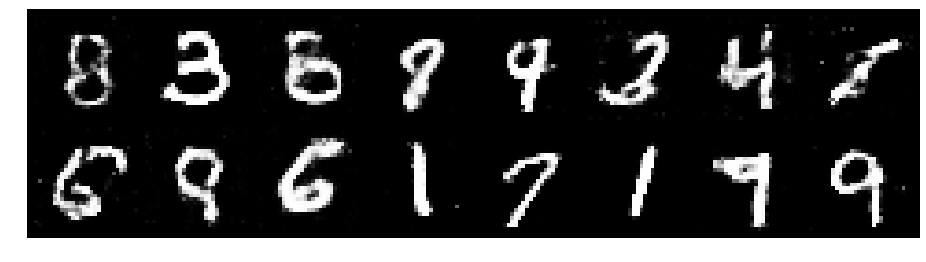

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.3654, Generator Loss: 0.8702
D(x): 0.5104, D(G(z)): 0.4468


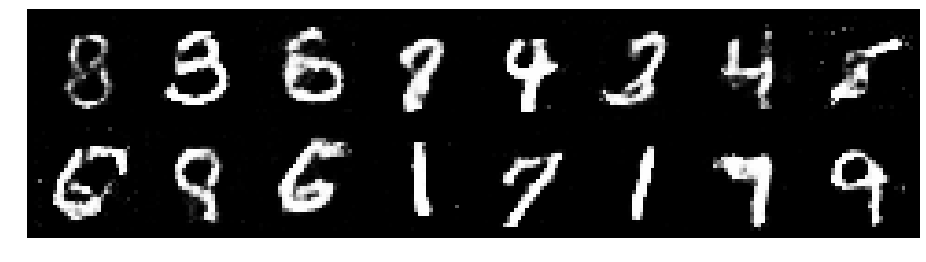

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.3363, Generator Loss: 0.7906
D(x): 0.5426, D(G(z)): 0.4609


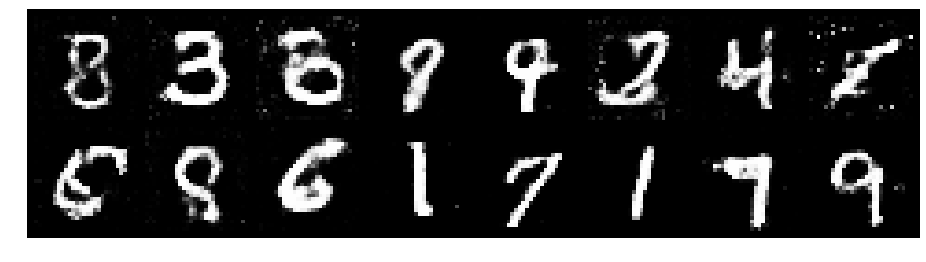

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2204, Generator Loss: 0.9391
D(x): 0.5699, D(G(z)): 0.4344


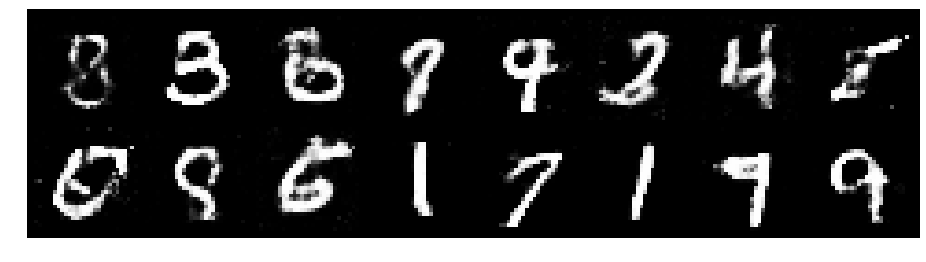

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2437, Generator Loss: 0.8544
D(x): 0.5575, D(G(z)): 0.4366


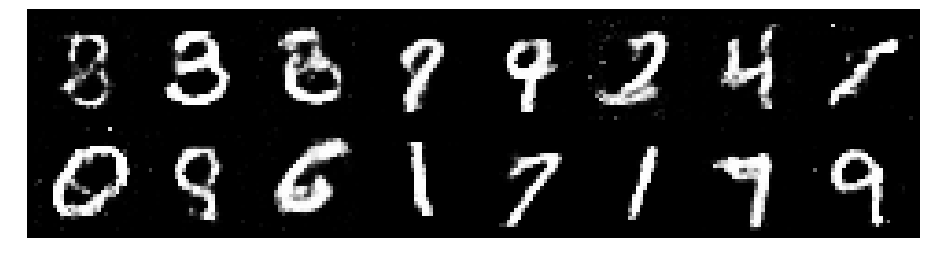

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2545, Generator Loss: 0.7306
D(x): 0.5735, D(G(z)): 0.4620


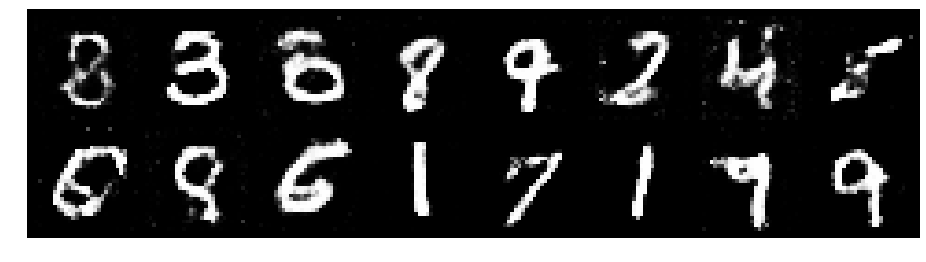

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.3054, Generator Loss: 0.8285
D(x): 0.5772, D(G(z)): 0.4865


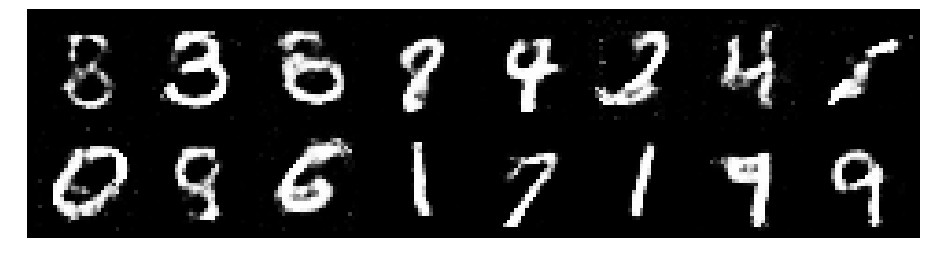

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.2214, Generator Loss: 0.9605
D(x): 0.6277, D(G(z)): 0.4724


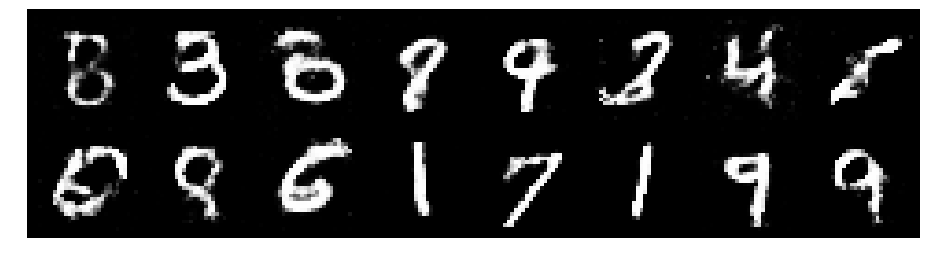

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.2333, Generator Loss: 0.9586
D(x): 0.5996, D(G(z)): 0.4436


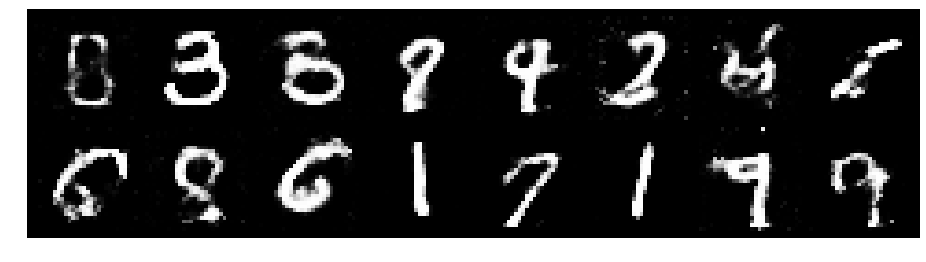

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2119, Generator Loss: 1.0320
D(x): 0.5559, D(G(z)): 0.3999


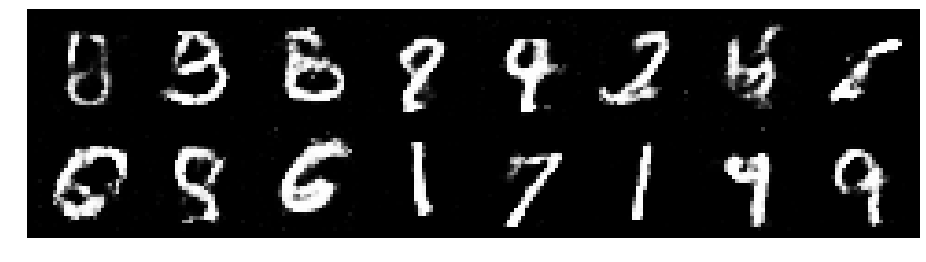

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2464, Generator Loss: 0.9251
D(x): 0.5720, D(G(z)): 0.4433


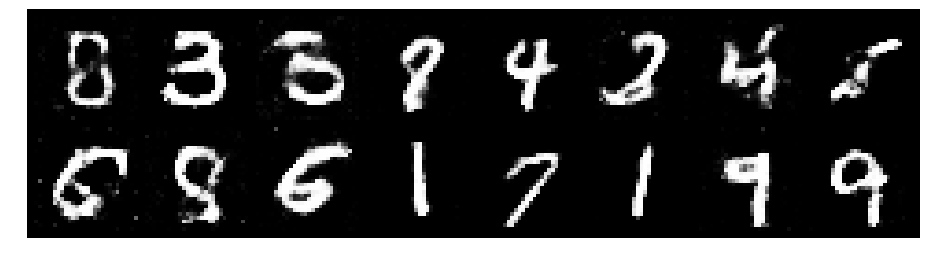

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.4058, Generator Loss: 0.9743
D(x): 0.5346, D(G(z)): 0.4556


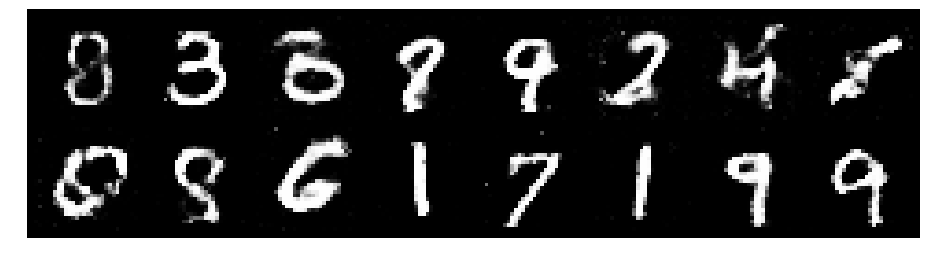

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.3212, Generator Loss: 0.9253
D(x): 0.5303, D(G(z)): 0.4327


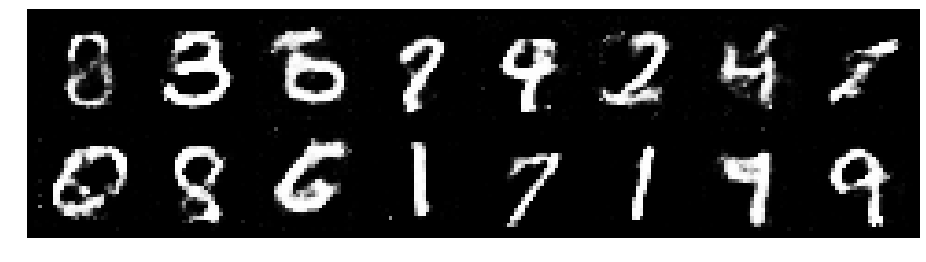

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.3355, Generator Loss: 0.9844
D(x): 0.5824, D(G(z)): 0.4745


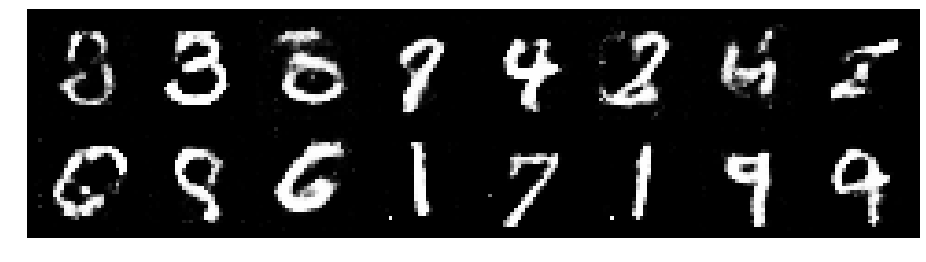

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2416, Generator Loss: 0.8588
D(x): 0.5439, D(G(z)): 0.4231


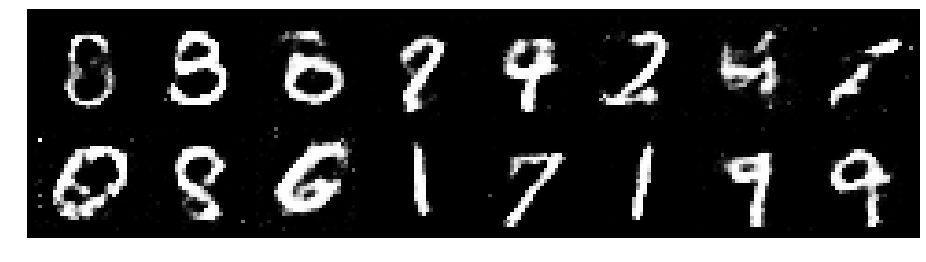

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.2604, Generator Loss: 0.8409
D(x): 0.6019, D(G(z)): 0.4857


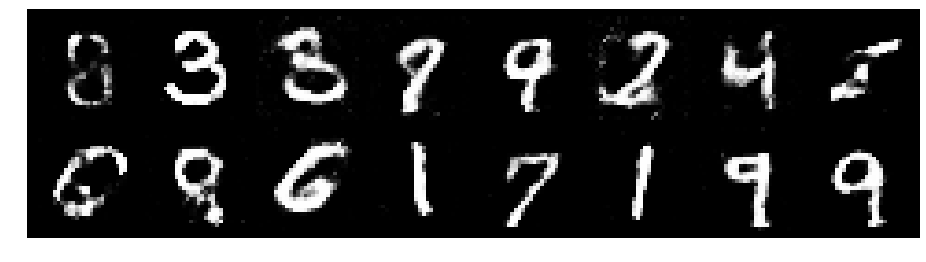

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.3111, Generator Loss: 0.8105
D(x): 0.5804, D(G(z)): 0.4713


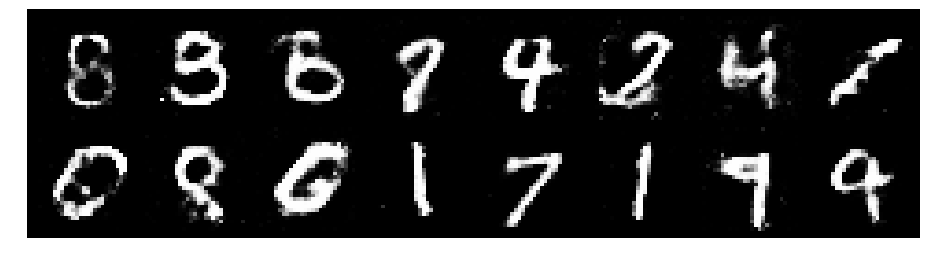

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2545, Generator Loss: 0.9115
D(x): 0.5483, D(G(z)): 0.4532


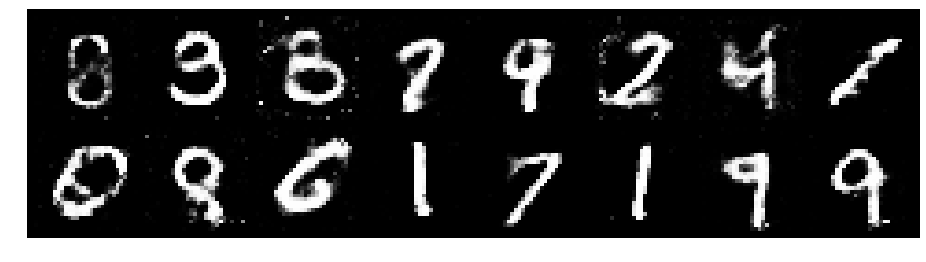

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2548, Generator Loss: 0.8562
D(x): 0.5512, D(G(z)): 0.4557


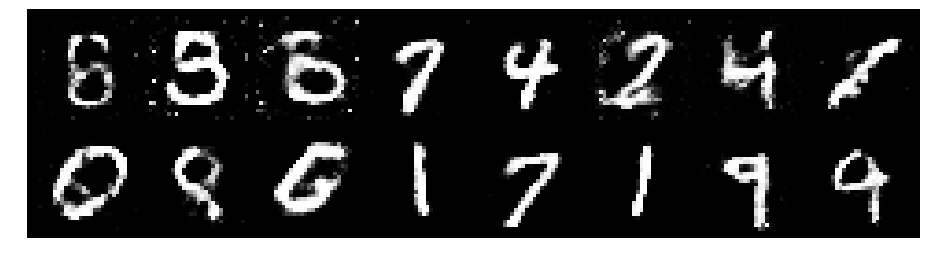

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.1971, Generator Loss: 0.9118
D(x): 0.5885, D(G(z)): 0.4409


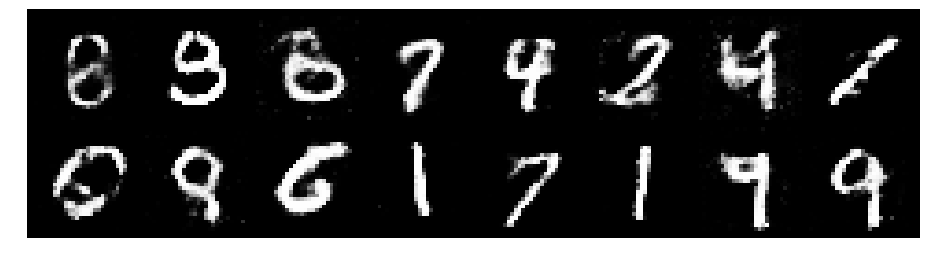

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.1804, Generator Loss: 0.9634
D(x): 0.5712, D(G(z)): 0.4192


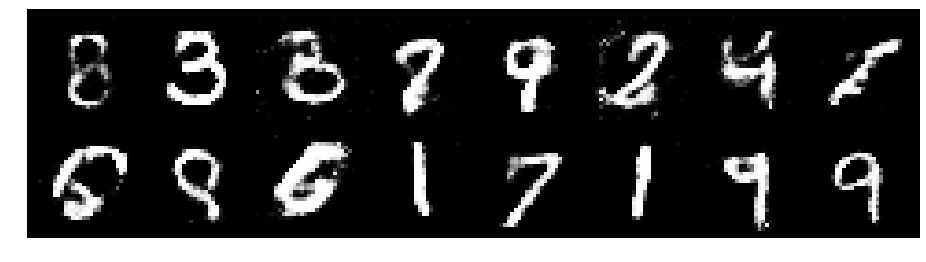

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.3592, Generator Loss: 0.9313
D(x): 0.5557, D(G(z)): 0.4601


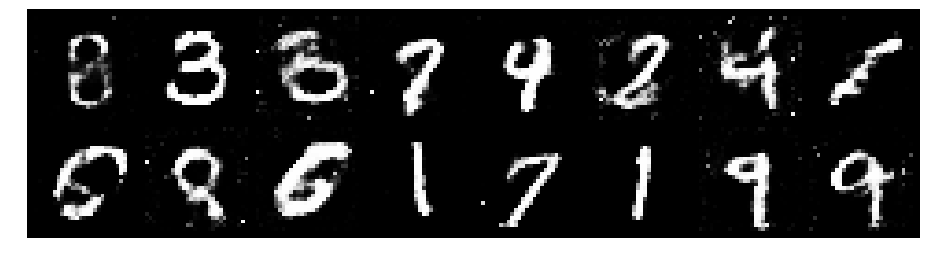

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.1693, Generator Loss: 0.9039
D(x): 0.5806, D(G(z)): 0.4189


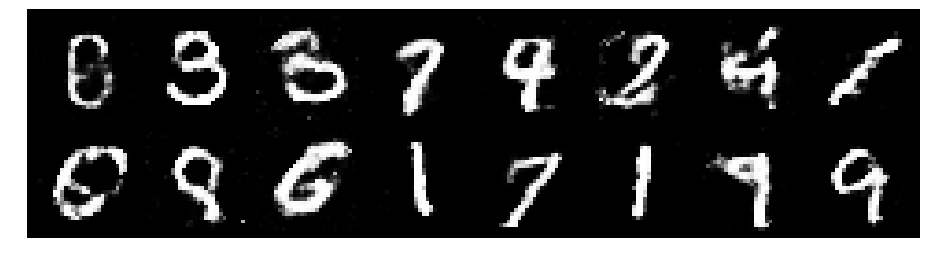

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.2607, Generator Loss: 0.8578
D(x): 0.5577, D(G(z)): 0.4384


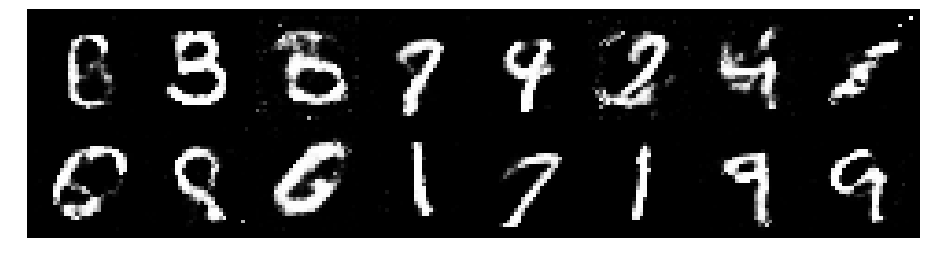

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.1382, Generator Loss: 0.9810
D(x): 0.5828, D(G(z)): 0.3976


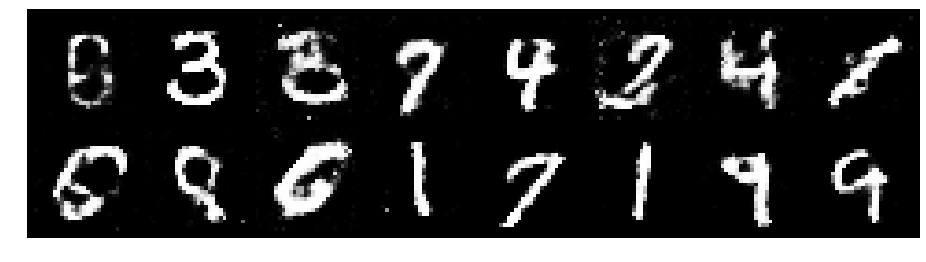

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.2491, Generator Loss: 0.9552
D(x): 0.5789, D(G(z)): 0.4623


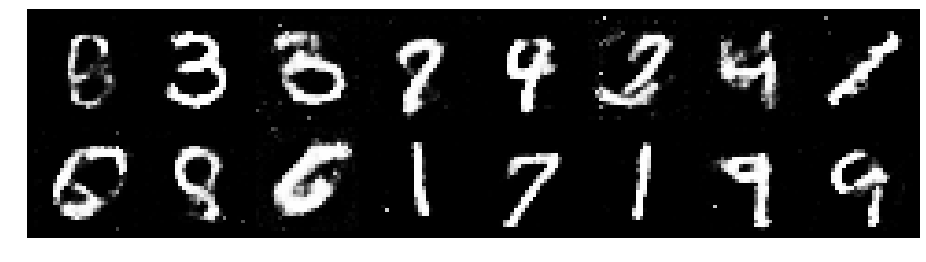

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.2739, Generator Loss: 0.8689
D(x): 0.5518, D(G(z)): 0.4388


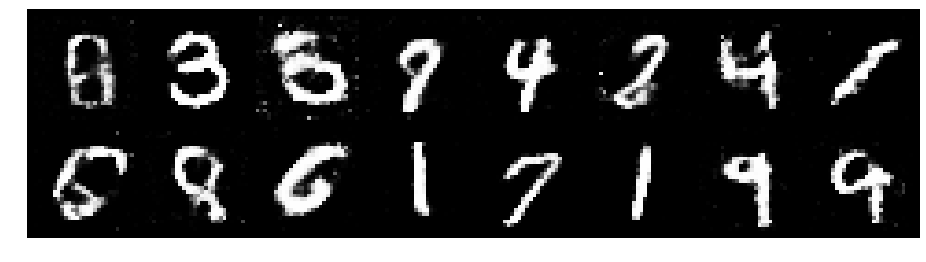

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.3206, Generator Loss: 0.7667
D(x): 0.5396, D(G(z)): 0.4693


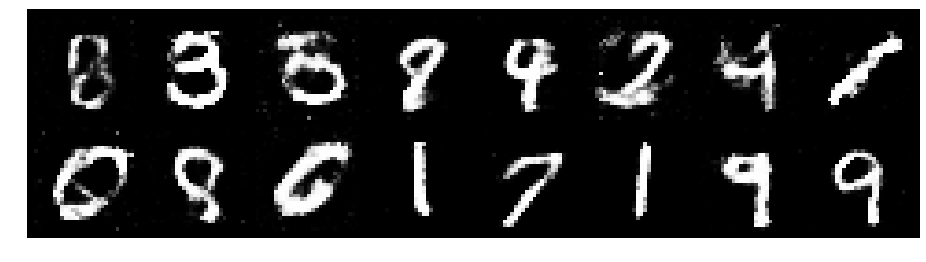

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3503, Generator Loss: 0.8079
D(x): 0.5260, D(G(z)): 0.4748


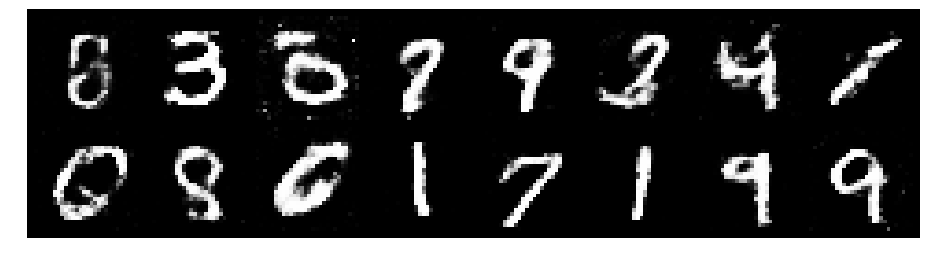

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3490, Generator Loss: 0.8804
D(x): 0.4954, D(G(z)): 0.4194


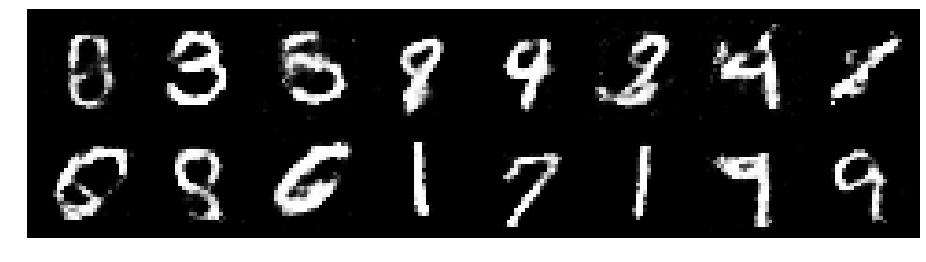

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.2702, Generator Loss: 0.8168
D(x): 0.5439, D(G(z)): 0.4456


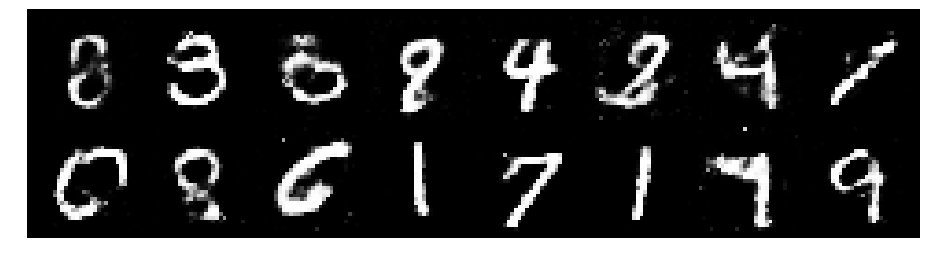

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.3634, Generator Loss: 0.7926
D(x): 0.5313, D(G(z)): 0.4597


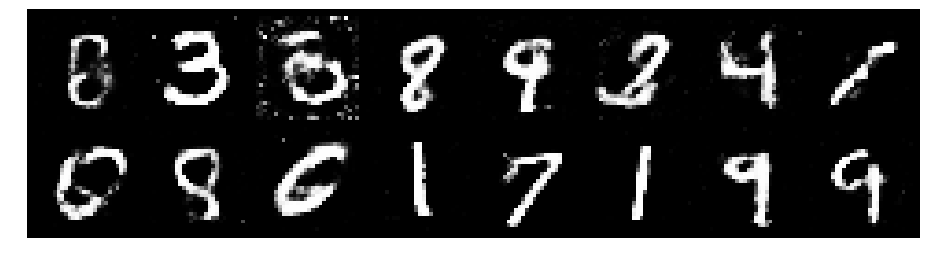

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.3677, Generator Loss: 0.8712
D(x): 0.4992, D(G(z)): 0.4410


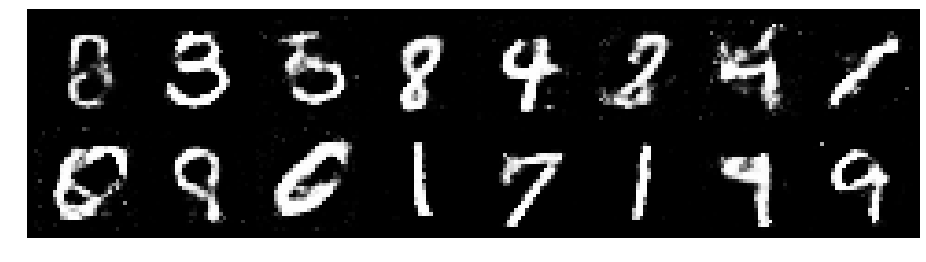

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.4669, Generator Loss: 0.9400
D(x): 0.4571, D(G(z)): 0.4328


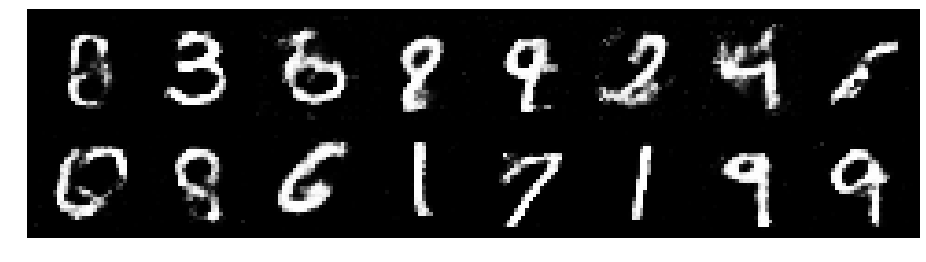

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2370, Generator Loss: 0.8520
D(x): 0.6051, D(G(z)): 0.4719


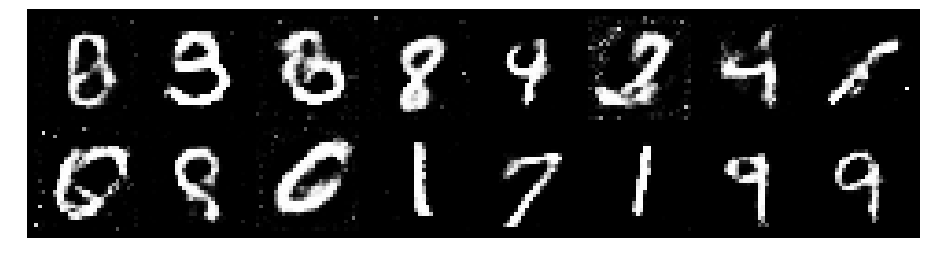

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.2683, Generator Loss: 0.8225
D(x): 0.5479, D(G(z)): 0.4549


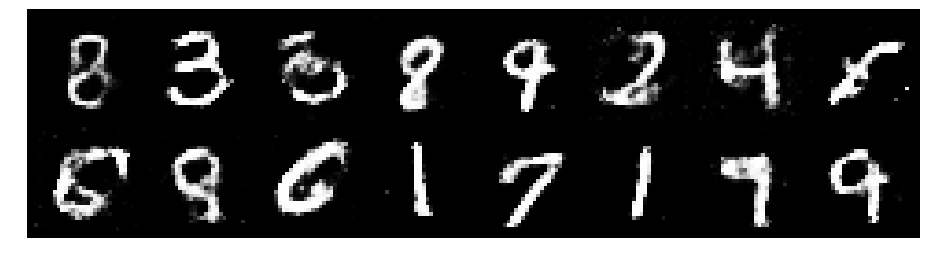

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2799, Generator Loss: 0.8262
D(x): 0.5589, D(G(z)): 0.4660


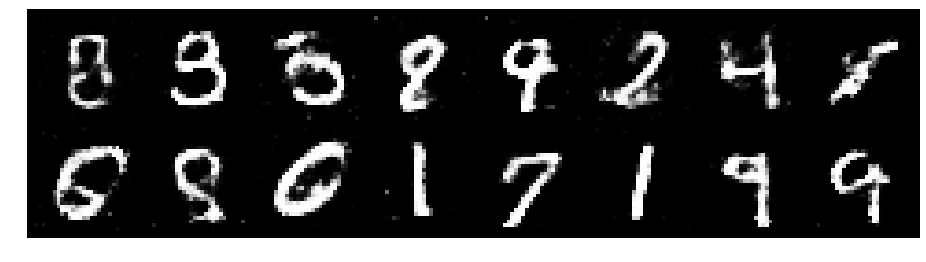

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.1854, Generator Loss: 0.8763
D(x): 0.5523, D(G(z)): 0.4148


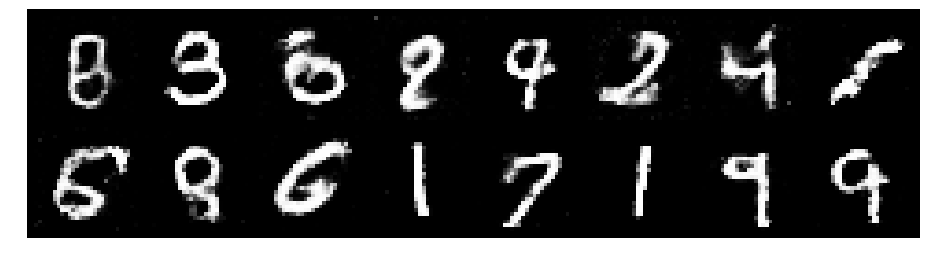

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.2896, Generator Loss: 0.8044
D(x): 0.5515, D(G(z)): 0.4624


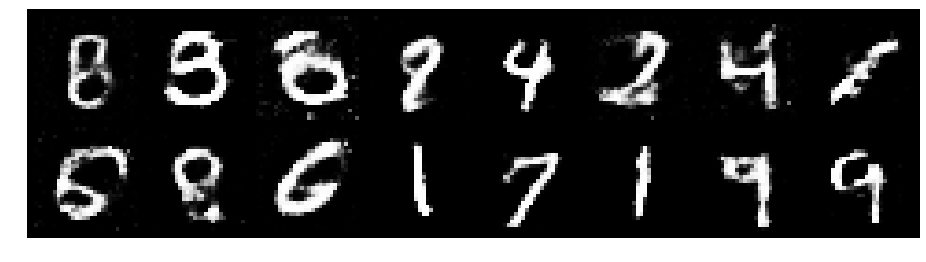

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2848, Generator Loss: 0.8494
D(x): 0.5384, D(G(z)): 0.4591


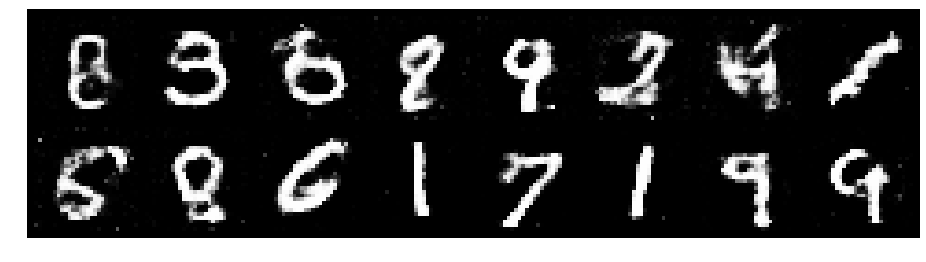

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.4370, Generator Loss: 0.7652
D(x): 0.5430, D(G(z)): 0.5183


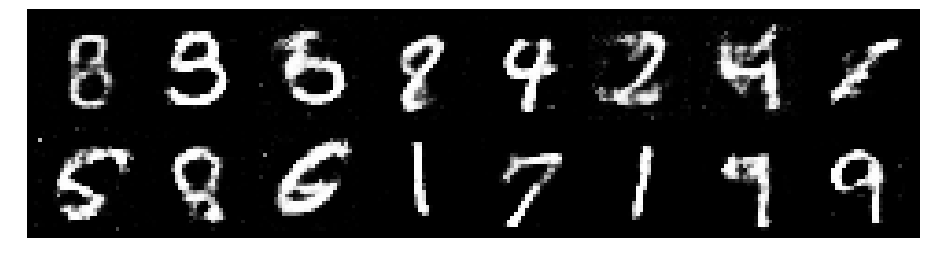

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.3809, Generator Loss: 0.6756
D(x): 0.5439, D(G(z)): 0.4939


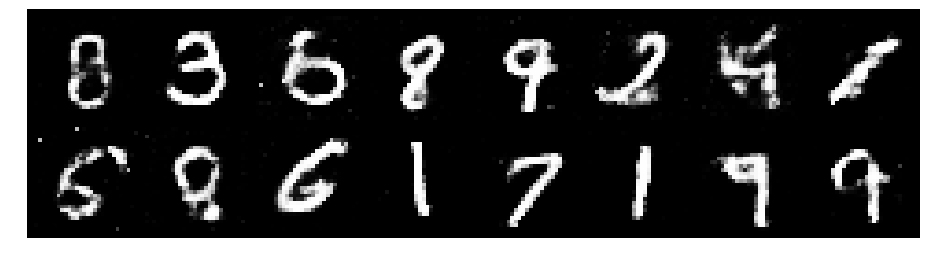

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.2598, Generator Loss: 0.9416
D(x): 0.5542, D(G(z)): 0.4451


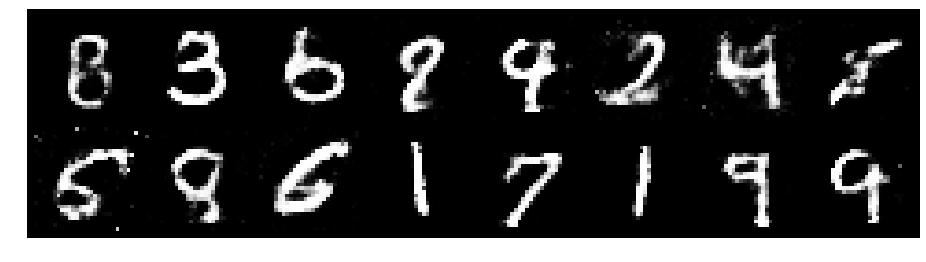

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.1664, Generator Loss: 1.0740
D(x): 0.5614, D(G(z)): 0.3912


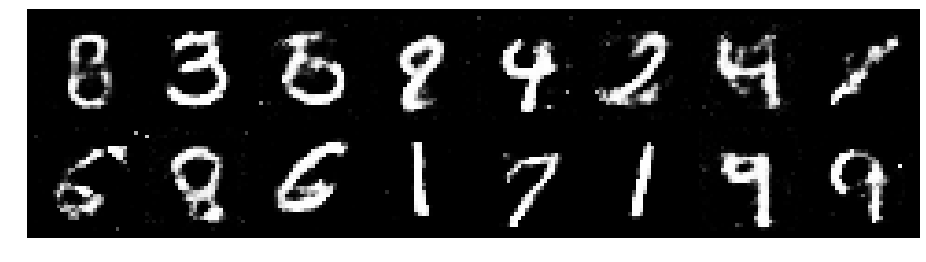

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2207, Generator Loss: 0.9215
D(x): 0.5928, D(G(z)): 0.4275


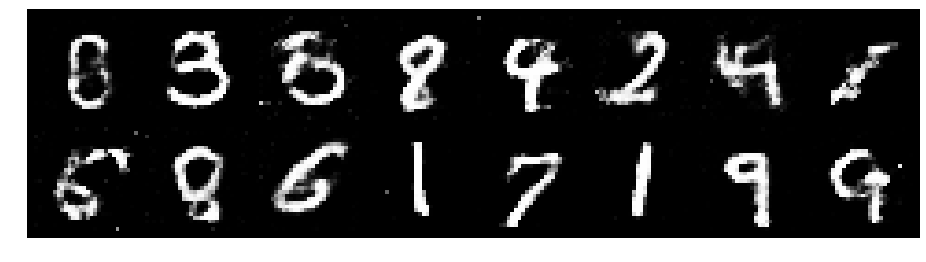

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3553, Generator Loss: 0.8107
D(x): 0.5202, D(G(z)): 0.4843


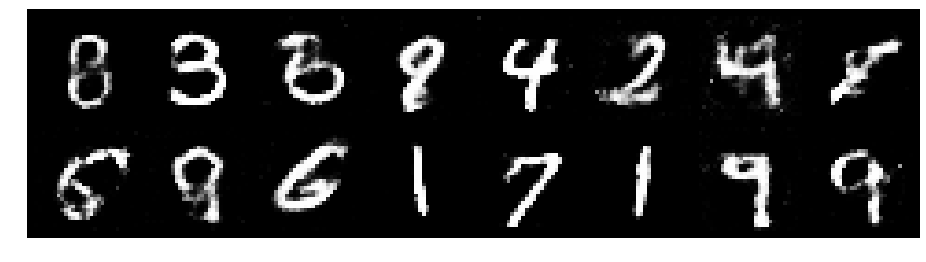

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2969, Generator Loss: 0.8492
D(x): 0.5055, D(G(z)): 0.4102


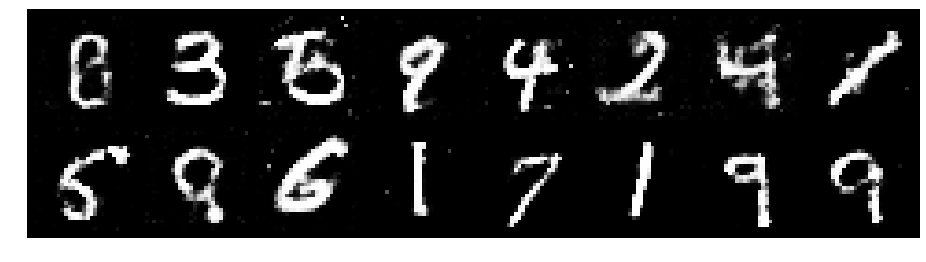

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.2553, Generator Loss: 0.8211
D(x): 0.5234, D(G(z)): 0.4367


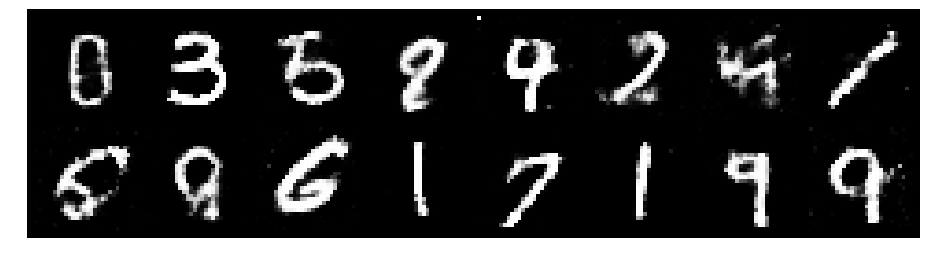

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2108, Generator Loss: 1.1040
D(x): 0.5255, D(G(z)): 0.3733


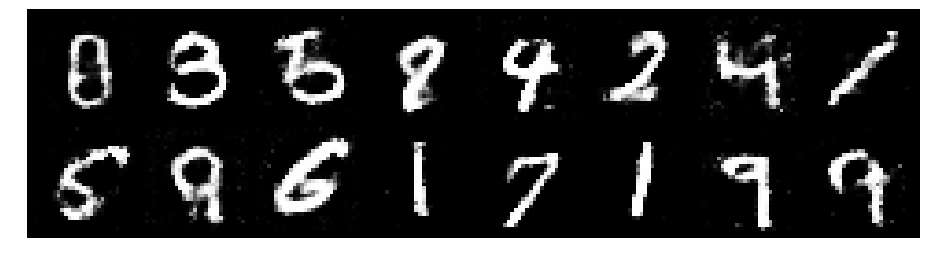

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.2299, Generator Loss: 1.0167
D(x): 0.5852, D(G(z)): 0.4163


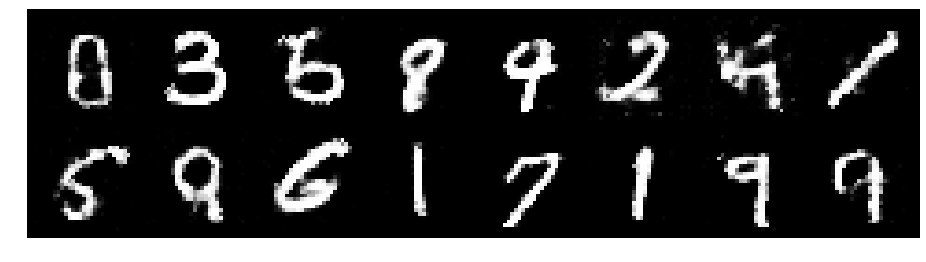

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.1831, Generator Loss: 0.9875
D(x): 0.5779, D(G(z)): 0.4228


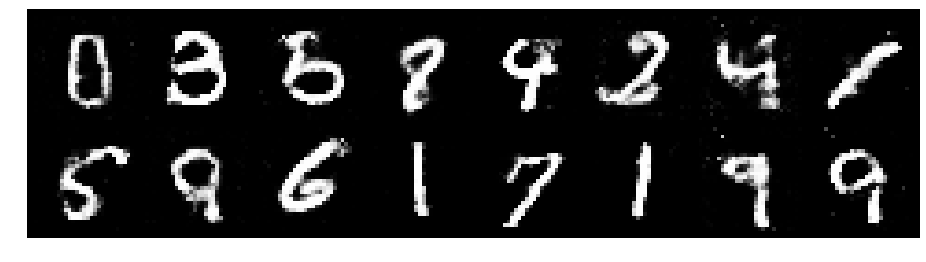

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2207, Generator Loss: 0.9837
D(x): 0.5661, D(G(z)): 0.4382


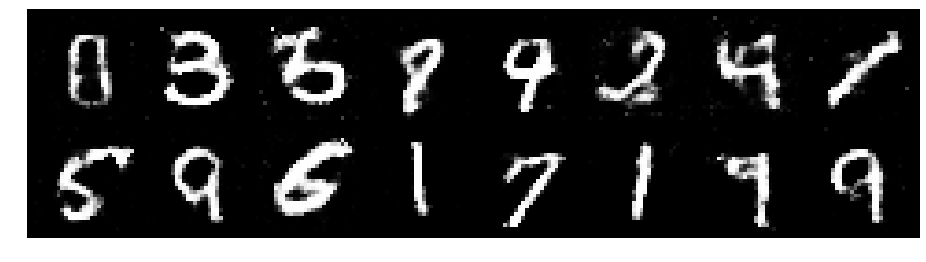

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2717, Generator Loss: 0.8426
D(x): 0.5443, D(G(z)): 0.4509


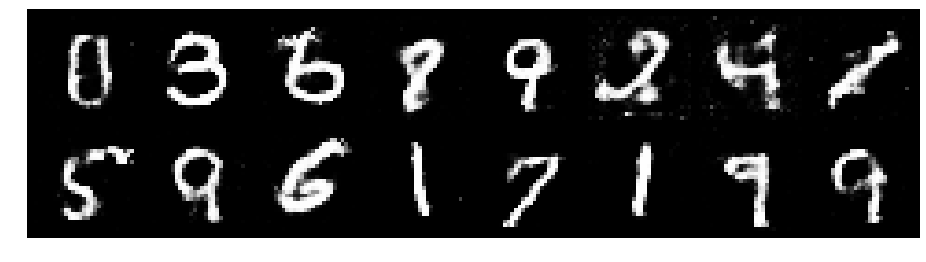

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.3036, Generator Loss: 0.9934
D(x): 0.5466, D(G(z)): 0.4195


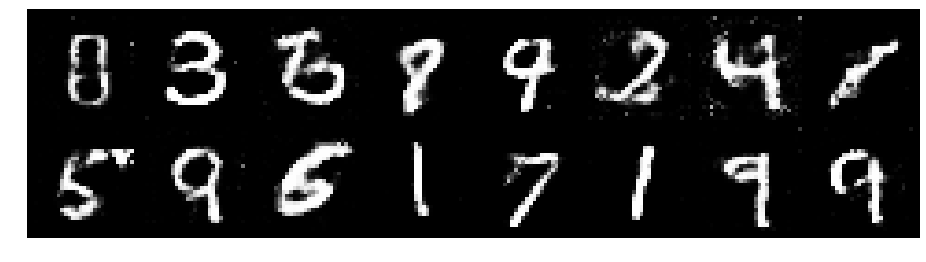

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.2622, Generator Loss: 0.8747
D(x): 0.5220, D(G(z)): 0.4155


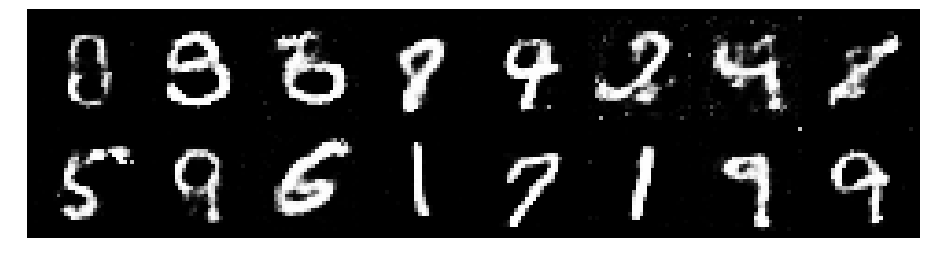

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.2145, Generator Loss: 0.9618
D(x): 0.5725, D(G(z)): 0.4184


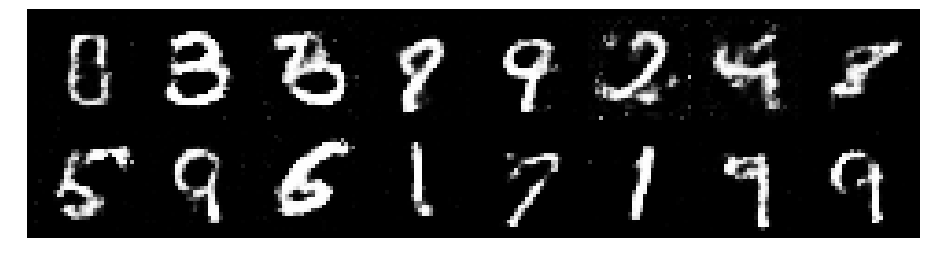

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.1299, Generator Loss: 1.1159
D(x): 0.5839, D(G(z)): 0.3776


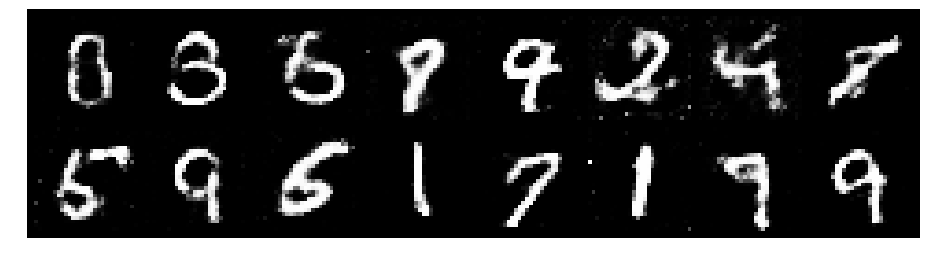

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2751, Generator Loss: 0.8173
D(x): 0.5445, D(G(z)): 0.4333


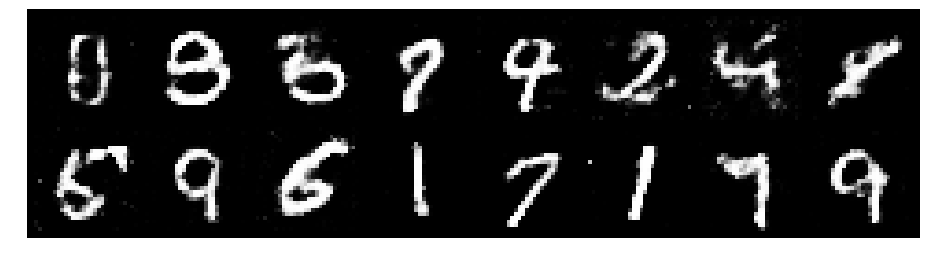

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.3093, Generator Loss: 1.0001
D(x): 0.5512, D(G(z)): 0.4564


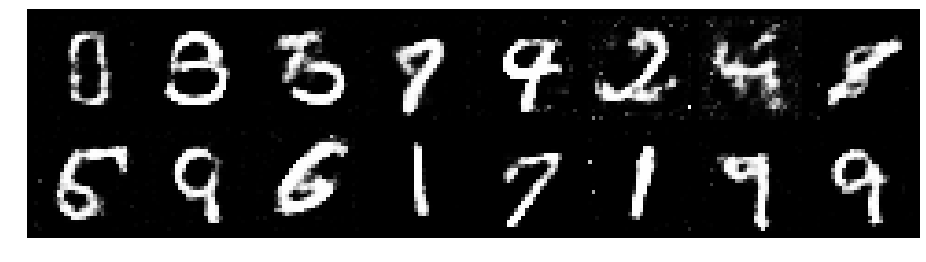

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.3906, Generator Loss: 0.8783
D(x): 0.5296, D(G(z)): 0.4623


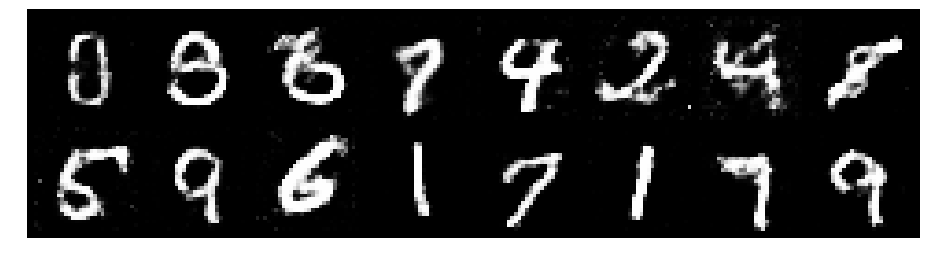

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.3979, Generator Loss: 0.7678
D(x): 0.5415, D(G(z)): 0.4665


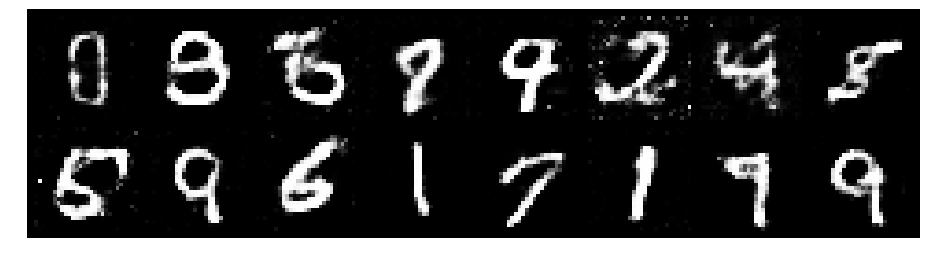

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.2960, Generator Loss: 0.8863
D(x): 0.5545, D(G(z)): 0.4440


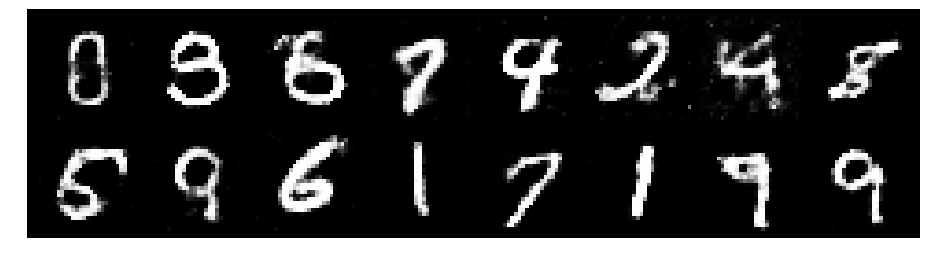

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.3204, Generator Loss: 0.8790
D(x): 0.5453, D(G(z)): 0.4528


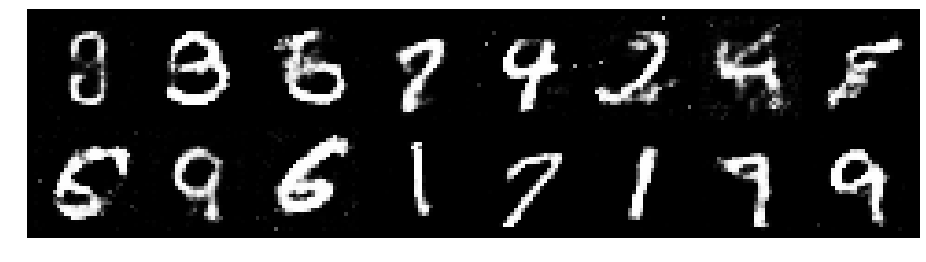

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2634, Generator Loss: 1.0607
D(x): 0.5370, D(G(z)): 0.4146


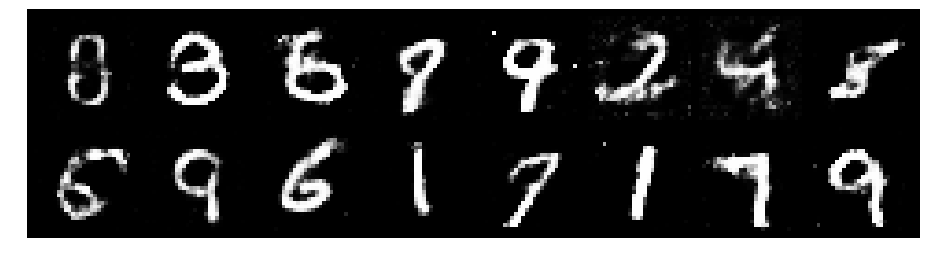

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2287, Generator Loss: 1.0176
D(x): 0.5773, D(G(z)): 0.4177


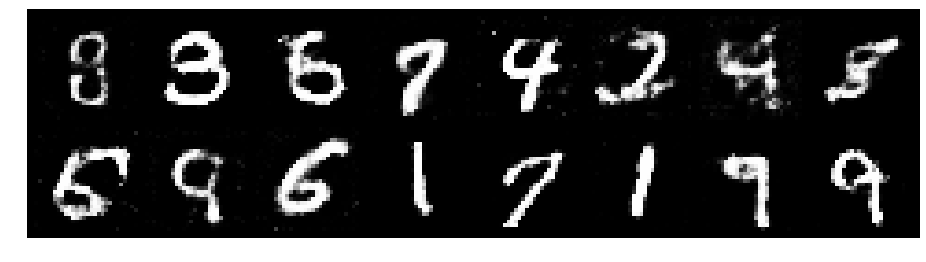

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.1699, Generator Loss: 0.9442
D(x): 0.5585, D(G(z)): 0.3915


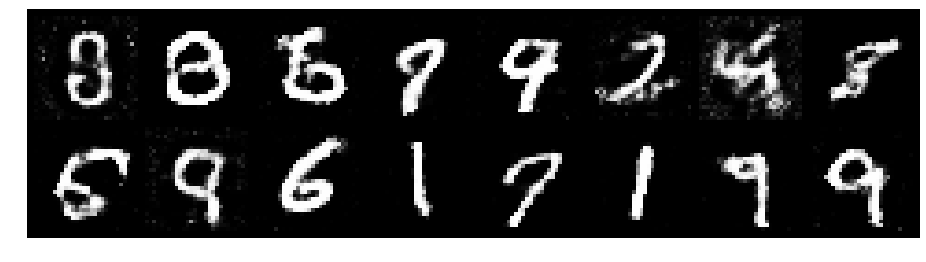

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.3039, Generator Loss: 0.8662
D(x): 0.5276, D(G(z)): 0.4436


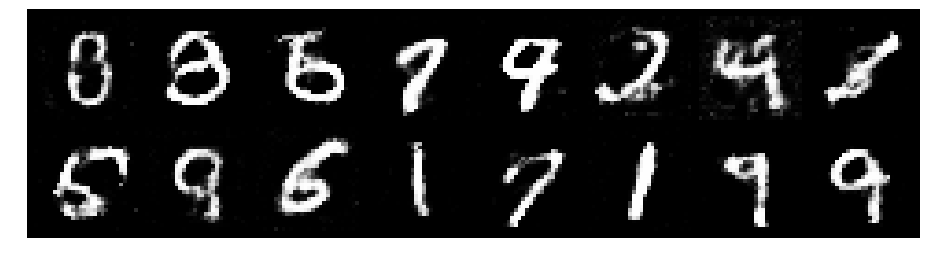

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.2384, Generator Loss: 0.9193
D(x): 0.5715, D(G(z)): 0.4402


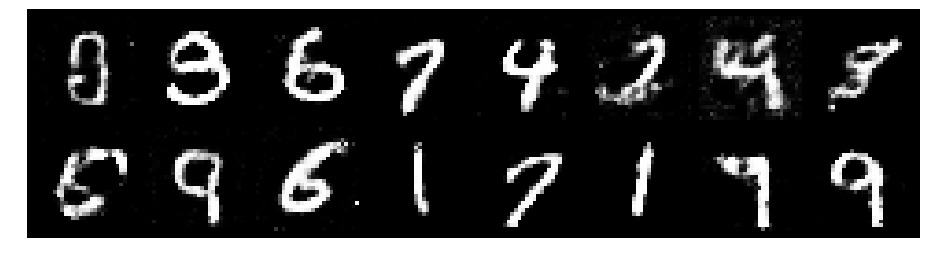

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.3033, Generator Loss: 1.0242
D(x): 0.5540, D(G(z)): 0.4462


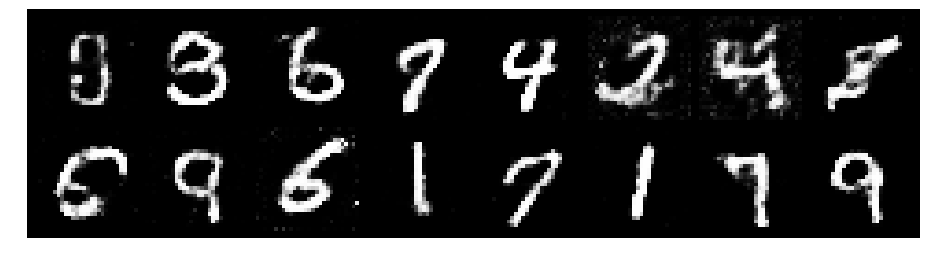

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.2500, Generator Loss: 0.9720
D(x): 0.5444, D(G(z)): 0.4300


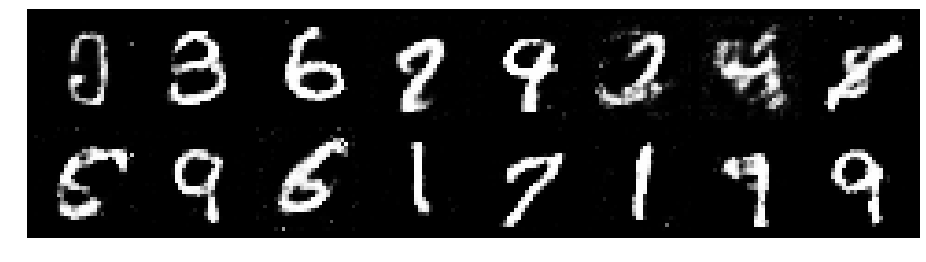

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.2819, Generator Loss: 0.9948
D(x): 0.5217, D(G(z)): 0.4232


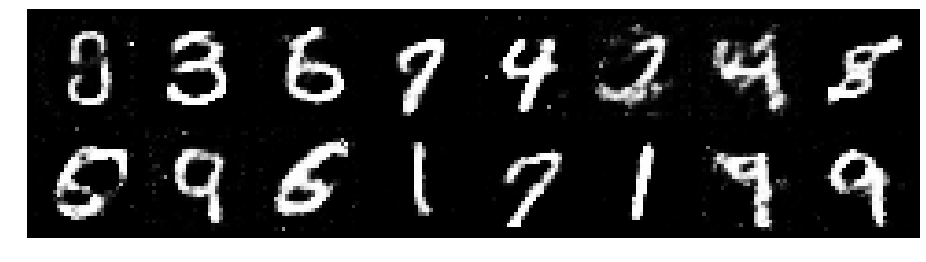

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.2591, Generator Loss: 0.8326
D(x): 0.5356, D(G(z)): 0.4276


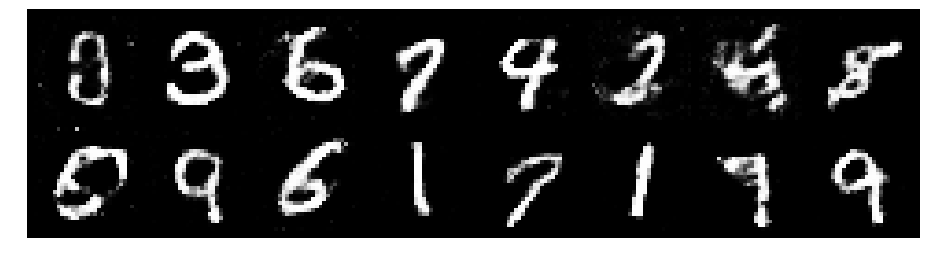

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.2604, Generator Loss: 0.7895
D(x): 0.5625, D(G(z)): 0.4731


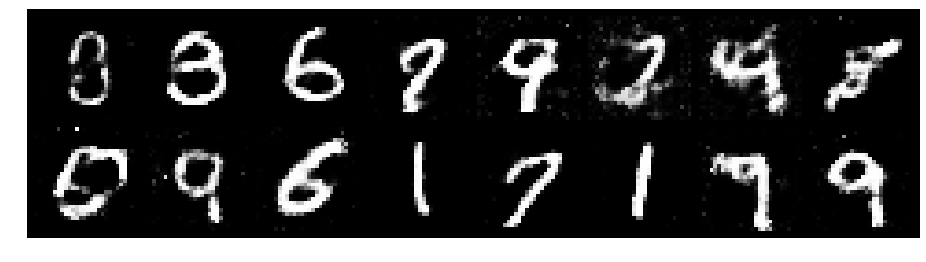

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2774, Generator Loss: 0.8521
D(x): 0.5443, D(G(z)): 0.4462


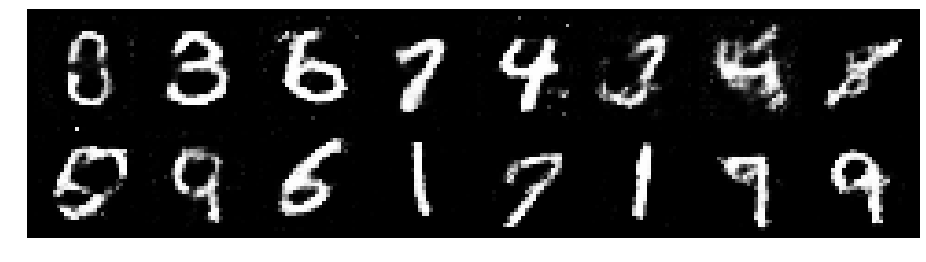

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8842
D(x): 0.5312, D(G(z)): 0.4459


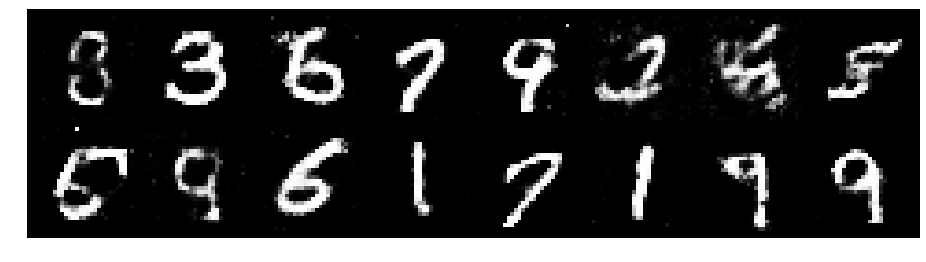

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2000, Generator Loss: 0.9077
D(x): 0.5801, D(G(z)): 0.4318


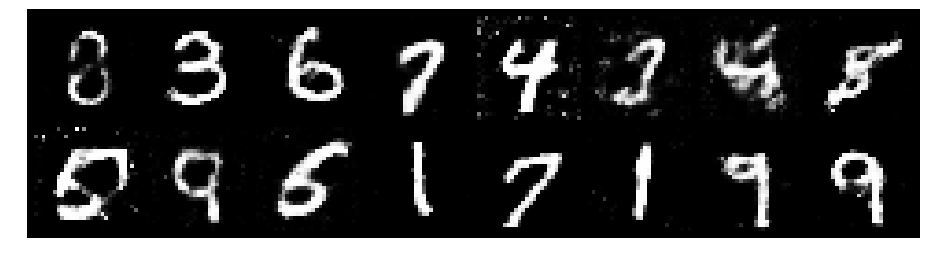

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.2235, Generator Loss: 0.8365
D(x): 0.5324, D(G(z)): 0.4189


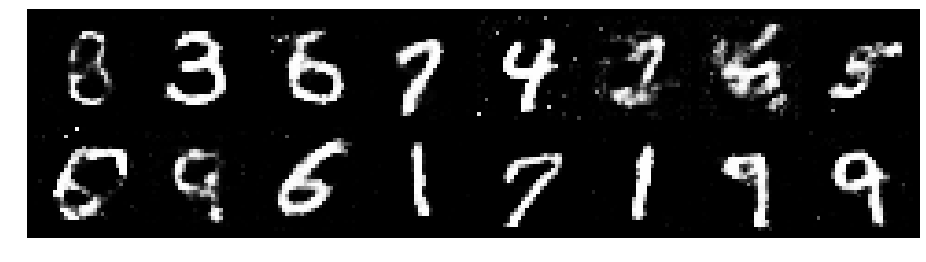

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.1986, Generator Loss: 0.9688
D(x): 0.5361, D(G(z)): 0.3781


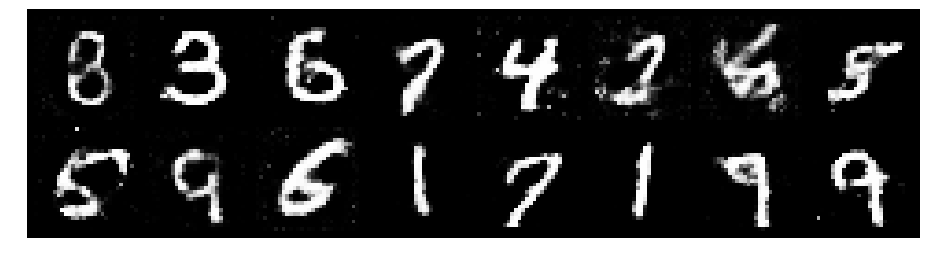

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.3272, Generator Loss: 0.9432
D(x): 0.5258, D(G(z)): 0.4370


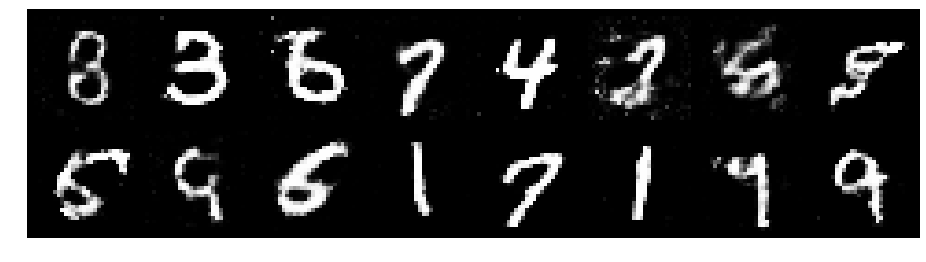

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.3710, Generator Loss: 0.8202
D(x): 0.5264, D(G(z)): 0.4540


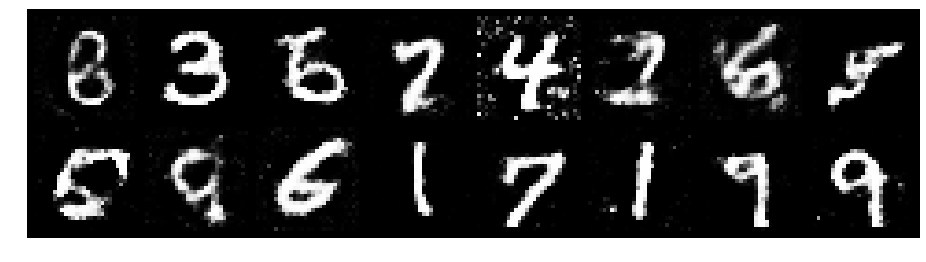

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.3042, Generator Loss: 0.8097
D(x): 0.5848, D(G(z)): 0.4890


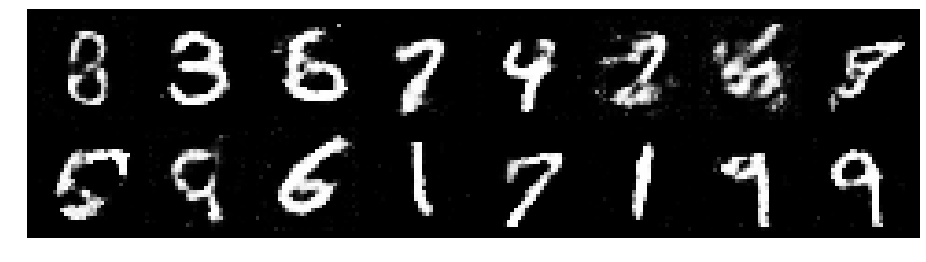

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.3375, Generator Loss: 0.8674
D(x): 0.5436, D(G(z)): 0.4785


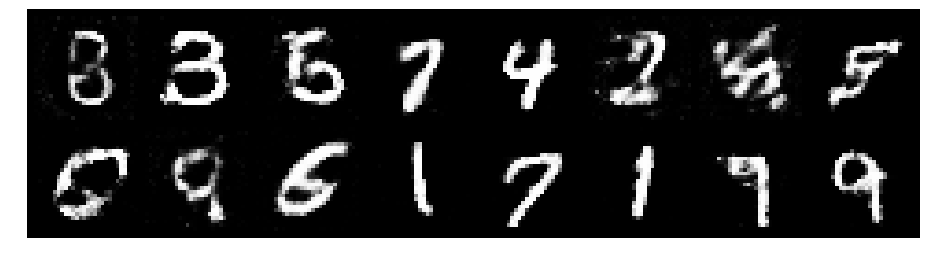

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.3799, Generator Loss: 0.8716
D(x): 0.5460, D(G(z)): 0.4955


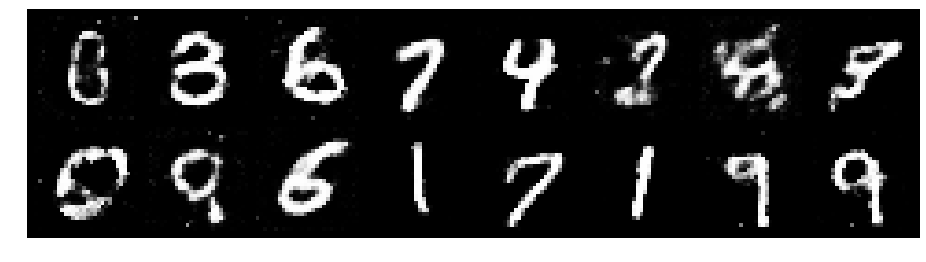

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2294, Generator Loss: 0.9683
D(x): 0.6044, D(G(z)): 0.4606


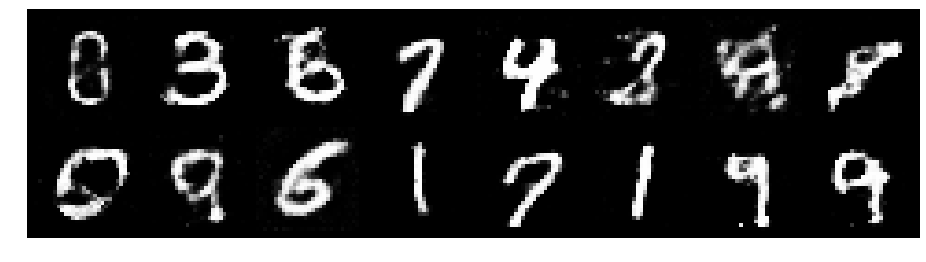

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.3360, Generator Loss: 0.8741
D(x): 0.5749, D(G(z)): 0.4856


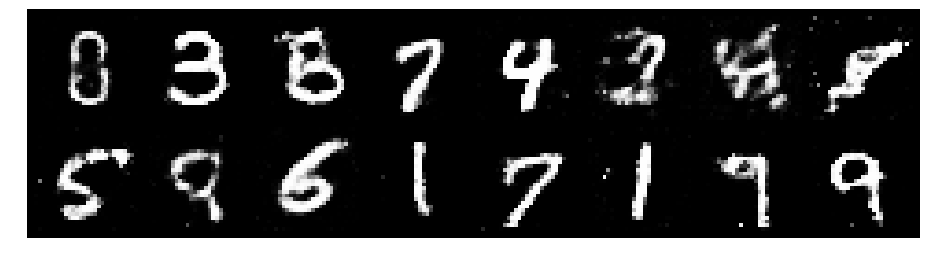

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.2453, Generator Loss: 0.8328
D(x): 0.5538, D(G(z)): 0.4374


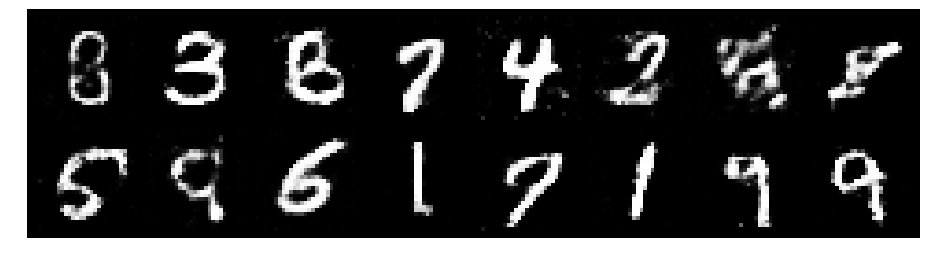

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2162, Generator Loss: 1.0042
D(x): 0.5372, D(G(z)): 0.4018


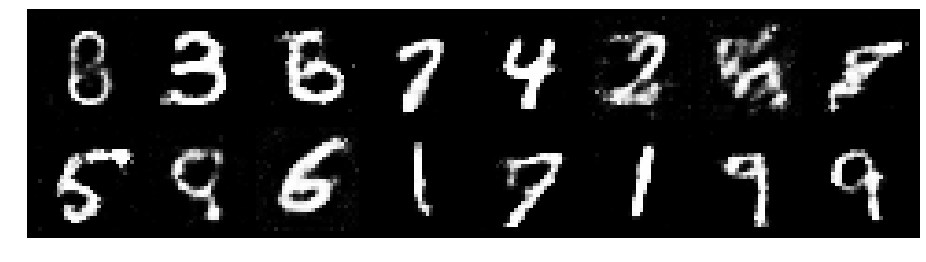

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.3687, Generator Loss: 0.8698
D(x): 0.5346, D(G(z)): 0.4606


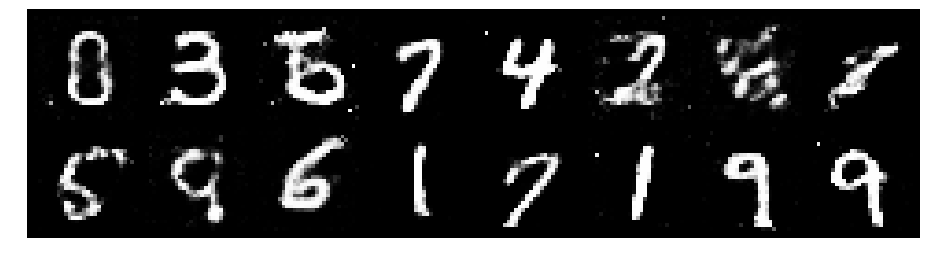

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.3175, Generator Loss: 0.8470
D(x): 0.5355, D(G(z)): 0.4535


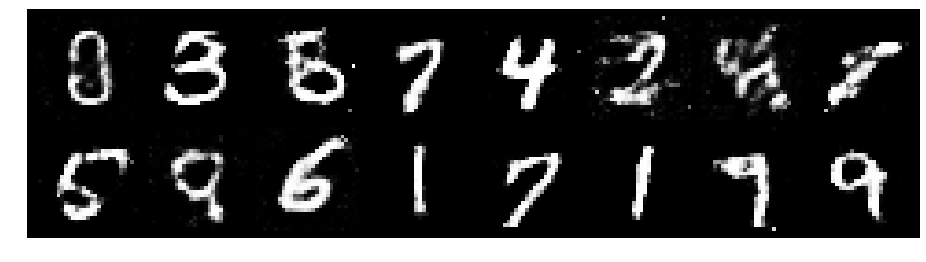

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.3863, Generator Loss: 0.8569
D(x): 0.5311, D(G(z)): 0.4791


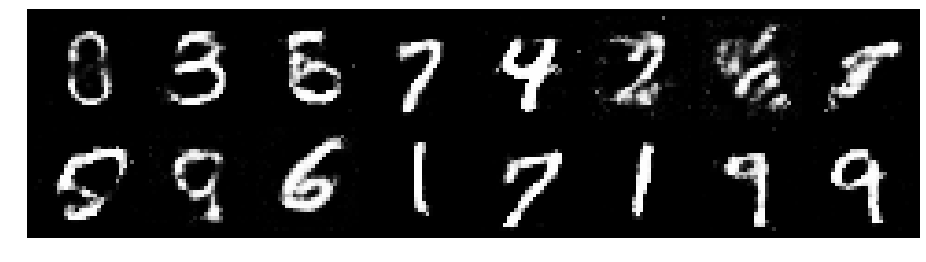

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.3691, Generator Loss: 0.8082
D(x): 0.5133, D(G(z)): 0.4703


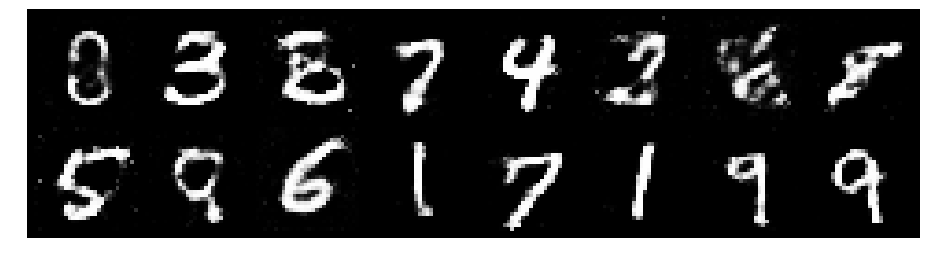

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.4469, Generator Loss: 0.8055
D(x): 0.5097, D(G(z)): 0.4857


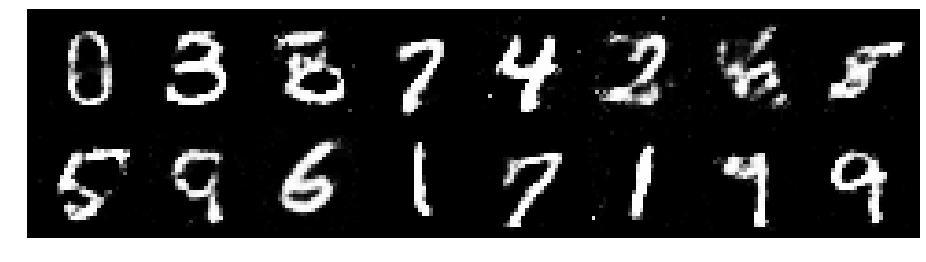

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.3234, Generator Loss: 0.8957
D(x): 0.5948, D(G(z)): 0.4819


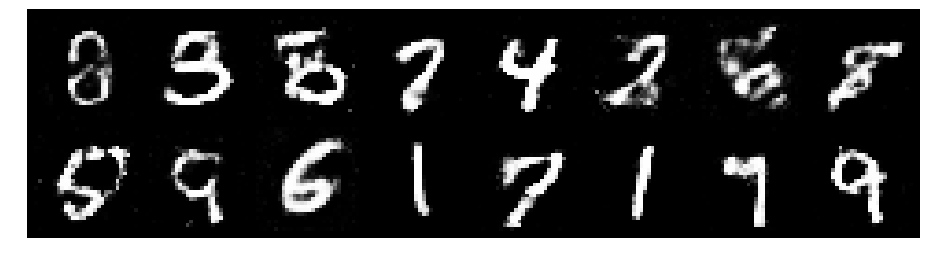

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.2441, Generator Loss: 0.9355
D(x): 0.5588, D(G(z)): 0.4297


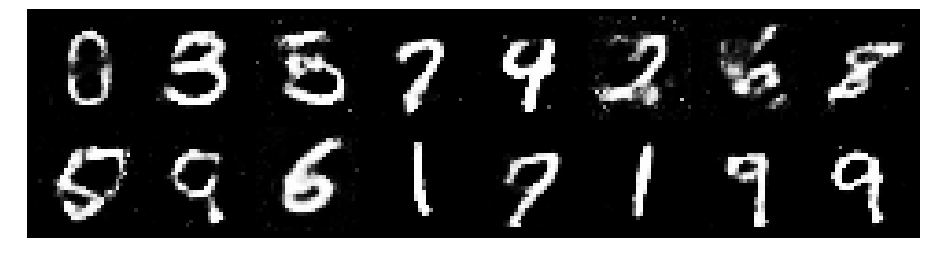

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.2625, Generator Loss: 0.8077
D(x): 0.5766, D(G(z)): 0.4665


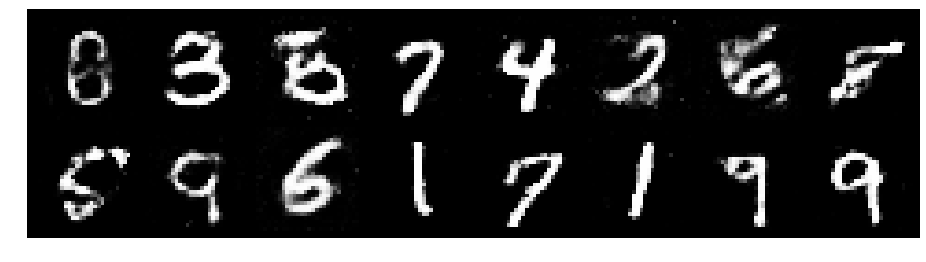

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.3351, Generator Loss: 0.8357
D(x): 0.5176, D(G(z)): 0.4610


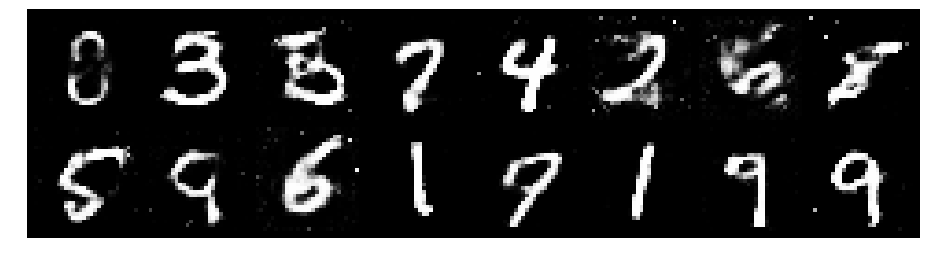

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.2106, Generator Loss: 0.8573
D(x): 0.5959, D(G(z)): 0.4488


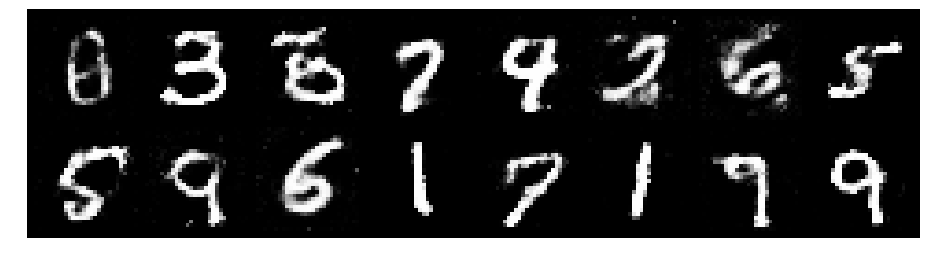

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.2766, Generator Loss: 0.8578
D(x): 0.5319, D(G(z)): 0.4381


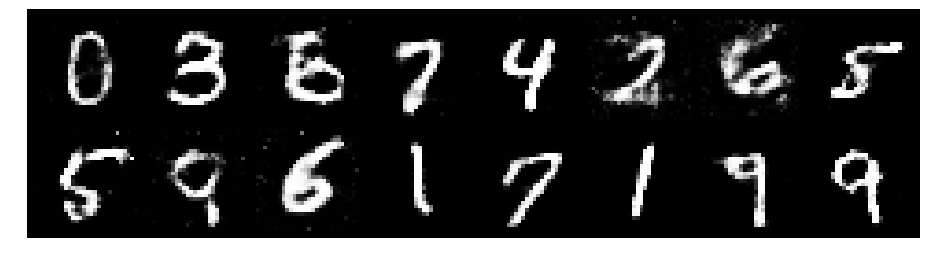

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.3134, Generator Loss: 0.8872
D(x): 0.5183, D(G(z)): 0.4366


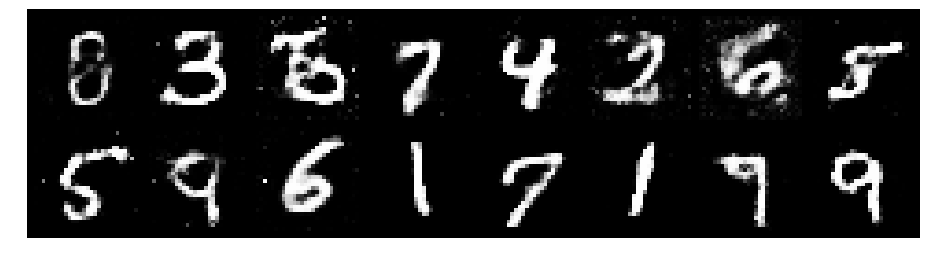

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2856, Generator Loss: 0.7657
D(x): 0.5430, D(G(z)): 0.4537


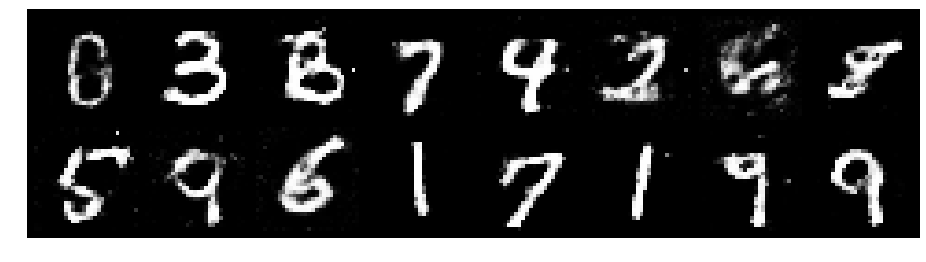

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.3121, Generator Loss: 0.8035
D(x): 0.5428, D(G(z)): 0.4667


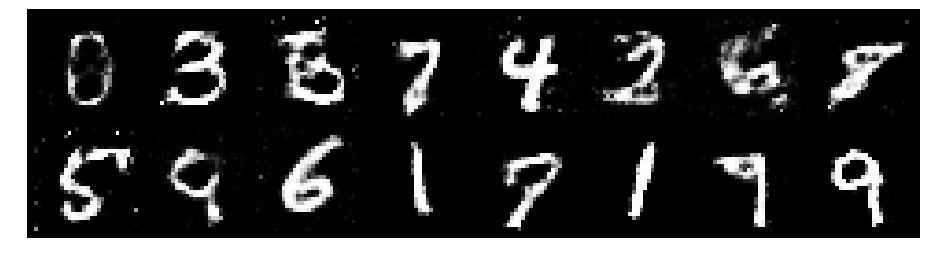

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.3376, Generator Loss: 0.9427
D(x): 0.5514, D(G(z)): 0.4747


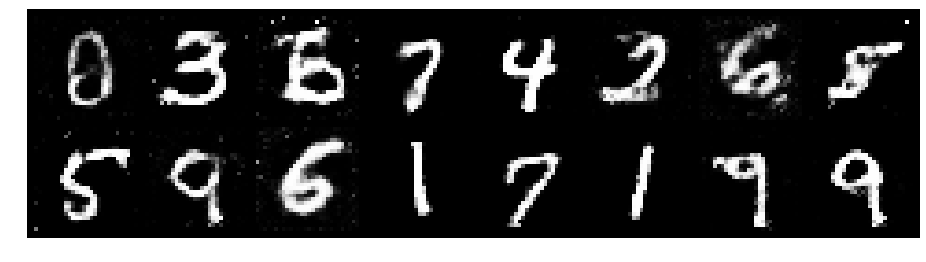

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2435, Generator Loss: 0.8695
D(x): 0.5317, D(G(z)): 0.4208


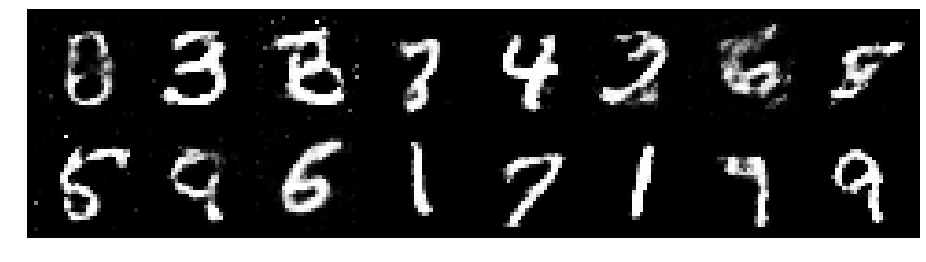

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.2304, Generator Loss: 0.9406
D(x): 0.5800, D(G(z)): 0.4313


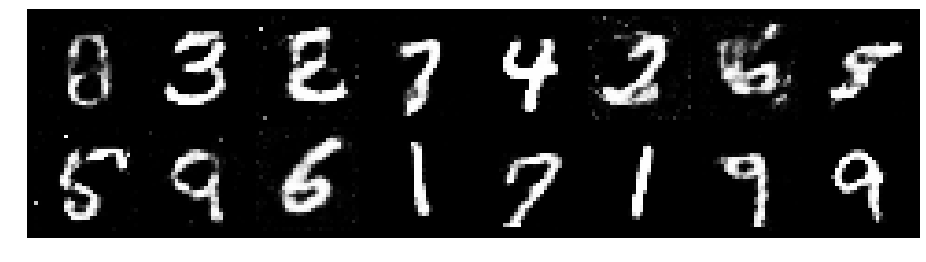

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.2800, Generator Loss: 0.8987
D(x): 0.5575, D(G(z)): 0.4345


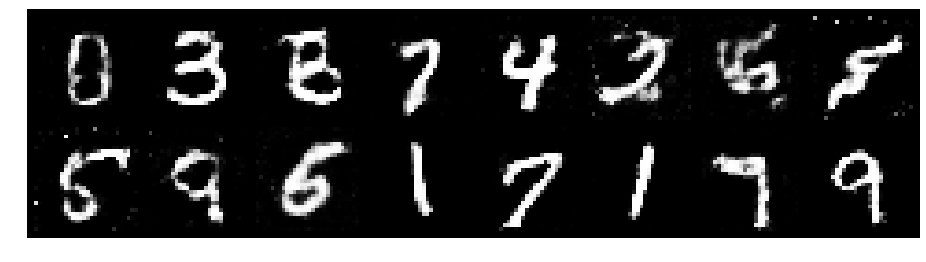

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.1230, Generator Loss: 1.0575
D(x): 0.5681, D(G(z)): 0.3720


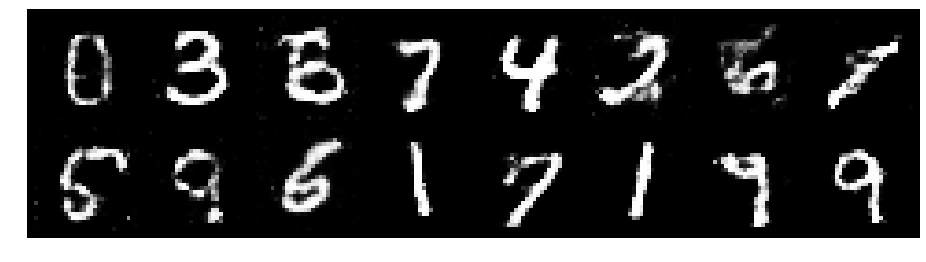

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.2963, Generator Loss: 0.9555
D(x): 0.5704, D(G(z)): 0.4503


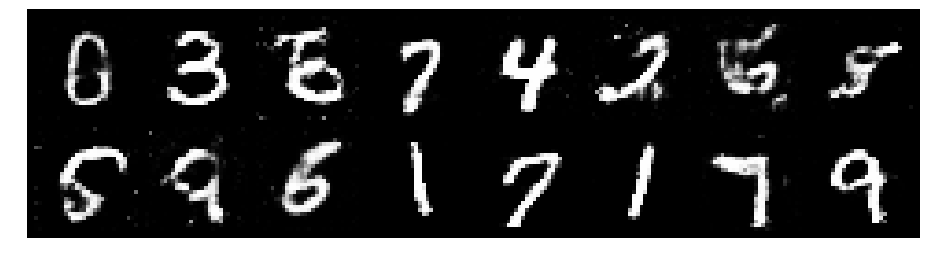

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2109, Generator Loss: 1.1143
D(x): 0.5633, D(G(z)): 0.4137


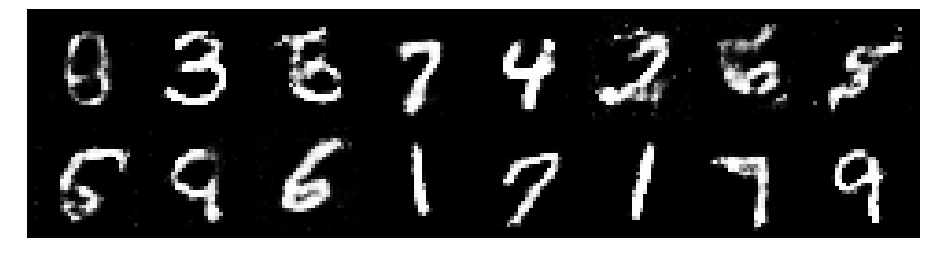

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.2907, Generator Loss: 0.7875
D(x): 0.5359, D(G(z)): 0.4344


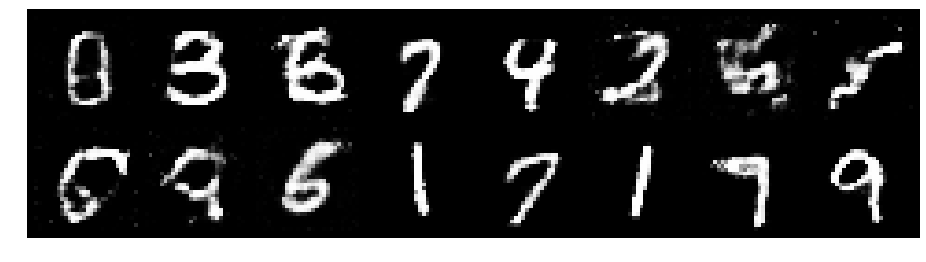

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.2950, Generator Loss: 0.8075
D(x): 0.5985, D(G(z)): 0.4871


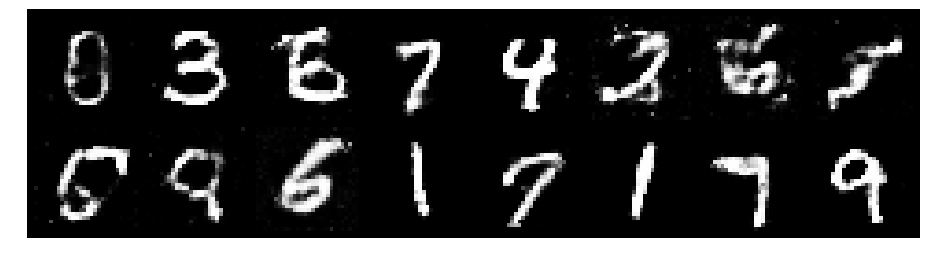

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.3065, Generator Loss: 0.8334
D(x): 0.5701, D(G(z)): 0.4519


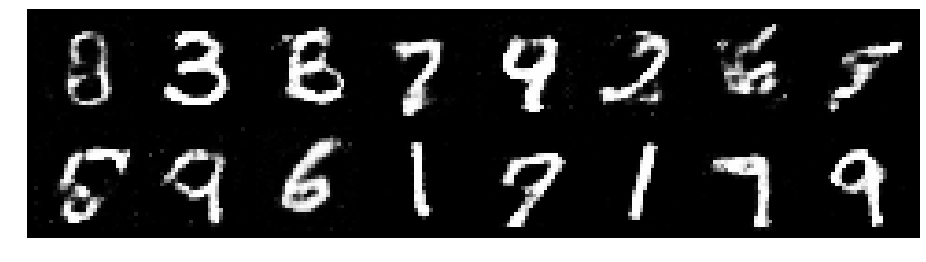

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.4151, Generator Loss: 0.8716
D(x): 0.5174, D(G(z)): 0.4474


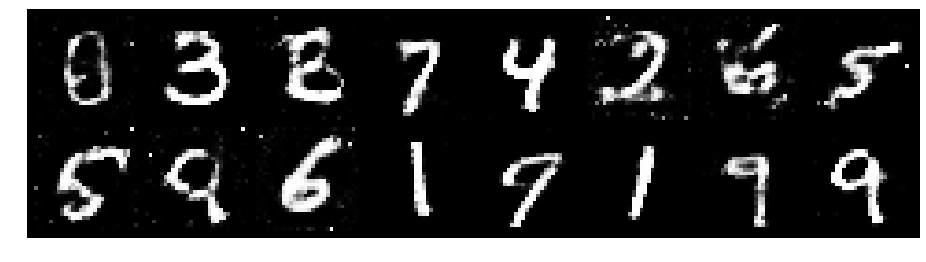

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2537, Generator Loss: 0.8103
D(x): 0.5972, D(G(z)): 0.4651


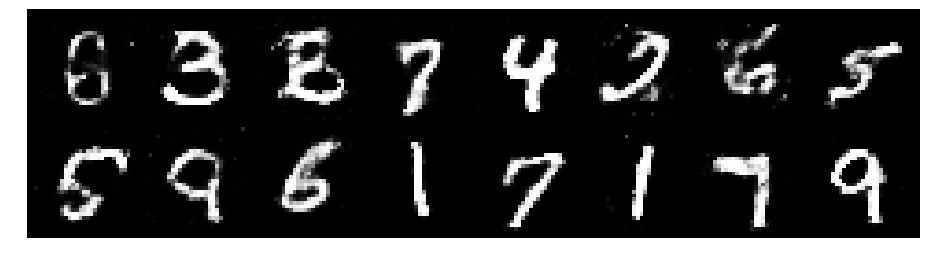

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.2173, Generator Loss: 0.9618
D(x): 0.5712, D(G(z)): 0.4174


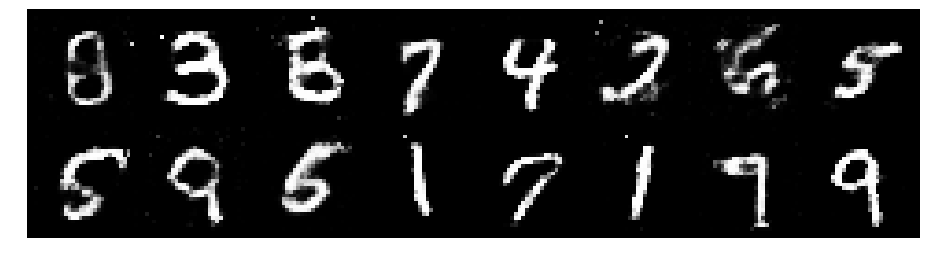

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.2079, Generator Loss: 0.9714
D(x): 0.5616, D(G(z)): 0.4179


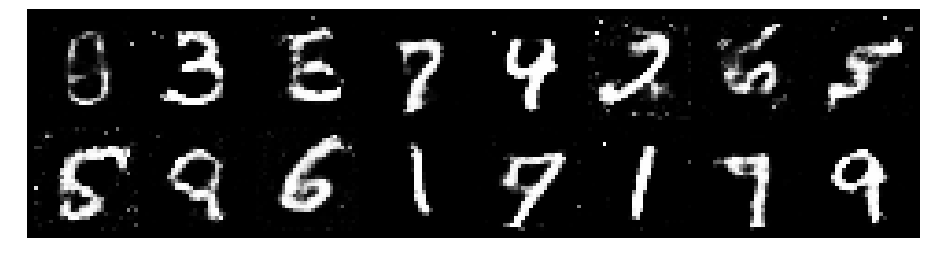

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.1995, Generator Loss: 0.9086
D(x): 0.5726, D(G(z)): 0.4268


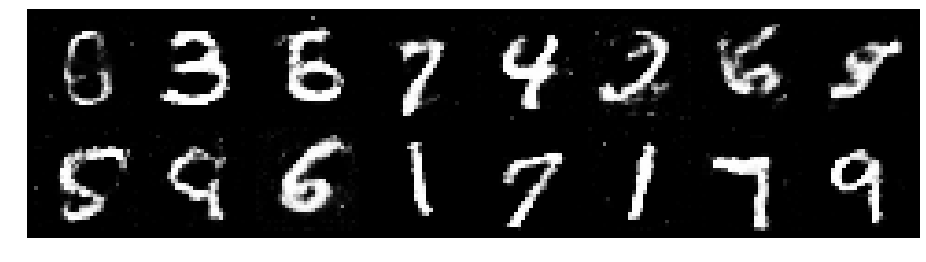

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.1937, Generator Loss: 0.9228
D(x): 0.5760, D(G(z)): 0.4132


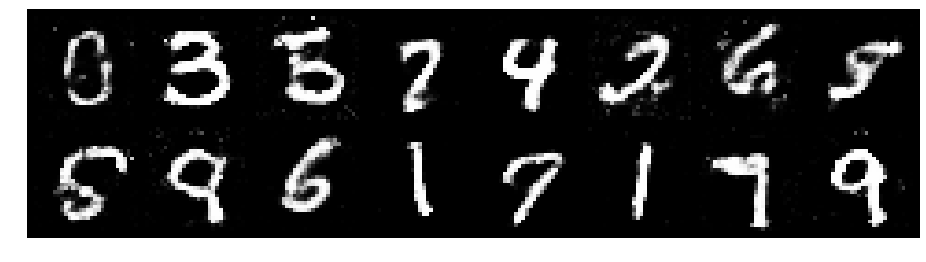

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.3318, Generator Loss: 0.7524
D(x): 0.5667, D(G(z)): 0.4926


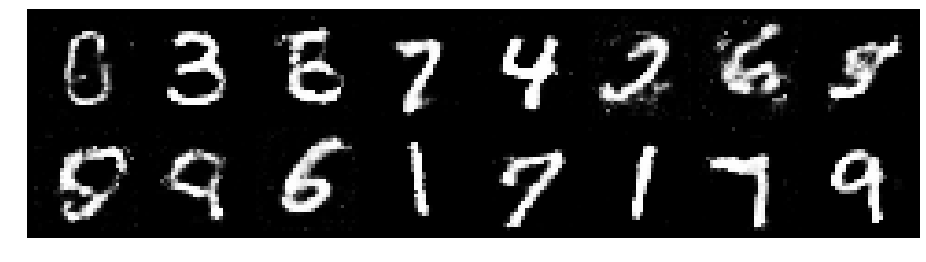

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.2711, Generator Loss: 0.9043
D(x): 0.5346, D(G(z)): 0.4240


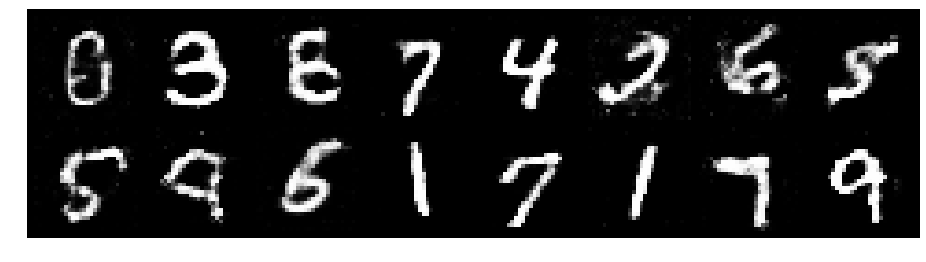

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.1548, Generator Loss: 0.9976
D(x): 0.5769, D(G(z)): 0.4040


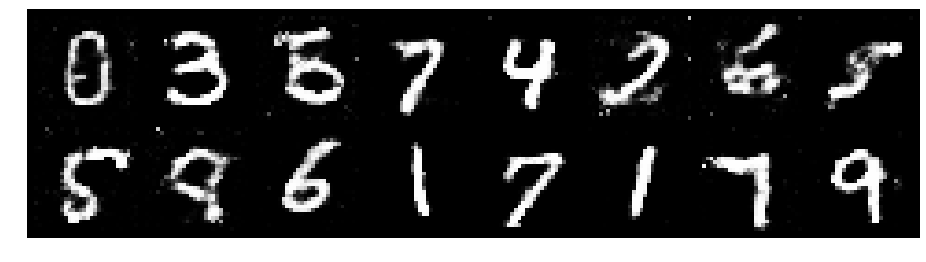

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.2530, Generator Loss: 0.9297
D(x): 0.5600, D(G(z)): 0.4103


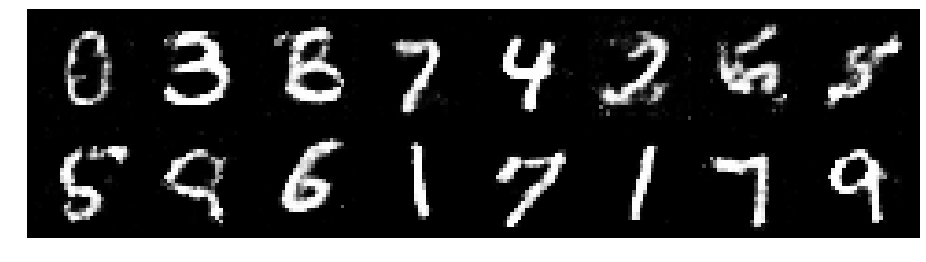

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.2849, Generator Loss: 0.9565
D(x): 0.5724, D(G(z)): 0.4364


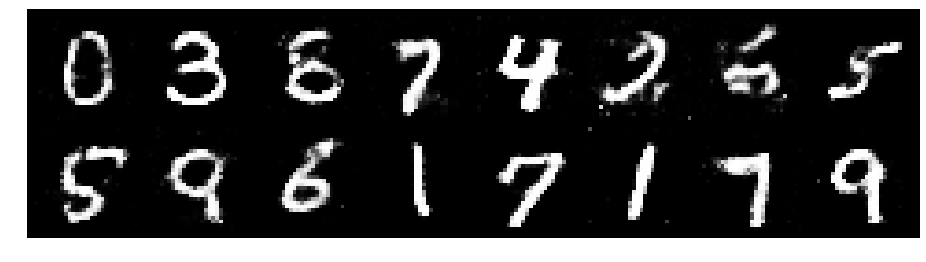

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.2416, Generator Loss: 1.1365
D(x): 0.5685, D(G(z)): 0.4046


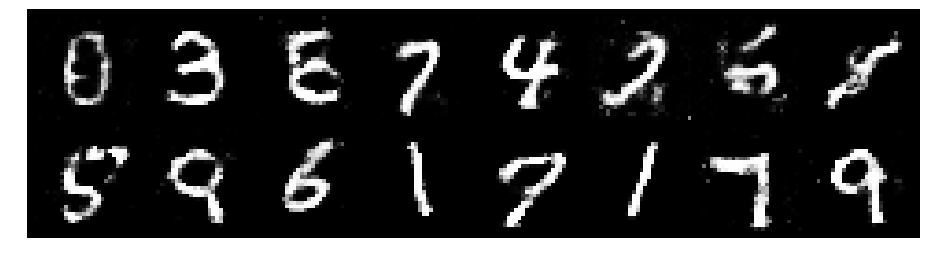

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2025, Generator Loss: 0.9106
D(x): 0.5801, D(G(z)): 0.4280


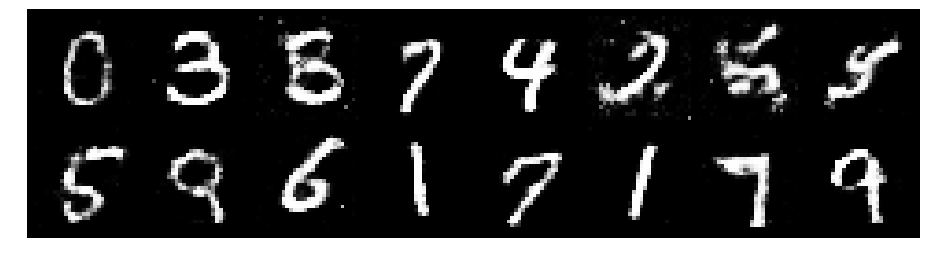

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.2810, Generator Loss: 0.9167
D(x): 0.5597, D(G(z)): 0.4454


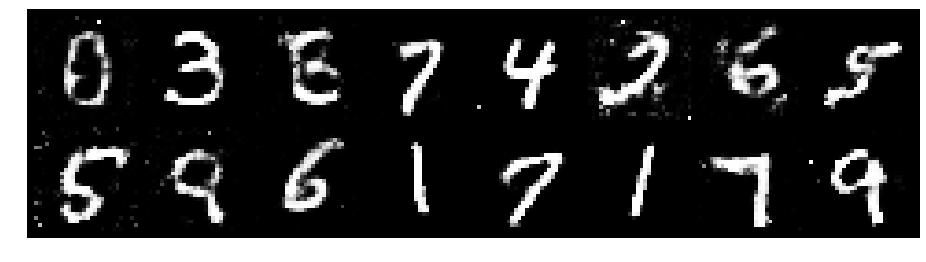

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.3921, Generator Loss: 0.8934
D(x): 0.5218, D(G(z)): 0.4779


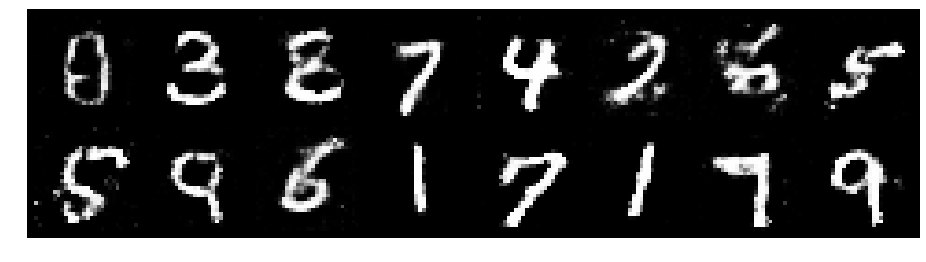

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.3014, Generator Loss: 0.8019
D(x): 0.5509, D(G(z)): 0.4617


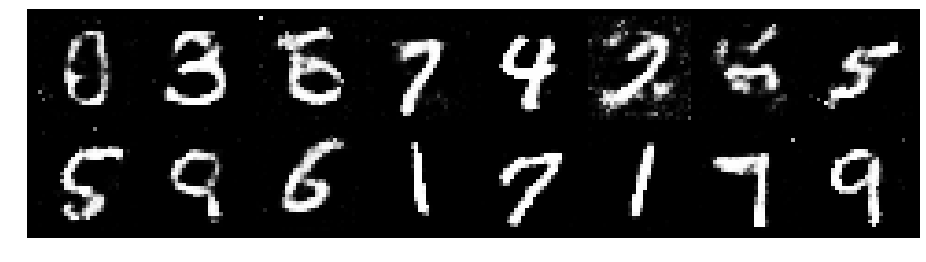

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2782, Generator Loss: 0.8642
D(x): 0.5884, D(G(z)): 0.4697


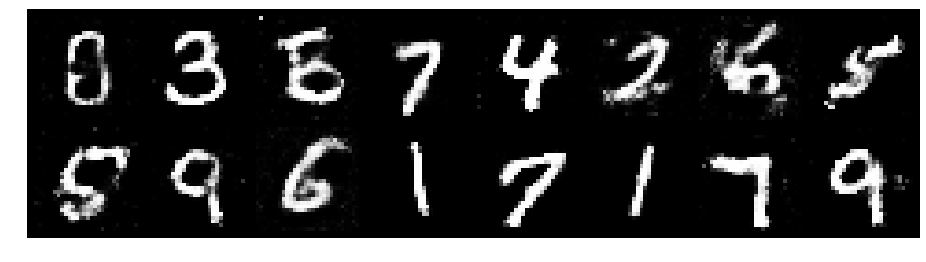

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.2218, Generator Loss: 0.9242
D(x): 0.6107, D(G(z)): 0.4634


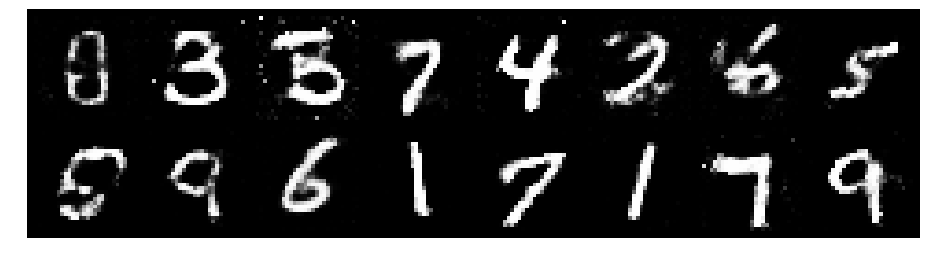

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.3552, Generator Loss: 0.8236
D(x): 0.5548, D(G(z)): 0.4761


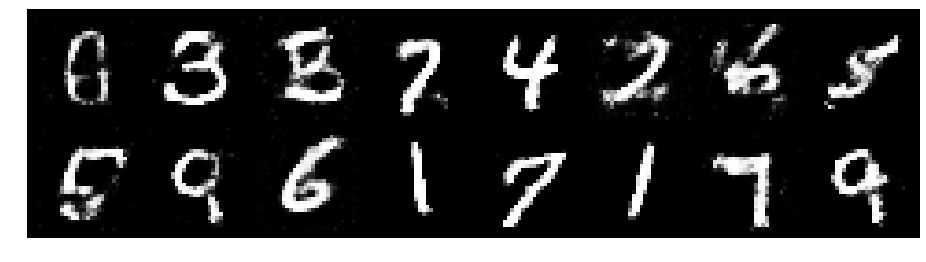

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.3598, Generator Loss: 1.0295
D(x): 0.5358, D(G(z)): 0.4272


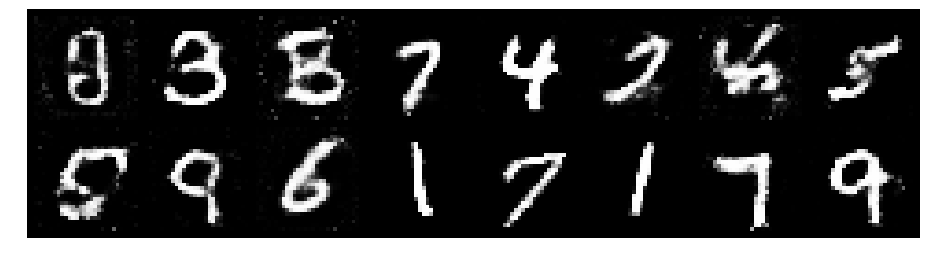

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.2756, Generator Loss: 0.8833
D(x): 0.5922, D(G(z)): 0.4593


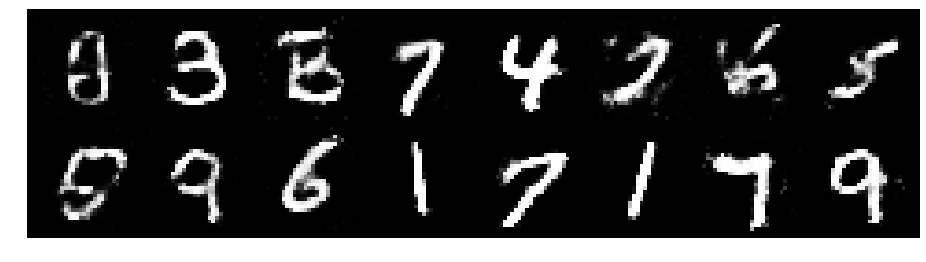

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.2854, Generator Loss: 0.7913
D(x): 0.6212, D(G(z)): 0.5020


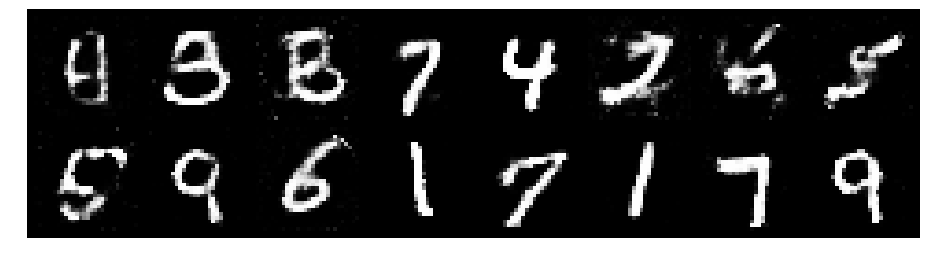

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.3501, Generator Loss: 0.7534
D(x): 0.5181, D(G(z)): 0.4476


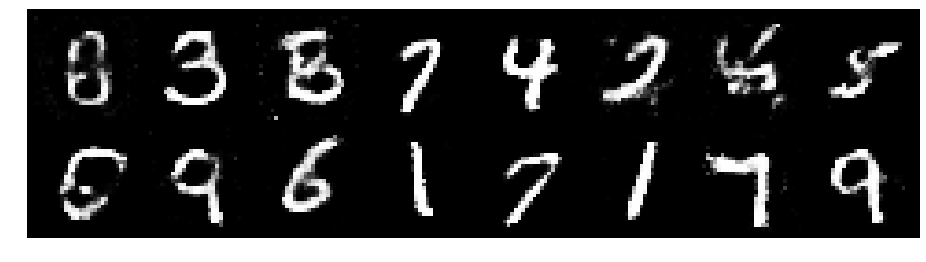

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.2548, Generator Loss: 0.7795
D(x): 0.5660, D(G(z)): 0.4669


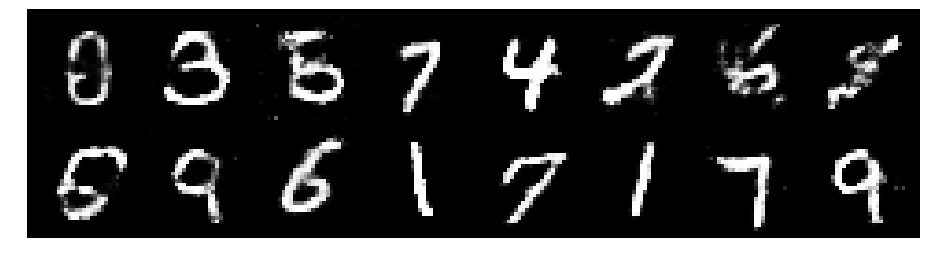

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.2252, Generator Loss: 0.8806
D(x): 0.5533, D(G(z)): 0.4447


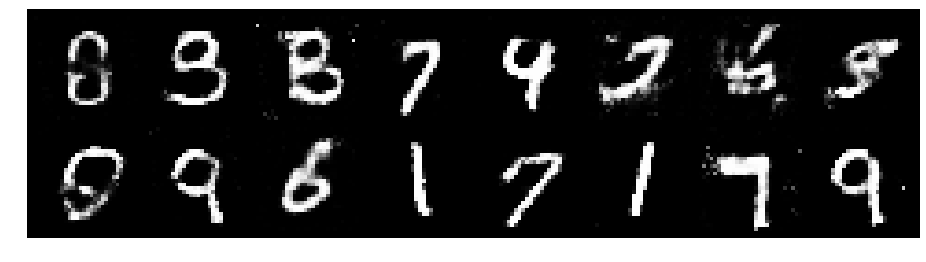

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.2520, Generator Loss: 0.9351
D(x): 0.5255, D(G(z)): 0.4147


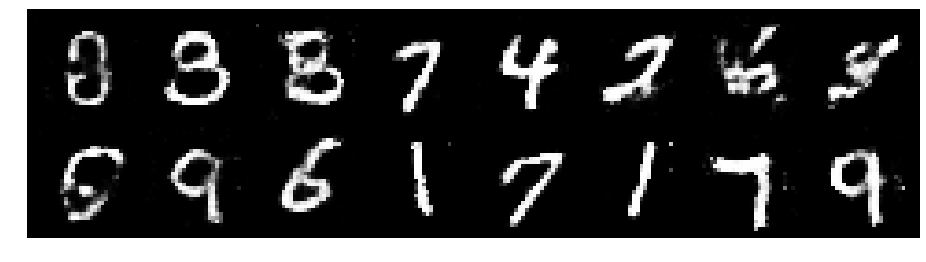

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2494, Generator Loss: 0.9213
D(x): 0.5326, D(G(z)): 0.4272


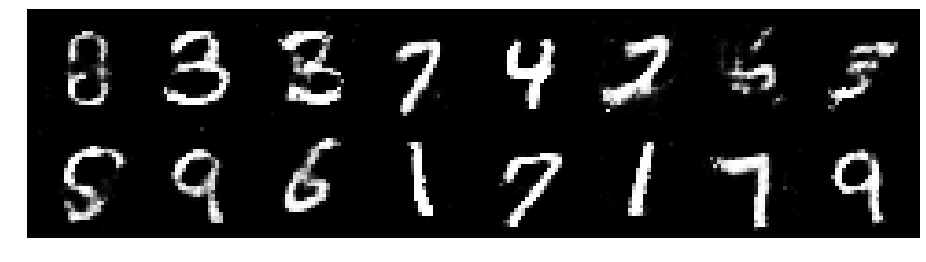

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.2460, Generator Loss: 0.8480
D(x): 0.5396, D(G(z)): 0.4325


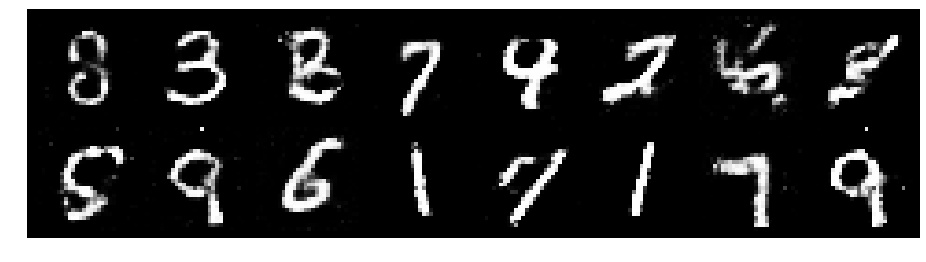

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.2746, Generator Loss: 0.8714
D(x): 0.5453, D(G(z)): 0.4372


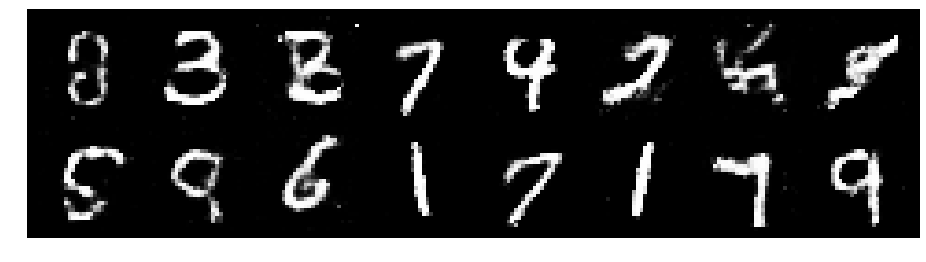

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2435, Generator Loss: 0.9934
D(x): 0.5448, D(G(z)): 0.4317


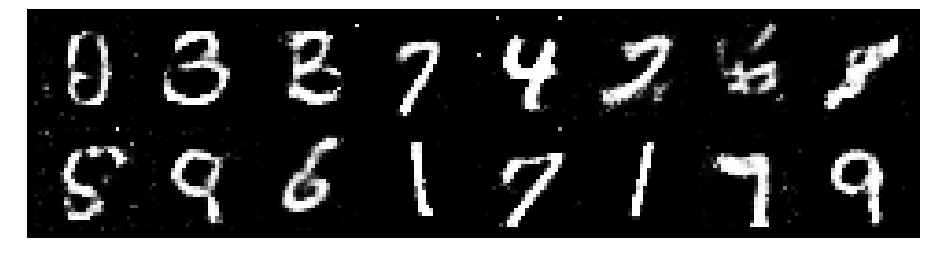

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.2190, Generator Loss: 0.9708
D(x): 0.5617, D(G(z)): 0.4205


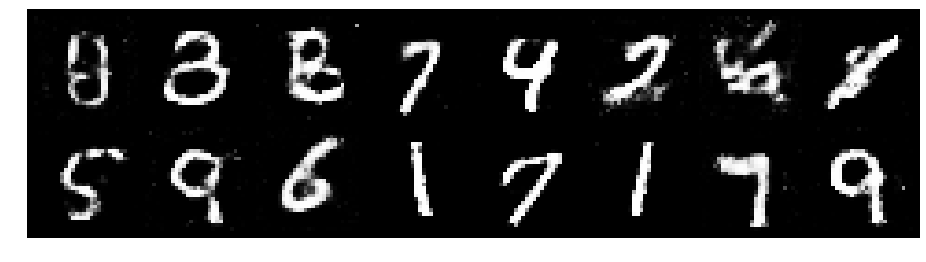

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.3152, Generator Loss: 0.9242
D(x): 0.5425, D(G(z)): 0.4327


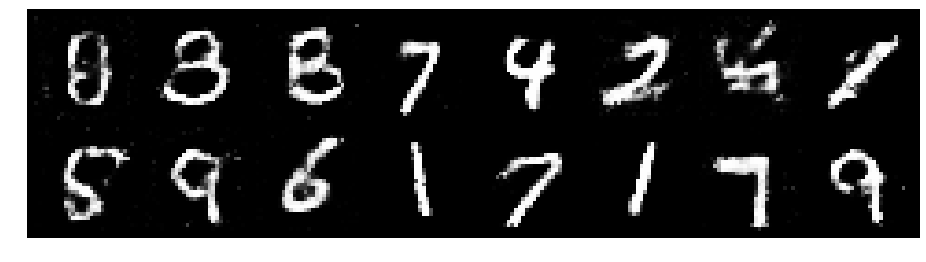

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.2444, Generator Loss: 1.0364
D(x): 0.5132, D(G(z)): 0.3940


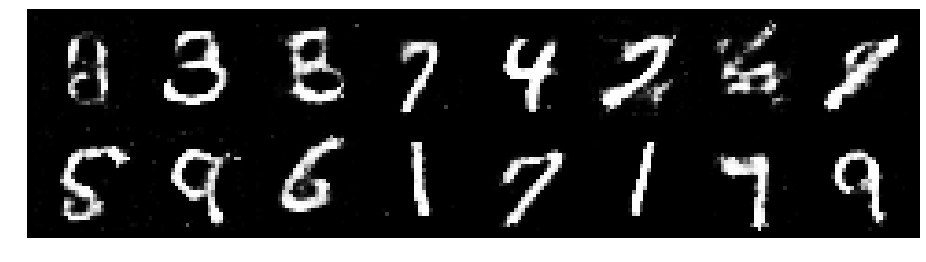

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.2319, Generator Loss: 1.1412
D(x): 0.5557, D(G(z)): 0.4324


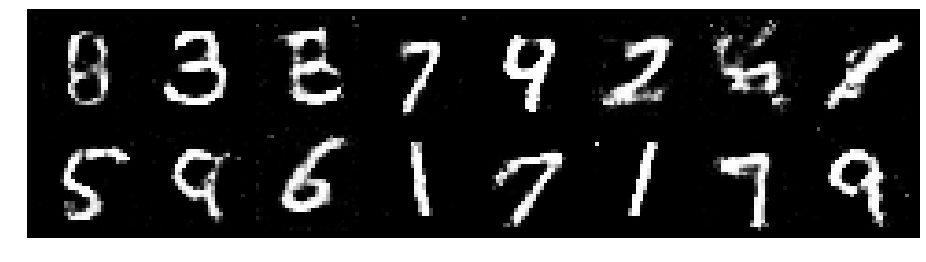

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.2036, Generator Loss: 0.9116
D(x): 0.5810, D(G(z)): 0.4388


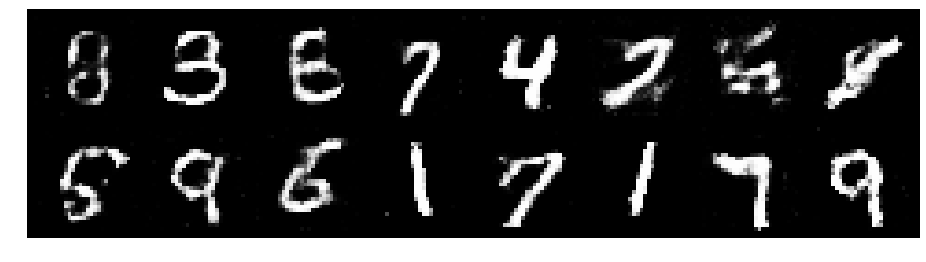

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.3474, Generator Loss: 0.8953
D(x): 0.5358, D(G(z)): 0.4573


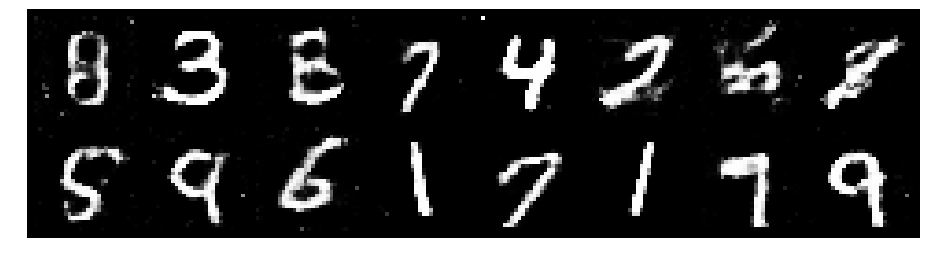

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.2899, Generator Loss: 0.7937
D(x): 0.5665, D(G(z)): 0.4561


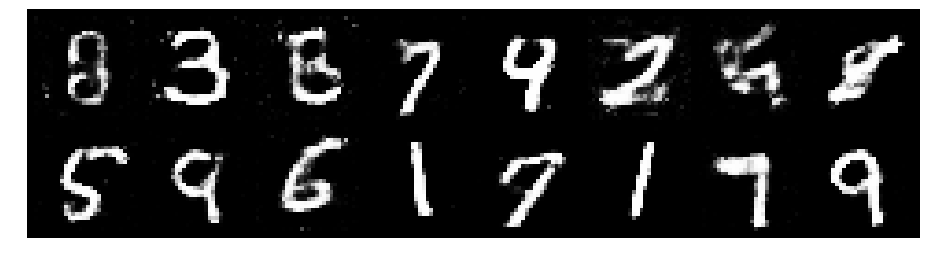

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2491, Generator Loss: 0.8044
D(x): 0.5795, D(G(z)): 0.4622


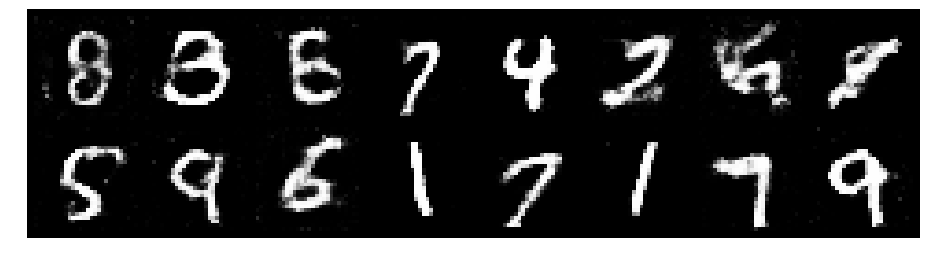

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.3059, Generator Loss: 0.8228
D(x): 0.5389, D(G(z)): 0.4724


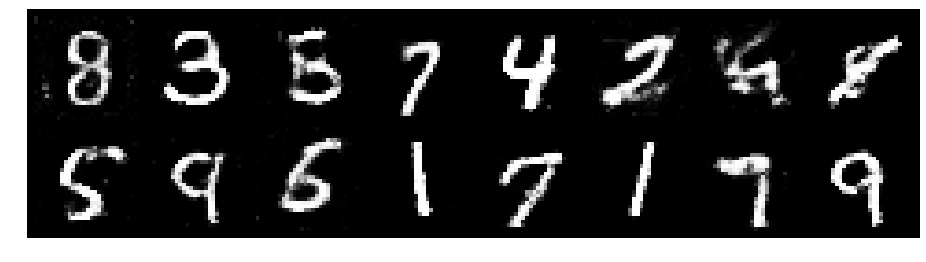

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.2839, Generator Loss: 0.8816
D(x): 0.5288, D(G(z)): 0.4406


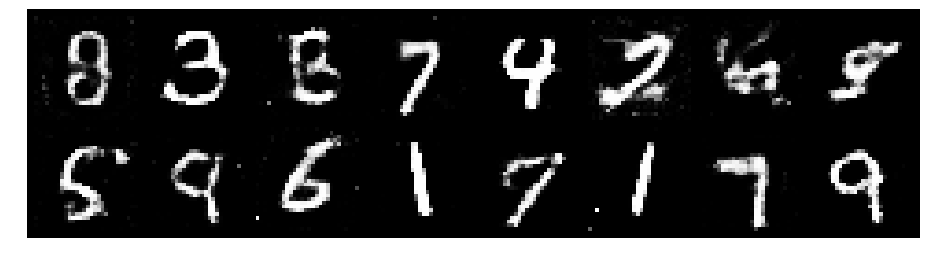

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.3939, Generator Loss: 0.7834
D(x): 0.5611, D(G(z)): 0.5152


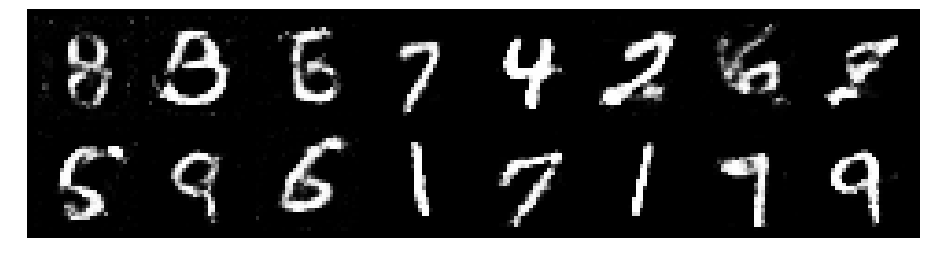

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2916, Generator Loss: 0.9346
D(x): 0.5419, D(G(z)): 0.4293


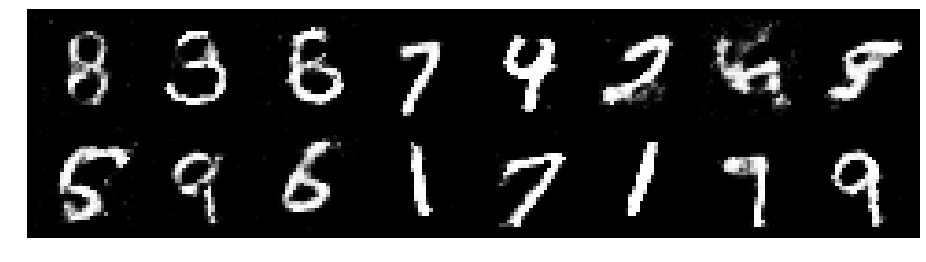

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.3501, Generator Loss: 0.8627
D(x): 0.5407, D(G(z)): 0.4594


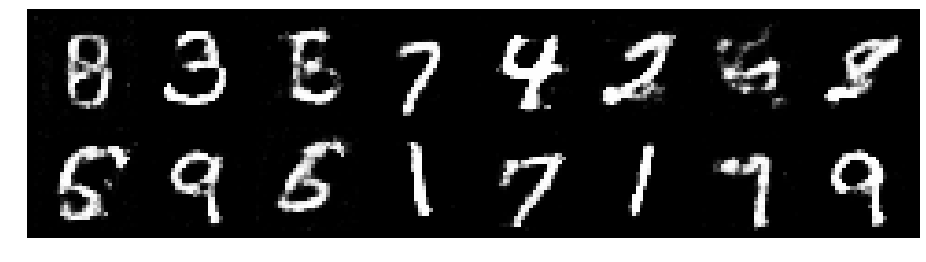

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.2094, Generator Loss: 0.8810
D(x): 0.5803, D(G(z)): 0.4352


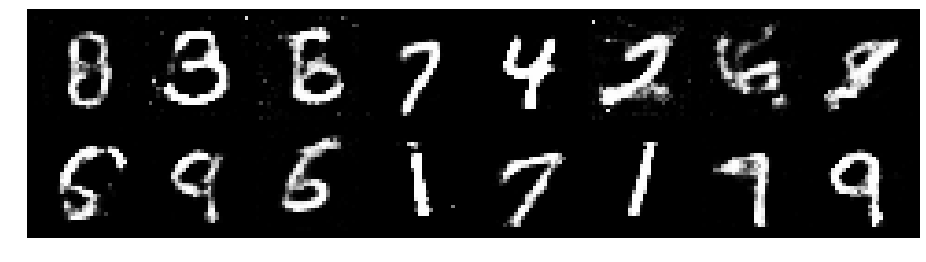

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.2828, Generator Loss: 0.9503
D(x): 0.5613, D(G(z)): 0.4337


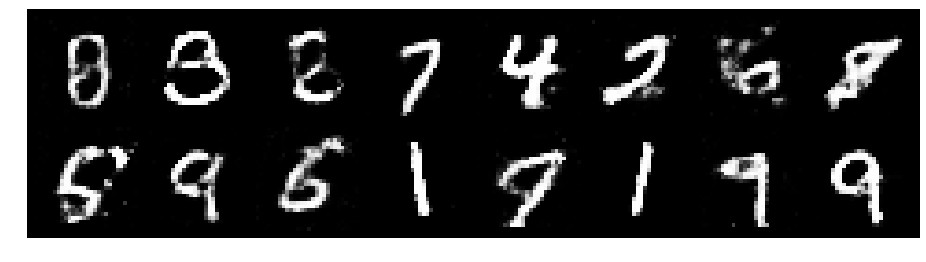

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.3299, Generator Loss: 0.8513
D(x): 0.5494, D(G(z)): 0.4682


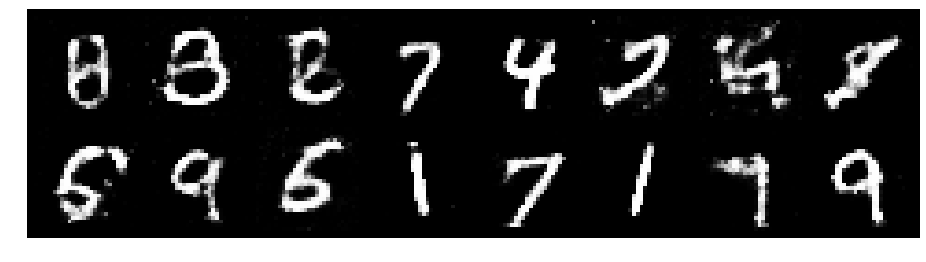

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.3082, Generator Loss: 0.9981
D(x): 0.5306, D(G(z)): 0.4313


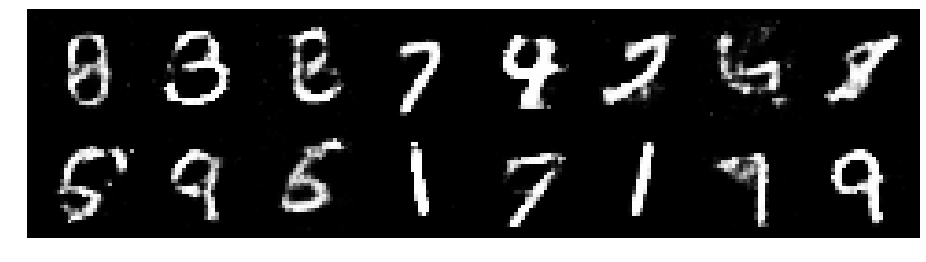

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.2603, Generator Loss: 0.8003
D(x): 0.5377, D(G(z)): 0.4444


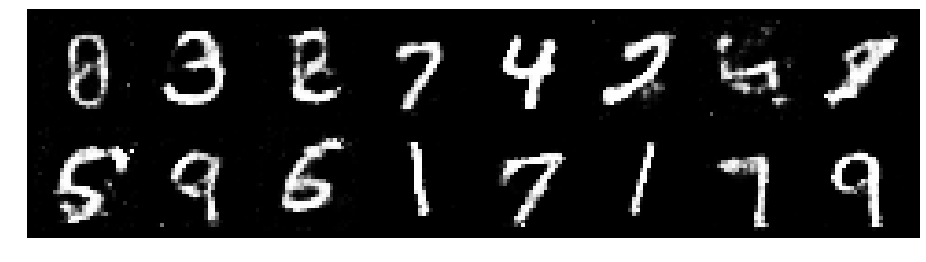

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.2145, Generator Loss: 0.8533
D(x): 0.5451, D(G(z)): 0.4201


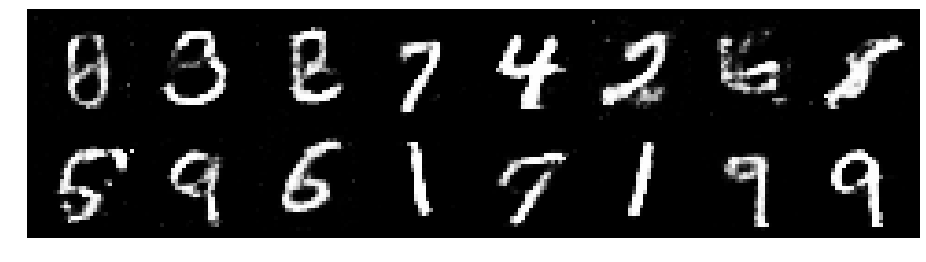

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.1573, Generator Loss: 1.0396
D(x): 0.5524, D(G(z)): 0.3805


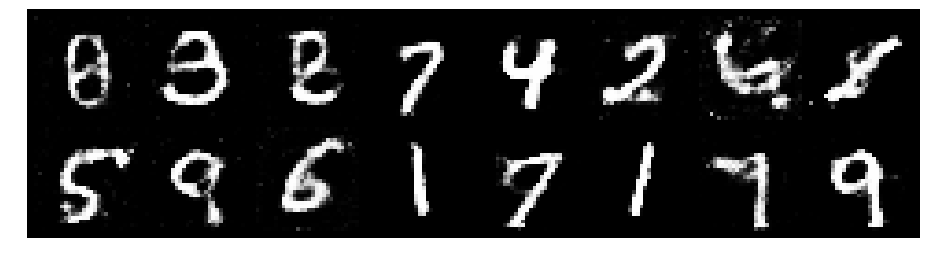

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.0848, Generator Loss: 1.0059
D(x): 0.5926, D(G(z)): 0.3881


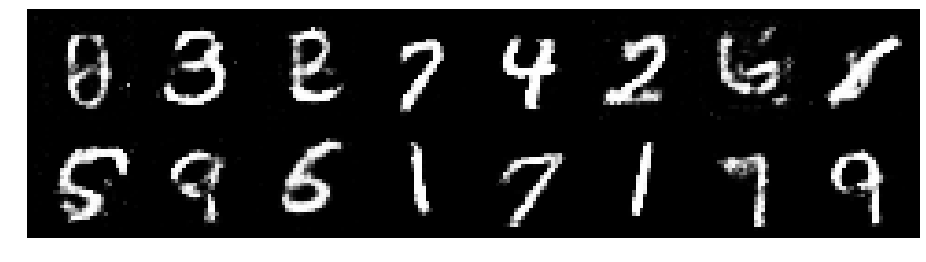

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2487, Generator Loss: 0.9187
D(x): 0.5754, D(G(z)): 0.4255


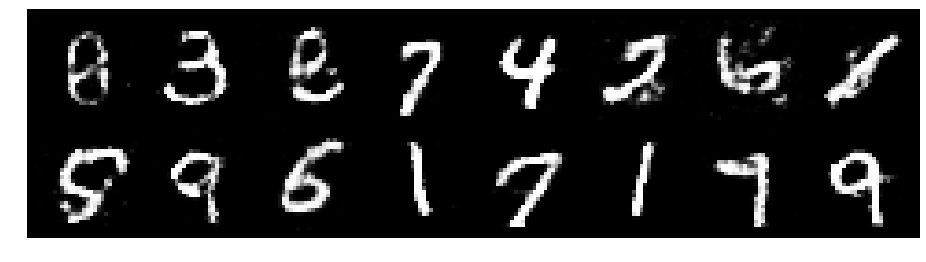

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.3622, Generator Loss: 0.8619
D(x): 0.5210, D(G(z)): 0.4713


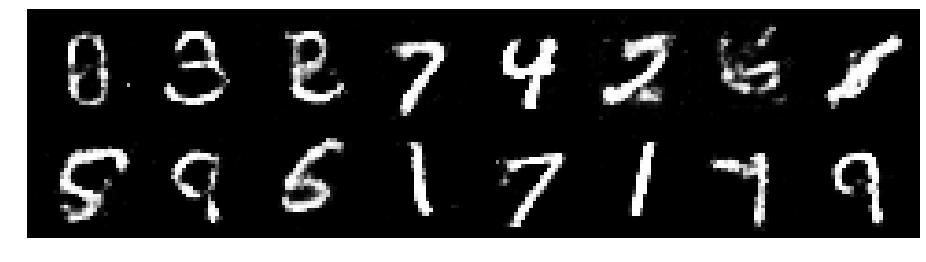

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.2175, Generator Loss: 0.8626
D(x): 0.5383, D(G(z)): 0.4092


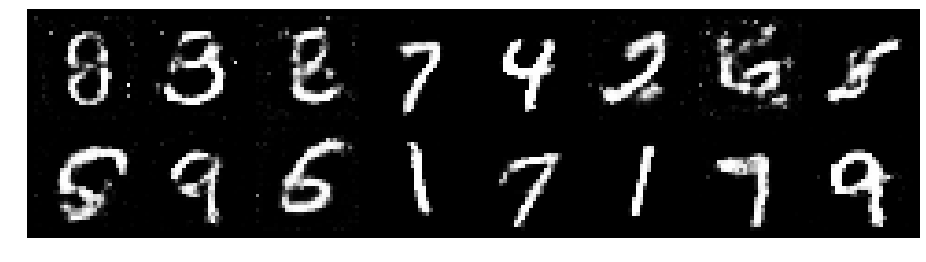

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.2909, Generator Loss: 0.7995
D(x): 0.5622, D(G(z)): 0.4670


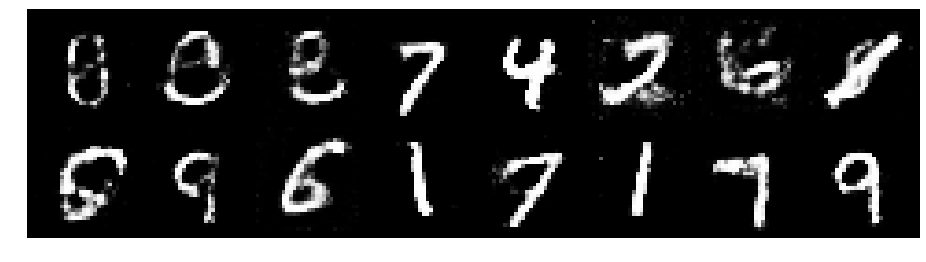

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.2864, Generator Loss: 0.9768
D(x): 0.5503, D(G(z)): 0.4439


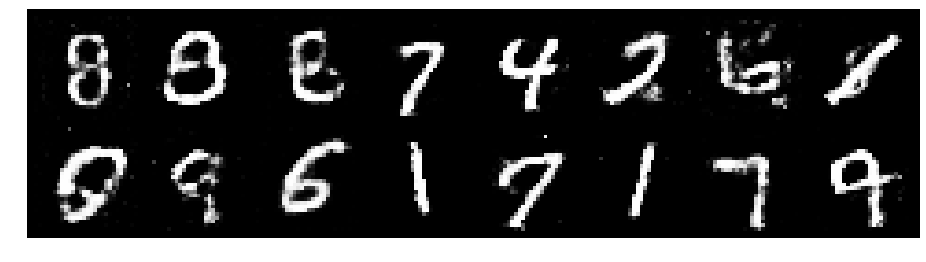

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.1969, Generator Loss: 0.9253
D(x): 0.5441, D(G(z)): 0.4132


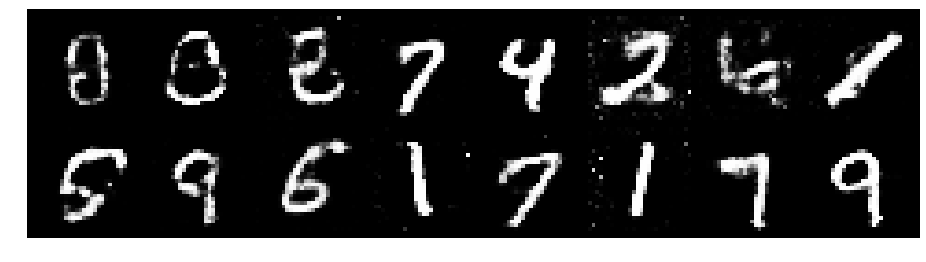

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.2800, Generator Loss: 0.8335
D(x): 0.5339, D(G(z)): 0.4363


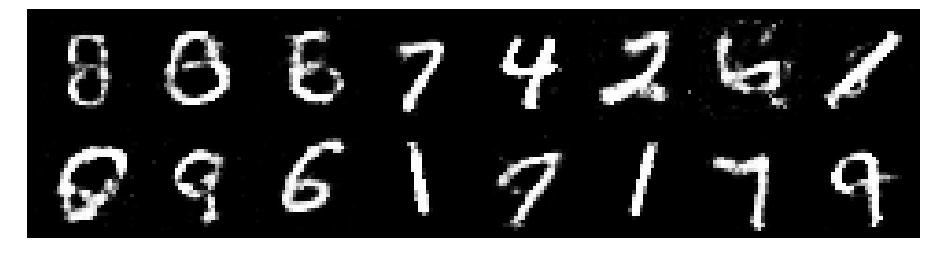

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.2687, Generator Loss: 0.9243
D(x): 0.5724, D(G(z)): 0.4629


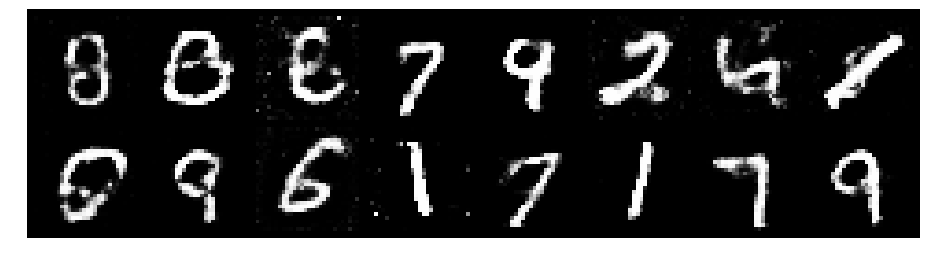

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.3577, Generator Loss: 0.7851
D(x): 0.5080, D(G(z)): 0.4636


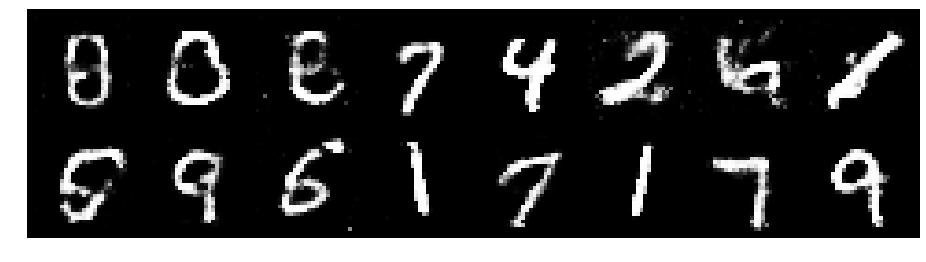

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.2847, Generator Loss: 0.8704
D(x): 0.5590, D(G(z)): 0.4613


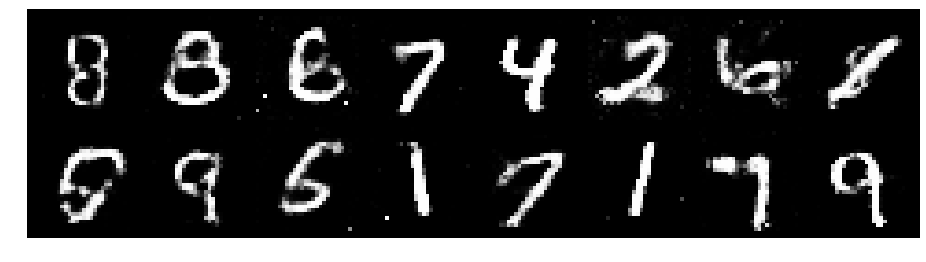

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.3322, Generator Loss: 0.8800
D(x): 0.5272, D(G(z)): 0.4608


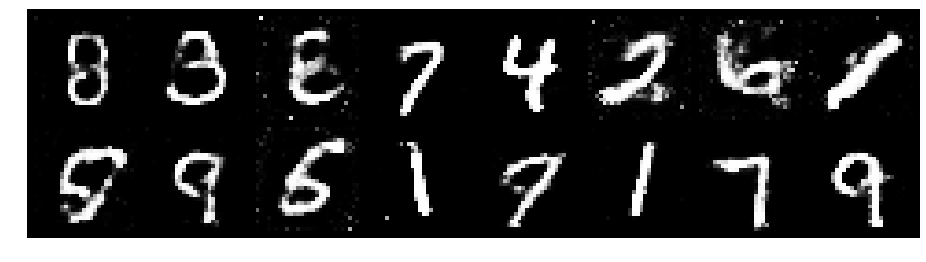

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.2697, Generator Loss: 0.9382
D(x): 0.5097, D(G(z)): 0.4038


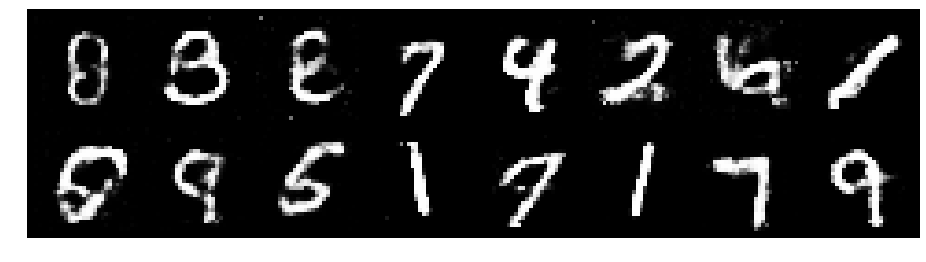

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.2504, Generator Loss: 0.9744
D(x): 0.5203, D(G(z)): 0.3995


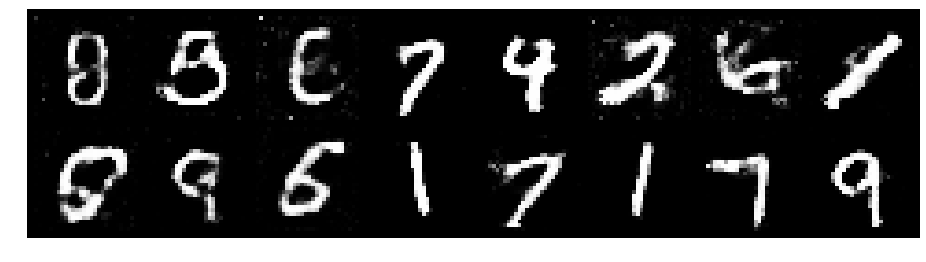

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.3715, Generator Loss: 0.8328
D(x): 0.5358, D(G(z)): 0.4736


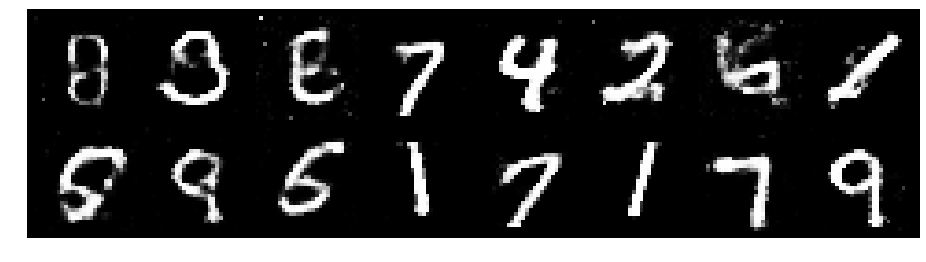

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.3334, Generator Loss: 0.9138
D(x): 0.5395, D(G(z)): 0.4243


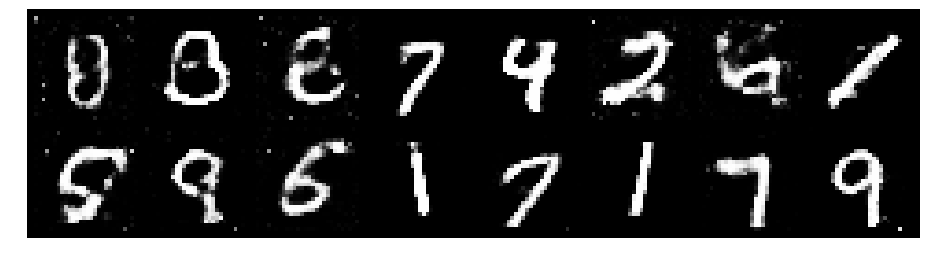

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.3024, Generator Loss: 0.9995
D(x): 0.5431, D(G(z)): 0.4384


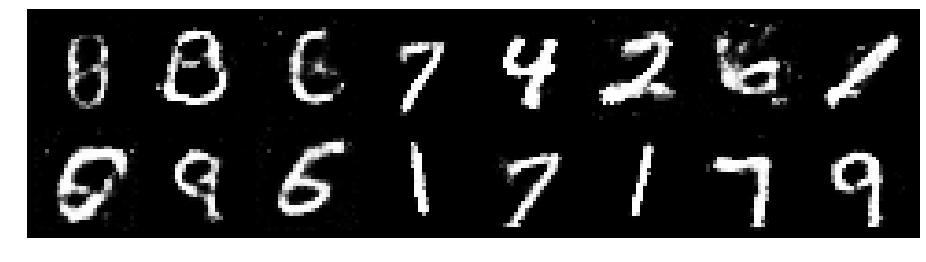

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.3668, Generator Loss: 0.7632
D(x): 0.4997, D(G(z)): 0.4469


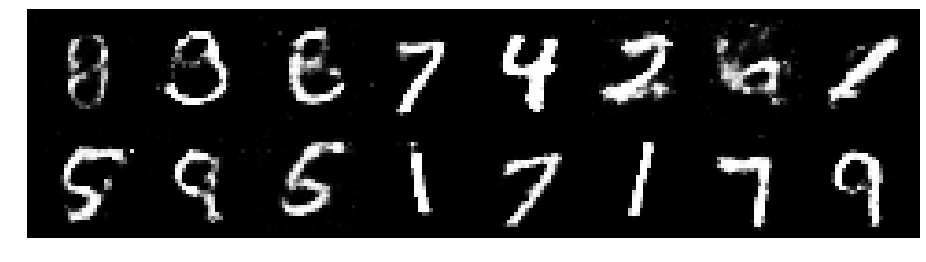

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.3923, Generator Loss: 0.7763
D(x): 0.4996, D(G(z)): 0.4560


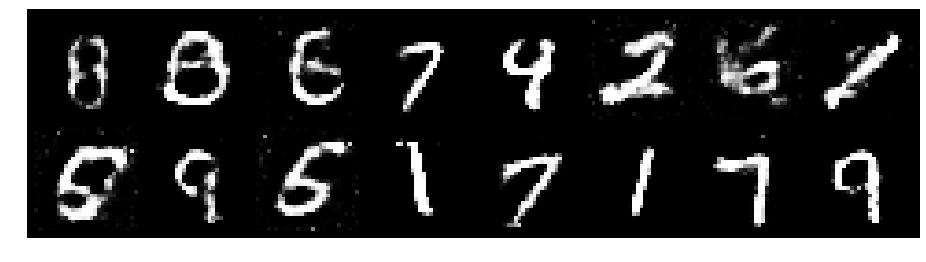

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.3882, Generator Loss: 0.8325
D(x): 0.5198, D(G(z)): 0.4648


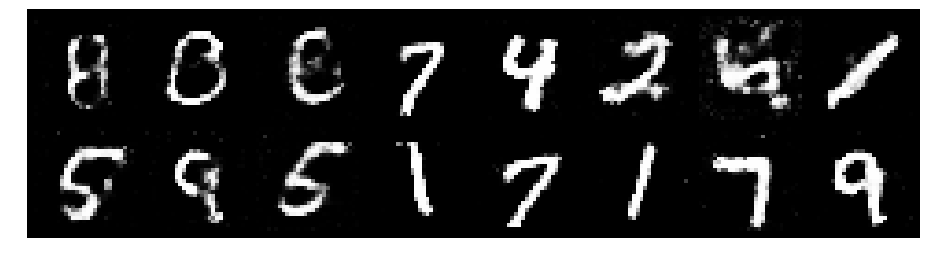

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.2711, Generator Loss: 0.9360
D(x): 0.5406, D(G(z)): 0.4373


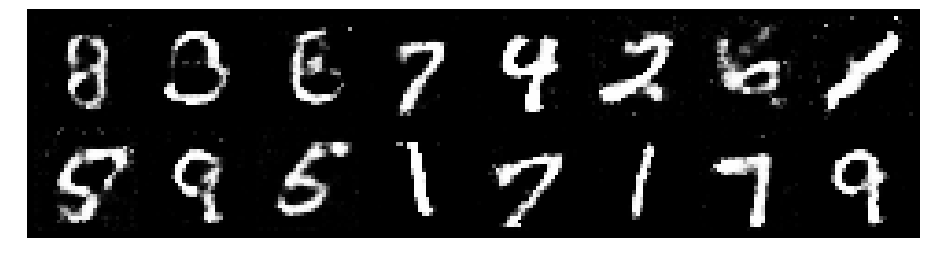

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.2083, Generator Loss: 0.9784
D(x): 0.5831, D(G(z)): 0.4304


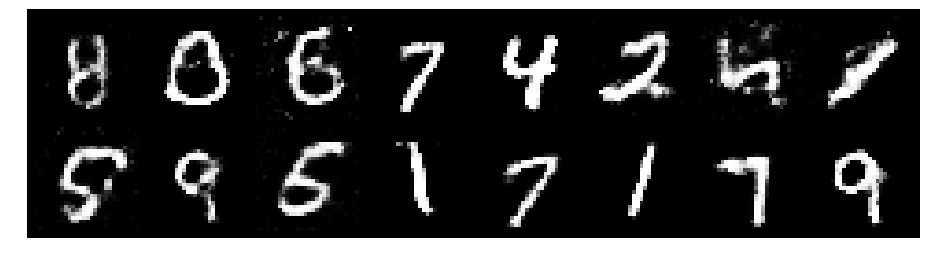

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2581, Generator Loss: 0.9010
D(x): 0.5596, D(G(z)): 0.4535


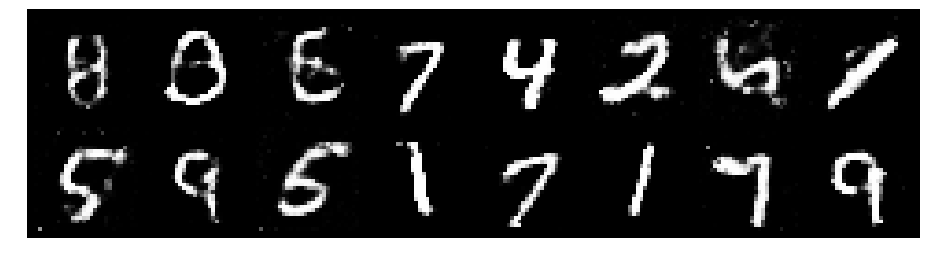

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.2612, Generator Loss: 0.9494
D(x): 0.5133, D(G(z)): 0.3846


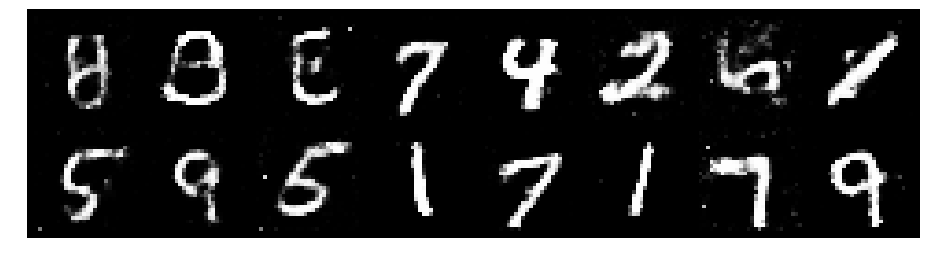

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.3189, Generator Loss: 0.8779
D(x): 0.5372, D(G(z)): 0.4441


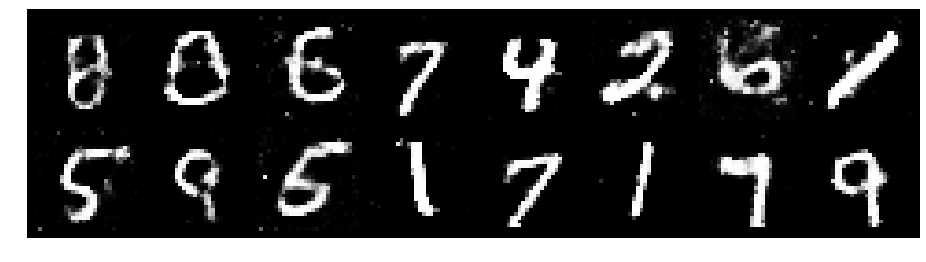

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.3767, Generator Loss: 0.9451
D(x): 0.5438, D(G(z)): 0.4741


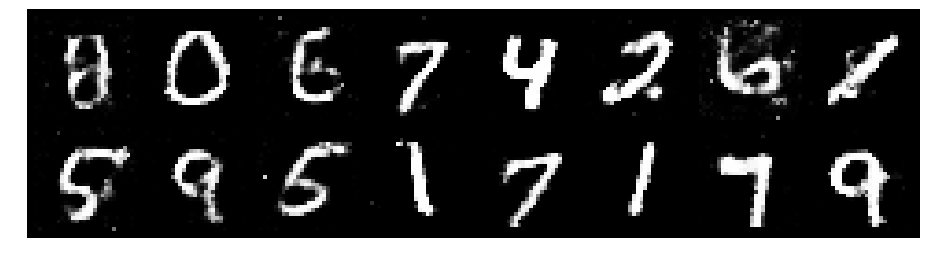

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.2332, Generator Loss: 0.9560
D(x): 0.5288, D(G(z)): 0.4000


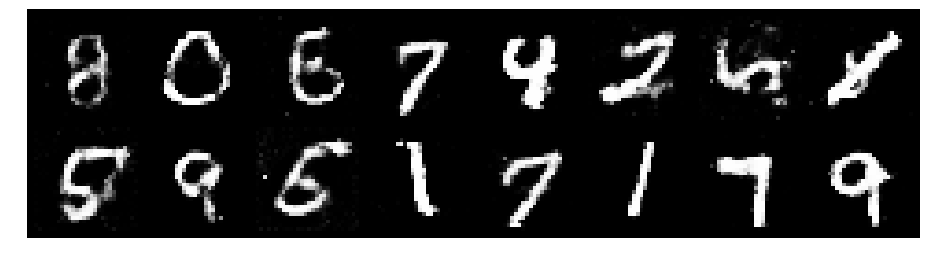

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.1823, Generator Loss: 0.9121
D(x): 0.5548, D(G(z)): 0.4153


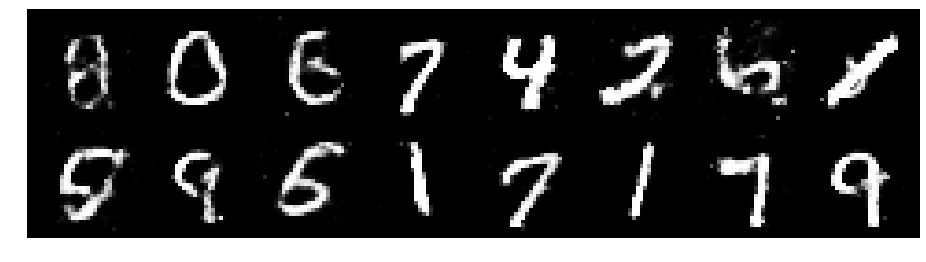

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.2274, Generator Loss: 0.9326
D(x): 0.5821, D(G(z)): 0.4581


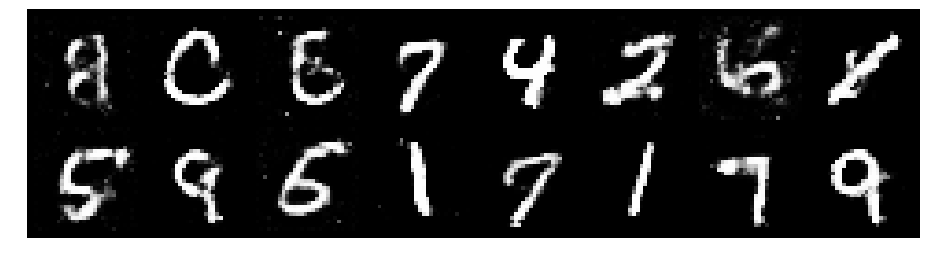

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.2856, Generator Loss: 0.9433
D(x): 0.5275, D(G(z)): 0.4337


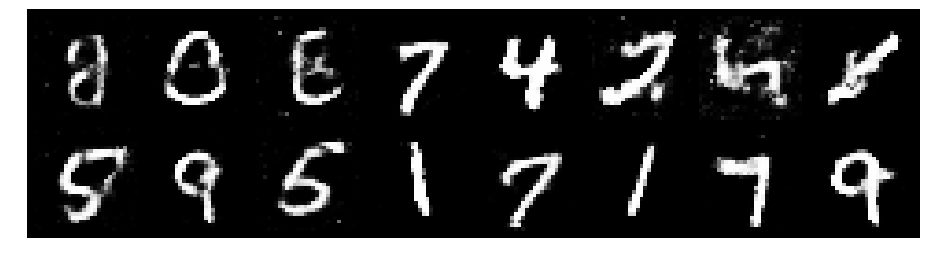

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.3875, Generator Loss: 0.8111
D(x): 0.5416, D(G(z)): 0.4692


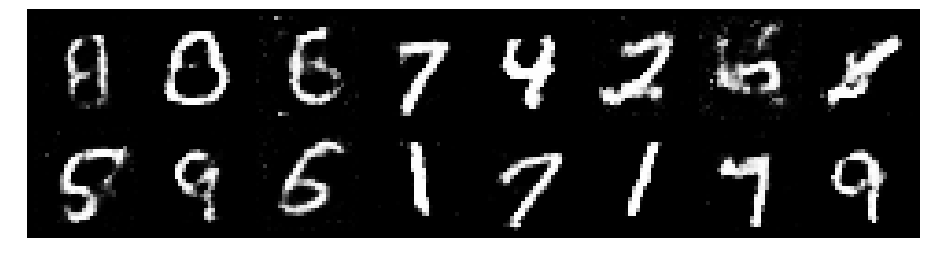

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.3094, Generator Loss: 0.7704
D(x): 0.5810, D(G(z)): 0.4904


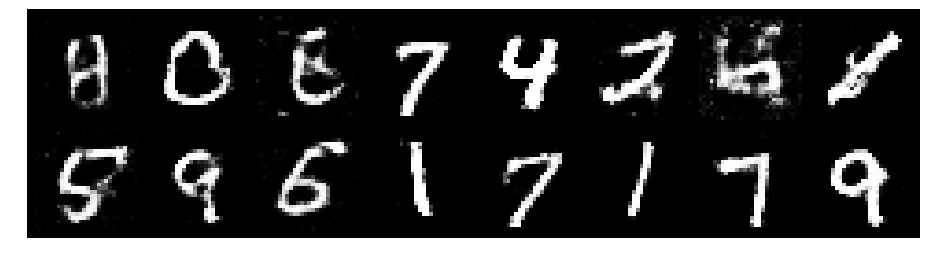

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.3360, Generator Loss: 0.8618
D(x): 0.5273, D(G(z)): 0.4479


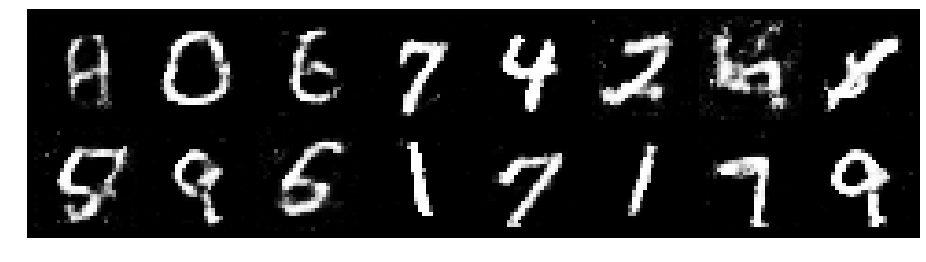

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.2653, Generator Loss: 0.8281
D(x): 0.5526, D(G(z)): 0.4440


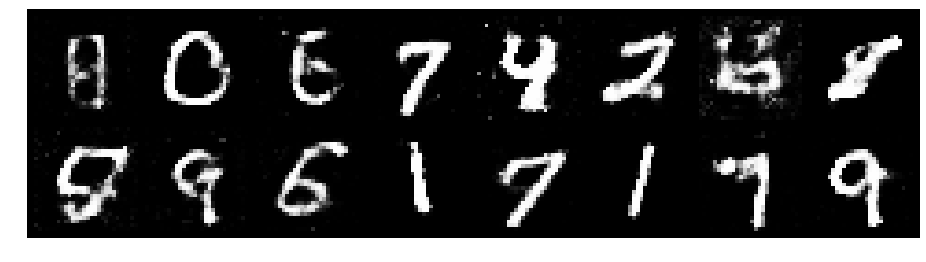

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.3492, Generator Loss: 0.9413
D(x): 0.5711, D(G(z)): 0.4768


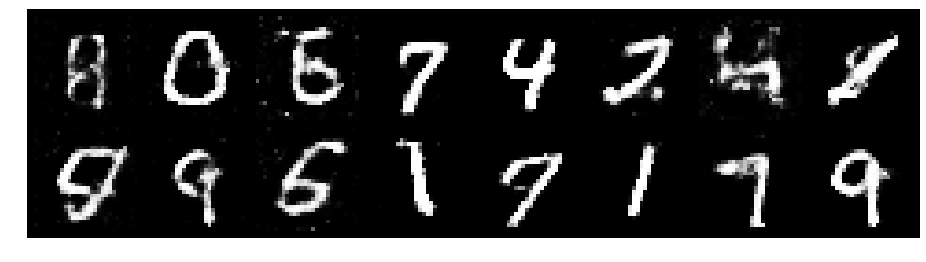

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.2067, Generator Loss: 1.1414
D(x): 0.5876, D(G(z)): 0.3959


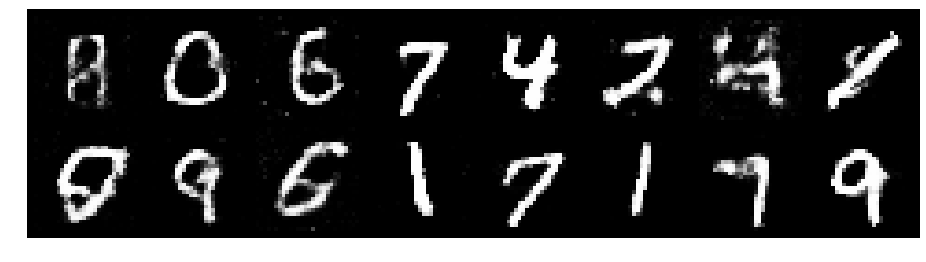

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2603, Generator Loss: 0.8113
D(x): 0.6254, D(G(z)): 0.4812


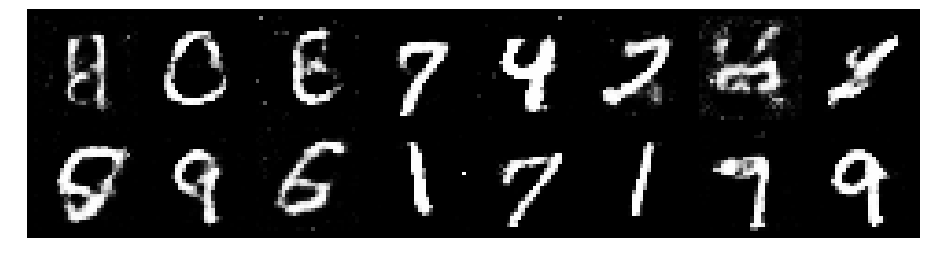

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.3439, Generator Loss: 0.7632
D(x): 0.5645, D(G(z)): 0.5055


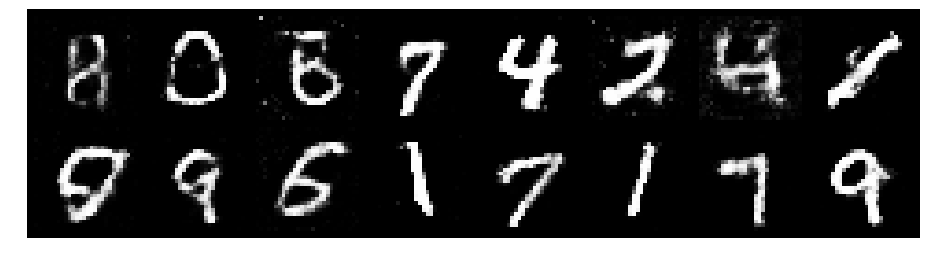

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2392, Generator Loss: 0.7700
D(x): 0.5622, D(G(z)): 0.4599


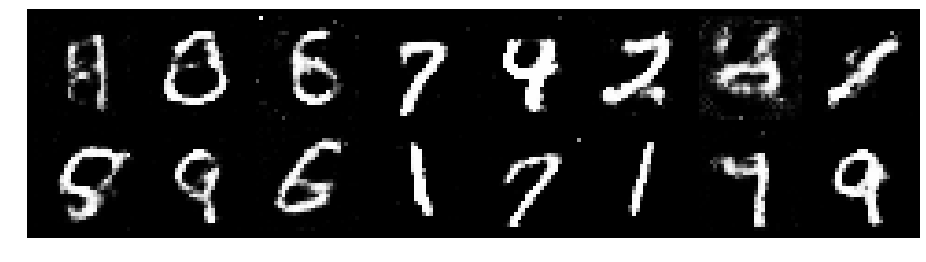

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.3464, Generator Loss: 0.8538
D(x): 0.5512, D(G(z)): 0.4909


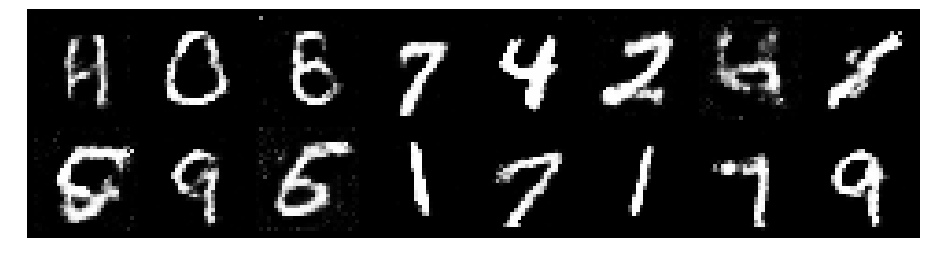

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.3398, Generator Loss: 0.8268
D(x): 0.5518, D(G(z)): 0.4861


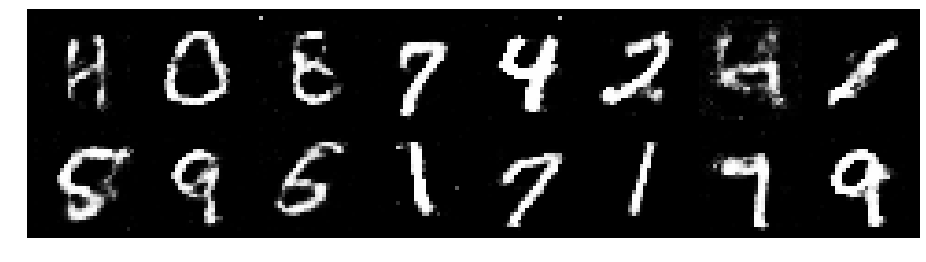

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.4187, Generator Loss: 0.8920
D(x): 0.4794, D(G(z)): 0.4033


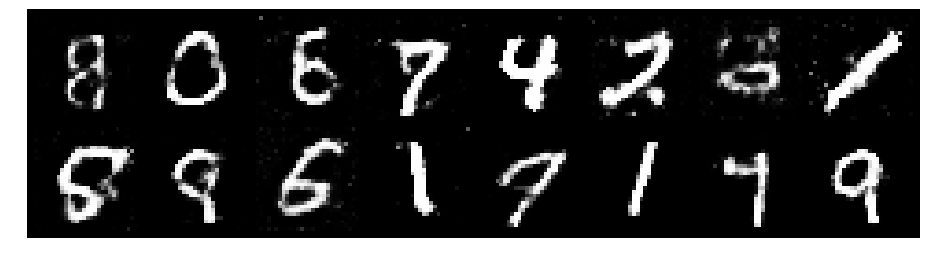

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.3572, Generator Loss: 0.7873
D(x): 0.5286, D(G(z)): 0.4566


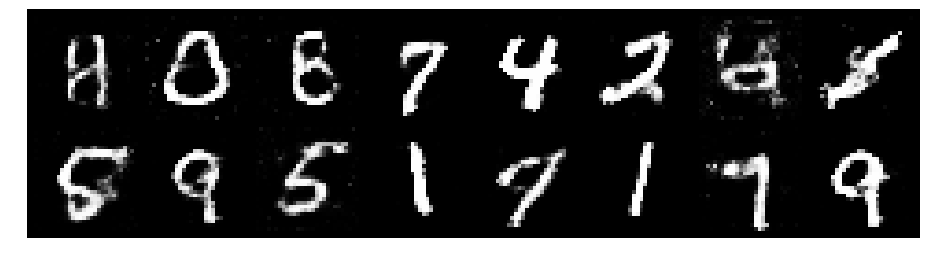

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.2236, Generator Loss: 0.8433
D(x): 0.5812, D(G(z)): 0.4480


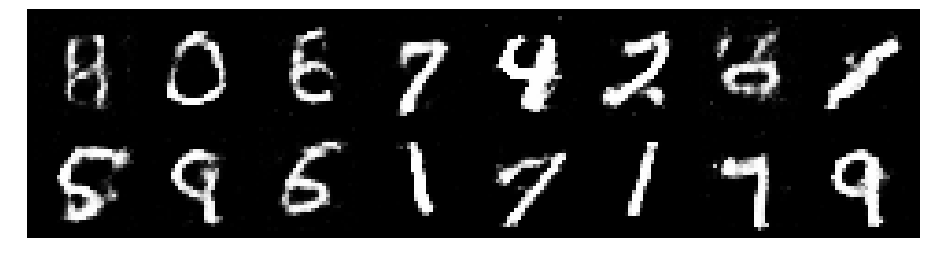

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.2590, Generator Loss: 0.8667
D(x): 0.5459, D(G(z)): 0.4447


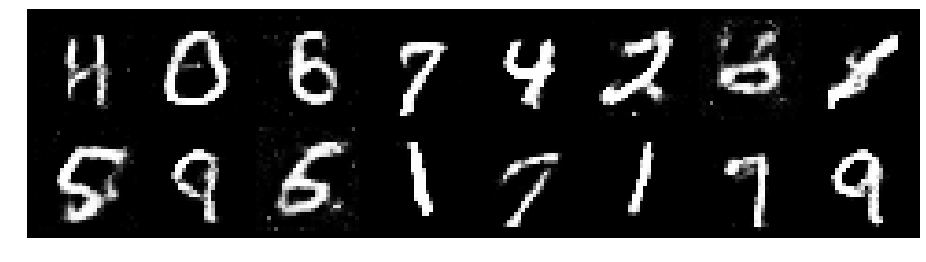

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.3371, Generator Loss: 0.7750
D(x): 0.5570, D(G(z)): 0.4893


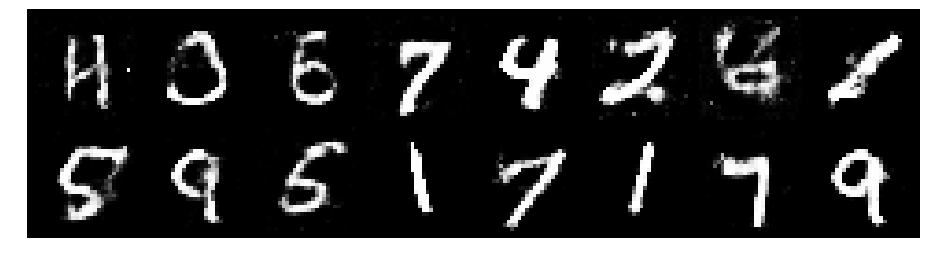

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2985, Generator Loss: 0.7312
D(x): 0.5582, D(G(z)): 0.4792


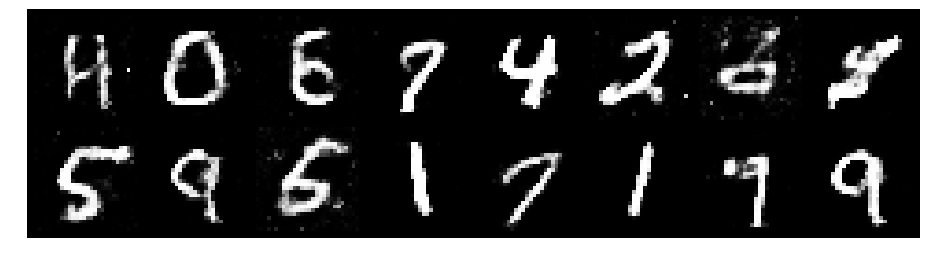

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.2022, Generator Loss: 0.9395
D(x): 0.5542, D(G(z)): 0.4155


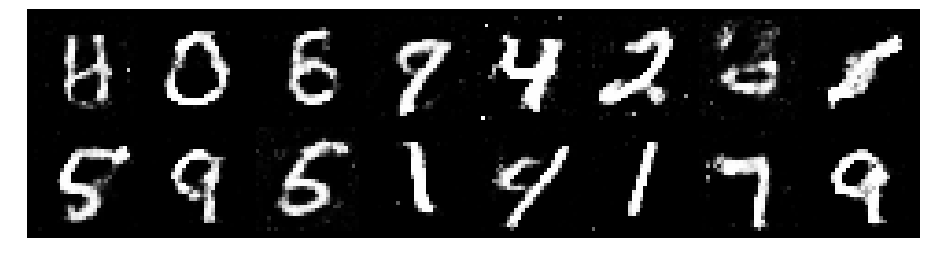

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.2551, Generator Loss: 0.7982
D(x): 0.5816, D(G(z)): 0.4432


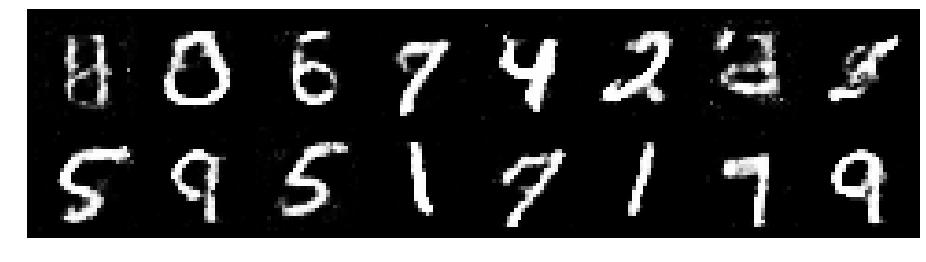

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.3711, Generator Loss: 0.9357
D(x): 0.5289, D(G(z)): 0.4432


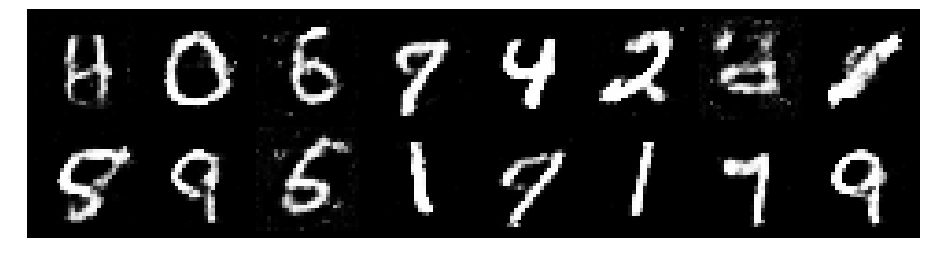

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2877, Generator Loss: 0.9094
D(x): 0.5756, D(G(z)): 0.4617


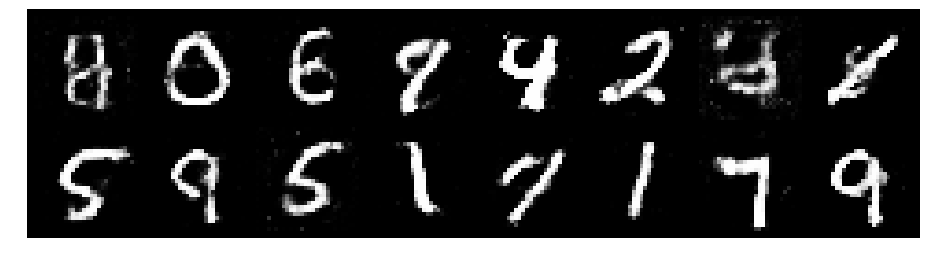

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.3392, Generator Loss: 0.8272
D(x): 0.5799, D(G(z)): 0.4919


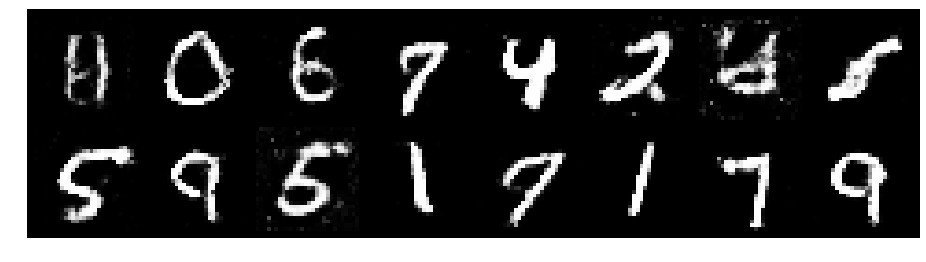

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.1874, Generator Loss: 0.9723
D(x): 0.5557, D(G(z)): 0.4029


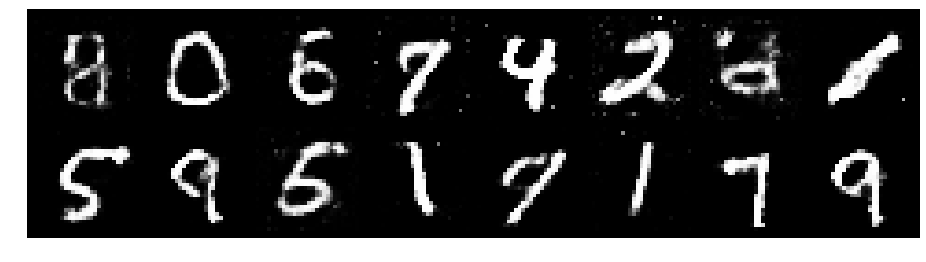

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.3319, Generator Loss: 0.9035
D(x): 0.5489, D(G(z)): 0.4671


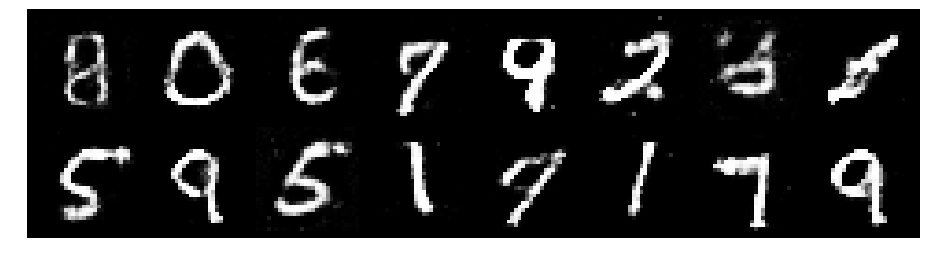

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.3676, Generator Loss: 0.7976
D(x): 0.5529, D(G(z)): 0.4903


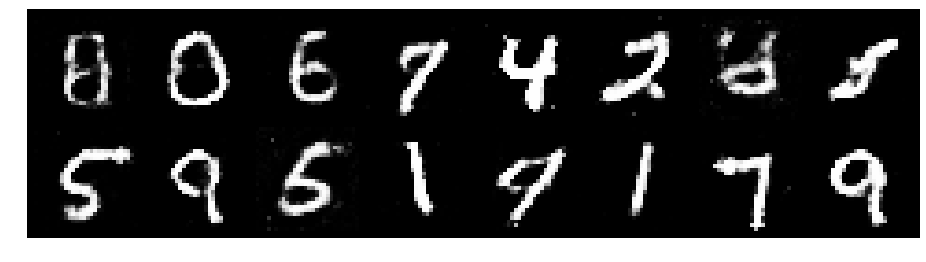

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2679, Generator Loss: 1.0240
D(x): 0.5669, D(G(z)): 0.4333


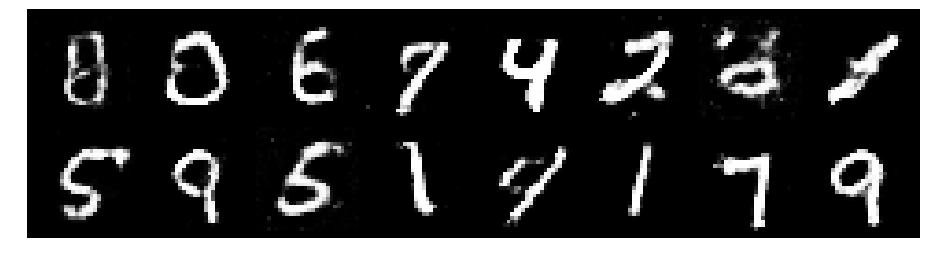

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.3268, Generator Loss: 0.9311
D(x): 0.5654, D(G(z)): 0.4614


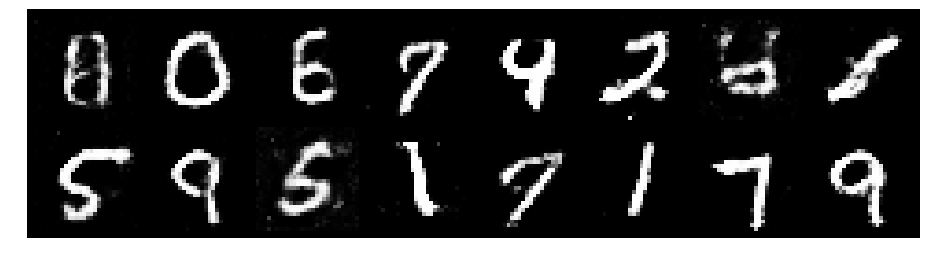

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2262, Generator Loss: 0.8234
D(x): 0.5626, D(G(z)): 0.4298


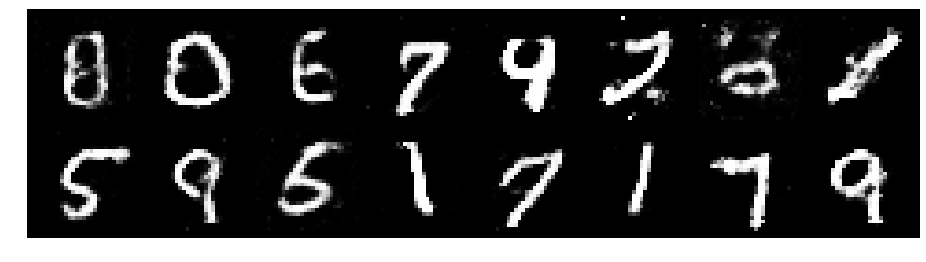

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.3257, Generator Loss: 0.7480
D(x): 0.5341, D(G(z)): 0.4662


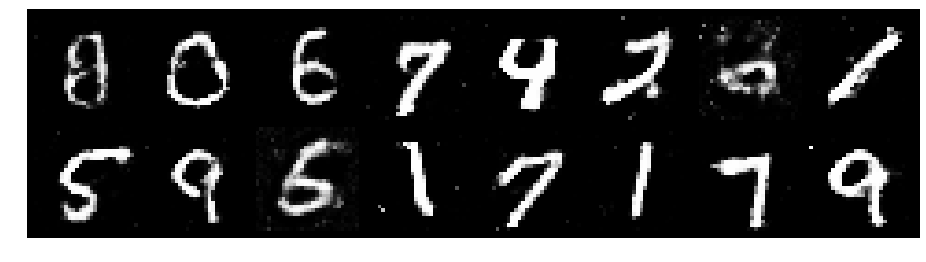

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.2483, Generator Loss: 0.8577
D(x): 0.5736, D(G(z)): 0.4577


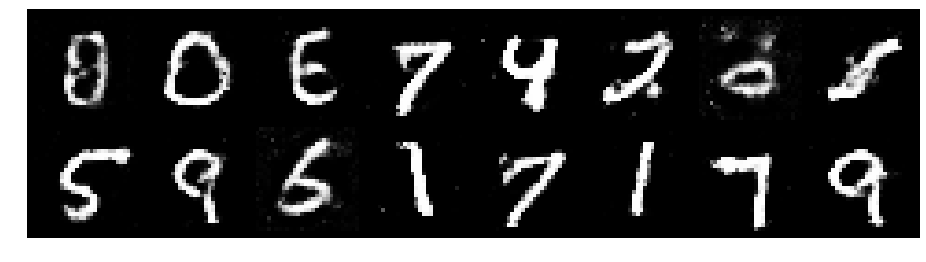

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.2376, Generator Loss: 0.9215
D(x): 0.5712, D(G(z)): 0.4385


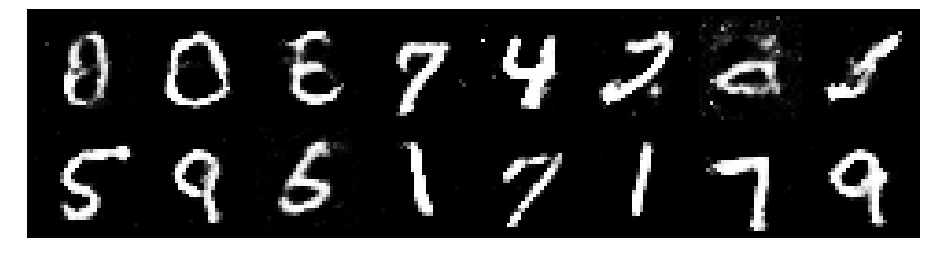

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.4790, Generator Loss: 0.7234
D(x): 0.5531, D(G(z)): 0.5488


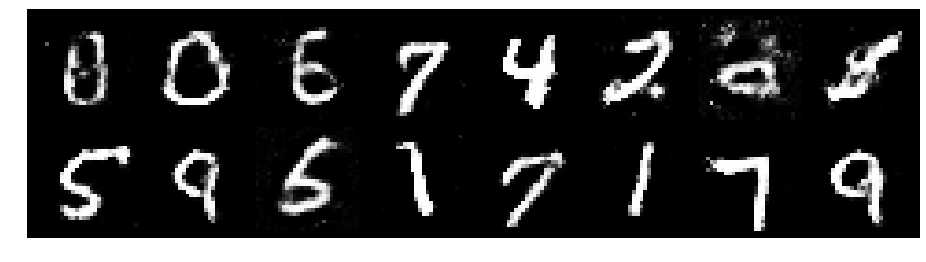

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.2742, Generator Loss: 0.7563
D(x): 0.5737, D(G(z)): 0.4750


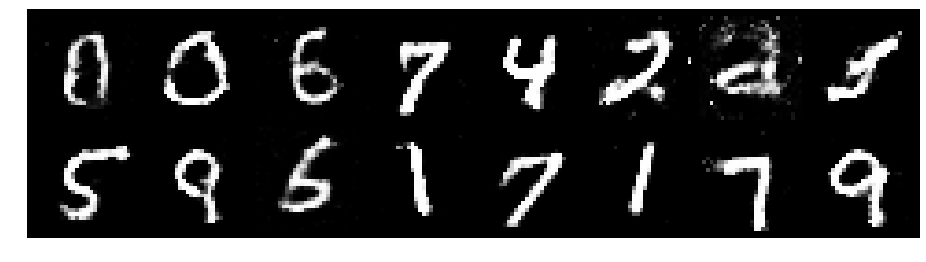

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.4897, Generator Loss: 0.8541
D(x): 0.5047, D(G(z)): 0.4959


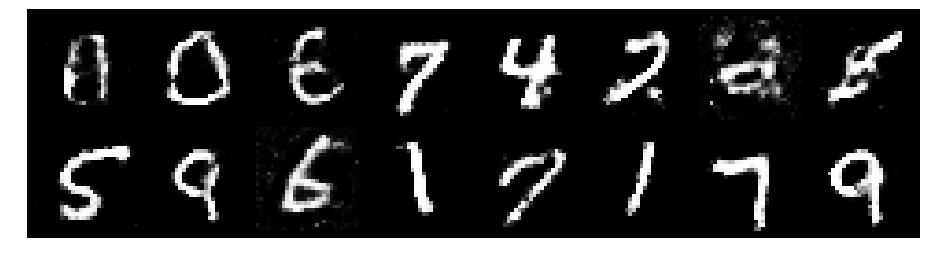

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.2537, Generator Loss: 0.8345
D(x): 0.5277, D(G(z)): 0.4210


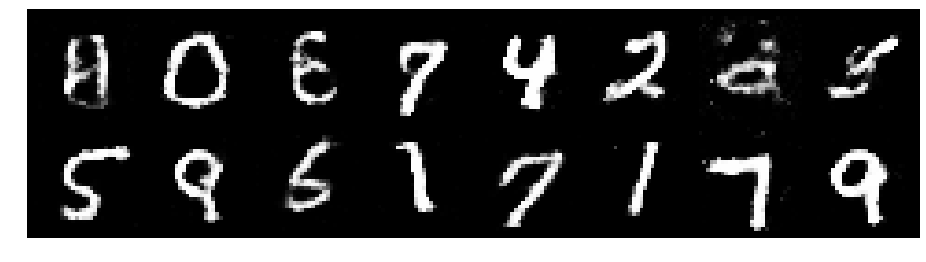

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.3487, Generator Loss: 0.9168
D(x): 0.5423, D(G(z)): 0.4732


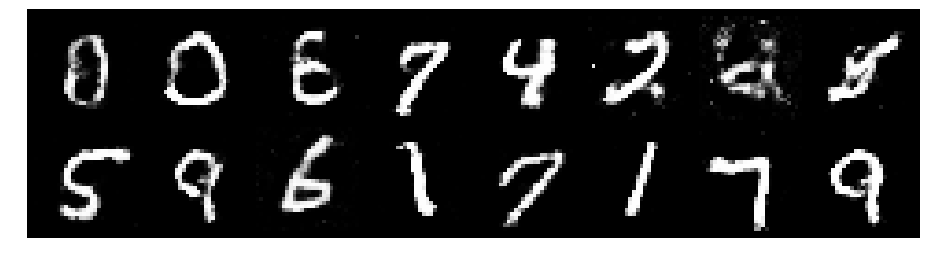

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.1757, Generator Loss: 0.9559
D(x): 0.5779, D(G(z)): 0.4205


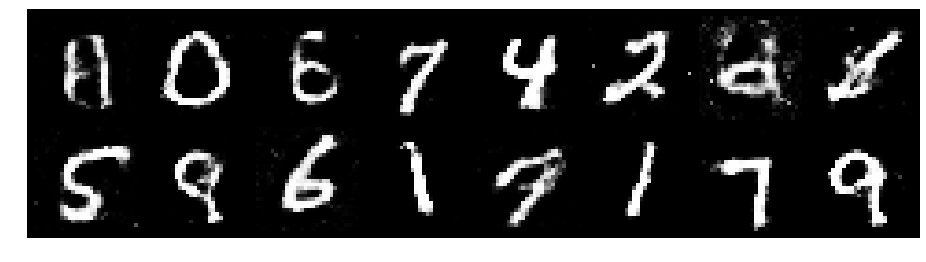

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.3401, Generator Loss: 0.8729
D(x): 0.5477, D(G(z)): 0.4773


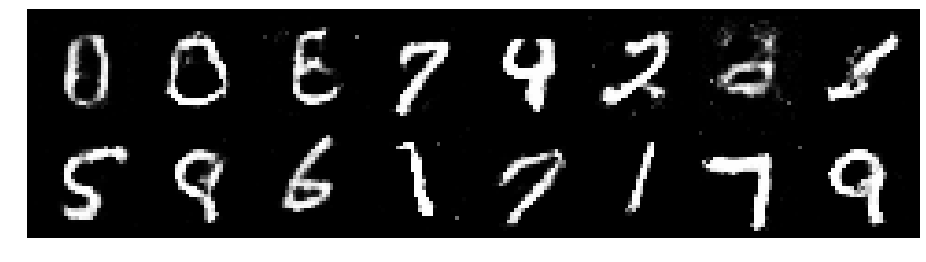

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.1712, Generator Loss: 0.8790
D(x): 0.5670, D(G(z)): 0.3839


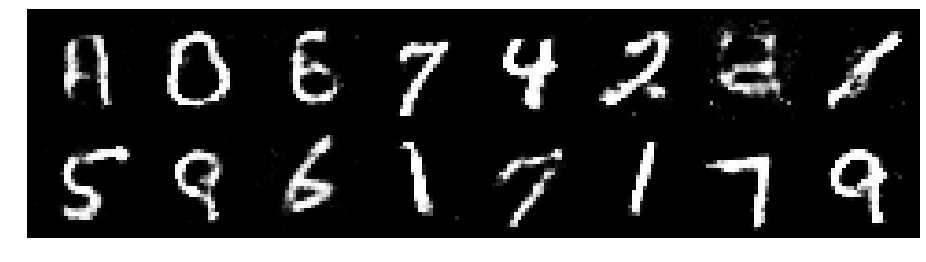

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.2678, Generator Loss: 0.9526
D(x): 0.5338, D(G(z)): 0.4317


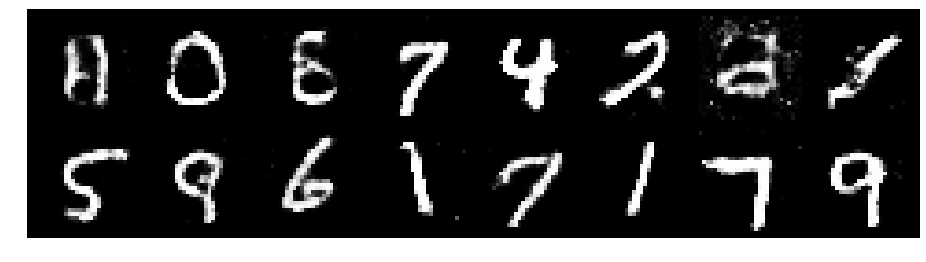

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.2183, Generator Loss: 0.9981
D(x): 0.5746, D(G(z)): 0.4169


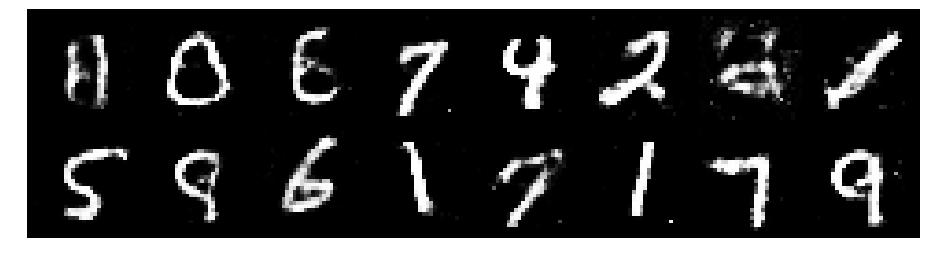

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2530, Generator Loss: 0.9007
D(x): 0.5428, D(G(z)): 0.4074


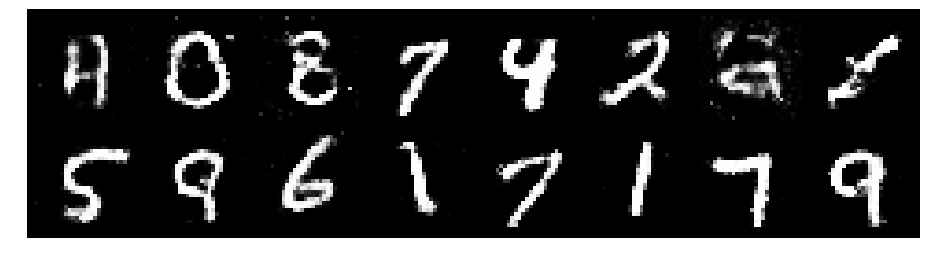

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.2488, Generator Loss: 0.9050
D(x): 0.5328, D(G(z)): 0.4155


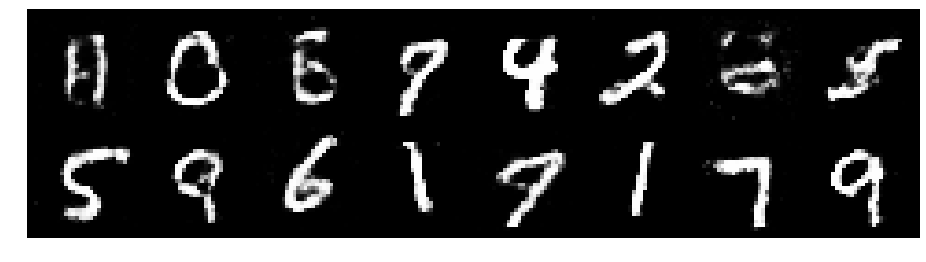

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.2705, Generator Loss: 0.8853
D(x): 0.5216, D(G(z)): 0.4340


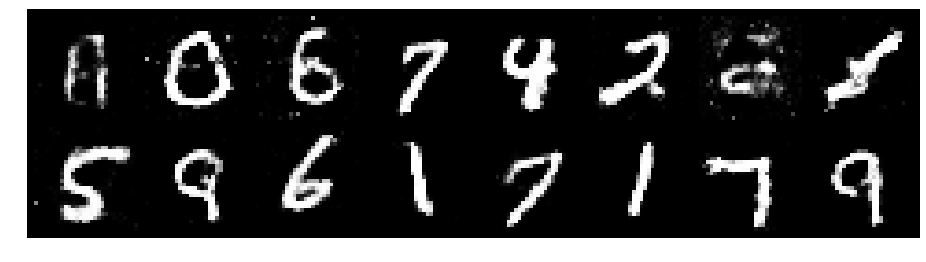

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.2318, Generator Loss: 0.8430
D(x): 0.6061, D(G(z)): 0.4741


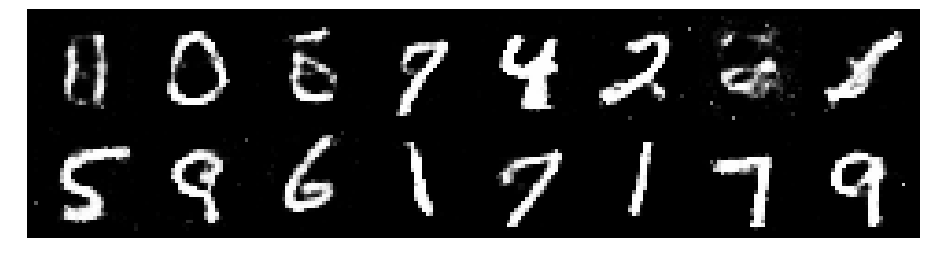

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.3828, Generator Loss: 0.8255
D(x): 0.5318, D(G(z)): 0.4483


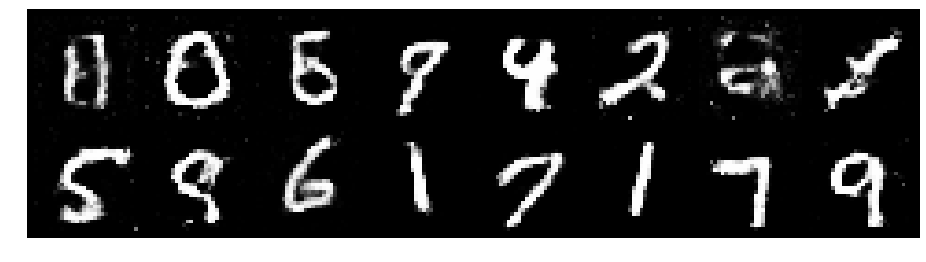

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.2156, Generator Loss: 0.9128
D(x): 0.5782, D(G(z)): 0.4318


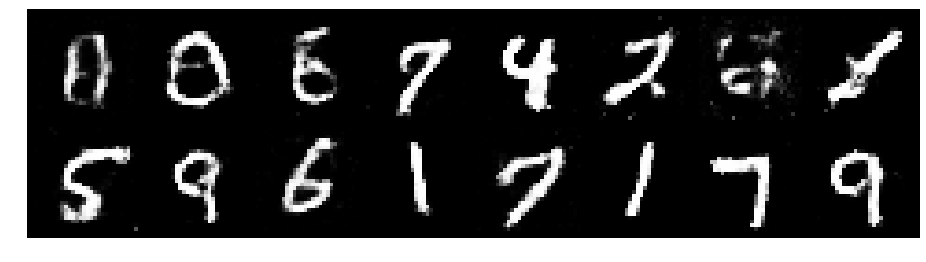

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.3610, Generator Loss: 0.9647
D(x): 0.5516, D(G(z)): 0.4712


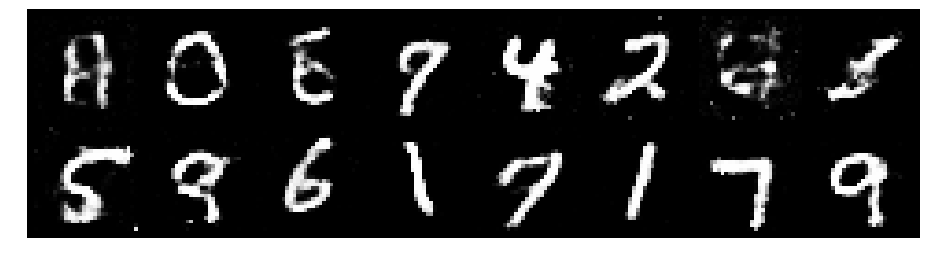

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2856, Generator Loss: 0.9314
D(x): 0.5637, D(G(z)): 0.4587


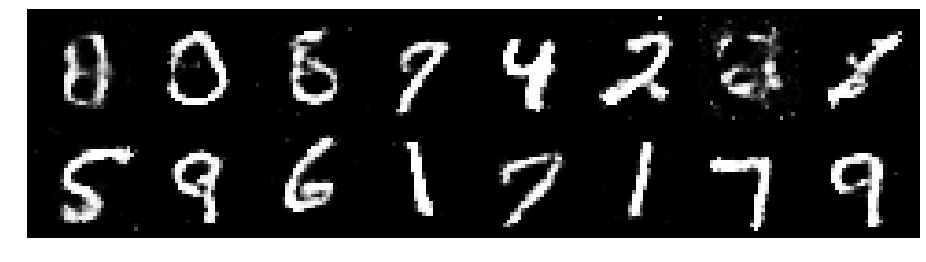

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.3652, Generator Loss: 0.8676
D(x): 0.5584, D(G(z)): 0.4698


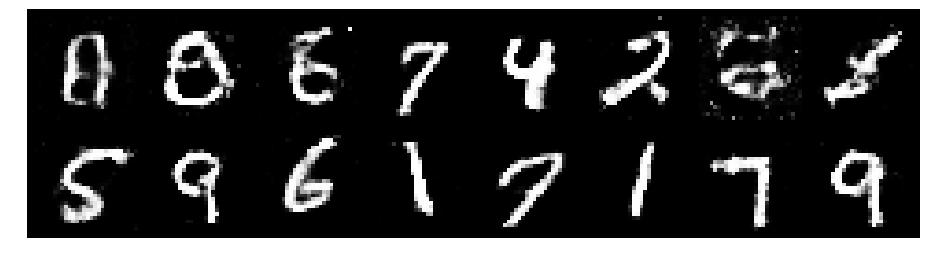

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.2419, Generator Loss: 0.9325
D(x): 0.5763, D(G(z)): 0.4319


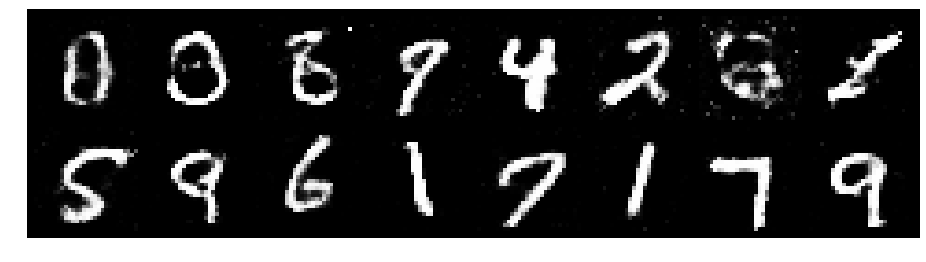

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2690, Generator Loss: 0.9240
D(x): 0.5939, D(G(z)): 0.4668


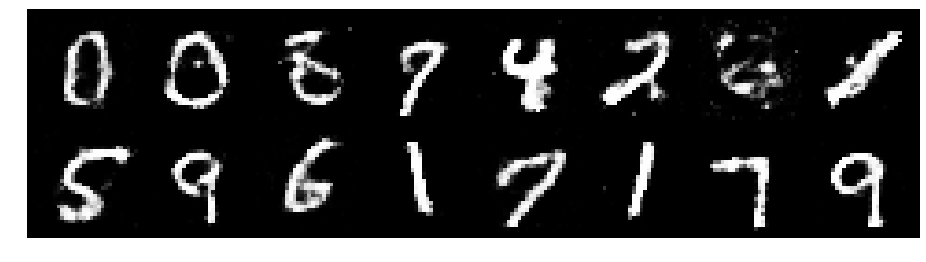

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.1481, Generator Loss: 1.0117
D(x): 0.5859, D(G(z)): 0.4213


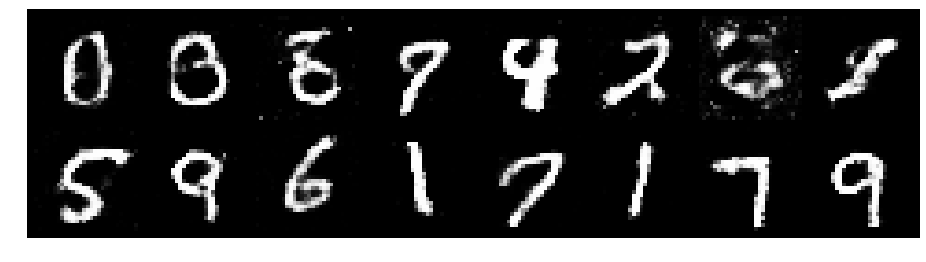

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.2439, Generator Loss: 0.8710
D(x): 0.5635, D(G(z)): 0.4589


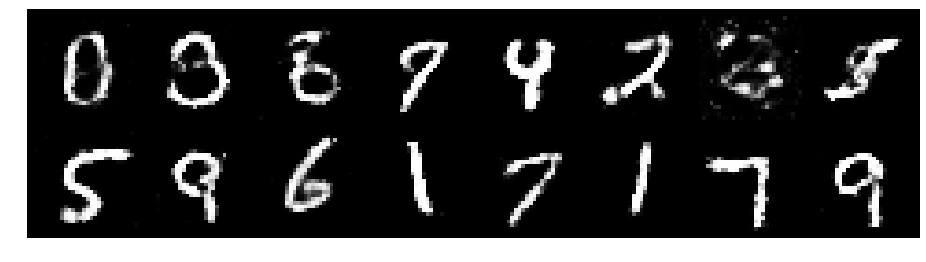

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.2471, Generator Loss: 1.0196
D(x): 0.5340, D(G(z)): 0.4012


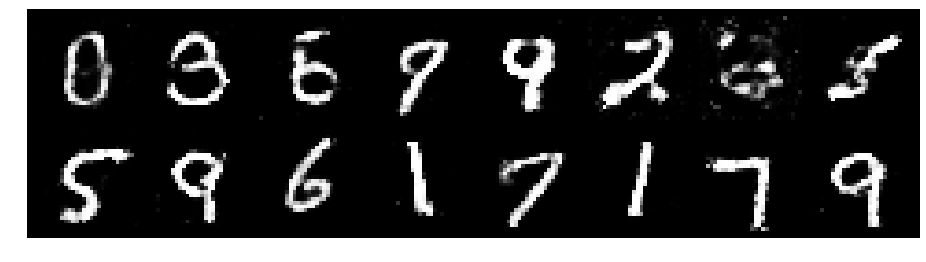

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.2936, Generator Loss: 1.0639
D(x): 0.5400, D(G(z)): 0.4354


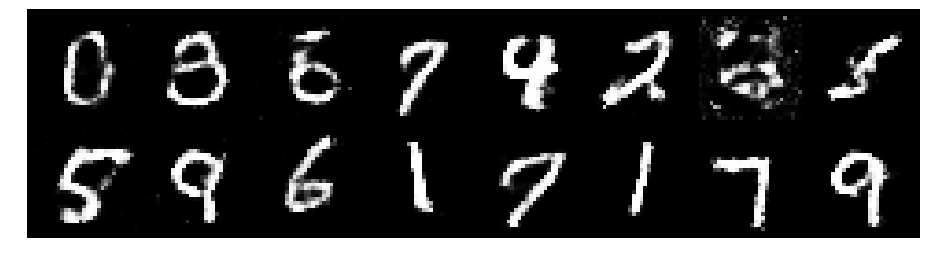

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.1788, Generator Loss: 1.1695
D(x): 0.5567, D(G(z)): 0.3849


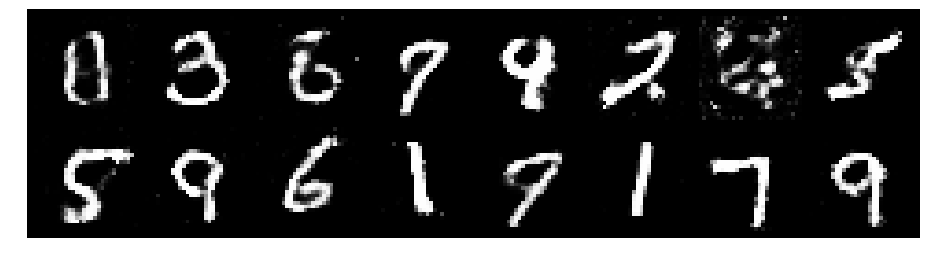

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.1896, Generator Loss: 0.9484
D(x): 0.5888, D(G(z)): 0.4401


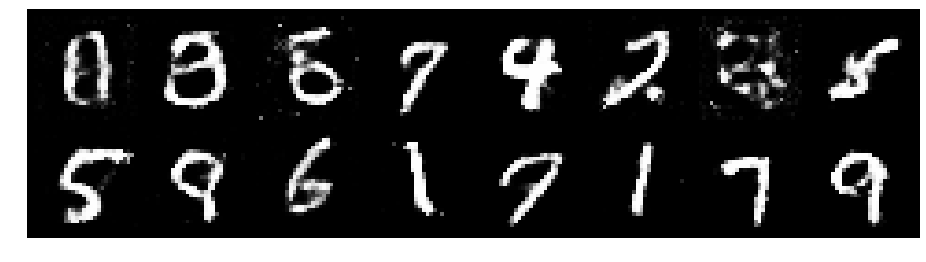

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2309, Generator Loss: 0.9258
D(x): 0.5406, D(G(z)): 0.4184


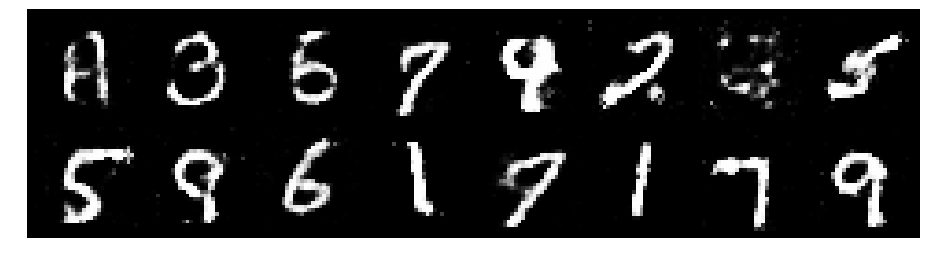

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.3274, Generator Loss: 0.8686
D(x): 0.5117, D(G(z)): 0.4378


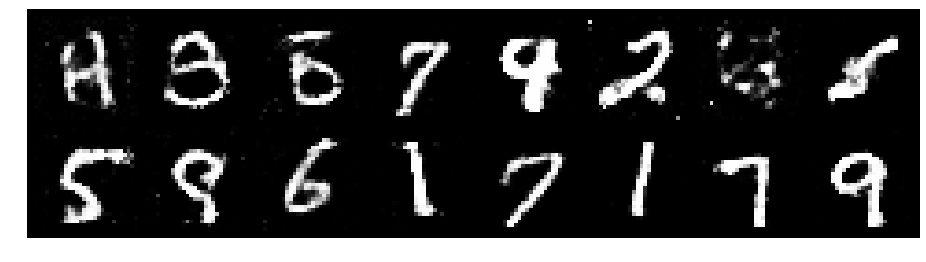

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.3042, Generator Loss: 0.8355
D(x): 0.5667, D(G(z)): 0.4710


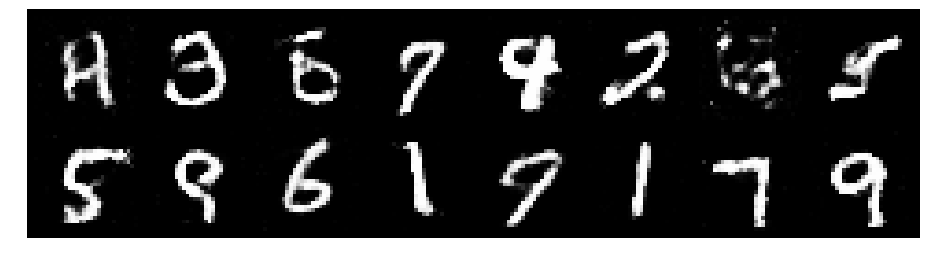

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.4022, Generator Loss: 0.8904
D(x): 0.5371, D(G(z)): 0.4681


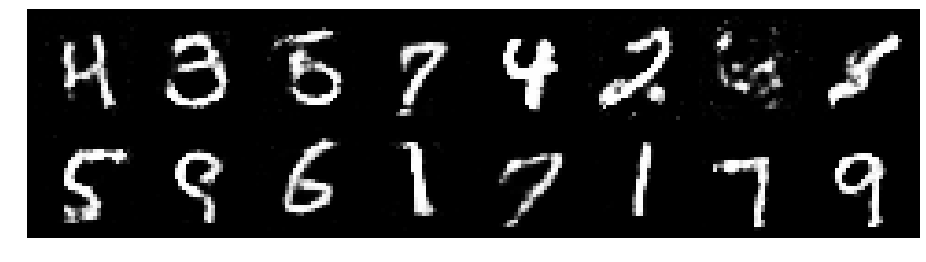

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.4118, Generator Loss: 0.8345
D(x): 0.5446, D(G(z)): 0.5007


In [9]:
# Run training iterations
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )